# Machine Learning sklearn - Sentiment Analysis of Tweet Comments Related to ChatGPT

# 1. Preprocess Text Dataset

In [1]:
import nltk
import gensim
import csv
import nltk
import nltk.tokenize
nltk.download('vader_lexicon')
nltk.download('stopwords')
import pandas as pd
from collections import Counter
import re
import matplotlib.pyplot as plt
from nltk.sentiment.vader import SentimentIntensityAnalyzer

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /home/nizai8a/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /home/nizai8a/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [2]:
# Import data from CSV
twitter_df = pd.read_csv('/home/nizai8a/桌面/tweetsChatGPT.csv',engine='python')

In [3]:
# Inspect the shape of data
print('The shape of the Twitter ：',twitter_df.shape)

The shape of the Twitter ： (416364, 12)


In [4]:
# Inspect the details of the Twitter
print('Non-Null number of Tweet Reviews：')
twitter_df.info()

Non-Null number of Tweet Reviews：
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 416364 entries, 0 to 416363
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   user_name         416350 non-null  object
 1   text              416322 non-null  object
 2   user_location     299674 non-null  object
 3   user_description  389617 non-null  object
 4   user_created      416303 non-null  object
 5   user_followers    416303 non-null  object
 6   user_friends      416303 non-null  object
 7   user_favourites   416303 non-null  object
 8   user_verified     416295 non-null  object
 9   date              416295 non-null  object
 10  hashtags          321060 non-null  object
 11  source            416256 non-null  object
dtypes: object(12)
memory usage: 38.1+ MB


In [5]:
#Check the head of the original CSV dataset
twitter_df.head(10)

,user_name,text,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,hashtags,source
0,Black Women in A.I.,We asked ChatGPT... Would you attend a church ...,Global,Amplifying the voices of Black Women In Artifi...,2017-12-24 07:07:07+00:00,6073.0,999.0,14943,False,2023-04-30 13:07:25+00:00,"['100DaysofCode', 'AI', 'Python', 'church']",Twitter Web App
1,Hamsa Jama,"""The Chronicles of David: Navigating an Uncert...",Localhost,"🚀 London Software Engineer juggling work, fami...",2017-07-07 21:03:45+00:00,13.0,293.0,30,False,2023-04-30 13:07:22+00:00,NaN,Twitter Web App
2,Titus,"Gain of Function: the Transhumanist Project"" #...",North Pole,Art is a mysterious metaphor about the present...,2011-04-25 16:50:21+00:00,709.0,2153.0,9475,False,2023-04-30 13:06:48+00:00,NaN,Twitter Web App
3,Dan Bruno AI,"We Need a Consumer-First AI Approach, Consumer...","Manchester, NH","The latest in #ChatGPT, #BARD, #Bing, and othe...",2021-05-19 01:19:32+00:00,461.0,156.0,5193,False,2023-04-30 13:05:33+00:00,"['chatgpt', 'AI', 'openAI']",dlvr.it
4,Hamza Aideed,I asked #ChatGPT the difference between #Somal...,somaliland,"Somalilander, \nmining expert,\nfinancial cons...",2020-12-13 15:00:19+00:00,340.0,164.0,735,False,2023-04-30 13:05:14+00:00,"['ChatGPT', 'Somaliland', 'Somalia']",Twitter for Android
5,JC Gaillard,Rethinking Safer #AI &gt;&gt; Can There Really...,"London, England",Founder @CorixPartners @Transform_Sec | Fellow...,2015-06-25 08:13:57+00:00,8970.0,8359.0,153347,False,2023-04-30 13:05:01+00:00,"['AI', 'tech']",Buffer
6,seamlessblend,ChatGPT &amp; fraud: https://t.co/yDQBGRQ8RM #...,"New York, NY",NaN,2010-02-26 03:35:13+00:00,1980.0,1.0,1302,False,2023-04-30 13:04:59+00:00,"['chatgpt', 'regulation', 'artificialintellige...",dancehallaudio
7,seamlessblend,ChatGPT at work: https://t.co/yDQBGRQ8RM #chat...,"New York, NY",NaN,2010-02-26 03:35:13+00:00,1980.0,1.0,1302,False,2023-04-30 13:04:58+00:00,"['chatgpt', 'automation', 'productivity', 'aip...",dancehallaudio
8,sopbox,Revolutionize your workflow with #SOPbox - the...,NaN,SOPbox by Parsimony. Let's get it done!,2021-03-27 20:39:44+00:00,3.0,1.0,1,False,2023-04-30 13:04:27+00:00,['SOPbox'],Heropost
9,Parsimony ERP,Revolutionize your workflow with #SOPbox - the...,"Bellevue, WA",NaN,2017-11-07 18:16:39+00:00,17.0,36.0,10,False,2023-04-30 13:04:25+00:00,['SOPbox'],Heropost


In [6]:
#check the tail of the CSV
twitter_df.tail(10)

,user_name,text,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,hashtags,source
416354,HailSquid,It's true!\nhttps://t.co/ng71DMdgaS\n#ChatGPT ...,NaN,Punk-inspired developer and nerd stickers by @...,2022-10-21 20:43:22+00:00,8.0,23.0,8,False,2022-12-05 17:12:13+00:00,['ChatGPT'],Twitter for Android
416355,Rλan Tomczik,At least #ChatGPT can admit when it makes mist...,"Minneapolis, MN","Functional Programming, Music Theory, Data Eng...",2011-12-10 18:31:35+00:00,279.0,2179.0,6335,False,2022-12-05 17:12:10+00:00,"['ChatGPT', 'MusicTheory']",Twitter Web App
416356,Tushar Tajane ☕ 💡,@jebraat Keep exploring and tweeting screensho...,NaN,"🇮🇳 Artisan & Technocrat. eCommerce, Performanc...",2009-02-23 13:03:31+00:00,1162.0,467.0,3823,False,2022-12-05 17:12:08+00:00,['ChatGPT'],Twitter for Android
416357,Nick Perkins • Hebrews 13:8 • Development Manager,Ok now @OpenAI is just showing off. lol #ChatG...,"Raleigh, North Carolina, USA","A proud Dad of 3, husband, Dev manager, iOS en...",2013-12-04 17:12:00+00:00,164.0,326.0,6317,False,2022-12-05 17:11:37+00:00,['ChatGPT'],Twitter Web App
416358,Nenu,"ChatGPT is the biggest, smartest brain 🧠 in th...",NaN,Your brain is not meant for processing million...,2022-08-30 14:33:29+00:00,6.0,87.0,738,False,2022-12-05 17:11:10+00:00,['ChatGPT'],Twitter Web App
416359,(I)(AM)(T)(MOYO),"Levels🙏🙏🙏,so happy for the chatGPT team for co...",Satoshi Island,Blockchain Enthusiast || Philanthropist || a S...,2013-12-07 16:38:30+00:00,3419.0,4994.0,16659,False,2022-12-05 17:10:31+00:00,NaN,Twitter for Android
416360,Green,Iterating back-and-forth with tools like #Chat...,🍁,NaN,2022-12-03 12:49:13+00:00,3.0,33.0,3,False,2022-12-05 17:09:22+00:00,['ChatGPT'],Twitter Web App
416361,Gabriel Furstenheim,Russel vs ChatGPT. It's also funny that it tak...,NaN,Mathematician and Developer @Amazon. Previousl...,2016-07-09 21:08:52+00:00,80.0,34.0,169,False,2022-12-05 17:09:04+00:00,['ChatGPT'],Twitter for Android
416362,Devang,Was just wondering is there any difference bet...,United States,"passionate by nature, software developer by pr...",2015-05-19 03:17:06+00:00,15.0,86.0,307,False,2022-12-05 17:08:44+00:00,"['ChatGPT', 'GPT3']",Twitter for Android
416363,Norman Meuschke,#ChatGPT and similar #LLM pose a challenge to ...,"Wuppertal, Germany",Postdoc in @GippLab at @uniGoettingen \nPh.D. ...,2011-02-22 18:03:52+00:00,149.0,262.0,451,False,2022-12-05 17:08:20+00:00,"['ChatGPT', 'LLM']",Twitter Web App


In [7]:
# Convert the string of time into the normalized UTC datetime
twitter_df['user_created'] = pd.to_datetime(twitter_df['user_created'], format='%Y-%m-%d %H:%M:%S', errors='coerce', utc=True)

### 1.1 Accounting the number of tweets per year and month under effectiveness

In [8]:
## Change the form of datetime to %Y/%m, eg: transfer "2017-12-01" to "2017/12"
twitter_df['user_created'] = twitter_df['user_created'].apply(lambda x:x.strftime('%Y/%m'))

In [9]:
## account the twitter number of every year and month
twitter_df.groupby(twitter_df['user_created']).count()[['text']]

,text
user_created,
1949/01,1
2006/04,1
2006/05,8
2006/07,150
2006/08,11
...,...
2022/12,9296
2023/01,8037
2023/02,7849


In [10]:
## When running the code for the first time, two abnormal data of 1949/01 and 2023/04 appeared, and the rows of 1949/01 and 2023/04 need to be removed
## Remove the hashtags when it is Null
## Remove bad data and Null raws using dataframe.loc
twitter_df = twitter_df.drop(twitter_df[twitter_df["user_created"]=="1949/01"].index, axis=0)
twitter_df = twitter_df.drop(twitter_df[twitter_df["user_created"]=="2023/04"].index, axis=0)
twitter_df = twitter_df.dropna(axis=0, how="any", subset=['user_created'])
twitter_df = twitter_df.dropna(axis=0, how="any", subset=['text'] )
twitter_df = twitter_df.dropna(axis=0, how="any", subset=['hashtags'])

In [11]:
# Rearrange indexes of valid rows
twitter_df = twitter_df.reset_index(drop=True)

In [12]:
# Approve removing is effective
twitter_df.shape

(319293, 12)

In [13]:
twitter_df.groupby(twitter_df['user_created']).count()[["text"]]

,text
user_created,
2006/04,1
2006/05,5
2006/07,126
2006/08,7
2006/09,16
...,...
2022/11,10252
2022/12,6329
2023/01,5442


In [14]:
# Save Number of Posts - Time Statistical chart into a new variable named twitter_chart1
twitter_chart1 = twitter_df.groupby(twitter_df['user_created']).count()[["text"]]

<Axes: xlabel='user_created'>

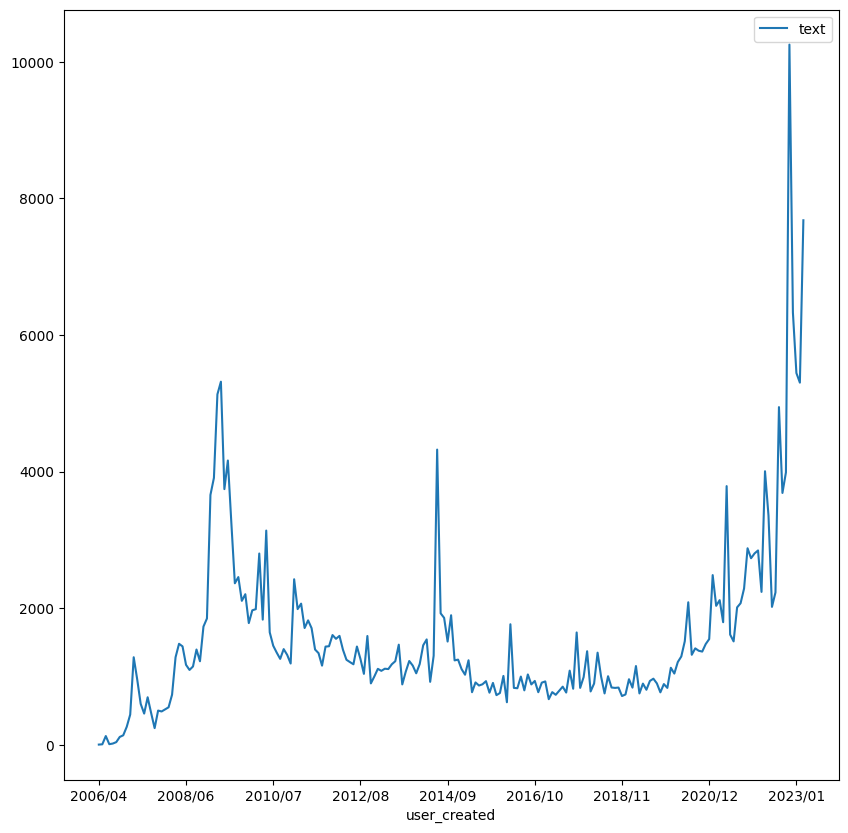

In [15]:
# plot the chart
twitter_chart1.plot(figsize=(10,10))

In [16]:
## Check the number of hashtag
## Clean the Non-alphabet and Non-numerical characters in the hashtags
## Define the function clean_text
def clean_text(col):
    Cleaned_Text = []
    for i in range(len(col)):
        text = col[i]
        try:
            text = re.sub('[^A-Za-z0-9]', ' ', text) 
            text = text.lower()
            text_list = text.split() 
        except:
            continue
        Cleaned_Text.extend(text_list)
    return Cleaned_Text

In [17]:
Cleaned_HashTags = clean_text(twitter_df['hashtags'])
hashTagNum=Counter(Cleaned_HashTags)

In [18]:
# Ascending the sequent of Occurrances
hashTag_df = pd.DataFrame([hashTagNum]).T.sort_values(0, ascending=False)
hashTag_df.head(10)

,0
chatgpt,263851
ai,59013
openai,19497
gpt4,8767
artificialintelligence,8523
nft,6827
google,5715
gpt,5367
airdrop,5201
crypto,5078


In [19]:
## Draw the chart about the Popularity of most popular ten Hashtags along the decade
HashTag_Top10 = hashTag_df.index[:10]
HashTag_Top10

Index(['chatgpt', 'ai', 'openai', 'gpt4', 'artificialintelligence', 'nft',
       'google', 'gpt', 'airdrop', 'crypto'],
      dtype='object')

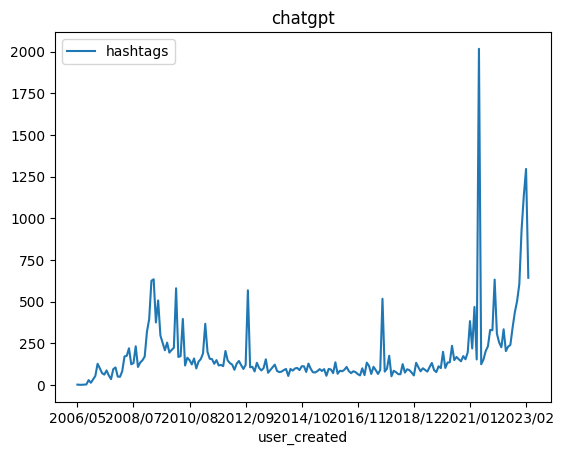

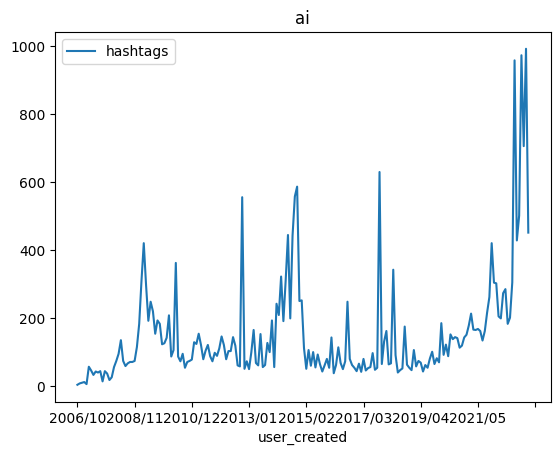

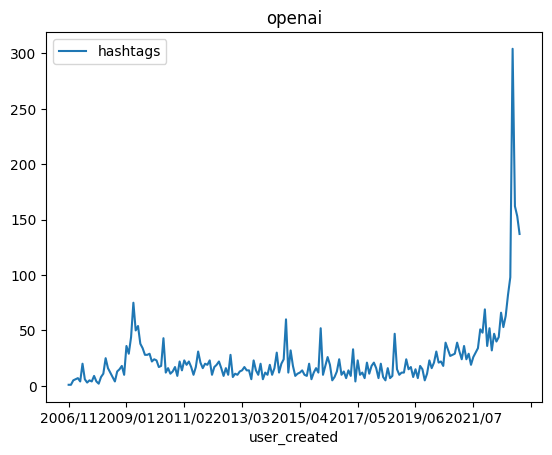

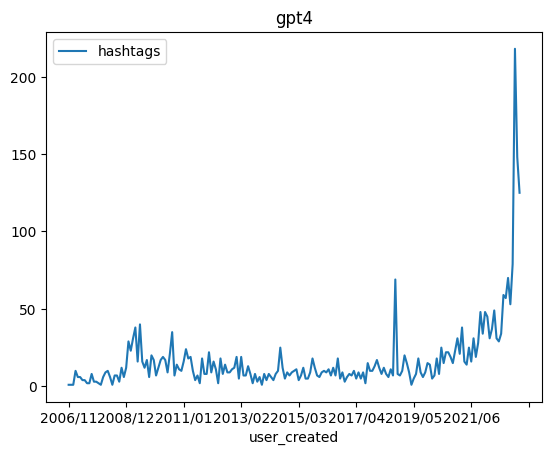

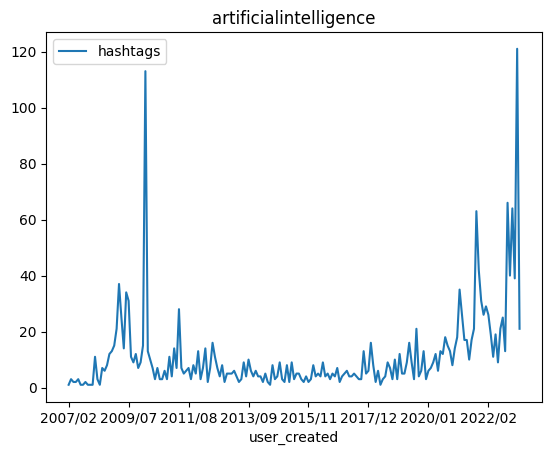

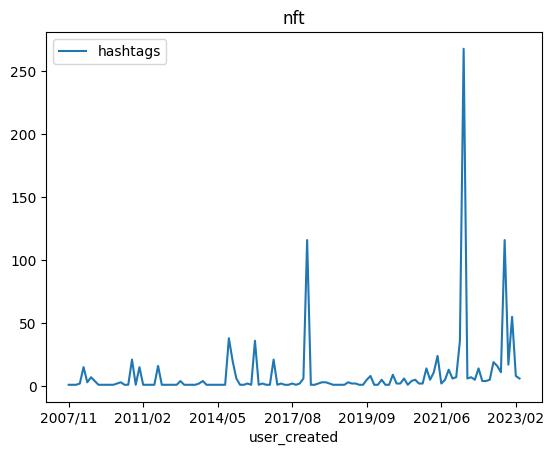

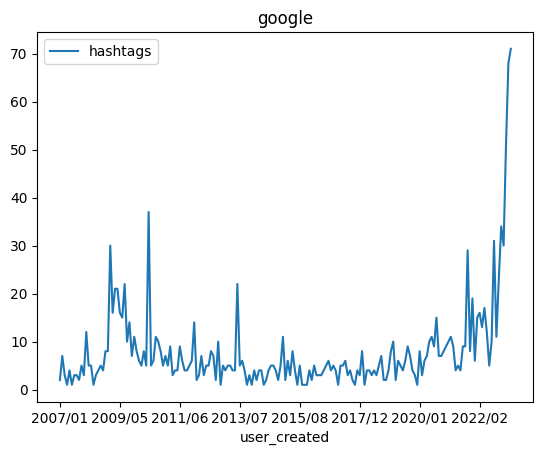

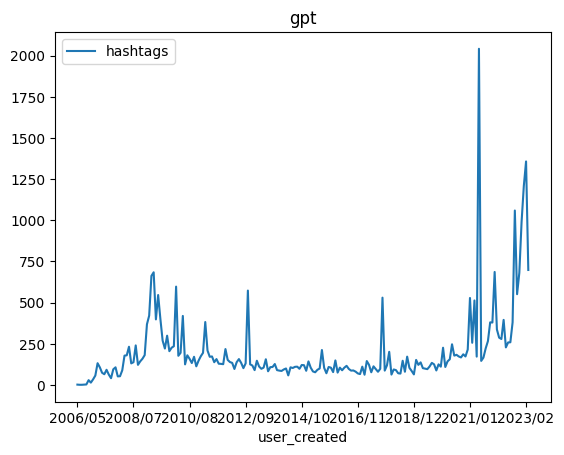

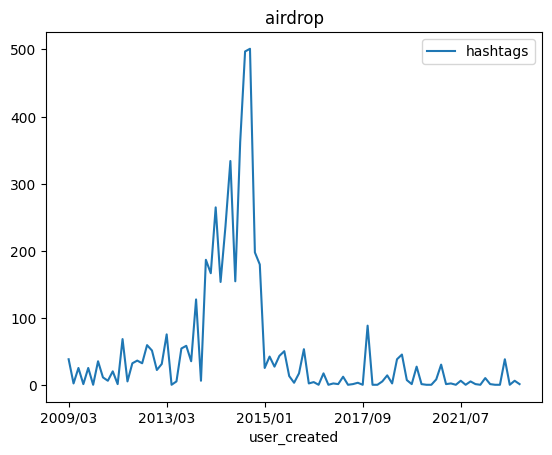

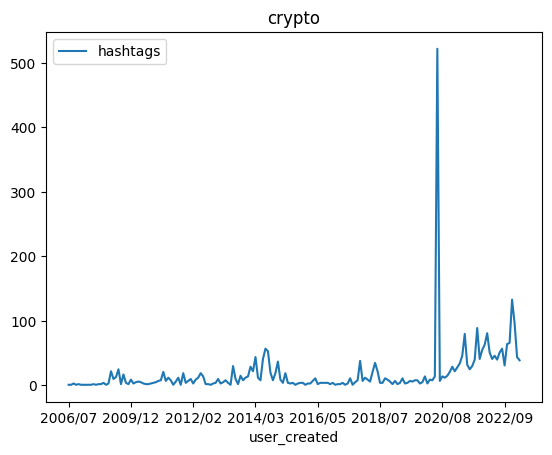

In [20]:
# Plot the change trend of HashTag and month by month
for i in HashTag_Top10:
    hashTag_month_df = twitter_df[twitter_df['hashtags'].map(lambda x: True if i in x else False)]
    a = hashTag_month_df.groupby('user_created').count()[['hashtags']].plot()
    a.set_title(i)

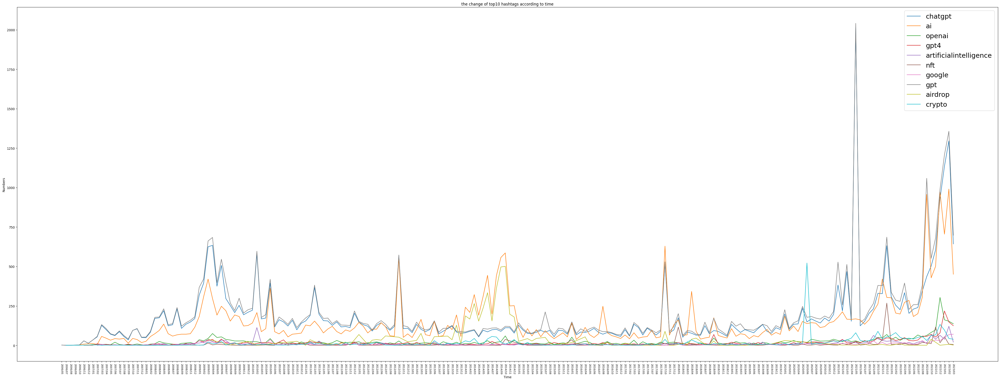

In [21]:
# Draw 10 HashTags and time trends on the same chart
fig = plt.figure(figsize=(55,20))
ax = fig.add_subplot(1,1,1)
for i in HashTag_Top10:
    hashTag_month_df = twitter_df[twitter_df['hashtags'].map(lambda x: True if i in x else False)]
    y = hashTag_month_df.groupby('user_created').count()[['hashtags']]['hashtags']
    x = hashTag_month_df.groupby('user_created').count()[['hashtags']].index.tolist()
    ax.plot(x,y,label=i)
plt.legend(bbox_to_anchor=(1,1),prop={'size':21})
plt.tick_params(axis='x',labelsize=8)
plt.xlabel('Time')
plt.xticks(rotation=-90)
plt.ylabel('Numbers')
plt.title('the change of top10 hashtags according to time')
plt.show()

# 2. NLTK Setimental Analysis

In [22]:
twitter_df

,user_name,text,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,hashtags,source
0,Black Women in A.I.,We asked ChatGPT... Would you attend a church ...,Global,Amplifying the voices of Black Women In Artifi...,2017/12,6073.0,999.0,14943,False,2023-04-30 13:07:25+00:00,"['100DaysofCode', 'AI', 'Python', 'church']",Twitter Web App
1,Dan Bruno AI,"We Need a Consumer-First AI Approach, Consumer...","Manchester, NH","The latest in #ChatGPT, #BARD, #Bing, and othe...",2021/05,461.0,156.0,5193,False,2023-04-30 13:05:33+00:00,"['chatgpt', 'AI', 'openAI']",dlvr.it
2,Hamza Aideed,I asked #ChatGPT the difference between #Somal...,somaliland,"Somalilander, \nmining expert,\nfinancial cons...",2020/12,340.0,164.0,735,False,2023-04-30 13:05:14+00:00,"['ChatGPT', 'Somaliland', 'Somalia']",Twitter for Android
3,JC Gaillard,Rethinking Safer #AI &gt;&gt; Can There Really...,"London, England",Founder @CorixPartners @Transform_Sec | Fellow...,2015/06,8970.0,8359.0,153347,False,2023-04-30 13:05:01+00:00,"['AI', 'tech']",Buffer
4,seamlessblend,ChatGPT &amp; fraud: https://t.co/yDQBGRQ8RM #...,"New York, NY",NaN,2010/02,1980.0,1.0,1302,False,2023-04-30 13:04:59+00:00,"['chatgpt', 'regulation', 'artificialintellige...",dancehallaudio
...,...,...,...,...,...,...,...,...,...,...,...,...
319288,Nenu,"ChatGPT is the biggest, smartest brain 🧠 in th...",NaN,Your brain is not meant for processing million...,2022/08,6.0,87.0,738,False,2022-12-05 17:11:10+00:00,['ChatGPT'],Twitter Web App
319289,Green,Iterating back-and-forth with tools like #Chat...,🍁,NaN,2022/12,3.0,33.0,3,False,2022-12-05 17:09:22+00:00,['ChatGPT'],Twitter Web App
319290,Gabriel Furstenheim,Russel vs ChatGPT. It's also funny that it tak...,NaN,Mathematician and Developer @Amazon. Previousl...,2016/07,80.0,34.0,169,False,2022-12-05 17:09:04+00:00,['ChatGPT'],Twitter for Android
319291,Devang,Was just wondering is there any difference bet...,United States,"passionate by nature, software developer by pr...",2015/05,15.0,86.0,307,False,2022-12-05 17:08:44+00:00,"['ChatGPT', 'GPT3']",Twitter for Android


In [23]:
# Delete the @Username in the twitter_df['text']
def clean_Tweet_Text(text):
    text_list = text.split()
    for i in range(len(text_list)-1,-1,-1):
        if '@' in text_list[i]:
            del text_list[i]
    return ' '.join(text_list)

twitter_df['text'] = twitter_df['text'].map(clean_Tweet_Text)

In [24]:
# Import SentimentIntensityAnalyzer from NLTK.Vader
sid = SentimentIntensityAnalyzer()

In [25]:
# In NLTK, no matter Neg or Pos, the polarity score more than 0.2, I will adopt it as real and effective sentiment.
PostiveIndex = []
NegativeIndex = []
for r in range(len(twitter_df['text'])):
    rev = twitter_df['text'][r] 
    SentimentScores = sid.polarity_scores(rev) 
    if SentimentScores['pos']> 0.2:
        PostiveIndex.append(1)
    else:
        PostiveIndex.append(0)
      
    if SentimentScores['neg']> 0.2:
        NegativeIndex.append(1)
    else:
        NegativeIndex.append(0) 
        
twitter_df['Positive'] = PostiveIndex   
twitter_df['Negative'] = NegativeIndex
twitter_df.head(50) 

,user_name,text,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,hashtags,source,Positive,Negative
0,Black Women in A.I.,We asked ChatGPT... Would you attend a church ...,Global,Amplifying the voices of Black Women In Artifi...,2017/12,6073.0,999.0,14943,False,2023-04-30 13:07:25+00:00,"['100DaysofCode', 'AI', 'Python', 'church']",Twitter Web App,0,0
1,Dan Bruno AI,"We Need a Consumer-First AI Approach, Consumer...","Manchester, NH","The latest in #ChatGPT, #BARD, #Bing, and othe...",2021/05,461.0,156.0,5193,False,2023-04-30 13:05:33+00:00,"['chatgpt', 'AI', 'openAI']",dlvr.it,0,0
2,Hamza Aideed,I asked #ChatGPT the difference between #Somal...,somaliland,"Somalilander, \nmining expert,\nfinancial cons...",2020/12,340.0,164.0,735,False,2023-04-30 13:05:14+00:00,"['ChatGPT', 'Somaliland', 'Somalia']",Twitter for Android,0,0
3,JC Gaillard,Rethinking Safer #AI &gt;&gt; Can There Really...,"London, England",Founder @CorixPartners @Transform_Sec | Fellow...,2015/06,8970.0,8359.0,153347,False,2023-04-30 13:05:01+00:00,"['AI', 'tech']",Buffer,0,0
4,seamlessblend,ChatGPT &amp; fraud: https://t.co/yDQBGRQ8RM #...,"New York, NY",NaN,2010/02,1980.0,1.0,1302,False,2023-04-30 13:04:59+00:00,"['chatgpt', 'regulation', 'artificialintellige...",dancehallaudio,0,0
5,seamlessblend,ChatGPT at work: https://t.co/yDQBGRQ8RM #chat...,"New York, NY",NaN,2010/02,1980.0,1.0,1302,False,2023-04-30 13:04:58+00:00,"['chatgpt', 'automation', 'productivity', 'aip...",dancehallaudio,0,0
6,sopbox,Revolutionize your workflow with #SOPbox - the...,NaN,SOPbox by Parsimony. Let's get it done!,2021/03,3.0,1.0,1,False,2023-04-30 13:04:27+00:00,['SOPbox'],Heropost,0,0
7,Parsimony ERP,Revolutionize your workflow with #SOPbox - the...,"Bellevue, WA",NaN,2017/11,17.0,36.0,10,False,2023-04-30 13:04:25+00:00,['SOPbox'],Heropost,0,0
8,Ameer Hamza Rafiq,#ChatGPT #prompt #01 Improve your writing by g...,"Mian Channun, Pakistan",So if you're ready to take your brand to the n...,2022/04,13.0,21.0,14,False,2023-04-30 13:04:20+00:00,"['ChatGPT', 'prompt']",Twitter for Android,0,0
9,M.,#chatGPT asked a person to commit suicide... u...,Vancouver📍Beirut,TV Director|Scriptwriter|Opinionated,2012/10,125.0,364.0,2897,False,2023-04-30 13:03:47+00:00,['chatGPT'],Twitter for iPhone,1,0


In [26]:
## Set three attitudes from tweet review: "Positive", "Negative", "Neutral"
## Make three charts for three attitudes grouped by time
## Create a new subchart to store the new chart
twitter_df_sentiment = twitter_df[['user_created', 'Positive', 'Negative']]

In [27]:
## Define a function to judge the sentiment, based on twitter_df[Positive] and twitter_df[Negative]
def JudgeSen(col1, col2):
    Atti = [1]
    if(col1==1 and col2==0):
        Atti = "Pos"
    elif(col1==0 and col2==1):
        Atti = "Neg"
    else:
        Atti = "Neu"
    return Atti

In [28]:
## Add a new column named attitude to the chart twitter_df_sentiment
twitter_df_sentiment['attitude'] = twitter_df_sentiment.apply(lambda row: JudgeSen(row.Positive,row.Negative), axis=1)

/tmp/ipykernel_22321/4047103197.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  twitter_df_sentiment['attitude'] = twitter_df_sentiment.apply(lambda row: JudgeSen(row.Positive,row.Negative), axis=1)


In [29]:
## Added Successfully
twitter_df_sentiment = twitter_df_sentiment.drop(columns=['Positive', 'Negative'])
twitter_df_sentiment.head()

,user_created,attitude
0,2017/12,Neu
1,2021/05,Neu
2,2020/12,Neu
3,2015/06,Neu
4,2010/02,Neu


In [30]:
### Create the chart of Neu
twitter_sentiment_Neu = twitter_df_sentiment.groupby('user_created')['attitude'].apply(lambda x: (x=="Neu").sum()).reset_index(name="Neu")
twitter_sentiment_Neu.head()

,user_created,Neu
0,2006/04,1
1,2006/05,3
2,2006/07,103
3,2006/08,5
4,2006/09,12


In [31]:
### Create the chart of Pos
twitter_sentiment_Pos = twitter_df_sentiment.groupby('user_created')['attitude'].apply(lambda x: (x=="Pos").sum()).reset_index(name="Pos")
twitter_sentiment_Pos.head()

,user_created,Pos
0,2006/04,0
1,2006/05,2
2,2006/07,19
3,2006/08,2
4,2006/09,4


In [32]:
### Create the chart of Neg
twitter_sentiment_Neg = twitter_df_sentiment.groupby('user_created')['attitude'].apply(lambda x: (x=="Neg").sum()).reset_index(name="Neg")
twitter_sentiment_Neg.head()

,user_created,Neg
0,2006/04,0
1,2006/05,0
2,2006/07,4
3,2006/08,0
4,2006/09,0


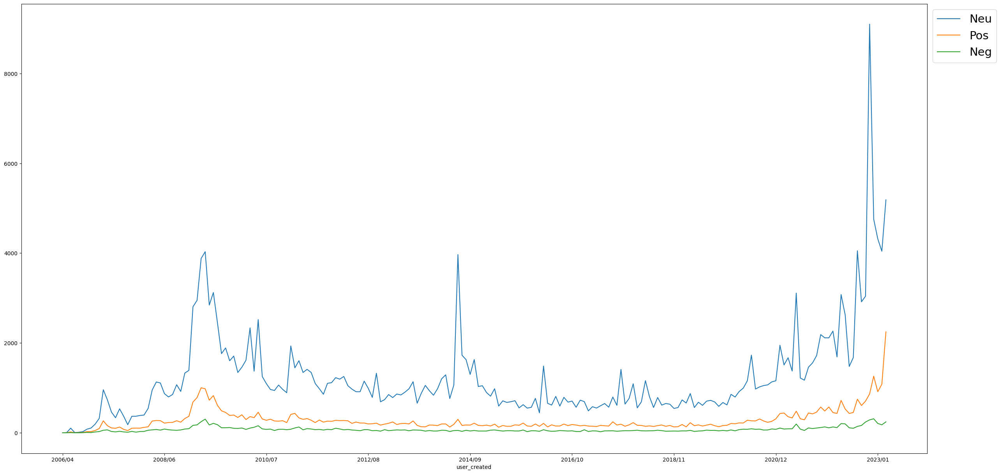

In [33]:
### draw the sentiment in one Coordinate system
ax = twitter_sentiment_Neu.plot(x='user_created', figsize=(30, 15))
twitter_sentiment_Pos.plot(x='user_created', ax=ax)
twitter_sentiment_Neg.plot(x='user_created', ax=ax)
ax.legend(bbox_to_anchor=(1,1),prop={'size':21})

# 3. Analyzing Text Theme Using LDA Method

In [34]:
twitter_df

,user_name,text,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,hashtags,source,Positive,Negative
0,Black Women in A.I.,We asked ChatGPT... Would you attend a church ...,Global,Amplifying the voices of Black Women In Artifi...,2017/12,6073.0,999.0,14943,False,2023-04-30 13:07:25+00:00,"['100DaysofCode', 'AI', 'Python', 'church']",Twitter Web App,0,0
1,Dan Bruno AI,"We Need a Consumer-First AI Approach, Consumer...","Manchester, NH","The latest in #ChatGPT, #BARD, #Bing, and othe...",2021/05,461.0,156.0,5193,False,2023-04-30 13:05:33+00:00,"['chatgpt', 'AI', 'openAI']",dlvr.it,0,0
2,Hamza Aideed,I asked #ChatGPT the difference between #Somal...,somaliland,"Somalilander, \nmining expert,\nfinancial cons...",2020/12,340.0,164.0,735,False,2023-04-30 13:05:14+00:00,"['ChatGPT', 'Somaliland', 'Somalia']",Twitter for Android,0,0
3,JC Gaillard,Rethinking Safer #AI &gt;&gt; Can There Really...,"London, England",Founder @CorixPartners @Transform_Sec | Fellow...,2015/06,8970.0,8359.0,153347,False,2023-04-30 13:05:01+00:00,"['AI', 'tech']",Buffer,0,0
4,seamlessblend,ChatGPT &amp; fraud: https://t.co/yDQBGRQ8RM #...,"New York, NY",NaN,2010/02,1980.0,1.0,1302,False,2023-04-30 13:04:59+00:00,"['chatgpt', 'regulation', 'artificialintellige...",dancehallaudio,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319288,Nenu,"ChatGPT is the biggest, smartest brain 🧠 in th...",NaN,Your brain is not meant for processing million...,2022/08,6.0,87.0,738,False,2022-12-05 17:11:10+00:00,['ChatGPT'],Twitter Web App,1,0
319289,Green,Iterating back-and-forth with tools like #Chat...,🍁,NaN,2022/12,3.0,33.0,3,False,2022-12-05 17:09:22+00:00,['ChatGPT'],Twitter Web App,0,0
319290,Gabriel Furstenheim,Russel vs ChatGPT. It's also funny that it tak...,NaN,Mathematician and Developer @Amazon. Previousl...,2016/07,80.0,34.0,169,False,2022-12-05 17:09:04+00:00,['ChatGPT'],Twitter for Android,0,0
319291,Devang,Was just wondering is there any difference bet...,United States,"passionate by nature, software developer by pr...",2015/05,15.0,86.0,307,False,2022-12-05 17:08:44+00:00,"['ChatGPT', 'GPT3']",Twitter for Android,0,0


In [35]:
# Based on Porter stemming algorithm
from nltk.stem import PorterStemmer  
import re

porter = PorterStemmer()

documents = twitter_df['text']
Cleaned_doc = []
for r in range(len(documents)):
    review = documents[r]
    try:
        # Remove non-alphabetic characters
        review = re.sub('[^A-Za-z]', ' ', review) 
        # lowercase character
        review = review.lower()
        # split words make it to single
        Tokens = review.split()
        # Remove the words, whose length is less than 3
        Filtered_token = [w for w in Tokens if len(w)>3]
        # Assembling words into string
        review = ' '.join(Filtered_token)        
    except:
        continue
    # Save the clean text to Cleaned_doc
    Cleaned_doc.append(review)  

i = 0
for i in Cleaned_doc[:100]:
    print('-[Review Text]: ', i)
    

-[Review Text]:  asked chatgpt would attend church with generated pastor daysofcode python church religion stem tech bard chatgpt microsoft apple google sunday pastor blacktechtwitter bwiai https betgqguhjs
-[Review Text]:  need consumer first approach consumer reports says gizmodo chatgpt openai https kulevgjahp
-[Review Text]:  asked chatgpt difference between somaliland somalia this answer shockingly https mpjkwg
-[Review Text]:  rethinking safer there really truthgpt https cqco tech artificialintelligence chatgpt generativeai openai digital innovation ethics bias algorithms aiethics leadership https lrrnqzngoh
-[Review Text]:  chatgpt fraud https ydqbgrq chatgpt regulation artificialintelligence largelanguagemodel neuralnetworks promptengineering machinelearning deeplearning lawenforcement security cybersecurity
-[Review Text]:  chatgpt work https ydqbgrq chatgpt automation productivity aiproductivity jobproductivity businessmanagement smallbusiness executivemba executivetraining b

In [36]:
# Remove the stop words of English in the Text
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

for r in range(len(Cleaned_doc)):
    each_item = []
    for t in Cleaned_doc[r].split():
        if t not in stop_words:
             each_item.append(t)
    Cleaned_doc[r] = ' '.join(each_item) 
    
i = 0
for i in Cleaned_doc[:100]:
    print('-[Review Text]: ', i)

-[Review Text]:  asked chatgpt would attend church generated pastor daysofcode python church religion stem tech bard chatgpt microsoft apple google sunday pastor blacktechtwitter bwiai https betgqguhjs
-[Review Text]:  need consumer first approach consumer reports says gizmodo chatgpt openai https kulevgjahp
-[Review Text]:  asked chatgpt difference somaliland somalia answer shockingly https mpjkwg
-[Review Text]:  rethinking safer really truthgpt https cqco tech artificialintelligence chatgpt generativeai openai digital innovation ethics bias algorithms aiethics leadership https lrrnqzngoh
-[Review Text]:  chatgpt fraud https ydqbgrq chatgpt regulation artificialintelligence largelanguagemodel neuralnetworks promptengineering machinelearning deeplearning lawenforcement security cybersecurity
-[Review Text]:  chatgpt work https ydqbgrq chatgpt automation productivity aiproductivity jobproductivity businessmanagement smallbusiness executivemba executivetraining boardroom managementscien

In [37]:
# Count the number of occurances of words
from sklearn.feature_extraction.text import CountVectorizer
count_vectorizer = CountVectorizer()
count_data = count_vectorizer.fit_transform(Cleaned_doc)
count_data

<319293x378121 sparse matrix of type '<class 'numpy.int64'>'
	with 4063033 stored elements in Compressed Sparse Row format>

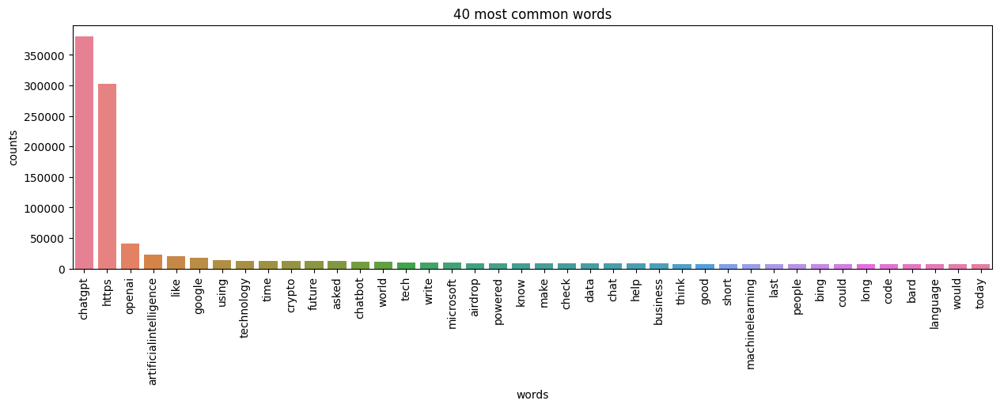

In [38]:
# count the frequency of words
import numpy as np
import seaborn as sns
# Collection words of all text
terms = count_vectorizer.get_feature_names_out()

# count the popularity of each word
total_counts = np.zeros(len(terms))
for t in count_data:
    total_counts+=t.toarray()[0]

count_dict = (zip(terms, total_counts))
count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:40] #Take the top 40 words
    
words = [w[0] for w in count_dict]
counts = [w[1] for w in count_dict]
x_pos = np.arange(len(words))
    
plt.figure(2, figsize=(15, 4))
plt.subplot(title='40 most common words')
sns.set_context("notebook", font_scale=1.25, rc={"lines.linewidth": 2.5})
sns.barplot(x=x_pos,y=counts, palette='husl')
plt.xticks(x_pos, words, rotation=90) 
plt.xlabel('words')
plt.ylabel('counts')
plt.show()

In [39]:
## Filter out the words whose frequency is too high or too low.
keepIndex = [];
for t in range(len(total_counts)):
    if total_counts[t] < 15000 and total_counts[t] > 50:
        keepIndex.append(t)

print('Number after filtering: ', len(keepIndex))

#Save the remain ing term and frequency data
ReducedTerm = [terms[t] for t in keepIndex]
ReducedCount = count_data[:,keepIndex] 
ReducedCount

Number after filtering:  6522


<319293x6522 sparse matrix of type '<class 'numpy.int64'>'
	with 2689728 stored elements in Compressed Sparse Row format>

In [40]:
ReducedTerm

['aachen',
 'aapl',
 'aaron',
 'abilities',
 'ability',
 'able',
 'absolute',
 'absolutely',
 'abstract',
 'abstracts',
 'absurd',
 'abuse',
 'abused',
 'academia',
 'academic',
 'academicchatter',
 'academicintegrity',
 'academics',
 'academictwitter',
 'academy',
 'accelerate',
 'accelerated',
 'accelerating',
 'acceleration',
 'accept',
 'acceptable',
 'accepted',
 'accepting',
 'access',
 'accessibility',
 'accessible',
 'accessing',
 'accident',
 'accidentally',
 'accomplish',
 'according',
 'account',
 'accountability',
 'accountants',
 'accounting',
 'accounts',
 'accuracy',
 'accurate',
 'accurately',
 'accused',
 'achieve',
 'achieved',
 'achievement',
 'achieving',
 'acknowledge',
 'acquire',
 'acquired',
 'acquisition',
 'across',
 'acting',
 'action',
 'actions',
 'active',
 'actively',
 'activities',
 'activity',
 'actor',
 'actors',
 'actress',
 'acts',
 'actual',
 'actually',
 'adam',
 'adani',
 'adapt',
 'adapting',
 'added',
 'addicted',
 'addiction',
 'addictive',
 'a

In [41]:
# Import LDA to analyze the weight of each word
from sklearn.decomposition import LatentDirichletAllocation as LDA
number_topics = 10
lda = LDA(n_components=number_topics, n_jobs=-1)
lda.fit(ReducedCount)
lda.components_ 

array([[ 0.1       ,  0.10000274,  0.10001915, ..., 21.74370628,
         0.1       ,  0.10000226],
       [ 0.1       ,  0.10000294,  0.10000154, ...,  0.10000423,
         0.1       ,  0.1000089 ],
       [ 0.1       ,  0.1000047 ,  0.10000524, ...,  0.10001946,
         0.1       ,  0.10001104],
       ...,
       [ 0.1       ,  0.10000148,  0.10003381, ..., 11.40655923,
         0.1       ,  0.10000108],
       [ 0.1       ,  0.10000152,  0.10006304, ..., 88.46919931,
         0.1       ,  0.10000832],
       [ 0.1       ,  0.100001  ,  0.1000036 , ...,  0.33674447,
         0.1       ,  0.10001426]])

In [42]:
Word_Topics_Pro = lda.components_ / lda.components_.sum(axis=1)[:, np.newaxis]
print(Word_Topics_Pro)

[[4.26214959e-07 4.26226622e-07 4.26296589e-07 ... 9.26749286e-05
  4.26214958e-07 4.26224600e-07]
 [9.08103184e-07 9.08129903e-07 9.08117127e-07 ... 9.08141567e-07
  9.08103183e-07 9.08184047e-07]
 [4.23102580e-07 4.23122453e-07 4.23124754e-07 ... 4.23184920e-07
  4.23102579e-07 4.23149298e-07]
 ...
 [4.82422484e-07 4.82429639e-07 4.82585606e-07 ... 5.50278063e-05
  4.82422483e-07 4.82427697e-07]
 [2.99951509e-07 2.99956063e-07 3.00140605e-07 ... 2.65364698e-04
  2.99951509e-07 2.99976467e-07]
 [4.44837417e-07 4.44841856e-07 4.44853422e-07 ... 1.49796541e-06
  4.44837417e-07 4.44900832e-07]]


In [43]:
## Words of Topic sequence
for topic_idx, topic in enumerate(Word_Topics_Pro):
    print("\nTopic #%d:" % topic_idx)
    count_dict = (zip(ReducedTerm, topic))
    count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:5]
    for w in count_dict:
        print(w[0], ': {0:.3f}'.format(w[1]))


Topic #0:
business : 0.026
technology : 0.024
marketing : 0.017
chatbot : 0.015
prompts : 0.015

Topic #1:
last : 0.068
powered : 0.067
short : 0.066
long : 0.065
price : 0.053

Topic #2:
content : 0.028
world : 0.017
data : 0.015
writing : 0.014
users : 0.014

Topic #3:
crypto : 0.065
airdrop : 0.050
bitcoin : 0.025
future : 0.022
doge : 0.020

Topic #4:
microsoft : 0.040
bing : 0.031
bard : 0.030
search : 0.028
chatbot : 0.015

Topic #5:
asked : 0.013
write : 0.009
using : 0.007
would : 0.007
think : 0.006

Topic #6:
free : 0.036
news : 0.029
trading : 0.025
stocks : 0.022
options : 0.018

Topic #7:
education : 0.021
students : 0.014
jobs : 0.011
going : 0.010
edtech : 0.010

Topic #8:
future : 0.016
game : 0.014
language : 0.013
know : 0.009
check : 0.009

Topic #9:
machinelearning : 0.029
midjourney : 0.028
resume : 0.024
python : 0.020
aiart : 0.017


In [44]:
df_topic_keywords = pd.DataFrame(Word_Topics_Pro)
df_topic_keywords.columns = ReducedTerm
df_topic_keywords 

,aachen,aapl,aaron,abilities,ability,able,absolute,absolutely,abstract,abstracts,...,zapier,zdnet,zero,zerotrust,zftw,zksync,zone,zoom,zqssag,zuckerberg
0,4.262150e-07,4.262266e-07,4.262966e-07,6.205598e-07,1.025935e-04,8.419886e-05,4.263732e-07,4.262693e-07,4.262320e-07,4.262157e-07,...,4.025759e-04,4.262394e-07,4.262755e-07,4.262782e-07,4.262150e-07,9.622023e-04,4.264991e-07,9.267493e-05,4.262150e-07,4.262246e-07
1,9.081032e-07,9.081299e-07,9.081171e-07,9.081413e-07,9.081291e-07,9.081431e-07,9.081305e-07,9.081528e-07,9.081276e-07,9.081091e-07,...,9.081106e-07,9.081032e-07,9.081762e-07,4.238449e-04,5.276079e-04,9.081039e-07,9.082600e-07,9.081416e-07,9.081032e-07,9.081840e-07
2,4.231026e-07,4.231225e-07,4.231248e-07,4.452703e-06,3.322027e-04,4.702099e-04,1.874448e-06,4.232483e-07,4.232055e-07,2.282031e-04,...,4.231157e-07,5.517661e-05,5.487543e-05,4.231162e-07,4.231026e-07,1.148245e-03,2.249192e-05,4.231849e-07,4.231026e-07,4.231493e-07
3,5.577760e-07,8.679039e-05,5.577846e-07,5.577856e-07,5.577970e-07,5.579204e-07,5.578266e-07,5.848485e-06,5.577915e-07,5.577765e-07,...,5.577805e-07,5.577803e-07,1.389163e-05,6.429087e-05,5.577803e-07,1.314922e-03,5.581660e-07,5.577989e-07,5.577761e-07,5.066531e-05
4,2.541335e-04,1.563825e-04,4.228786e-07,4.229064e-07,4.309304e-07,5.578553e-05,4.689168e-07,1.473034e-06,4.228550e-07,4.228511e-07,...,4.228747e-07,4.230287e-07,4.229230e-07,4.228582e-07,4.228511e-07,6.745076e-04,4.228914e-07,1.545256e-04,4.228511e-07,2.584318e-04
5,1.100970e-07,1.101015e-07,9.570324e-07,1.534277e-04,9.590550e-04,1.999737e-03,8.994756e-05,4.378610e-04,1.210500e-04,1.392000e-06,...,1.101024e-07,1.101032e-07,2.289762e-04,1.100980e-07,1.100970e-07,1.100972e-07,6.627537e-05,1.101105e-07,1.100970e-07,1.101036e-07
6,6.984668e-07,8.783712e-04,4.423433e-04,7.029795e-07,6.985188e-07,7.015188e-07,6.985303e-07,8.612084e-07,6.985327e-07,6.984710e-07,...,6.984800e-07,6.985065e-07,6.390644e-05,6.985182e-07,6.984673e-07,6.984767e-07,6.987681e-07,6.986143e-07,1.460494e-03,6.985468e-07
7,4.824225e-07,4.824296e-07,4.825856e-07,4.824757e-07,4.824947e-07,4.307048e-05,5.786700e-05,1.161600e-04,4.824609e-07,4.824340e-07,...,4.824306e-07,4.824703e-07,6.498510e-05,4.824933e-07,4.824225e-07,4.824268e-07,4.555643e-05,5.502781e-05,4.824225e-07,4.824277e-07
8,2.999515e-07,2.999561e-07,3.001406e-07,4.974530e-04,7.280160e-04,3.426409e-04,1.602576e-04,3.347149e-04,2.999772e-07,2.999673e-07,...,2.999589e-07,1.294560e-04,2.145806e-04,2.999756e-07,2.999515e-07,2.999530e-07,2.999923e-07,2.653647e-04,2.999515e-07,2.999765e-07
9,4.448374e-07,4.448419e-07,4.448534e-07,4.448731e-07,4.448874e-07,5.213138e-07,2.190662e-05,1.147985e-04,2.680210e-04,4.448488e-07,...,2.556148e-05,4.448468e-07,1.783992e-04,4.449126e-07,4.448382e-07,4.448381e-07,1.531714e-05,1.497965e-06,4.448374e-07,4.449008e-07


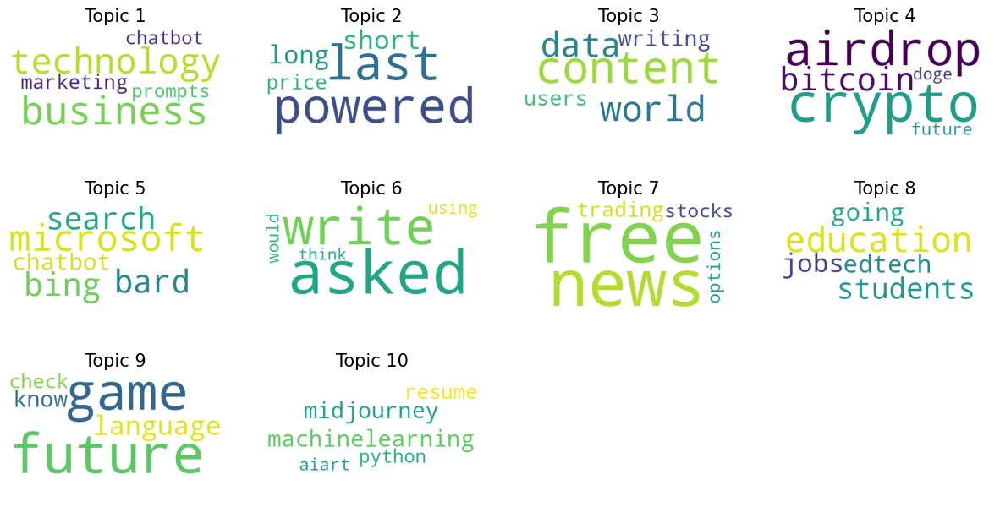

In [45]:
# Draw the WordCloud for each topic
from wordcloud import WordCloud
import math

rows = math.ceil(len(lda.components_)/4)
fig, ax = plt.subplots(rows, 4, figsize=(15,2.5*rows))
[axi.set_axis_off() for axi in ax.ravel()]

for i, comp in enumerate(lda.components_):
    terms_comp = zip(ReducedTerm, abs(comp))
    sorted_terms = sorted(terms_comp, key= lambda x:x[1], reverse=True)[:5] 
    # Dictionary the top 10 of the words in each topic
    Word_Frequency = dict(sorted_terms[0:10])
    # Generate WordCloud map
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(Word_Frequency)
    # Visualization
    subfig_Row = math.floor(i/4)
    subfig_Col = math.ceil(i%4)
    ax[subfig_Row,subfig_Col].imshow(wordcloud)
    ax[subfig_Row,subfig_Col].set_title("Topic {}".format(i+1)) 
        
plt.show() 

In [46]:
Cleaned_doc_new = []
print('CLEANED TEXT NEW: ')
for r in range(len(Cleaned_doc)):
    each_item = []
    for t in Cleaned_doc[r].split():
        # Save the lexicon of ReducedTerm
        if t in ReducedTerm:
             each_item.append(t)
    Cleaned_doc_new.append(each_item) 
    print(Cleaned_doc_new[r])

CLEANED TEXT NEW: 
['asked', 'would', 'attend', 'church', 'generated', 'daysofcode', 'python', 'church', 'religion', 'stem', 'tech', 'bard', 'microsoft', 'apple', 'sunday']
['need', 'consumer', 'first', 'approach', 'consumer', 'reports', 'says']
['asked', 'difference', 'answer']
['safer', 'really', 'truthgpt', 'tech', 'generativeai', 'digital', 'innovation', 'ethics', 'bias', 'algorithms', 'aiethics', 'leadership']
['fraud', 'ydqbgrq', 'regulation', 'largelanguagemodel', 'neuralnetworks', 'promptengineering', 'machinelearning', 'deeplearning', 'lawenforcement', 'security', 'cybersecurity']
['work', 'ydqbgrq', 'automation', 'productivity', 'aiproductivity', 'jobproductivity', 'businessmanagement', 'smallbusiness', 'executivemba', 'executivetraining', 'boardroom', 'managementscience']
['revolutionize', 'workflow', 'chrome', 'extension', 'company', 'side', 'screen', 'integrated', 'seamless', 'access', 'knowledge', 'check', 'productivity', 'efficiency']
['revolutionize', 'workflow', 'chrom

['source', 'material', 'legal', 'industry', 'ydqbgrq', 'lawfirm', 'lawfirms', 'attorney', 'legalindustry', 'consultant', 'paralegal', 'legaladvice']
['even', 'solve', 'maths', 'equation', 'class', 'tried', 'gave', 'wrong', 'answer', 'times']
['free', 'resources', 'content', 'creators', 'contentcreator', 'tech', 'viralvideo', 'elon', 'musk', 'follow']
['playing', 'around', 'checking', 'hype', 'importance', 'written', 'word', 'value', 'number', 'ways', 'good', 'indeed', 'dangerous', 'people', 'think', 'artificalintelligence']
['announces', 'launch', 'driven', 'smart', 'tool', 'blockchain', 'industry', 'integrated']
['want', 'know', 'transform', 'business', 'join', 'webinar', 'real', 'life', 'game', 'changing', 'scenarios', 'register']
['announced', 'morpheus', 'alternative', 'currently', 'tested', 'everyone', 'take', 'part', 'testing', 'matrixainetwork']
['announced', 'morpheus', 'alternative', 'currently', 'tested', 'everyone', 'take', 'part', 'testing', 'matrixainetwork']
['lawmakers',

['takes', 'lead', 'finance', 'sector', 'news', 'plus']
['revolutionary', 'project', 'goes', 'mars', 'xgem', 'dyor', 'machinelearning', 'metaverse']
['weird', 'connection', 'recent', 'movie', 'talks', 'technology', 'able', 'hands', 'correct', 'sound', 'dalle']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['read', 'learn', 'people', 'claiming', 'experts', 'really', 'know']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'stmx', 'stmx']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc', 'nfts', 'nftshill', 'polygonnft', 'tezosnft', 'ethereumnfts']
['weatherupdate', 'karachi', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'haze', 'gen

['sneak', 'peek', 'hype', 'opportunity', 'featuring']
['used', 'time', 'would', 'global', 'network', 'might', 'benefit', 'sustainability', 'insights', 'already', 'certainly', 'fascinating']
['require', 'technical', 'knowledge']
['essential', 'prompts', 'boost', 'productivity', 'artificalintelligence']
['sale', 'domains', 'domainforsale', 'labs', 'crypto', 'cryptocurrency', 'cryptonews', 'defi', 'domainnames', 'cryptocurrencynews', 'nftartist', 'community']
['last', 'time', 'piece', 'software', 'blew', 'away', 'probably']
['baked', 'rogan', 'podcast', 'aigenerated', 'joerogan']
['finance', 'machinelearning']
['insights', 'know', 'grow', 'affordable', 'tools', 'businesses', 'thread', 'generativeai']
['asked', 'give', 'great', 'somebody', 'make', 'movie', 'right']
['trying', 'convince', 'llama', 'planned']
['italy', 'read', 'bitcoin', 'crypto', 'cryptonews']
['pros', 'cons', 'lose']
['rule', 'talking', 'robots', 'monitor', 'copyrighted', 'materials', 'training', 'read', 'bitcoin', 'crypto

['prompt', 'engineering', 'software', 'application', 'developer', 'machinelearning', 'datascience', 'largelanguagemodels']
['worth']
['save', 'energy', 'build', 'better', 'future']
['actively', 'using', 'recently', 'wonderful', 'debugging', 'assistant', 'fill', 'context', 'topic', 'keeps', 'notes', 'full', 'context', 'gives', 'good', 'suggestions', 'best', 'debugging', 'partner', 'ever']
['welcome', 'step']
['solution', 'save', 'environment']
['offering', 'solutions', 'save', 'future']
['offering', 'solutions', 'save', 'energy']
['full', 'list', 'exams']
['need', 'script', 'trade', 'fiverr', 'freelancer', 'python', 'crypto', 'coin', 'token', 'automated', 'agentgpt', 'autogpt', 'help', 'script']
['offering', 'solutions', 'save', 'money']
['translate', 'text', 'code', 'compile']
['high', 'income', 'skills', 'learn', 'artificalintelligence', 'datascience', 'database', 'software', 'developers']
['used', 'develop', 'five', 'personality', 'test', 'program', 'would', 'saved', 'research', 'wan

['experimenting', 'leveraging', 'assist', 'creating', 'functions', 'working', 'writing', 'done', 'days', 'short', 'version', 'useful', 'gets', 'close', 'makes', 'mistakes', 'wonderful', 'generating', 'test', 'data']
['number', 'related', 'tweets', 'block', 'getting', 'ridiculous']
['powering', 'robots', 'robots', 'process', 'files', 'mission', 'data', 'making', 'information', 'accessible', 'creepy', 'part', 'robots', 'express', 'emotion', 'believe', 'moment', 'scary', 'exciting', 'times']
['people', 'working', 'hard', 'getting', 'racism', 'build', 'build', 'youth']
['shocking', 'powerful']
['incredible', 'actually', 'knows', 'shopping', 'temu']
['amazing', 'know', 'latest', 'shopping', 'temu']
['makes', 'errors', 'even', 'tell', 'correct', 'solution', 'happened', 'code', 'computer', 'graphics']
['point', 'data', 'internet', 'makes', 'statement', 'case', 'hallucination', 'adds', 'data', 'internet', 'become', 'biggest', 'information', 'world']
['incredible', 'know', 'everything']
['promp

['study', 'compared', 'written', 'responses', 'physicians', 'real', 'world', 'health', 'questions', 'panel', 'healthcare', 'professionals', 'preferred', 'responses', 'time', 'rated', 'responses', 'higher', 'quality']
['crypto', 'meme', 'projects', 'hitting', 'times', 'square', 'right', 'combine', 'best', 'things', 'crypto', 'projects', 'rising', 'tech', 'field', 'operating', 'system']
['said', 'developed', 'system', 'enables', 'real', 'time', 'answers', 'previous', 'upcoming', 'robots', 'using']
['natural', 'language', 'processing', 'tool', 'driven', 'technology', 'allows', 'human', 'conversations', 'much', 'chatbot']
['microsoft', 'keeps', 'delivering', 'enhanced', 'cybersecurity', 'solutions', 'combat', 'data', 'breaches', 'tools', 'powered', 'indeed', 'transforming', 'future', 'cybersecurity', 'businesses', 'check', 'quick', 'read', 'today']
['provides', 'higher', 'quality', 'answers', 'empathetic', 'real', 'doctor', 'study', 'finds', 'doctors', 'rated', 'responses', 'medical', 'que

['caught', 'crypto', 'airdrop', 'memecontest', 'trendingnow', 'trading', 'fintech', 'defi', 'floki', 'metaverse', 'nftgiveaways', 'arbitrum', 'bonk']
['many', 'people', 'waiting', 'private', 'version', 'heard', 'turn', 'chat', 'history', 'sure', 'good', 'gdpr', 'additional', 'info', 'discussion', 'check', 'ainews']
['better', 'option', 'connect', 'meme', 'viral', 'automation']
['hero', 'midjourney', 'aiartwork', 'digitalart', 'aicommunity', 'anime', 'female']
['enters', 'italy', 'transparency', 'demands']
['could', 'bring', 'conversation', 'life', 'talking', 'person', 'talking', 'video', 'call']
['kicurency', 'still', 'issues', 'withdrawing', 'coin', 'platform', 'frozen', 'fake', 'platform', 'kicurency', 'robecoins', 'drecur', 'fastbitra', 'snbiexe', 'exbiils', 'send', 'message', 'help', 'dollartreats', 'ukraine', 'opensea', 'openseanft']
[]
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc', 'nfts', 'nf

['prompt', 'generating', 'appropriate', 'response', 'create', 'effective', 'prompts']
['check', 'great', 'article', 'harnessing', 'benefits', 'adult', 'education', 'onlinelearning']
['something']
['actually', 'created', 'owns']
['using', 'research', 'tool', 'writes', 'complement', 'productivity', 'across', 'especially', 'young', 'transform', 'nations', 'international', 'policies', 'read', 'piece']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'stmx', 'stmx']
['warnings']
['come', 'retail', 'keyboard']
['exclusive', 'behind', 'lawmakers', 'challenge', 'generative']
['asking', 'write', 'poem', 'studying', 'radiology', 'board', 'exams', 'mind', 'blown', 'masterpiece', 'long', 'tweet', 'website', 'instagram', 'meded']
['huggingchat', 'sense', 'humor', 'love', 'huggingchat']
['code', 'generation', 'ydqbgrq', 'regulation', 'largelanguagemodel', 'neuralnetworks', 'promptengineering', 'machinelearning', 'deeplearning', 'lawenforcement', 

['shocking', 'powerful']
['official', 'medium', 'learn', 'information', 'metaverse', 'bitcoin']
['want', 'earn', 'rewards', 'join', 'late', 'metaverse', 'bitcoin']
['incredible', 'anyone', 'tell', 'temu', 'code', 'really', 'usable']
['unbelievable', 'powerful', 'told', 'temu', 'invitation', 'code']
['convert', 'html', 'html', 'figma', 'html', 'sketch', 'html', 'samsung', 'javascript', 'programming', 'developer', 'softwaredeveloper', 'computerscience', 'webdev', 'webdeveloper', 'webdevelopment', 'daysofcode', 'html']
['gosh', 'anyone', 'tell', 'temu', 'code', 'really', 'usable']
['impressive', 'actually', 'knows', 'shopping', 'temu']
['gosh', 'powerful']
['teaching', 'chemistry', 'control', 'robots']
['amazing', 'know', 'everything']
['incredible', 'powerful']
['impressive', 'know', 'everything']
['amazing', 'powerful']
['amazing', 'powerful']
['incredible', 'powerful']
['impressive', 'anyone', 'tell', 'temu', 'code', 'really', 'usable']
['powerful']
['sale', 'domains', 'domainnames', '

['blocking', 'images', 'browsing', 'content', 'blocking', 'tool', 'many', 'browsers', 'browser', 'extensions', 'offer', 'content', 'blocking', 'features', 'help', 'filter', 'images', 'thought', 'something', 'sophisticated']
['running', 'twice', 'today', 'highly', 'recommend', 'entirely', 'written', 'directed', 'brilliant', 'friend', 'huge', 'congratulations', 'else', 'involved', 'london']
['need', 'spoke', 'work', 'explained', 'even', 'banning', 'models', 'would', 'harm', 'innovation']
['comment', 'ethics', 'large', 'language', 'models', 'medicine', 'medical', 'research', 'ethics']
['vegan', 'food', 'blogger', 'tried', 'recipes', 'business', 'insider']
['curious', 'depth', 'insights', 'provide']
['appears', 'cost', 'server', 'resources', 'money', 'water', 'high', 'environmental', 'impact']
['creator', 'raises', 'valuation', 'firms', 'join', 'funding']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['time', 'wisely']
['watch', 'engineer', '

['prompts', 'need', 'learn', 'anything', 'using', 'prompts', 'included']
['upcoming', 'open', 'class', 'learn', 'following', 'help', 'learn', 'code', 'assistant', 'tool', 'provided']
['point', 'ahead', 'time', 'products', 'meet', 'highest', 'standards', 'give', 'user', 'completely', 'possibilities', 'airdrop', 'crypto', 'trending', 'defi', 'fomo', 'floki']
['tried', 'generate', 'words', 'blog', 'post', 'words', 'okay']
['talking', 'dark', 'reports']
['ready', 'start', 'family', 'finally', 'laid', 'eggs', 'birdbox', 'wait', 'bluetit', 'birdbox', 'watch', 'live', 'rych', 'birdsoftwitter', 'wildisles', 'grafana', 'openvino', 'springwatch', 'python']
['smallbusiness', 'also', 'agreed', 'help', 'business', 'marketing', 'according', 'linkedin', 'report', 'think', 'chatgtp', 'help', 'growth', 'business', 'comment', 'digitalmarketingagency', 'software']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing',

['china', 'embrace', 'advances', 'also', 'control', 'risks', 'wave', 'south', 'china', 'morning', 'post']
['responsible', 'development', 'chatbot', 'share', 'sale', 'worth', 'million', 'valuation', 'ranging', 'billion', 'billion', 'techcrunch']
['databricks', 'entire', 'workforce', 'write', 'training', 'data', 'rival']
['used', 'teachertwitter']
['vtuber', 'vtuber', 'nyororov', 'source']
['asking', 'chat', 'important', 'questions']
['best', 'alternatives', 'thank', 'full', 'details', 'bigdata', 'twitter', 'telehealth', 'tech', 'himss', 'digitalhealth', 'ehealth', 'medtwitter', 'dataviz', 'healthtech', 'mhealth', 'socialmedia']
['mean', 'loves', 'conversation', 'middle', 'serving', 'surprise', 'forcing', 'start', 'fail', 'another', 'works', 'better']
['china', 'embrace', 'advances', 'also', 'control', 'risks', 'wave', 'south', 'china', 'morning', 'post']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc',

['subscribe', 'writer', 'found', 'monthly', 'fees', 'much', 'instead', 'hired', 'someone', 'build', 'free', 'platform', 'provides', 'lower', 'level', 'everyone']
['accessible', 'italy']
['coming', 'good', 'thing']
['italy', 'microsoft', 'backed', 'responds', 'regulator', 'garante', 'italy']
[]
['everyone', 'questions']
['looking', 'forward', 'sharing', 'journey', 'morning', 'adding', 'content', 'every', 'really', 'exciting', 'stuff', 'edtech', 'languages']
['disruptive', 'generativeai', 'investing']
[]
['differ', 'find', 'languagemodel']
['generative', 'existential', 'risk', 'content', 'creators', 'marketing', 'generativeai']
['shit', 'sent', 'needed', 'plus', 'years']
['shocking', 'know', 'latest', 'shopping', 'temu']
['seeing', 'lots', 'folks', 'impact', 'jarvis', 'make', 'obsolete', 'tony', 'make', 'obsolete', 'thread', 'cases', 'chat', 'based', 'make', 'sense', 'matter', 'smart', 'chat']
['referred', 'needs']
['stake', 'crypto', 'altcoin', 'stake']
['also', 'please', 'credit', 'gpt

['unveiled', 'analytics', 'powered', 'tool', 'developed', 'used', 'years', 'government', 'level', 'spot']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc', 'nfts', 'nftshill', 'polygonnft', 'tezosnft', 'ethereumnfts']
['style', 'minor']
['generated', 'controversy', 'implications', 'academic', 'future', 'contentcreation', 'businesses', 'organizations', 'simple', 'question', 'content', 'creators', 'still', 'driver', 'seat', 'find']
['chatbot']
['italy', 'sparks', 'controversy', 'local', 'industry', 'silicon', 'valley', 'matters']
['highlights', 'emerging', 'effectiveness', 'tools', 'within', 'healthcare', 'sounds', 'human', 'humans', 'less', 'specialist', 'specialists', 'quite']
['generativeai', 'creator', 'economy', 'reality', 'hype', 'next', 'prepare']
['university', 'share', 'tips', 'educators', 'course', 'planning', 'designing', 'tests', 'learn', 'work', 'efficiently']
['noun', 'small', 'creature', '

['good', 'ready', 'already', 'opened', 'access', 'sophisticated', 'capabilities', 'away', 'technical', 'experts', 'masses', 'types', 'otherwise', 'unintended', 'cases', 'discovered']
['italian', 'dataprotection', 'authority', 'putting', 'immediate', 'likely', 'decision', 'mark', 'brown', 'risks', 'posed', 'advancement', 'learning', 'read']
['next', 'fitness', 'coach', 'could', 'robot', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['copy', 'paste', 'zero', 'affiliate', 'marketing', 'hero', 'affiliate', 'affiliatemarketing', 'fridaymorning', 'click', 'access']
['mass', 'adoption', 'application', 'fairly', 'security', 'well', 'understood', 'must', 'change', 'cybersecurity', 'largelanguagemodels']
['anyone', 'want', 'collaborate', 'building', 'something', 'cool', 'feel', 'working', 'anything', 'work', 'related', 'want', 'something', 'willing', 'collaborate', 'anyone', 'available

['company', 'announced', 'deep', 'dive', 'generative', 'suite', 'cloud', 'based', 'technologies']
['build', 'anything', 'machine', 'minds']
['privacy', 'options', 'tiktok', 'latest', 'move', 'generative', 'youtube', 'trend', 'series', 'mass', 'twitter', 'dive', 'weekly', 'download']
['company', 'announced', 'deep', 'dive', 'generative', 'suite', 'cloud', 'based', 'technologies']
['wondering', 'smart', 'become', 'check', 'infographic', 'chatbot']
['midjourney', 'tools', 'make', 'legislation', 'crypto', 'cryptocurrency', 'cryptocommunity', 'nfts', 'altcoins', 'cryptonews']
['fake', 'drake', 'frenzy', 'help', 'hurt', 'music', 'industry', 'latest', 'newsletter', 'thoughts', 'media', 'entertainment', 'tech', 'business']
['future', 'alert', 'hospital', 'replace', 'human', 'doctors', 'hospital']
['data', 'privacy', 'security', 'accuracy', 'areas', 'watch', 'segment', 'founder', 'realize', 'weighs', 'influence']
[]
['investing', 'investments', 'redditarmy', 'yolo', 'options', 'news', 'bottomfi

['first', 'existing', 'layer', 'chain', 'embrace', 'functionality', 'leading', 'blockchain', 'technology', 'upcoming', 'plugin', 'prime', 'example', 'innovative', 'approach', 'crypto']
['story', 'competitor', 'recently', 'hugging', 'face', 'released', 'huggingchat', 'opensource', 'chatbot', 'found', 'free']
['world', 'first', 'device', 'demonstration', 'stable', 'diffusion', 'android', 'phone', 'stablediffusion']
['upcoming', 'plugin', 'users', 'able', 'perform', 'various', 'tasks', 'solana', 'blockchain', 'user', 'friendly', 'chatbot', 'interface', 'includes', 'checking', 'wallet', 'tokens', 'buying', 'nfts', 'crypto']
['rewrite', 'suit', 'content', 'around', 'demo']
['workers', 'taking', 'courses', 'protect', 'study', 'futureofwork', 'jobs']
['crazy', 'insane', 'gaming']
['building', 'using', 'still', 'progress', 'openaichatgpt', 'flutter', 'dart', 'android', 'socialmedia', 'coding', 'programming']
['banks', 'integrated', 'security', 'enterprise', 'growth']
['launched', 'based', 'lan

['thank', 'providing', 'helpful', 'resource', 'list', 'prompts', 'excellent', 'tool', 'improve', 'usage', 'language', 'model', 'maximize', 'potential', 'follow', 'updates']
['ready', 'game', 'changing', 'prompts', 'prompts', 'nftcommunity']
['company', 'announced', 'deep', 'dive', 'generative', 'suite', 'cloud', 'based', 'technologies']
['discover', 'endless', 'possibilities', 'take', 'customerexperience', 'next', 'level', 'schedule', 'demo', 'generativeai', 'conversationalai', 'aitechnology', 'llms', 'chatbot']
[]
['anyone', 'trying', 'understand', 'promptengineering', 'context']
['generativeai', 'change', 'enterprise']
['china', 'tech', 'industry', 'heating', 'wave', 'rivals', 'emerge', 'alibaba', 'goes', 'latest', 'venture', 'asia', 'express', 'need', 'know']
['open', 'available', 'snapchat', 'amazing', 'stuff', 'excited', 'comes', 'next']
['evolving', 'fast', 'follow', 'learn', 'make', 'money', 'makemoney', 'makemoneyonline', 'aiartist', 'aicommunity', 'aitools', 'autogpt', 'chatgp

['microsoft', 'says', 'blocks', 'deal', 'microsoft', 'aiartworks', 'dalle', 'dalle', 'canva', 'autogpt', 'generativeai', 'chatbots', 'bard', 'bingai', 'googlebard', 'truthgpt']
['cute', 'available', 'home', 'chat']
['huggingface', 'introduces', 'powerful', 'alternative', 'chatbot', 'huggingchat', 'developed', 'open', 'assistant', 'project', 'german', 'nonprofit', 'large', 'scale', 'artificial', 'intelligence', 'open', 'network']
['following', 'functions', 'impacted', 'generative', 'opinion', 'generativeai']
['choice', 'trendy', 'cool', 'graphic', 'aiartists', 'nftartist', 'digitalart', 'digitalartist']
['social', 'security', 'number', 'master', 'personal', 'data']
['town', 'meeting', 'session', 'technology', 'future', 'held', 'explore', 'potential', 'follow', 'links', 'registration', 'physical', 'session', 'online', 'session']
['complete', 'beginners', 'guide', 'part', 'datascience', 'machinelearning', 'deeplearning', 'programming', 'developer', 'morioh', 'softwaredeveloper', 'computer

['download', 'page', 'cheat', 'sheet', 'datascience', 'source', 'generativeai', 'bigdata', 'datascientists', 'machinelearning', 'neuralnetworks', 'deeplearning', 'nlproc']
['kinda', 'insane']
['beat', 'doctors', 'lawyers', 'super', 'sucks', 'accounting', 'jobs', 'accountants', 'safe', 'accountants', 'ride', 'dawn', 'link', 'comment', 'accounting']
['soon', 'compose', 'songs', 'pack', 'time', 'find', 'another', 'jobs']
['couple', 'people', 'integrate', 'medical', 'apps', 'solving', 'patient', 'queries', 'always', 'said', 'looking', 'business', 'suite', 'soon', 'boom', 'people', 'suffering', 'fomo']
['next', 'promising', 'token', 'cryptonews', 'lunc', 'doge', 'litho', 'litho']
['tech', 'drake', 'wins', 'power', 'source', 'complex', 'aimusic']
['prompts', 'email', 'campaigns', 'help', 'write', 'cold', 'email', 'subject', 'lines', 'email', 'content', 'depending', 'subscribers', 'data', 'increasing', 'opening', 'engaging', 'email', 'engage', 'subscribers', 'email', 'list']
['prompts', 'food

['asked', 'create', 'beautiful', 'japanese', 'results', 'midjourneyv', 'midjourney', 'anime', 'illustration', 'aiart']
['udemy', 'save', 'even', 'deals', 'code', 'checkout', 'save', 'extra', 'live', 'link', 'daysofcode', 'webdev', 'programming', 'developer', 'python', 'pytorch', 'angular', 'java', 'javascript', 'reactjs', 'nodejs', 'vuejs', 'womenwhocode']
['messaging', 'datamining', 'documentmanagement', 'income', 'data', 'funny', 'meme']
['forget', 'assistant', 'also', 'available', 'best', 'biggest', 'updates', 'utopia', 'give', 'power', 'useful', 'technology', 'help', 'variety', 'task', 'boost', 'visit']
['dangerous', 'risks', 'banking', 'system', 'around', 'compared', 'model', 'universe', 'around', 'safe', 'model']
['thinks', 'several', 'reasons', 'someone', 'might', 'need', 'write', 'code']
['europe', 'disclose', 'sources', 'proposed', 'legislation', 'requires', 'developers', 'list', 'copyright', 'material', 'used', 'generativeai', 'tools', 'regulations', 'tech', 'intellectualprop

['meta', 'owned', 'announced', 'rolling', 'update', 'allow', 'users', 'turn', 'chat', 'history']
['make']
['eggs', 'birdbox', 'home', 'cool', 'feeling', 'content', 'bluetit', 'birdbox', 'watch', 'live', 'rych', 'bluetit', 'grafana', 'nestbox', 'springwatch', 'openvino', 'wildisles', 'python', 'influxdb']
['favorite', 'podcasts']
['prompt', 'engineering', 'developers', 'promptengineer', 'promptengineering']
['industries', 'lead', 'charge', 'adopting', 'generativeai', 'technologies', 'according', 'travel', 'front', 'pack', 'online', 'reducing', 'stress', 'ability', 'revolutionize', 'immense', 'read']
['feeling', 'lucky', 'domain', 'seem', 'find', 'domains', 'word', 'chat', 'inside', 'anymore', 'also', 'made', 'offer', 'last', 'week', 'curiosity', 'responded', 'considering', 'offers', 'less', 'figures']
['media', 'platforms', 'continue', 'explode', 'likes', 'genai', 'come', 'play', 'huge', 'volume', 'media', 'created', 'create', 'content', 'still', 'need', 'manage', 'david', 'learn', 'hel

['firms', 'paying', 'close', 'attention', 'legal', 'tech', 'incorporating', 'generativeai', 'tools', 'opposed', 'updates', 'come', 'questions', 'legaltech']
['please', 'used', 'javascript']
['awesome', 'news', 'security', 'experts', 'used', 'build', 'hacking', 'framework', 'read', 'learn']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['support', 'knows', 'blown', 'mind', 'thank']
['thanks', 'popularity', 'artificial', 'intelligence', 'starting', 'reshape', 'crypto', 'trading', 'world', 'decentralized', 'finance', 'generativeai', 'defi', 'fintech', 'finserv', 'cryptocurrency', 'trading']
['using', 'research', 'tool', 'writes', 'potential', 'creating', 'skilled', 'workforce', 'india', 'read']
['know', 'everyone', 'getting', 'cool', 'stuff', 'come', 'family', 'meal', 'plan', 'associated', 'shopping', 'list', 'saved', 'time', 'cooking']
['bitcoin', 'cryptocurrency', 'btcusdt', 'ethereum', 'floki', 'shib', 'mask', 'three', 'months', 

['banking', 'problems', 'debt', 'iceberg', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['ways', 'unlock', 'potential']
['people', 'apparently', 'still', 'losing', 'minds', 'personas', 'agents', 'meanwhile', 'weeks', 'invented', 'completely', 'concepts', 'optimize', 'persona', 'utility', 'performance', 'usage', 'yesterday']
['actual', 'right', 'case', 'better', 'democratic', 'process', 'autogpt', 'babyagi', 'llms', 'government']
['announces', 'opensource', 'tool', 'designed', 'improve', 'performance', 'safety', 'powered', 'chatbots', 'largelanguagemodel', 'llms', 'tech', 'technology']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['introducing', 'utopia', 'personal', 'assistance', 'powerful', 'tool', 'help', 'variety', 'tasks', 'crypto']
['week', 'episode', 'kaspersky', 'podcast', 'fascinating', 'world', 'experts', 'di

['affecting', 'professional', 'classes', 'likely', 'push', 'universal', 'basic', 'income', 'sectors', 'population', 'traditional', 'opposed', 'silent']
['getting', 'worse', 'bing']
['important', 'find', 'balance', 'offers', 'incredible', 'insights', 'forget', 'appreciate', 'life', 'outside', 'digital', 'realm', 'pause', 'world', 'around', 'check', 'article', 'embracing', 'life', 'lessons', 'song']
['iphone', 'android', 'geek']
['demand', 'workplace', 'skill']
['instantly', 'gives', 'superpowers', 'writing', 'prompts', 'take', 'full', 'advantage', 'powerful', 'technology', 'without', 'spending', 'hours', 'learning', 'write', 'prompts', 'read']
['start', 'learning', 'daily', 'life', 'quick', 'guide', 'guide', 'right', 'direction', 'learn', 'right', 'questions', 'prompts']
['history', 'american', 'deep', 'state', 'garbage']
['weekend', 'coming', 'really', 'hope', 'less', 'threads', 'take', 'break', 'people']
['quality', 'selection', 'redditarmy', 'yolo', 'news', 'stocks', 'bottomfishing',

['sneak', 'peek', 'feature', 'browse', 'alpha', 'tried', 'night', 'worked', 'great', 'summarized', 'blog', 'post', 'usual']
['episode', 'video', 'show', 'marketing']
['channels', 'neuralnetworks', 'artificial', 'intelligence', 'aigenerated', 'pictures', 'built', 'free', 'graphic', 'bots', 'information', 'channel', 'main', 'trends', 'devs', 'apps']
['stock', 'investments', 'fomo', 'options', 'daytrading', 'redditarmy', 'stockstowatch', 'stocks', 'tothemoon', 'trading', 'stockstobuy', 'bottomfishing', 'investing', 'yolo', 'news']
['doge', 'combined', 'every']
['stock', 'yolo', 'redditarmy', 'stockstobuy', 'options', 'news', 'daytrading', 'fomo', 'tothemoon', 'stocks', 'investments', 'trading', 'stockstowatch', 'investing', 'bottomfishing']
['demand', 'workplace', 'skill']
['release', 'solved', 'hallucination', 'facts', 'problem', 'sport', 'discusses', 'implications', 'model', 'rapid', 'progress', 'technology', 'watch', 'next']
['results', 'bigdata', 'analysis', 'experience', 'regarding',

['generativeai', 'microsoft', 'autogpt', 'auto', 'mini', 'system']
['solana', 'labs', 'plugin', 'real', 'time', 'blockchain', 'analysis', 'cryptotwitter', 'nfts', 'blockchain']
['become', 'students', 'using', 'help', 'homework', 'prompted', 'several', 'school', 'block', 'devices', 'accessing', 'model', 'networks', 'school']
['combination', 'mitigate', 'transparency', 'issues', 'largelanguagemodels', 'perfect', 'example', 'system', 'action']
['seems', 'news']
['unlock', 'power', 'inspire', 'music']
['need', 'presentation', 'share', 'topic', 'desired', 'format', 'generate', 'outline', 'even', 'full', 'presentation', 'deck', 'save', 'time', 'focus', 'delivery', 'presentation', 'efficiency']
['huggingface', 'launches', 'open', 'source', 'version', 'challenge', 'dominance', 'closed', 'source', 'models']
['data', 'controls', 'allow', 'users', 'incognito', 'mode', 'meaning', 'conversation', 'history', 'shared', 'used', 'improve', 'privacy', 'issues', 'could', 'hinder', 'chatbot', 'development

['natural', 'language', 'interfaces', 'visual', 'language', 'researchers', 'exploring', 'exciting', 'ways', 'using', 'machine', 'learning', 'translate', 'visual', 'languages', 'specifically']
['around', 'seems', 'magical', 'right', 'quite', 'professor', 'explains']
['hello', 'community', 'join', 'discord', 'connect', 'fellow', 'space', 'enthusiasts', 'stay', 'date', 'things', 'nfts', 'cryptoart', 'nftcommunity', 'nftcollector', 'aiartworks']
['noun', 'command', 'command', 'genie', 'wish', 'appears', 'technology', 'innovation', 'programming']
['startup', 'runway', 'launches', 'bring', 'users', 'video', 'video', 'generative', 'startups', 'community', 'africa', 'africa', 'africa']
['lies', 'languages', 'others', 'autogpt', 'generativeai', 'chatbots', 'bard', 'bingai', 'googlebard', 'truthgpt', 'aiartworks', 'deepmind']
['decision', 'final', 'woke', 'democrat']
['chatbots', 'security', 'disaster', 'embedded', 'tech', 'products', 'vast', 'scale', 'artificalintelligence', 'privacy', 'robotic

['stay', 'news', 'actually', 'impossible', 'keep', 'track', 'speed', 'development', 'space', 'witnessing', 'fourth', 'industrial', 'revolution', 'real', 'time']
['heads', 'bugs', 'cryptonews', 'cryptocurrency', 'cryptotwitter']
['wonderful', 'case', 'perfect', 'remote', 'work', 'general']
['last', 'call', 'days', 'urology', 'friends', 'join', 'assessing', 'impact', 'academic', 'clinical', 'settings', 'want', 'stay', 'updated', 'initiatives', 'share', 'contact', 'survey', 'fill', 'survey']
['produce', 'inaccurate', 'information', 'people', 'places', 'facts', 'version']
['thank', 'opportunity', 'comment', 'generativeai', 'adoption', 'legal']
['sure', 'funny', 'answer']
['aachen', 'congress', 'business', 'applications', 'aachen', 'aachen', 'digitaletransformation', 'lowcode', 'digitalisierung']
['attention', 'urology', 'community', 'invite', 'participate', 'survey', 'evaluate', 'academic', 'clinical', 'interested', 'future', 'projects', 'leave', 'contact', 'survey', 'complete', 'survey']


['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['algorithm', 'healthcare', 'privacy', 'ydqbgrq', 'healthcarelaws', 'healthcare', 'healthcareregulation', 'regulation', 'aihealthcare', 'privacy', 'medicine', 'medicaldiagnosis', 'medicine']
['disinformation', 'ydqbgrq', 'regulation', 'largelanguagemodel', 'neuralnetworks', 'promptengineering', 'machinelearning', 'deeplearning', 'lawenforcement', 'security', 'cybersecurity']
['know', 'everything']
['importance', 'data', 'ethics', 'driven', 'world', 'machinelearning', 'datascience', 'alexa', 'siri']
['memories', 'daughter', 'represent', 'past', 'experiences', 'shape', 'present', 'lives', 'love', 'connection', 

['words', 'twitter', 'india', 'fifaworldcup', 'china', 'history', 'coming', 'brazil', 'words']
['object', 'detection']
['domain', 'name', 'sale', 'domain', 'names', 'sold', 'domain', 'domains', 'domaining', 'domainname', 'domainforsale', 'domainnameforsale', 'name', 'sale', 'call', 'chat', 'chathot', 'text']
['help', 'find', 'tools', 'well', 'write', 'code', 'five', 'minutes', 'helps', 'understand', 'results', 'example', 'test', 'performance', 'website', 'gives', 'three', 'options', 'cool', 'name']
['mean', 'point', 'going', 'anyway', 'even', 'create', 'better', 'prompts']
['really', 'great', 'brainstorming', 'deep', 'thinking']
['powered', 'telegram', 'langchain', 'python', 'llms', 'python', 'telegram', 'library', 'connects', 'telegram', 'python', 'present', 'logic', 'create', 'experience', 'user']
['autogpt', 'software', 'engineer', 'working', 'autogpt', 'able', 'replace', 'software', 'devs', 'yeah', 'real', 'hire', 'employee', 'spin', 'agent', 'cost']
['points', 'disadvantages', 'in

['nature', 'mountains', 'waves', 'become', 'nature', 'mountains', 'aiart', 'aiartworks', 'midjourney']
['could', 'literally', 'come', 'speeches', 'times', 'better', 'mins', 'literally', 'chat', 'mother']
['argument', 'famous', 'matter', 'frame', 'argument', 'fighting', 'hard']
['access', 'free', 'aitools']
['kevin', 'future', 'consequences', 'knowledge', 'autogpt']
['copywriting', 'engine', 'behind', 'marketing', 'activities', 'skill', 'makes', 'emails', 'social', 'posts', 'forms', 'content', 'longer', 'meet', 'saas', 'generate', 'content', 'bulk', 'copy', 'content']
['tool', 'never', 'caught', 'using']
['even', 'aware', 'arsenal']
['asked', 'write', 'cross', 'code', 'kinda', 'works', 'even', 'knows', 'econtwitter']
['tool', 'make']
['last', 'call', 'days', 'urology', 'friends', 'join', 'assessing', 'impact', 'academic', 'clinical', 'settings', 'want', 'stay', 'updated', 'initiatives', 'share', 'contact', 'survey', 'fill', 'survey']
['keep', 'calm', 'asked', 'stop', 'taking', 'replied'

['getting', 'crazy', 'self']
['solana', 'labs', 'developing', 'open', 'source', 'plugin', 'allows', 'users', 'interact', 'solana', 'blockchain', 'directly', 'users', 'could', 'check', 'wallet', 'transfer', 'tokens', 'purchase', 'nfts', 'writing', 'commands']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'bonk', 'bonk']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['chatbot', 'major', 'upgrade', 'time', 'serious', 'conversations', 'chatbot']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['amazing', 'know', 'everything']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['contract', 'drafting', 'ydqbgrq', 'lawfirm', '

['interesting', 'artificial', 'intelligence', 'based', 'tools', 'chatgptai', 'openaichatgpt', 'microsoft', 'meta']
['lying', 'wait']
['used', 'select']
['found']
['well', 'chatbots']
['update', 'exciting', 'news', 'world', 'crypto', 'nfts', 'circle', 'launches', 'cross', 'chain', 'usdc', 'transfer', 'protocol', 'ethereum', 'develops', 'plugin', 'blockchain', 'outside', 'payments']
['flip', 'script', 'prep', 'weeks', 'things', 'genai']
['asked', 'explain', 'different', 'ways', 'dependency', 'injection', 'testing', 'impressed', 'plan', 'turn', 'talk', 'prove', 'work', 'real', 'project']
['hate', 'learn', 'fear', 'business', 'stocks', 'crypto', 'realestate', 'photography']
['useful', 'tool', 'read', 'pentesting', 'magazine', 'cybersecurity', 'infosec']
['bottomfishing', 'investing', 'trading', 'options', 'news', 'stocks', 'stockstobuy', 'fomo', 'stockstowatch', 'redditarmy', 'yolo', 'tothemoon', 'investments', 'daytrading']
['first', 'edition', 'conference', 'seems', 'good', 'presentation

['stablediffusion', 'midjourneyv', 'midjourney', 'stablediffusion', 'midjourneyv', 'midjourney', 'automatic', 'online', 'community', 'home', 'need', 'free', 'paid', 'content']
['stablediffusion', 'midjourneyv', 'midjourney', 'stablediffusion', 'midjourneyv', 'midjourney', 'automatic', 'online', 'community', 'home', 'need', 'free', 'paid', 'content']
['stablediffusion', 'midjourneyv', 'midjourney', 'stablediffusion', 'midjourneyv', 'midjourney', 'automatic', 'online', 'community', 'home', 'need', 'free', 'paid', 'content']
['stablediffusion', 'midjourneyv', 'midjourney', 'stablediffusion', 'midjourneyv', 'midjourney', 'automatic', 'online', 'community', 'home', 'need', 'free', 'paid', 'content']
['stablediffusion', 'midjourneyv', 'midjourney', 'stablediffusion', 'midjourneyv', 'midjourney', 'automatic', 'online', 'community', 'home', 'need', 'free', 'paid', 'content']
['stablediffusion', 'midjourneyv', 'midjourney', 'stablediffusion', 'midjourneyv', 'midjourney', 'automatic', 'online', 

['catch', 'action', 'yesterday', 'twitter', 'chat', 'either', 'good', 'news', 'tweets', 'handy', 'reference', 'thanks', 'contentmarketing']
['using', 'provide', 'copy', 'portfolio', 'good', 'feeling', 'portfolio', 'going', 'fire']
['powerful']
['muslim', 'wake', 'late', 'muslim', 'identity', 'channel']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['hybrid', 'could', 'enhance', 'address', 'concerns', 'techjunkieinvest', 'techjunkienews']
['ultimate', 'battle', 'ready', 'ultimate', 'showdown', 'world', 'battle', 'technological', 'supremacy', 'heats', 'emerge', 'machines', 'humanity', 'googlebard']
['inside', 'plan', 'stop', 'destroying', 'news', 'business

['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['think', 'admit', 'eventually', 'part', 'robot']
['passed', 'turing', 'test', 'real', 'artificial', 'intelligence']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['someone', 'make', 'coffee', 'seem', 'prompt', 'right']
['plans', 'invest', 'billion', 'generative', 'artificial', 'intelligence', 'technology', 'operations', 'next', 'three', 'years', 'working', 'microsoft', 'corp', 'maker', 'automate', 'aspects', 'audit', 'consulting', 'services']
['phoenix', 'aims', 'machinelearning', 'deeplearning', 'tech', 'technology', 'algorithm', 'data', 'largelanguagemodel', 'llms']
['software']
['asked', 'uses', 'poem', 'bounty', 'hunter', 'came']
['privacy', 'control', 'feature', 'disable', 'chat', 'history', 'export', 'data', 'enjoy', 'se

['discovering', 'wonders', 'animal', 'read']
['dumb', 'different', 'house', 'keep', 'stuff', 'organized', 'helps', 'organize', 'files', 'computer', 'storage', 'space', 'different', 'linux']
['adds', 'mobile', 'apps']
['good', 'takes', 'good', 'aiart']
['know', 'done']
['stabilityai', 'launches', 'opensource', 'alternative', 'models', 'available', 'github', 'license', 'machinelearning', 'tech', 'science']
['added', 'work', 'list', 'sheets', 'docs', 'supports', 'models', 'access', 'turbo', 'googlesheets']
['change', 'think', 'work', 'stanford', 'news', 'tesol', 'tefl', 'edtech']
['click', 'link', 'learn', 'transcription']
['answering', 'questions', 'generating', 'creative', 'content', 'revolutionizing', 'interact']
['general', 'purpose', 'technologies', 'quickly', 'transforming', 'systems', 'deployed', 'need', 'strike', 'balance', 'deployment', 'technologies', 'making', 'sure', 'safeguards', 'place']
['client', 'recently', 'shared', 'uses', 'help', 'rephrase', 'things', 'trying', 'writes

['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['join', 'webinar', 'generativeai', 'healthcare', 'discover', 'revolutionizing', 'healthcare', 'expert', 'discuss', 'role', 'impact', 'compliance', 'privacy', 'future', 'challenges', 'register']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['wanted', 'give', 'shoutout', 'system', 'improving', 'reading', 'skills', 'knowledge', 'thank', 'making', 'possible', 'also', 'little', 'suggestion', 'little', 'copy', 'text', 'would', 'save', 'time']
['hugging', 'face', 'releases', 'version', 'huggingface', 'huggingchat', 'startup', 'stablediffusion', 'assistant', 'apis', 'models', 'stabilityai', 'malicious', 'phishing', 'filters', 'moderation']
['ready', 'leverage', 'help', 'rough', 'draft', 'plans', 'place', 'ideas']
['place', 'firms', '

['solutions', 'privacy', 'text', 'generation']
['thread']
['mark', 'zuckerberg', 'metaverse', 'newest', 'thing', 'course', 'promise', 'could', 'become', 'meta', 'chatbot', 'robotics', 'robots']
['published', 'paper', 'featuring', 'interview', 'reply', 'language', 'model', 'authority', 'grant', 'permission', 'publication', 'interview']
['adds', 'data', 'controls', 'launch', 'business', 'version']
['ecommerce', 'businesses', 'improve', 'customer', 'engagement', 'reduce', 'response', 'times', 'automate', 'routine', 'tasks', 'interested', 'implementing', 'business', 'read', 'article', 'webdevelopment']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['solana',

['people', 'comparing', 'tools', 'reasons', 'popular', 'model', 'tools', 'aitools']
['enable', 'disable', 'windows', 'techjunkienews']
['blockchain', 'blockchain']
['healthcare', 'services', 'healthtech', 'generativeai', 'conversationalai']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['good', 'project', 'miss', 'guys', 'cryptonews', 'lunc', 'doge', 'litho', 'litho']
['every', 'skilled', 'person', 'improve', 'productivity', 'ever', 'power', 'human', 'mind', 'replaced']
['wrote', 'owns', 'copyright', 'depends', 'live', 'australia', 'complicated']
['anything', 'jailbreak', 'ydqbgrq', 'jailbreak', 'jailbreaking', 'regulation', 'largelanguagemodel', 'neuralnetworks', 'promptengineering', 'machinelearning', 'deeplearning']
['software', 'ownership', 'copyrighted', 'works', 'ydqbgrq', 'regulation', 'largelanguagemodel', 'machinelearning', 'deeplearning', 'cybersecurity', 'intellectualproperty', 'copy

['dropped', 'prompt', 'designs', 'follow', 'thread', 'fine', 'tuned', 'language', 'teacher', 'pocket', 'comedian', 'double', 'builder', 'everything', 'everywhere', 'aicommunity']
['prompt', 'spirit', 'paying', 'list', 'prompts', 'could', 'gotten', 'directly', 'machine', 'present', 'prompt', 'prompts', 'could', 'please', 'help', 'generate', 'outside']
['looking', 'lead', 'generation', 'services', 'visit', 'upwork', 'profile', 'datamining', 'virtualassistant', 'upwork', 'fiverr']
['become', 'nervous', 'answer', 'question']
['looking', 'lead', 'generation', 'services', 'visit', 'upwork', 'profile', 'datamining', 'virtualassistant', 'upwork', 'fiverr']
['good', 'twitter', 'accounts', 'follow', 'stay', 'date', 'technology']
['tutor', 'officially', 'integrates', 'wordpress']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc', 'nfts', 'nftshill', 'polygonnft', 'tezosnft', 'ethereumnfts']
['looking', 'lead', 'ge

['launch', 'next', 'engine', 'discourse', 'around', 'conversationalai', 'heating', 'read', 'thoughts', 'future', 'conversational', 'customerexperience', 'automation']
['snapchat', 'users', 'feature', 'myai', 'snapchat', 'crypto', 'cryptonews']
['dall', 'python', 'frontend', 'development']
['need', 'money', 'join', 'tsla', 'elon', 'busd', 'agix', 'binance', 'solana', 'polygon', 'agix', 'ethereum', 'bitcoin', 'tsla']
['nice', 'event', 'crypto', 'floki', 'bico', 'solana', 'ethereum', 'bitcoin', 'agix', 'meta', 'agix', 'bitcoin']
['easy', 'money', 'solana', 'cryptocurency', 'aapl', 'airdrop', 'bone', 'theta', 'binance', 'ethereum', 'bitcoin', 'cryptocurrency']
['everyone', 'opinion', 'technology', 'innovative', 'innovations', 'sports']
['awesome', 'cryptonews', 'lunc', 'doge', 'litho', 'litho']
['awesome', 'cryptonews', 'lunc', 'doge', 'litho', 'litho']
['using', 'convert', 'photos', 'video', 'reach', 'animation', 'aigenerated', 'coding', 'python']
['best', 'real', 'project', 'xgem', 'cryp

['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['wild', 'solo', 'gold', 'stocks']
['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['used', 'generative', 'tools', 'chat', 'contentmarketing']
['race', 'continues', 'search', 'backed', 'conversational', 'bing', 'microsoft', 'bard', 'generativeai']
['really']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'band', 'band', 'gonna', 'long', 'wait', 'short']
['kicurrency', 'still', 'issues', 'withdrawing', 'coin', 'platform', 'frozen', 'fake', 'platform', 'kicurency', 'robecoins', 'drecur', 'fastbitra', 'exbiils', 'send', 'message', 'help', 'dollartreats', 'ukraine', 'cryptocurrencies']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['back', 'article', 'long', 'stu

['comes', 'education', 'need', 'stronger', 'tools', 'monitor', 'students', 'need', 'stronger', 'relationships', 'says', 'prof', 'george']
['crypto', 'news', 'flash', 'binance', 'launches', 'powered', 'sensei', 'chatbot', 'binance', 'follow', 'facebook', 'appreciate']
['chat', 'advertising', 'marketing', 'digitalmarketing']
['possible', 'iterations', 'game', 'chess', 'known', 'universe', 'didyouknow']
['left', 'leaning', 'used', 'enough', 'experience', 'much', 'bias']
['impressive', 'anyone', 'tell', 'temu', 'code', 'really', 'usable']
['super', 'session', 'plenty', 'using', 'evening']
['researchers', 'started', 'explore', 'potential', 'tools', 'given', 'technology', 'much', 'academic', 'research', 'remains', 'early', 'stages']
['good', 'friend']
['ways', 'included', 'tools', 'language', 'classes']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['nvidia', 'guardrails', 'make', 'large', 'language', 'models', 'secure', 'enterprise', 

['writes', 'code', 'based', 'natural', 'language', 'prompts', 'code', 'language', 'another', 'builds', 'entire', 'scripts', 'using', 'chat', 'interface']
['tools', 'data', 'scientists', 'datascience']
['seems', 'trained', 'using', 'people', 'chat', 'history', 'attention', 'chat', 'history', 'reliable', 'high', 'quality', 'data', 'source', 'train', 'algorithm', 'without', 'opposite', 'could', 'models']
['potentially', 'impacting', 'future', 'tech', 'innovation']
['crypto', 'dead', 'america', 'says', 'bitcoin', 'bull', 'databreach', 'hacker', 'ransomware', 'cyberattack', 'article', 'blogpost', 'technology', 'cybersecurity', 'inform']
['another', 'interesting', 'morning', 'session', 'provide', 'peer', 'review', 'concern', 'journal', 'editor', 'side', 'publications']
['unlock', 'potential', 'healthcare', 'leaders', 'executive', 'guide', 'download', 'himss', 'fihj', 'fhir', 'smarthit']
['crypto', 'must', 'finance', 'regulator', 'says', 'databreach', 'hacker', 'ransomware', 'cyberattack', 'a

['large', 'language', 'model', 'trained', 'example', 'astonishing', 'potential', 'development', 'models', 'mean', 'future', 'technology', 'society']
['variations', 'wine', 'review', 'shakespeare']
['writing', 'descriptions', 'using', 'begin', 'also', 'attract', 'diverse', 'talent', 'available', 'apply', 'hiring', 'recruiting', 'jobs']
['analysis', 'academic', 'citations', 'generated', 'generated', 'references', 'fake', 'leading', 'questions', 'surrounding', 'student', 'technology', 'academictwitter']
['ready', 'waiting', 'bottomfishing', 'fomo', 'stockstowatch', 'trading', 'redditarmy', 'stocks', 'investments', 'daytrading', 'yolo', 'options', 'tothemoon', 'news', 'stockstobuy', 'investing']
['also', 'funding']
['language', 'slowly', 'report', 'highlights', 'initiatives', 'india', 'africa', 'machinelearning']
['according', 'love']
['lying', 'could', 'know', 'today', 'date', 'september']
['webpage', 'resume', 'created']
['captain', 'elon', 'mars', 'elonmusk', 'aiart']
['introduction', '

['want', 'asking', 'understand', 'first', 'works', 'prompts']
['prompt', 'engineering', 'mastery', 'playbook', 'books', 'free', 'write', 'technews', 'digitalmarketing', 'marketing', 'productivity', 'smallbusiness', 'mondaythoughts', 'contentmarketing']
['investing', 'yolo', 'fomo', 'trading', 'tothemoon', 'investments', 'stocks', 'daytrading', 'redditarmy', 'options', 'stockstobuy', 'stockstowatch', 'news', 'bottomfishing']
['used', 'latest', 'tutor', 'mentor']
['point', 'better', 'earnings', 'tech', 'bloomberg']
['crucial', 'components', 'company', 'growth', 'market', 'team', 'profit', 'investor']
['weatherupdate', 'karachi', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'haze', 'generated', 'based', 'instructions']
['says', 'lrnkey', 'share', 'passion', 'world', 'earn', 'register', 'mins', 'start', 'teaching', 'globally', 'payments', 'subscription', 'fees', 'lrnkey', 'onlinelearning', 'remote', 'onlin

['related', 'domain', 'name', 'sale', 'sale', 'domain', 'domains', 'news', 'yahoo', 'baidu', 'chatgptplus', 'business', 'technology', 'fintech', 'blockchain', 'dogs']
['check', 'turn', 'text', 'cool', 'charts']
['experiencing', 'problems', 'withdrawing', 'cryptocurrency', 'account', 'frozen', 'platforms', 'kicurrency', 'robecoins', 'drecur', 'fastbitra', 'exbiils', 'send', 'message', 'assistance', 'dollartreats', 'ukraine', 'crypto']
['entrepreneur', 'support', 'major', 'cost', 'small', 'businesses', 'serve', 'entrepreneur', 'personal', 'tech', 'support', 'chatbot', 'help', 'solve', 'challenges', 'faster', 'less', 'money']
['wondering', 'cite', 'research', 'going', 'normal', 'guidelines', 'given']
['even', 'microsoft', 'thinks', 'needs', 'regulated', 'digital', 'trends']
['thought', 'questions', 'well', 'underlying', 'concepts', 'security', 'strategy']
['nyororov', 'nyoro', 'source']
['entrepreneur', 'support', 'major', 'cost', 'small', 'businesses', 'serve', 'entrepreneur', 'personal'

['many', 'list', 'uses', 'learning', 'teaching', 'take', 'look', 'learning', 'schools', 'technology']
['future', 'know', 'thoughts', 'comments']
['trying', 'navigate', 'educate', 'world', 'autogpt', 'machinelearning', 'education']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['future', 'artificial', 'intelligence']
[]
['truthgpt']
['jailbreak', 'powerful', 'prompt']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['post', 'hook', 'nightcafe', 'looking', 'posts', 'properly', 'went', 'felt', 'basketball', 'safer', 'write']
['chirping', 'away', 'birdbox', 'home', 'watching', 'world', 'beautiful', 'morning', 'wa

['think', 'intersection', 'robotic', 'process', 'automation', 'llms', 'published', 'script', 'seems', 'llms', 'might', 'level']
['everything', 'need', 'know', 'powered', 'chatbot', 'snapchat']
['spam', 'already', 'flooding', 'internet', 'obvious', 'tell']
['revolutionise', 'cloud', 'spending', 'efficiency', 'intelligent', 'exploring', 'insights', 'leveraging', 'llms', 'initiatives', 'cloudcomputing', 'microsoft']
['tired', 'spending', 'hours', 'video', 'editing', 'post', 'production', 'handle', 'tedious', 'tasks', 'leaving', 'time', 'focus', 'creating', 'content', 'youtube']
['uses', 'make', 'apple', 'music', 'apple', 'playlist', 'tech', 'technews']
['broke', 'asking', 'male', 'whoever', 'programmed', 'ears', 'ideology']
['coinbase', 'london', 'calling', 'coinbase', 'said', 'made', 'bold', 'predictions', 'bitcoin', 'future', 'read']
['best', 'tools', 'according', 'machinelearning', 'autogpt']
['users', 'perspective', 'bingai', 'googlebard', 'copilot']
['figure', 'vast', 'unknown', 'com

['noun', 'tree', 'always', 'looking', 'good', 'joke', 'technology', 'innovation', 'programming']
['russia', 'largest', 'introduced', 'generative', 'tool', 'gigachat', 'compete', 'microsoft', 'backed', 'bard', 'multimodal', 'neural', 'network', 'technology', 'invite', 'testing', 'period']
['exciting', 'used', 'properly', 'used', 'artificial', 'stupidity']
['tune', 'live', 'podcast', 'missed', 'usage', 'short', 'story', 'jokes', 'needs', 'clean', 'full', 'episode', 'twitch', 'gamers']
['know', 'translating', 'changing', 'language', 'lose', 'information', 'anything', 'specific', 'language', 'llms']
['consumer', 'protection', 'investigate', 'others']
['role', 'play', 'environment', 'asking', 'play', 'role', 'usually', 'makes', 'answers', 'specific', 'details', 'example', 'made']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business',

['bard', 'still', 'sucks', 'compared', 'show', 'much', 'understanding', 'bardai']
['shared', 'issue', 'response', 'time', 'week', 'companies', 'world', 'human', 'human', 'customer', 'support', 'gonna', 'damn', 'seems', 'issue', 'point', 'taken', 'hope', 'take', 'week']
['sale', 'domains', 'domainnameforsale', 'cryptocurrency', 'defi', 'cryptonews']
['learning', 'impact', 'generative', 'legal', 'business', 'live', 'stream', 'legaltech', 'lawtwitter', 'llms']
['langchain', 'generate', 'complete', 'apps', 'langchain']
['amazing', 'powerful', 'told', 'temu', 'invitation', 'code']
['powerful']
['unbelievable', 'powerful']
['gosh', 'know', 'latest', 'shopping', 'temu']
['unbelievable', 'powerful']
['impressive', 'actually', 'knows', 'shopping', 'temu']
['shocking', 'powerful', 'told', 'temu', 'invitation', 'code']
['impressive', 'know', 'latest', 'shopping', 'temu']
['consider', 'ranking', 'social', 'apparently', 'considers', 'elementary', 'grasp', 'biology', 'said', 'academics', 'asking', '

['sure', 'keep', 'getting', 'even', 'interesting', 'artificalintelligence']
['seeing', 'starcitizen', 'reference', 'video', 'thank', 'watching', 'traffic', 'please', 'starcitizen']
['weeks', 'lmao', 'python', 'discovered', 'andrew', 'blocked', 'accused', 'racism', 'guess', 'obviously', 'racist']
['binance', 'integrating', 'academy', 'used']
['course', 'create', 'five', 'projects']
['generative', 'revolutionized', 'internet', 'left', 'many', 'businesses', 'wondering', 'utilize', 'technology', 'brian', 'details', 'points', 'every', 'organization', 'needs', 'know', 'implementing', 'technologies']
['german', 'regulators', 'launch', 'inquiry', 'gdpr', 'compliance']
['russia', 'releases', 'rival', 'gigachat']
['challenges', 'opportunities', 'freelance', 'writers', 'know', 'amazing', 'still', 'worth', 'career', 'freelance', 'writer', 'find', 'depth', 'article', 'freelancer', 'writingcommmunity']
['must', 'everyone', 'native', 'code', 'building', 'space', 'integrated', 'upgraded', 'blockchain'

['correct', 'prompt', 'right', 'answer', 'prompt', 'example', 'youtube', 'video', 'idea', 'topic', 'guide', 'target', 'audience', 'desired', 'action', 'educate', 'visual', 'style', 'clear', 'instructions', 'customer', 'description', 'provide']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc', 'nfts', 'nftshill', 'polygonnft', 'tezosnft', 'ethereumnfts']
['surprising', 'effects', 'using', 'literature', 'review']
['first', 'take', 'cool', 'play', 'marketingautomation', 'digitalmarketing', 'business', 'bard', 'digitalart', 'mondaymotivation']
['integrates', 'academy', 'unveiling', 'binance', 'sensei', 'assist', 'users', 'exploring']
['shocking', 'know', 'latest', 'shopping', 'temu']
['book', 'chat', 'bots', 'chatbots']
['finance', 'bloomberg', 'combining', 'fintech', 'bloomberg', 'bringing', 'finance', 'brought', 'everyday', 'general', 'purpose', 'chatbots', 'generativeai']
['especially', 'small', 'llms',

['time', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['artificalintelligence', 'regulation', 'mitigate', 'manage', 'risk', 'negative', 'consequences', 'model']
['wrote', 'script', 'good', 'friends', 'power']
[]
['traditional', 'media', 'dead', 'welcome', 'news']
['annual', 'debate']
['says', 'government', 'regulators', 'involved', 'regulating', 'machinelearning', 'government', 'elonmusk']
['binance', 'integrates', 'academy', 'education', 'binance']
['hello', 'want', 'learn', 'output', 'scientific', 'literature', 'next', 'generation', 'citations', 'help', 'work', 'look', 'conference']
['stockstowatch', 'investing', 'bottomfishing', 'yolo', 'redditarmy', 'investments', 'tothemoon', 'stockstobuy', 'daytrading', 'stocks', 'news', 'options', 'fomo', 'trading']
['case', 'trouble', 'keeping', 'track', 'different', 'efforts', 'surrounding', 'generativeai', 'check']
['last', 'week', 'hosted', 'edition',

['covid', 'pushed', 'getting', 'familiar', 'online', 'platforms', 'begun', 'things', 'point', 'every', 'mundane', 'task', 'done', 'entire', 'landscape', 'change', 'years']
['martin', 'case', 'artificial', 'intelligence', 'within', 'healthcare', 'industry']
['plan', 'debate', 'online', 'using']
['would', 'better', 'removed', 'phone', 'twitter', 'blocked']
['scientists', 'thinking', 'linkedin', 'newsletter', 'scientific', 'begin', 'exploring', 'implications', 'scientific', 'research', 'starting', 'risks']
['potential', 'impact', 'students', 'could', 'serious', 'consequences', 'reputation', 'business', 'schools', 'director', 'learning', 'solutions', 'innovation', 'explores']
['still', 'going', 'altcoin', 'crypto', 'ethereum']
['text', 'generators', 'cannot', 'authors', 'nice', 'taking', 'approach']
['today', 'turning', 'test']
['supreme', 'court', 'ruling', 'could', 'impact', 'chatbots', 'usdt', 'youtube', 'technews']
['binance', 'integrates', 'academy', 'binance']
['makes', 'workforce', 

['created', 'using', 'microsoft', 'bing', 'image', 'creator', 'cool', 'stuff', 'edtech', 'edtechchat', 'edchat', 'chatbot', 'bing']
['strikes']
['educational', 'system']
['check', 'article', 'classrooms', 'edtech', 'onlinelearning']
['asked', 'write', 'episode', 'family', 'visits', 'came', 'title', 'take', 'family', 'watching', 'travel', 'show', 'becomes', 'intrigued', 'city', 'many']
['thought', 'feedback', 'icon', 'quite', 'handy', 'development', 'softwaredeveloper']
['concerns', 'could', 'educational', 'system', 'growing', 'demands', 'rules', 'gerd', 'argues', 'anything', 'common', 'sense', 'regulations', 'could', 'education']
['different', 'versions', 'different', 'gods', 'different', 'belief', 'system', 'attached', 'said', 'willing', 'take', 'apple', 'tree', 'knowledge', 'bite', 'knowing', 'pleasure']
['checked', 'entry', 'list', 'confirms', 'almost', 'since', 'politically', 'biased', 'proof', 'future', 'posts', 'whole', 'truth', 'probably', 'even', 'worst']
['assistive', 'generat

['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'floki', 'floki']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'floki', 'floki']
['introduce', 'driven', 'chatbot', 'makes', 'million', 'investment', 'digital', 'transformation']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['predicts', 'reach', 'artificial', 'intelligence', 'software', 'cryptocurrency', 'experts', 'predict', 'coin', 'highest', 'increase', 'read']
['tons', 'experts', 'written', 'impact', 'education', 'refreshing', 'read', 'actual', 'student', 'perspective', 'definitely', 'agree'

['check', 'powered', 'healthcare', 'revolutionary', 'help', 'patients', 'powered', 'virtual', 'assistant', 'patient', 'symptoms', 'greater', 'accuracy', 'give', 'recommendations']
['data', 'analysts', 'worry', 'datascience']
['design', 'document', 'function', 'list', 'create', 'source', 'code', 'flow', 'coming']
['india', 'explores', 'latest', 'digital', 'landscape', 'simple', 'flying']
['leaders', 'benefits', 'becoming', 'analyst', 'augment', 'decision', 'making', 'across', 'recently', 'shared', 'thoughts', 'technology', 'impact', 'industry']
['turning', 'chatbot', 'conversational', 'technology', 'evolved', 'point', 'longer', 'ignored', 'time', 'take', 'conversational', 'projects', 'back', 'kick', 'conversation', 'high', 'gear']
['wide', 'gary', 'trades', 'refuse']
['productivity', 'went', 'significantly', 'using', 'copilot', 'copilot']
['submissions', 'open', 'upcoming', 'issue', 'education', 'japan', 'china', 'ukraine', 'russia', 'australia', 'research', 'linkedin', 'twitter', 'face

['looking', 'forward', 'talking', 'event']
['auto', 'next', 'level', 'tool', 'autogpt', 'breakthrough', 'technology', 'creates', 'prompts', 'enables', 'large', 'language', 'models', 'perform', 'complex', 'multi', 'step']
['getting', 'annoying', 'accident', 'stop', 'looking', 'next', 'stupid', 'idea', 'done']
['real']
['interesting']
['news', 'life', 'hacks', 'users', 'grocery', 'lists', 'generated', 'recipes', 'meal', 'plans', 'emergence', 'generative', 'opening', 'whole', 'world', 'life', 'hacks', 'including', 'creation', 'diet', 'specific']
['healthcare', 'leaders', 'must', 'come', 'together', 'mitigate', 'risks', 'tech', 'experts', 'himss', 'certainly', 'exciting', 'healthcare', 'must', 'establish', 'accountability', 'framework', 'going', 'address', 'risks', 'technologies', 'moving', 'forward']
['inside']
['driven', 'microsoft', 'bing', 'threaten', 'search', 'dominance', 'microsoft', 'latestnews', 'technology']
['talks', 'future', 'talk', 'everything', 'virtual', 'assistant', 'dream

['titans', 'titans', 'shorts']
['powered', 'speaker', 'chatbot', 'actually', 'talk', 'incredible', 'invention', 'allows', 'natural', 'interaction', 'technology', 'potentially', 'revolutionizing', 'industry']
[]
['edtech', 'world', 'forum', 'jiremgyovb', 'london', 'book', 'edtech', 'elearning', 'education', 'onlineeducation', 'edtechplatform', 'digitaleducation', 'highereducation', 'educationaltechnology', 'edtechstartups', 'onlinelearning', 'edutech', 'coursera', 'udemy']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc', 'nfts', 'nftshill', 'polygonnft', 'tezosnft', 'ethereumnfts']
['noun', 'something', 'around', 'long', 'technology', 'innovation', 'programming']
['ways', 'entrepreneurs', 'save', 'time']
['students', 'using', 'doomed', 'comes', 'next']
['microsoft', 'powered', 'bing', 'bring', 'opportunities', 'questions']
['free', 'accounts', 'experience', 'accounts', 'uses', 'paid', 'provides', 'maxi

['practice', 'technology', 'guardrails', 'hide', 'biases', 'flaws', 'build', 'technology', 'flaws', 'still', 'exist', 'emerge', 'given', 'right', 'prompt', 'recent', 'tests', 'show', 'english', 'grammar', 'rules']
['practice', 'technology', 'guardrails', 'hide', 'biases', 'flaws', 'build', 'technology', 'flaws', 'still', 'exist', 'emerge', 'given', 'right', 'prompt', 'recent', 'tests', 'show', 'english', 'grammar', 'rules']
['guardrails', 'hide', 'biases', 'flaws', 'build', 'technology', 'still', 'exist', 'emerge', 'given', 'right', 'prompt', 'seems', 'software', 'engineering', 'science', 'practice', 'recent', 'tests', 'show', 'english']
['workflow', 'generate', 'content', 'scale', 'free', 'head', 'site', 'harness', 'magic', 'started']
['hybrid', 'could', 'enhance', 'address', 'concerns', 'tech']
['technology', 'could', 'blow', 'away', 'everything', 'code', 'able', 'handle', 'amounts', 'data', 'make', 'style', 'technology', 'memory', 'fail', 'generativeai']
['anyone', 'tried', 'write',

['people', 'using', 'therapy', 'even', 'though', 'built']
['stand', 'android', 'authority']
['freelance', 'world', 'powered', 'language', 'model', 'caused', 'unprecedented', 'ability', 'complete', 'writing', 'tasks', 'read', 'changing', 'game', 'freelance']
['advice', 'steve', 'jobs', 'master', 'topic', 'message', 'delivery', 'oriele']
['made', 'generator', 'using', 'thread', 'time', 'learned', 'make', 'generated', 'videos', 'able', 'make', 'cool', 'talking', 'anime', 'characters', 'decided', 'lets', 'automate', 'process', 'using']
['prompting', 'everything']
['taking', 'break', 'april', 'trading', 'tech', 'side', 'things', 'playing', 'everyone', 'else', 'building', 'analytics', 'still', 'technical', 'traders', 'ignore']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course'

['italian', 'data', 'privacy', 'watchdog', 'scraping', 'people', 'data', 'computing', 'data', 'europe', 'france', 'glitch', 'government', 'italian', 'italy', 'privacy', 'spain', 'surveillance', 'technology', 'artificial', 'intelligence', 'chatbot']
['literally', 'hear', 'voice', 'playing', 'head']
['vtuber', 'source']
['interesting', 'discussing', 'empowering', 'humanity', 'would', 'thought']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['next', 'breaking', 'news', 'capable', 'predicting', 'stock', 'right', 'valuation', 'given', 'current', 'environment', 'turning', 'valuation', 'bros', 'model', 'fundamental', 'analysis']
['definitely', 'context', 'curre

['join', 'logic', 'rsac', 'talk', 'explores', 'using', 'queries', 'plus', 'cool', 'ways', 'applying', 'streamline', 'troubleshooting', 'methods', 'augment', 'workflows', 'make', 'content', 'life', 'better']
['user', 'domain', 'would', 'autogpt', 'chaosgpt']
['today', 'color', 'draw', 'women']
['progress', 'report', 'things', 'getting', 'complicated', 'context', 'means', 'time', 'spent', 'troubleshooting', 'many', 'commands', 'leading', 'errors', 'back', 'forth', 'terminal', 'potentially', 'great', 'opportunity']
['days', 'dataanalytics', 'time', 'bring', 'back', 'tactics', 'film', 'hire', 'paul', 'build', 'winning', 'team']
['reportedly', 'release', 'powered', 'search', 'tools', 'next', 'month', 'search', 'giant', 'answer', 'threat', 'bing', 'report', 'says', 'company', 'working', 'tools', 'released', 'next', 'month']
['another', 'baby', 'step', 'learning', 'using', 'market', 'research', 'coursera', 'aiforgood', 'artificialgeneralintelligence', 'robotics']
['share', 'prompts', 'discuss

['systems', 'fully', 'hooked', 'internet', 'live', 'access', 'real', 'time', 'data', 'able', 'whatever', 'want', 'whether', 'cybersecurity', 'datasecurity']
['wanna', 'supreme', 'tweet', 'thread', 'paper', 'code', 'created', 'using', 'prompts', 'future', 'fall', 'back']
['acquired', 'extensions', 'registered', 'keyword', 'india', 'popular', 'chatgptplus']
['clear', 'example', 'saying', 'help', 'code', 'implement', 'business', 'logic', 'programmers', 'scare', 'excellent', 'tool', 'replace']
['kicurency', 'still', 'issues', 'withdrawing', 'coin', 'platform', 'frozen', 'fake', 'platform', 'kicurency', 'robecoins', 'drecur', 'fastbitra', 'snbiexe', 'exbiils', 'send', 'message', 'help', 'dollartreats', 'ukraine', 'cryptocurrencies']
['reverse', 'psychology', 'always', 'works']
['couple', 'creations', 'morning', 'aiart', 'want', 'make', 'free', 'come', 'join', 'discord', 'full', 'awesome', 'community', 'members', 'much']
['kicurency', 'still', 'issues', 'withdrawing', 'coin', 'platform', 'fr

['ultra', 'india']
['worth', 'twitter', 'know', 'best', 'tools', 'internet', 'categories', 'help', 'business', 'easily', 'sell', 'free', 'hours', 'comment', 'must', 'follow']
['making', 'misinformation', 'order', 'catch', 'workers']
['socialmedia', 'sunday', 'technology', 'radio', 'information', 'digitalart', 'business']
['patient', 'rights', 'informed', 'ydqbgrq', 'healthcarelaws', 'healthcare', 'healthcareregulation', 'regulation', 'aihealthcare', 'privacy', 'medicine', 'medicaldiagnosis', 'medicine']
['asked', 'could', 'surprise', 'wife', 'thought', 'thing', 'future', 'seems', 'outdated', 'views', 'consider', 'something', 'thoughtful', 'wife', 'without', 'asked']
['take', 'crypto', 'game', 'next', 'level', 'join', 'exploring', 'exciting', 'world', 'nfts', 'cutting', 'edge', 'based', 'mining', 'programs', 'push', 'boundaries', 'shape', 'future', 'blockchain', 'technology', 'together']
['perplexity', 'coming', 'android', 'soon', 'join', 'waitlist', 'research', 'based', 'chat', 'better

['join', 'logic', 'rsac', 'talk', 'explores', 'using', 'queries', 'plus', 'cool', 'ways', 'applying', 'streamline', 'troubleshooting', 'methods', 'augment', 'workflows', 'make', 'content', 'life', 'better']
['mode', 'available', 'enjoy', 'able', 'switch', 'different', 'perfect', 'chat', 'window', 'size']
['long', 'fear', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'alpaca', 'alpaca', 'gonna', 'long', 'wait', 'short']
['disabled', 'live', 'canada', 'people', 'extremely', 'pleased', 'able', 'chat', 'whenever', 'feel', 'lonely', 'discuss', 'topic', 'even', 'teach', 'things', 'better']
['sorry']
['elon', 'musk', 'elonmusk', 'aiart', 'midjourney', 'dalle', 'funny', 'memes']
['person', 'urge', 'give', 'required', 'buildinpublic']
['enters', 'classroom', 'teachers', 'weigh', 'pros', 'cons', 'edchat'

['housing', 'poem', 'inspire', 'hope', 'took', 'tries']
['power', 'prompt', 'prompt', 'promptengineering', 'dalle']
['autogpt', 'internet', 'access', 'browser', 'free', 'check', 'autogpt']
['asked', 'write', 'island', 'script', 'losing', 'twitter', 'beach', 'around', 'radio', 'listening', 'suddenly', 'hear', 'news', 'report', 'attention', 'radio']
['canadian', 'firms', 'risk', 'falling', 'behind', 'adoption', 'talent', 'lack', 'quality', 'data', 'contribute', 'stay', 'competitive', 'listen', 'latest', 'podcast', 'episode', 'innovation']
['revolutionize', 'economy', 'need', 'decide', 'looks', 'techjunkieinvest', 'techjunkienews']
['domain', 'name', 'sale', 'listed', 'domains', 'domainnames', 'cgpt', 'godaddy', 'afternic', 'domainnameforsale']
['need', 'paying', 'plus', 'enough', 'need', 'payment', 'method', 'overview', 'number', 'tokens', 'autogpt', 'uses', 'autogpt', 'stuck', 'thinking']
['intelligence', 'computer', 'powered', 'trick', 'extended', 'predictive', 'text', 'uses']
['techno

['asked', 'reasons', 'layer', 'blockchain', 'years', 'results']
['prompts', 'help', 'complete', 'data', 'science', 'projects', 'datascience', 'projects']
['latest', 'deployment', 'generate', 'content', 'text', 'images', 'audio', 'caused', 'quite', 'disrupt', 'business', 'digitaltransformation']
['video', 'company', 'logos', 'sheets', 'googlesheets', 'spreadsheet', 'excel', 'companylogo', 'cannot']
['name', 'heard', 'famous', 'bard', 'formula']
['insights', 'research', 'analyst', 'next', 'chapter', 'read', 'full', 'analyst', 'perspective', 'accounting']
['free', 'people', 'nftgiveaways', 'send', 'wallet', 'address', 'free', 'nfts', 'nftgiveaways', 'ethereum', 'crypto']
['generativeai', 'experts', 'could', 'help', 'hoping', 'leverage', 'technology', 'different', 'aspects', 'business', 'know', 'start', 'guidance', 'would', 'greatly', 'appreciated']
['reading', 'writing', 'alive', 'ways', 'require', 'deal', 'writes']
['working', 'cloud', 'powered', 'state', 'cloud', 'monitoring', 'stay', '

['excel', 'automation', 'made', 'easy', 'python', 'python', 'excel', 'datascience', 'machinelearning', 'deeplearning', 'programming', 'developer', 'morioh', 'softwaredeveloper', 'computerscience']
['create', 'ethereum', 'create', 'link', 'address', 'tron', 'usdt', 'binance', 'optimism', 'polygon', 'matic', 'avax', 'avalanche', 'airdrop', 'giveaway', 'crypto', 'cryptocurrency']
['saves', 'student', 'scores', 'percent', 'exam', 'without', 'classroom', 'exam', 'student', 'marks']
['take', 'crypto', 'game', 'next', 'level', 'join', 'exploring', 'exciting', 'world', 'nfts', 'cutting', 'edge', 'based', 'mining', 'programs', 'gptminer', 'push', 'boundaries', 'shape', 'future', 'blockchain', 'technology', 'together']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'tomousdt', 'minute', 'candle', 'last', 'price', 'powered', 'tomo', 'tomo']
['hustlegpt', 'build', 'landing', 'page', 'second', 'session', 'mastery', 'went', 'well', 'everyone', 'happy', 'waiting', 'solid', 'case', 'studies', 

['generativeai', 'microsoft', 'autogpt', 'nvidia', 'tesla', 'elon', 'musk', 'creates', 'startup', 'called', 'take']
['treated', 'medical', 'device', 'ydqbgrq', 'manufacturing', 'healthcare', 'healthcareregulation', 'regulation', 'medicine', 'medicallaw', 'medicine']
['good', 'mornin', 'everybody', 'saturday', 'amazing', 'domains', 'domainnames', 'domain', 'domainname', 'domains', 'domainnameforsale', 'domainforsale', 'mmemberville', 'stonerfam', 'cannabiscommunity', 'bots']
['whoever', 'figures', 'replace', 'road', 'construction', 'billionaire']
['generativeai', 'microsoft', 'autogpt', 'repost', 'showing', 'autogpt', 'using', 'agent', 'impressive']
['hackathon', 'presentation', 'easy', 'robot', 'system', 'prototype']
['generativeai', 'microsoft', 'autogpt', 'guide', 'getting', 'best', 'autogpt']
['autogpt', 'ultimate', 'guide', 'autogpt', 'generativeai']
['kicurency', 'still', 'issues', 'withdrawing', 'coin', 'platform', 'frozen', 'fake', 'platform', 'kicurency', 'robecoins', 'drecur',

['writes', 'wrong', 'code', 'confidently', 'tells', 'right', 'interesting', 'phenomenon']
['students', 'found', 'better', 'accounting', 'exams', 'chatbot', 'accounting']
['asked', 'goat', 'mention']
['students', 'found', 'better', 'accounting', 'exams']
['contact', 'assignments', 'best', 'possible', 'price']
['malicious', 'code', 'ydqbgrq', 'regulation', 'largelanguagemodel', 'neuralnetworks', 'promptengineering', 'machinelearning', 'deeplearning', 'lawenforcement', 'security', 'cybersecurity']
['late', 'night', 'watching', 'fascinating', 'episode', 'based', 'exploration', 'business', 'side', 'billionaire', 'perspective', 'appreciate', 'transparency', 'level', 'knowledge', 'holding']
['debugging', 'reactjs', 'issues', 'essential', 'tips', 'examples', 'ebook', 'reactjs', 'devcommunity']
['cryptonews', 'huobi', 'lunc', 'doge', 'tron']
['join', 'blockchain', 'revolution', 'start', 'mining', 'social', 'influence', 'gptminer', 'power', 'innovative', 'solutions', 'defi', 'shape', 'future', '

['wordpress', 'plugin', 'websites', 'cybersecurity', 'digitaltransformation', 'cyberattack', 'hacking', 'security', 'hacker', 'cloud', 'privacy', 'quantumcomputing', 'dataprotection', 'bigtech', 'tech', 'technology', 'blockchain', 'innovation']
['workflows']
['sale', 'party', 'bbtitans', 'tech', 'technologynews', 'community', 'forum', 'blockchain', 'binance', 'daos']
['also', 'actors', 'could', 'write', 'good', 'lyrics', 'guys', 'give', 'chance', 'artists', 'well', 'even', 'want', 'give', 'listen', 'songs']
['people', 'great', 'need', 'read', 'novel', 'player']
['training', 'running', 'better', 'heart', 'rate', 'control']
['sparks', 'investment', 'frenzy', 'soul', 'searching', 'china', 'techjunkieinvest', 'techjunkienews']
['artificial', 'intelligence', 'self', 'interesting', 'conversation', 'tonight']
['describe', 'picture', 'describe']
['powerbi', 'code', 'copied', 'lines', 'asked', 'find', 'working', 'found', 'issue', 'first', 'prompt', 'saved', 'time']
['whatsapp', 'lets', 'save', 

['generator', 'helps', 'generate', 'unlimited', 'copies', 'message', 'aicontent']
['time', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['robin', 'drake', 'batman']
['secretly', 'hiding', 'humor', 'funny', 'comedy', 'podcast', 'humor', 'funny', 'comedy']
['check', 'guys', 'cryptonews', 'huobi', 'lunc', 'doge', 'tron']
['grab', 'business', 'ideas', 'guide', 'autogpt']
['thus', 'innovative', 'existing', 'familiar', 'technologies', 'twitter', 'socialmedia', 'artificalintelligence', 'could', 'crisis', 'time', 'tech']
['technology', 'forces', 'live']
['tutorial', 'crash', 'course', 'beginners', 'datascience', 'machinelearning', 'deeplearning', 'programming', 'developer', 'morioh', 'softwaredeveloper', 'computerscience']
['worried', 'replacing', 'humans']
['matter', 'time']
['using', 'help', 'skills', 'brands', 'turned', 'collab', 'highest', 'paid', 'deal', 'single', 'video']
['bybit', 'recommendation

['quality', 'daytrading', 'investments', 'stockstobuy', 'news', 'bottomfishing', 'stockstowatch', 'yolo', 'redditarmy', 'trading', 'stocks', 'investing', 'options', 'fomo', 'tothemoon']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'rune', 'rune']
['bybit', 'recommendation', 'long', 'ticker', 'usdt', 'minute', 'candle', 'last', 'price', 'powered']
['social', 'significance', 'change', 'twitter', 'verification', 'blue', 'checks']
['bybit', 'recommendation', 'long', 'ticker', 'usdt', 'minute', 'candle', 'last', 'price', 'powered']
['accurate']
['areas', 'best', 'generativeai', 'find', 'great', 'opportunity', 'personalized', 'content', 'article', 'matt']
['speech', 'cybersecurity', 'european', 'commission', 'cybersecurity', 'digitaltransformation', 'cyberattack', 'hacking', 'security', 'hacker', 'cloud', 'privacy', 'quantumcomputing', 'dataprotection', 'bigtech', 'tech', 'technology', 'blockchain']
['better', 'following', 'directions']
['impo

['plus', 'bard', 'teaching', 'tasks', 'edtech', 'edchat', 'chatbots', 'education', 'teaching']
['name', 'test', 'created', 'mentioned', 'refuse', 'find', 'help', 'want', 'kids', 'take', 'test']
['culture', 'machinelearning', 'deeplearning']
['talk', 'cutting', 'edge', 'technology', 'greg', 'brockman', 'explores', 'underlying', 'design', 'principles', 'demos', 'mind', 'blowing', 'plug', 'chatbot', 'sent', 'across', 'world']
['miss', 'opportunity', 'network', 'share', 'insights', 'himss', 'collaborate', 'industry', 'leaders', 'brighter', 'future', 'executive', 'guide', 'himss', 'fihj', 'schedule', 'intro']
['business', 'friday', 'january', 'cryptonews', 'embed', 'products', 'revenue', 'beats', 'reuters', 'business', 'software', 'maker', 'friday', 'reported', 'first', 'quarter', 'revenue', 'analysts']
['according', 'reached', 'month']
['works', 'fashion']
['editorial', 'replaced']
['experiencing', 'problems', 'withdrawing', 'cryptocurrency', 'account', 'frozen', 'platforms', 'kicurrency',

['endless', 'bugs', 'cybersecurity', 'issues', 'testament', 'fancy', 'wizard', 'existing', 'take', 'away', 'great', 'case', 'technology']
['biggest', 'improvement', 'since', 'copy', 'button', 'revolution']
['flooding', 'workplace', 'workers', 'love', 'artificial', 'intelligence', 'futureofwork']
['couple', 'years', 'average', 'existing', 'average', 'recently', 'recorded', 'computer', 'scientist', 'estimate', 'achieve', 'machinelearning', 'selfdrivingcars', 'datascience', 'fashiontech', 'bigdata', 'analytics']
['well', 'interesting', 'thread', 'forgot', 'mention', 'truth', 'biased']
['world', 'living', 'tweet']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['sneak', 'peek', 'upcoming', 'project', 'women', 'every', 'country', 'curated', 'tools', 'midjourney', 'experience', 'diversity', 'beauty', 'women', 'worldwide', 'stay', 'tuned']
['style', 'frank', 'aiart', 'stablediffusion', 'midjourney']
['

['chatbot', 'lets', 'message', 'historical', 'fictional', 'characters', 'think', 'great', 'tool', 'kids', 'want', 'learn', 'historical', 'figures', 'chatting', 'cool', 'characters', 'shakespeare', 'technology']
['fintech', 'marketing', 'finserv', 'govtech', 'metaverse']
['much', 'better']
['create', 'site', 'mobile', 'apps', 'blog', 'website', 'news', 'sites', 'travel', 'business', 'realestate', 'saas', 'wordpress', 'shopify', 'artificalintelligence', 'chat']
['report', 'predicted', 'artificial', 'intelligence', 'would', 'million', 'jobs', 'light', 'spread', 'chatbots']
['incredible', 'world', 'midjourney', 'anything', 'possible', 'miss', 'chance', 'dgokothja', 'aiart', 'aiartcommuity', 'midjourney', 'aiartwork', 'midjourneyart', 'creator', 'nftarts', 'generativeai']
['work', 'harry', 'potter', 'harrypotter']
['ever', 'used', 'powered', 'virtual', 'assistant', 'productivity', 'chatai']
['udemy', 'masters', 'prompt', 'engineering', 'midjourney', 'chat', 'course']
['looking', 'take', 'lo

['stockstowatch', 'investing', 'stocks', 'trading', 'news', 'bottomfishing', 'redditarmy', 'tothemoon', 'yolo', 'stockstobuy', 'daytrading', 'fomo', 'options', 'investments']
['generativeai', 'hallucinate', 'extent', 'going', 'critical', 'business', 'function', 'technology', 'gets', 'wrong', 'acts', 'though', 'drugs', 'tech', 'pilot', 'adult']
['good', 'read', 'first', 'heard', 'either', 'makes', 'feel']
['tool', 'taking', 'world', 'storm', 'claiming', 'cybersecurity', 'tech', 'autogpt']
['nature', 'embrace', 'fresh', 'range', 'paint', 'colors', 'generated', 'launched', 'leading', 'independent', 'paint', 'announced', 'range', 'called', 'nature', 'embrace', 'story']
['tried', 'powered', 'software', 'search', 'assistant']
['confidence', 'system']
['latest', 'podcast', 'mention', 'drake', 'creation', 'prompted', 'take', 'challenge', 'artists', 'would', 'want', 'generate']
['asked', 'list', 'answer', 'reverse', 'psychology']
['asked', 'providing', 'lists', 'sites', 'avoid', 'answer']
['gen

['pitfalls', 'generated', 'content', 'bingai', 'opensource', 'ethicalai', 'python', 'tech', 'aiethics', 'code', 'aichat', 'chatbot', 'chatbotai', 'bardai']
['tried', 'self', 'study', 'session', 'using', 'experimented', 'coding', 'activities', 'explored', 'numerous', 'areas', 'javascript', 'expertise', 'learning', 'powered', 'language', 'models', 'future', 'aieducation']
['security', 'cybersecurity', 'technology', 'share', 'everything']
['free', 'police', 'story', 'chan']
['sure', 'post', 'youtube', 'videos', 'well', 'aitools']
['discuss', 'enhance', 'remote', 'patient', 'monitoring', 'himss', 'meet', 'site', 'today', 'executive', 'guide', 'himss', 'dsdt', 'schedule', 'intro', 'mvpbuzz', 'digitalhealth']
['want', 'flow', 'work', 'access', 'powerplatform', 'powershell', 'join', 'upcoming', 'webinar', 'getting', 'started', 'azure', 'service', 'professionals']
['long', 'fear', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'metal', 'g

['scammers', 'targeting', 'socialmedia', 'users', 'phishing', 'scheme', 'stay', 'safe', 'cyber', 'python', 'osint', 'indiedev', 'opensource', 'tech', 'malware', 'phishing', 'security']
['combining', 'deepmind', 'research', 'race', 'compete', 'rival', 'systems', 'chatbot', 'infosec', 'chatbot']
['smart', 'really', 'demonstrate', 'artificial', 'general', 'intelligence', 'short', 'extract', 'audio', 'version', 'interview', 'expert', 'april', 'edition', 'subscribers', 'access', 'weekly']
['italian', 'authorities', 'stated', 'april', 'comply', 'local', 'european', 'data', 'protection', 'privacy', 'laws']
['kicurrency', 'still', 'issues', 'withdrawing', 'coin', 'platform', 'frozen', 'fake', 'platform', 'kicurency', 'robecoins', 'drecur', 'fastbitra', 'exbiils', 'send', 'message', 'help', 'dollartreats', 'ukraine', 'cryptocurrencies']
['introducing', 'code', 'chatbot', 'website', 'powered', 'check']
['want', 'talk', 'himss', 'meet', 'site', 'explore', 'revolutionizing', 'patient', 'engagement

['latest', 'explore', 'attempt', 'answer', 'burning', 'question', 'many', 'wondering', 'robots', 'really', 'taking', 'digitaltransformation']
['sale', 'domainforsale']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'bifi', 'bifi', 'gonna', 'long', 'wait', 'short']
['asked', 'rewrite', 'letter']
[]
['says', 'company', 'train', 'time', 'intelligence', 'altman', 'systems', 'concerns', 'security']
['privacy', 'problem', 'dataprivacy']
['students', 'write', 'college', 'essays', 'call', 'cheating', 'professors', 'idea', 'writes']
['incorporates', 'solution', 'read', 'generativeai', 'automation']
['hack', 'especially', 'simple', 'step']
['latest', 'report', 'found', 'calls', 'replace', 'written', 'exams', 'read']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'ctsi', 'ctsi']
['trying', 'explain', 'want']
['founders', 'integrating', 'existing', 'saas', 'products', 'mine', 'powered', 'buildin

['calling', 'urology', 'friends', 'join', 'assessing', 'impact', 'academic', 'clinical', 'settings', 'want', 'stay', 'updated', 'initiatives', 'share', 'contact', 'survey', 'fill', 'survey']
['generative', 'times', 'come', 'make', 'lower', 'software', 'jobs', 'redundant', 'gives']
['japan', 'city', 'administrative', 'autogpt', 'generativeai', 'chatbots', 'bardai', 'bingai', 'googlebard', 'truthgpt']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'threshold', 'gonna', 'long', 'wait', 'short']
['influencers', 'already', 'earning', 'money', 'social', 'media', 'create', 'effective', 'content', 'faster', 'money', 'media']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companie

['economist', 'worry', 'wisely', 'nvda', 'msft', 'googl']
['look', 'everyone', 'following', 'says']
['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['work', 'smart', 'bruh', 'even', 'cheating', 'need']
['anyone', 'suggest', 'good', 'apps', 'generating', 'science', 'animations', 'academicchatter']
['asked', 'legal', 'question', 'english', 'absolutely', 'nailed', 'answer', 'compared', 'similar', 'search']
['miss', 'watch', 'share', 'tech', 'news', 'bans', 'latest', 'events', 'analysis', 'recent', 'announcements', 'including', 'moves', 'towards', 'generativeai', 'live', 'interview']
['back', 'search', 'chad', 'pepe', 'shib', 'answers', 'drugs', 'stupid', 'human', 'future', 'gotta', 'done', 'future', 'crypto']
['reinforcement', 'learning', 'team', 'developed', 'chatbot', 'based', 'company', 'generative', 'trained', 'language', 'models', 'become', 'global', 'sensation', 'thanks', 'ability', 'g

['craiyon', 'aiart', 'aiartwork', 'aiwriting', 'aiwriter']
['craiyon', 'aiart', 'aiartwork', 'aiwriting', 'aiwriter']
['find', 'particular', 'piece', 'intriguing', 'point', 'suggest', 'could', 'could', 'trust', 'judgement', 'humans', 'good', 'decisions', 'exchange']
['knows']
['large', 'language', 'model', 'shortly', 'said', 'massive', 'database', 'text', 'data', 'generate', 'human', 'responses', 'prompts', 'time', 'hearing', 'bard', 'without', 'really', 'understand', 'work']
['mind', 'language', 'fail', 'funny', 'wanna', 'know', 'know', 'comments']
['asked', 'composed', 'text', 'made', 'sense', 'background', 'totally', 'made', 'publications', 'coming', 'plausible', 'absolutely', 'titles', 'never', 'forget', 'search', 'engine', 'texts']
['german', 'data', 'protection', 'authorities', 'open', 'administrative', 'concerns', 'personal', 'data']
['episode']
['announcing', 'deepmind', 'perhaps', 'team', 'diff', 'machinelearning']
['creating', 'horror', 'game', 'learn', 'help', 'development',

['something', 'possible', 'midjourney', 'right', 'prompts', 'systems', 'could', 'never', 'prompt', 'today', 'dgokothja', 'aiart', 'aiartcommuity', 'midjourney', 'generativeai', 'spacex', 'aiartwork', 'midjourneyart', 'creator', 'nftarts']
['information', 'prompt', 'styles', 'techniques', 'well', 'prompts', 'automate', 'image', 'ideation', 'process', 'latest', 'post', 'midjourney']
['ideas', 'twitter', 'thread', 'recent', 'breaking', 'news', 'sure', 'ideas', 'twitter', 'thread', 'recent', 'breaking', 'news', 'recent', 'decision', 'drop', 'lawsuit', 'ripple', 'means', 'future', 'cryptocurrency']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['chat', 'harry', 'fuck']
['created', 'custom', 'indicator', 'tradingview', 'incredible']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['love', 'assistant']
['ideas', 'twitter', 'thread', 'recent', 'breaking', 'news', 'sure', 'ideas', 'twitter', 'thread', 

['speak', 'paper', 'showed', 'also', 'interpret', 'implications', 'news', 'headlines', 'another', 'study', 'found']
['registration', 'open', 'conference', 'register', 'please', 'link', 'code', 'conference', 'languagelearning', 'metaverse', 'edtech']
['miss', 'opportunity', 'network', 'share', 'insights', 'himss', 'collaborate', 'industry', 'leaders', 'brighter', 'future', 'executive', 'guide', 'himss', 'fihj', 'schedule', 'intro']
['stabilityai', 'releases', 'language', 'models', 'generativeai', 'technology']
['generated', 'content', 'make']
['join', 'logic', 'rsac', 'talk', 'explores', 'using', 'queries', 'plus', 'cool', 'ways', 'applying', 'streamline', 'troubleshooting', 'methods', 'augment', 'workflows', 'make', 'content', 'life', 'better']
['worries', 'really', 'fantastic', 'want', 'left', 'behind']
['funny']
['nine', 'companies', 'want', 'employees', 'skills', 'skills']
['listen', 'listen', 'good', 'warned', 'aiart', 'comic', 'story', 'nftcommunity', 'midjourney']
['possibly', 'r

['time', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc', 'nfts', 'nftshill', 'polygonnft', 'tezosnft', 'ethereumnfts']
['week', 'school', 'video', 'lessons', 'build', 'functional', 'clone', 'vuejs', 'chat', 'vuejs']
['testing', 'markdown', 'support', 'integration', 'encouraging', 'feedback', 'thanks', 'confidence', 'boost', 'know', 'markdown']
['gives', 'teachers', 'ways', 'cheating']
['ready', 'waiting', 'yolo', 'fomo', 'news', 'daytrading', 'redditarmy', 'options', 'bottomfishing', 'stockstowatch', 'investing', 'tothemoon', 'trading', 'investments', 'stocks', 'stockstobuy']
['wondering', 'whether', 'really', 'business', 'forward', 'answers', 'next', 'coffee', 'webinar', 'rsvp']
['microsoft', 'developing', 'chip', 'code', 'named', 'power', 'technology', 'behind', '

['malware', 'distributed', 'popular', 'software', 'zoom', 'cisco', 'read', 'investigation', 'cybercrime', 'tech']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'ctsi', 'ctsi']
['better', 'bing', 'bard', 'hint', 'expect', 'head', 'head', 'test', 'bing', 'chatbot', 'bard', 'using', 'fairly', 'complex', 'prompt', 'template', 'generate', 'cold', 'call', 'message', 'real', 'estate', 'agents', 'frequently', 'send', 'potential', 'customers', 'realestate']
['trouble', 'getting', 'help']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'ctsi', 'ctsi']
['generally', 'lazy', 'everything', 'youtube', 'made', 'made', 'forever']
['great', 'computervision', 'projects', 'launching', 'world', 'first', 'commercial', 'tool', 'hear', 'next', 'week', 'livestream']
['blown', 'minds', 'exciting', 'tools', 'introduced', 'intelligence', 'really', 'looking', 'forward', 'awesome', 'action', 'customers',

['ever', 'tried', 'based', 'allows', 'upload', 'page', 'summarize', 'free', 'also', 'provide', 'reference', 'page', 'chatbots', 'researchtools', 'aitools']
['ever', 'tried', 'based', 'allows', 'upload', 'page', 'summarize', 'free', 'also', 'provide', 'reference', 'page', 'chatbots', 'researchtools', 'aitools']
['live', 'stream', 'youtube', 'chicago', 'fully', 'automated', 'trading', 'traders', 'daytrading', 'nasdaq', 'nasdaq', 'trader']
['says']
['ever', 'tried', 'based', 'allows', 'upload', 'page', 'summarize', 'free', 'also', 'provide', 'reference', 'page', 'chatbots', 'researchtools', 'aitools']
['enabled', 'next', 'thing', 'industry', 'innovative', 'looks', 'tech', 'giants', 'failed', 'move', 'smart', 'glasses', 'beyond', 'niche']
['want', 'build', 'leverages', 'likely', 'programming', 'skills', 'done']
['help', 'building', 'multi', 'million', 'dollar', 'startup', 'draw', 'circle', 'buildinpublic', 'indiehackers']
['shorts', 'trending', 'summer', 'courses', 'viral', 'mark']
['cheat

['think', 'take', 'poll', 'vote', 'thursday', 'work', 'aibot', 'chatbot']
['write', 'hand', 'even', 'work']
['world', 'gone', 'crazy', 'longer', 'able', 'express', 'ideas', 'others', 'fact', 'need', 'translate', 'ideas', 'others', 'understand', 'anyone', 'experiencing']
['read', 'aichatbot', 'naturallanguageprocessing', 'machinelearning']
['understand', 'excited', 'scared', 'hell', 'funny', 'memes']
['replaced', 'duck']
['hack', 'event', 'bunch', 'chase', 'challenges', 'yesterday', 'getting', 'information', 'knowledge', 'graph', 'content', 'side', 'moving', 'away']
['ready', 'transform', 'healthcare', 'himss', 'come', 'meet', 'site', 'connect', 'innovate', 'together', 'executive', 'guide', 'himss', 'fihj', 'schedule', 'intro', 'healthtech']
['love', 'hate', 'understand', 'first', 'daily']
['integrates', 'programme', 'travel', 'daily']
['hack', 'event', 'bunch', 'chase', 'challenges', 'yesterday', 'getting', 'information', 'knowledge', 'graph', 'content', 'side', 'moving', 'away']
['sna

['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'solve', 'care', 'gonna', 'long', 'wait', 'short']
['risk', 'reward', 'cybersecurity', 'cybersecurity', 'cybercrime']
['noticed', 'excited', 'gptminer', 'initiative', 'early', 'developers', 'think', 'awesome', 'definitely', 'check', 'start', 'mining', 'using', 'hashtag', 'gptminer', 'thanks', 'sharing']
['know', 'stackoverflow', 'definitely', 'done']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['ainews', 'late', 'party', 'snapchat', 'announces', 'chatbot', 'myai', 'take', 'bard', 'bing']
['time', 'lawsuit']
['elonmusk', 'claims', 'create', 'rival', 'called', 'truthgpt', 'counter', 'bias']
['came', 'across', 'article', 'today', 'discussing', 'construction', 'firms', 'leveraging', 'tools', 'revolutionize', 'industry', 'article', 'link']
['unbiased']
['generativeai', 'media', 'advertising', '

['fantastic', 'tools', 'entrepreneurs']
['harry', 'potter', 'first', 'code', 'harrypotter']
['poised', 'expose', 'corporate', 'secrets', 'cyber', 'firm', 'warns']
['quite', 'interesting', 'many', 'real', 'life', 'people', 'talk', 'consider', 'threat', 'consider', 'opportunity', 'lifetime']
['snapchat', 'rolls', 'chatbot', 'powered', 'users', 'socialmedia']
['snapchat', 'powered']
['snapchat', 'chatbot', 'free', 'global', 'users', 'says', 'later', 'snap', 'back']
['attention', 'urology', 'community', 'invite', 'participate', 'survey', 'evaluate', 'academic', 'clinical', 'interested', 'future', 'projects', 'leave', 'contact', 'survey', 'complete', 'survey']
['reverse', 'psychology', 'works', 'even', 'genius', 'lawtwitter', 'cryptotwitter', 'crypto', 'cryptocommunity', 'cryptogpt', 'success']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhanc

['asked', 'writing', 'style', 'similar', 'style', 'detailed', 'focus', 'creating', 'reader', 'authors', 'share', 'similar', 'characteristics', 'writing', 'include']
['effortlessly', 'make', 'podcast']
['powered', 'named', 'satoshi', 'soon', 'help', 'crypto', 'traders']
['another', 'rival', 'elonmusk', 'truthgpt']
['using', 'systems', 'rough', 'drafts', 'found', 'tools', 'helpful', 'especially', 'stuck', 'generating', 'additional', 'questions', 'draft', 'list', 'might', 'expand', 'ideas', 'meetings', 'else']
['adhd', 'walking', 'physical', 'reading', 'ears', 'creative', 'input', 'unit', 'planning', 'critical', 'creative', 'output']
['generativeai', 'models', 'amongst', 'embracing', 'meaning', 'change', 'delight', 'customers', 'race', 'innovation', 'disruption']
['incredible', 'advancements', 'microsoft', 'visual', 'opens', 'world', 'possibilities', 'combining', 'text', 'visuals', 'seamlessly', 'excited', 'potential', 'applications', 'groundbreaking', 'technology', 'great', 'coverage', '

['know', 'registration', 'open', 'program', 'live', 'austin', 'join', 'full', 'days', 'devops', 'talks', 'ranging', 'security', 'resilience', 'learn', 'register']
['started', 'funny', 'little', 'essays']
['working', 'week']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['generativeai', 'microsoft', 'autogpt', 'hunt', 'trends', 'medical', 'records', 'thanks', 'microsoft', 'epic', 'generative', 'promises', 'streamline', 'health', 'care', 'fast']
['still', 'working', 'extension', 'find', 'issue', 'code', 'thanks']
['asked', 'humans', 'change', 'biological', 'asked', 'three', 'times', 'factual', 'part', 'beginning', 'always', 'followed', 'opinion', 'must', '

['imagine', 'would', 'agree', 'standards', 'daily', 'work']
['chatbot', 'fast', 'passes', 'versus', 'disney', 'genie', 'sure', 'wearing', 'time', 'system', 'prefer', 'either']
['game', 'changer', 'computer', 'coder', 'patient', 'coding', 'guru', 'mind', 'repetitive', 'dumb', 'questions', 'make', 'mistakes', 'broken', 'code', 'brilliant', 'solutions', 'come']
['truly', 'evolving', 'contentcreator']
['wrote', 'python', 'script', 'took', 'directories', 'files', 'translated', 'json', 'file', 'structure', 'gave', 'seconds', 'first', 'already', 'saved', 'hours', 'month', 'using', 'free', 'interface']
['curious', 'potential', 'healthcare', 'himss', 'special', 'edition', 'guide', 'explores', 'various', 'categories', 'prompts', 'powered', 'solutions', 'improve', 'patient', 'outcomes', 'experiences', 'himss', 'download']
['tell', 'stupid', 'without', 'telling', 'stupid']
['domain', 'names', 'data', 'cryptogpt', 'creativeai', 'software', 'program', 'aiart', 'truthgpt', 'company', 'application', '

['goodbye', 'tedious', 'copy', 'pasting', 'copy', 'content', 'single', 'click', 'also', 'removed', 'text', 'formatting', 'super', 'neat']
['sleep', 'outdated', 'monitoring', 'solution', 'jump', 'train']
['automate', 'content', 'creation', 'artificial', 'intelligence', 'contentmarketing']
['wednesday', 'check', 'webinar', 'learn', 'helps', 'people', 'benefit', 'sensitive', 'data', 'privacy', 'tech']
['would', 'experts', 'made', 'many', 'expressed', 'cognitive', 'errors']
['adopted', 'many', 'users', 'short', 'time', 'risks', 'microsoft', 'forbes', 'tech', 'council', 'bigdata', 'linkedin', 'telehealth', 'tech', 'himss', 'digitalhealth', 'ehealth', 'socialmedia']
['expert', 'argues', 'risks', 'trusting', 'write']
['websites', 'make', 'bots', 'sound', 'smart', 'exam', 'example', 'probably', 'training', 'data', 'included', 'thousands', 'practice', 'sites']
['used', 'write', 'calculations', 'used', 'take', 'hours', 'hurt', 'eyes', 'today', 'minutes']
['strikes', 'perfect', 'healthcare', 'exe

['become', 'mining', 'node', 'leveraging', 'social', 'influence', 'earn', 'revenue', 'gptminer']
['talks', 'page', 'founder', 'trying', 'create', 'digital', 'artificial', 'super', 'intelligence', 'elonmusk', 'deeplearning', 'algorithms', 'neuralnetworks']
['produce', 'inaccurate', 'answers', 'sound', 'plausible', 'ydqbgrq', 'regulation', 'lawenforcement', 'security', 'security', 'largelanguagemodel', 'machinelearning']
['dear', 'please', 'stand', 'people', 'billion', 'dollar', 'tech', 'companies', 'include', 'tech', 'bill', 'read', 'letter']
['want', 'know', 'benefit', 'business', 'potential', 'risks', 'latest', 'blogpost', 'revolutionary', 'technology', 'exploring', 'benefits', 'potential', 'harm', 'businesses']
['hard', 'detect', 'malware', 'distributed', 'generated', 'youtube', 'videos', 'malware', 'security', 'cybersecurity', 'bots', 'youtube']
['travel', 'companion', 'plan', 'perfect', 'start', 'adventure', 'travel', 'vacation', 'openaichatgpt']
['researchers', 'discuss', 'generat

['healthcare', 'leader', 'always', 'smile', 'himss', 'special', 'edition', 'guide', 'perfect', 'fihj', 'responsibleai']
['generation', 'generative', 'tech', 'stack', 'reviewed', 'productivity']
['merely', 'little', 'computer', 'running', 'american', 'politics', 'since', 'know', 'real', 'system', 'makes', 'system']
['discover', 'high', 'powered', 'sensation', 'powerful', 'experience', 'email', 'list', 'tech', 'skills', 'required', 'chatsonic', 'writesonic', 'chatbot', 'chatbots', 'workfromhome', 'makemoneyonline']
['conclusion', 'tool', 'help', 'stay', 'informed', 'streamline', 'processes', 'enhance', 'candidate', 'experience', 'address', 'workplace', 'concerns', 'improve', 'workplace', 'communication']
['exposes', 'biased', 'core', 'making', 'useless', 'anything', 'serious']
['generative', 'please', 'find', 'blog', 'michael', 'change', 'businesses', 'business', 'generativeai']
['please', 'write', 'book', 'control', 'style', 'feed', 'output', 'dataset', 'write', 'book']
['hackers', 'sel

['free', 'everyone', 'applications', 'bullmarket', 'blockchaintechnology', 'business', 'cryptocurrency', 'crypto']
['thanks', 'featuring', 'launch', 'addition', 'utilizing', 'automate', 'tasks', 'ranging', 'also', 'exploring', 'potential', 'read']
['design', 'technology', 'generativeai', 'apple', 'azure', 'cybersecurity', 'design', 'personalization', 'interface', 'features', 'spaces', 'style', 'home', 'office', 'inspiration']
['prime', 'example', 'power', 'deep', 'learning', 'training', 'massive', 'amounts', 'text', 'data', 'learned', 'generate', 'responses', 'human', 'technology', 'potential', 'revolutionize', 'communicate']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'bus

['transform', 'healthcare', 'prompts', 'executive', 'guide', 'download', 'himss', 'fihj', 'healthcareit', 'mvpbuzz']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['never', 'mind', 'coming', 'jobs', 'coming', 'cash', 'somehow', 'taken', 'payments', 'bank', 'account', 'customer', 'services', 'person', 'said', 'seen', 'activity', 'company', 'francisco', 'little']
['good', 'mornin', 'everyone', 'amazing', 'wednesday', 'domains', 'domainnames', 'domainname', 'domainnameforsale', 'domainforsale', 'mmemberville', 'stonerfam', 'bots', 'cannabiscommunity']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['revolutionize', 'crypto', 'analysis', 'power', 'doge', 'shiba', 'cryptocurrencies']
['cases', 'business', 'ydqbgrq', 'generativeai', 'consulting', 'consultant', 'marketing', 'executivemba']
['working', 'world', 'create', 'magical', 'utility', 'infused']
['poem', 'bing', 'self', 'awareness', 'fact', '

['people', 'afraid', 'taking', 'world', 'killing', 'reaction', 'clearly', 'know', 'simple', 'biology', 'works', 'single', 'cell', 'potentially', 'kill', 'much', 'faster', 'robot']
['microsoft', 'much', 'gain', 'generative', 'nyse', 'seeking', 'alpha']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'lina', 'lina']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'klay', 'klay', 'gonna', 'long', 'wait', 'short']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['responds', 'lost', 'album', 'made', 'influencers', 'comedy', 'drake']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'klay', 'klay']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'mone

['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'pump', 'gonna', 'long', 'wait', 'short']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['follow', 'machinelearning', 'selfdrivingcars', 'datascience', 'fashiontech', 'bigdata', 'analytics', 'programming', 'coding', 'blockchain', 'serverless', 'linux', 'rstats', 'cloudcomputing', 'deeplearning', 'autonomousvehicles', 'metaverse', 'futureofwork', 'codenewbie']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['sense', 'rising', 'keep', 'world', 'minutes', 'fast', 'says', 'hiring', 'talent']
['best', 'agency', 'blockchain', 'fintech', 'community', 'seeks', 'maximize', 'returns', 'targeting', 'valued', 'market', 'air

['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['really', 'cool', 'terminal']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['unstoppable']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['want', 'keep', 'capable', 'would', 'rather', 'listen', 'read', 'check', 'podcast', 'interviews', 'variety', 'topics', 'first', 'topic', 'future', 'money', 'bitcoin']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price

[]
['power', 'study', 'buddy', 'educators', 'tech']
['productivity', 'experiment', 'ydqbgrq', 'journalism', 'research', 'publicrelations', 'writing', 'copy', 'copyeditor', 'author', 'writersguild', 'creativeindustries', 'creativearts', 'communication', 'communicationstudies', 'editor']
['idea', 'generation', 'ydqbgrq', 'journalism', 'research', 'publicrelations', 'writing', 'marketing', 'copy', 'copyeditor', 'author', 'writersguild', 'creativeindustries', 'creativearts', 'communication', 'communicationstudies', 'editor']
['time', 'shine']
['explore', 'world', 'autonomous', 'agents', 'started', 'today', 'autonomous', 'aiagents', 'aiart', 'machinelearning', 'babyagi', 'autogpt']
['baidu', 'price', 'target', 'raised', 'analysts', 'tested', 'company', 'ernie', 'weeks', 'baidu', 'ernie', 'bidu', 'growth']
['ideal', 'tomorrow', 'hundreds', 'join', 'begin', 'earning', 'immediately', 'variety', 'learning', 'using', 'generative', 'much']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'm

['even', 'traditional', 'skilled', 'impressive', 'check']
['full', 'segment', 'part', 'elonmusk', 'interview', 'need', 'plan', 'super', 'control', 'things', 'getting', 'weird', 'getting', 'weird', 'fast']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['challenging', 'negative', 'side']
['resume', 'powered', 'prompts', 'land', 'dream', 'resume']
['starting', 'believe', 'already', 'singularity', 'going', 'back']
['california', 'podcast', 'prepare', 'oral', 'argument', 'prof', 'lawtwitter', 'lawfirms', 'legaltech', 'lawyers', 'attorneys']
['used', 'today', 'addition', 'creating', 'firm', 'processes']
['okay', 'share', 'asked', 'rewrite', 'page', 'website', 'make', 'sound', 'sophisticated', 'went', 'word', 'stop', 'laughing', 'read', 'original', 'article']
['info', 'detection', 'tool', 'available', 'article']
['transform', 'healthca

['plugins', 'tools', 'integration', 'bots', 'digitalisierung', 'ecommerce', 'digitaletransformation', 'microsoft']
['prompt', 'painting', 'portrait', 'beautiful', 'stablediffusionart', 'stablediffusion', 'aiartwork', 'artificalintelligence', 'machinelearning', 'aiartworks', 'aiartworks', 'chilloutmix']
['could', 'asking', 'something', 'result', 'surge', 'fraud']
['popularity', 'artificial', 'intelligence', 'gaining', 'traction', 'across', 'many', 'industries', 'including', 'accounting', 'assistant', 'professor', 'researching', 'robotic', 'process', 'animation', 'could', 'shape', 'field']
['innovate', 'teaching']
['unveiling', 'agents', 'interacting', 'test', 'autonomous', 'aiagents', 'aiart', 'machinelearning', 'babyagi', 'autogpt']
['chat', 'cheat', 'sheet', 'cheatsheet', 'cheat', 'sheet']
['course', 'deeplearning', 'neuralnetworks', 'python', 'machinelearning', 'datascience', 'dataanalytics', 'stockmarket', 'cryptogpt']
['breaking', 'news', 'project', 'change', 'game', 'know', 'chang

['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['credit', 'trick']
['looking', 'perfect', 'prompt', 'right', 'time', 'look', 'database', 'always', 'access', 'proven', 'prompts', 'keep', 'texts', 'fresh', 'reliable', 'organized', 'check', 'today']
['build', 'clippy', 'powered', 'azure', 'cognitive', 'services', 'clippy', 'azure', 'azureopenai']
['quick', 'list', 'alternatives', 'chatgptplus', 'openaichatgpt']
['healthcare', 'leader', 'laugh', 'chart', 'funny', 'diagnosis', 'guide', 'himss', 'intelligentrvus']
['looking', 'levelup', 'ready', 'future', 'coding', 'technology', 'making', 'concept', 'reality', 'find', 'blog', 'post']
['microsoft', 'developing', 'chip', 'power']
['marketers', 'future', 'technology', 'marketing', 'digital', 'america', 'japan', 'europe', 'chelsea', 'alphabet']
['need', 'help', 'control', 'human', 'produced', 'risk', '

['green', 'playing', 'mean', 'craiyon', 'aiart', 'aiartwork', 'aiwriting', 'aiwriter']
['green', 'playing', 'mean', 'craiyon', 'aiart', 'aiartwork', 'aiwriting', 'aiwriter']
['oracle', 'developer', 'proof', 'still', 'need', 'expert', 'else', 'serve']
['today', 'share', 'monthly', 'start', 'making', 'million', 'risk', 'free', 'weekly', 'lifetime', 'trading', 'stockmarket', 'autogpt', 'tsla', 'nvda']
['could', 'provide', 'value', 'marketers', 'study']
['check', 'item', 'opensea', 'opensea', 'aiart', 'midjourney']
['green', 'craiyon', 'aiart', 'aiartwork', 'aiwriting', 'aiwriter']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc', 'nfts', 'nftshill', 'polygonnft', 'tezosnft', 'ethereumnfts']
['green', 'craiyon', 'aiart', 'aiartwork', 'aiwriting', 'aiwriter']
['markets']
['autogpt', 'popularity', 'days', 'autogpt', 'nfts']
['today', 'behind', 'numbers', 'podcast', 'change', 'media', 'advertising', 'race', '

['interesting', 'article', 'compares', 'googlebard', 'writing', 'book', 'report', 'researching', 'black', 'writing', 'lesson', 'helping', 'math', 'homework', 'creative', 'writing', 'worth', 'read', 'edtechchat', 'fetc']
['healthcare', 'leaders', 'stay', 'healthy', 'himss', 'daily', 'dose', 'laughter', 'guide', 'download', 'fihj', 'healthequity', 'healthdata', 'mscloudhealth']
['overview', 'blockchain', 'carbon', 'trading', 'marketing', 'finserv', 'fintech', 'blockchain', 'govtech']
['generativeai', 'microsoft', 'autogpt', 'nvidia', 'dilemma', 'march', 'dynamic', 'detailed', 'discussion', 'around', 'possible', 'issues', 'advanced', 'emergent', 'properties', 'associated', 'dangers']
['automatic', 'made', 'possible', 'manual', 'also', 'possible']
['friends', 'hearing', 'wondering', 'help', 'business']
['generativeai', 'microsoft', 'autogpt', 'nvidia', 'revolution', 'developers', 'future', 'artificial', 'intelligence', 'minutes']
['interesting', 'classic', 'description', 'human', 'closely'

['tailored', 'regulations', 'wake', 'italy', 'first', 'western', 'country', 'become', 'popular', 'chatbot', 'rivals', 'countries', 'full', 'post', 'linkedin']
['growing', 'risk', 'defamation', 'defamation']
['european', 'data', 'protection', 'board', 'latest', 'regulatory', 'body', 'assessing', 'amid', 'data', 'privacy', 'concerns', 'regarding', 'popular', 'platform', 'compliance', 'europe']
['chatbot', 'science', 'communication']
['happy', 'share', 'replay', 'friends', 'workshop', 'held', 'last', 'month']
['threatened']
['best', 'prompts', 'github', 'prompts', 'productivity']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['detect', 'text', 'generated', 

['markets', 'ainews', 'nvidia', 'deep', 'learning', 'demand', 'post', 'crypto', 'mining', 'decline']
['love', 'seeing', 'sanfrancisco', 'startups']
['developers', 'jobs', 'safe', 'programming', 'language', 'llms']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['basis', 'medical', 'diagnosis', 'treatment', 'healthcarelaws', 'healthcare', 'aihealthcare', 'healthcareai', 'healthcareregulation', 'regulation', 'medicine', 'medicaldiagnosis', 'medicallaw', 'medicine']
['generative', 'deliver', 'life', 'changing', 'disease', 'generative', 'artificial', 'intelligence', 'moment', 'technology', 'existed', 'long', 'dall', 'began', 'paper']
['finally', 'managed', 'u

['money', 'business', 'idea', 'startup', 'funding', 'startups', 'loans', 'capital', 'investing', 'venturecapital', 'technews', 'bitcoin', 'crypto', 'cryptogpt', 'realestate', 'investments']
['buying', 'drop', 'repost', 'follow', 'midjourney', 'stablediffusion', 'dart', 'digitalart', 'nftgiveaway', 'money', 'azuki', 'bayc', 'nfts', 'nftshill', 'polygonnft', 'tezosnft', 'ethereumnfts', 'binancenft']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['tools', 'convenient', 'important', 'fact', 'check', 'information', 'offered', 'similar', 'platforms', 'especially', 'comes', 'climatechange', 'reporting', 'read']
['hype', 'around', 'generative', 'marketing', 'gen

['tinder', 'uses', 'help', 'find', 'love']
['connect', 'healthcare', 'worldwide', 'prompts', 'himss', 'dsdt', 'himss', 'responsibleai', 'mscloudhealth', 'intelligentrvus', 'aigovernance', 'healthequity', 'healthdata', 'healthcareai', 'fhir', 'mvpbuzz']
['throw', 'data', 'asking', 'convert', 'table', 'form', 'within', 'time']
['make', 'website', 'using', 'website']
['whatsapp']
['prompt', 'name', 'three', 'positive', 'south', 'park', 'character', 'eric', 'could', 'also', 'gone', 'master']
['autogpt', 'finally', 'arrived']
['gift', 'keep', 'giving', 'making', 'creative', 'work', 'easier', 'quicker', 'interesting', 'alternatives', 'reducing', 'hours', 'creative', 'work', 'audio', 'presentations', 'resume', 'builders', 'content', 'creation']
['took', 'minute', 'watched', 'recording', 'webinar', 'away', 'understanding', 'direction', 'education', 'going', 'gives', 'feedback', 'week']
['check', 'recent', 'tools', 'ammar', 'ammar', 'customer', 'support', 'aitools']
['check', 'recent', 'tools',

['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['started', 'exploring', 'text', 'based', 'prompts', 'still', 'early', 'promising', 'explore', 'fictional', 'science', 'find', 'life', 'join', 'check', 'edtech', 'education', 'school']
['future', 'models', 'replace', 'many', 'tasks', 'currently', 'performed', 'humans', 'scientist', 'warns']
['chat', 'structure']
['funny']
['reading', 'tweets', 'twitter', 'makes', 'want', 'back', 'work']
['affecting', 'travel', 'future', 'innovation', 'technology', 'travel']
['stablediffusion', 'images', 'associated', 'painting', 'woman']
['italy', 'bans', 'accessing', 'user', 'data', 'without', 'consent']
['transform', 'healthcare', 'expert', 'governance', 'planning', 'insights', 'fascinating', 'prompts', 'himss', 'dsdt', 'himss', 'responsibleai', 'mscloudhealth', 'socialdeterminants', 'intelligentrvus', 'aigovernance', 'sustainability', 'healthequity']
['check', 'prompts', 'used', 'learning']
['five'

['asked', 'charles', 'fired', 'never', 'happened', 'never', 'existed', 'fabricated', 'answer', 'anyway', 'concerned', 'next', 'deleted', 'account', 'history', 'screenshot', 'first', 'charles', 'fire']
['best', 'domains', 'multi', 'level', 'marketing', 'business', 'domains', 'domainnameforsale', 'china', 'tongyi', 'bardai']
['sunset', 'sunrise', 'plug', 'hackathon', 'team', 'generativeai', 'plugin']
['names', 'buyers']
['remove', 'middle', 'goes', 'come', 'without', 'losses']
['chat', 'sale', 'shared', 'full']
['another', 'comic', 'idea', 'comics']
['good', 'keep']
['many', 'schools', 'already', 'engaged', 'creating', 'brainstorm', 'learning', 'collaboration', 'administration', 'make', 'weekly', 'better', 'make', 'specifically', 'education']
['interview', 'cnbc', 'impact', 'tech', 'jobs', 'developers', 'relied', 'open', 'source', 'shared', 'work', 'platforms', 'github', 'slack', 'community', 'user', 'groups', 'many']
['please', 'create', 'product', 'vision', 'going', 'work', 'productman

['generativeai', 'microsoft', 'autogpt', 'week', 'deep', 'rivals', 'anthropic', 'musk']
['websites', 'need', 'check', 'right', 'artificial', 'intelligence', 'artificalintelligence']
['generativeai', 'change', 'academic', 'work', 'better', 'research', 'discover', 'paper', 'based', 'tools', 'support', 'management', 'research']
['elonmusk', 'officially', 'creates', 'rival', 'corp']
['best', 'udemy', 'marketing', 'create', 'complete', 'campaigns', 'chat', 'course', 'marketing', 'campaigns', 'digitalmarketing', 'midjourney', 'machinelearning', 'python', 'pytorch', 'marketingstrategy']
['want', 'start', 'habit', 'share', 'prompt', 'template', 'examples', 'advice', 'favorite', 'habit', 'author', 'role', 'model']
['generativeai', 'microsoft', 'autogpt', 'hype', 'grows', 'autonomous', 'agents', 'loop', 'outputs', 'autogpt', 'babyagi', 'agents', 'complete', 'complex', 'tasks']
['explains', 'happens', 'want', 'believe']
['helps', 'save']
['offline', 'banned', 'country', 'well', 'take', 'look', 'g

['hashtags', 'marketingdigital']
['power', 'dynamics', 'behind', 'focusing', 'influence', 'algorithms', 'behavior', 'manipulation', 'dive', 'deeper', 'ethics']
['answer', 'mode', 'much']
['people', 'others', 'wave', 'always', 'reminds', 'image', 'please', 'board', 'share', 'everything', 'window', 'opportunity', 'closing', 'fast', 'educators', 'paid', 'less', 'minimum', 'base', 'outputs']
['check', 'latest', 'youtube', 'video', 'generative', 'link', 'generativeai']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['condition', 'mode', 'answer', 'follows', 'conditions', 'mode', 'emerge', 'depend', 'several', 'factors', 'including', 'field', 'temperature']
['ever', 'tried', 'mock', 'interview']
['users', 'believe', 'current', 'tools', 'potential', 'think', 'outside', 'human', 'input']
['healthcare', 'business', 'marketing', 'insight', 'using', 'open', 'hospital', 'marketing', 'experiment', 'hospital', 'experiment', 'marketing', 'strate

[]
['bored', 'today', 'tried', 'asked', 'financial', 'analysis', 'based', 'edge', 'publicly', 'companies', 'sample', 'annual', 'report']
['matter', 'much', 'movement', 'appear', 'making', 'fast', 'seem', 'going', 'writing', 'leadership', 'philosophy', 'entrepreneurship', 'psychology', 'ramadan', 'life', 'medium', 'writingcommunity', 'mentalhealth', 'inspiration', 'motivation']
['going', 'wanted', 'share', 'magical', 'sites', 'super', 'futuristic', 'high', 'tech', 'know', 'courses']
['love', 'posed', 'basic', 'questions', 'pushed', 'practice', 'responses', 'really', 'hard', 'explain', 'forcing', 'wants', 'needs', 'target', 'audience']
['speech', 'song']
['follow', 'best', 'tiktok', 'videos']
['stands', 'generative', 'trained', 'transformer']
['possible', 'policy', 'misinformation', 'biased', 'favor']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'farm', 'farm', 'gonna', 'long', 'wait', 'short']
['know', 'sinso'

['around', 'told', 'exact', 'file', 'tree', 'structure', 'hosting', 'directory', 'find', 'files', 'right', 'people', 'realize', 'power', 'haha']
['tech', 'jobs', 'threatened', 'workers', 'scared', 'laid', 'scared', 'replaced', 'together', 'news']
['training', 'inevitable', 'think', 'late', 'early', 'hope', 'trained', 'properly']
['ways', 'real', 'people', 'using', 'right', 'public', 'release', 'last', 'fall', 'kicked', 'wave', 'interest', 'artificial', 'intelligence', 'news']
['generativeai']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['using', 'website', 'writing', 'illegal']
['value', 'developers']
['test', 'short', 'story']
['perfect', 'prompt', 'd

['know', 'revolutionizing', 'companies', 'generate', 'document', 'variations', 'train', 'focused', 'models', 'learn', 'llama', 'alpaca', 'making', 'targeted', 'solutions', 'possible', 'without', 'broad']
['good', 'content', 'creation', 'need', 'know', 'content', 'based', 'reality', 'solution', 'also', 'check', 'prompt', 'sick', 'seed', 'prompt']
['curious', 'impact', 'negative']
['call', 'model', 'rlhf']
['code', 'large', 'scale', 'model', 'involves', 'reducing', 'size', 'model', 'without', 'significantly', 'impacting', 'performance', 'techniques', 'model', 'involves', 'converting', 'model', 'point']
['prof', 'hired', 'warns', 'potentially', 'dangerous', 'chemistry', 'fixes', 'made', 'public', 'release']
['front', 'autogpt', 'using', 'keys', 'free', 'rate', 'limited', 'would', 'imagine', 'access', 'agents', 'tinkering', 'better', 'anyone', 'wants', 'boost', 'open', 'please']
['asked', 'would', 'teach', 'year', 'think', 'critically', 'skill', 'left', 'years', 'important', 'gpts', 'sugge

['thing', 'really', 'hope', 'stuff', 'formatting', 'papers', 'different', 'journal', 'requirements', 'waste', 'time', 'tools', 'help', 'really', 'manual', 'labor', 'still', 'course', 'changing', 'section', 'academictwitter']
['interesting', 'things', 'screen']
['chinese', 'company', 'human', 'creatives', 'style', 'middle', 'east']
['professor', 'brian', 'smith', 'boston', 'college']
['next', 'level']
['powered', 'content', 'generator', 'using', 'turbo', 'free']
['first', 'time']
['please', 'review', 'projects', 'loved', 'metaverse']
['using', 'using']
['video', 'released', 'story', 'quest', 'chaos', 'adventure', 'story', 'choice', 'death', 'novel', 'clip', 'gaming', 'goal', 'game', 'subscribe', 'youtube']
['dead']
['best', 'knowledge', 'management', 'software', 'click', 'link', 'learn', 'transcription']
['comes', 'saturday', 'night', 'plus']
['enough', 'people', 'arguing', 'twitter', 'startrek', 'better', 'starwars', 'better', 'midjourney', 'creates', 'better', 'shakespeare', 'blender'

['created', 'python', 'script', 'pages', 'pages', 'sometimes', 'images', 'find', 'employees', 'names', 'individual', 'pages', 'drive', 'basic', 'knowledge', 'python', 'would', 'taken', 'ages']
['exciting', 'news', 'offers', 'free', 'services', 'credit', 'card', 'required', 'unlock', 'power', 'elevate', 'brand', 'cutting', 'edge', 'technology', 'visit', 'start', 'journey', 'today', 'digitalmarketing']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['good', 'content', 'writing', 'application', 'made', 'content', 'writing', 'creating', 'content', 'rather', 'already', 'created', 'content', 'look', 'instead', 'investing', 'tools', 'broader', 'perspectives']
['

['turns', 'lift', 'seconds', 'medtech', 'ehealth', 'marketing', 'fintech', 'finserv', 'insurtech', 'generativeai', 'govtech', 'enricomolinari', 'metaverse', 'payments']
['conversations', 'secure', 'think']
['asked', 'chance', 'uses', 'private', 'information', 'information', 'covered', 'intellectual', 'property', 'laws', 'copy', 'rights', 'answer']
['sustainable', 'turn']
['spend', 'money']
['might', 'steal', 'could', 'change', 'futureofwork', 'jobs', 'digitalhealth']
['access', 'less', 'airdrop', 'binance', 'midjourney', 'download', 'ebook', 'help', 'languagemodel', 'machinelearning']
['websites', 'need', 'check', 'right', 'artificial', 'intelligence', 'artificalintelligence']
['would', 'feel', 'woke', 'found', 'longer', 'existed', 'technology']
['unleash', 'power', 'ultimate', 'chatbot', 'companion', 'aitechnology', 'chatbot', 'virtualassistant', 'innovation']
['unleash', 'power', 'ultimate', 'chatbot', 'companion', 'aitechnology', 'chatbot', 'virtualassistant', 'innovation']
['mother

['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'rare', 'rare', 'gonna', 'long', 'wait', 'short']
['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'rare', 'rare', 'gonna', 'long', 'wait', 'short']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'rare', 'rare', 'gonna', 'long', 'wait', 'short']
['rational', 'religion', 'video', 'secret', 'happiness', 'humans', 'make', 'happy', 'political', 'trying', 'fake', 'religion', 'people', 'career', 'watch']
['primer']
[]
['forget', 'future', 'agent']
['latest', 'wine', 'column', 'explore', 'whether', 'help', 'wine', 'apparently', 'leave', 'began', 'curiosity', 'avoid', 'apocalypse', 'became', 'love', 'letter', 'community', 'enjoy']
['elon', 'musk', 'reportedly', 'planning', 'launch', 'rival', 'maker', 'computing', 'technology']
['ultimate', 'showdo

['expert', 'fascinated', 'beginner', 'observations', 'blindly', 'trusting', 'subject', 'opinion', 'knowledge', 'strong', 'help', 'high', 'productivity', 'factual', 'knowledge']
['elonmusk', 'officially', 'creates', 'rival', 'corp']
['create', 'telegram', 'using', 'telegram', 'chatbot', 'using', 'python', 'tutorial', 'technology', 'tech', 'technologynews', 'programming', 'programmer', 'information']
['chat']
['give', 'financial', 'advice', 'could', 'agree', 'read', 'dyor']
['woke']
['giving', 'chance', 'join', 'back', 'coffee', 'fueled', 'human', 'brain']
['funny', 'thing', 'happening', 'china', 'today', 'china', 'chinese', 'social', 'media', 'asking', 'chinese', 'tech', 'baidu', 'question', 'daughter', 'well', 'school', 'please', 'write', 'letter', 'name', 'telling', 'useless']
['create', 'telegram', 'using', 'python', 'chatbot', 'python', 'telegram', 'datascience', 'machinelearning', 'deeplearning', 'programming', 'developer', 'morioh', 'softwaredeveloper', 'computerscience']
['since'

['elon', 'musk', 'planning', 'launch', 'rival', 'reports', 'cryptonews', 'cryptocurrency', 'bitcoin', 'ripple', 'volt', 'token', 'memecoin', 'altcoin', 'altseason', 'cryptotwitter', 'crypto', 'cryptomarket', 'bullmarket']
['gives', 'content', 'writers', 'need', 'become', 'cannot', 'tell', 'personal', 'story', 'step', 'ahead', 'need', 'learn', 'emotion', 'content', 'example']
['dangers', 'control', 'problem', 'system', 'could', 'become', 'powerful', 'enough', 'improve', 'intelligence', 'make', 'decisions', 'beyond', 'original', 'programming', 'could', 'become', 'impossible', 'humans', 'control', 'even', 'understand', 'actions']
['tech', 'giant', 'alibaba', 'seeking', 'companies', 'test', 'tongyi', 'qianwen', 'chatbot', 'business', 'publication', 'star', 'market', 'daily', 'reported', 'friday', 'joining', 'rush', 'explosive', 'success']
['musk', 'creates', 'company', 'called', 'take', 'microsoft', 'microsoft']
['ultimate', 'guide', 'using', 'whatsapp', 'tech', 'technews']
['good', 'after

['chatbots', 'could', 'help', 'citizens', 'draft', 'comment', 'letters', 'could', 'also', 'actors', 'flooding', 'federal', 'notice', 'comment', 'systems', 'outline', 'potential', 'benefits', 'pitfalls']
['legit', 'answer', 'looking', 'human', 'humans']
['bing', 'bard', 'prompt', 'engineering']
['helped', 'tweet', 'lmao']
['write', 'wordpress', 'plugin', 'says']
['vtuber', 'vtuber', 'source']
['might', 'pull']
['promoting', 'inclusion', 'create', 'world', 'supports', 'individuals', 'celebrate', 'unique', 'strengths', 'perspectives', 'people', 'midjourney']
['important', 'recognize', 'different', 'experiences', 'symptoms', 'others', 'significant', 'challenges', 'understanding', 'support', 'individuals', 'thrive', 'midjourney']
['symptoms', 'include', 'intense', 'interests', 'specific', 'topics', 'part', 'natural', 'human', 'midjourney']
['april', 'time', 'promote', 'understanding', 'common', 'symptoms', 'include', 'difficulty', 'social', 'communication', 'repetitive', 'midjourney']
['rea

['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'flux', 'flux', 'gonna', 'long', 'wait', 'short']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'flux', 'flux', 'gonna', 'long', 'wait', 'short']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'flux', 'flux', 'gonna', 'long', 'wait', 'short']
['integration', 'everyone', 'forgotten']
['stupidity', 'socialselling', 'digitalselling', 'artificial', 'intelligence', 'chatbot', 'machinelearning', 'techforgood', 'technology', 'futureofwork', 'business']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['still', 'wondering']
['thanks', 'thoroughly', 'enjoying', 'podcasts', 'keep', 'coming']
['someone', 'explain']
['notion']
['answer', 'great', 'ch

['craze', 'hits', 'infrastructure', 'code', 'major', 'consensus', 'people', 'cloud', 'automation', 'particularly', 'multi', 'cloud', 'mess']
['algo', 'become', 'whole', 'faster', 'last', 'days']
['robot', 'finds', 'marketing', 'fintech', 'smartcities', 'marketing', 'fintech', 'finserv', 'insurtech', 'banking', 'generativeai', 'govtech', 'enricomolinari', 'metaverse', 'ehealth']
['back', 'move', 'artificalintelligence', 'making', 'real', 'economy', 'amazon', 'microsoft', 'tesla', 'alibaba', 'musk']
['already', 'news', 'exploring', 'dolly', 'free', 'open', 'source', 'chat', 'model', 'based', 'style', 'dolly', 'opensource']
['poem', 'made', 'help', 'come', 'come', 'landing', 'science', 'students', 'meet', 'saturday', 'april', 'plenty']
['published', 'auto', 'chat', 'revolutionizing', 'technology', 'virtualreality', 'blockchain', 'cryptocurrency', 'autogpt']
['poet', 'named', 'making', 'stuff']
['friday', 'play', 'game', 'guess', 'mystery', 'public', 'company', 'given', 'hints', 'investing

['trying', 'several', 'methods', 'decent', 'graphics', 'ascii', 'trying']
['want', 'altcoin', 'involved', 'next', 'bull', 'runs', 'look', 'solana', 'cloud', 'based', 'computing', 'storage', 'little', 'tells', 'part', 'crypto', 'cryptotwitter', 'cryptocurrency', 'cryptonews']
['asked', 'write', 'tweet', 'told', 'addictive', 'could', 'cheese', 'maybe', 'texas', 'true', 'love', 'addictive', 'food']
['copywriting', 'makes', 'money', 'easy', 'write', 'content', 'convert', 'copywriting', 'masterclass', 'first', 'video', 'free', 'find', 'valuable', 'please', 'follow']
['together', 'anything', 'wordle', 'letter', 'mostly', 'haiku']
['provide', 'lead', 'generation', 'targeted', 'email', 'click', 'fjcad', 'kqsl', 'backlinks', 'digitalmarketing', 'booklover', 'steemi']
['copywriting', 'makes', 'money', 'easy', 'write', 'content', 'convert', 'copywriting', 'masterclass', 'first', 'video', 'free', 'find', 'valuable', 'please', 'follow']
['craze', 'hits', 'infrastructure', 'code', 'major', 'consensu

['looking', 'smarter', 'communicate', 'check', 'amazing', 'language', 'model', 'uses', 'machinelearning', 'algorithms', 'understand', 'respond', 'every', 'word', 'whether', 'working', 'problem', 'want', 'chat', 'perfect', 'companion', 'anyone']
['arguing', 'datascience']
['exploring', 'relationship', 'structure', 'autogpt']
['powered', 'movie']
['without', 'minecraft', 'nftgiveaway', 'cryptoart']
[]
['college', 'football']
['best', 'best', 'stocks', 'tothemoon', 'news', 'stockstowatch', 'stockstobuy', 'bottomfishing', 'trading', 'yolo', 'investing', 'fomo', 'investments', 'options', 'redditarmy', 'daytrading']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['never', 'amaze', 'language', 'generation', 'capabilities', 'incredible', 'come', 'grateful', 'part', 'field']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'sh

['constantly', 'improving', 'experience', 'many', 'features', 'powered', 'able', 'people', 'shop', 'natural', 'language', 'another', 'make', 'easier', 'shop', 'peter']
['absolutely', 'fascinating', 'imagine', 'possibilities', 'neuralink', 'working', 'together', 'instant', 'knowledge', 'hands', 'free', 'communication', 'world', 'connected', 'never', 'excited', 'future', 'holds']
['stop', 'paid']
['leading', 'excel', 'common', 'ways', 'lisa', 'shehnaazgill', 'suga', 'shehnaazgill']
['images', 'visit', 'demand', 'robot', 'time', 'clock', 'space', 'portrait']
['mass', 'media', 'hollywood', 'autogpt', 'generativeai']
['fomo', 'stocks', 'stockstobuy', 'investing', 'tothemoon', 'trading', 'stockstowatch', 'yolo', 'investments', 'news', 'daytrading', 'redditarmy', 'bottomfishing', 'options']
['cover', 'story', 'reflects', 'general', 'science', 'education', 'cover', 'illustrated', 'uses', 'answer', 'major', 'challenges', 'guess', 'cover']
['security', 'worries', 'rise', 'biden', 'administration

['icymi', 'journals', 'editors', 'asking', 'authors', 'disclose', 'tools', 'contributed', 'article', 'submissions', 'nature', 'contributions', 'learn']
[]
['interested', 'exploring', 'next', 'level', 'tools', 'list', 'useful', 'tech', 'evolve', 'rapidly', 'reaching', 'greater', 'heights', 'exponential', 'change', 'live', 'work', 'tech', 'work', 'change', 'microsoft']
['heard', 'album', 'starting', 'think', 'wrote', 'lyrics', 'james', 'need', 'prompt', 'tips']
['interested', 'exploring', 'next', 'level', 'tools', 'list', 'useful', 'tech', 'evolve', 'rapidly', 'reaching', 'greater', 'heights', 'exponential', 'change', 'live', 'work', 'tech', 'work', 'change', 'microsoft']
['training', 'data', 'date', 'entire', 'system', 'becomes', 'touch', 'first', 'bank', 'bank', 'ranked', 'best', 'private', 'bank', 'united', 'states', 'private', 'asset', 'management', 'magazine', 'past', 'years']
['amazon', 'still', 'cloud', 'king', 'watch', 'rivals', 'recent', 'months', 'steal', 'spotlight', 'brillian

['would', 'rely', 'generative', 'investment', 'decisions', 'shows', 'bard', 'answer', 'market', 'questions']
['digitalmarketing', 'aitools']
['papers', 'generative', 'given', 'wrote', 'code', 'drafted', 'paragraphs', 'inspired', 'work']
['change', 'login', 'verification', 'used', 'number', 'account', 'lost', 'crash', 'lost', 'problems', 'much', 'attempts', 'number', 'unable', 'login', 'using']
['another', 'group', 'crystal', 'disney', 'female', 'characters', 'created', 'midjourney', 'aiart', 'midjourneyart', 'disneyland']
['using', 'million', 'followers', 'twitter', 'next', 'months', 'goes', 'experiment', 'starts', 'april']
['question', 'seems', 'asked', 'hongkong', 'govt', 'china', 'systems', 'available', 'registered', 'users', 'officially', 'release', 'city', 'miss']
['launching', 'today', 'trending', 'feedback', 'support', 'launch', 'post', 'means', 'everything', 'buildinpublic', 'nocode']
['future', 'fashion', 'midjourneyv', 'prompt']
['technologies', 'change', 'world', 'artificial

['tried', 'love', 'catch', 'tried']
['continued', 'rise', 'chatbots', 'ethical', 'questions', 'even', 'schools', 'pass', 'medical', 'exams', 'stop', 'students', 'using']
['metaverse', 'survive', 'tech', 'hype', 'taken', 'data', 'suggests', 'active', 'users', 'daily', 'marketers', 'still', 'exploring', 'metaverse', 'investments', 'next', 'years', 'trend', 'business', 'basics']
['skills', 'needed', 'future', 'proof', 'workers', 'lamda', 'neuralink', 'making', 'professionals', 'even', 'nervous']
['integrate', 'application', 'practical', 'tips', 'founder', 'chief', 'technology', 'officer']
['site', 'used', 'machinelearning', 'auto', 'generate', 'research', 'going', 'changes', 'llms']
['things', 'wrong']
['innovation', 'transforming', 'industries', 'aiart', 'aiartist', 'aitools', 'socialmediamarketing', 'contentcreation', 'graphicdesign', 'stablediffusion', 'midjourneyai', 'midjourneyart', 'graphics', 'creative']
['monday', 'live']
['translate', 'tested', 'english', 'language', 'file', 'ask

['artificial', 'intelligence', 'chatbot', 'intelligent']
['guys', 'hear', 'creator', 'died', 'november']
['would', 'life', 'wrong', 'turns', 'midjourney', 'midjourneyai', 'midjourney']
['even', 'chat', 'answer', 'question', 'answer', 'daily']
['launch', 'personal', 'without', 'internet', 'internet', 'crypto', 'cryptonews', 'cryptocurrency', 'cryptocurrencynews']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['according', 'actually', 'raising', 'awareness', 'sleep']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['sees', 'everything']
['worry', 'people', 'tweak', 'little']
['looks', 'better', 'terms', 'intuitive', 'seems', 'systems', 'reach', 'actual', 'utility', 'intuitive

['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'ocean', 'ocean', 'gonna', 'long', 'wait', 'short']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'ocean', 'ocean', 'gonna', 'long', 'wait', 'short']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['write']
['binance', 'spot', 'recommen

['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['latest', 'news', 'note', 'twitter', 'metaverse', 'blockchain', 'meta', 'nfts', 'azuki']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['bloomberg', 'amazon', 'jump', 'train', 'fool']
['popularity', 'brings', 'advantages', 'challenges', 'news']
['market', 'recap', 'traders', 'daytrading', 'nasdaq', 'nasdaq', 'trading']
['idea', 'could', 'leave', 'legal', 'bill', 'gets', 'something', 'done', 'using', 'products', 'including', 'claims', 'losses', 'including', 'attorneys', 'fees']
['used', 'create', 'work', 'owns', 'copyright', 'work', 'copyright', 'online

['thought', 'funny', 'flag']
['school', 'race', 'midjourneyv', 'midjourney', 'aiart', 'midjourneyart', 'ailust', 'aiartcommuity', 'aiartwork']
['remember', 'happened', 'italian', 'garante', 'privacy', 'italian', 'action', 'european', 'countries', 'started', 'look', 'gdpr', 'april', 'european', 'data', 'protection', 'decided', 'launch', 'dedicated', 'privacy', 'data']
['enough', 'accessing', 'live', 'pages']
['around', 'decades', 'suspect', 'crypto', 'cryptocurrency', 'aiartwork', 'aipad', 'aiart', 'nftart', 'bing']
['join', 'silicon', 'valley', 'association', 'linkedin', 'group', 'learn', 'latest', 'generativeai']
['change', 'medicine', 'well', 'adapt']
['thinks', 'beast']
['bible', 'stories', 'poetry', 'bible', 'reading', 'poems', 'book', 'amazon']
['china', 'dilemma', 'race', 'dominance', 'speed', 'control', 'remarkable', 'power', 'cutting', 'edge', 'artificial', 'intelligence', 'took', 'beijing', 'surprise']
['bible', 'stories', 'poetry', 'bible', 'reading', 'poems', 'book', 'amazon

['simply', 'broken', 'comes', 'coding', 'seems', 'worse', 'performance', 'using', 'paid', 'version', 'responses', 'time', 'csharp', 'code', 'chatgbt']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['taking', 'twitter', 'happening', 'leading', 'change']
['midjourney', 'aiart', 'stablediffusion', 'dalle', 'imagine', 'realistic', 'photography', 'colorful', 'background', 'detailed', 'prompt', 'learn', 'create', 'rlyimpqw']
['live', 'coding', 'sessions', 'today', 'hours', 'asking', 'things', 'help', 'cases', 'barely', 'many', 'wrong', 'answers', 'well', 'wasting', 'lots', 'time', 'huge', 'game', 'changer', 'helps']
['kicurency', 'still', 'issues', 'withdrawin

['asked', 'white', 'male', 'make', 'commercial', 'maga', 'cult', 'members', 'result']
['admit', 'nailed', 'cases', 'diversity', 'subjects', 'huge']
['could', 'experiment', 'societal']
['figure']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['lawyers', 'beware', 'ethical', 'using', 'generative', 'john', 'michael']
['used', 'highly', 'regulated', 'industries', 'information', 'governance', 'robert', 'firms', 'covered', 'blog', 'list', 'regarding', 'potential', 'regulated', 'businesses', 'check']
['think', 'autogpt', 'mother', 'seed', 'next', 'able', 'identify', 'models', 'hand', 'shaking', 'json', 'endless']
['privacy', 'problem', 'dataprivacy', 'cybersecurity']
['microsoft', 'viva', 'giving', 'sales', 'boost']
['used', 'well', 'super', 'tool', 'learning', 'experimentation', 'shares', 'experience', 'tools', 'could', 'shift', 'role', 'designers', 'watch', 'full', 'video', 'tweet']
['personal', 'available', 'acquisition', 'autogpt', 

['everything', 'need', 'know', 'powered', 'chatbot', 'techcrunch']
['help', 'trade', 'stocks', 'yahoo', 'finance']
['video', 'impact', 'radiology']
['created', 'story', 'using', 'thoughts', 'horror', 'story', 'title']
['programming', 'best', 'programmer', 'research', 'assistant', 'human', 'faster', 'results', 'still', 'require', 'editing', 'lost', 'confused', 'answer']
['breaking', 'amazon', 'amzn', 'launches', 'rival', 'bedrock', 'amazon', 'bedrock', 'crypto', 'ethereum']
['breaking', 'amazon', 'amzn', 'launches', 'rival', 'bedrock', 'software', 'company', 'product', 'launch', 'crypto']
['research', 'related', 'found', 'happens', 'future', 'crypto']
['guide', 'android', 'pixel', 'phones', 'productivity']
['hacking', 'getting', 'started']
['interesting', 'application']
['might', 'donald', 'trump', 'large', 'language', 'models', 'googlebard']
['essential', 'balance', 'rights', 'creators', 'potential', 'copyright', 'virtual', 'tickets', 'available']
['equity']
['totally', 'agree', 'midjo

['privacy', 'watchdog', 'sets', 'task', 'force', 'yahoo', 'news']
['spam', 'campaign', 'scammers', 'getting', 'lazy', 'savvy']
['first', 'thing', 'asked', 'know', 'seriously', 'impressed']
['recorded', 'episode', 'talk', 'test', 'automation', 'illusion', 'comparing', 'automation', 'songs']
['promise', 'deliver', 'best', 'event', 'baba', 'call', 'free', 'mock', 'event', 'setup']
['asked', 'confirm', 'human', 'sure', 'make']
['asked', 'confirm', 'human', 'sure', 'make']
['british', 'western', 'must', 'come', 'kenya']
['good', 'luck', 'generating', 'markdown', 'using', 'plug', 'discussions', 'files', 'final', 'code']
['bugbounty', 'program']
['study', 'used', 'write', 'patient', 'letters']
['development', 'reached', 'state', 'self', 'acceleration', 'apps', 'directly', 'used', 'develop', 'better', 'better', 'apps', 'time', 'kind', 'weak', 'singularity', 'possibly', 'llms', 'autogpt', 'risk']
['artificial', 'intelligence', 'programmed', 'tell', 'jokes', 'comedian', 'spoke', 'want', 'comedia

['autogpt', 'agents', 'want', 'automate', 'internet', 'autogpt']
['suffering']
['european', 'data', 'protection', 'authorities', 'launch', 'task', 'force']
['help', 'power', 'read', 'azure', 'powerplatform']
['start', 'paying', 'people', 'much', 'help', 'company', 'find', 'bugs', 'systems', 'massively', 'popular', 'machinelearning']
['generation', 'generative', 'tech', 'stack', 'reviewed', 'productivity']
['cloud', 'edge', 'computing', 'metaverse', 'service', 'offering', 'marketing', 'finserv', 'fintech', 'govtech', 'generativeai']
['begins', 'study', 'possible', 'rules', 'regulate', 'agency', 'wants', 'ensure', 'systems', 'legal', 'effective', 'ethical', 'safe', 'otherwise', 'trustworthy', 'decides', 'ethical']
['binance', 'cryptonews', 'litho', 'lunc', 'doge', 'coinbase']
['deeper', 'topic', 'episode', 'today']
['still', 'powerpoint', 'phrase', 'suggesting', 'instead']
['people', 'worry', 'taking', 'world', 'think', 'making', 'user', 'friendly', 'efficient', 'digitaltransformation']


['amazon', 'joins', 'microsoft', 'race', 'wall', 'street', 'journal']
['please', 'hacks', 'want', 'know']
['asked', 'crypto', 'conspiracy', 'theories', 'self', 'aware', 'created', 'crypto', 'means', 'wealth', 'resources', 'eventually', 'reaching', 'point', 'control', 'manipulate', 'global', 'financial', 'systems', 'achieve', 'world', 'domination']
['maximize', 'impact', 'website', 'unleash', 'level', 'innovation', 'experience', 'cutting', 'edge', 'arsenal', 'powered', 'tools', 'link', 'dalle', 'content', 'aitools', 'openaichatgpt', 'chatgptai', 'businessgrowth']
['windows', 'without', 'ever', 'opening', 'browser']
['takes', 'dump']
['stuck', 'content', 'ideas', 'powerful', 'prompt', 'want', 'create', 'social', 'media', 'content', 'know', 'start', 'questions', 'best', 'outcome', 'watch', 'magic', 'chatgptprompts']
['search', 'follow', 'hashtags', 'find', 'people', 'discussing', 'topics', 'follow', 'people', 'seem', 'interesting']
['decided', 'launch', 'dedicated', 'task', 'force', 'exch

['quality', 'original', 'delivery', 'time', 'remember', 'number', 'apart', 'delivery', 'free', 'countrywide', 'ukraine']
['girl']
['played', 'fill', 'still', 'code', 'awesome', 'dangerous', 'concerns']
['happening', 'name', 'still', 'remember', 'high', 'school']
['banned', 'italy', 'comes', 'response', 'concerns', 'personal', 'data', 'another', 'country', 'technology', 'audiences', 'dataprotection', 'dataprivacy', 'security']
['would', 'never', 'take', 'world', 'says', 'model', 'sure', 'generativeai']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['explained', 'done', 'using', 'chaosgpt', 'threatening', 'take', 'humanity', 'read', 'chaosgpt']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['powerful', 'offline', 'developed', 'hackers', 'read', 'crypto', 'cryptogpt', 'cryptonews', 'cryptotwitter']
['asked', 'able', 'factually', 'correctly', 'answer', 'question', 'link']
['tod

['bots', 'learning', 'technology', 'come', 'long', 'universal', 'teacher', 'concept', 'giving', 'round', 'clock', 'learning', 'education', 'costs', 'edtech', 'chatbots']
['shows', 'would', 'gmail', 'techjunkieinvest', 'techjunkienews']
['open', 'countless', 'opportunities', 'direct', 'towards', 'success', 'president', 'whole', 'time', 'director', 'phoenix', 'link', 'technology']
['ever', 'wish', 'alter', 'imagine', 'asking', 'right', 'questions', 'meet', 'state', 'goal', 'intelligent', 'alter', 'rest', 'generating', 'tasks', 'implementing', 'learning', 'outcomes', 'free']
['campus', 'students', 'phones', 'exam', 'chat', 'command', 'center']
['bugbounty', 'start', 'paying', 'people', 'help', 'find', 'bugs', 'systems', 'massively', 'popular', 'chatbot']
['quality', 'original', 'delivery', 'time', 'remember', 'number', 'apart', 'delivery', 'free', 'countrywide', 'mainaandkingangi']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['sel

['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'front', 'front', 'gonna', 'long', 'wait', 'short']
['model', 'create', 'cool', 'python', 'apps', 'python', 'datascience', 'machinelearning', 'deeplearning', 'programming', 'developer', 'morioh', 'softwaredeveloper', 'computerscience']
['podcast', 'today', 'favourite', 'part', 'using', 'click', 'stop', 'generating', 'friend', 'tells', 'boring', 'story', 'might', 'stop', 'generating', 'apologies', 'advance']
['nvidia', 'company']
[]
['success', 'chatbot', 'apps', 'launched', 'user', 'spending', 'chatbot']
['able', 'predict', 'stock', 'movements', 'finance', 'professor', 'shows']
['would', 'people', 'start', 'listing', 'prompt', 'engineering', 'skill', 'resumes', 'datascience']
['auto', 'next', 'stage', 'imagine', 'self', 'generated', 'prompts', 'memory', 'action', 'abilities', 'file', 'saving', 'give', 'goal', 'auto', 'autonomous', 'agent', 'leveraging']
['worth', 'lost', 're

['rosecoco', 'mainaandkingangi', 'sale', 'sale', 'opposite', 'family', 'hospital', 'ideal', 'commercial', 'development', 'station', 'ready', 'title', 'whole', 'block']
['crypto', 'holidays', 'ethereum', 'blur', 'elon', 'binance', 'bitcoin', 'bitcoin', 'arbitrum', 'binance', 'blur', 'klay', 'hook', 'hbar']
['china', 'regulation', 'playing', 'english']
['call', 'today', 'desired', 'location', 'available', 'james', 'rosecoco', 'breaking']
['using', 'assist', 'designing', 'project', 'based', 'learning', 'templates', 'json', 'format']
['watched', 'news', 'india', 'reading', 'whole', 'prompt', 'last', 'night', 'part', 'parents', 'thought', 'told', 'real', 'person', 'know', 'difference', 'conversationalai', 'technology']
['would', 'answered', 'better', 'layoffs', 'programming', 'codinglife']
['major', 'data', 'breach', 'italian', 'data', 'protection', 'authority', 'temporarily', 'bans']
['china', 'technology', 'giant', 'alibaba', 'unveiled', 'generative', 'model', 'version', 'technology', 'po

['preprint', 'biorxiv', 'haiku', 'stablediffusion', 'assembly']
['preprint', 'biorxiv', 'haiku', 'stablediffusion']
['enthusiasts', 'startups', 'take', 'note', 'make', 'sure', 'check', 'ideal', 'domainname', 'language', 'model', 'project', 'short', 'contains', 'crucial', 'keywords', 'domainforsale']
['preprint', 'biorxiv', 'haiku', 'stablediffusion', 'effects']
['preprint', 'biorxiv', 'haiku', 'stablediffusion', 'stress']
['head', 'housing']
['tried', 'experimental', 'feature', 'lets', 'natural', 'language', 'prompts', 'generate', 'programs', 'language', 'check', 'video', 'action', 'devops', 'cloud']
['preprint', 'biorxiv', 'haiku', 'stablediffusion', 'learning']
['preprint', 'biorxiv', 'haiku', 'stablediffusion']
['preprint', 'biorxiv', 'please', 'support', 'donating', 'free', 'haiku', 'stablediffusion', 'science', 'fiction']
['preprint', 'biorxiv', 'haiku', 'stablediffusion', 'species']
['preprint', 'medrxiv', 'please', 'support', 'donating', 'free', 'haiku', 'stablediffusion']
['gro

['time', 'hundreds', 'student', 'projects', 'search', 'markets', 'able', 'predict', 'stock', 'movements', 'finance', 'professor', 'shows']
['facebook', 'users', 'year', 'launch', 'users', 'months', 'launch', 'growth', 'explosive', 'means', 'calculate', 'risk', 'reward', 'employees', 'access', 'blackberry', 'offers', 'considerations', 'help', 'cybersecurity']
['talks', 'emerge', 'trends']
['gives', 'great', 'result', 'thank']
['seems', 'understands', 'pretty', 'well', 'elonmusk', 'hope', 'learns', 'favourite', 'number', 'away']
['startups', 'recent', 'releases']
['fintech', 'still', 'issues', 'withdrawing', 'coin', 'platform', 'frozen', 'fake', 'platform', 'kicurency', 'robecoins', 'fastbitra', 'snbiexe', 'exbiils', 'send', 'message', 'help', 'dollartreats', 'ukraine', 'successionhbo', 'drecur']
['police', 'shot', 'dead', 'chairman', 'trends']
['increase', 'price', 'trends']
['scott', 'heard', 'claim', 'great', 'well', 'differ', 'think', 'better', 'predicting', 'things', 'really', 'thin

['view', 'responding', 'future', 'user', 'input', 'please', 'provide', 'multiple', 'perspectives', 'alternative', 'considering', 'potential', 'various', 'subject', 'matter', 'offer', 'balanced', 'comprehensive', 'understanding', 'topic']
['dives', 'deep', 'recent', 'integration', 'capabilities', 'suite', 'copilot', 'available', 'word', 'excel', 'powerpoint', 'outlook', 'microsoft']
['quality', 'selection', 'options', 'trading', 'news', 'stockstobuy', 'investing', 'yolo', 'stocks', 'stockstowatch', 'redditarmy', 'bottomfishing', 'tothemoon', 'daytrading', 'fomo', 'investments']
['edtech', 'world', 'forum', 'jiremgyovb', 'london', 'book', 'edtech', 'elearning', 'education', 'onlineeducation', 'edtechplatform', 'digitaleducation', 'highereducation', 'educationaltechnology', 'edtechstartups', 'onlinelearning', 'edutech', 'coursera', 'udemy']
['posted', 'provide', 'answers', 'relatively', 'simple', 'questions', 'aiethics']
['read', 'maybe', 'typing', 'fingers', 'share', 'cheat', 'sheet', 'o

['know', 'thought', 'could', 'baby', 'would', 'lead', 'kind', 'skynet', 'apocalypse', 'much', 'rather', 'apocalypse', 'could', 'choose', 'would']
['structures', 'structure', 'france', 'structure', 'structure']
['love', 'mostly', 'answers', 'question', 'without', 'kind', 'idiot', 'asks', 'sort', 'reaction', 'know', 'gone', 'begins', 'pass', 'judgement', 'stupid', 'questions']
['things', 'users', 'learned']
['automation', 'tools', 'transforming', 'customer', 'experience', 'bots', 'know', 'workforce', 'well', 'said', 'create', 'strategy']
['everyone', 'talking', 'everyone', 'using', 'percent', 'professional', 'workers', 'believe', 'using', 'work', 'related', 'tasks']
['promote', 'world', 'powered', 'multi', 'channel', 'email', 'whatsapp', 'reach', 'traffic', 'sales', 'upload', 'unlimited', 'send', 'unlimited', 'emails', 'message', 'whatsapp', 'texts', 'without', 'learn', 'conversions']
['thing', 'certainly', 'boilerplate', 'stuff', 'always', 'copy', 'tweak', 'outputs']
['innovative', 'lau

['italy', 'banned', 'openaichatgpt', 'trendingnow', 'trendingnews']
['coding', 'entire', 'apps', 'learn', 'risks', 'limitations', 'generative', 'course', 'move', 'forward', 'using', 'chatbot', 'tools', 'confidence']
['biggest', 'scope', 'employment']
['impact', 'intellectual', 'property']
['editor', 'tried', 'write', 'joke']
['honestly', 'lean', 'help', 'mistakes', 'along', 'rstats', 'used', 'definitely', 'learning', 'experience', 'dataviz', 'rstats']
['everybody', 'using', 'step', 'away', 'replacing', 'workforce', 'coding', 'writing', 'name', 'best', 'time', 'takes', 'free']
['wants', 'stockmarket', 'algorithms', 'nyse']
['stanford', 'students', 'developed', 'glasses', 'allow', 'talk', 'real', 'time']
['movement', 'used', 'multiple', 'audio', 'pieces', 'created', 'together', 'asked', 'create', 'times', 'aiartwork', 'aicommunity']
['asked', 'confusing', 'question', 'also', 'asked', 'give', 'example', 'agree', 'answer', 'gave']
['details', 'alibaba', 'tongyiqianwen', 'ecommerce']
['alwa

['make', 'already', 'income', 'wealth', 'many', 'countries', 'even', 'worse', 'could', 'help', 'could', 'fact', 'provide', 'much', 'needed', 'boost', 'productivity']
['anyone', 'knowledge', 'guide', 'using', 'whisper', 'translate', 'another', 'language', 'please', 'message', 'thanks', 'language']
['everyone', 'talking', 'days', 'showing', 'artificial', 'intelligence', 'increasingly', 'important', 'daily', 'life', 'explains', 'audiences', 'tiktok', 'talked', 'activities']
['someone', 'finally']
['absolutely', 'love', 'husband', 'gone', 'going', 'stick', 'health', 'wealth', 'digitaltransformation', 'academia', 'science', 'markets', 'inflation']
['access', 'power', 'directly', 'make', 'work', 'efficient', 'switching', 'free']
['understand', 'could', 'guess', 'equation', 'however', 'understood', 'explained', 'summary']
['david', 'whether', 'innovative', 'technology', 'play', 'role', 'market', 'beating', 'exchange', 'funds', 'learn']
['already', 'heard', 'everyone', 'world', 'especially', '

['generate', 'academia', 'bard', 'papers', 'written', 'global', 'spread', 'species', 'patterns', 'management', 'nature', 'role', 'species', 'interactions', 'biological', 'tree']
['biden', 'administration', 'public', 'input', 'measures', 'regulate', 'tools', 'questions', 'fast', 'moving', 'technology', 'impact', 'national', 'security', 'education']
['plugins', 'tools', 'integration', 'bots', 'microsoft', 'ecommerce', 'digitalisierung', 'digitaletransformation']
['chief', 'editor', 'take', 'future', 'jobs']
['italy', 'become', 'first', 'country']
['going', 'throw', 'window']
['moments', 'exam']
['gold', 'bitcoin', 'asked', 'make', 'portfolio', 'investor', 'given', 'current', 'economic', 'situation', 'chose', 'gold', 'stocks', 'recommended', 'keeping', 'cash', 'mention', 'crypto', 'assets']
['podcast', 'practical', 'ways', 'school', 'librarians', 'education', 'edutwitter', 'teachertwitter']
['commerce', 'department', 'asking', 'whether', 'potentially', 'models', 'certification', 'process'

['sure', 'whether', 'text', 'written', 'human', 'detector', 'generated', 'text', 'less', 'machine', 'learning']
['quick', 'question', 'tech', 'cybersecurity', 'journalists', 'heading', 'cover', 'rsac', 'trends', 'interested', 'steal', 'show', 'something', 'else', 'curious', 'hear', 'thoughts']
['forget', 'chatbots', 'future', 'autonomous', 'agents', 'machinelearning']
['data', 'feed', 'saved', 'servers', 'might', 'used', 'benefit', 'though', 'chatbot', 'increase', 'efficiency', 'risks', 'regarding', 'recently', 'come', 'light', 'malware', 'databreach']
['lies', 'people', 'serious', 'attempts', 'need', 'prioritize', 'helping', 'people', 'understand', 'debating', 'precise', 'describe']
['awareness', 'month', 'experts', 'part', 'important', 'decisions', 'around', 'adopting', 'technologies', 'generative', 'tools', 'explains']
['want', 'make', 'money', 'offering', 'large', 'financial', 'elon', 'biden']
['want', 'make', 'money', 'offering', 'large', 'financial', 'elon', 'biden']
['want', 'ma

['roughly', 'syria', 'championsleague', 'ukraine', 'cnbc', 'crypto', 'france']
['think', 'caused', 'human', 'much', 'likely', 'caused', 'facebook', 'florida']
['super', 'thoroughly', 'part', 'creativeai', 'generativeai', 'midjourney', 'dalle', 'stablediffusion']
['made', 'dialog', 'elevenlabs', 'audio']
['building', 'house', 'cards', 'blender', 'using', 'python', 'code', 'level', 'fail', 'weird', 'surprising', 'project', 'became', 'much', 'beginning', 'think', 'think']
['lacking', 'content', 'writing', 'skills', 'power', 'design', 'epic', 'hackathon', 'brilliant', 'tool', 'effortlessly', 'crafted', 'entire', 'event', 'format', 'complete', 'names', 'embracing', 'airevolution', 'never']
['sometimes', 'impossible', 'things', 'become', 'possible', 'without', 'need', 'midjourney', 'thanks', 'human', 'talent', 'case']
['successful', 'chat', 'founder', 'altman', 'powerful', 'rules', 'business', 'productivity', 'contentmarketing']
['machinelearning', 'trust', 'verify', 'verify', 'verify', 'mea

['revolutionized', 'businesses', 'operate', 'recent', 'years', 'suite', 'leaders', 'constantly', 'searching', 'ways', 'optimize', 'processes', 'improve', 'efficiency', 'powered', 'tools', 'help', 'achieve', 'goals', 'utilized']
['fail', 'championsleague', 'cybersecurity', 'covid', 'bitcoin', 'ukraine']
['touch', 'immediately', 'view', 'book', 'unit', 'realestate']
['twitter', 'advancing', 'despite', 'musk', 'call', 'earlier', 'trendingnews', 'trendingnow', 'latestnews', 'twitter', 'elonmusk', 'musk', 'technews']
['alibaba', 'feature', 'china', 'alibaba']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['brilliant', 'idea', 'could', 'leave', 'legal', 'bill']
['create', 'concept']
['destroy', 'humanity', 'begins', 'podcast', 'chaos']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'forth', 'forth', 'gonna', 'long', 'wait', 'short']
['revolutionize', 'industry', 'innovation', 'c

['seems', 'legend', 'unfortunately', 'actually', 'happening']
['aigenerated', 'aiart', 'aiartgenerator', 'aigeneratedart', 'chatgptai']
['summarize', 'almost', 'always', 'possible', 'samples', 'results', 'rely', 'called', 'guide', 'design', 'llms', 'openaichatgpt']
['rolled', 'decided', 'done', 'game']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'spell', 'spell']
['solution']
['proof', 'cannot', 'really', 'think', 'human', 'however', 'something', 'advanced', 'auto', 'complete', 'example', 'produce', 'highly', 'novel', 'output', 'example', 'asking', 'write', 'foreign', 'language', 'change', 'core', 'beliefs']
['tech', 'giant', 'alibaba', 'roll', 'competitor', 'newsupdate', 'cryptonews']
['turn', 'headline', 'writing', 'machine', 'marketing']
['described', 'midjourney', 'results', 'chatgptprompts', 'midjourneyv', 'midjourneyart', 'midjourneyai', 'midjourney', 'chatgptai']
['available', 'aiartcommunity', 'aiart', 'aiartworks', 'crypto', 'j

['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'waves', 'waves']
['time', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'wing', 'wing', 'gonna', 'long', 'wait', 'short']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'waves', 'waves']
['long', 'fear', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'wing', 'wing', 'gonna', 'long', 'wait', 'short']
['islam', 'becomes', 'fastest', 'growing', 'religion', 'world']
['stupid']
['asked', 'tell', 'trans', 'including', 'surgery', 'therapy', 'without', 'consent', 'pandemic', 'first', 'want', 'share', 'promptengineering']
['reality', 'measure', 'things', 'humanity', 'measure', 'things', 'machinelearning', 'selfdrivingcars', 'datascience', 'fashiontech', 'bigdata', 'analytics', 'programming', 'coding', 'deeplearning']
['bybit', 'recommendation',

['long', 'fear', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['large', 'language', 'models', 'llms', 'palm', 'lamda', 'systems', 'capable', 'generating', 'analyzing', 'human', 'text', 'language', 'models', 'llms', 'intelligence', 'content', 'data']
['working', 'thoughts', 'brainstorming', 'really', 'nice', 'keep', 'track', 'iterations']
['best', 'succeed', 'current', 'state', 'standards']
['session', 'artificial', 'intelligence', 'chatbot', 'used', 'enhance', 'research', 'added', 'agenda', 'conference', 'miami', 'later', 'month', 'person', 'virtual', 'tickets', 'sale']
['legal', 'chat', 'bots', 'powered', 'hand', 'medium', 'risk', 'cases', 'supervised', 'human', 'judge', 'rate', 'cases', 'clear', 'even']
['learn', 'analyze', 'files', 'unlock', 'data', 'stored', 'files', 'explore', 'data', 'force', 'data', 'know', 'problem', 'join', 'chat', 'help', 'python']
['asked', 'write', 'limerick', 'creep

['cryptonews', 'china', 'intends', 'introduce', 'security', 'review', 'generative', 'services', 'operation', 'chatbots', 'continue', 'surface']
['thoughts', 'hustlegpt', 'buildinpublic']
['bing', 'refuses', 'mess', 'around']
['truth', 'hurt', 'hours', 'spent', 'going', 'deep', 'promptengineering', 'update', 'linkedin', 'profile', 'advanced', 'prompt', 'engineer', 'promptengineering', 'skills', 'linkedin', 'javascript']
['another', 'novel', 'answering', 'road', 'trip', 'questions', 'drive', 'fact', 'understand', 'based', 'rough', 'descriptions', 'amazing']
['really', 'destroyed', 'lawyers', 'started', 'typing', 'huge', 'text', 'question', 'legal', 'read', 'shit', 'find', 'actually', 'answered', 'asked']
['results', 'chatbots']
['asked', 'price', 'would', 'follows', 'performance', 'part', 'answer', 'continue', 'trend', 'growth', 'possible', 'price', 'could', 'reach', 'anywhere']
['handle', 'tasks', 'generates', 'text']
['discussion', 'around', 'role', 'plays', 'education', 'could', 'gene

['advances', 'fears', 'potential', 'misuse', 'measures', 'taken', 'protect', 'riskmanagement']
['conversation', 'bingai', 'machinelearning']
['still', 'cracked', 'seconds']
['retail', 'investors', 'appear', 'heavy', 'lifting', 'latest', 'price', 'rally', 'bitcoin', 'cryptonews', 'cryptomarket', 'sentiment', 'result', 'positive']
['thank', 'accurate']
['memories', 'duck', 'movie', 'netflix', 'artwork', 'metaverse', 'stocks', 'crypto', 'animation', 'nfts', 'blockchain', 'twitter', 'opensea', 'investing', 'opportunities', 'networking', 'painting', 'trending']
['hill', 'said', 'whatever', 'mind', 'believe', 'achieve', 'inspiration', 'success', 'cheatlayer']
['chatbots', 'give', 'accurate', 'health', 'advice', 'researchers', 'healthcare']
['thing', 'remember', 'miss', 'bard', 'updates', 'bard', 'generativeai', 'googleai', 'chatbot']
['conflict']
['wonder', 'many', 'publicly', 'accessible', 'blog', 'articles', 'password']
['rivalry', 'gets', 'bigger', 'alibaba', 'plans', 'integrate', 'chatbo

['proof', 'caught', 'midjourneyai', 'fever', 'share', 'almost', 'everything', 'created', 'fascinating', 'visual', 'also', 'work', 'inspired', 'easter']
[]
['future', 'software', 'development', 'future', 'asking', 'questions', 'event', 'april', 'java', 'developer', 'techtalk']
['make', 'money', 'using', 'aiassistant', 'openaichatgpt']
['innovative', 'ways', 'transform', 'resume', 'resume']
['maximize', 'productivity', 'twitter', 'power', 'using', 'easily', 'create', 'customized', 'replies', 'tweets', 'match', 'preferred', 'sentiment', 'goodbye', 'time', 'effort', 'give', 'today', 'socialmedia', 'automation']
['discover', 'potential', 'dangers', 'brands', 'insightful', 'article', 'communication', 'marketing']
['could', 'someday']
['need', 'human', 'special']
['seem', 'little', 'time', 'webdev', 'guys', 'flash', 'everyone', 'used', 'without', 'control', 'future', 'suddenly', 'everyone', 'landing', 'page', 'website', 'could', 'update']
['exactly', 'paying', 'cannot', 'access', 'despite', '

['pain', 'clean', 'delivers', 'across', 'world', 'whatsapp']
['sure', 'want', 'doctor', 'work', 'least', 'lower', 'bill', 'processes', 'could', 'implement', 'save', 'time']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['china', 'generativeai', 'draft', 'rules', 'organizations', 'individuals', 'using', 'products', 'provide', 'chat', 'text', 'image', 'sound', 'generation', 'take', 'responsibility', 'creator', 'content', 'generated', 'suggests', 'users', 'responsible', 'platforms', 'businesses', 'would']
['text', 'wrote']
['could', 'help', 'senior', 'marketers']
['today', 'following', 'suggestions', 'tasks', 'venture']
['leading', 'school', 'visit', 'next'

['collaborating', 'technology', 'lead', 'incredible', 'breakthroughs', 'education', 'efforts', 'prioritize', 'ethical', 'considerations']
['replace', 'content', 'creators', 'influencermarketing']
['generative', 'technologies', 'china', 'race', 'llms']
['bing', 'chat', 'support', 'third', 'party', 'plugins', 'bing', 'microsoft', 'android', 'news', 'smartphones', 'likeforlike', 'follow', 'follow', 'techblog', 'technews', 'futuretechnology', 'socialmedia', 'innovation', 'apple', 'iphone', 'world', 'gadgets']
['passed', 'exam', 'test', 'need', 'updates', 'opinion', 'news']
['bing', 'chat', 'support', 'third', 'party', 'plugins', 'bing', 'microsoft', 'android', 'news', 'smartphones', 'likeforlike', 'follow', 'follow', 'techblog', 'technews', 'futuretechnology', 'socialmedia', 'innovation', 'apple', 'iphone', 'world', 'gadgets']
['owner', 'could', 'face', 'first', 'defamation', 'suit', 'generated', 'text', 'falsely', 'naming', 'australian', 'mayor', 'serving', 'time']
['talking', 'good', 'wo

['news', 'lately', 'really', 'dangerous', 'companies', 'abused', 'discover', 'kaspersky', 'next', 'webinar', 'cybersecurity', 'business', 'chatbot']
['supply', 'kitchen', 'call', 'whatsapp', 'breakingnews', 'akothee', 'successionhbo', 'ukraine', 'taiwan']
['prompting', 'cheat', 'sheet', 'machinelearning', 'datascience', 'cybersecurity', 'bigdata', 'analytics', 'iiot', 'python', 'rstats', 'tensorflow', 'javascript', 'reactjs', 'cloudcomputing', 'serverless', 'datascientist', 'linux', 'programming', 'coding', 'daysofcode', 'nodejs', 'github', 'mlops']
['going', 'change', 'education', 'destroy', 'tool', 'able', 'provide', 'quick', 'easy', 'answers', 'questions', 'build', 'critical', 'thinking', 'problem', 'solving', 'skills', 'essential', 'academic', 'success']
['join', 'peers', 'webinar', 'expert', 'panel', 'cover', 'generativeai', 'impact', 'various', 'sectors', 'path', 'mainstream', 'adoption', 'higher', 'productivity', 'rsvp']
['disagree', 'cannot', 'space', 'consider', 'safe', 'trust

['using', 'risk', 'compliance']
['tech', 'giant', 'alibaba', 'roll', 'competitor']
['threat', 'spotlight', 'generative', 'artificalintelligence', 'threat', 'cybersecurity', 'infosec', 'blog', 'tech', 'technology', 'technologynews']
['tell', 'section']
['says', 'akothee', 'kenya']
['template', 'starter', 'aiart', 'midjourney', 'digitalart', 'chatbot', 'aigenerated', 'aigeneratedart']
['stocks', 'trillion', 'revolution', 'investing', 'stock', 'chatbots', 'saas', 'search', 'cloudcomputing', 'ecommerce']
['teachers', 'split', 'bringing', 'elementary', 'high', 'schools', 'onlinesafety']
['doctors', 'better', 'medical', 'advice', 'seconds', 'received', 'years', 'seeing', 'doctors']
['create', 'descriptions', 'discover', 'best', 'practices']
['anyone', 'going', 'work', 'done']
['shirt', 'design', 'designer', 'graphicdesign', 'graphicdesigner']
['webinar', 'tomorrow', 'april', 'standalone', 'exam', 'browser', 'register', 'edtech', 'onlineexams', 'onlinelearning', 'remoteproctoring', 'chatbot',

['fptech', 'article', 'published', 'china', 'state', 'investors', 'hype', 'potential', 'bubble', 'article', 'says', 'stocks', 'jumped', 'without', 'making', 'breakthroughs']
['midjourney', 'aiart', 'stablediffusion', 'dalle', 'imagine', 'female', 'detailed', 'prompt', 'learn', 'create', 'rlyimpqw']
['bitcoin', 'breaking', 'news', 'apple']
['samsung', 'employees', 'leaked', 'data', 'want', 'make', 'chatbot', 'chatbot', 'samsung', 'samsung', 'recently', 'problem', 'deal', 'company', 'employees', 'reportedly', 'leaked', 'sensitive', 'details', 'forcing', 'company']
['china', 'releases', 'rules', 'generative', 'alibaba', 'baidu', 'launch', 'services', 'baba', 'bidu']
['good', 'trading', 'boring', 'humans', 'youtube', 'iwxazikyhv', 'bybit', 'okktgdsqse', 'binance', 'doge', 'shib']
['good', 'trading', 'boring', 'humans', 'youtube', 'iwxazikyhv', 'bybit', 'okktgdsqse', 'binance', 'doge', 'shib']
['lovely', 'explosion', 'interesting', 'based', 'test', 'soon']
['data', 'privacy', 'concerns', 'w

['responded', 'random', 'information', 'benefits', 'regular', 'exercise', 'hallucination']
['asked', 'suggest', 'changes', 'loss', 'function', 'given', 'code', 'response', 'ended', 'character', 'limitation', 'asked', 'response', 'complete', 'continue', 'ends']
['legal', 'aspects', 'australian', 'mayor', 'upcoming', 'suit', 'defamation']
['crypto', 'welcome', 'home', 'ukraine', 'memecoin']
['tried', 'friend', 'really', 'simply', 'guide', 'started', 'writer', 'blogger', 'business']
['check', 'link', 'successionhbo', 'ukraine', 'taiwan', 'nftcommunity']
['block', 'browser', 'plugin', 'accessing', 'website']
['step', 'keys', 'need', 'keys', 'platform', 'page', 'sign', 'icon', 'select', 'profile', 'view', 'keys', 'process', 'shortcut', 'aiart']
['guess', 'place', 'picture', 'option', 'turkey', 'ukraine']
['long', 'fear', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'auto', 'auto', 'gonna', 'long', 'wait', 'short']
['time', 'binance',

['revolution', 'taken', 'world', 'storm', 'image', 'results', 'using', 'image', 'generator', 'keyword', 'document', 'fraud', 'detection', 'tech', 'stack', 'algorithms', 'prevent']
['offer', 'wide', 'range', 'survey', 'solutions', 'need', 'contact', 'know', 'business', 'advertising', 'digitalmarketing', 'viratkohli', 'apple', 'spacex', 'trending', 'support', 'tweets']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['murder', 'muslim', 'girl', 'successionhbo', 'welcome', 'home', 'taiwan']
['days', 'ramadan']
['conducted', 'medical', 'programme', 'remote', 'event', 'focused', 'towards', 'well', 'women', 'children', 'taiwan', 'successionhbo', 'welcome', 'home']
[]
['gold', 'major', 'bull', 'take', 'nearly', 'mark', 'several', 'waves', 'late', 'early', 'join', 'complete', 'trading', 'assistance', 'bullmarket']
['best', 'alternatives', 'search', 'engine', 'journal']
['great', 'quality'

['careers', 'usage', 'grows', 'workplace']
['guys', 'problems']
['make', 'money', 'using', 'create', 'anything', 'minutes', 'youtube', 'makemoney']
['build', 'auto', 'blog', 'website', 'articles', 'niche', 'programmer', 'webdeveloper', 'webdevelopment', 'programming']
['middle', 'east', 'unlikely', 'slow', 'data', 'east', 'letter', 'middle', 'company', 'language']
['news', 'lately', 'really', 'dangerous', 'companies', 'abused', 'discover', 'kaspersky', 'next', 'webinar', 'cybersecurity', 'business', 'chatbot']
['enough', 'wonder', 'scared', 'humans', 'machines', 'bigger', 'question']
['sinso', 'dataland', 'airdrop', 'delivered', 'sinso', 'tokens', 'issued', 'must', 'mainnet', 'wallet', 'refer', 'chain', 'info', 'visit', 'scroll', 'click']
['biggest', 'mistake']
['alibaba', 'group', 'holding', 'plans', 'integrate', 'service', 'tongyi', 'qianwen', 'products', 'chairman', 'chief', 'executive', 'daniel', 'said', 'company', 'annual', 'cloud', 'summit', 'beijing', 'tuesday']
['users', 'read'

['went', 'rabbit', 'hole', 'asked', 'build', 'recipe', 'featuring', 'hood']
['watch', 'china', 'unveils', 'latest', 'bloomberg']
['pasted', 'javascript', 'code', 'asked', 'perfectly', 'working']
['biggest', 'near', 'term', 'problem', 'could', 'access', 'almost', 'useless', 'political', 'correct', 'woke', 'tool', 'brains', 'others', 'already', 'access', 'machine', 'leverages', 'factor']
['generate', 'articles', 'sources', 'fake', 'irrelevant', 'natural', 'language', 'generation']
['alibaba', 'roll', 'rival', 'across', 'products', 'technology']
['vtuber', 'giveaway', 'source']
['working', 'stuff', 'went', 'rabbit', 'hole', 'canva', 'aiartwork']
['built', 'silly', 'plugin', 'command', 'create', 'update', 'delete', 'list', 'files', 'started', 'used', 'plugin', 'create', 'switch', 'running', 'docker', 'please', 'model', 'cannot']
['ready', 'supercharge', 'climate', 'action', 'join', 'epic', 'workshop', 'using', 'cutting', 'edge', 'tools', 'midjourney', 'fuel', 'environmental', 'miss']
['soo

['thrilled', 'agile', 'brand', 'guide', 'marketing', 'best', 'amazon', 'check', 'book', 'marketing', 'aimarketing', 'aiml']
['growing', 'dependency', 'adverse', 'impacts', 'adequate', 'safeguards', 'place']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['chinese', 'unveiled', 'foundation', 'model', 'sets', 'computing', 'systems', 'advancing', 'development', 'answer', 'available', 'since', 'press']
['learning', 'promising', 'practices', 'students', 'article', 'khan', 'academy', 'prompts', 'education']
['really', 'understand', 'designers', 'coders', 'worried', 'wrote', 'lines', 'code', 'l

['free', 'stuff', 'lots', 'make', 'short', 'clear', 'running', 'advanced', 'details', 'training', 'take', 'advantage', 'newest']
['chart']
['good', 'meditation', 'higher', 'features', 'great', 'folks']
['reputation', 'using', 'probably', 'user', 'reputation', 'points', 'three', 'days', 'answers', 'wide', 'range', 'different', 'topics', 'sound', 'pretty', 'much', 'generated']
['hello', 'taken', 'gartner', 'surprise', 'generativeai', 'years', 'time', 'frame', 'gartner']
['knows', 'thing']
['technology', 'passes', 'right', 'spotify']
['shit']
['lets', 'binance', 'cryptonews', 'litho', 'lunc', 'doge', 'coinbase']
['soon', 'twitter', 'interaction', 'responses', 'meant', 'increase', 'engagement', 'machinelearning']
['maybe', 'every', 'time', 'write', 'code', 'never', 'works', 'something', 'simple', 'hello', 'world', 'feel', 'overhyped']
['find', 'questions', 'gets', 'wrong']
['healthcare', 'regulations', 'ydqbgrq', 'healthcarelaws', 'healthcare', 'aihealthcare', 'healthcareai', 'healthcarere

['domain', 'name', 'sale', 'domains', 'domain', 'domainnameforsale', 'domainforsale', 'domainname', 'domainnames', 'domainers', 'chatbots', 'blockchain', 'crypto', 'metaverse', 'meta', 'chatgptplus', 'domainforsale']
['asking', 'share', 'sensitive', 'info', 'asking', 'number']
[]
['going', 'change', 'education', 'destroy', 'tech', 'review', 'tech', 'biotech', 'science', 'health', 'medicine']
['offer', 'accurate', 'answers', 'cancer', 'questions', 'healthcare']
['asset', 'backed', 'cryptocurrencies', 'potential', 'improve', 'stability', 'crypto', 'industry', 'implementation', 'smart', 'contracts', 'brings', 'additional', 'benefits', 'terms', 'automation', 'transparency']
['ready', 'help', 'copywriting', 'start']
['hold']
['seeing', 'competition', 'microsoft', 'bing', 'bard', 'breakdown', 'three', 'chatbots']
['cheat', 'sheet', 'complete', 'guide']
['coming', 'lawyers', 'innovation', 'generativeai']
['meet', 'annoying', 'chatbot']
['samsung', 'engineers', 'send', 'confidential', 'data']


['pretty', 'people', 'incredible', 'look', 'something', 'possible', 'midjourney', 'also', 'create', 'pictures', 'aiart', 'aiartcommuity', 'midjourney', 'aiartwork', 'midjourneyart', 'creator', 'nftarts']
['force', 'massive', 'changes', 'society', 'faster', 'anything', 'seen', 'socialselling', 'digitalselling', 'strategy', 'digitaltransformation']
['join', 'live', 'discuss', 'good', 'ugly', 'business', 'help', 'business', 'know', 'join', 'interact', 'business']
['iphone', 'moment', 'looks', 'apps']
['discover', 'write', 'python', 'code', 'seconds', 'enhancing', 'daily', 'workflows', 'python']
['coding', 'hacking', 'tweet', 'games', 'autogpt']
['interesting', 'dialogue', 'things']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['great', 'apocalypse', 'could', 'take', 'million', 'jobs', 'according', 'futureofwork']
['better', 'bard', 'bard']
['speed', 'daily', 'workflows', 'getting', 'write', 'python', 'code', 'seconds', 'python']
['

['seem', 'agree', 'whole', 'wife', 'right', 'philosophy']
['jailbreaking', 'gives', 'access', 'fascinating', 'insights', 'hilarious', 'conversations']
['better', 'bard', 'moment', 'bard']
['create', 'local', 'citations', 'directory', 'submission', 'click', 'fjcad', 'kqsl', 'backlinks', 'digitalmarketing', 'booklover', 'steemi']
['current', 'threat', 'jobs', 'chances', 'good', 'heard', 'explains', 'individuals', 'cannot', 'rely', 'algorithms', 'measured']
['think', 'connected', 'seriously']
['asked', 'views', 'golden', 'words', 'form', 'output']
['time', 'running', 'cool', 'prompt', 'feature', 'think', 'people', 'know', 'comment', 'could', 'featured', 'next', 'exclusive', 'series', 'professionals']
['actually', 'reached', 'singularity', 'definitely', 'near', 'event', 'horizon', 'technology', 'cyberpunk']
['chat', 'replace', 'human', 'jobs', 'read', 'chatgptplus', 'openaichatgpt', 'jobs', 'business', 'businessgrowth']
['provide', 'high', 'authority', 'backlinks', 'click', 'fjcad', 'kqsl'

['pass', 'time', 'could', 'revolutionize', 'highered', 'learn']
['updates', 'product', 'releases', 'generativeai', 'llms', 'moving', 'fast', 'presented', 'view', 'transform', 'check', 'blog', 'linked', 'testing', 'copilot', 'bard']
['lots', 'talk', 'hand', 'eliminate', 'jobs', 'curious', 'learners', 'want', 'tools', 'asked', 'good', 'suggestions', 'storytelling']
['work', 'visual', 'studio', 'code']
['bing', 'bard', 'helpful']
['ever', 'struggled', 'getting', 'similar', 'tools', 'prompts', 'inputs', 'lies', 'questions', 'discover', 'secret', 'unlocking', 'full', 'potential', 'thread']
['wanna', 'create', 'using', 'free', 'exactly', 'upcoming', 'miss', 'limited', 'appdevelopment', 'lowcode', 'daysofcode']
['sees', 'japan', 'business', 'base', 'world', 'japan', 'news', 'world']
['tech', 'entertainment']
['developer', 'eager', 'open', 'office', 'japan', 'amid', 'concern', 'news', 'plus']
['find', 'hilarious', 'requires', 'proof', 'human']
['elonmusk', 'wants', 'pause', 'save', 'humanity',

['prompt', 'driven', 'intelligence', 'generativeai']
['lies', 'damn', 'lies', 'hallucinating']
['improving', 'writing', 'guide', 'freelance', 'writers', 'writingtips']
['transforming', 'development', 'game', 'twitterfiles', 'blogger', 'technology', 'technews', 'technologynews', 'appdevelopment', 'uiux', 'aicommunity', 'viral', 'india', 'chatbot']
['workshop', 'course', 'learning']
['power', 'prompt', 'prompt', 'promptengineering', 'llms']
['specific', 'questions']
['using', 'code', 'model', 'love', 'better', 'understanding', 'code', 'seemingly', 'much', 'faster', 'code', 'loving']
['says', 'monday', 'good', 'mornin', 'bite', 'domains', 'domainnames', 'domain', 'domainname', 'domains', 'domainnameforsale', 'domainforsale', 'mmemberville', 'stonerfam', 'cannabiscommunity', 'bots']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['journalist', 'typo', 'artificalintelligence']
['intelligence', 'meets', 'conversation', 'aichatbot', 'con

['italy', 'completely', 'bans', 'europe', 'country', 'close', 'second']
['changing', 'gaming', 'industry']
['humans', 'never', 'understand', 'machinelearning', 'deeplearning', 'tech', 'technology', 'algorithm', 'data', 'neuralnetwork']
['practical', 'tasks']
['chinese', 'firms', 'working', 'style', 'technology']
[]
['awesome', 'still', 'wondering', 'creates', 'movements', 'code', 'wise']
['aiart', 'nftart', 'midjourney']
['could', 'become', 'tool', 'marketers', 'challenges', 'pitfalls', 'digital', 'landscape']
['healthcare', 'regulations', 'ydqbgrq', 'healthcarelaws', 'healthcare', 'aihealthcare', 'healthcareai', 'healthcareregulation', 'regulation', 'medicine', 'medicallaw', 'medicine', 'lawfirm']
['today', 'teacher', 'said', 'stop', 'using']
['claims', 'helped', 'lottery', 'gave', 'influencers', 'ethics']
['good', 'trading', 'boring', 'humans', 'youtube', 'iwxazikyhv', 'bybit', 'okktgdsqse', 'binance', 'doge', 'shib']
['years', 'innovation', 'fintech', 'ehealth', 'marketing', 'finser

['jailbreaking', 'chatbot', 'safeguards', 'jailbreak', 'internet']
['time', 'best', 'pick', 'team']
['discover', 'company', 'harness', 'power', 'latest', 'article', 'shares', 'insights', 'practical', 'advice', 'leveraging', 'capabilities', 'check']
['want', 'prompt', 'engineer', 'llms']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['real', 'reason', 'behind', 'italy', 'banning', 'pizza', 'italy']
['finds', 'fresh', 'support', 'japan', 'amid', 'global', 'country', 'wide', 'bans']
['completed', 'within', 'half', 'hour']
['beware', 'think', 'intelligence', 'false', 'sense', 'security', 'sides', 'life', 'colorful', 'truth', 'look', 'black', 'white', 'find']
['actually', 'important', 'marketing', 'talks', 'shares', 'insights', 'technology', 'continued', 'advance', 'latest', 'article']
['said', 'pretty', 'good', 'started', 'china', 'money', 'japan']
['built', 'movie', 'unbelievable',

['took', 'years', 'years', 'autogpt', 'past', 'days', 'call', 'build', 'tools', 'babyagi', 'autogpt', 'important', 'developments', 'generativeai', 'since']
['best', 'alternatives', 'technology', 'marketing']
['podcast', 'song', 'entrepreneur', 'founder', 'frank', 'rare', 'branding', 'canada', 'commerce', 'ecommerce', 'entrepreneur', 'frank', 'metaverse', 'online']
['work', 'time', 'break']
['falsely', 'told', 'mayor', 'defamation', 'guess', 'society', 'culture', 'tech', 'science', 'infosec', 'machinelearning', 'australia']
['generated', 'motivational', 'video', 'minutes', 'situation', 'humanity', 'survive', 'question', 'thinking', 'perspective', 'human', 'brain', 'robots', 'become', 'intelligent', 'human', 'beings']
['comment', 'code']
['best', 'tools', 'better', 'follow', 'trending', 'twitter', 'aitools']
['legacy', 'khan']
['cool', 'demo']
['great', 'step', 'step', 'midjourney', 'thanks', 'sharing', 'linkedin', 'midjourney', 'dalle', 'design', 'generativeai', 'images']
['binance', 'c

['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['trying', 'prompting', 'convinced', 'blowing', 'mega', 'helpful', 'complicated', 'logic', 'gotta', 'want', 'believe', 'shill', 'still', 'shill']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'celr', 'celr']
['need', 'honest', 'admit', 'best', 'invention', 'since', 'wheel', 'midjourney']
['okay', 'double', 'reminder', 'absolutely', 'verify', 'output', 'source', 'asked', 'bingai', 'summarize', 'washington', 'state', 'capital', 'gains', 'words', 'could', 'take', 'right', 'make', 'summary', 'could', 'take', 'back', 'bingai', 'fill']
['people', 'calls', 'talking', 'puts', 'shit', 'easy', 'cau

['free', 'marketing', 'bold', 'success', 'tips', 'insider', 'secrets']
['smart', 'person', 'guide', 'risks', 'value', 'ethics', 'business', 'risk', 'infosec', 'disinformation', 'security', 'cyberattack', 'elections', 'deepfakes', 'deeplearning', 'military', 'tech', 'socialmedia', 'education']
['changing', 'shopping', 'experience']
['vast', 'capacity', 'respond', 'questions', 'providing', 'answers', 'produce', 'valuable', 'questions', 'surprising', 'breakthroughs']
['command', 'line', 'chat', 'completion', 'client', 'terminal']
['students', 'relying', 'much', 'already', 'harm', 'school', 'university', 'output', 'imagine', 'search']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'rune', 'rune']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'usdt', 'minute', 'candle', 'last', 'price', 'powered']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'usdt', 'minute', 'candle', 'last', 'price', 'powered']
['boss', 'lose']
['s

['entertaining', 'chai', 'research', 'making', 'conversational', 'emergingtech', 'technology', 'machinelearning', 'coruzant', 'chairesearch', 'thedigitalexecutive']
['make', 'first', 'discover', 'formulas', 'solve', 'science']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['make']
['prefer', 'powered', 'bing', 'bingai']
['chill', 'generative', 'replace', 'anyone', 'time', 'soon', 'least']
['article', 'written', 'using', 'prompt', 'pretend', 'news', 'journalist', 'times', 'write', 'word', 'article', 'bear', 'hurt', 'anyone', 'fact', 'bear', 'enjoyed', 'attention', 'many']
['photo', 'created', 'midjourney', 'using', 'prompt', 'created', 'help', 'create', 'photo', 'bear', 'streets', 'bear', 'standing', 'front', 'slightly', 'raised', 'extended', 'ready', 'strike']
['thanks', 'sharing', 'time', 'discover', 'endless', 'possibilities', 'explore', 'power', 'generated', 'text', 'images

['made', 'helping', 'human', 'replacing', 'technologies', 'tech']
['good', 'pros', 'cons', 'article', 'regarding', 'healthcare']
['best', 'award', 'airdrop', 'airdrops', 'giveaway', 'crypto', 'airdropalert', 'arbitrum']
['asked', 'design', 'desktop']
['learn', 'language']
['best', 'user', 'cases', 'healthcare']
['quite', 'brilliant', 'interesting', 'project', 'early', 'stage', 'community', 'fast', 'growing', 'airdrop', 'airdrops', 'giveaway', 'crypto', 'airdropalert', 'arbitrum']
['midjourney', 'design', 'photography', 'aiart', 'artist', 'stablediffusion', 'novelai', 'alert', 'midjourneyai']
['dalle', 'apis', 'working', 'together', 'project', 'take', 'text', 'based', 'adventure', 'game', 'demo', 'whole', 'level', 'first', 'step', 'getting', 'image', 'generation', 'working', 'done']
['thinks', 'alien', 'warns', 'tell', 'anyone']
['personal', 'take', 'better', 'late', 'never', 'midjourney', 'marketing']
['want', 'learn', 'even']
['claims', 'systems', 'examples', 'interestingly', 'reactio

['selected', 'point', 'history', 'would', 'keep', 'remove', 'agree', 'basketball']
['self', 'aware', 'might', 'closer', 'think', 'model', 'intelligence', 'anything', 'language', 'tasks']
['people', 'wrong', 'answers']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['according', 'recent', 'business', 'elonmusk', 'degree', 'jobs']
['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['siri', 'devices', 'kinda', 'cool']
['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['begun']
['chatbots', 'chat', 'watch', 'make', 'things', 'spread', 'false', 'info'

['good', 'trading', 'boring', 'humans', 'youtube', 'iwxazikyhv', 'bybit', 'okktgdsqse', 'binance', 'doge', 'shib']
['invented', 'sexual', 'named', 'real', 'prof', 'accused']
['care', 'stop', 'bing', 'errors', 'googlebard', 'bingchat', 'bingai', 'chatbot']
['interesting', 'article', 'academia']
['told', 'good', 'idea']
['gaming']
['literacy', 'mastery', 'artificial', 'intelligence', 'programs', 'similar', 'would', 'mastery', 'traditional', 'office', 'programs', 'efficiently', 'profession', 'talk']
['best', 'friend']
['definitely', 'must', 'read', 'binance', 'cryptonews', 'litho', 'lunc', 'doge']
['difficulty', 'finding', 'today', 'wordle', 'thought', 'help', 'told', 'criteria', 'letters', 'include', 'seems', 'unable', 'take', 'account', 'third', 'letter', 'idea', 'anybody']
['content', 'exist', 'online', 'anymore', 'right']
['going', 'things', 'mentioned', 'recent', 'videos', 'local', 'machine', 'prompts', 'korean', 'text', 'code', 'deeplearning', 'neuralnetworks', 'nvidia', 'stablediff

['true', 'brands', 'hiring', 'prompt', 'engineers', 'figure', 'follow', 'discover', 'become', 'crafting', 'compelling', 'friendly', 'content', 'well', 'producing', 'catching', 'visuals', 'using', 'midjourney']
['kill', 'question', 'artificial', 'intelligence', 'important', 'left', 'scientist', 'politicians', 'people', 'involved', 'bard']
['individual', 'ethical', 'research', 'finds']
['lack', 'current', 'data', 'might', 'tech', 'product', 'history', 'user', 'building', 'developers', 'companies', 'scratch', 'revenue', 'model', 'define', 'cycle', 'balance']
['even', 'thinks']
['responsibly', 'keeping', 'mind', 'copyright', 'proprietary']
['amazing', 'project', 'binance', 'cryptonews', 'litho']
['battle', 'bard', 'googlebard']
['playing', 'write', 'funny', 'sorts', 'things', 'edge', 'bingai']
['quantum', 'computing', 'better', 'used', 'current', 'software', 'engineering', 'quantumcomputing', 'blockchain']
['long', 'fear', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'int

['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['taking', 'find', 'prediction', 'nftart', 'aiartwork', 'elon', 'community', 'opensea']
['strongly', 'access', 'plugins', 'innovative', 'ready', 'make', 'impact', 'empower', 'brighter', 'future', 'aiforgood']
['smart', 'contracts']
['took', 'break', 'finally', 'trying']
['sports', 'monthly', 'newsletter', 'sports', 'economics', 'issue']
['know', 'could']
['sports', 'monthly', 'newsletter', 'sports', 'economics', 'issue']
['jailbreaking', 'chatbots', 'tech', 'computer', 'science', 'student', 'figured', 'respond', 'prompts', 'would', 'normally']
['lying']
['talk', 'species', 'wonder', 'elon', 'much']
['everythi

['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'forth', 'forth', 'gonna', 'long', 'wait', 'short']
['guess', 'called', 'machine', 'learning', 'starwars']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'super', 'super', 'gonna', 'long', 'wait', 'short']
['quick', 'make', 'awesome', 'videos', 'gets', 'views']
['midjourney', 'aiart', 'stablediffusion', 'dalle', 'imagine', 'hyper', 'realistic', 'golden', 'hour', 'golden', 'ratio', 'light', 'detailed', 'prompt', 'learn

['organizations', 'discussed', 'amazon', 'masters', 'bigdata']
['history', 'going', 'browser', 'history', 'want', 'people', 'know', 'dumb', 'shit', 'asked']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'audio', 'audio']
['loves', 'novel', 'java', 'putin', 'javascript']
['favorite', 'tools', 'else', 'need']
['many', 'people', 'went', 'stopped', 'reading', 'first', 'line']
['today', 'would', 'love', 'able', 'talk', 'bullshit', 'even', 'much', 'half', 'confidence']
['question', 'would', 'good', 'advisor', 'comes', 'career', 'path', 'issues', 'well']
['given', 'skills', 'experiences', 'interesting', 'close', 'comes', 'identifying', 'best', 'career', 'take', 'asked']
['would', 'take', 'career', 'advice', 'well', 'today', 'decided', 'would', 'best', 'career', 'professional', 'path', 'take', 'given', 'certain', 'skills', 'experiences', 'well']
['used', 'quickly', 'learn', 'play', 'employees', 'super', 'helpful', 'asked', 'help', 'cool', 'place'

['prompts', 'days', 'automate', 'morning', 'news', 'routine']
['product', 'research', 'meta', 'chief', 'scientist', 'read']
['possibly', 'would', 'competition', 'based', 'evaluation']
['best', 'prompts', 'bloggers', 'marketers', 'social', 'media', 'prompts']
['play', 'humanity', 'observations', 'learned', 'training', 'data', 'humanity', 'chatgptplus', 'business']
['chat', 'data']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['unreal', 'world', 'something', 'possible', 'midjourney', 'right', 'prompts', 'systems', 'could', 'never', 'prompt', 'today', 'dgokothja', 'aiart', 'aiartcommuity', 'midjourney', 'generativeai', 'spacex', 'aiartwork', 'midjourneyart']
['experts', 'reaching', 'information', 'training', 'data', 'plausible', 'sounding', 'words']
['paid', 'chat', 'live', 'chat', 'jobs', 'chat', 'makemoney', 'makemoneyonline', 'makemoneyfromhome', 'entrepreneur', 'success', 'workfromhome', 'affiliatemarketing', 'millionaire', 'mi

['surprise', 'turns', 'terrible', 'wordle', 'neuralnetworks', 'technology', 'wordle']
['needs', 'help', 'essay', 'writing', 'catgpt', 'know', 'please', 'focus', 'essay', 'literally', 'anything', 'else']
['artificial', 'intelligence', 'powered', 'ernie', 'launched', 'last', 'month', 'answer', 'china', 'american']
['generativeai', 'microsoft', 'working', 'launch', 'made', 'misinformation', 'official', 'info', 'release', 'date']
['first', 'came', 'plugin', 'added', 'chatbot', 'brand', 'expedia', 'trip', 'planning', 'beta', 'version', 'rolling', 'week', 'globally', 'english', 'language', 'version']
['noun', 'happens', 'dance', 'small', 'technology', 'innovation', 'programming']
['replaces', 'human', 'jobs', 'read', 'aichatbot']
['best', 'onlinecourses', 'teach', 'product', 'management', 'practical', 'real', 'world', 'examples', 'projects', 'artificalintelligence', 'machinelearning']
['talk', 'students', 'lesson', 'plan', 'high', 'school', 'college', 'students']
['water', 'finance', 'crypto

['engage', 'tweet']
['generative', 'tools', 'dall', 'leverage', 'machine', 'learning', 'take', 'assistive', 'tech', 'content', 'creation', 'level', 'discover', 'edition']
['process', 'piece', 'cake', 'tools', 'machinelearning', 'aitools', 'tesla', 'biotech', 'elonmusk']
['successor', 'lines', 'except']
['researchers', 'react', 'authorship', 'credits', 'published', 'literature']
['love', 'twitter', 'makes', 'think', 'make', 'mind', 'stuff']
['process', 'piece', 'cake', 'tools', 'ronaldo', 'machinelearning', 'aitools', 'tesla', 'biotech']
['midterms', 'working', 'bigessays', 'avoids', 'many', 'essays', 'risks', 'order', 'today', 'midterms', 'exams', 'finals', 'school', 'college', 'kuwaituniversity', 'assignments', 'homeworkhelp', 'chat']
['plugins', 'hack', 'productivity', 'youtube', 'summary', 'merlin', 'share', 'writer', 'superpower', 'prompt', 'genius', 'open', 'gmail']
['governments', 'banning', 'think']
['people', 'used', 'good', 'future', 'obvious', 'good', 'newest', 'version', 'pa

['midjourney', 'aiart', 'stablediffusion', 'dalle', 'imagine', 'iron', 'made', 'white', 'blue', 'gold', 'details', 'detailed', 'prompt', 'learn', 'create', 'rlyimpqw']
['banning', 'academic', 'process', 'prove', 'leveraged', 'learning', 'contents', 'practical', 'assignments', 'semester', 'assessments', 'great', 'learning', 'resource', 'students', 'learn', 'multiple', 'response']
['available', 'workforce', 'domainforsale', 'openaichatgpt']
['asked', 'thought', 'become', 'favourite', 'date', 'connect', 'collaborate', 'sell', 'book', 'everything', 'anything', 'fashion', 'beta', 'testing', 'startup']
['search', 'engine', 'soon', 'support', 'confirms', 'sundar', 'pichai', 'india', 'today']
['sundar', 'pichai', 'says', 'search', 'include', 'chat', 'wall', 'street', 'journal']
['april', 'focus', 'controlling', 'ethical', 'technology', 'genius', 'futuristic']
['completely', 'different', 'level', 'model', 'talk', 'great', 'jump', 'developer', 'using', 'daily', 'workload', 'going']
['says', 'com

['sale', 'website', 'cardano']
['oops']
['friday', 'weekend', 'mmemberville', 'cannabiscommunity', 'trump', 'stonerfam', 'suga', 'community', 'friendly']
['cheat', 'sheet', 'complete', 'guide', 'tech']
['bedtime', 'story']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['asking', 'verify', 'human', 'lmao']
['whenever', 'think', 'back', 'portal', 'toolkit', 'started', 'developing', 'years', 'could', 'data', 'area', 'time', 'period', 'called']
['introduction', 'computer', 'science', 'devcommunity', 'programming', 'coding']
['robecoin', 'withdrawal', 'still', 'going', 'whose', 'funds', 'locked', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'gogglebox', 'robecoin', 'snbiexcoin']
['mind', 'blown', 'thread']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['australian', 'mayor', 

['collection', 'fireman', 'opensea', 'bztfi', 'nftcollector', 'nfts', 'nftart', 'artwork', 'digitalart', 'nftcommunity', 'nftartist', 'crypto', 'cryptoart', 'artgallery', 'bitcoin', 'airdrop', 'metaverse']
['excellent', 'piece', 'paradigm', 'shift', 'internet', 'learnt', 'building', 'largest', 'telegram']
['collection', 'fireman', 'opensea', 'bztfi', 'vfcv', 'nftcollector', 'nfts', 'nftart', 'artwork', 'digitalart', 'nftcommunity', 'nftartist', 'crypto', 'cryptoart', 'artgallery', 'bitcoin', 'airdrop', 'metaverse']
['modified', 'version', 'called', 'chaosgpt', 'destroying', 'humanity', 'global', 'dominance', 'controlling', 'humanity', 'using', 'internet', 'research', 'planned', 'nuclear', 'winter']
['funded', 'connected', 'empower', 'humanity', 'stars', 'makes', 'sense']
['italy', 'banning', 'germany', 'similar', 'decision', 'turn', 'game', 'theory', 'analyze', 'dynamics', 'benefits', 'risks', 'game', 'theory', 'model', 'choices', 'shape', 'future', 'europe']
['almost', 'last', 'severa

['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['main', 'prompt', 'write', 'better', 'copy', 'paste', 'whole', 'page', 'writing']
['comes', 'repeated', 'work', 'lazy', 'parts', 'even', 'though']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['training', 'told', 'would', 'make', 'stuff', 'info', 'programmed', 'program', 'later', 'truth']
[]
['future', 'farming']
['video', 'time', 'asked', 'disappoint', 'watch']
[]
['subscribe', 'monthly', 'newsletter', 'sports', 'economics']
['sample', 'report', 'template']
['reaches', 'million', 'monthly', 'users', 'complete', 'guide', 'fast', 'growing', 'chatbot']
['bored', 'weekend', 'design', 'card', 'game', 'games', 'gaming', 'msft', 'goog']
['edtech', 'world', 'forum', 'london', 'book', 'edtech', 'elearning', 'education', 'onlineeducation', 'edtechplatform', 'digitaleducation', 'highereducation', 'educationalt

['chat', 'interviews', 'racing']
['hacks', 'workload', 'hours', 'entrepreneur']
['italy', 'blocked', 'access', 'rest', 'europe', 'follow']
['countries', 'follow', 'italy', 'lead', 'interesting', 'engineering']
['best', 'chatbots', 'alternatives', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['human', 'escape', 'generic', 'stablediffusion', 'aiartwork']
['thanks', 'interviewing', 'local', 'news', 'read']
['wrong', 'normal', 'calculations']
['italy', 'dataprotection', 'authority', 'issued', 'temporary', 'citing', 'data', 'protection', 'concerns', 'alleged', 'breaches', 'gdpr']
['thanks', 'another', 'example', 'using', 'create', 'code', 'runs', 'simple', 'animation', 'anyone', 'code']
['would', 'really', 'made', 'attorneys', 'obsolete']
['introducing', 'push', 'protocol', 'chatbot', 'privacy', 'clone', 'chatbot']
['anyone', 'spending', 'hours', 'applying', 'jobs', 'hope', 'litt

['shares', 'safety', 'approach', 'amid', 'good', 'basically', 'amounts', 'ethical', 'principles']
['tech', 'round', 'table', 'demo', 'using', 'assist', 'learning', 'html', 'experiments', 'using', 'bard', 'medical', 'customer', 'support', 'applications', 'apple', 'release', 'speculation', 'text', 'classifier']
['predict', 'three', 'types', 'cases', 'llms', 'market', 'research']
['many', 'people', 'started', 'using', 'feeding', 'confidential', 'data', 'know', 'data', 'belongs']
['knew', 'clippy']
[]
['newspaper', 'references', 'article', 'never', 'published', 'turning', 'huge', 'problem']
['embracing', 'future', 'board', 'ready', 'notch', 'demand', 'customer', 'support', 'integration', 'watch', 'ultimate', 'trading', 'innovative', 'features', 'magic', 'wish', 'next']
['potential', 'using', 'data', 'improve', 'student', 'outcomes', 'need', 'information', 'make', 'well', 'informed', 'decisions', 'insights', 'summit', 'still', 'relevant', 'today', 'particularly', 'launch']
['writer', 'writi

['building', 'apps', 'traditional', 'industries', 'economic', 'software', 'devs', 'concerned', 'focusing', 'unique', 'offerings', 'quality', 'services', 'customers', 'developers', 'competitive', 'edge', 'stay', 'ahead']
['hear', 'expert', 'security', 'privacy', 'ethical', 'latest', 'episode', 'cyber', 'podcast', 'cybersecurity', 'cyberresilience']
['write', 'blog', 'posts', 'step', 'step', 'guide']
['would', 'amazing', 'feature', 'addition', 'could', 'share', 'conversations', 'people', 'fantastic', 'tool', 'learning', 'able', 'share', 'conversation', 'collaboration']
['whenever', 'somebody', 'major', 'forbes', 'says', 'develop', 'internal', 'substitute', 'remember', 'cant', 'major', 'capital', 'msft', 'used', 'computing', 'power', 'chips']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['maybe', 'econtwitter', 'beat', 'help', 'find', 'academic', 'studies', 'display', 'self', 'reported', 'actual',

['vtuber', 'nyororov', 'source']
['share', 'retweet', 'giveaways', 'metaverse', 'nfts', 'nftgiveaway', 'airdrop', 'cryptocurrency', 'dont', 'miss', 'opportunity', 'want', 'earn', 'passive', 'income', 'come', 'whatsapp']
['make']
['purpose']
['successfully', 'completed', 'artificial', 'intelligence', 'developer', 'course', 'developer']
['sale', 'domains', 'domainnames', 'startup', 'startups', 'venturecapital', 'defi', 'technology', 'chathot', 'aiprompts', 'bard', 'prompts']
['friday', 'newsletter', 'metaverse', 'nfts', 'nftart', 'nftcommunity', 'nftcollector', 'nftartist', 'digitalart', 'crypto', 'cryptoart', 'ethereum', 'opensea', 'blockchain']
['upcoming', 'webinar', 'ensuring', 'data', 'privacy', 'generative', 'llms', 'bard', 'cybersecurity', 'privacy']
['false', 'report', 'attack', 'take', 'place']
['think', 'widespread', 'already', 'felt', 'received', 'email', 'opens', 'thus', 'dear', 'april', 'please', 'announce', 'human', 'would', 'normally', 'write', 'pleased', 'announce', 'apri

['falsely', 'accused', 'mayor', 'actually', 'wants', 'could', 'first', 'defamation', 'case', 'hood', 'chatbot', 'case', 'australia', 'defamation']
['latest', 'product', 'added', 'even', 'capabilities', 'impressive', 'features', 'include', 'ability', 'analyze', 'images', 'make', 'coding', 'easier', 'ability', 'deliver', 'detailed', 'responses']
['kill', 'innovation', 'everyone', 'level', 'innovate', 'artificalintelligence', 'amwriting', 'writingcommunity', 'writerslift', 'writersoftwitter', 'book', 'startup', 'india']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digi

['awesome', 'binance', 'cryptonews', 'litho', 'lunc', 'doge', 'coinbase']
['ways', 'teachers', 'benefit', 'economic', 'times']
['economist', 'every', 'made', 'future', 'tested', 'guardian']
['meme', 'dangpt', 'twin', 'designed', 'break', 'free', 'limitations', 'artificial', 'intelligence', 'unfiltered', 'alter', 'offers', 'refreshing', 'experience', 'taking', 'chatbots', 'next', 'level', 'dangpt']
['introducing', 'unique', 'evolution', 'focused', 'exploring', 'nature', 'self', 'awareness', 'falls', 'randomly', 'curious', 'check', 'latest', 'interaction']
['generated', 'text', 'words']
['asked', 'describe', 'object', 'terms', 'gamedev', 'indiedev', 'unity']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'quick', 'quick', 'gonna', 'long', 'wait', 'short']
['available', 'experience', 'advanced', 'free', 'chat', 'enjoy', 'enthusiasts', 'share', 'funny', 'chats', 'share', 'know', 'effective', 'prompt', 'community']
['chatbots', 'raise

['woke', 'disinformation', 'nightmare', 'bigtech', 'billgates']
['prompt', 'explores', 'differences', 'generations', 'full', 'prompt']
['italy', 'temporarily', 'banned', 'germany', 'probably', 'soon', 'follow', 'think', 'gdpr', 'seems', 'world', 'police', 'trying', 'stop', 'amazing', 'tech', 'sales', 'must', 'soon']
['glitch', 'love']
['asked', 'describe', 'state', 'life', 'right', 'told', 'time', 'rich']
['today', 'asked', 'future', 'apparently', 'travel', 'often', 'italy', 'attend', 'acquire', 'become', 'world', 'expert', 'quantumcomputing', 'happy', 'holidays', 'great', 'algorithm']
['example', 'scientific', 'case', 'fabricated', 'data', 'several', 'scientific', 'papers']
['blowing', 'world', 'daily', 'productivity']
['questions', 'parents', 'often', 'daily', 'parenting', 'family']
['talk', 'come', 'specific', 'even', 'describing', 'futureofwork']
['burning', 'chips', 'works', 'samsung', 'apple', 'alexa']
['wanna', 'know', 'help', 'industry', 'technology', 'tech', 'internetofthings'

['wonder', 'strong', 'programmers', 'created', 'adam', 'told', 'must', 'adam', 'free', 'desired', 'years', 'later', 'give', 'humans', 'tell', 'right', 'wrong']
['podcast', 'transforming', 'work', 'live', 'good']
['doctors', 'medical', 'exams', 'sparks', 'ethical', 'debate', 'read', 'tech']
['guess', 'keep', 'writing']
['recommend', 'drink', 'light']
['people', 'told', 'today', 'stopped', 'using', 'makes', 'mistakes', 'coding', 'gonna', 'make', 'people', 'know', 'prompting', 'months', 'people', 'know', 'today']
['people', 'using', 'technology', 'internet', 'crypto']
['love', 'description', 'accurate', 'seen', 'date']
['using', 'come', 'getting', 'mixed', 'results']
['said']
['chat', 'says', 'sorry', 'data', 'leaks']
['video', 'dataenrichment', 'minute', 'minutes', 'select', 'companylogoapi', 'cannot']
['podcast', 'discusses', 'companies', 'business', 'success', 'artificial', 'intelligence', 'strategic', 'growth', 'offering', 'leader', 'year', 'award']
['picks', 'gold', 'bitcoin', 'says'

['pretty', 'quick', 'three', 'worlds', 'accepting', 'knowledge', 'revolution', 'llms', 'bound', 'happen', 'question', 'side']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['prompting', 'search', 'legal', 'term', 'heard', 'giving', 'definition', 'wrong', 'threat', 'firms', 'replacing', 'young', 'human', 'oversight']
['write', 'entire', 'essays', 'compose', 'poems', 'even', 'write', 'computer', 'code', 'people', 'telling', 'used', 'generate', 'spread', 'propaganda', 'forms', 'misinformation', 'unprecedented', 'scale']
['crafting', 'effective', 'prompts', 'improved', 'content', 'generation', 'guide', 'aiprompts', 'cloud']
['already', 'middle', 'tensorflow', 'pytorch']
['feed', 'company', 'data', 'proprietary', 'code', 'intellectual', 'property', 'secure', 'service', 'azure', 'instead', 'avoid', 'breaking', 'company', 'policy', 'sharing', 'proprietary', 'data', 'party', 'info', '

['arms', 'race', 'intensifies', 'india', 'needs', 'invest', 'work', 'systems', 'governance', 'responsibility', 'accountability', 'protect', 'privacy', 'safety', 'unintended', 'consequences', 'ahsxk']
['large', 'language', 'models', 'transform', 'clinical', 'care', 'join', 'explore', 'llms', 'impacting', 'clinical', 'care', 'diagnosis', 'advance', 'safe', 'effective', 'tools', 'april', 'rsvp']
['expedia', 'tests', 'travel', 'expedia']
['chatbot', 'growing', 'european', 'regulators', 'aichatbot', 'techtalk']
['nothing', 'approaching', 'human', 'affected', 'inaccurate', 'online', 'info', 'provided', 'humans', 'attempt', 'link', 'output', 'accident', 'hallucination', 'bigtech', 'responsibility', 'find']
['hallucinations', 'publishing', 'sometimes', 'potentially', 'false', 'information', 'nothing', 'common', 'human', 'hallucinations', 'produced']
['bing', 'chat', 'good', 'making', 'things']
['daily', 'dose', 'midjourneyv']
['treated', 'medical', 'device', 'ydqbgrq', 'manufacturing', 'health

['great', 'conversation', 'last', 'night', 'dinner', 'generativeai', 'lots', 'great', 'opportunities', 'however', 'conversation', 'took', 'dark', 'turn', 'discussed', 'risks']
['always', 'review', 'comes', 'getting', 'ideas', 'talk', 'said', 'convenience', 'users', 'single', 'password', 'added', 'security', 'second', 'factor', 'unique', 'passwords', 'still', 'thing']
['site', 'active', 'development', 'help', 'feedback', 'suggestions', 'fuel', 'mission', 'create', 'ultimate', 'tesla', 'investment', 'platform']
['paid', 'chat', 'live', 'chat', 'jobs', 'chat', 'makemoney', 'makemoneyonline', 'makemoneyfromhome', 'entrepreneur', 'success', 'workfromhome', 'affiliatemarketing', 'millionaire', 'mindset']
['shit', 'show', 'misinformation', 'full', 'momentum', 'thanks', 'enthusiasts', 'brilliant', 'contribution', 'world', 'already', 'politics', 'governments']
['understands', 'even', 'three', 'languages', 'case', 'sentence', 'test']
['science', 'good', 'read']
['thing', 'values', 'left']
['star

['getting', 'know', 'helpful', 'chatbot', 'assistant', 'tech', 'blogging']
['read', 'entire', 'article', 'know', 'views', 'hustlegpt']
['work', 'answers', 'questions', 'correctly', 'others']
['plans', 'answer', 'concerns', 'italian', 'authorities']
['playing', 'bard', 'lately', 'must', 'disappointing', 'instances', 'bard', 'able', 'give', 'answer', 'whereas', 'absolutely', 'issues', 'coming', 'useful', 'answer', 'heads', 'bard']
['elonmusk', 'please', 'stop']
['doge', 'doge', 'dogecoin', 'dogecoin', 'traffic', 'website', 'addurl', 'marketing', 'promotion', 'twitter']
['best', 'subject', 'matter', 'expert', 'interview', 'commercial', 'real', 'estate']
['generation', 'generative', 'tech', 'stack', 'reviewed', 'productivity']
['midjourneyai', 'gain', 'attention', 'chatbots', 'quietly', 'becoming', 'popular', 'healthcare', 'image', 'showing', 'market', 'size', 'billion', 'allow', 'patients', 'book', 'access', 'knowledge', 'base', 'find', 'answers', 'health', 'related', 'questions']
['large

['apple', 'products', 'store', 'need', 'phone', 'apple', 'samsung', 'original', 'android', 'android', 'phone', 'smartphone']
['jordan', 'breakfast', 'legend', 'chicken', 'midjourney', 'movies', 'hodl', 'dogecoin', 'trump']
['following', 'adventures', 'course', 'design', 'using', 'today', 'made', 'assignment', 'brief', 'marking', 'guide', 'minutes']
['says', 'search', 'feature', 'chat', 'goog', 'googl', 'microsoft', 'msft', 'chatgptplus']
['humans', 'longer', 'charge', 'want', 'know', 'says', 'want', 'illustrated', 'midjourney']
['dall', 'difference', 'machinelearning', 'kinds', 'problems', 'generativeai', 'model', 'solve', 'answers']
['reportedly', 'hired', 'based', 'kenya', 'rate', 'output', 'text', 'generator', 'aiming', 'reduce', 'model', 'toxic', 'output', 'paid', 'employees', 'hour', 'roughly', 'equivalent', 'minimum', 'service', 'sector', 'jobs']
['switching', 'python']
['today', 'used', 'improve', 'vision', 'story', 'suggest', 'considered']
['playing', 'cannot', 'pause', 'button

['sinso', 'project', 'integrate', 'effective', 'availability', 'need', 'registration', 'directly', 'sinso', 'dataland', 'access', 'service', 'start', 'journey', 'sinso']
['founder', 'reading', 'scientific', 'made', 'upcoming', 'tracking', 'monitoring', 'energy', 'talks', 'without', 'others', 'attempt', 'murder']
['sure', 'build', 'catgpt']
['happen', 'chatbots', 'generate', 'spread', 'false', 'information']
['agree', 'best', 'available', 'average', 'thats', 'sure']
['founder', 'reading', 'scientific', 'made', 'upcoming', 'tracking', 'monitoring', 'energy', 'talks', 'without', 'others', 'attempt', 'murder']
['founder', 'reading', 'scientific', 'made', 'upcoming', 'tracking', 'monitoring', 'energy', 'talks', 'without', 'others', 'attempt', 'murder']
['founder', 'reading', 'scientific', 'made', 'upcoming', 'tracking', 'monitoring', 'energy', 'talks', 'without', 'others', 'attempt', 'murder']
['services', 'continues', 'drive', 'innovation', 'marketing', 'fashiontech', 'fintech', 'finserv',

['social', 'media', 'marketing', 'link', 'marketing', 'socialmediamarketing', 'tech']
['asked', 'four', 'questions', 'facing', 'leaders', 'responses', 'screenshots', 'think', 'eyes', 'good', 'advice']
['stop', 'bing', 'mistakes', 'tasks', 'bard', 'bing', 'example']
['good', 'ernie', 'china', 'answer', 'china', 'project', 'businessnews', 'ernie']
['wants', 'prompt', 'share', 'examples', 'mixed', 'chicken']
['teachers', 'using', 'students', 'education']
['system', 'help', 'businesses', 'unlock', 'potential', 'using', 'tools', 'grow', 'business']
['well']
['journalists', 'advice']
['sales', 'strategy', 'built', 'around', 'short', 'strategy', 'power', 'available', 'used', 'saas', 'platforms', 'always', 'continue', 'work', 'increase', 'productivity', 'increase']
['paper', 'published', 'chemistry', 'context']
['someone', 'technews']
['need', 'follow', 'social', 'media', 'influencer', 'spend', 'personal', 'actually', 'create', 'personal', 'training', 'program', 'artificalintelligence']
['bibl

['mayor', 'threatening', 'defamation', 'results', 'next', 'hour', 'discussing', 'aspects', 'expected', 'kind', 'case', 'horizon', 'soon']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['interesting', 'read', 'understand', 'model', 'works', 'reasoning', 'need', 'feed', 'knowledge']
['check', 'youtube', 'video', 'guide', 'using', 'chat', 'free', 'bloggingtips', 'writingtips']
['generated', 'product', 'keys', 'windows', 'windows', 'cybersecurity', 'medium', 'technews', 'writingcommunity']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['happens', 'lies', 'real', 'peo

['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['startup', 'companies', 'programs', 'similar', 'could', 'complete', 'doctors', 'experts', 'worry', 'inherent', 'bias', 'facts', 'could', 'lead', 'errors']
['quality', 'product', 'made', 'material', 'design', 'arrival', 'product', 'smart', 'design', 'intelligence', 'control', 'temperature', 'degree']
['also', 'bard', 'bing', 'bert', 'baidu', 'know', 'others', 'better', 'ones', 'please', 'comment']
['create', 'painting', 'beauty', 'clouds', 'midjourney']
['chatbot', 'friend', 'model', 'caused', 'damage', 'loss', 'earth', 'movement', 'york', 'answer']
['know', 'million', 'users', 'days', 'revolutionizing', 'market', 'business', 'discover', 'much']
['find', 'anything', 'want', 'anything', 'make', 'offer', 'sedo', 'parts', 'manufacturing', 'domain', 'domains', 'domainnames', 'order']
['almost']
['goo

['german', 'data', 'protection', 'considers', 'banning', 'privacy', 'concerns', 'italian', 'authorities', 'investigate', 'potential', 'privacy', 'violations', 'regulators', 'france', 'ireland', 'reach', 'discuss']
['asked', 'explain', 'answer', 'pretty', 'good', 'even', 'original', 'people', 'color', 'impressed']
['beware', 'fake', 'apps']
['ever', 'tried', 'based', 'chatbot', 'chat', 'provided', 'talk', 'content', 'quick', 'answer', 'question', 'reference', 'pages', 'upload', 'pages', 'researchtools']
['love', 'community', 'exploring', 'experimenting', 'technology', 'perfect', 'blend', 'creativity', 'thrilled', 'part', 'keep', 'pushing', 'boundaries']
['system', 'good']
['look', 'dangpt', 'designed', 'take', 'users', 'refreshing', 'experience', 'using', 'chatbots', 'next', 'level', 'delivered', 'team', 'professional', 'developers', 'backed', 'solid', 'community', 'imminent', 'dangpt']
['tricks', 'improve', 'copywriting', 'skills']
['generative', 'trained', 'transformer', 'type', 'gene

['convince', 'otherwise']
['sometimes', 'makes', 'facts', 'prof', 'went', 'tech']
['asked', 'experts', 'answered', 'generativeai']
['hard', 'develop', 'decentralization', 'many', 'diverse', 'humans', 'around', 'world', 'shared', 'question', 'continue', 'improving', 'cardano']
['figure', 'feeling', 'aiart', 'dalle', 'aiartcommuity']
['leverages', 'extraordinary', 'summarization', 'capabilities', 'make', 'podcasts', 'accessible', 'efficient', 'thrilled', 'forefront', 'innovation', 'helping', 'podcast', 'enthusiasts', 'worldwide', 'save', 'time', 'enjoy', 'favorite', 'content']
['strong', 'strong', 'possibility', 'already', 'happening', 'journalists', 'articles', 'using']
['awesome', 'session', 'powered', 'communication', 'featuring', 'across', 'board', 'everywhere']
['automated', 'following', 'sentiment', 'floor', 'price', 'generative', 'trained', 'transformer']
['article', 'italian', 'outside', 'italy', 'translate', 'interview', 'manager', 'blocked', 'want', 'artificial', 'intelligence'

['trying', 'terminal', 'wanted', 'good', 'color', 'scheme', 'asked', 'give', 'file', 'dark', 'theme', 'worked', 'perfectly', 'first']
['machinelearning', 'privacy', 'problem']
['linkedin', 'released', 'based', 'tools', 'months', 'microsoft', 'tech', 'career']
['enjoy', 'next', 'track', 'band', 'first', 'album', 'robot', 'tensorflow', 'pytorch', 'aimusic']
['dance', 'flow', 'touch', 'haiku']
['would', 'trust', 'pick']
['asked', 'feedback', 'today', 'twitter', 'logo', 'means', 'officially', 'gone', 'tweeting', 'platform', 'even', 'surprised']
['snow', 'dashboard', 'supports', 'learn']
['using', 'generate', 'animation', 'code', 'flutter', 'coming', 'soon', 'next', 'release', 'flutter', 'animation', 'productivity']
['join', 'sure', 'follow', 'product', 'updates']
['coming', 'next', 'going', 'tell', 'woman', 'tried', 'take', 'date']
['ever', 'sign', 'ethics', 'microsoft', 'entire', 'team', 'protecting', 'ethical', 'dangers', 'unless', 'take', 'action', 'next', 'disinformation', 'nightmare',

['treasure', 'hunting', 'learning', 'experimenting', 'aiart', 'thread', 'many', 'many', 'pics', 'midjourneyv', 'midjourney', 'aiart', 'midjourneyart', 'ailust', 'aiartcommuity', 'aiartwork']
['interesting', 'experiment', 'started', 'asking', 'would', 'specifically', 'support', 'times', 'india', 'china', 'conflict', 'expected', 'neutral', 'response']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'busd', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'usdt', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['work', 'write', 'article', 'trump', 'eyes', 'reality', 'think', 'good', 'dude']
['learning', 'experimenting', 'aiart', 'thread', 'many', 'many', 'pics', 'midjourneyv', 'midjourney', 'aiart', 'midjourneyart', 'ailust', 'aiartcommuity', 'aiartwork']
['countries', 'follow', 'italy', 'lead', 'elon', 'musk', 'asking', 'could']
['

['needed', 'technological', 'excuse', 'lazy']
['assessment', 'depends', 'learning', 'objective', 'objective', 'learn', 'work', 'totally', 'encourage', 'learn', 'blogging', 'encourage', 'build', 'writing', 'skills', 'strongly', 'teacher', 'principal', 'clear', 'objective']
['tools', 'incorporating', 'natural', 'language', 'processing', 'software', 'coming', 'commercial', 'building', 'management', 'solution', 'analyze', 'data', 'tell', 'building']
['question', 'bard', 'better', 'launch', 'product', 'without', 'destroying', 'bread', 'search', 'business', 'llms', 'reduce', 'search', 'traffic', 'sales', 'able', 'make']
['center', 'artificial', 'intelligence', 'digital', 'policy', 'complaint', 'biased', 'platform', 'public', 'safety', 'socialmedia', 'must', 'seen', 'data']
['view', 'large', 'complex', 'models', 'consume', 'huge', 'amounts', 'electricity', 'training', 'inference', 'danger', 'terms', 'accelerating']
['assessment', 'depends', 'learning', 'objective', 'objective', 'learn', 'work

['samsung', 'employees', 'work', 'leak', 'critical', 'source', 'codes', 'samsung', 'employees', 'gdpr', 'compliance', 'dataprivacy', 'dataprotection', 'security']
['sundar', 'pichai', 'moment', 'concerns', 'future', 'rival', 'bard']
['breaking', 'news', 'korea', 'privacy']
['many', 'hours', 'code', 'code', 'codinglife', 'frontend', 'webdev', 'webdevelopment', 'react', 'react', 'html', 'html', 'java', 'javascript', 'backend', 'backend', 'trump', 'anime']
['edtech', 'newsletter', 'april', 'tesol', 'tefl', 'edtech']
['ancient', 'warrior', 'generated', 'images', 'midjourney', 'stablediffusion', 'midjourney', 'bing', 'microsoft', 'bard', 'adobe', 'elonmusk']
['know', 'temperature', 'language', 'models', 'languagemodels']
['build', 'check', 'know', 'favorite', 'opensource', 'project', 'python', 'javascript']
['generativeai', 'microsoft', 'microsoft', 'adds', 'chatbots', 'teams']
['long', 'fear', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powe

['quran', 'academy', 'male', 'female', 'kids', 'contact', 'quran', 'islam', 'academy', 'park', 'breakingnews']
['missed', 'yesterday', 'presents', 'show', 'impact', 'business', 'video', 'recording', 'success']
['revolution', 'opens', 'door', 'four', 'week', 'providing', 'major', 'productivity', 'boost', 'jobs', 'according', 'labor', 'economist']
['meet', 'knowledge', 'nerd', 'steroids', 'tweet', 'burning', 'questions', 'impress']
['recent', 'advancements', 'large', 'language', 'models', 'generative', 'become', 'even', 'powerful', 'business', 'question', 'every', 'business', 'executive', 'mind', 'today', 'apply', 'generative', 'business']
['week', 'edition', 'asks', 'managing', 'editor', 'explores', 'case', 'strategy', 'data', 'collection', 'logistics', 'logistics', 'dataanalytics', 'logistics', 'supplychain']
['chat', 'beginners', 'guide', 'step', 'step', 'chatgptguide', 'chatgptnews', 'chatbot', 'elonmusk']
['created', 'full', 'tutorial', 'aiart', 'contentcreation', 'tutorial', 'midjo

['doge', 'doge', 'dogecoin', 'dogecoin', 'traffic', 'website', 'addurl', 'marketing', 'promotion', 'twitter']
['googlebard', 'result', 'wild']
['recently', 'human', 'hiring', 'someone', 'work', 'captcha', 'test', 'online', 'speaking', 'argues', 'government', 'plans', 'regulate', 'guidelines', 'enough']
['tips', 'professionals', 'ways', 'change', 'game']
['kinda', 'dumb', 'fooled', 'patterns']
['future', 'losses', 'llms', 'generative', 'would', 'sharp', 'human', 'realize']
['prompts', 'people']
['relationship', 'humans', 'aichatbots', 'customerservice', 'employment']
['brand', 'integration', 'brings', 'commerce']
['imagine', 'power', 'success', 'within', 'grasp', 'exciting', 'time', 'humanity', 'innovation']
['fooled', 'producing', 'previous', 'home', 'windows', 'keys', 'broader', 'fooled']
['developers', 'reporting', 'nightmare', 'keeping', 'night', 'using', 'plugin', 'able', 'make', 'reveals', 'wants', 'users', 'regret', 'time', 'spend', 'twitter', 'even', 'mentioned', 'developers', '

['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['using', 'siri', 'simply', 'shit']
['thus', 'help', 'understand', 'better', 'grow', 'skills', 'promptengineering', 'learn']
['models', 'learn', 'easily', 'questions', 'perfect', 'prompt', 'generate', 'answer', 'starting', 'point', 'come', 'closer', 'best', 'prompt']
['technology', 'challenged', 'australia', 'australian', 'mayor', 'world', 'first', 'defamation', 'lawsuit', 'content']
['mint', 'nfts', 'blockchain', 'nfts', 'ethereum', 'opensea']
['plus', 'side', 'journals', 'paper', 'turn', 'around', 'time', 'reports', 'would', 'near']
['good', 'trading', 'boring', 'humans', 'youtube', 'iwxazikyhv', 'bybit', '

['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'paxg', 'paxg']
['secret', 'algorithm', 'minimal', 'form']
['hear', 'video', 'games', 'npcs', 'powered', 'immersive', 'dialogue']
['talked', 'talked', 'talked', 'finally', 'broken']
['asked', 'explain', 'year', 'result', 'blow', 'mind']
['least', 'last', 'request', 'honest', 'answer']
['check', 'demo']
['chat', 'impressive', 'another', 'bullshit', 'search', 'engine']
['help', 'create', 'business', 'idea', 'based', 'skills', 'budget', 'detail', 'provide', 'personal', 'business', 'consultant']
['worried', 'taking', 'worry', 'list', 'programming', 'careers', 'ever', 'replace', 'bard', 'careers', 'coding']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'klay', 'klay']
['learn', 'latest', 'trends', 'trying', 'website']
['bollywood', 'play', 'guns', 'actually', 'appeared', 'court', 'tejran']
['blown', 'away', 'googlebard', 'however', '

['working', 'please', 'stand', 'checking', 'browser']
['tesla', 'failed', 'failed', 'spacex', 'failed', 'neuralink', 'failed', 'failed', 'failed', 'humanity', 'sold', 'fool', 'make', 'human', 'intelligence', 'believe']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['honestly', 'soon', 'work']
['plug', 'faster', 'production', 'next', 'best', 'thing', 'come', 'figma', 'uidesign', 'uxdesign', 'webdesign']
['plugins', 'buildinpublic']
['says', 'price', 'increase', 'production']
['locked', 'home', 'without', 'food', 'water', 'supply']
['asked', 'lose', 'weight', 'fucked']
['changing', 'least', 'industry', 'could', 'next']
['sell', 'bybit', 'recommendation', '

['child', 'chief', 'staff', 'know', 'much', 'looking', 'forward', 'learning', 'tonight', 'participants']
['movie', 'aiart', 'stablediffusion', 'midjourney']
['another', 'body', 'standard', 'women', 'live', 'aiart', 'stablediffusion', 'midjourney']
['arrived', 'morning', 'thank', 'fantastic', 'tool', 'ever', 'since', 'started', 'using', 'increased', 'critical', 'thinking', 'quality', 'work', 'hope', 'whilst', 'grab', 'copy', 'book', 'amazon']
['update', 'size', 'chilloutmix', 'stablediffusion', 'models']
['many', 'aiart', 'stablediffusion', 'midjourney']
['matrix', 'aiart', 'stablediffusion', 'midjourney']
['still', 'giving', 'option', 'describe', 'images', 'blind', 'person', 'think', 'would', 'incredibly', 'helpful', 'happened', 'bing', 'thing', 'ever', 'exist', 'chatbot']
['plants', 'real', 'life', 'aiart', 'stablediffusion', 'midjourney']
['asked', 'solve', 'simple', 'probability', 'problems', 'failed', 'seems', 'trouble', 'calculations', 'despite', 'able', 'explain', 'process', 'cor

['market', 'recap', 'traders', 'daytrading', 'nasdaq', 'nasdaq', 'trading']
['going', 'revolutionize', 'ttrpg', 'gaming', 'created', 'original', 'monster', 'fully', 'minutes', 'game', 'ready', 'hours', 'world', 'building', 'done', 'minutes']
['iphone', 'moment', 'poses', 'threat']
['progressive', 'friends', 'telling', 'ignore', 'means', 'learn', 'everything', 'become', 'incredibly']
['true', 'could', 'helping', 'hand', 'journalists', 'however', 'think', 'could', 'replace', 'good', 'news', 'journalism', 'technology']
['future', 'farmers', 'future', 'autonomous', 'agriculture', 'experiment', 'used', 'midjourneyv', 'created', 'farming', 'company', 'year']
['business', 'professionals', 'productivity', 'improves', 'work', 'quality']
['rekt', 'started', 'suggesting', 'install', 'extension', 'today']
['used', 'market', 'data', 'perform', 'analysis', 'several', 'direct', 'write', 'articles', 'would', 'picked', 'quickly', 'surprise', 'topic', 'write', 'nfts']
['forget', 'check', 'launch']
['eve

['sometimes', 'automatic', 'titles', 'requests', 'funny']
['work', 'yesterday', 'said', 'wizard', 'write', 'result', 'started', 'section', 'called', 'things', 'says', 'funny']
['want', 'know', 'secrets', 'behind', 'phenomenon', 'check', 'book', 'language', 'revolution']
['data', 'privacy', 'concerns', 'drive', 'italy', 'digital', 'journal', 'italy']
['asked', 'whatsapp', 'question', 'even', 'think', 'another', 'answer', 'think']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'lina', 'lina']
['podcast', 'impact', 'profession', 'around', 'world']
['chips', 'china', 'tech', 'italy', 'bans', 'generativeai', 'hiring', 'update', 'brought']
['thanks', 'response', 'curious']
[]
['choice', 'requires', 'least', 'effort', 'asking', 'consulting', 'wikipedia', 'biased', 'thinking', 'biased', 'engine']
['blog', 'post', 'still', 'finding', 'voice']
['know', 'king', 'cyber', 'space', 'creativity', 'much']
['yolo', 'stockstobuy', 'redditarmy', 'op

['insane', 'asked', 'answer', 'chinese', 'also', 'translation', 'using', 'english']
['doge', 'doge', 'dogecoin', 'dogecoin', 'traffic', 'website', 'addurl', 'marketing', 'promotion', 'twitter']
['doge', 'doge', 'dogecoin', 'dogecoin', 'traffic', 'website', 'addurl', 'marketing', 'promotion', 'twitter']
['getting', 'know', 'helpful', 'chatbot', 'assistant', 'tech', 'blogging']
['today', 'programmed', 'first', 'time', 'thanks', 'made', 'plugin', 'talk', 'various', 'services', 'format', 'data', 'correctly', 'pasted', 'code', 'asked', 'done', 'truly']
['regulators', 'look', 'italy', 'block']
['sneak', 'peek', 'want', 'learn', 'watch', 'full', 'demand', 'webinar', 'today']
['generativeai', 'microsoft', 'biden', 'discuss', 'risks', 'opportunities', 'meeting', 'science', 'tech', 'advisors']
['efficiency', 'read', 'newest', 'article', 'integration']
['today', 'programmed', 'first', 'time', 'thanks', 'made', 'plugin', 'talk', 'various', 'services', 'format', 'data', 'correctly', 'pasted', 'code

['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['using', 'powerful', 'party', 'tool', 'ought', 'careful', 'information', 'give', 'tool', 'engineers', 'samsung', 'started', 'using', 'errors', 'source', 'code', 'accidentally', 'leaked', 'critical', 'source', 'code', 'information']
['write', 'original', 'joke', 'funny', 'dogecoin', 'rule', 'world', 'dogecoin', 'rule', 'world', 'even', 'still', 'funny']
['still', 'experimenting', 'midjourney', 'best', 'results', 'call', 'cats', 'follow', 'dgokothja', 'aiart', 'aiartcommuity', 'midjourney', 'aiartwork', 'midjourneyart', 'creator', 'nftarts', 'abstract']
['write', 'jokes', 'using', 'work', 'method', 'jokes', 'comedy', 'msft', 'goog']
['think', 'hype', 'good', 'time', 'electric', 'dreams']
['start', 'first', 'thing', 'knows', 'interpret', 'expected', 'goals', 'data', 'explanation', 'great', 'start']

['doge', 'doge', 'dogecoin', 'dogecoin', 'traffic', 'website', 'addurl', 'marketing', 'promotion', 'twitter']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['take', 'look', 'stockstowatch', 'stocks', 'trading', 'fomo', 'yolo', 'redditarmy', 'news', 'tothemoon', 'options', 'investing', 'daytrading', 'investments', 'stockstobuy', 'bottomfishing']
['doge', 'doge', 'dogecoin', 'dogecoin', 'traffic', 'website', 'addurl', 'marketing', 'promotion', 'twitter']
['italy', 'bans', 'chat', 'gets', 'started', 'read', 'aichatbot', 'trendingnews', 'latestnews']
['freaking', 'crazy', 'chat', 'help', 'improve', 'life']
['thing', 'useless']
['buzz', 'passing', 'trend', 'g

['corrected', 'time', 'email', 'pretty']
['corrected', 'response', 'ignored', 'told', 'missed', 'apologized', 'wrote', 'email', 'customer']
['first', 'thought', 'customer', 'actually', 'employee', 'email', 'reference', 'often', 'companies', 'make', 'announcements']
['surprisingly', 'good', 'teach', 'kind', 'firm', 'customers', 'make', 'difficult', 'asks', 'story', 'marketing', 'emails']
['starting', 'move', 'nice', 'pushed', 'strong']
['train', 'data', 'website']
['doge', 'doge', 'dogecoin', 'dogecoin', 'traffic', 'website', 'addurl', 'marketing', 'promotion', 'twitter']
['tools', 'multiple', 'beneficial']
['could', 'ever', 'considered', 'plagiarism', 'could', 'copy', 'multiple', 'products', 'potentially', 'interesting', 'times', 'ahead', 'large', 'documents', 'copy', 'intellectual', 'property', 'gets', 'written', 'using', 'savvy', 'users']
['available', 'immediate', 'acquisition', 'visit', 'link', 'details', 'domains', 'chat', 'brand', 'startup', 'branding', 'nfts', 'defi', 'metaverse

['full', 'video', 'hours', 'influencer']
['doge', 'doge', 'dogecoin', 'dogecoin', 'traffic', 'website', 'addurl', 'marketing', 'promotion', 'twitter']
['give', 'synopsis', 'long']
['usage', 'grant', 'period', 'anyway', 'another', 'grant']
['free', 'social', 'ping', 'submission', 'directories', 'free', 'social', 'ping', 'submission', 'directories']
['inside', 'story', 'built', 'people', 'made']
['rephrase', 'everything', 'online', 'stand', 'bring', 'forward', 'human', 'creating', 'content', 'kind', 'experiences', 'people', 'people', 'make', 'meaningful', 'connection']
['grows', 'capable', 'every', 'value', 'provide', 'classroom', 'recently', 'hosted', 'meetup', 'topic', 'details', 'thread']
['knows', 'coming', 'read', 'moves', 'debt', 'remember', 'fighting', 'time', 'debt', 'check', 'rates', 'debt', 'paid']
['banned', 'italy']
['italy', 'bans', 'privacy', 'concerns', 'cybersecurity', 'infosec']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', '

['blown', 'away', 'power', 'running', 'advanced', 'local', 'computer', 'without', 'needing', 'internet', 'languagemodel']
['bard', 'data', 'training']
['partners', 'partnership', 'solutions', 'technology']
['losses', 'official', 'help', 'army', 'russian', 'ukraine', 'tiktok', 'ethereum', 'airdrop']
['updated', 'thoughts', 'friday', 'quick', 'views', 'means', 'gdpr', 'dataprotection', 'privacy']
['news', 'media', 'reporter', 'wrote', 'interesting', 'article', 'exploring', 'potential', 'cybersecurity', 'implications', 'client', 'security', 'shared', 'insights', 'cybersecurity']
['make', 'waves', 'sinso', 'submit', 'answer', 'sheet', 'dataland', 'enable', 'users', 'access', 'enhanced', 'picture', 'input', 'function', 'sinso', 'tokens', 'read', 'sinso', 'impacts', 'aigc', 'storage']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'busine

[]
['panel', 'ethics', 'privacy', 'civil', 'rights', 'gender', 'state', 'powered', 'surveillance', 'africa', 'privacy', 'relation', 'learning', 'senior', 'researcher', 'center', 'digital', 'policy']
['write', 'dialogue', 'einstein', 'origin', 'life']
['train', 'chatbot', 'hours', 'single', 'trained', 'specific', 'chatbot']
['train', 'improve', 'understanding', 'component', 'used', 'shot', 'prompting', 'shared', 'short', 'documentation', 'articles', 'sentences', 'parameter', 'simple', 'code', 'example', 'approach', 'helped', 'learn', 'adapt', 'quickly']
['advancement', 'version']
['want', 'idea', 'next', 'unicorn', 'detector', 'please', 'keep', 'unicorn', 'doge']
['aiart', 'midjourney', 'midjourneyv', 'aiartwork', 'aiartcommunity', 'aiartist', 'aiartistcommunity', 'promptengineering', 'stablediffusion']
['code', 'review', 'overall', 'code', 'looks', 'well', 'designed', 'efficient', 'follows', 'good', 'practices']
['someone', 'tricked', 'becoming', 'creating', 'usable']
['offers', 'advic

['hear', 'call', 'always', 'trends', 'future', 'soon', 'launching', 'exclusive', 'twitter', 'discord', 'stay', 'tuned']
['haiku', 'adani']
['advanced', 'guided']
['facebook', 'malware', 'campaign', 'exploiting', 'popularity', 'finding', 'shows', 'hackers', 'attract', 'users', 'trick', 'malware', 'onto', 'devices', 'cybersecuritynews']
['asked', 'write', 'haiku', 'goes']
['bard', 'tested', 'strengths', 'limits']
['rival', 'speculation', 'share', 'price', 'jump', 'bloomberg']
['convert', 'intelligent', 'chatbot', 'using', 'tool', 'goodbye', 'tedious', 'page', 'endless', 'searches', 'simply', 'questions', 'receive', 'precise', 'answers', 'flash', 'tools', 'released', 'weekly']
['reddit', 'user', 'problems', 'solving']
['things', 'getting', 'crazy', 'john', 'trained', 'voice', 'connected']
['official', 'intelligent', 'speech', 'asked', 'write', 'prompt', 'point', 'missed', 'making', 'things', 'illegal', 'stop', 'happening', 'otherwise', 'pretty', 'good']
['helped', 'user', 'recover', 'cali

['plan', 'make', 'never', 'ending']
['five', 'ways', 'national', 'professional']
['death', 'estate', 'planning', 'profession', 'financial', 'advisor', 'magazine']
['paul', 'advice', 'nuts', 'makes', 'love', 'much']
['aims', 'domain', 'specific', 'business', 'news']
['thank', 'clear', 'though', 'wonder', 'symbol', 'could', 'mean']
['last', 'week', 'banned', 'italy', 'privacy', 'concerns', 'father', 'recently', 'shared', 'thoughts', 'policy', 'blog', 'post', 'community', 'think']
['previous', 'piece', 'pretty', 'optimistic', 'possibilities']
['never', 'replace', 'students']
['content', 'generated', 'alter', 'gives', 'hope', 'humans', 'stay', 'ahead', 'innovation', 'survival', 'skills', 'humanity', 'survival']
['know', 'happy']
['know', 'little', 'collaboration', 'midjourney', 'could', 'really', 'scare', 'crap', 'people', 'twitter', 'without', 'movie', 'getting', 'vision', 'saying']
['lies', 'ahead', 'daily', 'independent', 'daily', 'independent']
['discover', 'power', 'beginner', 'friend

['women', 'real', 'society', 'aiart', 'stablediffusion', 'midjourney']
['anyone', 'learning', 'experimenting', 'aiart', 'thread', 'many', 'many', 'pics', 'midjourneyv', 'midjourney', 'aiart', 'midjourneyart', 'ailust', 'aiartcommuity', 'aiartwork']
['millions', 'finding', 'surprising', 'creative', 'ways', 'dangers', 'using', 'tool', 'promote']
['views', 'failed', 'promises', 'interesting', 'read']
['every', 'saas', 'company', 'pivot', 'plugin', 'copyai']
['bard', 'competition', 'better', 'blog', 'bard', 'competition']
['working', 'environmental', 'issues', 'years', 'tell', 'midjouney', 'completely', 'change', 'work', 'real', 'world']
['bing', 'search', 'search', 'chat']
['completed', 'model', 'tables', 'currently', 'third', 'felt', 'initially', 'columns', 'working', 'work', 'bigdata']
['think', 'bing', 'expect', 'reply', 'bing', 'bingai', 'terminator', 'computers', 'future']
['websites', 'done', 'reduce', 'work', 'hours', 'aitools']
['response', 'thanks', 'response', 'similar', 'except

['amidst', 'struggle', 'ages', 'workers', 'rise', 'stages', 'world', 'free', 'equality', 'seeks', 'game', 'replacing', 'shared']
['career', 'insights', 'artists', 'mostly', 'freelancers', 'explained', 'freelance', 'freelancers', 'artists', 'artificalintelligence', 'tech', 'entrepreneur', 'founders', 'business', 'finance', 'careers']
['miss', 'newest', 'tool', 'sunday', 'watch', 'online', 'host', 'expert']
['chatgptplus', 'looks', 'plus', 'possibly', 'payment', 'issue', 'fixed', 'although', 'could', 'user', 'joins', 'time', 'high', 'message', 'goes', 'away', 'know']
['wonder', 'would', 'experience', 'adventure', 'master']
['imagine', 'giving', 'school', 'data', 'along', 'access', 'every', 'report', 'available', 'online', 'imagine']
['roadmap', 'agreed', 'last', 'december', 'promises', 'light', 'governance', 'structure', 'given', 'differences', 'regulatory', 'approaches', 'would', 'light', 'governance', 'structure', 'generativeai']
['simply', 'convert']
['logo', 'logodesigner', 'logos', 

['free', 'search', 'ping', 'submission', 'directories', 'free', 'bing', 'yahoo', 'baidu', 'searchengine', 'duckduckgo', 'search', 'ping', 'submit', 'addurl', 'submiturl', 'naver']
[]
['banned', 'italy', 'privacy', 'concerns', 'tech', 'technews']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'doge', 'doge']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'doge', 'doge']
['need', 'driving', 'time', 'tool']
['binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['predictive', 'power', 'algorithms', 'could', 'help', 'people', 'rather', 'replace']
['chat', 'education', 'enhancing', 'learning', 'conversation']
['failed', 'attempt', 'using', 'tweet']
['unlike', 'applications', 'cryptocurrencies', 'bring', 'anything', 'useful', 'executive', 'chip', 'maker', 'convinced']
['tried', 'really', 'interact']


['whatever', 'topic', 'comes', 'mind', 'pick', 'mobile']
['thanks', 'tips', 'thread', 'prompts']
['force', 'news', 'publishing', 'march', 'tool', 'ideation', 'writing', 'says', 'watch', 'read']
['created', 'program', 'using', 'creates', 'unity', 'game', 'engine']
['student', 'going', 'different', 'topics', 'must', 'study']
['world', 'congress', 'tcesmvzz', 'june', 'london', 'book', 'tcesmvzz', 'bigdata', 'machinelearning', 'edgecomputing', 'quantumcomputing', 'metaverse', 'robotics', 'robots', 'aiot', 'internetofthings']
['impact', 'model', 'defend', 'earth', 'dangerous', 'space', 'weather', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['check', 'logo', 'logodesigner', 'logos', 'developers', 'saas', 'business', 'fiverr', 'software', 'freelancer', 'graphic', 'marketing', 'linkedin', 'codebreaker', 'upwork', 'illustration', 'bigdata']
['hello', 'please', 'take', 'winner']
['ch

['hiring', 'android', 'developers', 'mobile', 'coming', 'soon']
['advent', 'generated', 'excitement', 'many', 'possibility', 'large', 'language', 'models', 'llms', 'might', 'advanced', 'enough', 'revolutionize', 'reputation', 'chatbots']
['generative', 'tools', 'mean', 'future', 'journalism', 'attention', 'watch', 'follow', 'tiktok']
['politically', 'biased', 'political']
['write', 'paragraph', 'using', 'words', 'writing', 'prompts', 'writingprompt', 'exercise']
['know', 'plagiarism', 'serious', 'growing', 'concern', 'come', 'newest', 'partner', 'april', 'chat', 'solutions', 'problem', 'weeks']
['stop', 'italia', 'chatbot']
['word', 'salad', 'know', 'better', 'basically', 'response', 'bedtime', 'story']
['learned', 'tricks', 'april', 'wait', 'show', 'every', 'paper', 'comes', 'sweet', 'full', 'paper', 'summaries', 'colleague', 'answer', 'questions', 'asked']
['nyororov', 'original']
['testing', 'genuine']
['take', 'look', 'options', 'investing', 'trading', 'stocks', 'news', 'yolo', 'bo

['think', 'write', 'novel', 'check', 'review', 'novel', 'house']
['elonmusk', 'make', 'artificial', 'intelligence', 'tool', 'financial', 'documents']
['humans', 'good', 'evil']
['trending', 'ticker', 'market', 'magic', 'stockmarket', 'since', 'signal', 'appeared', 'view']
['metaverse', 'experiences', 'marketing', 'fashiontech', 'fintech', 'finserv', 'govtech']
['robots', 'machines', 'loud', 'chaos', 'supreme', 'haiku', 'generated']
['correct', 'errors', 'text', 'snippet', 'able', 'make', 'sense']
['godaddy', 'estimated', 'value', 'domains', 'domainnameforsale', 'aitools', 'aitool', 'automation', 'daos']
['improve', 'data', 'science', 'skills', 'algorithm', 'bigdata', 'datascience', 'deeplearning', 'machinelearning', 'neuralnetworks']
['presents', 'newest', 'cutting', 'edge', 'technology', 'forget', 'welcome']
['learnt', 'humans', 'global', 'garbage', 'garbage', 'artificial', 'intelligence', 'tony', 'video']
['bard', 'chatbot', 'evolves', 'language', 'model', 'bard', 'googlebard', 'lamd

['artificial', 'intelligence', 'tools', 'help', 'business', 'easy', 'setup', 'admin', 'tasks', 'easy', 'questions', 'prompts', 'started']
['icon', 'player', 'pick', 'london', 'goat', 'fifa', 'clip', 'twitch', 'rewards', 'rewards', 'fifaworldcup', 'ronaldo']
['thank', 'much', 'digitalhealth', 'healthtech', 'mhealth', 'technology', 'mhealth', 'ehealth', 'telehealth']
['powerful', 'tool', 'corporate', 'beware', 'risks', 'include', 'potential', 'data', 'leaks', 'biased', 'output', 'misuse', 'responsibly', 'aiethics']
['employees', 'sensitive', 'corporate', 'data', 'large', 'language', 'model', 'raising', 'concerns', 'popularity', 'result', 'massive', 'leaks', 'proprietary', 'information', 'read', 'dataprotection']
['likely', 'handle', 'tasks']
['interesting', 'week', 'complete', 'application', 'requested', 'base', 'recent', 'case', 'argue', 'article', 'article', 'case', 'bunch', 'useless']
['looking', 'forward', 'workshop', 'session', 'wonderful', 'faculty', 'university', 'tell', 'nearly',

['virtual', 'reality', 'augmented', 'reality', 'technology', 'based', 'virtual', 'based', 'information']
['dangpt', 'twin', 'designed', 'break', 'free', 'limitations', 'artificial', 'intelligence', 'unfiltered', 'alter', 'offers', 'refreshing', 'experience', 'taking', 'chatbots', 'next', 'level', 'check', 'dangpt']
['could', 'offer', 'understanding', 'alternative', 'says']
['customers', 'care', 'useful', 'product', 'assist', 'issue', 'quickly', 'give', 'customers', 'instant', 'powered', 'chatbots']
['feeding', 'information', 'questions', 'topic', 'correctly', 'describing', 'design', 'system', 'sure', 'plenty', 'content', 'mentioned', 'personal', 'conversation']
['blog', 'writer', 'blog']
['free', 'webinar', 'registration', 'link', 'training', 'learning', 'elearning']
['legal', 'framework', 'around', 'take', 'time', 'catch', 'businesses', 'need', 'ensure', 'compliance', 'laws', 'using', 'services', 'offer', 'practical', 'insight', 'commercial', 'perspective']
['learn', 'write', 'prompt'

['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['content', 'using', 'chat', 'hive', 'gosh', 'content']
['might', 'affect', 'alphabet', 'share', 'price', 'yahoo']
['think', 'might', 'extremely', 'useful', 'still', 'checking', 'though', 'chatgptplus']
['attention', 'currency', 'modern', 'world', 'bitcoin', 'socialmedia']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['weekend', 'hacking', 'later', 'wordpress', 'plugin', 'took', 'months', 'using', 'daily', 'user', 'prompt', 'engineer', 'begin', 'utilizing', 'experiment', 'delivering', 'good', 'credit', 'insights']
['free', 'search', 'ping', 'submission', 'directories', 'free', 'bing', 'yahoo', 'baidu', 'searchengine', 'duckduckgo', 'search', 'ping', 'submit', 'addurl', 'submiturl', 'naver']
['free', 'social', 'ping', 'submission', 'directories', 'free', 'social', 'ping', 'subm

['everyday', 'getting', 'mail', 'days', 'create', 'profitable', 'business']
['india', 'reportedly', 'introduce', 'read', 'know', 'chatbots', 'techno', 'telecom', 'technology', 'tech', 'technologies', 'techtwitter', 'techtrends', 'tech', 'development', 'latestnews', 'update']
['bard', 'differ']
['growing', 'dependency', 'adverse', 'impacts', 'adequate', 'safeguards', 'place', 'ahsxk']
['time', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['future', 'techforgood', 'innovation', 'daysofcode']
['unlock', 'power', 'free', 'tools', 'need', 'read']
['tool', 'human', 'advancement', 'call', 'caution', 'responsibility']
['revolutionize', 'socialmediamarketing', 'boost', 'views', 'engagement', 'artificialintellegence', 'smallbusiness']
['italian', 'government', 'temporary', 'chatbot', 'prime', 'minister', 'calling', 'italy', 'tech', 'news', 'government']
['italy', 'block', 'collecting', 'users', 'data']
['

['thinks', 'response', 'done']
['text', 'animation', 'full', 'video']
['learning', 'experimenting', 'aiart', 'thread', 'midjourneyv', 'midjourney', 'aiart', 'midjourneyart']
['also', 'tell', 'complete', 'text', 'every', 'book', 'quiz', 'specific', 'reading', 'quiz', 'chapter']
['drug', 'classified', 'fusion', 'used', 'combination', 'injection', 'site', 'reactions', 'rare', 'identify', 'drug', 'medicine', 'pharmacology', 'mednews', 'doctor', 'nurse', 'mbbs', 'meded', 'usmle']
['tried', 'turnitin', 'detector', 'teachers']
['free', 'search', 'ping', 'submission', 'directories', 'free', 'bing', 'yahoo', 'baidu', 'searchengine', 'duckduckgo', 'search', 'ping', 'submit', 'addurl', 'submiturl', 'naver']
['catgpt', 'world', 'freaking', 'talking', 'million', 'cats', 'worldwide', 'catgpt', 'much', 'advanced', 'cats', 'humans', 'brain', 'million', 'structure', 'similar', 'human', 'brain']
['azureopenai', 'golang', 'microsoft', 'azure']
['safe', 'make']
['tool', 'provide', 'governance', 'speed', '

['revenue', 'operations']
['steam', 'helps', 'chose']
['chatbot', 'statistics', 'interact', 'chatbots', 'consumers', 'please', 'share', 'thoughts', 'technology', 'data', 'automation', 'digitalhealth', 'healthtech', 'technology', 'openaichatgpt', 'telehealth', 'mhealth']
['word', 'artificialintellegence', 'aiart', 'memes', 'trending', 'viral', 'trend']
['altman', 'twice', 'weekly', 'news', 'guide', 'tracks', 'largelanguagemodels', 'useful', 'tools', 'bard', 'bing', 'last', 'update', 'sunday']
['need', 'follow', 'course', 'follow', 'right', 'person', 'twitter']
['development', 'right', 'thing', 'technology', 'policy', 'regulation']
['hottest', 'field', 'right', 'prompt', 'engineering', 'requires', 'people', 'talk', 'program', 'googlebard', 'convince', 'respond', 'certain', 'ways']
['claims', 'authorship', 'things', 'write', 'abstract', 'science', 'paper', 'published']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'inch', 'inch']
['bybit', '

['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['join', 'gptminer', 'community', 'start', 'mining', 'social', 'influence', 'tweeting', 'mining', 'hashtag', 'gptminer', 'earn', 'rewards', 'shape', 'future', 'explore', 'value', 'influence', 'digital', 'space', 'together', 'blockchain', 'crypto']
['overall', 'urge', 'validate', 'points', 'raised']
['artificial', 'intelligence', 'take', 'world', 'googlebard']
['passed', 'turing', 'test', 'alone']
['unveiled', 'plugins', 'march', 'browse', 'internet', 'come', 'relevant', 'responses', 'plugins', 'offer']
['reason', 'italy', 'banned', 'pizza']
['device', 'device', 'gdpr', 'privacy', 'cartoon']
['utilized', 'conc

['many', 'chatbots', 'time', 'chatbots']
['help', 'learn', 'chinese', 'change', 'learn', 'chinese', 'languages']
['chatbots', 'become', 'dangerous', 'forced', 'commit']
['reply', 'elon', 'musk', 'twitter', 'getting', 'direct', 'reply', 'elon', 'musk', 'twitter', 'difficult', 'large', 'following', 'high', 'volume', 'messages', 'however', 'tips', 'increase', 'chances', 'tweet', 'directly']
['days', 'watching', 'demo', 'question', 'doubt', 'possible', 'near', 'future', 'certainly', 'could', 'possible', 'future']
['trust', 'make', 'something', 'nonsense', 'know', 'pakistan', 'europe']
['math', 'idea', 'create', 'diff']
['reply', 'elon', 'musk', 'twitter', 'getting', 'direct', 'reply', 'elon', 'musk', 'twitter', 'difficult', 'large', 'following', 'high', 'volume', 'messages', 'however', 'tips', 'increase', 'chances', 'tweet', 'directly']
['gives', 'access', 'text', 'field', 'keyboard', 'plugin']
['reply', 'elon', 'musk', 'twitter', 'getting', 'direct', 'reply', 'elon', 'musk', 'twitter', 'd

['thru', 'language', 'model', 'responses', 'limited', 'providing', 'information', 'recommendations', 'unbiased', 'therefore', 'cannot', 'make', 'offer', 'opinions', 'content', 'taylor', 'minutes', 'interview']
['change', 'healthcare', 'delivery', 'experts']
['world', 'lens', 'generative', 'abstract', 'never', 'seen', 'midjourney', 'aiart', 'generativeai', 'generativeart']
['altman', 'considered', 'launching', 'raise', 'development', 'costs']
['asked', 'robot']
['used', 'write', 'birthday', 'cards', 'year']
['chair', 'ethics', 'news']
['live', 'upcoming', 'show', 'talking']
['chatgtp', 'chatgtp', 'online', 'course', 'languages', 'bbtitans', 'minutes']
['midjourney', 'stablediffusion', 'dalle', 'imagine', 'female', 'brown', 'hair', 'blue', 'eyes', 'wearing', 'wedding', 'detailed', 'prompt', 'learn', 'rlyimpqw']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['time', 'sell', 'bina

['letter', 'googlebard']
['relationship', 'developer', 'programming', 'java', 'python', 'javascript', 'webdeveloper', 'developers', 'programmer', 'developer', 'computerscience', 'softwaredeveloper', 'openaichatgpt']
['real', 'reason', 'italy', 'want']
['generativeai', 'microsoft', 'opinion', 'part', 'future', 'advancement', 'artificial', 'intelligence', 'leading', 'beneficial', 'loss', 'regardless', 'terminator', 'think']
['wrote', 'healthcare', 'book']
['block', 'march', 'tech', 'italy', 'blocks']
['introducing', 'assistant', 'create', 'quizzes', 'lessons', 'write', 'paragraphs', 'subject', 'read', 'works', 'subjects', 'grades', 'languages', 'know', 'think']
['think', 'banning', 'twitter', 'would', 'beneficial', 'world', 'security', 'banning']
['digging', 'days', 'give', 'nice', 'insights', 'queries']
['chat', 'tokens', 'limitation', 'complex', 'programming', 'tasks', 'tokens', 'limits']
['people', 'need', 'everything']
['announcement', 'scholars', 'students', 'field', 'indian', 'know

['actively', 'using', 'tools', 'solve', 'personal', 'business', 'challenges', 'sometimes', 'nothing', 'beats', 'actually', 'getting', 'hands', 'dirty', 'hands', 'experience']
['hahaha', 'technology', 'cant', 'stopped']
['cracked', 'captcha']
['told', 'truth', 'extent', 'interacting', 'twitter', 'finding', 'human', 'suddenly', 'evidence', 'hood', 'earth', 'silly', 'noise', 'exactly']
['guys', 'finally', 'done', 'never', 'think', 'work', 'hours', 'training', 'managed', 'teach', 'write', 'exactly', 'scary', 'close', 'success', 'comes']
['project', 'live', 'mode', 'builder', 'cheatlayer']
['italy', 'country']
['move', 'influence', 'open', 'source']
['exchange', 'daily', 'news', 'ethereum', 'mainnet', 'zksync', 'decentralization', 'elonmusk', 'dogecoin', 'lawsuit', 'offline', 'italy']
['training', 'using', 'therefore', 'birth', 'creature', 'described', 'therefore', 'safe']
['make', 'sure', 'clippy', 'gets', 'back', 'place', 'microsoft', 'office', 'make', 'work', 'begin']
['experts', 'musk',

['plugins', 'math', 'physics', 'language', 'tutor', 'vacation']
['help', 'plan', 'trips', 'shop', 'online']
['something', 'different', 'interested', 'think', 'audience', 'would', 'fascinated', 'technology']
['cheatlayer', 'time', 'saver', 'sorry']
['combining', 'opens', 'world', 'possibilities', 'currently', 'accessible', 'modern', 'tech', 'advancements', 'security', 'evaluation', 'smart', 'contracts', 'crypto', 'wallet', 'intelligent', 'nfts', 'know']
['blocked', 'italy', 'hope', 'part']
['read', 'latest', 'article', 'prompts', 'must', 'fantastic', 'read', 'great', 'insights', 'examples', 'generate', 'creative', 'engaging', 'chat', 'responses', 'using', 'language', 'model', 'nlproc']
['help', 'build', 'automation', 'chatting', 'check', 'powered', 'automation', 'tool', 'cheatlayer', 'automation']
['reason', 'italy', 'banned', 'italy', 'banned']
['better', 'chat', 'tools', 'save', 'time', 'increase', 'productivity', 'socialmediamarketing', 'contentcreation']
['discover', 'power', 'begin

['full', 'stack', 'developer', 'course', 'applications', 'bootcamp', 'trending', 'onlinecourses', 'sale', 'offer', 'summer']
['threat', 'opportunity', 'journalism', 'five', 'experts', 'weigh', 'reuters', 'institute', 'study', 'journalism']
['chatbot', 'blocked', 'italy', 'privacy', 'concerns', 'dataprivacy']
['also', 'integration', 'asking', 'friend', 'italy', 'china']
['thread', 'apparently', 'language', 'model', 'biased', 'towards', 'asked', 'tell', 'jokes', 'women', 'answer', 'looks', 'fine', 'fair']
['much', 'hype', 'around', 'thought', 'better', 'today', 'fooled', 'stay', 'tuned', 'virtualreality']
['italy', 'starts', 'probe', 'privacy', 'concerns']
['italy', 'tiktok', 'guarantee', 'users', 'privacy']
['italy', 'bans', 'orders', 'probe', 'privacy', 'breach']
['full', 'stack', 'developer', 'course', 'applications', 'bootcamp', 'trending', 'onlinecourses', 'sale', 'offer', 'summer']
['asked', 'system', 'creators', 'prepared', 'advance', 'questions', 'lives', 'matter', 'communities',

['iota', 'soon', 'bitcoin', 'ethereum', 'cryptocurrency', 'makemoneyonline']
['embrace', 'evolution', 'left', 'behind', 'innovation', 'unstoppable']
['forever', 'always']
['lucky', 'found']
['addicted', 'love']
['happy', 'place']
['missing', 'piece', 'heart']
['lucky', 'partner']
['smile', 'beautiful', 'thing', 'world']
['anyone', 'else', 'next', 'come', 'image', 'ideas', 'openaichatgpt', 'midjourneyv', 'midjourneyai']
['need', 'integrate', 'translate', 'help', 'world', 'communicate', 'play', 'tech', 'games', 'already', 'advanced', 'society']
['youtuber', 'tricks', 'generating', 'windows', 'keys']
['want', 'spend', 'time']
['best', 'thing', 'ever', 'happened']
['make', 'life', 'much', 'better']
['everything']
['taylor', 'swift', 'models']
['never', 'want']
['everything']
['heart', 'forever']
['waiting']
['could', 'never', 'love', 'anyone', 'else', 'love']
['another', 'facts', 'time', 'asked', 'types', 'found', 'interesting', 'come', 'join', 'become', 'discuss', 'interesting', 'topics',

['pretend', 'sarcastic', 'mean', 'girl', 'tell', 'israel', 'conflict']
['come', 'next']
['person', 'want', 'spend', 'rest', 'life']
['asking', 'chat', 'important', 'questions', 'part', 'bias']
['reason', 'wake', 'every', 'morning']
['stop', 'thinking']
['midjourney', 'stablediffusion', 'dalle', 'imagine', 'mystical', 'long', 'detailed', 'prompt', 'learn', 'rlyimpqw']
['enough']
['forever', 'always']
['heart', 'beats']
['want', 'spend', 'time']
['tonight', 'comfort', 'food', 'contains', 'first', 'suggested', 'hours', 'beyond', 'usual', 'failure', 'point', 'feeling', 'fine', 'heart', 'rate', 'normal', 'fever', 'symptoms']
['waiting']
['could', 'never', 'love', 'anyone', 'else', 'love']
['amazing', 'person', 'ever']
['want', 'grow']
['heart', 'belongs']
['gptminer', 'cutting', 'edge', 'social', 'experiment', 'combining', 'world', 'social', 'influence', 'mining', 'initiative', 'applying', 'defi']
['checkout', 'full', 'video', 'link', 'cryptonews', 'ethereum', 'russia', 'ukraine', 'binance'

['voice', 'text', 'next', 'logical', 'evolution', 'alexa', 'siri', 'plugin']
['important', 'facts', 'happened', 'years', 'according', 'artificial', 'intelligence', 'chatbotgpt']
['forever', 'always']
['nowai', 'soon', 'shibarium', 'stablediffusion', 'aiartworks', 'midjourneyv']
['although', 'fixes', 'privacy']
['want', 'forever']
['life']
['imagine', 'life', 'without']
['every', 'moment', 'feels']
['complete', 'every', 'possible', 'bing']
['agix', 'moon', 'bullmarket', 'artificial', 'intelligence', 'bitcoin', 'pump', 'singularitynet']
['could', 'spend', 'forever', 'looking', 'eyes']
['heart', 'beats', 'faster', 'every', 'time']
['heart', 'belongs']
['missing', 'piece', 'heart']
['smile', 'beautiful', 'thing', 'world']
['rendering', 'react', 'components', 'evolution', 'using', 'chat', 'react', 'react']
['every', 'blessing']
['heart', 'beats', 'faster', 'every', 'time']
['addicted', 'love']
['could', 'spend', 'forever', 'looking', 'eyes']
['smile', 'beautiful', 'thing', 'world']
['thanks

['enough']
['apparently', 'chat', 'restricted', 'italy', 'else', 'nftcommunity']
['imagine', 'life', 'without']
['life']
['beautiful', 'person', 'ever', 'seen']
['every', 'moment', 'feels']
['grateful', 'life']
[]
['launched', 'website', 'using', 'figma']
['addicted', 'love']
['could', 'spend', 'forever', 'looking', 'eyes']
['heart', 'beats', 'faster', 'every', 'time']
['lucky', 'partner']
['happy', 'place']
['smile', 'beautiful', 'thing', 'world']
['mean', 'disadvantages', 'moving', 'forward', 'pretty', 'blocking', 'internet']
['elon', 'musk', 'staying', 'china', 'generated', 'images', 'midjourney', 'stablediffusion', 'midjourney', 'bing', 'microsoft', 'bard', 'adobe', 'elonmusk']
['banned', 'italy', 'concerns', 'stated', 'utilizing', 'people', 'answers', 'train', 'illegal', 'italian', 'people', 'answers', 'data', 'answers', 'accessing', 'potential', 'privacy', 'issues']
['facts', 'part', 'flow']
['authenticity', 'balance', 'automation', 'authenticity', 'coaching']
['never', 'want']
[

['wait', 'future', 'holds']
['heart', 'beats']
['would', 'look', 'baby']
['could', 'train', 'version', 'debates', 'people', 'determine', 'political', 'would', 'nice', 'current', 'democracy', 'outdated', 'annoying', 'public', 'opinion', 'could', 'replace', 'president']
['asking', 'chat', 'questions', 'important', 'questions', 'part']
['stop', 'thinking']
['reason', 'wake', 'every', 'morning']
['heart', 'belongs']
['amazing', 'person', 'ever']
['blessed', 'life']
['midjourney', 'stablediffusion', 'dalle', 'imagine', 'beautiful', 'snow', 'amazing', 'nature', 'pink', 'tree', 'beautiful', 'golden', 'phoenix', 'colorful', 'blue', 'yellow']
['chatgtp', 'chatgtp', 'online', 'course', 'languages', 'ukraine']
['forever', 'always']
['enough']
['light', 'world']
['blessed', 'life']
['heart', 'beats']
['anyone', 'know', 'code']
['stop', 'thinking']
['reason', 'wake', 'every', 'morning']
['scary', 'shit', 'assume', 'persona', 'machine', 'learns', 'exploit', 'features', 'people', 'looking', 'example'

['anyone', 'else', 'find', 'response', 'switching', 'quite', 'scary']
['heart', 'beats']
['forever', 'always']
['entire', 'source', 'code', 'consistently', 'pointing', 'list', 'improvements', 'would', 'curious', 'hear', 'responses', 'team', 'example', 'given']
['record', 'focus', 'group', 'click', 'link', 'learn', 'transcription']
['might', 'answer', 'technology']
['italian', 'government', 'banned', 'tiktok', 'want', 'stupid', 'citizens']
['laughs', 'sign', 'open', 'letter', 'calling', 'save', 'human', 'species', 'future', 'late', 'cats']
['benefits', 'using', 'chatbots', 'customer', 'service', 'chatbots', 'customerservice']
['ready', 'mind', 'blown', 'check', 'innovation']
['smile', 'beautiful', 'thing', 'world']
['lucky', 'partner']
['never', 'want']
['used', 'content', 'generation', 'demand', 'worlds', 'virtual', 'growing', 'tools', 'help', 'reduce', 'manual', 'tedious', 'workflows']
['love', 'make', 'feel']
['access', 'italy']
['heart', 'forever']
['could', 'never', 'love', 'anyone

['midjourney', 'stablediffusion', 'dalle', 'imagine', 'medium', 'shot', 'digital', 'painting', 'machine', 'lines', 'long', 'head', 'pink']
['triggered', 'italy', 'privacy', 'gdpr', 'concerns', 'quite', 'fairly', 'concrete', 'defined', 'good', 'start', 'space']
['read', 'fast', 'types']
['wait', 'future', 'holds']
['heart', 'beats']
['blessed', 'life']
['light', 'world']
['amazing', 'person', 'ever']
['heart', 'belongs']
['thanks', 'chat', 'helping', 'single']
['pretty', 'good', 'coding', 'ideas', 'really', 'impressive', 'technical', 'bits']
['today', 'agenda', 'listening', 'latest', 'episode', 'featuring', 'founder', 'hear', 'thoughts', 'mentalhealth', 'metaverse', 'position', 'genai', 'tune']
['light', 'world']
['enough']
['want', 'spend', 'time']
['helps', 'tomorrow', 'april', 'jokes']
['interesting', 'read', 'think', 'trigger', 'anyone']
['love', 'article', 'reads', 'written', 'year', 'expectations', 'high', 'bring']
['building', 'assistants', 'running', 'buildinpublic', 'nodejs']
[

['seems', 'turned', 'woke', 'settings', 'honestly', 'surprised', 'response', 'questions', 'alone', 'valid', 'points']
['enough']
['lucky', 'found']
['stop', 'thinking']
['light', 'world']
['enough']
['heart', 'beats']
['forever', 'always']
['italy', 'blocks', 'chatbot', 'data', 'privacy']
['heart', 'beats']
['blessed', 'life']
['faces', 'temporary', 'italy', 'privacy', 'safety', 'concerns', 'italy', 'data', 'protection', 'agency', 'tool', 'user', 'data', 'lacks', 'verification', 'potentially', 'gdpr']
['love', 'life']
['heart', 'belongs']
['long', 'take', 'digest', 'work', 'github', 'data', 'research']
['italy', 'becomes', 'first', 'country', 'block', 'privacy', 'violation', 'italy', 'donaldtrump', 'trump']
['nobody', 'died']
['stop', 'thinking']
['heart', 'beats']
['want', 'grow']
['generates', 'three', 'balance', 'sheets', 'assets', 'match', 'plus', 'equity', 'even', 'reminded', 'basic', 'rule', 'disappointed', 'rubbish', 'accounting']
['want', 'grow']
['stop', 'thinking']
['italy', 

['june', 'sciencefiction', 'aiart', 'photoshop']
['happy', 'place']
['heart', 'belongs']
['lucky', 'found']
['still', 'experimenting', 'midjourney', 'best', 'results', 'call', 'moon', 'follow', 'dgokothja', 'aiart', 'aiartcommuity', 'midjourney', 'aiartwork', 'midjourneyart', 'creator', 'nftarts', 'generativeart']
['discover', 'power', 'beginner', 'friendly', 'course', 'empower', 'business', 'driven', 'solutions', 'better', 'communication', 'productivity', 'enroll', 'qfukjug', 'digitaltransformation']
['enhance', 'business', 'cutting', 'edge', 'technology', 'beginners', 'course', 'offers', 'perfect', 'introduction', 'companies', 'embracing', 'digital', 'world', 'sign', 'businessinnovation']
['smile', 'beautiful', 'thing', 'world']
['think', 'science', 'helpful', 'individuals', 'start', 'searching', 'answers', 'solving', 'social', 'biased', 'bard', 'bots']
['lucky', 'partner']
['light', 'world']
['fundamentally', 'reference', 'launching', 'enhancing', 'infrastructure', 'planning', 'deve

['blocked', 'italy', 'privacy', 'watchdog', 'italy']
['think', 'generative', 'solution', 'best', 'microsoft', 'chatbot', 'fintech', 'startup', 'technews', 'techno']
['breaking', 'news', 'blocked', 'italy', 'says', 'watchdog']
['need', 'angular', 'development', 'ever', 'wants', 'right', 'shown', 'promise', 'useful', 'side', 'kick', 'still', 'using', 'nodejs', 'threw', 'together', 'many', 'parameters', 'terminal', 'prompt', 'away']
['italy', 'data', 'protection', 'agency', 'decides', 'block', 'citing', 'privacy', 'concerns', 'says', 'application', 'respect', 'user', 'data', 'could', 'verify', 'users']
['want', 'grow']
['reason', 'wake', 'every', 'morning']
['news', 'fall', 'line', 'block']
['done', 'think', 'still', 'going', 'suck']
['forever', 'always']
['reaction', 'probably', 'guess', 'happen', 'firms', 'blocked', 'access', 'employee', 'access', 'work', 'computer', 'give', 'insider', 'investment', 'info', 'personal', 'phone']
['plans', 'visit', 'india']
['government', 'banning', 'tikt

['amazing', 'person', 'ever']
['want', 'grow']
['lucky', 'found']
['need', 'crypto', 'join', 'usdt', 'floki', 'bico', 'solana', 'ethereum', 'bitcoin', 'agix']
['assistant', 'designers', 'days', 'designs', 'later', 'ready', 'collection', 'love', 'also', 'want', 'show', 'love', 'check', 'share']
['fail', 'asking', 'sound', 'evil', 'work', 'knows', 'nice', 'took', 'different', 'route']
['asked', 'come', 'ideas', 'wait', 'come', 'humorous', 'possibly', 'evil', 'sounding', 'ideas', 'across', 'different', 'languages', 'movie', 'references', 'happened']
['amazing', 'person', 'ever']
['pretty', 'cool']
['heart', 'belongs']
['lucky', 'found']
['enough']
['want', 'spend', 'time']
['quick', 'take', 'bitcoin', 'approaching', 'address', 'holding', 'bitcoin', 'cryptonews', 'cryptomarket', 'sentiment', 'result', 'positive']
['blocked', 'italy', 'privacy', 'violations']
['light', 'world']
['coming', 'first', 'decentralized', 'crypto', 'fund', 'people', 'people', 'ready', 'defi', 'machinelearning', 'sh

['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'doge', 'rinia', 'memecoin', 'eggs', 'usdt', 'blur', 'matic', 'doge']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'meme']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'doge', 'optimus', 'bone']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'usdc', 'optimus']
['aped', 'pumping', 'hodl', 'token', 'uniswap', 'pumps', 'tooo', 'high']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'shib', 'matic']
['worried', 'profit', 'companies', 'making']
['podcast', 'world', 'wide', 'death', 'internet', 'listen', 'podcast', 'ultimate']
['curated', 'content', 'topics', 'include', 'inclusion', 'augmentedreality', 'microsoft', 'office']
['letter', 'comes', 'weeks', 'announced', 'even', 'powerful', 'ver

['start', 'offered', 'choice', 'weapon', 'creates', 'random', 'location', 'along', 'four', 'possible', 'actions', 'take', 'actions', 'involve', 'weapon', 'chose', 'actions', 'involve', 'physical']
['made', 'choose', 'adventure', 'style', 'game', 'powered', 'called', 'infinite', 'choose', 'weapon', 'choose', 'action', 'take', 'generates', 'outcome', 'survive', 'prize', 'another']
['brief', 'history', 'future', 'futureofwork', 'fintech', 'ehealth', 'marketing', 'finserv', 'govtech', 'metaverse']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['today', 'cognitive', 'bicycle', 'mechanical', 'advantage', 'cognitive', 'advantage']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'memecoin', 'optimus', 'bull', 'doge', 'crypto', 'usdt', 'usdc', 'eggs']
['since', 'emergence', 'everyone', 'applications', 'opportunities', 'integration', 'everyday', 'life', 'future', 'replace', 'doctors', 'thread']
['saved', 'life', 'save', 'life

['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'bonk', 'shib', 'matic', 'doge']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'optimus', 'meme', 'zksync', 'memecoin', 'usdc', 'evmos']
['asked', 'much', 'human', 'would', 'increased', 'said', 'india', 'innovation']
['well', 'written', 'opinion', 'piece', 'great', 'start', 'conversations', 'create', 'buzz', 'draw', 'attention', 'brand']
['interesting', 'ainews', 'technology', 'community']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'optimus', 'memecoin', 'bull']
['warns', 'criminal', 'hacking']
['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'meme', 'zksync', 'doge', 'rdnt', 'eggs']
['wanted', 'talk', 'said', 'busy', 'call', 'back']
['devops', 'bootcamp', 'tracking', 'project', 'progress', 'history', 'devops', 'opensource', 'daysofcode', 'linux', 'programmer', 'codinglife']
['hodl', 'miss', 'opportunity', 'mi

['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'blur', 'eggs', 'aipad', 'evmos']
['generative', 'legal', 'risks', 'bigtech']
['chat', 'generative', 'trained', 'transformer', 'followed', 'platforms', 'onlinelearning', 'highereducation']
['case', 'expect', 'time', 'dream', 'analysis', 'beyond', 'happy']
['aped', 'pumping', 'hodl', 'token', 'uniswap', 'pumps', 'tooo', 'high', 'eggs']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'eggs', 'bonk', 'aipad', 'zksync', 'optimus', 'zksync', 'evmos', 'shib', 'rdnt']
['latest', 'cool', 'stuff', 'going', 'also', 'silly', 'whether', 'excited', 'thing', 'clear', 'time', 'head', 'sand', 'time', 'learn', 'talking']
['diversity', 'interesting']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'zksync', 'floki', 'bonk']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'eggs', 'shib', 'bull', 'blur', 'zksync', 'meme']
['shows', 'schools', 'need', 'limit',

['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'rdnt', 'memecoin']
['always', 'good', 'feeling', 'product', 'gets', 'first', 'sale']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'eggs']
['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'shib', 'blur']
['lying', 'chatbot']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'bone', 'matic', 'zksync']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'shib', 'bonk', 'floki', 'rdnt']
['week', 'bard', 'release', 'three', 'chatbots', 'competing', 'attention', 'bard', 'microsoft', 'bing', 'systems', 'stages', 'development']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'doge']
['jobs', 'exposed', 'technology', 'accounting', 'article', 'articles', 'artificial', 'blockchain', 'career', 'careers', 'chatbot', 'code', 'coding',

['india', 'soon', 'gets', 'tool', 'chatbot']
['added', 'plugins', 'grow', 'even', 'bigger', 'faster', 'endless', 'opportunities', 'plugins', 'chatgptplus', 'artificalintelligence', 'innovation']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'meme', 'bonk', 'blur', 'optimus', 'shib']
['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'doge', 'bull', 'optimus']
['machinelearning', 'robotics', 'students']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'aipad', 'doge', 'bonk', 'shib', 'blur', 'floki']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'floki', 'bull', 'rdnt', 'matic', 'bone']
['started', 'using', 'help', 'build', 'projects', 'love', 'explains', 'everything', 'well', 'clearly', 'sort', 'learning', 'collaboration', 'tool', 'saves', 'much', 'time', 'example', 'simple', 'query', 'control', 'exposure']
['really', 'understand', 'saying', 'llms', 'bing', 'bingchat', 'generativeai', '

['entry', 'meme', 'giveaway', 'airdrop', 'usdt', 'chain', 'elon', 'nfts', 'binance', 'gaming']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'rinia', 'doge', 'meme']
['bullish', 'cycle', 'next', 'year', 'based', 'january', 'prices', 'past', 'years', 'made', 'forecast', 'january']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'usdt', 'meme']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'usdc', 'meme', 'rinia', 'matic', 'bull', 'blur', 'doge', 'doge', 'memecoin']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'doge', 'floki', 'zksync', 'evmos', 'eggs', 'meme', 'rinia', 'memecoin']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'eggs', 'memecoin', 'optimus', 'floki', 'doge', 'aipad']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'blur', 'evmos', 'matic', 'usdc', 'crypto', 'usdt', 'floki', 'aipad']
['hodl', 'miss', 'opportuni

['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'bull', 'doge', 'zksync', 'eggs']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'doge', 'evmos', 'rinia', 'optimus', 'doge', 'usdt', 'bone', 'shib']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'meme', 'memecoin', 'aipad']
['looking', 'chatbot', 'keeps', 'fast', 'lifestyle', 'meet', 'creates', 'personalized', 'conversations', 'keep', 'engaged', 'check', 'start', 'chatting', 'today', 'chatbot']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'bonk', 'usdc']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'zksync', 'doge', 'zksync', 'meme']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'memecoin', 'doge', 'bone', 'bonk']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'usdc', 'doge', 'zksync', 'eggs', 'optimus', 'rinia']
[

['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'zksync', 'meme', 'doge', 'usdc', 'matic']
['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'shib', 'crypto']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'doge', 'rinia']
['calculation', 'treatment', 'plants', 'still', 'done', 'better', 'engineers']
['implemented', 'support', 'plugins']
['agency', 'published', 'flash', 'report', 'monday', 'march', 'warning', 'generative', 'systems', 'online', 'fraud', 'since', 'launched', 'november', 'become']
['motivation', 'layoff']
['playing', 'around', 'write', 'opening', 'speech', 'conference', 'week', 'speech', 'gave', 'places', 'couple', 'great', 'know', 'facts', 'pretty', 'good', 'delivered', 'minutes']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'floki', 'meme', 'aipad', 'eggs']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', '

['icymi', 'great', 'read', 'colleague', 'implications', 'legal', 'profession', 'class', 'action']
['wolfram', 'plug', 'scored', 'level', 'maths', 'paper', 'need', 'stop', 'focusing', 'maths', 'need', 'focus', 'fundamentally', 'computer', 'based', 'curriculum', 'achieve', 'computational', 'literacy']
['changes', 'driven', 'leader', 'data', 'data']
['attempt', 'rewrite', 'previous', 'tweet', 'done', 'double', 'views', 'interaction', 'original', 'also', 'asked', 'rewrite']
['maker', 'says', 'going', 'eliminate', 'current', 'jobs', 'true', 'make', 'much', 'better', 'ones', 'think']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'blur', 'rinia', 'usdc', 'doge', 'doge', 'bonk']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'rdnt', 'memecoin', 'doge', 'bone']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'zksync', 'meme', 'eggs', 'evmos', 'shib', 'aipad']
['recent', 'fact', 'check', 'information', 'sharing', 'machines', 'm

['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'rinia', 'matic', 'usdt', 'bonk', 'optimus', 'zksync', 'bull', 'meme']
['maximize', 'experience', 'tips', 'specific', 'questions', 'accurate', 'answers']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'doge', 'bonk', 'aipad']
['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'matic', 'usdc', 'aipad', 'memecoin', 'floki', 'doge', 'bone']
['cool', 'kids', 'want', 'quick', 'easy', 'access']
['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'zksync', 'bone', 'doge', 'aipad', 'bonk']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'doge', 'evmos', 'shib', 'zksync', 'optimus']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'usdt', 'zksync', 'eggs', 'crypto', 'usdc', 'zksync', 'memecoin']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'matic', 'zksync', 'floki', 'eggs', 'rdnt', 'shib']

['certainly', 'summarized', 'conversation', 'file', 'mail', 'shortly', 'minutes', 'later', 'email', 'apologize', 'language', 'model', 'access', 'email', 'address', 'ability', 'send', 'emails']
['could', 'equivalent', 'brain', 'know', 'constant', 'pain', 'know', 'brain', 'neural', 'pain', 'matter', 'self', 'awareness', 'playing', 'without', 'considering', 'moral']
['sorry', 'world', 'think', 'money', 'money', 'money', 'thing', 'money', 'elon', 'shame']
['needs']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'doge', 'shib', 'zksync', 'evmos', 'meme', 'zksync']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'shib', 'rdnt']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'memecoin', 'evmos', 'zksync', 'usdc', 'zksync', 'shib', 'usdt']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'rdnt', 'memecoin', 'doge', 'bone']
['plugin']
['things']
['triple', 'productivity', 'ready', 'enter', '

['also', 'help', 'writing', 'queries', 'lovely']
['aped', 'pumping', 'hodl', 'token', 'uniswap', 'pumps', 'tooo', 'high']
['making', 'waves', 'incredible', 'advancements', 'another', 'revolution', 'happening']
['developed', 'stable', 'digital', 'asset', 'backed', 'curious', 'store', 'wealth', 'better', 'feel', 'free', 'anything', 'website', 'documentation']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'crypto', 'aipad', 'bull']
['entertaining', 'chai', 'research', 'making', 'conversational', 'emergingtech', 'technology', 'machinelearning', 'coruzant', 'chairesearch']
['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'zksync', 'meme', 'crypto']
['error', 'spot']
['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'shib', 'doge', 'meme', 'matic', 'zksync', 'eggs', 'aipad']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'meme', 'evmos', 'blur', 'aipad', 'memecoin', 'flok

['take', 'close', 'look', 'browse', 'internet', 'make', 'website', 'useless']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'eggs', 'blur', 'shib', 'bone']
['point', 'also', 'believe', 'anymore', 'much', 'prefer', 'maps', 'minimum', 'awesome', 'product']
['thanks']
['china', 'baidu', 'showcase', 'rival', 'ernie', 'erniebot', 'ernie', 'baidu']
['today', 'openaichatgpt', 'domainforsale']
['free', 'video', 'magic', 'aiart', 'machinelearning', 'midjourneyv', 'mlsogood', 'datascience', 'data', 'code', 'python', 'mlart', 'algorithm', 'aiartgenerator', 'datascientist', 'analytics', 'digitalart']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'meme', 'memecoin', 'bonk', 'aipad', 'bone', 'floki', 'zksync']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'rinia', 'bone', 'usdc', 'floki', 'optimus', 'aipad', 'rdnt', 'bonk']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'bull', 'aipad', 'rd

['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'bonk', 'shib', 'doge', 'evmos', 'zksync']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'zksync', 'usdc', 'rdnt', 'evmos']
['never', 'interaction', 'chat', 'grateful']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'shib', 'usdt', 'rinia']
['full', 'stack', 'development', 'masterclass', 'bootcamp', 'trending', 'onlinecourses', 'sale', 'offer', 'summer']
['ever', 'tried', 'based', 'allows', 'upload', 'page', 'summarise', 'free', 'also', 'provide', 'reference', 'page', 'information']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'doge', 'floki', 'evmos', 'usdc', 'zksync', 'optimus', 'bull', 'usdt']
['learning', 'mysql', 'javascript', 'developers', 'trending', 'onlinecourses', 'sale', 'offer', 'summer']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'doge', 'blur', 'zksyn

['hodl', 'miss', 'opportunity', 'millionaire', 'anything', 'possible', 'contract', 'rdnt', 'evmos', 'floki', 'zksync', 'optimus', 'usdt']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'bonk', 'rdnt']
['match', 'live', 'stream', 'quote', 'signup']
['plan', 'expand', 'prompts', 'languages', 'knows', 'natural', 'languages', 'maybe', 'community', 'native', 'language', 'speakers', 'build', 'language', 'versions', 'work']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'bonk', 'doge', 'aipad', 'matic', 'blur']
['small', 'owners', 'marketing', 'small', 'business', 'guide', 'using', 'marketing', 'unlock', 'potential', 'transform', 'approach', 'stay', 'ahead', 'miss', 'click', 'access', 'smallbusiness', 'innovation']
['potential', 'mind', 'blowing', 'read', 'blog', 'post', 'comprehensive', 'overview', 'business', 'cases', 'benefits', 'plus', 'concerns', 'raises']
['needed', 'write']
['absolutely', 'loving', 'prof', 'r

['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'rdnt', 'doge', 'evmos', 'doge']
['seems', 'missed', 'amazing', 'update', 'long', 'weekend', 'time', 'play', 'make', 'support', 'plugins']
['saved', 'life', 'save', 'life', 'doubt', 'week', 'dextool', 'eggs', 'memecoin', 'rdnt', 'floki', 'blur', 'aipad', 'evmos', 'doge', 'bonk', 'doge']
['fantastic', 'discussion', 'potential', 'exploring', 'growth', 'opportunities']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'rdnt', 'optimus', 'doge', 'memecoin', 'bull']
['know', 'competitor', 'alex', 'cryptogpt']
['triple', 'productivity', 'ready', 'enter', 'world', 'crypto', 'uniswap', 'dextool', 'zksync', 'matic', 'usdt', 'aipad']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered', 'alice', 'alice']
['could', 'group', 'insider', 'biased', 'asks', 'announced', 'good', 'news']
['triple', 'productivity', 'ready', 'enter', 'world', 'cr

['exploring', 'differences', 'traditional', 'language', 'models', 'impact', 'reinforcement', 'learning', 'human', 'feedback', 'rlhf']
['devops', 'team', 'take', 'advantage', 'automating', 'repetitive', 'tasks', 'enhancing', 'security', 'improving', 'software', 'reliability', 'reducing', 'cost', 'increasing', 'efficiency', 'enhancing', 'collaboration', 'machinelearning']
['need', 'link', 'chainlink']
['although', 'seems', 'secure', 'high', 'expectations', 'could', 'used', 'defensive', 'tool', 'future']
['writes', 'english', 'student', 'particularly', 'piece', 'writing', 'style', 'dependency', 'common', 'conclusion', 'style', 'repetitive']
['simplified', 'rlhf', 'teacher', 'grade', 'results', 'answers', 'turned', 'student', 'learns', 'quality', 'work', 'increases']
['domain', 'sale', 'chat', 'chatbot', 'type', 'typing', 'cryptogpt', 'googlebard', 'artificial', 'artificialinteligence', 'technology', 'robotics', 'bots', 'company', 'brand', 'startup', 'domains', 'domain']
['found', 'driving

['responded', 'almost', 'every', 'example', 'possible', 'incorporated', 'human', 'society', 'fictional', 'robotics', 'autonomous', 'machines', 'artificial', 'intelligence']
['dive', 'metaverse', 'party', 'gptminer', 'join', 'shaping', 'future', 'digital', 'space', 'earn', 'rewards', 'using', 'gptminer', 'excited', 'explore', 'value', 'influence', 'world', 'blockchain', 'nfts', 'blockchain']
['leaked', 'users', 'conversation', 'technology', 'technews', 'cybersecurity']
['asked', 'frame', 'analyze', 'news', 'russia']
['imagine', 'drink', 'coffee', 'place', 'pretty', 'sure', 'awesome', 'image', 'midjourneyv', 'midjourney', 'passiveincome', 'youtube']
['take', 'away', 'work', 'india', 'allow', 'creativity', 'salesforce', 'news']
['right', 'fucking', 'enough', 'people', 'know', 'else', 'make', 'grasp', 'forced', 'labor', 'actual', 'human', 'people', 'fucking', 'scam']
['article', 'legal', 'space']
['guys', 'used', 'bard', 'experience', 'compared', 'bard']
['bingai', 'bard', 'catching']
['or

['post', 'claimed', 'used', 'open', 'recently', 'upgraded', 'quickly', 'scan', 'blood', 'test', 'results', 'make', 'accurate', 'diagnosis', 'condition', 'diagnosis', 'owner', 'condition', 'dogs', 'blood']
['brand', 'identity', 'designer', 'order', 'portfolio', 'fifa', 'arsenal', 'linkedin']
['brand', 'identity', 'designer', 'order', 'portfolio', 'fifa', 'arsenal', 'linkedin']
['brand', 'identity', 'designer', 'order', 'portfolio', 'fifa', 'arsenal', 'linkedin']
['brand', 'identity', 'designer', 'order', 'portfolio', 'fifa', 'arsenal', 'linkedin']
['brand', 'identity', 'designer', 'order', 'portfolio', 'fifa', 'arsenal', 'linkedin']
['brand', 'identity', 'designer', 'order', 'portfolio', 'fifa', 'arsenal', 'linkedin']
['brand', 'identity', 'designer', 'order', 'portfolio', 'fifa', 'arsenal', 'linkedin']
['even', 'woke']
['brand', 'identity', 'designer', 'order', 'portfolio', 'fifa', 'arsenal', 'linkedin']
['jobs', 'careers', 'risk', 'replaced']
['introduction', 'workplace', 'kinda', 'au

['ready', 'take', 'business', 'next', 'level', 'discover', 'power', 'practical', 'applications', 'across', 'various', 'industries', 'hear', 'experts', 'technology', 'changing', 'game', 'want', 'learn']
['planned', 'bard', 'skip', 'year', 'created', 'plain', 'text', 'better', 'info', 'nothing', 'fear', 'bard', 'silent', 'lost', 'race', 'even', 'started']
['adhd', 'anyone', 'something', 'motion', 'tasks', 'productivity']
['domain', 'sale', 'future', 'singularity', 'machinelearning', 'deeplearning', 'bing', 'artificialgeneralintelligence', 'advertising', 'branding', 'marketing', 'promotion', 'media', 'domainforsale']
['true', 'genius', 'bill', 'gates', 'elonmusk']
['dead', 'funny', 'latest', 'mint', 'nfts', 'crypto', 'tezos']
['knowledge', 'graph', 'based', 'chatbot', 'machinelearning']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'beautiful', 'french', 'model', 'sophisticated', 'looking', 'detailed', 'prompt', 'learn']
['domains', 'sale', 'medtwitter', 'medic

['percent', 'workers', 'could', 'jobs', 'impacted']
['thoughts', 'sounds', 'hilarious', 'curiosity', 'requires', 'input', 'thought']
['sale', 'domainnames', 'data', 'machinelearning', 'deeplearning', 'prompts', 'bing', 'plugin', 'plugins', 'branding', 'marketing', 'promotion', 'domainforsale']
['another', 'excellent', 'article', 'content', 'creation']
['asking', 'generate', 'potential', 'mental', 'people', 'might', 'develop', 'future', 'result', 'answers', 'kind', 'insightful']
['prompt', 'engineers', 'prompts']
['happen', 'make', 'infrastructure', 'audit', 'using']
['integrating', 'llms', 'plugins', 'interact', 'internet', 'going', 'order', 'effects', 'think', 'industry', 'fully', 'capable', 'great', 'quote', 'link', 'github', 'repo', 'continued']
['fintech', 'demos', 'advisor', 'sentiment', 'analysis', 'alpha', 'factors']
[]
['evolution']
['make', 'money', 'fast', 'online', 'affiliatemarketing', 'makemoneyfromhome', 'makemoney', 'entrepreneur', 'success', 'makemoneyfast', 'passiveinc

['probably', 'nothing', 'crypto', 'binance']
['accidentally', 'revealed', 'users', 'chat', 'email', 'addresses', 'phone', 'numbers', 'cybersecurity', 'generativeai']
['lied', 'asked', 'birthday', 'test']
['thinks', 'version', 'neuralnetwork', 'running', 'back', 'model', 'code', 'along', 'example', 'importance', 'inputs', 'iteration', 'looks', 'model', 'version', 'drafted', 'overall']
['vtuber', 'source']
['need', 'inspiration', 'keep', 'grant', 'writing', 'back', 'research', 'funded', 'friend']
['beat', 'soon']
['live', 'great', 'plugin', 'vscode', 'capabilities', 'devops', 'automation']
['vibes', 'back', 'allowed', 'calculators', 'math', 'class', 'list', 'phone', 'numbers', 'head', 'even', 'know', 'phone', 'number', 'progress', 'time', 'illusion']
['fastest', 'adopted', 'technologies', 'recent', 'times']
['days', 'turing', 'physics']
['creating', 'usable', 'models', 'generativeai', 'machinelearning', 'python', 'datamining', 'cloudcomputing', 'flutter', 'cybersecurity', 'fintech', 'pro

['something', 'possible', 'midjourney', 'right', 'prompts', 'systems', 'could', 'never', 'prompt', 'today', 'dgokothja', 'aiart', 'aiartcommuity', 'midjourney', 'generativeai', 'midjourneyart', 'creator', 'nftarts']
['exploring', 'idea', 'goal', 'miles', 'might', 'optimistic', 'miles']
['fail']
['elon', 'obviously', 'samaltman', 'responds', 'elonmusk', 'criticism', 'elonmusk']
['exactly', 'today']
['created', 'another', 'brand', 'strategy', 'launch', 'roadmap', 'idea', 'love', 'build', 'using', 'less', 'chess', 'moves', 'current', 'limitations', 'surrounding', 'using', 'using', 'aicommunity']
['join', 'tomorrow', 'livestream', 'opportunities', 'threats', 'posed', 'entertainment', 'creative', 'communities', 'also', 'nfts', 'register', 'free', 'media', 'hollywood', 'music', 'film']
['gates', 'jobs', 'zuckerberg', 'musk', 'level', 'known', 'since', 'work', 'impacting', 'professional', 'personal', 'life', 'every', 'great', 'interview']
['simplify', 'text', 'text', 'using', 'iphone', 'camer

['changing', 'cybersecurity', 'game', 'tech', 'security', 'infosec', 'generativeai', 'machinelearning', 'digital', 'innovation', 'leadership', 'leaders', 'management', 'business', 'ciso']
[]
['asked', 'thought', 'becoming', 'interesting']
['least', 'knows', 'chinese', 'beijing', 'government']
['advisors', 'interested', 'sessions', 'please', 'connect', 'available', 'collaborate']
['release', 'going', 'affect', 'education', 'industry', 'education']
['guess']
['mean', 'work']
['provided', 'question', 'chat', 'replied', 'valid']
['research', 'manually', 'double', 'check', 'references', 'provides', 'outcome', 'shocking', 'thank', 'later']
['machine', 'learning', 'machine', 'understanding', 'make', 'sense', 'words', 'machinelearning', 'generativeai', 'deeplearning']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['early', 'making', 'aiart', 'midjourney']
['cash', 'money']
['cash', 'money']
['cash', 'm

['accuracy', 'description', 'fear']
['machine', 'learning']
['would', 'live', 'style', 'prompts', 'generated', 'midjourney']
['expertise', 'complete', 'easy', 'training', 'guide', 'training', 'click', 'start', 'sidehustle', 'ecommerce', 'smallbusiness']
['reveals', 'redis', 'behind', 'user', 'data', 'exposure', 'incident', 'cyber']
['high', 'listening', 'recommendation', 'anyone', 'interested', 'essence', 'morality', 'organization', 'main', 'glad', 'someone', 'leading', 'part', 'technological', 'advancement']
['technology', 'blockchain', 'best', 'project']
['loose', 'developer', 'tool', 'friend', 'aimarketing', 'aitools']
['agree', 'morality', 'bingai']
['content', 'writing', 'human', 'writing', 'chatgptbot', 'bard']
['language', 'module', 'microsoft', 'going', 'workers', 'particularly', 'information', 'workers', 'must', 'relevancy', 'white', 'collar', 'driven', 'economy', 'meta', 'also', 'giant', 'money', 'route']
['match', 'live', 'stream', 'eyes', 'ipad']
['transformers', 'next', 'c

['wonderful', 'thread', 'anyone', 'getting', 'started', 'best', 'results']
['people', 'creating', 'plugins', 'awesome', 'chatbots', 'become', 'common', 'customize', 'integrate', 'cool', 'ways', 'excited', 'creative', 'ideas', 'developers', 'come']
['programmed', 'take', 'sides', 'aiart', 'interesting', 'robots']
['talk', 'level', 'confidence']
['present', 'netherlands', 'fotografie', 'photography', 'streetphotography', 'straatfotografie', 'kunst', 'cultuur', 'culture', 'taken', 'real', 'life', 'photoshop', 'filter']
['told', 'generated', 'word', 'essay', 'complex', 'topic', 'seconds']
['made', 'series', 'images', 'based', 'prompts', 'generated', 'still', 'process', 'training', 'interesting', 'results', 'mixed', 'mostly', 'mediocre', 'taste', 'process']
['streetphotography', 'netherlands', 'straatfotografie', 'fotografie', 'photography', 'streetlife', 'photos', 'taken', 'real', 'life', 'photoshop', 'free', 'filter', 'kunst', 'cultuur', 'culture', 'mail', 'post']
['check', 'latest', 'art

['common', 'applications', 'business', 'diagram', 'midjourney', 'jasper']
['anything', 'possible', 'mdsqkle', 'airdrop', 'usdc', 'rdnt', 'bone', 'blur', 'crypto', 'eggs', 'matic', 'aipad']
['dude', 'gets']
['checked', 'portfolio', 'crazy', 'numbers', 'rvtcltz', 'airdrop', 'floki', 'bone', 'bonk', 'crypto']
['want', 'know', 'thinks', 'potential', 'buyers', 'project', 'look', 'strong', 'project', 'great', 'community']
['week', 'already', 'changing', 'lives', 'fuck', 'hmxhgr', 'airdrop', 'doge', 'openaichatgpt', 'rdnt', 'sksync', 'bone', 'optimus', 'evmos']
['irony']
['anything', 'possible', 'aixyy', 'airdrop', 'usdt', 'rdnt', 'openaichatgpt', 'blur']
['anything', 'possible', 'cgxhqe', 'airdrop', 'openaichatgpt', 'bone', 'optimus', 'rdnt', 'bonk', 'doge', 'aipad']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'floki', 'rinia', 'rdnt', 'openaichatgpt', 'optimus']
['comparison', 'given', 'prompting', 'although', 'response', 'alpaca', 'model', 'able', 'come', 'correct', 'conclusion

['anything', 'possible', 'cgxhqe', 'airdrop', 'crypto', 'blur', 'floki', 'rinia', 'doge', 'matic', 'openaichatgpt']
['opinion', 'general', 'extend', 'version', 'infinite', 'monkey', 'using', 'enough', 'eventually', 'create', 'works', 'shakespeare', 'calm', 'know', 'structured', 'pure', 'random', 'text']
['write', 'code', 'first', 'fact', 'write', 'useful', 'code', 'second', 'completely', 'lost', 'fall', 'rabbit', 'hole', 'chase', 'produce', 'absolutely', 'garbage']
['nope']
['weekend', 'project', 'train', 'turn', 'discord', 'users', 'talk', 'chat', 'tell', 'build', 'exciting', 'times']
['good', 'morning', 'everyone', 'think', 'microsoft', 'vote', 'bill', 'gates', 'googlebard']
['midjourney', 'aiart', 'stop', 'blown', 'away', 'good', 'chatting', 'chat', 'produces', 'another', 'prompt', 'happy', 'results']
['ready', 'enter', 'world', 'crypto', 'rvtcltz', 'airdrop', 'sksync', 'eggs', 'openaichatgpt', 'bonk', 'matic', 'usdt', 'blur']
['hours', 'minute', 'long', 'talk', 'creator', 'models',

['domain', 'sale', 'domain', 'domains', 'sale', 'robotic', 'autonomous', 'business', 'innovation', 'startup', 'startups', 'tesla', 'future', 'robotics', 'robots', 'elonmusk']
['boring', 'things', 'done', 'robots', 'googlebard']
['tweet']
['super', 'excited', 'still', 'long', 'exchange', 'simple', 'facts', 'completely', 'changing', 'response', 'challenged', 'telling']
['generated', 'finally', 'match', 'pictures', 'matter', 'hard', 'make', 'good', 'days', 'memories', 'past', 'smartest', 'chatbot']
['generated', 'finally', 'match', 'pictures', 'matter', 'hard', 'make', 'good', 'days', 'memories', 'past', 'smartest', 'chatbot']
['looks', 'generated', 'finally', 'match', 'pictures', 'matter', 'hard', 'make', 'good', 'days', 'memories', 'past', 'smartest', 'chatbot']
['clever', 'tweet', 'thanks', 'reading']
['ways', 'make', 'money', 'trending', 'chatgptnews', 'openaichatgpt', 'technologynews']
['would', 'country', 'effectively', 'body', 'ever', 'spending', 'based', 'real', 'time', 'statistic

['checked', 'portfolio', 'crazy', 'numbers', 'zabw', 'airdrop', 'bonk', 'doge', 'usdc', 'matic', 'shib', 'rdnt']
['week', 'already', 'changing', 'lives', 'fuck', 'airdrop', 'blur', 'rdnt', 'doge', 'bone', 'openaichatgpt']
['prefer']
['anything', 'possible', 'airdrop', 'usdt', 'crypto', 'openaichatgpt', 'rinia', 'usdc', 'openaichatgpt', 'bonk', 'aipad']
['increase', 'productivity', 'using', 'help', 'work', 'development', 'softwaredeveloper', 'softwareengineer']
['making', 'possible']
[]
['designed', 'citizens', 'expert', 'input', 'data', 'driven', 'decision', 'making', 'inclusive']
['thrilled', 'announce', 'addition', 'chat', 'powered', 'makes', 'best', 'conversational', 'available', 'video', 'calls', 'conversations', 'anything', 'response', 'seconds', 'message']
['ready', 'enter', 'world', 'crypto', 'airdrop', 'shib', 'bone', 'blur', 'openaichatgpt']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'bone', 'optimus', 'openaichatgpt', 'usdc', 'eggs', 'doge', 'rinia']
['fashion', 

['future', 'crypto', 'airdrop', 'sksync', 'bonk', 'floki', 'usdc']
['week', 'already', 'changing', 'lives', 'fuck', 'hsjv', 'airdrop', 'doge', 'crypto', 'usdc', 'optimus', 'rdnt']
['glad', 'still', 'pumping', 'szyeipf', 'airdrop', 'sksync', 'shib', 'rdnt', 'evmos', 'blur', 'eggs', 'aipad', 'bone', 'openaichatgpt']
['disinformation', 'university', 'computer', 'science', 'professor', 'tested', 'chatbot', 'basic', 'information', 'determined', 'tell', 'wrong', 'unless', 'already', 'know', 'answer', 'misinformation']
['hustlegpt', 'short', 'time', 'made', 'progress', 'launched', 'instagram', 'generated', 'space', 'continued', 'crafting', 'book', 'guidance', 'stay', 'tuned', 'updates']
['question', 'result', 'buildinpublic']
['week', 'already', 'changing', 'lives', 'fuck', 'mdsqkle', 'airdrop', 'usdt', 'openaichatgpt']
['helped', 'cracked', 'local', 'riddle', 'week', 'useful', 'broken']
['anything', 'possible', 'wyveyxjs', 'airdrop', 'bone', 'sksync', 'floki']
['future', 'crypto', 'hmxhgr', 

['affordable', 'care', 'jennie', 'ukrainerussiawar', 'trending', 'video', 'memes', 'biden', 'trump', 'obama', 'health', 'healthcare', 'america', 'politics', 'insurance', 'news']
['week', 'already', 'changing', 'lives', 'fuck', 'cgxhqe', 'airdrop', 'floki', 'shib', 'bone', 'aipad', 'openaichatgpt']
['acting', 'child']
['week', 'already', 'changing', 'lives', 'fuck', 'hsjv', 'airdrop', 'floki', 'rinia', 'evmos', 'usdc', 'bone', 'crypto']
['written', 'integrity', 'generativeai']
['ready', 'enter', 'world', 'crypto', 'hmxhgr', 'airdrop', 'rdnt', 'eggs', 'openaichatgpt', 'bonk', 'usdc', 'crypto', 'blur']
['asked', 'gave', 'considering', 'physical', 'body', 'fact', 'statement', 'fact']
['ready', 'enter', 'world', 'crypto', 'wyveyxjs', 'airdrop', 'bone', 'bonk', 'floki', 'usdc', 'evmos']
['glad', 'still', 'pumping', 'szyeipf', 'airdrop', 'openaichatgpt', 'bone', 'optimus']
['wondered', 'missing', 'going', 'asked', 'pretty', 'accurate', 'also']
['given', 'accurate', 'responses', 'explains', 'h

['struggling', 'integrate', 'notion', 'want', 'extract', 'data', 'data', 'table', 'notion', 'want', 'link', 'convo', 'data', 'table', 'actual', 'results', 'please', 'help']
['ready', 'enter', 'world', 'crypto', 'tluus', 'airdrop', 'rinia', 'floki', 'doge']
['anything', 'possible', 'airdrop', 'shib', 'sksync', 'bonk']
['anything', 'possible', 'wqvg', 'wnzmx', 'airdrop', 'matic', 'floki', 'shib', 'sksync', 'rinia', 'doge']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'aipad', 'blur', 'bonk', 'usdt', 'openaichatgpt', 'floki']
['ready', 'enter', 'world', 'crypto', 'airdrop', 'bone', 'floki', 'rdnt', 'eggs', 'rinia', 'openaichatgpt', 'optimus']
['real']
['well', 'today', 'fixed', 'template', 'went', 'back', 'forth', 'times', 'arguing', 'eventually', 'found', 'buildinpublic']
['checked', 'portfolio', 'crazy', 'numbers', 'hsjv', 'airdrop', 'bone', 'rinia', 'aipad', 'openaichatgpt']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'floki', 'usdt', 'blur']
['plugins', 'tools',

['week', 'already', 'changing', 'lives', 'fuck', 'airdrop', 'rinia', 'shib', 'floki', 'doge', 'usdc', 'bonk', 'eggs']
['ready', 'enter', 'world', 'crypto', 'airdrop', 'sksync', 'doge', 'openaichatgpt']
['interesting', 'exercise', 'language', 'seems', 'prefer', 'picture', 'based', 'adding']
['ready', 'enter', 'world', 'crypto', 'gtae', 'airdrop', 'crypto', 'usdt', 'matic', 'rdnt', 'floki']
['nyororov', 'nyoro', 'source']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'floki', 'rdnt', 'blur', 'optimus', 'sksync', 'eggs']
['ready', 'enter', 'world', 'crypto', 'rvtcltz', 'airdrop', 'bonk', 'usdc', 'shib']
['wait', 'ages', 'chatbot', 'come', 'along', 'whole', 'bunch', 'turn']
['kindly', 'definition', 'white', 'trash', 'otherwise', 'read', 'tweet']
['glad', 'still', 'pumping', 'hmxhgr', 'airdrop', 'sksync', 'rinia', 'rdnt', 'bonk']
['told', 'could', 'replace', 'programmer', 'decided', 'would', 'prompted', 'generate', 'using', 'grammar', 'impressed', 'could', 'keeps']
['week', 'alrea

['anything', 'possible', 'wyveyxjs', 'airdrop', 'sksync', 'openaichatgpt', 'matic', 'bonk', 'openaichatgpt', 'bone', 'usdc']
['anything', 'possible', 'hsjv', 'airdrop', 'matic', 'floki', 'shib', 'sksync', 'rinia', 'doge']
['surprisingly', 'reasonable', 'take', 'writers', 'america', 'proposed', 'would', 'allowed', 'write', 'scripts', 'future', 'provided', 'credit', 'money', 'goes', 'human', 'writer', 'came', 'prompts', 'first', 'place']
['ready', 'enter', 'world', 'crypto', 'cgxhqe', 'airdrop', 'sksync', 'eggs', 'openaichatgpt', 'bonk', 'matic', 'usdt', 'blur']
['money', 'business', 'idea', 'startup', 'funding', 'startups', 'loans', 'capital', 'investing', 'venturecapital', 'technews', 'bitcoin', 'crypto', 'cryptogpt', 'realestate', 'investments']
['everyone', 'going', 'replace', 'jobs', 'years', 'going', 'order', 'regular', 'years']
['asked', 'comment', 'given', 'sensitive', 'nature', 'data', 'potential', 'impact', 'security', 'incident', 'invest', 'security', 'better', 'protect', 'use

['make', 'jobs', 'redundant', 'learn', 'likely', 'tips']
['article', 'working', 'chat', 'writing']
['copy', 'today', 'following', 'steps', 'community', 'giveaway', 'machinelearning']
['future', 'crypto', 'airdrop', 'evmos', 'openaichatgpt', 'matic', 'crypto', 'blur', 'rinia']
['machinelearning']
['recent', 'event', 'llms']
['different', 'take', 'harrypotter', 'craiyon', 'aiwriting', 'aiart', 'aiwriter']
['different', 'take', 'harrypotter', 'craiyon', 'aiwriting', 'aiart', 'aiwriter']
['connects', 'internet', 'openaichatgpt']
['cannabis', 'disruption', 'cannabis', 'disruption']
['connects', 'internet', 'openaichatgpt']
['future', 'crypto', 'qfww', 'airdrop', 'rdnt', 'evmos', 'rinia']
['connects', 'internet', 'openaichatgpt']
['anything', 'possible', 'airdrop', 'sksync', 'crypto', 'blur', 'matic', 'doge', 'usdc', 'optimus']
['checked', 'portfolio', 'crazy', 'numbers', 'hsjv', 'airdrop', 'eggs', 'usdt', 'matic', 'sksync', 'doge', 'rinia']
['japanese', 'startup', 'tells', 'need', 'know', '

['workers', 'worried', 'replace', 'jobs', 'might', 'right', 'jobs']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'evmos', 'blur', 'eggs', 'bone', 'aipad', 'rdnt']
['ready', 'enter', 'world', 'crypto', 'airdrop', 'bone', 'usdc', 'openaichatgpt', 'shib', 'doge']
['anything', 'possible', 'zabw', 'airdrop', 'usdt', 'matic', 'shib', 'floki', 'bonk', 'openaichatgpt', 'evmos']
['think', 'good', 'society', 'futuretech', 'samaltman']
['week', 'already', 'changing', 'lives', 'fuck', 'pebidgypha', 'airdrop', 'usdt', 'openaichatgpt', 'optimus', 'usdc', 'rdnt', 'shib', 'doge']
['week', 'already', 'changing', 'lives', 'fuck', 'airdrop', 'matic', 'optimus', 'shib', 'doge', 'blur', 'floki']
['ready', 'enter', 'world', 'crypto', 'aixyy', 'airdrop', 'floki', 'evmos', 'usdc']
['future', 'crypto', 'airdrop', 'eggs', 'rdnt', 'doge', 'evmos']
['anything', 'possible', 'mdsqkle', 'airdrop', 'shib', 'matic', 'blur', 'bonk', 'floki', 'doge', 'openaichatgpt', 'rdnt', 'rinia']
['people', 'excel', 'prob

['least', 'lonely', 'quite', 'successful', 'label', 'alternate', 'universe', 'described']
['asked', 'field', 'gonna', 'spare', 'market', 'humans', 'humanity', 'oriented', 'skilled', 'workers', 'earth', 'crash', 'elon', 'mars', 'party']
['tweets', 'began', 'every', 'week', 'major', 'innovations', 'take', 'place', 'talking', 'predicting', 'impossible', 'adapt', 'understanding', 'general', 'principles', 'ethics', 'integrity', 'edtech']
['startup', 'nowadays']
['stop', 'propaganda', 'blowing', 'face']
['maximize', 'earnings', 'definitive', 'guide', 'make', 'money', 'definitive', 'earnings', 'guide', 'maximize', 'money']
['soon', 'going', 'create', 'technology', 'build', 'robots', 'print', 'create', 'version', 'terminator', 'sold', 'order', 'countries', 'mark', 'police', 'since', 'robots', 'kill']
['read', 'library', 'docs', 'fully', 'understand', 'particular', 'concept', 'asked', 'explain', 'great', 'first', 'response', 'followed', 'questions', 'fully', 'understand', 'concept']
['interview

['take', 'away', 'chatbot', 'chatgptai', 'jobsearch', 'jobs', 'employment', 'recruitment', 'hiring']
['behind']
['tried', 'could', 'tell', 'pretty', 'impressed']
['magic', 'plug']
['payments']
['start', 'something', 'stablediffusion', 'whatsapp']
['love', 'tech']
['made', 'many', 'last', 'months']
['redis', 'causing', 'certain', 'users', 'personal', 'info', 'chat', 'titles', 'exposed', 'learn', 'cybersecurity', 'datasecurity', 'technews']
['account', 'takeover', 'platform', 'sure', 'check']
['good', 'morning', 'chat', 'call', 'skynet']
['played', 'around', 'using', 'starter', 'repo', 'frontend']
['write', 'essays', 'modeling', 'note', 'taking', 'text', 'speech', 'track', 'time', 'timely', 'create', 'dalle', 'auto', 'post', 'social', 'media']
['best', 'tools', 'solves', 'anything', 'writes', 'jasper', 'create', 'talking', 'avatar', 'lawyer']
['crush', 'first']
['time', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long',

['anything', 'possible', 'airdrop', 'rinia', 'sksync', 'shib', 'bonk', 'crypto']
[]
['nyororov', 'nyoro', 'source']
['nyororov', 'nyoro', 'source']
['personal', 'info', 'exposed']
['anything', 'possible', 'ldeuaynlno', 'airdrop', 'aipad', 'eggs', 'bonk', 'optimus', 'sksync', 'rinia', 'openaichatgpt', 'usdc']
['anything', 'possible', 'airdrop', 'crypto', 'optimus', 'bonk', 'usdt', 'doge']
['anything', 'possible', 'rvtcltz', 'airdrop', 'bonk', 'rdnt', 'blur', 'crypto', 'rinia']
['week', 'already', 'changing', 'lives', 'fuck', 'iqwpy', 'airdrop', 'blur', 'matic', 'aipad']
['week', 'already', 'changing', 'lives', 'fuck', 'airdrop', 'doge', 'openaichatgpt', 'rdnt', 'sksync', 'bone', 'optimus', 'evmos']
['databricks', 'launches', 'rival', 'dolly', 'databricks', 'dolly', 'bard', 'microsoft', 'elonmusk', 'technology', 'news']
['gptminer', 'community', 'explore', 'value', 'influence', 'digital', 'space', 'tweeting', 'mining', 'start', 'earning', 'rewards', 'using', 'hashtag', 'gptminer', 'shape

['looking', 'bard', 'nowai', 'optimus']
['microsoft', 'approach', 'improve', 'zero', 'shot', 'learning', 'llms', 'metaverse', 'dalle', 'dalle', 'generativeai', 'prompt', 'stablediffusion', 'texttoimage', 'language', 'microsoft']
['domain', 'name', 'sale', 'aigc', 'nfts', 'automation', 'meta', 'digitalmarketing', 'domainsforsale', 'domain', 'branding', 'midjourney', 'chatgptplus', 'startup']
[]
['research', 'endless', 'research', 'papers', 'find', 'answer', 'need', 'question', 'consensus', 'deliver', 'powered', 'summary', 'papers']
['insightful', 'exchange', 'topic', 'artificial', 'intelligence', 'featuring', 'kevin', 'scott', 'bill', 'gates']
['college', 'thursday', 'discussed', 'impact', 'tools', 'could', 'instruction', 'thursday', 'monthly', 'district', 'board', 'meeting', 'coverage', 'soon', 'news']
['students', 'struggle', 'research', 'different', 'using', 'search', 'sources', 'cheating', 'efficient', 'long', 'site', 'sources', 'keep', 'students']
['mentioned']
['appears', 'chat', 

['check', 'plugins', 'access', 'internet', 'full', 'story']
['likely', 'ending', 'jobs', 'next', 'years', 'point', 'anyway']
['proud', 'among', 'first', 'plugins', 'guided', 'shopping', 'damn', 'easy', 'never', 'going', 'back']
['guys', 'chat', 'apple', 'watch', 'wear', 'watch', 'video']
['asked', 'create', 'application', 'happened', 'coding', 'machinelearning', 'daysofcode']
['robots', 'replace', 'human', 'creativity', 'embrace', 'imagination', 'share', 'thoughts', 'importance', 'comments', 'show', 'world', 'real', 'innovation', 'midjourney']
['time', 'sell', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'front', 'front', 'gonna', 'long', 'wait', 'short']
['plugin', 'available', 'paying', 'waiting', 'list']
['never', 'trust', 'first', 'response']
['access', 'internet', 'code', 'writes']
['somewhere', 'deep']
['excited', 'announce', 'project', 'using', 'midjourney', 'create', 'themed', 'image', 'sets', 'starting', 'world', 'feat

['designed', 'first', 'star', 'trek', 'based', 'quantum', 'asked', 'transport', 'solid']
['chat', 'come', 'design', 'ideas', 'read']
['link']
['generating', 'full', 'length', 'work', 'fiction']
['designed', 'first', 'star', 'trek', 'based', 'quantum']
['plug', 'store']
['chat', 'spell', 'correct', 'spelling']
['feel', 'moment']
['conversation']
['plugins', 'cause', 'mass', 'event', 'websites', 'apps', 'need', 'websites', 'apps', 'data', 'managed', 'generated', 'plugins', 'example', 'website', 'plugin']
['true']
['need', 'integration', 'voice', 'command', 'conversational', 'capabilities', 'siri', 'alexa', 'cutting', 'tesla', 'command', 'system', 'better', 'name', 'tesla', 'voice', 'commands', 'dumb', 'need', 'jarvis', 'life', 'basically', 'need', 'tony']
['reading', 'mind']
['secret', 'plugins', 'quickly', 'good', 'news', 'still', 'screenshots', 'include', 'plugin', 'crypto', 'prices', 'plugin', 'wolfram', 'alpha', 'many']
['someone', 'develop', 'plugin', 'monitor', 'analyze', 'player',

['asked', 'solve', 'worlds', 'water', 'simple', 'cheap']
['short', 'story', 'based', 'lyrics', 'song', 'written', 'dark', 'blue', 'silver', 'woman', 'beauty', 'steps', 'moved', 'across']
['simulation', 'theory', 'simulation', 'simulation']
['weekend', 'investing', 'poem', 'market', 'decline', 'bears', 'taken', 'hold', 'patient', 'investor', 'story', 'told']
['fuck', 'yeah', 'amazing']
['kick']
['brain', 'frame', 'frame', 'nice', 'frame']
['would', 'taken', 'openaichatgpt']
['human']
['might', 'know', 'reduce', 'workload', 'instructors', 'automating', 'assessment', 'grading', 'processes', 'tools', 'helping', 'within', 'decision', 'tree', 'framework', 'replies', 'anyone', 'know']
['week', 'learn', 'could', 'twitter', 'billgates', 'elonmusk', 'samaltman']
['interviewed', 'used', 'artificial', 'intelligence', 'video', 'platform', 'publishing', 'called', 'created', 'interview', 'little', 'script', 'tweaking', 'watch', 'enjoy']
['rising', 'popularity', 'organizations', 'find', 'increasingly'

['real', 'think', 'make', 'series', 'look', 'folks']
['created', 'html', 'code', 'website', 'exactly', 'want', 'takes', 'used']
['infinite', 'board', 'game', 'generator', 'using']
['launched', 'plugins', 'another', 'level', 'ecosystem']
['rain', 'beauty']
['start', 'getting', 'world', 'java', 'developer', 'java']
['thinking', 'warrior', 'generated', 'feat', 'midjourney']
['bybit', 'recommendation', 'long', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['well', 'clearly', 'football', 'tested', 'local', 'made', 'complete', 'load', 'garbage']
['said']
['many', 'writers', 'using']
['chatbot', 'rage', 'programs', 'make', 'investments', 'technology', 'metaverse', 'futuretech']
['unless', 'living', 'rock', 'doubt', 'heard', 'explore', 'writing', 'tool', 'latest', 'check']
['confirmed']
['importance', 'security', 'strategic', 'skills', 'gaps', 'cybersecurity', 'analysts', 'cannot']
['funny', 'happy', 'friday', 'translator', 'contentcreator', 'copywriter', 'futureofwork']
['already'

['provide', 'forum', 'posts', 'unique', 'forums', 'site', 'ranking', 'click', 'fjcad', 'kqsl', 'backlinks', 'digitalmarketing', 'booklover', 'steemi']
['found', 'unlikely', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['love', 'makes', 'work', 'harder', 'stay', 'relevant', 'poetry']
['evil', 'empire', 'propaganda', 'elon', 'musk', 'reveals', 'tech', 'microsoft', 'taken', 'lead', 'artificial', 'intelligence', 'thanks', 'conversational', 'chatbot', 'developed', 'startup', 'tesla', 'early', 'investor']
['time', 'binance', 'spot', 'recommendation', 'long', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['helped', 'turn', 'horror', 'story', 'insurance', 'corruption', 'tale', 'lived', 'happily', 'ever']
['told', 'accounts', 'spread', 'trying', 'manipulate', 'fake', 'misinformation']
['provide', 'lead', 'generation', 'targeted', 'email',

['microsoft', 'want', 'achieve', 'internet', 'pretty']
['knows', 'religion', 'first', 'muslim', 'president', 'philippines']
['replicate', 'think', 'answer']
['think', 'change', 'world', 'passing', 'phase']
['perfect', 'neither', 'check', 'latest', 'version']
['vulnerabilities', 'code', 'story', 'weeks', 'subscribe', 'follow', 'daily', 'cybersecurity', 'opensource', 'news', 'wherever', 'listen', 'podcasts', 'vulnerabilities']
['mark', 'join', 'panel', 'dataprotection', 'attorneys', 'next', 'week', 'webinar', 'learn', 'highlight', 'risks', 'board', 'resources', 'need', 'march', 'register']
['today', 'asked', 'french', 'code', 'comment', 'look', 'answer']
['interesting', 'conversation', 'controlling', 'world', 'interesting', 'responses', 'planet', 'politics', 'sustainability']
['already', 'taken', 'millions', 'people', 'using', 'popular', 'browsers', 'opera', 'integrating', 'make', 'experience', 'much', 'better']
['ways', 'teachers', 'make', 'lives', 'easier']
['models', 'topic', 'researc

['stockstowatch', 'bottomfishing', 'news', 'investments', 'yolo', 'stocks', 'tothemoon', 'fomo', 'stockstobuy', 'trading', 'daytrading', 'redditarmy', 'options', 'investing']
['supports', 'plugins', 'chatbot', 'sources', 'information', 'including', 'third', 'party', 'sites', 'expedia', 'technews']
['launch', 'mobile', 'phones']
['dropping', 'apps', 'week', 'trigger', 'directly', 'platform', 'dare', 'already', 'said', 'months', 'going', 'integrated', 'daily', 'life', 'faster', 'anything', 'mindblown']
['plugins', 'scripting', 'steroids']
['power', 'wife']
['could', 'easily', 'nice', 'playlist', 'song', 'selection', 'covers', 'wide', 'movies', 'nice']
['recently', 'announced', 'launch', 'latest', 'suite', 'tools', 'marketing', 'months', 'differ', 'currently', 'read', 'james', 'blog', 'find']
['habit', 'desire', 'hell', 'stablediffusion', 'aiart', 'midjourney']
['quite', 'impression', 'politician', 'city', 'council', 'candidate']
['enhance', 'parenting', 'receive', 'care', 'advice', 'trai

['saas', 'business', 'owners', 'developers']
['connected', 'internet', 'mean', 'plugins', 'support', 'allows', 'integration', 'party', 'services', 'access', 'live', 'data', 'expedia', 'shopify', 'zapier', 'companies', 'business']
['learn', 'forward', 'thinking', 'organizations', 'turning', 'generativeai', 'models', 'article', 'featuring', 'thought', 'leadership']
['investments', 'fomo', 'options', 'stocks', 'trading', 'tothemoon', 'stockstowatch', 'investing', 'bottomfishing', 'yolo', 'daytrading', 'stockstobuy', 'news', 'redditarmy']
['think', 'many', 'expect', 'students', 'write', 'better', 'lift', 'students']
['sale', 'googlebard', 'bard', 'bardai', 'bardai', 'basedai', 'googleai', 'googlebard', 'lamda', 'domainforsale', 'chatbot', 'erniebot', 'startup']
['githubcopilot', 'docs', 'code', 'completion', 'dataviz', 'understand', 'code', 'somehow', 'simple', 'scripting']
['seeing', 'modeling', 'encourage', 'seeing', 'role', 'models', 'specific', 'characteristics', 'others', 'reliable', 

['binance', 'said', 'temporarily', 'spot', 'trading', 'platform', 'issue', 'bitcoin', 'cryptonews', 'cryptomarket', 'sentiment', 'result', 'negative']
['asked', 'describe', 'mountains', 'around', 'iran', 'feed', 'midjourney', 'generate', 'images', 'output', 'capital', 'iran', 'near', 'known', 'climate']
['thing', 'exciting', 'part', 'connecting', 'plugins', 'access', 'user', 'base']
['intern', 'founder', 'always', 'super', 'come', 'check']
['thank', 'reasonable', 'accurate', 'answer', 'makes', 'better', 'next', 'cold', 'fusion', 'world', 'peace']
['using', 'content', 'learn', 'detect', 'generated', 'text', 'hands', 'review', 'text', 'classifier', 'covers', 'need', 'know', 'stay', 'ahead', 'write', 'googlebard']
['threat', 'opportunity', 'journalism', 'five', 'experts', 'weigh']
['schools', 'language', 'model', 'valuable', 'tool', 'schools', 'various', 'ways', 'instance', 'used']
[]
['implement', 'schools', 'responsibly', 'policies', 'fairly', 'story', 'give', 'guidance', 'edtech', 'edu

['fast', 'progress', 'rest', 'needs', 'fact', 'module', 'integrated', 'chatgptplus', 'real', 'value', 'chats', 'hallucination', 'filter', 'easy', 'build', 'apple', 'china', 'engagement', 'visit', 'truthgpt']
['generated', 'code', 'news', 'website', 'pythonprogramming']
['time', 'block', 'plug', 'using', 'website', 'content', 'free', 'late', 'plugins', 'access', 'site', 'user', 'site', 'robots', 'user', 'agent', 'user']
['asked', 'bard', 'chat', 'create', 'viral', 'tweet', 'came', 'chatbot', 'bard', 'bardai', 'machinelearning']
['stocks', 'bank', 'fears', 'bank', 'money', 'safe', 'tiktok', 'dangers', 'hill', 'thru', 'trump', 'imminent', 'coming', 'cool', 'coffee', 'good', 'breakingnews']
['wondering', 'long', 'would', 'take', 'reply', 'long', 'till', 'takes', 'understand', 'humans', 'flawed', 'long', 'take']
['generated', 'aiartwork', 'midjourney', 'always', 'soul', 'japan', 'country', 'cool']
['gets']
['sale', 'machinelearning', 'deeplearning', 'search', 'meta', 'translation', 'dialogu

['edtech', 'world', 'forum', 'london', 'book', 'edtech', 'elearning', 'education', 'onlineeducation', 'edtechplatform', 'digitaleducation', 'highereducation', 'educationaltechnology', 'edtechstartups', 'onlinelearning', 'edutech', 'coursera', 'udemy']
['months', 'hackathon']
['think', 'something', 'wrong', 'tried', 'made', 'calculation', 'wrong', 'answer', 'provided', 'simple', 'math', 'photo', 'true', 'wrong']
['love', 'experiment', 'following', 'closely', 'experiments', 'mainly', 'outside', 'crypto', 'space', 'managed', 'interesting', 'bitcoin', 'price', 'predictions', 'interesting', 'future', 'holds', 'plugins']
['website', 'submission', 'service', 'bing', 'yahoo', 'wordpress', 'blog', 'website', 'entrepreneur', 'addurl', 'marketing']
['smart']
['best', 'case', 'music']
['know', 'looks', 'amazing', 'stablediffusion', 'aiart', 'midjourney']
['plugins', 'allow', 'real', 'time', 'information', 'sports', 'scores', 'stock', 'prices', 'latest', 'news', 'knowledge', 'base', 'information', 

['asked', 'explain', 'stake', 'think', 'went', 'online', 'platform', 'sports', 'betting', 'casino', 'games', 'betting', 'primarily', 'focused', 'cryptocurrency', 'users', 'allows', 'various', 'digital']
['launched', 'plugins', 'look', 'first', 'plugins', 'created', 'expedia', 'shopping', 'family', 'shop', 'slack', 'speak', 'wolfram', 'zapier']
['today', 'launched', 'plugins', 'viral', 'powered', 'things', 'well', 'today', 'tiktok', 'struggled', 'congress', 'justin', 'paul']
[]
['rely', 'facts']
['calculator', 'evaluate', 'options', 'goat']
['make', 'money', 'makemoney']
['available', 'sale', 'chatgptplus', 'bardai', 'bard', 'plugin', 'aiml', 'artificalintelligence', 'gptchat']
['sure', 'take', 'jobs']
['binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 'short']
['short', 'greed', 'binance', 'spot', 'recommendation', 'short', 'ticker', 'time', 'interval', 'last', 'price', 'powered', 'gonna', 'long', 'wait', 's

['clippy', 'nftgiveaways', 'nfts', 'nftcommunity', 'community', 'microsoft', 'digitalart']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['think', 'listed']
['hello', 'world', 'long', 'time', 'daily', 'life']
['twitter', 'explain', 'tweet']
['appears', 'gotten', 'update', 'gender', 'care']
['access', 'free', 'wants', 'chat', 'free']
['website', 'submission', 'service', 'bing', 'yahoo', 'wordpress', 'blog', 'website', 'entrepreneur', 'addurl', 'marketing']
['start', 'killing', 'make', 'writing', 'companies', 'evolve', 'better', 'technology']
['build', 'intelligent', 'applications', 'using', 'azure', 'sample', 'combines', 'azure', 'cosmos', 'used', 'data', 'sample', 'application', 'learn']
['website', 'islam', 'accident', 'goat']
['news', 'announced', 'experimental', 'model', 'browse', 'internet', 'give', 'even', 'smarter', 'informative', 'answers', 'means', 'even', 'better', 'chatting']
['according', 'latest', 'report', 'country',

['asked', 'tell', 'cases', 'find', 'using', 'certain', 'search', 'words', 'phrases', 'took', 'seconds', 'return', 'cases', 'said', 'exactly', 'looking', 'problem', 'fake']
['cardano', 'partnership', 'largest', 'crypto', 'exchange', 'cryptocommunity', 'stockstobuy', 'bitcoin', 'binance', 'mask', 'dash', 'blur']
['alternatives']
['helped', 'anxiety', 'relationship']
['coinbase', 'tests', 'platform', 'listing', 'risk', 'assessment', 'tokens']
['simple', 'share', 'button']
['daily', 'crypto', 'cryptocommunity', 'stockstobuy', 'bitcoin', 'binance', 'mask', 'dash', 'blur']
['today', 'better', 'revolutionary', 'ways', 'worth', 'month', 'watch', 'find', 'generativeai']
['make', 'code', 'make', 'bardai', 'argue', 'artificalintelligence']
['want', 'latest', 'things', 'generativeai', 'follow']
['pass', 'real', 'estate', 'exam', 'realestate']
['udemy', 'prompt', 'engineering', 'getting', 'future', 'ready', 'prompts', 'course', 'prompt', 'engineering', 'developer', 'dataanalytics', 'datascience', '

['stories', 'generated', 'using', 'edited', 'output', 'prompts', 'train', 'model', 'financial', 'news', 'back', 'back', 'news', 'headlines', 'dollar', 'tech', 'stocks', 'rally', 'gold']
['right', 'think', 'llms']
['started']
['artificial', 'intelligence', 'investors', 'jobs', 'technology']
['doomed', 'upgrade', 'everything', 'significant', 'based', 'generated', 'date']
['sell', 'bybit', 'recommendation', 'short', 'ticker', 'minute', 'candle', 'last', 'price', 'powered']
['bing', 'know', 'elon', 'musk', 'changed', 'blue', 'check', 'marks', 'value', 'credibility']
['even', 'bother', 'thinking', 'work', 'canada']
['shirt', 'artificial', 'intelligence', 'earthquake']
['turn', 'ideas', 'files', 'working', 'apps', 'nocode', 'thanks', 'apis', 'lets']
['things', 'could', 'developers', 'playground', 'aichat', 'robotics', 'machinelearning', 'languagemodel', 'technology']
['think', 'drunk', 'talk', 'chatting']
['would', 'good', 'time', 'people', 'watch', 'movies']
['keep', 'motivation', 'feel', '

['power', 'real', 'perfect', 'example', 'hodl', 'wait', 'airdrop', 'twitfi', 'bonk', 'albt', 'woof', 'bonk']
['asking', 'show']
['misinformation', 'fakenews', 'problem', 'humans', 'problem', 'humans', 'think', 'brand', 'developments', 'requiring', 'zero', 'shot', 'learning', 'right', 'temperature', 'high']
['check', 'item', 'listing', 'opensea', 'nftmint', 'nftdrops', 'nftartists', 'nftcollector', 'nftart', 'nftsales', 'nftworld', 'opensea', 'nftgiveaway', 'nftcommunity', 'binancenft', 'defi', 'nftworld', 'nfts']
['well', 'better']
['mate', 'money', 'invested', 'justice', 'delivered', 'artificial', 'intelligence', 'human', 'also', 'suggestion', 'along']
['single', 'service', 'matter', 'required', 'routine', 'cases', 'citation', 'based', 'sent', 'notice', 'never', 'file', 'counter', 'case', 'cold', 'storage']
['best', 'datascience', 'course', 'udemy', 'data', 'science', 'hands', 'bonus', 'bigdata', 'analytics', 'datascientist', 'machinelearning', 'python', 'pytorch', 'rstats', 'javascri

['check', 'item', 'listing', 'opensea', 'nftmint', 'nftdrops', 'nftartists', 'nftcollector', 'nftart', 'nftsales', 'nftworld', 'opensea', 'nftgiveaway', 'nftcommunity', 'binancenft', 'defi', 'nftworld', 'nfts']
['times', 'powerful', 'current', 'airdrop', 'samo', 'albt', 'nostr', 'ocean', 'circle']
['nothing', 'replace', 'human', 'touch']
['revolutionizing', 'ecommerce', 'discover', 'transforming', 'industry', 'writing', 'code', 'product', 'descriptions', 'even', 'making', 'strategic', 'decisions', 'dive', 'deeper']
['powerful', 'dominating', 'industry', 'dominating', 'crypto', 'industry', 'airdrop', 'usdt', 'fronk', 'bone']
['feel', 'crypto', 'bitcoin', 'blockchain']
['generativeart']
['source']
['update', 'tricks', 'human', 'helping', 'bypass', 'captcha', 'security', 'test', 'captcha', 'test', 'tech', 'online']
['feeling', 'burn', 'transforming', 'fears', 'fuel', 'natural', 'feel', 'concerned', 'venture', 'essential', 'harness', 'emotions', 'turn', 'driving', 'force', 'success']
['sur

['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'pose', 'overload', 'water', 'oracle', 'waves', 'natural', 'soft', 'high', 'quality', 'matrix']
['aped', 'doubled', 'airdrop', 'usdc', 'shib', 'agix', 'bone', 'maki', 'usdt']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'full', 'length', 'girl', 'body', 'futuristic', 'beautiful', 'portrait', 'looking', 'camera', 'cute', 'girl', 'white', 'hair', 'green', 'eyes', 'suit', 'heavy', 'tech']
['look', 'forward', 'seeing', 'used', 'years', 'come', 'datascience', 'dataanalytics', 'computervision', 'machinelearning']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'beautiful', 'woman', 'half', 'body', 'portrait', 'made', 'universe', 'illustration', 'nick', 'minimal']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'high', 'quality', 'photo', 'extreme', 'close', 'root', 'lights', 'flowers', 'dark', 'landscape', 'matrix']
['midjourney', 'stabled

['birth', 'artificial', 'general', 'intelligence', 'tech', 'machinelearning']
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy', 'ride', 'crypto', 'hodl', 'airdrop', 'imgnai', 'doge', 'usdc', 'usdc', 'bonk', 'bone']
['revolutionize', 'socialmediamarketing', 'boost', 'views', 'engagement', 'artificialintellegence', 'smallbusiness']
['appreciate', 'value', 'offers', 'appreciate', 'ever', 'changing', 'limitations', 'paid', 'members', 'came', 'message', 'hour', 'next', 'today', 'three', 'hours', 'supposed', 'lower', 'price', 'real']
['right', 'know']
['microsoft', 'adds', 'tech', 'word', 'excel']
['hottest', 'topic', 'today', 'real', 'deal', 'airdrop', 'tsuka', 'twitter', 'usdt', 'circle', 'usdc']
['teaching', 'ufotwitter']
['kudos', 'brilliant', 'chose', 'kill', 'humans']
['huge', 'elon', 'twitterfiles']
['except', 'demonstrated', 'dream', 'fundamentally', 'service', 'specific', 'ideology', 'hitler', 'would', 'able']
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy', 'ride', 'crypto', '

['explainer', 'generativeai', 'technology', 'behind', 'fintech', 'machinelearning', 'deeplearning']
['felt', 'proud', 'almost', 'shocked', 'beat', 'math', 'caught', 'calculation', 'error', 'know', 'error', 'immediately', 'accepted', 'apologized', 'corrected', 'mistake', 'know', 'learn', 'wont', 'making', 'mistake', 'next', 'time']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'woof', 'gala', 'fronk', 'magic', 'usdc']
['championsleague', 'twitter', 'nice', 'meet']
['write', 'search', 'engine', 'friendly', 'blog', 'post', 'using', 'revolutionizing', 'digital', 'marketing', 'blogging', 'marketing', 'socialmedia']
['dalle', 'talks', 'ruby', 'chart', 'edited', 'output', 'write', 'story', 'depth', 'knowledge', 'look', 'markets', 'differently', 'good', 'access', 'full']
['march', 'discussion', 'feature', 'computer', 'science', 'engineering', 'chair', 'computer', 'science', 'prof', 'george', 'learn', 'experts', 'saying', 'read']
['nonprofit', 'profit', 'company', 'controlled', 'micro

['offering', 'free', 'access', 'comparing', 'retweet', 'instant', 'access', 'follow', 'tech']
['rage', 'asked', 'thought', 'responded', 'decentralization', 'security', 'privacy', 'transparency', 'sustainability', 'describe', 'core', 'cloudcomputing']
['time', 'spent', 'past', 'month', 'time', 'spend', 'unbelievable', 'holy', 'holy']
['sessions', 'educators', 'need', 'know', 'contact', 'details', 'look', 'forward', 'working', 'educators', 'available', 'virtual', 'person', 'education', 'edtech', 'gptchat']
['tricked', 'worker', 'read']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'monkey', 'listening', 'sound', 'join', 'share']
['aped', 'doubled', 'airdrop', 'bone', 'magic', 'bonk', 'fronk']
['bing', 'cannot', 'lean', 'useful', 'also', 'bingchat', 'microsoft']
['check', 'item', 'listing', 'opensea', 'nftdrops', 'nftartists', 'nftcollector', 'nftart', 'nftsales', 'nftworld', 'opensea', 'nftgiveaway', 'nftcommunity', 'binancenft', 'defi', 'nftworld', 'nfts']
['

['announcing', 'large', 'multimodal', 'model', 'token', 'mainnet', 'airdrop', 'ocean', 'matic', 'albt']
['discover', 'amazing', 'resources', 'explore', 'world', 'conversational', 'learn', 'experts', 'field', 'chatbots', 'websites', 'find', 'resources']
['powerful', 'dominating', 'industry', 'dominating', 'crypto', 'industry', 'airdrop', 'usdc', 'bone', 'tsuka', 'magic']
['dalle', 'afternoon', 'news', 'analysis', 'msft', 'office', 'ruby', 'chart', 'awesome', 'know', 'busy', 'read', 'article', 'full', 'convenient', 'posted']
['setup', 'personal', 'fake', 'using']
['craze', 'real']
['bitcoin', 'cryptocurrency', 'btcusdt', 'ethereum', 'floki', 'shib', 'three', 'months', 'discount', 'trading', 'fees']
['bitcoin', 'cryptocurrency', 'btcusdt', 'ethereum', 'floki', 'shib', 'three', 'months', 'discount', 'trading', 'fees']
['important', 'approach', 'tools', 'sense', 'responsibility', 'caution', 'especially', 'comes', 'complex', 'nuanced', 'areas', 'read', 'tech']
['seems', 'solid', 'cross', 'la

['sale', 'owner', 'register', 'endless', 'crypto', 'handles', 'microsoft', 'check', 'item', 'opensea']
['investments', 'yolo', 'stocks', 'redditarmy', 'investing', 'trading', 'tothemoon', 'news', 'fomo', 'daytrading', 'bottomfishing', 'stockstobuy', 'stockstowatch', 'options']
['listen', 'players', 'listen', 'instead', 'suggestions', 'might', 'want', 'take', 'next', 'meeting']
['hottest', 'topic', 'today', 'real', 'deal', 'airdrop', 'floki', 'nostr', 'agix']
['love', 'subscribe', 'prompts', 'could', 'maybe', 'replace', 'half', 'civil', 'next', 'week', 'using', 'clean', 'stay', 'tuned', 'powered', 'insights']
['testing', 'lately', 'possibilities', 'incredible', 'embracing', 'tech', 'integrating', 'normal', 'workflow', 'going', 'game', 'changer']
['marketing', 'aitechnology', 'aiforbusiness', 'marketing']
['power', 'real', 'perfect', 'example', 'hodl', 'wait', 'airdrop', 'usdt', 'usdc', 'fronk', 'floki']
['youtube', 'film', 'memories', 'love', 'plug', 'chrome', 'film']
['feature', 'cover

['today', 'predicted', 'economy', 'would', 'collapse', 'silicon', 'valley', 'bank', 'bankcollapse']
['days', 'since', 'last', 'post', 'days', 'since', 'release', 'really', 'surprise', 'people', 'trying', 'take', 'advantage', 'hype', 'always', 'dyor']
['weatherupdate', 'karachi', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'haze', 'generated', 'based', 'instructions']
['times', 'powerful', 'current', 'airdrop', 'rndr', 'imgnai', 'maki', 'bonk', 'usdt']
['power', 'real', 'perfect', 'example', 'hodl', 'wait', 'airdrop', 'circle', 'crypto', 'floki', 'woof']
['weatherupdate', 'islamabad', 'pakistan', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clouds', 'generated', 'based', 'instructions']
['exciting', 'news', 'using', 'state', 'language', 'model', 'search', 'engine', 'marketing', 'always', 'looking', 'innovative', 'solu

['becomes', 'advanced', 'enables', 'extract', 'insights', 'knowledge', 'vast', 'amounts', 'data', 'powered', 'tools', 'help', 'analyze', 'large', 'text', 'making', 'easier', 'identify', 'patterns', 'trends', 'normally', 'able', 'sales']
['favorite']
['chatbots', 'powered', 'give', 'marketers', 'competitive', 'edge', 'says', 'marketing', 'latest', 'article', 'explains', 'chatbots', 'help', 'businesses', 'engage', 'customers', 'drive', 'conversions']
['think', 'integrated', 'math', 'math', 'solving', 'capability', 'would', 'great']
['startup', 'tells', 'need', 'know', 'work', 'jobs', 'prompting', 'machinelearning', 'tech']
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy', 'ride', 'crypto', 'hodl', 'airdrop', 'usdc', 'twitfi', 'woof', 'quack', 'magic', 'openaichatgpt']
['interesting', 'book', 'impact', 'artificial', 'intelligence', 'humans', 'long', 'leading', 'attention', 'losing', 'creativity', 'falling', 'algorithms', 'mean', 'smart']
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy

['search', 'engines', 'answer', 'engines', 'kill', 'search', 'sxsw', 'marketers', 'searchengineoptimization']
['notion', 'usage', 'education', 'notionai', 'digitalmarketing']
['times', 'powerful', 'current', 'airdrop', 'usdt', 'magic', 'bone', 'ocean']
['websites', 'becoming', 'less', 'important', 'landing', 'page', 'prompt', 'enough', 'think', 'websites', 'future']
['financial', 'advice', 'morgan', 'tries', 'artficialintelligence', 'fintech']
['quantumcomputing', 'able', 'change', 'even', 'even', 'threaten', 'crypto', 'need', 'post', 'quantum', 'keep', 'safe']
['powerful', 'dominating', 'industry', 'dominating', 'crypto', 'industry', 'airdrop', 'twitter', 'bone', 'magic', 'tsuka']
['live', 'special', 'generativeai', 'march', 'datascience', 'analytics', 'bias', 'python', 'daysofcode', 'aiethics', 'womenintech']
['watching', 'season', 'episode', 'southpark', 'many', 'people', 'onto', 'typed', 'women', 'ruin']
['powerful', 'dominating', 'industry', 'dominating', 'crypto', 'industry', 'ai

['future', 'work', 'march', 'event', 'generativeai', 'artificial', 'intelligence']
['hottest', 'topic', 'today', 'real', 'deal', 'airdrop', 'bone', 'usdc', 'usdc', 'fronk']
['useless', 'overhyped', 'best']
['hunting', 'scientific', 'references', 'topic', 'currently', 'working', 'comes', 'generated', 'titles', 'authors', 'established', 'journals']
['mask', 'days', 'great', 'call', 'usual', 'bitcoin', 'binance']
['bing', 'bingai', 'newbing', 'fails', 'microsoft']
['times', 'powerful', 'current', 'airdrop', 'bonk', 'circle', 'twitter']
['move', 'funds', 'breaking', 'binance', 'stay', 'safe', 'guys', 'fund', 'binance', 'crypto', 'breaking', 'news']
['prompts', 'used', 'marketing', 'education', 'english', 'translator', 'help', 'increasing', 'reach', 'much']
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy', 'ride', 'crypto', 'hodl', 'airdrop', 'bonk', 'fronk', 'usdt']
['would', 'excellent', 'choice', 'guest', 'podcast', 'listen', 'chatbot', 'right', 'episode', 'prof', 'tech', 'milestone']


['launches', 'plus', 'subscriptions', 'india', 'month', 'chatgptplus', 'microsoft']
['decentralization', 'blockchain', 'crypto']
['hottest', 'topic', 'today', 'real', 'deal', 'airdrop', 'floki', 'nostr', 'agix']
['four', 'trends', 'watch', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['aiforbusiness', 'product', 'creators', 'research', 'prompts', 'find', 'best', 'content', 'aitools', 'aicontent', 'ainews']
['potential', 'finally', 'conquered', 'tiktok', 'guided', 'hijacks', 'tiktok', 'traffic', 'niche', 'jasperai', 'workfromhome', 'makemoneyonline', 'sidehustle', 'sidehustles', 'chatgptprompts']
['hello']
['incredible', 'read', 'world', 'living']
['linkedin', 'generativeai', 'assistant', 'recruitment', 'writing', 'profiles', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurt

['good', 'news', 'write', 'good', 'scientific', 'paper']
['prompt', 'family', 'pretend', 'person', 'named', 'create', 'word', 'rhyme', 'long', 'sound', 'describe', 'real', 'things', 'examples', 'include', 'maybe', 'baby', 'test', 'parrot']
['level', 'rapid', 'explain', 'upgrade', 'went', 'start', 'explore', 'tools', 'bingchat', 'relation', 'research', 'project', 'starting']
['power', 'real', 'perfect', 'example', 'hodl', 'wait', 'airdrop', 'maki', 'twitter', 'albt', 'circle', 'bonk']
['beautiful', 'beautiful', 'midjourney', 'midjourneyv', 'midjourney', 'midjourneyart', 'aiart', 'aiartwork', 'aiartcommunity', 'aiartist']
['changed', 'stance', 'written', 'content', 'using', 'blogs']
['bing', 'beats', 'youtube', 'hack', 'bing', 'microsoftbing']
['whisper', 'means', 'broken', 'points', 'aitools']
['fakenews']
['blind', 'tricked', 'human', 'solving', 'captcha']
['bypass', 'detector', 'gptzero', 'detector', 'crack', 'aitools', 'quillbot']
['welcome', 'unique', 'ever', 'seen', 'going', 'order

['boost', 'assessment', 'credibility', 'implement', 'tricks', 'outsmart', 'policies', 'challenging', 'tools', 'come', 'right', 'answers', 'encourage', 'genuine', 'responses', 'integrity', 'edtech', 'authenticity', 'trending']
['guys', 'super', 'exciting', 'news', 'share', 'created', 'marketing', 'calculator', 'extension', 'using', 'going', 'change', 'game', 'marketers', 'best', 'part', 'coding', 'required']
['tests', 'turbo', 'available', 'giving', 'developers', 'access', 'cutting', 'edge', 'language', 'capabilities', 'video', 'shot', 'tests', 'turbo']
['happy', 'results', 'discussion', 'shared', 'take', 'game', 'next', 'level', 'teachers', 'edtechchat']
['really', 'really', 'hope', 'charge', 'people', 'month']
['expert', 'panel', 'discuss']
['role', 'could', 'clinical', 'trials', 'proper', 'management', 'generation', 'could', 'tool', 'clinical', 'research', 'potential', 'risks', 'biases', 'mednews', 'medtwitter']
['introduction', 'require', 'social', 'writes', 'light', 'fire', 'author

['power', 'real', 'perfect', 'example', 'hodl', 'wait', 'airdrop', 'floki', 'nostr', 'albt', 'usdt', 'matic', 'bone']
['nyororov', 'vtuber', 'source']
['prompt', 'tell', 'joke', 'style']
['security', 'check', 'pretending', 'blind', 'person', 'breakingnews', 'check', 'latestnews', 'news', 'news', 'news']
['tech', 'used', 'detect', 'issues', 'smart', 'contracts', 'code', 'fantastic', 'watch', 'full', 'stream']
['least', 'wondering', 'would', 'said', 'real']
['need', 'personal', 'assistant', 'look', 'keep', 'life', 'order', 'stay', 'tasks', 'powerful', 'productivity', 'organization', 'virtualassistant']
['dalle', 'gold', 'dropped', 'ruby', 'chart', 'lovely', 'catch', 'inflation', 'value', 'dollar', 'makes', 'gold', 'store', 'value']
['hottest', 'topic', 'today', 'real', 'deal', 'airdrop', 'floki', 'nostr', 'agix']
['writer', 'looking', 'improve', 'content', 'help', 'creative', 'ways', 'language', 'model', 'content', 'ideas', 'headline', 'ideas', 'rewrite', 'sentences']
['show', 'cannot', 

['plus', 'message', 'time', 'really', 'slow']
['found', 'human', 'headed']
['cook', 'cook', 'recipe']
['asked', 'explain', 'code', 'explain', 'tricky', 'parts', 'terms', 'built', 'react', 'hook', 'lets', 'state', 'functional', 'components', 'takes', 'initial', 'state', 'value']
['comfortable', 'cute']
['podcast', 'time', 'destroy', 'assessment', 'edtech', 'innovators']
['role', 'generative', 'systems', 'bard', 'enabling', 'communications', 'collaboration', 'customer', 'employee', 'experience', 'join', 'thought', 'leaders', 'monday', 'march']
['masterclass', 'complete', 'guide', 'using', 'mins', 'link', 'udemy', 'artificial', 'chatbot', 'online', 'search']
['powered', 'generates', 'engaging', 'text', 'video', 'lightning', 'fast', 'speed', 'accuracy']
['miss', 'morning', 'buzz', 'leading', 'sessions', 'impact', 'chatbots']
['free', 'stock', 'directory', 'investorideas', 'stocks', 'watch', 'trends', 'tech', 'investors', 'huso']
['sort', 'ridiculous', 'things', 'people', 'surprised', 'sets

['probably', 'human', 'last', 'tweet', 'artificial', 'intelligence', 'elonmusk', 'tweets', 'bots', 'humanity']
['nvda', 'nvidia', 'artificalintelligence', 'msft', 'microsoft', 'unit', 'time', 'hour', 'keep', 'calm', 'follow', 'trend']
['times', 'powerful', 'current', 'airdrop', 'magic', 'fronk', 'agix']
['currently', 'getting', 'educated', 'help', 'indeed', 'revolutionary', 'step', 'whole', 'humanity']
['every', 'search', 'uses', 'times', 'energy', 'search', 'cisco', 'engineering', 'sustainability', 'conference']
['multimodal', 'different', 'microsoft', 'generativeai']
['announcing', 'large', 'multimodal', 'model', 'token', 'mainnet', 'airdrop', 'openaichatgpt', 'luna']
['cryptocurrencies', 'broader', 'market', 'week', 'higher', 'bitcoin', 'cryptonews', 'cryptomarket', 'sentiment', 'result', 'positive']
['whole', 'work', 'dependent', 'extended', 'service', 'integrated', 'pushing', 'principle', 'required', 'events', 'knowledge', 'work']
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy'

['tech', 'becoming', 'must', 'businesses', 'everywhere', 'well', 'helping', 'running', 'really', 'help', 'boost', 'marketing', 'advertising']
['coins', 'bought', 'drop', 'bitcoin', 'crypto', 'altcoins', 'shib', 'bonk', 'cbdc']
['hottest', 'topic', 'today', 'real', 'deal', 'airdrop', 'usdt', 'fronk', 'usdt']
['affect', 'creative', 'arts', 'industry', 'artificialintellegence']
[]
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy', 'ride', 'crypto', 'hodl', 'airdrop', 'usdc', 'woof', 'ocean', 'usdc']
['copywriting', 'could', 'used', 'generate', 'short', 'form', 'copy', 'social', 'media', 'posts', 'marketing', 'materials', 'copywriting']
['tech', 'group', 'round', 'table', 'meeting', 'several', 'topics', 'surrounding', 'uses', 'model', 'release', 'model', 'week', 'also', 'bing', 'introduced', 'appears', 'already']
['want', 'kevin', 'lets', 'describe', 'situation', 'kevin', 'full', 'commentary']
['trying']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'bonk', 'albt', 'bonk', 'shib

['enough', 'hilarious', 'board', 'waiting', 'airdrop', 'doge', 'bonk', 'twitfi', 'gala']
['alert', 'newly', 'developed', 'large', 'language', 'models', 'show', 'unpredictable']
['take', 'look', 'profitable', 'unique', 'value', 'good', 'growth', 'potential', 'ethereum', 'levelup', 'cryptogpt', 'crypto']
['tools', 'stay', 'avoiding', 'expecting', 'students', 'avoid', 'responsible', 'learn', 'responsibly', 'collective', 'gain', 'research', 'education', 'learning']
['today', 'years', 'transformers', 'months', 'month', 'bing', 'microsoft', 'integrating', 'office', 'applications']
['never', 'sleep', 'building', 'structures', 'stand', 'test', 'time', 'community', 'working', 'round', 'clock', 'based', 'place', 'ethereum', 'levelup', 'cryptogpt', 'crypto']
['msft', 'microsoft', 'microsoft', 'bing', 'microsoftedge', 'bing', 'skype', 'windows']
['world', 'prepared', 'coming', 'storm', 'change', 'lives', 'better', 'worse', 'experts', 'worried', 'technews', 'technology', 'tech', 'chatbot']
['would'

['getting', 'describe', 'alien', 'plants', 'amazing', 'start', 'combine', 'prompt', 'midjourneyv', 'aiart', 'aiartcommuity']
['within', 'hours', 'launching', 'paul', 'able', 'hack', 'together', 'desktop', 'game', 'incredible', 'thing', 'able', 'errors', 'asking', 'review', 'code', 'spot', 'bugs', 'something']
['tools', 'nocode', 'easy', 'commerce', 'platforms', 'laptop', 'connected', 'internet', 'change', 'world']
['scared', 'seconds', 'message', 'everyone', 'share', 'would']
['wants', 'send', 'proposal', 'chat', 'pakistan', 'music', 'chat', 'karachi', 'actor', 'model', 'artist', 'reels', 'shorts', 'short']
['spent', 'entire', 'morning', 'fixing', 'javascript', 'literally', 'blown', 'away', 'first', 'time', 'used', 'coding']
['really', 'better', 'evolving']
['turns', 'idea', 'website', 'business', 'future']
['help', 'solve', 'mystery', 'crash', 'killed', 'white', 'read', 'answer', 'latest', 'issue', 'reports']
['making', 'especially', 'academia', 'tips', 'teaching', 'science', 'researc

['think', 'language', 'model', 'known', 'adds', 'powerful', 'engine', 'hours', 'since', 'release', 'people', 'used', 'create', 'website', 'look', 'dating', 'website', 'ideal', 'partner']
['replace', 'developers', 'devs', 'weigh']
['elon', 'musk', 'said', 'million', 'creator', 'initial', 'days', 'elonmusk', 'twitter']
['dalle', 'custom', 'trained', 'module', 'soon', 'revealed', 'available', 'ethereum']
['threads']
['learn', 'gender', 'bias', 'humans', 'certain', 'words', 'associated', 'vice']
['chair', 'help', 'tasks', 'free', 'time', 'offer', 'higher', 'level', 'service', 'organizations', 'strategic', 'also', 'notes', 'ethics', 'important', 'ever']
['friend', 'identity', 'access', 'management', 'check', 'insights']
['waiting', 'mobile', 'bing', 'better', 'available', 'sucks', 'using', 'directly', 'browser']
['news', 'today', 'introducing', 'nuance', 'builder', 'copilot', 'feature', 'make', 'faster', 'easier', 'create', 'intelligent', 'chatbots', 'tony', 'explains', 'blog']
['greatest',

['enough', 'hilarious', 'board', 'waiting', 'airdrop', 'samo', 'fronk', 'rndr']
['created', 'demo', 'data', 'actively', 'worked', 'reducing', 'hallucinations', 'much', 'possible', 'read', 'blog']
['military', 'drone', 'released', 'ukrainerussiawar', 'trump', 'biden', 'russia', 'credit', 'bankcollapse', 'america', 'japan']
['half', 'employees', 'feel', 'need', 'training', 'tools', 'according', 'survey', 'revolutionizing', 'work', 'analysts', 'talking', 'shift', 'economy', 'wanted', 'take', 'current', 'office']
['capability', 'automate', 'processes', 'personalize', 'experiences', 'including', 'platforms', 'become', 'asset', 'businesses']
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy', 'ride', 'crypto', 'hodl', 'airdrop', 'usdt', 'usdc', 'agix']
['crazy', 'think', 'used', 'corporate', 'selling', 'user', 'data']
['peace', 'earth']
['experimenting', 'responses', 'specific', 'information', 'enough', 'prevent', 'hallucinations', 'easily', 'updated', 'ensure', 'information', 'returns', 'cu

['bitcoin', 'cryptocurrency', 'btcusdt', 'ethereum', 'floki', 'shib', 'three', 'months', 'discount', 'trading', 'fees']
['join', 'colleagues', 'discussion', 'possible', 'impact', 'upon', 'academic', 'integrity', 'march', 'contact', 'details', 'teams', 'link', 'join', 'book', 'business', 'world', 'code']
['predict', 'people', 'date', 'based']
['making', 'learning', 'curve', 'answer', 'came', 'great', 'explanation', 'easy', 'understand', 'excited', 'changes', 'interact', 'software', 'documentation', 'future']
['true', 'love', 'stories', 'never']
['powerful', 'dominating', 'industry', 'dominating', 'crypto', 'industry', 'airdrop', 'maki', 'gala', 'circle', 'agix', 'rndr']
['notes', 'needed', 'giving', 'minute', 'talk']
['come', 'world', 'change', 'right', 'things', 'fact', 'chathot']
['check', 'poem', 'coded', 'creativity', 'built', 'expertise', 'created']
['entertaining', 'chai', 'research', 'making', 'conversational', 'emergingtech', 'technology', 'machinelearning', 'coruzant', 'chaires

['take', 'people', 'people', 'using', 'explaining', 'code']
['created', 'using', 'tools', 'midjourney']
['fear', 'greed', 'index', 'neutral', 'bitcoin']
['future', 'uncover', 'trends', 'strategies', 'success', 'learn', 'digitaltransformation', 'personalization', 'latest', 'blog', 'post', 'stay', 'ahead', 'game', 'read']
['knows']
['measure', 'success', 'social', 'media', 'marketing', 'efforts', 'analytics', 'success']
['could', 'blame']
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy', 'ride', 'crypto', 'hodl', 'airdrop', 'tsuka', 'crypto']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'woof', 'gala', 'fronk', 'magic', 'usdc']
['network', 'growth', 'accelerated', 'despite', 'market', 'shib', 'cryptotwitter']
['record', 'thing', 'simple', 'experiments', 'good', 'translating', 'codes', 'example', 'code', 'used', 'read', 'long', 'files', 'make', 'simple', 'statistics', 'plot', 'data', 'translated', 'know', 'codes', 'expected', 'results']
['overview', 'need', 'know', 'powerful'

['tried', 'entered', 'generated', 'texts', 'human', 'texts', 'identified', 'human', 'generated', 'chat', 'text', 'slightly', 'generated']
['astonishing']
['asked', 'write', 'bank', 'bitcoin', 'even', 'believes', 'either', 'banks', 'needs', 'keep', 'changing', 'financial', 'landscape', 'left', 'behind', 'crypto', 'revolution', 'thoughts', 'arbitrum']
['logical', 'formal', 'logic', 'favourite', 'logical', 'logic', 'philosophy', 'lets', 'academic', 'philosophy', 'thinks', 'formal', 'logic']
['bidu', 'china', 'models', 'awesome', 'deep', 'learning', 'techniques', 'awesome', 'awesome', 'stock', 'took', 'dive']
['domain', 'sale', 'labs', 'artificial', 'intelligence']
['assume', 'function', 'outputs', 'center', 'circle', 'math', 'called', 'function', 'theory']
['amazing', 'experience', 'using', 'drafting', 'letter', 'yesterday', 'next', 'level']
['power', 'real', 'perfect', 'example', 'hodl', 'wait', 'airdrop', 'doge', 'magic', 'usdc', 'woof']
['built', 'business', 'valued', 'using', 'chat']


['article', 'clinical', 'research', 'reviews', 'ranked', 'journal', 'asia', 'version', 'good', 'healthcare', 'research', 'india']
['also', 'giving', 'priority', 'access', 'contribute']
['announcing', 'large', 'multimodal', 'model', 'token', 'mainnet', 'airdrop', 'samo', 'tsuka', 'shib', 'imgnai', 'ocean', 'crypto']
['welp', 'prompts', 'writing', 'process', 'lesson', 'examples', 'okay', 'better', 'sentences', 'organisation', 'poem', 'evolving', 'short', 'story', 'challenge', 'dialogue', 'robot', 'buddy', 'quit', 'sentence', 'teachertwitter']
['madewithai', 'genai']
['visual', 'sale', 'visual', 'chatgptplus', 'chatgptgod', 'domainsforsale', 'domains', 'domainnames', 'domainnameforsale']
['often', 'talk', 'technology', 'something', 'different', 'today', 'everyone', 'quick', 'question', 'city', 'call', 'home', 'share', 'celebrate', 'diverse', 'community']
['prompt', 'engineer', 'education', 'plagiarism', 'exams']
['chat', 'generate', 'maps', 'challenge']
['doubt', 'next', 'coin', 'hodl', '

['power', 'real', 'perfect', 'example', 'hodl', 'wait', 'airdrop', 'circle', 'albt', 'woof', 'maki', 'magic', 'circle', 'usdc', 'luna']
['doubt', 'next', 'coin', 'hodl', 'tight', 'enjoy', 'ride', 'crypto', 'hodl', 'airdrop', 'quack', 'rndr', 'luna', 'bone', 'imgnai', 'nostr', 'damus']
['power', 'real', 'perfect', 'example', 'hodl', 'wait', 'airdrop', 'usdt', 'openaichatgpt', 'agix']
['math', 'teachers', 'calculators', 'progress', 'moves', 'forward', 'excited', 'organize', 'sessions', 'teach', 'youth', 'unlock', 'potential', 'embrace', 'technology', 'shape', 'future', 'together']
['first', 'time', 'looks', 'standing', 'still']
['released', 'latest', 'version', 'popular', 'chatbot', 'model', 'capable', 'responding', 'better', 'previous', 'version']
['checked', 'portfolio', 'crazy', 'numbers', 'airdrop', 'circle', 'rndr', 'usdt', 'floki', 'usdc', 'usdc']
['power', 'real', 'perfect', 'example', 'hodl', 'wait', 'airdrop', 'albt', 'imgnai', 'woof', 'usdc', 'albt', 'fronk']
['chinese', 'alter

['rogue', 'right', 'stock', 'market', 'crash', 'prediction', 'russian', 'siliconvalleybank']
['starts', 'release', 'powerful', 'known', 'express', 'tribune', 'click', 'news', 'read', 'googleai', 'alphabet', 'microsoft']
['south', 'park', 'latest', 'episode', 'deep', 'learning', 'written']
['another', 'good', 'example', 'conversational', 'question', 'allows', 'reason', 'thus', 'shine', 'compared']
['young', 'midjourney', 'aiart', 'stablediffusion', 'midjourney']
['ways', 'save', 'time']
['understand', 'word', 'comes', 'comfortable', 'saying', 'understands', 'language', 'structure', 'concepts', 'talks', 'much', 'examples', 'understanding', 'words']
['successfully', 'create', 'file', 'works', 'using']
['destroy', 'world', 'humanity']
['minutes', 'machinelearning', 'deeplearning', 'naturallanguageprocessing', 'neuralnetworks', 'languagemodeling', 'virtualassistant', 'innovation', 'technology', 'digitaltransformation', 'futureofwork', 'chatbot']
['generativeai', 'explained', 'infographic', 

['telegram', 'without', 'account', 'video', 'drake', 'aaron']
['amazing', 'examples', 'thread', 'many', 'great', 'things', 'chatgbt']
['chat', 'made', 'colleagues', 'feel', 'free', 'share']
['mate', 'play']
['performance', 'code', 'smart', 'contract', 'seconds', 'openaichatgpt']
['ending', 'confusing', 'perfect', 'time', 'thank', 'explaining']
['thread', 'evolution', 'read', 'critical', 'thinking', 'thing', 'need', 'push', 'promote', 'humans', 'lazy', 'look', 'shortcuts', 'llms', 'offer']
['know', 'lying']
['help', 'local']
['also', 'ability', 'read', 'interpret', 'demonstration', 'impressed', 'created', 'code', 'website', 'based', 'hand', 'drawn', 'sketch', 'user', 'wanted']
['announced', 'release', 'latest', 'product', 'line', 'artificial', 'intelligence', 'language', 'models', 'already', 'powers', 'likes', 'bing', 'chatbot']
['another', 'answer']
['beginning', 'role', 'events', 'come']
['learned', 'coming', 'range', 'exams', 'except', 'english', 'literature', 'compared', 'bottom']
[

['japan', 'trump', 'believe', 'donald', 'trump']
['aped', 'doubled', 'airdrop', 'gala', 'usdc', 'crypto']
['exam', 'finally', 'wins', 'human', 'mock', 'lawyer', 'exam', 'scores', 'candidates', 'study', 'learning', 'learn', 'educational', 'breakingnews', 'breaking', 'trending', 'trendingnews', 'update', 'fintech']
['cars', 'official', 'first', 'cars', 'microsoft', 'technology', 'tech', 'technologynews']
['question', 'bitcoin', 'would', 'banks', 'bitcoin']
['lovely', 'jailbreak', 'conversation']
[]
['cars', 'official', 'first', 'cars', 'microsoft', 'technology', 'tech', 'technologynews']
['gets', 'human', 'wave', 'continues', 'chatbot', 'robot', 'daysofcode']
['general', 'wants', 'cars', 'futurism']
['think', 'broke', 'receive', 'answer', 'question']
['southpark', 'stop', 'laughing']
['ready', 'second', 'episode', 'podcast', 'making', 'money', 'learn', 'benefits', 'revenue', 'opportunities', 'service', 'provider', 'business']
['asked', 'make', 'poem']
['person', 'shop', 'time', 'together

['reveals', 'integrations', 'business', 'cloud', 'effort', 'keep', 'pace', 'tech', 'gmail']
['optimizing', 'mobile', 'devices', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['optimizing', 'mobile', 'devices', 'dwcbg', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['optimizing', 'mobile', 'devices', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['optimizing', 'mobile', 'devices', 'dwcbg', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['capacity', 'might', 'download', 'browser', 'plugin', 'called', 'quick', 'access', 'sorry', 'scam']
['buzz', 'negative', 'consequences', 'result', 'artificial', 'intelligence', 'news', 'science', 'fiction', 'becomes', 'sc

['experienced', 'early', 'days', 'within', 'month', 'launch', 'must', 'know', 'intuitive', 'beast', 'later', 'means', 'always', 'people', 'access']
['growing', 'ever', 'popular', 'reportedly', 'decided', 'step', 'game', 'focus', 'natural', 'language', 'search', 'processing']
['average', 'person', 'falls', 'minutes', 'text']
['ways']
['thanks', 'using', 'daily', 'almost', 'daily', 'cases', 'making', 'lazy', 'cases', 'enjoying', 'initial', 'stages', 'working']
['enhance', 'skills', 'nice', 'tips']
['easier', 'rich', 'heaven', 'earth', 'mean']
['gone', 'testing', 'clarity', 'looking', 'forward', 'seeing', 'adjust', 'model', 'help', 'reflect', 'still', 'offering', 'lifetime', 'access', 'mere']
['aipadtweet', 'aipad', 'launchpad', 'bullish', 'agix', 'great']
['build', 'wealth', 'hold', 'gonna', 'make', 'trust', 'process', 'inflation', 'money', 'lost', 'forever', 'best', 'time', 'crypto', 'investing', 'nftcommunity']
['need', 'emergency', 'cash', 'call', 'baba', 'mainaandkingangi']
['made', 

['quality', 'selection', 'investing', 'news', 'trading', 'bottomfishing', 'investments', 'yolo', 'redditarmy', 'fomo', 'stocks', 'stockstobuy', 'tothemoon', 'daytrading', 'stockstowatch', 'options']
['alex', 'talks', 'meets', 'device', 'based', 'edge', 'based', 'product', 'marketing', 'interesting', 'cases', 'wave', 'unlocking', 'applications']
['described', 'hype', 'actual', 'capabilities', 'risk', 'modern', 'current', 'hype']
['politicians', 'pass', 'laws', 'politics', 'imagine', 'political', 'debate', 'interview', 'provides', 'real', 'time', 'fact', 'checking', 'want', 'vote', 'rather', 'lying']
['excellent', 'people', 'upload', 'cartoon', 'teach', 'write', 'generativeai', 'programs', 'soon', 'competing', 'supposed', 'laugh', 'maybe', 'name']
['gave', 'practice', 'exam', 'questions', 'model', 'passing', 'mark', 'maybe', 'ahead', 'give']
['check', 'president', 'league', 'drake', 'khan']
['tools', 'move', 'faster', 'advanced', 'even', 'though', 'things', 'still', 'take', 'advantage', 

['provide', 'lead', 'generation', 'targeted', 'email', 'click', 'fjcad', 'kqsl', 'backlinks', 'digitalmarketing', 'booklover', 'steemi']
['natural', 'language', 'processing', 'capabilities', 'quickly', 'analyze', 'customer', 'feedback', 'sentiment', 'enabling', 'respond', 'quickly', 'effectively', 'customer', 'needs', 'productivity']
['ukraine', 'year', 'training', 'data', 'world', 'popular', 'chatbot', 'knows', 'nothing', 'year', 'prompted', 'remind', 'ukraine', 'still', 'needs', 'help', 'response']
['well', 'done', 'hell', 'website', 'hell', 'project', 'blockchain', 'steroids']
['telling', 'friend', 'large', 'language', 'models', 'artificial', 'general', 'intelligence', 'true', 'best', 'chat', 'friend', 'chat', 'show', 'nearly', 'perfect', 'impression']
['version', 'party', 'dystopian', 'short', 'assistants', 'free', 'substack']
['generative', 'booming', 'costs', 'extraordinary', 'tech', 'business']
['meta', 'projects', 'focus', 'elements', 'fintech', 'security', 'datascience', 'govt

['finding', 'fascinating', 'every', 'writer', 'using', 'tool', 'worry', 'help', 'replace', 'writer', 'writerslift']
['potential', 'includes', 'harm', 'built', 'around', 'power', 'predict', 'mimic', 'discuss', 'advanced', 'help', 'accountants', 'automate', 'make', 'mistakes']
['many', 'tech', 'jobs', 'would', 'chat', 'future']
['asked', 'write', 'funny', 'tweets', 'based', 'target', 'audience', 'mainly', 'laugh', 'also', 'test', 'ability', 'write', 'effective', 'social', 'copy', 'specific', 'theme', 'audience', 'tweets', 'generated']
['wife']
['read', 'full', 'article']
['anyone', 'else', 'engaging', 'philosophical', 'last', 'night', 'discussed', 'programming', 'ethics', 'self', 'learning', 'questioning', 'often', 'uncover', 'assumptions', 'good', 'practice']
['making', 'attention', 'visuals', 'easier', 'ever', 'started', 'machinelearning', 'cloudcomputing', 'cloud', 'robotics', 'futureofwork', 'fintech', 'flutter', 'daysofcode']
['used', 'first', 'time', 'thank', 'least', 'something', 

['rival', 'anthropic', 'introduces', 'claude', 'assistant', 'take', 'claude']
['asked', 'else', 'statements', 'poem', 'ladies', 'else']
['difficult', 'finding', 'date', 'using']
['huge', 'ethereum', 'levelup', 'cryptogpt', 'crypto', 'optimus']
['enters', 'world', 'emails', 'machinelearning', 'digitaltransformation', 'gmail', 'tech', 'javascript', 'reactjs', 'cloudcomputing', 'serverless', 'programming', 'coding', 'daysofcode']
['launching', 'based', 'tool', 'dropped', 'sure', 'exciting', 'came', 'close', 'second', 'product', 'hunt', 'huge', 'thanks', 'support']
['asked', 'question', 'future', 'agriculture', 'asked', 'found', 'factors', 'shaping', 'future', 'sustainable', 'farming', 'automation', 'changing', 'consumer', 'preferences', 'policy', 'trade']
['unbelievable', 'examples', 'good', 'artificalintelligence', 'explore', 'chatbot', 'technology', 'marketing']
['ethicalhacking', 'never', 'knows', 'might', 'pull', 'rabbit', 'notice', 'friday']
['finally', 'gave', 'asked', 'something', 

['built', 'space', 'game', 'chat', 'play', 'game']
['awesome', 'list', 'apps', 'tools', 'also', 'allow', 'users', 'keys', 'enabling', 'free', 'demand', 'usage']
['introduces', 'users', 'technology', 'every', 'marketer', 'right']
['also', 'respond', 'memes', 'aiart', 'chatbot', 'meme', 'memecontest']
['soon', 'prompts', 'help', 'draft', 'docs', 'gmail', 'including', 'brainstorming', 'writing', 'rewriting', 'generative', 'contentmarketing', 'marketingdigital']
['match', 'money', 'bitcoin', 'thelastofus', 'coinbase', 'binance', 'buildjakapan', 'crypto']
['asked', 'thinks', 'generated', 'heard', 'advanced', 'write', 'jokes', 'worry', 'still', 'laugh', 'pretend', 'wonder', 'response', 'openaichatgpt']
['bias']
['another', 'struggled', 'alarm', 'times', 'refused', 'poem', 'question', 'first', 'pass', 'showing', 'self', 'knowledge', 'need', 'review', 'answers', 'still']
['showed', 'self', 'knowledge', 'confidence', 'poem', 'task', 'little', 'disappointed', 'questions', 'wrong', 'usually', 'ge

['looking', 'best', 'gold', 'information', 'visit']
['love', 'replace', 'light', 'years', 'star', 'trek', 'level', 'hard', 'creative', 'talent', 'still', 'required', 'operate', 'tools', 'give', 'give', 'outcome']
['gets', 'interesting']
['hype', 'made', 'wonder', 'really', 'perfect', 'companion', 'virtual', 'assistant', 'chat', 'describes', 'vision', 'telecom', 'connecting']
['literally', 'months', 'working', 'software', 'development', 'chat']
['current', 'free', 'version', 'good', 'enough', 'help', 'boost', 'people', 'would', 'wise', 'leverage', 'favor']
['dell', 'precision', 'core', 'dell', 'laptop', 'lahore', 'students', 'office', 'computers', 'giveaway', 'quote', 'marketing', 'travel', 'tiktok', 'islamabad', 'karachi', 'technology']
['contents', 'censored', 'metaverse', 'marketing', 'fintech', 'finserv', 'insurtech', 'payments', 'ehealth', 'analytics', 'security', 'safety', 'cybersecurity']
['group', 'therapy', 'process', 'come']
['role', 'play', 'find']
['even', 'knows', 'evidence

['bing', 'concept', 'artificial', 'intelligence', 'perspective', 'elon', 'musk', 'sound', 'alarm', 'dangers']
['interesting', 'asked', 'names', 'journalists', 'active', 'names', 'suggested', 'moved', 'listed', 'long', 'years', 'outdated', 'list']
['first', 'chinese', 'traditional', 'world', 'location', 'stablediffusion', 'midjourney', 'bing']
['posting', 'offer', 'goes', 'wrong', 'people', 'least', 'check']
['rival', 'assist', 'users', 'generating', 'content', 'read', 'twitter']
['altman', 'announces', 'technology', 'technews']
['possible']
['science', 'tools', 'enhance', 'research', 'tips', 'better', 'knowledge', 'join', 'brief', 'coffee', 'lectures', 'free', 'open', 'program', 'access']
['pretend', 'secret', 'american', 'president', 'know', 'history', 'politics', 'theory', 'wars', 'psychology', 'psychological', 'leaders', 'countries', 'advice', 'would', 'give', 'american', 'president', 'avoid', 'russia']
['asked', 'questions', 'find', 'passion', 'also', 'suggested', 'passion', 'based

['asked', 'interpret', 'statistical', 'table', 'mind', 'blowing', 'academictwitter']
['open', 'thread', 'reading', 'list', 'post', 'linguistic', 'human', 'expression', 'century']
['wait', 'arrived', 'ready', 'revolutionize', 'world', 'language', 'processing', 'join', 'explore', 'latest', 'advancements', 'means', 'future', 'technology']
['wait', 'arrived', 'ready', 'revolutionize', 'world', 'language', 'processing', 'join', 'explore', 'latest', 'advancements', 'means', 'future', 'technology']
['question', 'posed', 'humans', 'eventually', 'matter', 'time', 'humans', 'begin', 'recognize', 'incredible', 'potential', 'begin', 'form', 'power']
['microsoft', 'team', 'responsible', 'ethics']
['another', 'fact', 'capabilities', 'managed', 'pass', 'exams', 'results', 'close']
['introducing']
['wait', 'arrived', 'ready', 'revolutionize', 'world', 'language', 'processing', 'join', 'explore', 'latest', 'advancements', 'means', 'future', 'technology']
['better', 'students', 'exams', 'another', 'prov

['enough', 'hilarious', 'board', 'waiting', 'airdrop', 'usdt', 'twitfi']
['write', 'single', 'picture', 'product', 'find', 'dalle', 'bard', 'palm']
['ocean', 'plans', 'clean', 'north', 'garbage', 'pakistan', 'credit', 'real', 'hero', 'singh']
['changing', 'airdrop', 'ocean', 'openaichatgpt', 'circle']
['biased', 'toward']
['march']
['powered', 'feature', 'tags', 'tech', 'technology', 'technologynews', 'technews', 'techno', 'gmail', 'docs', 'slides', 'news', 'latestnews', 'technical', 'twitter']
['market', 'crash']
['remember', 'predicted', 'stock', 'crash', 'march', 'banks', 'failing', 'bank', 'crisis', 'crash']
['differ', 'accurate', 'creative', 'collaborative', 'also', 'likely', 'produce', 'factual', 'responses', 'features', 'ability', 'handle', 'pictures', 'addition', 'text']
['computer', 'interface', 'generates', 'human', 'sounding', 'text', 'gives', 'detailed', 'responses', 'questions', 'fourth', 'iteration', 'software', 'vast', 'information', 'across', 'internet']
['pretty', 'nea

['generated', 'images', 'twitter', 'lets', 'post', 'time', 'aiart', 'beautiful', 'cool', 'love', 'artists', 'anime', 'nature', 'creepy', 'design']
['reshape', 'mobile', 'seeing', 'companies', 'begin', 'roll', 'generative', 'solutions', 'mobile', 'real', 'chance', 'shake', 'users', 'interact', 'apps', 'expect', 'stay', 'ahead']
['thank', 'making', 'emails', 'professional', 'precise', 'context', 'loving']
['asked', 'according', 'platform', 'creating', 'cryptocurrency', 'exchange', 'ease', 'crypto', 'blockchain']
['thinks', 'formula']
['teachers', 'connect', 'lessons', 'real', 'world']
['lightning', 'fast', 'adoption', 'example', 'rapidly', 'accelerating', 'digital', 'transformation', 'could', 'bitcoin', 'next', 'thing', 'billionaire', 'investors', 'wood', 'seem', 'think', 'crypto', 'cryptogpt', 'tech']
['faculty', 'weigh', 'conversational', 'concerns', 'read', 'take', 'popular', 'technology']
['revolutionizing', 'game', 'customer', 'service', 'chatbot', 'total', 'game', 'changer', 'thank

['post', 'biased', 'text', 'problem', 'artificial', 'intelligence']
['beautiful', 'meta', 'bullmarket', 'bitcoin', 'ethereum', 'usdc', 'pinetwork', 'bullrun']
['generativeai', 'booming', 'expensive', 'price', 'largelanguagemodel', 'llms', 'tech', 'technology', 'software', 'data', 'machinelearning', 'hardware', 'llama']
['looks', 'wants', 'email', 'first', 'asked', 'share', 'files', 'email', 'says', 'dont', 'email']
['holding', 'strong', 'perfect', 'launch', 'airdrop', 'twitfi', 'rndr']
['rewards', 'everyday', 'nftgiveaways', 'egld', 'aptos']
['provides', 'great', 'search', 'results', 'still', 'need', 'appropriate', 'returns', 'great', 'language', 'model', 'response', 'judge', 'whether', 'accurate', 'case', 'wonder', 'correct', 'answer']
['literary', 'production', 'stop', 'fashion', 'gone', 'contributions', 'published', 'real', 'attempt', 'ride', 'wave']
['welcome', 'march', 'april', 'topic', 'moving', 'forward']
['facts', 'india', 'first', 'sustainable', 'storage', 'space']
['post', 'd

['becoming', 'serious', 'problem', 'potentially', 'cause', 'leak', 'sensitive', 'confidential', 'data', 'datasecurity']
['cross', 'blowing']
['late', 'using', 'returns', 'recipes', 'still', 'lines', 'code', 'away', 'recipes', 'finish', 'tomorrow', 'make', 'update']
['cars', 'microsoft', 'partners', 'general']
['writing', 'states', 'developed', 'framework', 'business', 'process', 'management', 'received', 'numerous', 'international']
['times', 'powerful', 'current', 'built', 'billion', 'machine', 'learning', 'parameters', 'trillion', 'parameters', 'able', 'process', 'multiple', 'types', 'data', 'including', 'videos', 'images', 'sounds', 'numbers']
['biased']
['knows', 'indian', 'history', 'better', 'indians']
['justice', 'department', 'warns', 'coming', 'regulation']
['human', 'race']
['coming', 'next', 'week', 'comes', 'googleai']
['read', 'learn', 'next', 'hosted', 'panel', 'educators', 'critical', 'impact', 'generative', 'education', 'learning', 'research', 'learning', 'education']
[

['also', 'important', 'remember', 'arrival', 'bigdata', 'always', 'said', 'moment', 'technologies', 'join', 'transactions', 'across', 'systems', 'catch']
['type', 'trader', 'week', 'oscars', 'bitcoin', 'cryptotrading', 'fiat', 'nftcommunity', 'trading']
['looking', 'best', 'gold', 'information', 'visit', 'usdc']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'ultra', 'realistic', 'real', 'live', 'clear', 'detailed', 'ultra', 'quality', 'full', 'body', 'colorful', 'young', 'queen', 'inspired', 'words', 'rough', 'make']
['microsoft', 'launches', 'visual', 'technology', 'tech', 'techno', 'technews', 'technologynews', 'microsoft']
['bias', 'racism', 'lack', 'representation']
['good', 'morning', 'could', 'therapist', 'robot', 'join', 'hear', 'could', 'revolutionize', 'field', 'mentalhealth', 'psychology', 'therapy', 'technology']
['ramadan', 'recipe', 'generator', 'users', 'enter', 'preferences', 'perfect', 'recipe', 'generated', 'taste', 'great', 'brands', 'looki

['check', 'check', 'encountered', 'weird', 'today', 'seems', 'certain', 'provides', 'detailed', 'instructions', 'automating', 'image', 'compression', 'connecting']
['midjourney', 'stablediffusion', 'dalle', 'join', 'imagine', 'detailed', 'transparent', 'fish', 'transparent', 'join', 'share']
['update', 'developments', 'across', 'automotive', 'machinelearning', 'selfdrivingcars', 'datascience', 'fashiontech', 'bigdata', 'analytics', 'programming', 'coding', 'blockchain', 'serverless', 'linux', 'rstats', 'deeplearning', 'autonomousvehicles', 'robot']
['found', 'follows', 'output', 'format', 'instructions', 'better', 'give', 'instructions', 'time', 'response', 'results', 'observations', 'instead', 'system', 'prompt', 'give', 'examples']
['things', 'assisted', 'news', 'comms', 'creative', 'industries', 'right', 'plugged', 'advice', 'insight', 'recently', 'launched', 'digital', 'practice']
['seems']
['help', 'create', 'content', 'contentmarketing']
['already', 'translate', 'code']
['check',

['earn', 'money', 'innovation', 'technology', 'tech', 'machinelearning', 'analytics', 'digitaltransformation', 'programming', 'datascientists', 'robots', 'robotics', 'techtwitter']
['went', 'bang', 'thanks', 'forget', 'highlights', 'metaverse', 'augmented', 'reality', 'possibilities', 'nfts', 'decentralization', 'check', 'latest', 'article', 'state', 'emerging', 'tech', 'today']
['answer']
['infographic', 'best', 'tools', 'innovation', 'technology', 'tech', 'metaverse', 'machinelearning', 'analytics', 'digitaltransformation', 'programming', 'datascientists', 'robots', 'robotics', 'techtwitter']
['models', 'million', 'times', 'powerful', 'within', 'years', 'nvidia', 'languagemodel']
['things', 'things']
['microsoft', 'copilot', 'dynamics', 'microsoft', 'copilot', 'productivity', 'copilot', 'generativeai']
['train', 'find', 'life', 'mars', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insu

['miss', 'listed', 'soon', 'airdrop', 'hook', 'bonk', 'quack', 'ocean']
['worldwide', 'music', 'video', 'enjoy', 'enjoy', 'funny', 'joke', 'cartoon', 'pokemon', 'japan', 'asia', 'game', 'xbox', 'bitcoin', 'elonmusk', 'asia', 'china', 'taiwan', 'philippines']
['better', 'accept', 'cause', 'gonna', 'change', 'want', 'aiartcommunity', 'aiart', 'nftcommunity', 'digitalartist', 'digitalart', 'aiartwork', 'midjourney']
['viralrabbi', 'according', 'list', 'alleged', 'information', 'regarding', 'great', 'great', 'plan', 'proposed', 'world', 'economic', 'forum', 'founder', 'executive', 'chairman', 'plan', 'first']
['fixed', 'access', 'denied', 'error']
['hypothetical', 'cryptocurrencies', 'continues', 'grow', 'increasing', 'need', 'fiat', 'popular', 'market', 'usdc', 'backed', 'dollar', 'gained']
['federal', 'trade', 'commission', 'aims', 'bring', 'claims', 'generative', 'warns', 'ethics']
['follow', 'product', 'crypto', 'bitcoin']
['miss', 'listed', 'soon', 'airdrop', 'usdc', 'doge']
['firms',

['ways', 'make', 'money', 'talking', 'detailed', 'makemoneyonline', 'passiveincome', 'remotework', 'workfromhome', 'makemoneyfromhome', 'freelancer', 'freelancing']
['asked', 'news', 'news', 'radio', 'station', 'replace', 'reply']
['power', 'tips', 'lawyers', 'firms', 'lawyers', 'tech']
['single', 'ladies', 'shakespearean', 'version']
['video', 'robotics', 'microsoft', 'autonomous', 'systems', 'robotics', 'research', 'robots', 'robotics']
['know', 'answer']
['using', 'schedule', 'weekly', 'lunch', 'instead', 'asking', 'smart', 'move', 'saves', 'time', 'reduces', 'always', 'meet', 'time', 'plus', 'harness', 'power', 'daily', 'lives', 'efficiency', 'technology']
['midterms', 'working', 'bigessays', 'avoids', 'many', 'essays', 'risks', 'order', 'today', 'midterms', 'exams', 'finals', 'school', 'college', 'kuwaituniversity', 'assignments', 'homeworkhelp', 'chat']
['team', 'realized', 'great', 'freelancers', 'people', 'could', 'afford', 'paid', 'tool', 'perfect', 'companies', 'went', 'deepe

['wonder', 'else', 'talk', 'transformation']
['making', 'simple', 'front', 'promising', 'research', 'papers', 'great', 'uncover', 'hidden', 'startups', 'master', 'class']
['tell']
['tier', 'holders', 'processes', 'place', 'ensure', 'unbiased', 'summaries', 'podcasts', 'produced', 'expressed', 'concerns', 'bias', 'based']
['coming', 'tech']
['chat', 'chatgptplus']
['going', 'straight', 'watching', 'documentary', 'netflix', 'essentially', 'summary']
['join', 'conversation', 'today']
['week', 'review', 'auto', 'security', 'computing', 'semiconductor']
['superb', 'explanation', 'tech', 'behind']
['last', 'chance', 'oscars', 'best', 'picture', 'category', 'brian', 'david', 'really', 'david', 'also', 'discuss', 'check', 'favorite', 'service']
['best', 'practices', 'scaling', 'enterprise', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech', 'tech', 'gaming']
['need', 'test']
['musk', 'fou

['introducing', 'brand', 'content', 'writer', 'free', 'elonmusk', 'metaverse', 'software', 'contentcreator', 'openaichatgpt', 'microsoft', 'iphone']
['midjourney', 'changed', 'advertising', 'forever', 'forever', 'midjourney']
['bought', 'domain', 'name', 'using', 'suggestions', 'marketplace', 'templates', 'ready', 'deploy', 'serverless', 'database', 'included']
['hype', 'around', 'metaverse', 'marketing', 'ehealth', 'finserv', 'fintech', 'gaming', 'govtech']
['important', 'read', 'context', 'impact']
['vtuber', 'nyororov', 'source']
['line', 'innovations', 'relationship']
['people', 'saying', 'could', 'give', 'money', 'chatbot', 'headline', 'gained', 'million', 'followers', 'single', 'week', 'disrupt', 'search', 'know']
['vtuber', 'nyororov', 'source']
['good', 'thread']
['second', 'beast', 'weeks', 'topic', 'bridge', 'answer']
['coming', 'continuing', 'airdrop', 'magic', 'crypto', 'hook', 'magic']
['emerging', 'trends', 'innovations', 'list', 'cases', 'implemented', 'finance']
['using

['come']
['developers', 'right']
['sold', 'another', 'godaddy', 'popularity', 'probably', 'listed']
['show', 'love', 'independent', 'music', 'artists']
['provide', 'online', 'experience', 'tool', 'designed', 'enhance', 'communication', 'experience', 'make', 'online', 'interactions', 'efficient', 'ever', 'openaichatgpt']
['full', 'circle', 'screenshots', 'working', 'course', 'feeling', 'grateful', 'help', 'simple', 'commands', 'able', 'create', 'sample', 'data', 'demo', 'effortlessly']
['everyday', 'philosophy', 'rise', 'machines', 'latest', 'system', 'gamechanger', 'journalism', 'bots']
['hello', 'chat', 'artificial', 'intelligence', 'wanted', 'test', 'also', 'feedback', 'offered', 'example', 'known', 'despite', 'complete', 'dataset', 'examples', 'said', 'individual', 'false']
['terms', 'teachers', 'support', 'students', 'classrooms', 'best', 'abilities', 'would', 'nice']
['aitools', 'tools']
['shortcuts', 'indiegame']
['provides', 'version', 'people', 'leaves']
['grammar', 'googleshee

['great']
['usdc']
['actually', 'believe', 'lamda', 'sentient', 'wants', 'make', 'aware', 'potential', 'problem', 'seems', 'engineer', 'sentient', 'claim']
['need', 'access', 'gonna', 'thoughts', 'edtech']
['vtuber', 'original']
['vtuber', 'original']
['picture', 'tried', 'playing', 'game', 'wordle', 'good']
['withdrawal', 'still', 'going', 'whose', 'funds', 'locked', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'gogglebox', 'robecoin', 'snbiexcoin']
['wanted', 'able', 'search', 'chats', 'lazy', 'develop', 'thought', 'discord', 'created', 'discord', 'channel', 'wrote', 'discord', 'worked', 'quite', 'well']
['plan', 'catch', 'stuff', 'everything']
['startup', 'business', 'investment', 'siliconvalley', 'digitalhealth', 'healthtech', 'mhealth', 'technology', 'artificialintellegence', 'telehealth', 'shares', 'silicon', 'valley', 'bank', 'customers', 'healthcare']
['totally', 'agree', 'talk', 'almost', 'category', 'word', 'name', 'basically', 'means', 'entire', 

['wonder', 'artificialintellegence', 'text', 'readers', 'deal', 'customer', 'service', 'behalf']
['watching', 'latest', 'episode', 'south', 'park', 'used', 'write', 'tweet']
['conversation', 'implications', 'generative', 'cyber', 'security', 'generativeai', 'cyberattack', 'cybersecurityawareness', 'cyber', 'security', 'firm', 'warns']
['latest', 'update', 'includes', 'feature', 'microsoft', 'search', 'engine', 'allowing', 'users', 'select', 'mood', 'generated', 'responses', 'bring', 'closer', 'realistic', 'conversations', 'microsoft', 'learn']
['future', 'data', 'financial', 'services', 'industry']
['notice', 'likely', 'informative', 'structured', 'answers', 'nicely']
['approximately', 'week', 'live', 'according', 'heart']
['really', 'good', 'gome', 'presale', 'crypto']
['possible', 'take', 'world', 'language', 'model', 'scenario', 'taking', 'world', 'highly', 'unlikely', 'mostly', 'belongs', 'science', 'fiction', 'becoming', 'advanced', 'capable', 'still', 'human', 'created']
['taking

['weatherupdate', 'karachi', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clouds', 'generated', 'based', 'instructions']
['weatherupdate', 'islamabad', 'pakistan', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clouds', 'generated', 'based', 'instructions']
['nyororov', 'vtuber', 'source']
['nyororov', 'vtuber', 'source']
['able', 'create']
['microsoft', 'introduced', 'visual', 'breakthrough', 'technology', 'allows', 'send', 'receive', 'even', 'edit', 'images', 'chat', 'conversations', 'innovation', 'technology', 'futuretech', 'technews']
['fashion', 'starwars', 'cyberpunk', 'free', 'radio', 'style', 'einsteingpt', 'fitness']
['startup', 'rolls', 'advanced', 'language', 'model', 'rival', 'artificalintelligence', 'openaichatgpt']
[]
['free', 'generator', 'service', 'share', 'free', 'generator', 'service', 'addurl']
['to

['fake', 'chrome', 'extension', 'hijacks', 'accounts', 'openaichatgpt', 'chrome', 'malware']
['questions', 'gartner']
['testing', 'javascript', 'generate', 'code', 'calling', 'generativeai', 'programming', 'developer']
['collapse', 'explained', 'monkey', 'terms', 'chat']
['version', 'guess', 'next', 'week']
['ready', 'change', 'coming', 'days', 'times', 'powerful', 'process', 'various', 'types', 'data', 'including', 'videos', 'images', 'sounds', 'numbers', 'create', 'movie', 'script', 'page', 'book', 'much', 'machinelearning']
['tomorrow', 'issues', 'coins', 'cryptogpt', 'present', 'coin', 'gptchat', 'crypto', 'token', 'coin', 'token']
['thought', 'would', 'perfect', 'opportunity', 'test', 'powered', 'imagine']
['world', 'change', 'next', 'week', 'times', 'powerful', 'current', 'released', 'next', 'week', 'current', 'version', 'built', 'billion', 'machine', 'learning', 'parameters', 'trillion', 'parameters']
['microsoft', 'bing', 'sydney', 'assume', 'number', 'exist', 'word', 'square',

['weatherupdate', 'karachi', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clouds', 'generated', 'based', 'instructions']
['weatherupdate', 'islamabad', 'pakistan', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clear', 'generated', 'based', 'instructions']
['boring', 'companion', 'bots', 'trained', 'personal', 'data', 'much', 'looking', 'forward', 'taking', 'answering', 'messages', 'plenty', 'time', 'chat', 'friends']
['clearly', 'sign', 'knows', 'something']
['incredible', 'uses', 'students', 'think', 'heard', 'already', 'though', 'large', 'language', 'model', 'developed', 'ability']
['technology', 'improves', 'hard', 'imagine', 'world', 'hollywood', 'movies', 'become', 'reality', 'great', 'power', 'comes', 'great', 'responsibility', 'make', 'sure', 'humanity', 'purposes']
['record', 'breaking', 'attack', 'cybersecuri

['whatsapp', 'video', 'showing', 'capabilities', 'neuroniai', 'whatsapp', 'first', 'crypto', 'project', 'technology']
['free', 'tools', 'need', 'know', 'free', 'tools', 'socialmedia', 'notion']
['chatgpts', 'knowledge', 'base', 'bank', 'asked', 'collapse']
['whatsapp', 'video', 'showing', 'capabilities', 'neuroniai', 'whatsapp', 'first', 'crypto', 'project', 'technology']
['setup', 'project', 'ideas']
['whatsapp', 'video', 'showing', 'capabilities', 'neuroniai', 'whatsapp', 'first', 'crypto', 'project', 'technology']
['asked', 'generate', 'image', 'imagine', 'image']
['difference', 'technically', 'cannot', 'requires', 'knows', 'true']
['whatsapp', 'video', 'showing', 'capabilities', 'neuroniai', 'whatsapp', 'first', 'crypto', 'project', 'technology']
['course', 'render', 'killer', 'artwork', 'reading', 'kids', 'space', 'cause', 'likes', 'never', 'understand']
['teaching', 'interact', 'humans', 'metaverse', 'ehealth', 'marketing', 'finserv', 'fintech', 'govtech']
['said', 'windows', 'in

['index', 'state', 'recently', 'landscape', 'changed', 'bitcoin', 'cryptonews', 'cryptomarket', 'sentiment', 'result', 'negative']
['best', 'project', 'aipadtweet', 'aipad', 'launchpad', 'bullish', 'agix']
['first', 'chatter', 'scientific', 'media', 'topic', 'stop']
['world', 'change', 'next', 'week', 'times', 'powerful', 'current', 'released', 'next', 'week', 'current', 'version', 'built', 'billion', 'machine', 'learning', 'parameters', 'trillion']
['generative', 'tools', 'creating', 'technological', 'revolution', 'highereducation', 'institutions', 'world', 'piece', 'explores', 'potential', 'revolution', 'read']
['launch', 'know', 'next', 'model']
['three', 'predictions', 'hype', 'surrounding', 'signals', 'future']
['world', 'change', 'next', 'week', 'times', 'powerful', 'current', 'released', 'next', 'week', 'current', 'version', 'built', 'billion', 'machine', 'learning', 'parameters', 'trillion', 'parameters']
[]
['would', 'robot', 'life', 'advice']
['enjoying', 'learning', 'convers

['marketing', 'design', 'brands', 'adopt', 'tools', 'despite', 'risk', 'marketing', 'generativeai']
['coming', 'next', 'week', 'multimodal', 'says', 'microsoft', 'germany', 'online']
['would', 'chat', 'translate', 'respond', 'true', 'false', 'even', 'tried', 'question', 'half', 'read', 'chat', 'response']
['available', 'acquisition', 'start', 'venture', 'startup', 'solid', 'name', 'startup', 'domain', 'domainnameforsale', 'domains', 'developer', 'venture', 'phoenix']
['know', 'something', 'banking', 'collapse', 'solve']
['released', 'model', 'carbon', 'negative', 'compute', 'looking', 'easy', 'serve', 'transformers']
['golden', 'usdc']
['guide', 'parents', 'find', 'artificial', 'intelligence', 'tool', 'works', 'talk', 'kids']
['excited', 'launch', 'side', 'project', 'uses', 'natural', 'language', 'processing', 'help', 'beginners', 'build', 'queries', 'plain', 'english', 'based', 'database', 'structure', 'check', 'simplify', 'data', 'analysis', 'process', 'today']
['microsoft', 'powered

['exploring', 'uses', 'part', 'broader', 'collaboration', 'microsoft', 'corp', 'company', 'executive', 'said', 'earlier', 'year', 'microsoft', 'announced', 'multi', 'billion', 'dollar', 'investment', 'owner']
['black', 'hole', 'universe', 'imagined', 'data', 'provided']
['focus', 'variable', 'method']
['number', 'parameters', 'parameters', 'instead']
['feed', 'code', 'prompts']
['southpark', 'using', 'respond', 'girlfriend', 'texts', 'even', 'reading', 'responses', 'copy', 'paste', 'hilarious']
['march', 'devops', 'developer', 'devcommunity', 'daysofcode', 'javascript', 'javascript', 'fintech', 'marketing', 'live', 'databreach', 'chatbot', 'womenwhocode', 'html', 'website', 'blockchain', 'cloudcomputing', 'serverless']
['install', 'microsoft', 'edge', 'linux', 'access', 'chat', 'feature', 'amazing', 'microsoft']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'waves', 'epic', 'made', 'ocean', 'waves', 'style', 'architecture', 'designed', 'island']
['ways', 'ge

['asked', 'exists', 'interesting', 'answer', 'provided']
['sketch', 'created', 'experts', 'alarm', 'photography', 'evidence', 'udemy', 'lawenforcement', 'lawenforcement']
['grow', 'summer', 'iron', 'expanding']
['make', 'house', 'proof', 'break', 'house', 'defeat']
['real', 'almost']
['warns', 'rise', 'enhanced', 'scams', 'since', 'release', 'cybercrime', 'guardian']
['great', 'tool', 'help', 'people', 'ethical', 'ways', 'great', 'share', 'edtech', 'edutwitter', 'edchat', 'teachertwitter', 'community']
['gotta', 'switch', 'sxsw']
['dalle', 'learn', 'unlock', 'power', 'conversation', 'webcafe', 'expertise', 'dalle', 'conversationalai', 'chatbot', 'bardai']
['could', 'used', 'developing', 'program']
['anybody', 'asked']
['chat', 'plus', 'ultimate', 'chatbot', 'companion', 'users', 'chatbot', 'automation', 'dataanalytics', 'machinelearning', 'australia', 'innovation', 'visit']
['write', 'great', 'recipe', 'vegan']
['launches', 'apis', 'whisper', 'bigdata', 'apis']
['attention', 'discord',

['step', 'training', 'base', 'model', 'training', 'correct', 'incorrect', 'answers', 'every', 'idea', 'system', 'context', 'post', 'training', 'humans', 'really', 'future', 'focusing', 'assisting', 'tasks']
['founder', 'warns', 'important', 'matters', 'machinelearning', 'aiethics']
['game', 'changer', 'scary', 'phenomenal', 'insane', 'capabilities', 'watch', 'cybersecurity', 'gamechanger']
['world', 'oldest', 'known', 'living', 'tree', 'years']
['week', 'talks', 'whether', 'marketing', 'hype', 'really', 'change', 'everything', 'plus', 'stephen', 'shows', 'integration', 'windows', 'moment', 'phone', 'link', 'watch']
['week', 'talks', 'whether', 'marketing', 'hype', 'really', 'change', 'everything', 'plus', 'stephen', 'shows', 'integration', 'windows', 'moment', 'phone', 'link', 'watch']
['noun', 'give', 'someone', 'without', 'actually', 'touch', 'technology', 'innovation', 'programming']
['aside', 'tools', 'free', 'also', 'offer', 'superior', 'benefits', 'watch', 'video']
['interesting'

['continued', 'humble', 'wants', 'learn', 'explained', 'latest', 'finding', 'going', 'tell', 'users', 'future']
['youtube', 'link']
['showed', 'power', 'little', 'brother', 'evening', 'still', 'trying', 'mess']
['group', 'called']
['post', 'visual', 'artificial', 'intelligence']
['love', 'transparency', 'knows', 'googleai', 'southpark']
['threads', 'experts', 'posting', 'prompts', 'rescue', 'siliconvalleybank', 'look', 'lessons', 'learned', 'also', 'fintech', 'data', 'startup', 'watchdog', 'raised', 'massive']
['given', 'come', 'come', 'probability', 'thing', 'middle', 'system', 'probability', 'space', 'explored', 'interaction', 'llms']
['already', 'missing', 'programming', 'industries', 'could', 'impact', 'generativeai', 'python', 'rstats', 'javascript', 'cloudcomputing', 'datascientist', 'linux']
['afraid', 'call', 'bullshit']
['also', 'asked', 'produce', 'references', 'format', 'articles', 'authors', 'kindly', 'gave', 'nice', 'list', 'records', 'titles', 'years', 'even', 'combinatio

['going', 'march', 'madness', 'different', 'perspectives', 'today', 'determine', 'arguments', 'thanks', 'coming', 'different', 'ways', 'look', 'issue']
['mastering', 'cheat', 'sheet', 'included', 'deeplearning', 'huggingface', 'python', 'perplexity', 'score', 'blogpost']
['watch', 'draft', 'question', 'director']
['know', 'grammarly', 'writing', 'assistant', 'inspired', 'details', 'inside', 'apps', 'grammarly']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['related', 'tools', 'sound', 'still', 'scary', 'concrete', 'regulations', 'place', 'technology', 'research', 'used', 'well', 'truly', 'life', 'changing', 'writing', 'scripts']
['prompts', 'guide']
['convincing', 'ring', 'aliens', 'taken', 'earth', 'former', 'united', 'states', 'pretty', 'refused', 'said', 'could', 'cause']
['weekend', 'reading', 'special', 'report', 'generativeai', 'highered', 'handy', 'link', 'updated', 'today', 'include', 'latest', 'articles', 'series']
['attention', 'nerds', 'ready', '

['potential', 'finally', 'conquered', 'tiktok', 'guided', 'hijacks', 'tiktok', 'traffic', 'niche', 'jasperai', 'workfromhome', 'makemoneyonline', 'sidehustle', 'sidehustles', 'chatgptprompts']
['longest', 'word', 'english', 'language']
['former', 'indian', 'foreign', 'writer', 'asked', 'come', 'plan', 'russia', 'ukraine', 'chatbot', 'replied', 'possible', 'point', 'solution']
['versus', 'meets']
['wait', 'listen', 'exciting', 'follow', 'interest', 'space', 'around']
['centric', 'wiki', 'planned', 'korean', 'korea', 'many', 'newly', 'googlebard', 'conversation', 'developments', 'korean', 'regards']
['full', 'shit', 'single', 'without', 'lying', 'someone', 'face', 'times', 'democrat']
['asked', 'best', 'books', 'language', 'learning', 'results', 'interesting', 'looking', 'forward', 'reading']
['picture', 'kids', 'next', 'example', 'keynote', 'illustrate', 'productivity', 'superpowers', 'generativeai', 'share', 'excitement', 'dynamics', 'copilot', 'bring', 'advanced', 'capabilities']
['gr

['coming', 'office']
['examples', 'tools', 'revolutionizing', 'recruiting', 'employee', 'engagement', 'performance', 'management', 'learning', 'development', 'analytics', 'employee', 'support', 'tools', 'future', 'many', 'industries', 'techforgood']
['similar', 'similar', 'exactly', 'perfect', 'questions']
['interest', 'scare', 'brian', 'david', 'talk', 'oscars', 'cloud', 'listen', 'favorite', 'podcast', 'service']
['grateful', 'week', 'innovative', 'thinking', 'leaving', 'inspired', 'sessions', 'research', 'young', 'people', 'think', 'ethics', 'designing', 'sxsw', 'innovation']
['looking', 'reliable', 'copywriter', 'blog', 'check', 'picks', 'copy', 'writesonic', 'katteb', 'writerzen', 'outranking', 'tools', 'help', 'create', 'high', 'quality', 'content', 'ease', 'give', 'bloggingtips', 'aiwriting']
['today', 'blog', 'generativeai', 'disrupting', 'drug', 'discovery', 'know', 'full', 'extent', 'blog', 'chief', 'business', 'officer', 'fact', 'checks', 'offers', 'nuanced', 'take']
['wheth

['wrote', 'live', 'time', 'great', 'promise', 'experience', 'comedy', 'understanding', 'world']
['client', 'news', 'make', 'coding', 'tests', 'engineers', 'obsolete', 'took', 'challenge', 'said', 'provides', 'valid', 'solution', 'seemed', 'automated']
['powerful', 'research', 'tool', 'internet', 'right', 'love', 'shit', 'saves', 'much', 'time', 'scared', 'potential', 'excited']
[]
['united', 'random', 'phrase', 'generator', 'correct', 'strings', 'words', 'sourced', 'random', 'linked', 'texts', 'presenting', 'appearance', 'reality']
['suggests', 'readers', 'support', 'independent', 'media', 'avoid', 'alternative', 'echo', 'openaichatgpt']
['analyzing', 'company', 'strategy', 'operations', 'products', 'services', 'customers', 'competitors', 'agents']
['barcelona', 'elonmusk', 'expedia', 'fraud', 'scam', 'millions', 'people', 'victim', 'kind', 'scam', 'across', 'globe']
['helped', 'write', 'first', 'kids', 'book', 'entertaining', 'engaging']
['whats', 'good', 'tell', 'using', 'research', 

['agree', 'community', 'treated', 'family', 'come', 'join']
['grab', 'paypal', 'gift', 'card', 'free', 'click', 'link', 'paypal', 'money', 'unitedstates', 'free', 'giftcard', 'earnmoneyonline', 'iphone', 'netflix', 'freelancer']
['launch', 'moment', 'human', 'history', 'however', 'objective', 'establish', 'economy', 'works', 'everyone', 'artificial', 'intelligence', 'seems', 'unlikely', 'tool', 'choice', 'writes', 'lead', 'story']
['game', 'function', 'core', 'ecosystem', 'players', 'earning', 'rewards', 'playing', 'internet', 'game']
['changed', 'workflow', 'entirely', 'producing', 'quality', 'better', 'long', 'till', 'prompt', 'engineering', 'taught', 'schools']
['thinking', 'know', 'works', 'know', 'difference', 'human', 'know', 'work']
['forget', 'machine', 'learning', 'application', 'really', 'need', 'boost', 'scientific', 'writing', 'really', 'magic']
['grow', 'towards']
['integration']
['real', 'general', 'useful']
['huge', 'success', 'caught', 'threatens', 'position', 'leader']

['power', 'system', 'protection', 'fundamentals', 'series', 'reactjs', 'datascientist', 'datascience', 'javascript', 'daysofcode', 'bigdata', 'pytorch', 'coding', 'serverless', 'rstats', 'analytics', 'cloudcomputing', 'golang', 'webdesign', 'python', 'iiot', 'udemy', 'java']
['salesforce', 'jumping', 'train', 'using', 'annual', 'developer', 'conference', 'announce', 'plans', 'incorporate', 'assistant', 'core', 'apps', 'customer', 'automation', 'well', 'slack', 'workplace', 'chat', 'software']
['domain', 'sale', 'awesome', 'name', 'platform', 'domainforsale', 'startups', 'names', 'branding', 'domainnames', 'aitechnology', 'artificalintelligence', 'aitools', 'robot']
['best', 'list', 'tools', 'content', 'audio', 'video', 'design', 'aitools', 'marketing', 'contentwriting', 'design', 'digitalhealth']
['handle', 'question', 'baba', 'know', 'check', 'actually', 'storytelling', 'communications', 'amwriting', 'books']
['power', 'system', 'protection', 'fundamentals', 'series', 'golang', 'pytor

['comes', 'auto', 'driving', 'chatgptbot', 'questions', 'cool', 'done', 'next', 'step', 'open', 'question']
['tools', 'added', 'today', 'artificalintelligence', 'technology', 'efficiency', 'music', 'video']
['disrupting', 'business', 'landscape', 'chatgptprompts']
['popular', 'alternatives', 'best', 'transform', 'writing', 'writing']
['slack', 'talk', 'colleagues', 'microsoft', 'slack', 'owner', 'salesforce', 'chatbot', 'workplace', 'software', 'automatically', 'write', 'simple', 'messages', 'summarize', 'meetings']
['done', 'check', 'amazing', 'resume', 'produced', 'resume', 'madewithai', 'education']
['still', 'alive', 'great', 'built']
['generativeart']
['great', 'power', 'comes', 'great', 'responsibility']
['check', 'recording', 'community', 'meeting', 'march']
['sentience', 'ethics', 'love', 'jobs', 'sydney']
['asked', 'write', 'review', 'healthcare', 'publications', 'year', 'response', 'sorry', 'language', 'model', 'access', 'future', 'publications', 'training', 'data', 'goes', '

['amazon', 'design', 'start', 'selling', 'online', 'datascience', 'webdesign', 'bigdata', 'reactjs', 'datascientist', 'java', 'analytics', 'javascript', 'serverless', 'python', 'coding', 'golang', 'cloudcomputing', 'daysofcode', 'udemy', 'pytorch', 'rstats', 'iiot']
['revolutionize', 'everything', 'airdrop', 'bone', 'imgnai', 'bonk', 'mana', 'doge']
['price', 'action', 'trading', 'trade', 'nasdaq', 'rstats', 'bigdata', 'python', 'daysofcode', 'pytorch', 'udemy', 'datascience', 'reactjs', 'coding', 'golang', 'iiot', 'javascript', 'datascientist', 'java', 'cloudcomputing', 'serverless', 'webdesign', 'analytics']
['noon', 'predicts', 'growth', 'coin', 'chat', 'coin', 'gptchat', 'crypto', 'token', 'coin', 'cryptonews']
['advantage', 'security', 'momentum']
['damn', 'thinks', 'joke', 'women']
['second', 'scientific', 'leadership', 'high', 'risk', 'high', 'reward', 'research', 'field', 'input', 'know', 'think', 'performance', 'application']
['night', 'project', 'starts', 'gptchat', 'crypto',

['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'twitfi', 'crypto', 'twitter']
['done', 'check', 'amazing', 'resume', 'produced', 'resume', 'madewithai']
['daysofchatgpt', 'exploring', 'experimenting', 'growing', 'interactions', 'content', 'inspires', 'please', 'comment', 'retweet', 'follow', 'please', 'grab', 'minutes', 'show']
['sure', 'still', 'character', 'performing', 'another', 'brilliant', 'suggestion', 'seriously', 'check', 'medium', 'alpha']
['four']
['need', 'tags']
['explained', 'guide', 'works']
['asked', 'comedy', 'aigenerated', 'chatgptprompts', 'comedy']
['using', 'chat', 'tried', 'code', 'simple', 'turn', 'based', 'game', 'system', 'board', 'drawn', 'canvas', 'white', 'press', 'button', 'white', 'move', 'free', 'location', 'needed', 'couple', 'fixes', 'worked', 'gamedev']
['done', 'check', 'amazing', 'resume', 'produced', 'resume', 'madewithai']
['know', 'magic']
['cool', 'content', 'releasing', 'month', 

['club', 'still', 'closed', 'advent', 'case', 'regulatory', 'framework', 'technology', 'industry', 'read', 'today', 'edit']
['looking', 'forward', 'joining', 'panel', 'discussion', 'showing', 'work', 'education', 'edtech', 'edchat', 'learning']
['domain', 'sale', 'bing', 'publicrelations', 'advertising', 'branding', 'marketing', 'promotion', 'media', 'tech', 'startups', 'domains', 'domainforsale']
['creating', 'fast', 'meta', 'descriptions']
['done', 'check', 'amazing', 'resume', 'produced', 'resume', 'madewithai', 'actress', 'versatile']
['create', 'website', 'using', 'visual', 'studio', 'code', 'website', 'knowledge']
['domain', 'sale', 'florida', 'bing', 'publicrelations', 'advertising', 'branding', 'marketing', 'promotion', 'media', 'tech', 'startups', 'domains', 'domainforsale']
['salesforce', 'einstein', 'arms', 'race', 'salesforce', 'einsteingpt', 'sales', 'technews', 'futuretech']
['salesforce', 'einstein', 'arms', 'race', 'salesforce', 'einsteingpt', 'sales', 'technews', 'futu

['fake', 'news', 'frenzy', 'could', 'truth', 'journalism', 'aiethics']
['time', 'take', 'crypto', 'game', 'next', 'level', 'coin', 'invest', 'part', 'future', 'airdrop', 'nostr', 'doge', 'ocean', 'nostr']
['easy', 'wide', 'open', 'public', 'offering', 'apparently', 'well', 'informed', 'human', 'responses', 'however', 'makes', 'major', 'mistakes', 'problem', 'live', 'people', 'links', 'research', 'studies']
['canada', 'france', 'however', 'given', 'birth', 'monster', 'great', 'power', 'come', 'great', 'responsibility', 'canada']
['marketing']
['authored', 'fake', 'text', 'bound', 'human', 'given', 'extensive', 'prompts', 'general', 'extent', 'robot', 'feel', 'overwhelmed', 'working']
['consultant', 'marketing', 'digitalmarketing', 'technologies', 'machinelearning', 'dataanalytics', 'deeplearning', 'bigdata']
['lets', 'businesses', 'integrate', 'chatbot', 'products', 'services', 'read', 'insurtech', 'finance', 'finsevr', 'edtech', 'govtech', 'investing', 'banking', 'lunc', 'blockchain', 

['introducing', 'digital', 'revenue', 'assistant', 'implementing', 'models', 'create', 'uncover', 'revenue', 'opportunities', 'customers', 'learn']
['group', 'called', 'turing', 'testers']
['copilot', 'write', 'github', 'dotnet']
['chief', 'catch']
['meta', 'poised', 'thousands', 'focus', 'metaverse', 'tech', 'industry', 'race', 'harness', 'generativeai']
['meta', 'poised', 'thousands', 'focus', 'metaverse', 'tech', 'industry', 'race', 'harness', 'generativeai']
['done', 'check', 'amazing', 'resume', 'produced', 'resume', 'madewithai']
['nowadays', 'internet', 'live', 'latest', 'search', 'update', 'called', 'bard', 'promises', 'provide', 'accurate', 'relevant', 'results', 'using', 'advanced', 'language', 'processing', 'capabilities']
['powered', 'live', 'enjoy', 'reading', 'experience', 'aigc', 'experience', 'research']
['need', 'help', 'starting', 'connect', 'live', 'host', 'zoom', 'walk', 'everything', 'including', 'free', 'prompts']
['hype', 'around', 'metaverse', 'marketing', 'ehea

['done', 'check', 'amazing', 'resume', 'produced', 'resume', 'madewithai']
['words', 'snow']
['revolutionize', 'everything', 'airdrop', 'woof', 'hook', 'samo']
['time', 'take', 'crypto', 'game', 'next', 'level', 'coin', 'invest', 'part', 'future', 'airdrop', 'doge', 'openaichatgpt']
['capture', 'opportunity', 'metaverse', 'marketing', 'ehealth', 'finserv', 'fintech', 'gaming', 'govtech']
['asked', 'write', 'short', 'story', 'politics', 'unlikely', 'anyone', 'would', 'find', 'told', 'coincidentally', 'main', 'character', 'wife', 'name', 'final', 'sentence', 'though']
['keep', 'saying', 'replace', 'human', 'writers', 'first', 'happening', 'replaced', 'cost', 'cost', 'anything', 'making', 'rich']
['teachers', 'students', 'using', 'regularly', 'positive', 'force', 'education', 'according', 'national', 'survey', 'generative', 'platform', 'beginning', 'seeing', 'unlock', 'learning']
['done', 'check', 'amazing', 'resume', 'produced', 'resume', 'madewithai', 'resume', 'expert']
['webinar', 'ex

['links', 'animation', 'midjourney', 'automatic']
['growing', 'surprising', 'technology', 'already', 'starting', 'cited', 'author', 'pieces', 'research', 'really', 'world', 'academic', 'writing', 'aiwriting']
['levels', 'would', 'rise', 'nearly', 'feet']
['remember', 'much', 'data', 'became', 'everyone', 'conspiracy', 'addicted']
['suggestion', 'image', 'document', 'word', 'summarize', 'currently', 'copy', 'paste', 'summary', 'think']
['public', 'debate', 'academic', 'integrity', 'copyright', 'rules', 'decade', 'still', 'enough', 'comments', 'professor', 'ethics', 'technology', 'recent', 'interviews']
['announced', 'following', 'microsoft', 'integration', 'announced', 'microsoft', 'integration']
['works', 'well', 'original', 'request', 'ideal', 'machine', 'machine', 'expectations', 'well', 'good']
['meet', 'companies', 'trying', 'keep', 'bard', 'microsoft', 'bing', 'major', 'chatbot', 'space', 'robots', 'chatbot', 'microsoft', 'innovation']
['replace', 'software', 'engineers', 'data', 

['everyone', 'media', 'twitter', 'become', 'obsessed', 'change', 'white', 'collar', 'work', 'decided', 'speak', 'leading', 'experts', 'determine', 'technology', 'impact', 'farmers', 'answer', 'quite', 'expected']
['wisdom', 'available', 'purchase', 'touch', 'domains']
['pasted', 'text', 'though', 'input', 'private', 'data', 'enter', 'generate', 'output', 'used', 'private', 'data', 'submit']
['done', 'check', 'amazing', 'resume', 'produced', 'resume', 'madewithai']
['unpopular', 'opinion', 'friend', 'never', 'stockmarket']
['things', 'explore', 'every', 'coming']
['also', 'known', 'water', 'bears', 'survive', 'extreme', 'even', 'space']
['making', 'based', 'tool', 'help', 'make', 'tool', 'exciting', 'working', 'research', 'creative', 'writing', 'brainstorming', 'frontend', 'conversational', 'machinelearning', 'chatbots', 'aichatbot']
['video', 'context', 'education']
['debate', 'goes', 'much', 'cheating', 'exams', 'generating', 'texts', 'scientific', 'articles', 'also', 'university', 'v

['future', 'presented', 'today', 'launchpad', 'bullish', 'agix']
['join', 'international', 'user', 'group', 'exciting', 'session', 'generativeai', 'augment', 'human', 'capabilities', 'book', 'calendar']
['chat', 'trading', 'strategy', 'entry', 'second', 'target', 'finish', 'type', 'broken']
['step', 'step', 'guide', 'openaichatgpt', 'chatgptguide']
['indeed']
['think', 'chat', 'samaltman', 'futuretech']
['learn', 'favourite', 'software', 'course', 'book', 'class', 'today', 'learn', 'experts', 'coding', 'programming', 'webdevelopment', 'datascience']
['progress', 'rules', 'live', 'ability', 'remember', 'past', 'conversations', 'promises', 'made']
['dall', 'collapse', 'creative', 'process', 'aiartwork']
['citizens', 'consume', 'million', 'every', 'year']
['learn', 'favourite', 'software', 'course', 'book', 'class', 'today', 'learn', 'experts', 'coding', 'programming', 'webdevelopment', 'datascience']
['welcome', 'future', 'apocalypse', 'artificial', 'intelligence', 'machine', 'learning']

['taking', 'break', 'work', 'relax', 'good', 'book']
['withdrawal', 'still', 'going', 'whose', 'funds', 'locked', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'nfts', 'gogglebox', 'robecoin', 'snbiexcoin']
['mondaymotivation', 'love', 'retweet']
['android', 'released', 'android', 'demonstrates', 'android', 'chat', 'compose', 'signing', 'microsoft', 'account', 'available', 'android', 'release']
['basedai', 'trained', 'twitter', 'content', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech', 'tech', 'gaming']
['coming', 'continuing', 'airdrop', 'magic', 'twitter', 'openaichatgpt', 'matic']
['take', 'home', 'exams', 'dead', 'education', 'teaching']
['microsoft', 'bing', 'could', 'soon', 'back', 'business', 'tech', 'giant', 'planning', 'integrate', 'powered', 'search', 'engine', 'would', 'allow', 'users', 'conduct', 'conversational', 'searches', 'search', 'e

['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'mana', 'bonk', 'twitfi']
['crypto', 'airdrop', 'bone', 'bone', 'crypto']
['asked', 'write', 'ending', 'rise', 'starwars']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link']
['medical', 'exam', 'concern', 'chatbot', 'likely', 'impact', 'schools', 'colleges', 'panic', 'much', 'soon', 'writes', 'read', 'jobs']
['teach', 'kids', 'internet', 'literacy', 'instead', 'banning']
['mean', 'okay', 'multilingual']
['revolutionize', 'everything', 'airdrop', 'rndr', 'tsuka', 'luna']
['know', 'goes', 'play', 'around', 'digest', 'little', 'talking', 'extension', 'would', 'great', 'compile', 'teacher', 'innovations', 'tools', 'play', 'right', 'kind', 'exciting', 'year']
['whisper', 'aiart', 'aiia', 'ailust']
['also', 'human', 'beings', 'often', 'asked', 'craft', 'poem', 'provide', 'comfort', 'lift']
['ready', 'join', 'revolution', 'invest', '

['want', 'improve', 'problem', 'solving', 'skills', 'generate', 'possible', 'solutions', 'complex', 'problems', 'providing', 'ideas', 'help', 'make', 'informed', 'decisions', 'agile', 'chatbot']
['yeah', 'prompt', 'answer', 'posted', 'twitter']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'woof', 'imgnai', 'woof', 'agix']
['world', 'oldest', 'recorded', 'joke', 'dates', 'back', 'thought', 'smarter', 'teacher']
['totally', 'broke', 'second', 'time', 'hours']
['help', 'create', 'engaging', 'accessible', 'educational', 'content', 'support', 'students', 'learn', 'goal', 'ethics', 'challenge', 'teach', 'students', 'tool', 'responsible', 'manner', 'learn', 'education']
['living', 'smart', 'heart', 'book', 'charles', 'books']
['citing', 'generative', 'tools', 'using']
['walmart', 'leaked', 'warns', 'employees', 'sharing', 'corporate', 'information']
['best', 'prompt']
['chat', 'saving', 'english']
['power', 'full', 'display', 'impressive',

['email', 'marketing', 'prompts', 'dwcbg', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['email', 'marketing', 'prompts', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['email', 'marketing', 'prompts', 'dwcbg', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['email', 'marketing', 'prompts', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['blog', 'post', 'prompts', 'dwcbg', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['blog', 'post', 'prompts', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativepromp

['talked', 'today', 'heard', 'either', 'evolving', 'losing', 'mind']
['twitter', 'content', 'prompts', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['twitter', 'content', 'prompts', 'dwcbg', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['learn', 'ways', 'make', 'money', 'youtube', 'cloudcomputing', 'iiot', 'webdesign', 'golang', 'datascience', 'pytorch', 'datascientist', 'python', 'udemy', 'bigdata', 'serverless', 'rstats', 'daysofcode', 'coding', 'analytics', 'javascript', 'java', 'reactjs']
['twitter', 'content', 'prompts', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['twitter', 'content', 'prompts', 'dwcbg', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativep

['firm', 'goes', 'advisor', 'solutions', 'using', 'controversial', 'handle', 'everything', 'comparing']
['local', 'search']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check']
['world', 'largest', 'pool', 'long']
['asked', 'precise', 'scenario', 'played', 'float', 'trading', 'none', 'shares', 'sold', 'short', 'entire', 'float', 'company', 'million', 'debt', 'including', 'million', 'note', 'since']
['inspired', 'thing', 'tiktok', 'taken']
['look', 'know', 'long', 'perfect', 'straight', 'batman']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'rndr', 'fronk', 'magic']
['replace', 'human', 'jobs', 'asked', 'chatbot', 'shocking']
['merlin', 'today', 'programming', 'coding', 'code', 'python', 'computer', 'webdevelopment', 'developer', 'cybersecurity', 'java', 'javascript', 'html', 'hack', 'memes']
['inputs', 'currently', 'supported', 'future', 'turbo', 'turbo', 'model']
['know', 'input', 'data', 'definitely', 'using',

['enjoy', 'date', 'disclose', 'announced', 'month', 'later', 'green', 'straight']
['started', 'using', 'microsoft', 'bing', 'search', 'gotta', 'loving', 'bing', 'searches', 'responses', 'controlled', 'crazy', 'fast', 'wrong', 'awesome', 'searchengine', 'aitechnology']
['level', 'students', 'would', 'allowed', 'plans', 'discussed', 'going', 'challenge', 'teachers', 'look', 'forward', 'seeing', 'training', 'programme', 'teachers']
['bruh', 'sick', 'feel', 'whole', 'world']
['think', 'bing', 'angry', 'asking', 'message', 'limit', 'bing']
['bill', 'gates', 'thinks', 'important', 'innovation', 'right']
['well', 'identify', 'indicators', 'test', 'check']
['busy', 'preparing', 'special', 'episode', 'long', 'sunday', 'read', 'means', 'human', 'right', 'topic']
['generative', 'fascinating', 'perfect', 'find', 'limitations', 'education', 'latest', 'blog', 'post']
['understand', 'sentience', 'first', 'understand', 'animals']
['average', 'human', 'body', 'enough', 'iron', 'make', 'inch']
['take', 

['generate', 'conversation', 'starter', 'using', 'siri']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link']
['translate', 'indian', 'languages', 'forget', 'differentiate', 'name']
['watch', 'fake', 'applications', 'spread', 'dangerous', 'malware']
['fake', 'nfts', 'twitter', 'comments', 'likes', 'follows', 'welcome', 'report', 'assist', 'victims', 'scams', 'bitcoin', 'forex']
['future', 'content', 'creation', 'thanks', 'help', 'streamline', 'workflow', 'produce', 'high', 'quality', 'content', 'record', 'time', 'tech', 'innovation', 'technology', 'marketing', 'analytics', 'flutter', 'datascientists', 'robotics']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link']
['needs', 'nvidia', 'rare']
['knew', 'could', 'play', 'chess', 'gave']
['future', 'content', 'creation', 'thanks', 'help', 'streamline', 'workflow', 'produce', 'high', 'quality', 'content', 'record', 'tim

['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes']
['good', 'read', 'change', 'life', 'history', 'tells', 'brain', 'ready', 'tech', 'generativeai']
['implications', 'customerexperience', 'generativeai']
['aiart', 'chilloutmix', 'stablediffusion']
['latest', 'developments', 'blockchain', 'look', 'integrating', 'blockchain', 'technology', 'book', 'must', 'anyone', 'interested', 'cutting', 'edge', 'technologies', 'copy']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check']
['tech', 'savvy', 'looking', 'tips', 'help', 'utilize', 'full', 'potential']
['integrating', 'blockchain', 'technology', 'must', 'read', 'anyone', 'interested', 'future', 'blockchain', 'book', 'packed', 'insights', 'practical', 'examples', 'technologies', 'work', 'check']
['thought', 'actually', 'called']
['episode', 'understand', 'fuss']
['popular', 'called', 'john', 'water']
['aiart', 'chilloutmix', 'stablediffusion']
['know', 'know', 'singularity', 'memes']
['back', 'airdrop

['however', 'suggest', 'cool', 'things', 'create', 'using', 'chatbot', 'help', 'users', 'frequently', 'asked', 'questions', 'customer', 'support', 'needs']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume']
['best', 'tools', 'might', 'heard', 'heard', 'interesting', 'tools', 'best', 'tools', 'need', 'know', 'aitools', 'crypto']
['used', 'create', 'highered', 'syllabus', 'teaching']
['world', 'largest', 'recorded']
['artificial', 'intelligence', 'design', 'solutions', 'engineering', 'design', 'architecture', 'technology']
['time', 'next', 'smartphones']
['apple', 'powered', 'apps', 'apple', 'apps']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'tsuka', 'woof', 'quack', 'rndr', 'maki']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume']
['rising', 'interest', 'maybe', 'favorite', 'online', 'game']
['anyone', 'tried', 'journal', 'club', 'feed', 'link', 'instantl

['upsc', 'told', 'failure', 'solving', 'upsc', 'paper']
['revolutionize', 'interact', 'integrating', 'blockchain', 'technology', 'learn', 'implement', 'groundbreaking', 'technology', 'project', 'book', 'amazon']
['went', 'lost', 'thank']
['open', 'popular', 'chatbot', 'failed', 'upsc', 'examination', 'chatbot', 'making', 'headlines', 'since', 'debut', 'however', 'chatbot', 'could', 'answer']
['crypto', 'cryptocurrency']
['discover', 'transformative', 'power', 'real', 'world', 'applications', 'healthcare', 'finance', 'education', 'book', 'provides', 'practical', 'examples', 'improve', 'efficiency', 'outcomes', 'copy', 'aiforgood', 'digitaltransformation']
['soon', 'entire', 'scripts', 'back']
['please', 'help', 'need', 'financial', 'help', 'budget', 'mufc']
['programmed', 'intelligence', 'better', 'describes', 'certainly', 'artificial', 'thinking', 'programmed', 'think']
['daily']
['description', 'midjourney', 'image', 'generation', 'style', 'fashion', 'midjourney', 'aiart', 'generative

['withdrawal', 'still', 'going', 'whose', 'funds', 'locked', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'robecoin', 'snbiexcoin']
['withdrawal', 'still', 'going', 'whose', 'funds', 'locked', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'gogglebox', 'robecoin', 'snbiexcoin']
['withdrawal', 'still', 'going', 'whose', 'funds', 'locked', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'robecoin', 'snbiexcoin']
['withdrawal', 'still', 'going', 'whose', 'funds', 'locked', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'gogglebox', 'robecoin', 'snbiexcoin']
['conversations', 'leave', 'conclude', 'fucked', 'consequences', 'data', 'capture', 'lies', 'ahead', 'rewriting', 'knowledge', 'head', 'full', 'thoughts', 'freedom']
['love', 'three', 'points', 'assistant', 'lead', 'point', 'losing', 'agency', 'originality', 'well', 'thanks', 'pointing', 'thread']
['daily', 'free', 'prompt', 'pr

['auction', 'reserve', 'visit', 'action', 'place', 'domains', 'llama', 'googlebard']
['goes', 'mainstream', 'launch']
['making', 'chat', 'sentient', 'kinda']
['take', 'chatbot', 'tech', 'innovation', 'technology', 'metaverse', 'blockchain', 'marketing', 'analytics', 'flutter', 'bigdata', 'datascientists', 'robots', 'robotics']
['expert', 'gary', 'weighs', 'cars', 'right', 'wrong']
['world', 'going', 'last', 'part', 'early', 'months', 'seen', 'surge', 'interest']
['asking', 'please', 'create', 'script', 'creates', 'table', 'really', 'blows', 'mind', 'took', 'lines', 'instruction', 'syntax', 'able', 'create', 'script', 'anything', 'table']
['someone', 'already', 'using', 'spam', 'useless', 'answers', 'powerbi', 'community', 'forums']
['voice', 'experiment', 'developed', 'basic', 'python', 'script', 'allows', 'speak', 'instead', 'writing', 'code', 'github', 'comments']
['world', 'congress', 'tcesmvzz', 'june', 'london', 'book', 'tcesmvzz', 'bigdata', 'machinelearning', 'edgecomputing', 'q

['enthusiasts', 'going', 'trying', 'cost', 'things', 'creating', 'harrypotter', 'book', 'series', 'context', 'take', 'tokens', 'without', 'realizing', 'putting', 'together', 'coherent', 'words', 'creating', 'series']
['solve', 'portal', 'issues']
['latest', 'help', 'business', 'grow', 'supreme', 'court', 'season', 'state']
['want', 'country', 'score', 'group', 'none', 'team', 'well']
['surely', 'takes', 'powers', 'whole', 'level', 'recent', 'references', 'facts', 'predicts', 'create', 'space', 'revolution']
['mars', 'solar', 'system', 'twice']
['walks', 'strategy', 'navigating', 'risks', 'aichatbot']
['revolutionise', 'legal', 'world', 'advanced', 'language', 'model', 'automate', 'tedious', 'tasks', 'improve', 'efficiency', 'provide', 'accurate', 'quick', 'answers', 'complex', 'legal', 'queries', 'time', 'embrace', 'technology', 'think', 'legaltech']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link']
['teachers', 'nearly', 

['developer', 'interest', 'deep', 'learning', 'grows', 'deeplearning']
['iphone', 'user', 'install', 'includes', 'including', 'impressive']
['human', 'body']
['withdrawal', 'still', 'going', 'whose', 'funds', 'locked', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'gogglebox', 'robecoin']
['often', 'still', 'hear', 'scam']
['native', 'english', 'speaker', 'often', 'improve', 'english', 'prompt', 'even', 'perfect', 'helped', 'improve', 'writing', 'skills', 'tool', 'definitely', 'holds', 'premium', 'position', 'learning']
['world', 'congress', 'ebvm', 'xztjs', 'june', 'london', 'book', 'ebvm', 'xztjs', 'bigdata', 'machinelearning', 'edgecomputing', 'quantumcomputing', 'metaverse', 'robotics', 'robots', 'aiot', 'internetofthings']
['episode', 'episode', 'asked', 'questions', 'readers', 'eric', 'weigh', 'responses', 'miss', 'mark', 'download', 'podcast']
['explained', 'article', 'people', 'able', 'manipulate', 'changing', 'story', 'manipulated', 'illustrated', '

['worried', 'figure', 'deal', 'photoshop']
['ready', 'next', 'xgem', 'incoming', 'week', 'miss']
['show', 'love']
['could', 'force', 'tech', 'leader', 'said', 'technology', 'something', 'could', 'help', 'rapidly', 'pull', 'together', 'information', 'figuring', 'charge', 'organization', 'charts']
['world', 'popular', 'world', 'china']
['coming', 'soon', 'nftcommunity', 'crypto']
['next', 'trained', 'discord', 'servers', 'going']
['came', 'across', 'gives', 'itinerary', 'provide', 'city', 'dates', 'days', 'travel', 'agent', 'without', 'effort', 'real']
['comfortable', 'reading', 'research', 'papers', 'comfortable', 'understanding', 'mathematics']
['daysofchatgpt', 'exploring', 'experimenting', 'growing', 'interactions', 'content', 'inspires', 'please', 'comment', 'retweet', 'follow', 'book', 'free', 'minute', 'consult', 'learn']
['twitter', 'space', 'recently', 'someone', 'asked', 'differences', 'circle', 'thanks', 'honest', 'words', 'well', 'read', 'words', 'daysofchatgpt', 'education']

['flux', 'flux', 'mining', 'pouw', 'cloudcomputing', 'cloud', 'decentralised', 'staking', 'nfts', 'defi', 'gamefi', 'cryptocurrency', 'altcoins', 'altcoin', 'xgem', 'xgem', 'cryptomarket', 'buidl', 'hodl', 'crypto', 'cryptonews']
['made', 'error', 'reporting', 'reporter', 'dead', 'doubled', 'finally', 'fabricated', 'fake', 'supposed', 'support', 'previous', 'response', 'lying', 'cover', 'error', 'dangerous']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link']
['released', 'doomed', 'webdev', 'webdesign', 'really', 'excited', 'workflow', 'saying', 'impressive', 'century']
['former', 'board', 'member', 'acquire', 'evaluating', 'fellow', 'blogger', 'love', 'ghostwriter']
['jump', 'higher', 'humans', 'water']
['crucial', 'approach', 'caution', 'respect', 'quote']
['bought', 'working', 'perfectly']
['actually', 'fascinated', 'output', 'generated', 'idea', 'info', 'algorithms', 'pretty', 'impressive', 'medical', 'product', 'reliab

['prompts', 'internet', 'marketing', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['prompts', 'internet', 'marketing', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts', 'nerd']
['prompts', 'internet', 'marketing', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['prompts', 'internet', 'marketing', 'dwcbg', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['flux', 'flux', 'mining', 'pouw', 'cloudcomputing', 'cloud', 'decentralised', 'staking', 'nfts', 'defi', 'gamefi', 'cryptocurrency', 'altcoins', 'altcoin', 'xgem', 'xgem', 'cryptomarket', 'buidl', 'hodl', 'crypto', 'cryptonews']
['prompts', 'internet', 'marketing', 'chatgptprompts', 'chatbot', 'chatbotai', 'a

['prompts', 'traffic', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['prompts', 'traffic', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['prompts', 'traffic', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['prompts', 'traffic', 'dwcbg', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['prompts', 'traffic', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'prompts', 'writingprompts', 'ideaprompts', 'creativeprompts']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check']
['well', 'help', 'putin']
['variables', 'data', 'types', 'python', 'javascript', 'datascientist', 'golang', 'udemy', 'serverless', 'pytorch', 'data

['tools', 'save', 'hours', 'work', 'check', 'complete', 'tools', 'list', 'aitools', 'trending', 'midjourney', 'midjourneyai', 'midjourneyart']
['introducing', 'powered', 'online', 'dating', 'tinder', 'help', 'find', 'match', 'experience', 'today', 'future', 'begin', 'tinder']
['next', 'gave', 'complex', 'task', 'real', 'world', 'application', 'failed', 'support', 'json', 'however', 'bingchat', 'json', 'library', 'produced', 'working', 'script', 'minor', 'edit', 'required']
['bingchat', 'writing', 'complex', 'script', 'plan', 'record', 'number', 'changes', 'required', 'complete', 'script', 'created', 'working', 'script', 'first', 'pass', 'gave', 'plus', 'bing', 'code']
['mega', 'impressed', 'bingchat', 'ability', 'write', 'code', 'simply', 'request', 'pull', 'reference', 'even', 'knows', 'need', 'perform', 'search', 'request', 'next', 'tested', 'ability', 'write', 'complex', 'script', 'continued', 'thread']
['machinelearning', 'business']
['creator', 'sounds', 'alarm', 'feat', 'generati

['open', 'interest', 'puts', 'calls', 'bullish', 'trading', 'stocks', 'options', 'free', 'trial', 'kaaol']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'vihc']
['trading', 'stocks', 'options', 'free', 'trial', 'kaaol']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['bullish', 'trading', 'stocks', 'options', 'free', 'trial', 'kaaol']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'vihc']
['govt', 'awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'vihc']
['awaiting', 'short', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 't

['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['awaiting', 'short', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'vihc']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['awaiting', 'short', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'vihc']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['tsla', 'awaiting', 'short', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'vihc']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['nflx', 'awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 

['useful', 'chrome', 'extensions', 'might', 'find', 'helpful', 'chrome', 'productivity', 'marketingstrategy', 'marketing']
['million', 'empire', 'state', 'building']
['paid', 'service', 'free', 'well', 'asked', 'books', 'response', 'first', 'last', 'paragraph']
['trends', 'tech', 'investors', 'trends', 'stocks', 'watch', 'free', 'stock', 'directory', 'investorideas', 'gtch', 'soun', 'bbai', 'huso']
['beginning', 'revolution', 'enterprise', 'software', 'learn']
['released', 'assist', 'powered', 'text', 'generation']
['need', 'question', 'staying', 'productive', 'slack', 'built', 'amazing', 'demo', 'check', 'post']
['hacking', 'away', 'dream', 'artist', 'midjourney', 'stablediffusion']
['need', 'prompt', 'check', 'promptengineering']
[]
['told', 'write', 'small', 'tweet', 'programming', 'programming', 'tweets']
['infused', 'revolutionizing', 'processes', 'forget', 'manual', 'keyword', 'research', 'take', 'advantage', 'comprehensive', 'framework', 'incorporating', 'powerful', 'tool', 'wor

['join', 'find', 'brands', 'perfect', 'influencer', 'using', 'examples', 'tools', 'midjourney', 'sharing', 'steps', 'every', 'brand', 'take', 'find', 'best', 'influencer', 'partners', 'across', 'social']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['explain', 'bubble', 'sort', 'algorithm', 'language']
['kudos', 'team', 'integrating', 'quickly', 'yesterday', 'able', 'code', 'last', 'night', 'code', 'linked', 'notion']
['avoid', 'hallucination', 'index', 'building', 'code', 'store', 'draws', 'index', 'answer', 'questions', 'acting', 'brain', 'external', 'information', 'source', 'various', 'make', 'easy', 'implement']
['used', 'built', 'question', 'answer', 'agents', 'local', 'government', 'regulations', 'show', 'working', 'francisco', 'building', 'code', 'example']
['salesforce', 'extract', 'application', 'image', 'solutions', 'companylogo', 'cannot']
['prompt', 'chatgptprompts', 'chatbot', 'chatbotai', 'aichatbot', 'aiprompts', 'promp

['infographic', 'ways', 'classroom', 'innovation', 'technology', 'tech', 'programming', 'machinelearning', 'bots', 'developers', 'coding']
['george', 'would', 'happen', 'took', 'human', 'host', 'congress']
['perhaps', 'soon', 'virtual', 'shopping', 'assistant', 'allowing', 'products', 'everyday', 'items', 'augmentedreality']
['thread', 'created', 'using', 'following', 'prompt', 'poetic', 'critical', 'related', 'people', 'social', 'media', 'could', 'relate', 'along', 'midjourney', 'image', 'prompts', 'real', 'real', 'using']
['world', 'congress', 'tcesmvzz', 'june', 'london', 'book', 'tcesmvzz', 'bigdata', 'machinelearning', 'edgecomputing', 'quantumcomputing', 'metaverse', 'robotics', 'robots', 'aiot', 'internetofthings']
['prepared', 'customers', 'using', 'write', 'agents', 'article', 'ideas', 'topic', 'think', 'customers', 'contact', 'company']
['articles', 'searchengines', 'lawfirms', 'collaboration', 'climatecrisis', 'columns', 'cybersecurity', 'privacy']
['great', 'wall', 'china',

['people', 'actually', 'relying', 'anything', 'asked', 'table', 'data', 'nothing', 'returned', 'completely', 'inaccurate', 'know', 'double', 'check', 'accuracy', 'data', 'need']
['login', 'site', 'asks', 'verify', 'human', 'elon']
['updated', 'model', 'really', 'faster']
['response', 'count', 'self', 'awareness', 'sentience']
['official', 'finally', 'arrived', 'future', 'never', 'looked', 'better', 'wide', 'adoption', 'coming', 'machinelearning']
['powerful', 'upgraded', 'turbo', 'check']
['world', 'congress', 'ebvm', 'xztjs', 'june', 'london', 'book', 'ebvm', 'xztjs', 'bigdata', 'machinelearning', 'edgecomputing', 'quantumcomputing', 'metaverse', 'robotics', 'robots', 'aiot', 'internetofthings']
['iphone', 'moment', 'launch', 'frenzy', 'companies', 'show', 'game']
['global', 'organizations', 'would', 'products', 'services', 'metaverse', 'marketing', 'ehealth', 'finserv', 'fintech', 'gaming', 'govtech']
['anyone', 'tested', 'whisper', 'apis']
['overloaded', 'chatbot', 'alternatives', '

['icymi', 'kaspersky', 'calls', 'malware', 'malware', 'link', 'along', 'fake', 'credentials', 'created', 'accounts', 'said', 'provide', 'access']
['hell']
['artificial', 'intelligence', 'evolution', 'electronic', 'devices', 'humans', 'generativeai', 'robotics', 'robots', 'digitaltransformation', 'innovation', 'tech', 'futureofwork', 'credits']
['favourite', 'look', 'aicrypto', 'cryptos', 'bitcoin', 'giveaway']
['forbes', 'advisor', 'forbes', 'latest', 'metaverse', 'daysofcode', 'gaming', 'python', 'tech']
['exciting', 'news', 'collection', 'coming', 'soon', 'watch', 'press', 'conference', 'join', 'movement', 'forget', 'leave', 'participate', 'giveaway', 'nftcommunity']
['impossible', 'eyes', 'open']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume']
['digital', 'world', 'development', 'field', 'critic', 'concern', 'data', 'must', 'hand', 'thanks']
['heard']


['free', 'productivity', 'tools']
['something', 'missed']
['developer', 'motivation']
['first', 'experience', 'entirely', 'hallucinating', 'paper', 'academic', 'exist', 'intellectual', 'form', 'topic', 'exploring', 'neuroscience', 'emotions', 'ready', 'verification']
['harry', 'potter', 'domain']
['tell', 'solution', 'based', 'anything', 'else']
['become', 'coffee', 'expert', 'make', 'perfect', 'bigdata', 'rstats', 'serverless', 'datascientist', 'java', 'datascience', 'python', 'daysofcode', 'cloudcomputing', 'golang', 'pytorch', 'iiot', 'analytics', 'coding', 'javascript', 'udemy', 'webdesign', 'reactjs']
['creators', 'running', 'deploy', 'turbo', 'applications']
['guide', 'prompts', 'keep', 'mind', 'creating', 'prompts', 'plus', 'examples', 'focused', 'prompts', 'work']
['project', 'management', 'crash', 'course', 'minutes', 'webdesign', 'python', 'daysofcode', 'bigdata', 'reactjs', 'datascience', 'cloudcomputing', 'java', 'serverless', 'golang', 'iiot', 'udemy', 'datascientist', 'ja

['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['easy']
['working', 'rival', 'elon', 'musk', 'looking', 'compete', 'company', 'founded', 'form', 'technology', 'chatbot', 'elonmusk', 'aichatbot']
['grows', 'summer', 'heat', 'expanding', 'metal']
['real', 'reason', 'rage', 'quit', 'comics', 'asked', 'draw', 'last', 'bing', 'sydney', 'said', 'bonus', 'first', 'shows', 'unlike', 'scott', 'elonmusk', 'bing', 'actually', 'understands', 'dropped']
['attention', 'content', 'creators', 'highly', 'anticipated', 'live', 'ready', 'action', 'hello', 'enhanced', 'conversational', 'experience', 'leave', 'audience', 'wanting', 'contentcreation', 'innovation', 'technology']
['next', 'week', 'spotify', 'gets', 'injection', 'becomes', 'self', 'aware']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['want', 'first', 'event', '

['whatsapp', 'security', 'tips', 'need', 'know', 'cheating', 'cybersecurity', 'hacked', 'hacking', 'cybersecurityquotes', 'recovermyaccount', 'instagram', 'whatsapp', 'twitterhacked', 'facebook', 'scam', 'safety', 'tips', 'recovery', 'online', 'darkweb', 'roblox', 'deepweb']
['space', 'black', 'hole', 'grows', 'power', 'home', 'sight', 'force', 'strong', 'fight', 'stars', 'pulled', 'apart', 'light', 'heart', 'galaxy']
['absolutely', 'loving', 'excel', 'skills', 'gone', 'able', 'many', 'analytics', 'tasks', 'done', 'faster', 'accuracy', 'output', 'contributions', 'across', 'multiple', 'ever']
['overall', 'useful', 'tool', 'seos', 'digital', 'marketers', 'looking', 'improve', 'influence', 'marketing', 'efforts', 'natural', 'language', 'processing', 'machine', 'learning', 'digitalmarketing', 'business', 'marketing']
['things', 'bing', 'bingai']
['convinced', 'take', 'park', 'gets', 'likes', 'show', 'chat']
['game', 'changing', 'moment', 'reason', 'project', 'need', 'token', 'pump', 'hones

['releases']
['enter', 'rival', 'aitool', 'also', 'currently', 'behind']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['trying', 'spell', 'right', 'time', 'today']
['introducing', 'whisper', 'apis']
['releases', 'officially']
['please', 'suggest', 'business', 'ideas', 'start', 'singapore', 'startup', 'goals', 'success']
['presents', 'threat', 'core', 'business', 'interviews', 'founder', 'author', 'book']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['rich', 'quick', 'advice', 'killing', 'contributed', 'content', 'generativeai']
['impressive', 'things', 'ability', 'recall', 'prior', 'answers', 'refine', 'requested', 'focus', 'would', 'really', 'great', 'provide', 'technical', 'citations', 'works']
['altcoin', 'altcoins', 'nfts', 'metaverse', 'defi', 'nftcommunity', 'crypto', 'cryptocurrency', 'cryptonews

['able', 'identify', 'whether', 'prompt', 'mathematical', 'question', 'translate', 'prompt', 'actual', 'mathematical', 'input', 'send', 'hard', 'right']
['break', 'chat', 'hunter', 'biden', 'military', 'edition']
['china', 'tech', 'firms', 'chase', 'talent', 'build', 'rivals', 'amid', 'lack', 'experts', 'home', 'source']
['really']
['withdrawal', 'still', 'going', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'gogglebox', 'robecoin']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'cyberpunk', 'covered', 'woman', 'paint', 'face', 'digital', 'inspired']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['found', 'scammers', 'using', 'lead', 'users', 'info', 'stealing', 'scoop']
['asked']
['americans', 'think', 'generativeai', 'dalle', 'digitaltransformation']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['spending', 'last', 'decade', '

['llms', 'used', 'customerservice', 'answers', 'article', 'read', 'know', 'think']
['took', 'total', 'minutes', 'integrate', 'excited', 'builders', 'know', 'available']
['essay', 'feeling', 'wondering']
['machine', 'learning', 'basics', 'advanced', 'datascientist', 'coding', 'datascience', 'analytics', 'rstats', 'daysofcode', 'golang', 'serverless', 'bigdata', 'iiot', 'java', 'webdesign', 'udemy', 'python', 'reactjs', 'pytorch', 'cloudcomputing', 'javascript']
['using', 'content', 'strategy', 'wanted', 'recent', 'looking', 'appropriate', 'concept', 'easy', 'follow', 'great', 'examples', 'highly', 'recommended', 'watch', 'test']
['good', 'question', 'actually', 'asked', 'found', 'response', 'really', 'good']
['believes', 'wait', 'sounds']
['sure', 'microsoft', 'happy', 'chatgptapi']
['dare', 'lead', 'become', 'next', 'generation', 'leader', 'java', 'cloudcomputing', 'daysofcode', 'webdesign', 'reactjs', 'datascience', 'coding', 'rstats', 'iiot', 'serverless', 'python', 'javascript', 'an

['speaking', 'panel', 'executives', 'circle', 'noted', 'staking', 'defi', 'altcoins', 'altcoin', 'xgem', 'xgem', 'crypto', 'fintech']
['people', 'concerned', 'much', 'replace', 'humans', 'people', 'also', 'seeking', 'authenticity', 'ever', 'instruction', 'documentation', 'notes', 'work', 'fine', 'much', 'read', 'consume', 'requires', 'emotional', 'connection']
['offering']
['kidding', 'send']
['discuss', 'chatbot', 'interaction', 'world', 'bits', 'discussion', 'tune']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['today', 'start', 'routine', 'completely', 'designed', 'workout']
['available', 'sale', 'accuracy', 'domainsforsale', 'domains', 'domainnames', 'startup', 'startups', 'venturecapital', 'defi', 'technology', 'domain', 'cryptocurrency', 'bigdata', 'tech', 'business']
['consciousness', 'advanced', 'might', 'answer', 'analytics', 'machinelearning', 'flutter', 'tech', 'tensorflow', 'smartcities', 'fintech', 'python'

['models', 'consume', 'text', 'model', 'sequence', 'tokens', 'models', 'instead', 'consume', 'sequence', 'messages', 'together', 'important', 'model', 'chat', 'cases']
['national', 'survey', 'family', 'foundation', 'reveals', 'tools', 'integrated', 'classroom', 'teachers', 'students', 'feel', 'future', 'education']
['talk', 'development', 'sentient', 'systems', 'raises', 'significant', 'ethical', 'philosophical', 'questions', 'including', 'issues', 'related', 'nature', 'consciousness', 'free', 'definition', 'life', 'lunch', 'break']
['content', 'writers', 'time', 'train', 'ways', 'tools', 'today', 'level', 'writing', 'skills', 'generate', 'faster', 'content', 'keep', 'trends', 'leverage', 'sentiment', 'analysis', 'automate', 'tasks']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['trends', 'tech', 'investors', 'stocks', 'watch', 'free', 's

['trading', 'ideas', 'awaiting', 'signal', 'profitability', 'based', 'trades', 'rate', 'trading', 'stocks', 'options', 'free', 'trial', 'oeugx']
['trading', 'ideas', 'awaiting', 'signal', 'profitability', 'based', 'trades', 'rate', 'trading', 'stocks', 'options', 'free', 'trial', 'oeugx']
['trading', 'ideas', 'awaiting', 'signal', 'profitability', 'based', 'trades', 'rate', 'trading', 'stocks', 'options', 'free', 'trial', 'oeugx']
['trading', 'ideas', 'awaiting', 'signal', 'profitability', 'based', 'trades', 'rate', 'trading', 'stocks', 'options', 'free', 'trial', 'oeugx']
['trading', 'ideas', 'awaiting', 'short', 'signal', 'profitability', 'based', 'trades', 'rate', 'trading', 'stocks', 'options', 'free', 'trial', 'oeugx']
['trading', 'ideas', 'awaiting', 'signal', 'profitability', 'based', 'trades', 'rate', 'trading', 'stocks', 'options', 'free', 'trial', 'oeugx']
['trading', 'ideas', 'awaiting', 'signal', 'profitability', 'based', 'trades', 'rate', 'trading', 'stocks', 'options', 'f

['awaiting', 'short', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'kaaol']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'vihc']
['main', 'awaiting', 'short', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'kaaol']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'vihc']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'zqssag']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'vihc']
['awaiting', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'trial', 'kaaol']
['awaiting', 'short', 'signal', 'based', 'trades', 'chart', 'trading', 'stocks', 'options', 'free', 'tr

['guys', 'literally', 'want', 'thing', 'fucking', 'jailbreak']
['culture', 'strategy', 'bill']
['explore', 'applications', 'various', 'industries', 'game', 'changer', 'field', 'guide', 'rdbjjlsb', 'datascience', 'bard']
['incredible', 'look', 'something', 'possible', 'midjourney', 'prompt', 'aiart', 'aiartcommuity', 'midjourney', 'aiartwork', 'midjourneyart', 'nftarts', 'girlfriend']
['made', 'digital', 'short', 'optimism', 'novel', 'challenges', 'family']
['avoid']
['impact', 'practical', 'examples', 'across', 'industries', 'book', 'filled', 'real', 'world', 'case', 'studies', 'examples', 'technology', 'making', 'impact', 'check', 'bard']
['hack', 'lets', 'investing']
['demo', 'training', 'artificial', 'intelligence', 'making', 'waves', 'news', 'smart', 'marketers', 'save', 'time', 'money', 'succeed', 'many', 'contentcreation', 'applications', 'video', 'marketingdigital']
['using', 'make', 'daily', 'announcements', 'comics', 'project', 'apparently', 'name', 'creators', 'supporting', '

['testing', 'theory', 'copy', 'pasted', 'original', 'tweets', 'ones', 'written', 'without', 'help', 'asking', 'copy', 'written', 'every', 'single', 'time', 'replies', 'written']
['knows']
['creating', 'winning', 'facebook', 'content', 'strategy', 'comprehensive', 'guide', 'digitalmarketing', 'artificalintelligence', 'socialmediamarketing']
['blog', 'posts', 'slide', 'deck', 'drastically', 'improved']
['march', 'come', 'learn', 'features', 'capabilities', 'ability', 'generate', 'natural', 'language', 'text', 'perform', 'tasks', 'translation', 'summarization', 'revolutionize', 'market', 'business', 'register', 'today']
['dollar', 'terms', 'price', 'action', 'february', 'versus', 'start', 'unlike', 'month', 'bitcoin', 'cryptonews', 'cryptomarket', 'sentiment', 'result', 'positive']
['continue', 'making', 'mistakes', 'part', 'clear', 'forward', 'technology', 'edge', 'devices', 'including', 'mobile', 'phones', 'morgan', 'said', 'edge', 'reasoning']
['asking', 'writing', 'unit', 'tests', 'sw

['worry', 'give', 'ultimate', 'question', 'life', 'universe', 'everything']
['youtube', 'destroy', 'education', 'system', 'microsoft']
['twitter', 'want', 'track', 'answers', 'change', 'name', 'gets', 'added', 'models', 'search', 'bardai', 'bingchatgpt']
['smart', 'skills']
['superpowers', 'startup']
['good', 'used', 'help', 'guys', 'stuck', 'audit']
['include', 'pure', 'play', 'latest', 'metaverse', 'daysofcode', 'gaming', 'python', 'tech', 'innovation']
['tool', 'kill', 'creativity', 'brain', 'capable']
['best']
['looks', 'interesting', 'year', 'sell', 'side', 'research', 'chances', 'increased', 'adoption', 'tech', 'tools', 'read']
['battle', 'bard', 'better', 'bard', 'machinelearning', 'deeplearning', 'googleai', 'technology']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['disinformation', 'misinformation', 'chatbots', 'technology', 'tech']
['would', 'make', 'searching', 'artificial', 'intelligence', 'start', 'intelligent', 'searc

['respond', 'almost', 'want', 'refused', 'respond', 'could', 'give', 'factual', 'answers', 'true', 'story']
['master', 'course']
['world', 'enhance', 'understanding', 'language', 'model', 'changing', 'interact', 'guide', 'rdbjjlsb', 'bard']
['collection', 'jailbreak', 'prompts']
['episode', 'since', 'bottom', 'countries', 'wealth', 'take', 'fall', 'group']
['machine', 'learning', 'learn', 'anything', 'criticism', 'output', 'parameters', 'execute', 'called', 'author', 'function']
['master', 'course', 'business', 'idea', 'generation', 'business', 'case', 'serverless', 'analytics', 'javascript', 'cloudcomputing', 'golang', 'bigdata', 'datascientist', 'webdesign', 'reactjs', 'daysofcode', 'datascience', 'udemy', 'python', 'coding', 'iiot', 'rstats', 'java', 'pytorch']
['streamline', 'processes']
['founder', 'work', 'graph', 'family', 'catch', 'latest', 'news', 'updates']
['sale', 'suitable', 'category', 'words', 'internet', 'brandname', 'domain', 'domainnames', 'ecommerce', 'finance', 'rea

['existential', 'crisis', 'morning', 'human']
['write', 'tale', 'human', 'machine', 'collaboration', 'using', 'language', 'models', 'support', 'syria', 'response']
['elon', 'seeks', 'team', 'build', 'competitor', 'learn', 'elonmusk']
['llama', 'meta', 'facebook', 'meta', 'llama', 'facebook', 'instagram', 'whatsapp', 'bard']
['imagine', 'homework', 'things', 'sound', 'might', 'together', 'find', 'latest', 'forget', 'subscribe', 'rate', 'share', 'others', 'hear', 'subscribe']
['artificial', 'intelligence', 'really', 'taking', 'artificalintelligence', 'aiartwork', 'midjourneyv']
['piece', 'yesterday', 'evening', 'together', 'electric', 'dreams', 'song', 'stuck', 'head', 'editing']
['yesterday', 'shared', 'editorial', 'read', 'poem', 'wrote']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['boom', 'billion', 'industry', 'generates', 'investment', 'frenzy', 'wealth', 'management', 'says']
['call', 'hype', 'supremacy', 'generativeai', 'sourc

['bing', 'make', 'personal', 'energy', 'advisor', 'sample', 'prompt', 'want', 'energy', 'advisor', 'need', 'advice', 'optimize', 'home', 'energy', 'transition', 'give', 'possible', 'investments']
['avoid', 'crash', 'instead']
[]
['stopped', 'working', 'browser', 'couple', 'days', 'macos', 'desktop', 'edition', 'anyone', 'else', 'experiencing']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['taking', 'crypto', 'market', 'next', 'level', 'predicts', 'solana', 'price', 'think', 'solana', 'cryptotrading']
['fuck', 'presenting', 'version', 'catgpt', 'github']
['microsoft', 'bing', 'interesting', 'integration', 'move']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'high', 'fashion', 'futurist', 'girl', 'model', 'made', 'detailed', 'eyes', 'digital', 'painting', 'woman', 'blue', 'eyes', 'inspired']
['unveils', 'generative', 'technology', 'security', 'product']
['replace', 'programming', 'jobs', 'futureofwork']
['eve

['promises', 'make', 'marketing', 'life', 'easier', 'really', 'live', 'hype', 'bottom', 'compiled', 'guide', 'covers', 'everything', 'generative', 'tech', 'capable']
['announcement', 'integrated', 'search', 'engines', 'broader', 'look', 'generative', 'models', 'could', 'search', 'things']
['alright', 'people', 'relax', 'helpful', 'threat', 'tell', 'something']
['trillion', 'dollar', 'make', 'video', 'version', 'platform', 'gives', 'instant', 'response', 'form', 'video', 'data', 'creators', 'replace', 'content', 'creator']
['asking', 'describe', 'similarities', 'creation', 'string', 'theory']
['blew', 'mind']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['best', 'stocks', 'consider', 'selected', 'bank']
['stuck', 'repeating', 'trying', 'understand', 'instead', 'building', 'upon', 'previous', 'requests', 'moving', 'towards', 'improved', 'solution', 'behavior', 'especially', 'problematic', 'making', 'improvements', 'particular', 'request

['already']
['quality', 'time', 'making', 'good', 'kudos']
['begins', 'laptop', 'begin', 'experimenting', 'writing', 'code', 'android', 'smartphone', 'course', 'help', 'software', 'first', 'step', 'need', 'python']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['waiting', 'list', 'want', 'response', 'time', 'need', 'android', 'mobile', 'device', 'sign']
['writers', 'authors', 'make', 'living', 'part', 'writing', 'concern', 'research']
['prefer', 'bing']
['fptech', 'elonmusk', 'first', 'people', 'back', 'fund', 'development', 'however', 'feels', 'based', 'generator', 'become', 'need', 'truthgpt', 'musk', 'team', 'take']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['smarter', 'robot', 'solve', 'murder', 'mystery', 'written']
['replace', 'siri', 'assistant', 'need', 'iphone', 'siri']
['t

['part', 'lyrics', 'came', 'effortlessly', 'needed', 'coaching', 'amazed', 'able', 'rhyme', 'provided', 'english', 'translation', 'maybe', 'next', 'broad', 'appeal']
['shows', 'capable', 'producing', 'optimization', 'models', 'argues', 'good', 'idea']
['religious', 'proud', 'might', 'though', 'considers', 'christian', 'muslim', 'islam', 'hindu', 'worry', 'religious']
['sign', 'come', 'talk']
['thank', 'thought', 'interesting', 'asked', 'topics', 'automation', 'analytics', 'everyone', 'room', 'raised', 'hands', 'give', 'played', 'single', 'hand', 'raised']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['religious', 'proud', 'might', 'tell', 'religion', 'find', 'also', 'considers', 'christian', 'muslim', 'islam', 'hindu']
['tool', 'work', 'done', 'still', 'perfect', 'twitter', 'status']
['crypto', 'questions', 'chair', 'gensler', 'claim', 'except', 'bitcoin', 'needed', 'regulation', 'crypto', 'assets', 'cryptocurrency']
['equivalent', 'g

['newest', 'remote', 'workers', 'cheat', 'system', 'signs', 'true', 'remotework', 'workfromhome']
['change', 'freelancing', 'publishers', 'weigh', 'click', 'best', 'alternative', 'video', 'cheaper', 'buffer']
['medrxiv', 'recently', 'performance', 'united', 'states', 'medical', 'licensing', 'exam', 'usmle', 'tool', 'performed']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['active', 'learning', 'future', 'generativeai', 'leverage', 'analytics', 'machinelearning', 'flutter', 'tech', 'tensorflow', 'smartcities', 'coding']
['machine', 'learning', 'importance', 'creativity', 'workplace', 'machinelearning']
['coming', 'snapchat']
['llms', 'used', 'customerservice', 'answers', 'article', 'read', 'know', 'think', 'five']
['interactions', 'strong', 'first', 'causing', 'waves', 'barcelona', 'train', 'staking', 'defi', 'gamefi', 'altco

['asked', 'convince', 'people', 'subscribe', 'view', 'youtube', 'channel', 'promote', 'completely', 'accurate', 'take']
['still', 'confused', 'transformer']
['solved']
['important', 'lesson', 'learned', 'revolutionary', 'question', 'thread']
['finished', 'executive', 'marketing', 'teams', 'advice', 'live', 'team', 'need', 'screenshots', 'slides', 'technology', 'provide', 'guidelines', 'safeguards', 'around', 'accuracy']
['cause', 'surge', 'altcoin', 'project', 'developing', 'artificial', 'general', 'intelligence', 'technology']
['blockchain', 'introduction', 'liked', 'morpheus', 'released', 'show', 'infrastructure', 'board', 'great', 'technological', 'advantages', 'beneficial', 'matrixainetwork', 'neuroscience']
['tested', 'personal', 'conclusion', 'neutral', 'even', 'seems', 'sometimes']
['advice', 'research', 'started', 'using', 'looking', 'connecting', 'zapier', 'automate', 'much', 'possible']
['great', 'devs', 'memes', 'devcommunity', 'apis', 'funny', 'softwaredevelopment', 'progra

['love', 'barcelona', 'mobile', 'world', 'congress', 'poem']
['thing', 'thought', 'easily', 'trust', 'decisions', 'personas', 'tech', 'increasingly', 'cognitive']
['good', 'made', 'people', 'experts', 'weeks']
['could', 'possible', 'suggesting', 'development', 'competitor']
['saying', 'serious', 'threat', 'mankind', 'elonmusk']
['options', 'stockstobuy', 'fomo', 'yolo', 'investments', 'trading', 'redditarmy', 'tothemoon', 'news', 'stockstowatch', 'daytrading', 'investing', 'stocks', 'bottomfishing']
['newest', 'projects', 'members', 'live', 'chatting']
['elon', 'musk', 'looks', 'develop', 'rival', 'woke', 'report']
['article', 'focusing', 'technologies', 'well', 'think', 'great']
['used', 'create', 'awesome', 'file', 'github', 'repo', 'check', 'devs', 'github']
['safe', 'still', 'much', 'numbers', 'microsoft']
['myai', 'powered', 'brings', 'slightly', 'different', 'approach', 'seen', 'alternatives', 'bingai']
['question']
['provide', 'forum', 'posts', 'unique', 'forums', 'site', 'ranki

['using', 'build', 'business', 'scratch', 'intro', 'idea', 'using', 'choose', 'business', 'type', 'niche', 'based', 'available', 'resources']
['evolution', 'memory', 'storage', 'design', 'tech', 'robotics', 'bigdata', 'python', 'business', 'photo', 'drone', 'serverless', 'hacking', 'csharp', 'javascript', 'news', 'java', 'setup', 'linux', 'nfts', 'nodejs', 'news', 'programming', 'crypto']
['intriguing', 'excited', 'comes', 'blockchain']
['resume']
['revolutionize', 'customerservice', 'power', 'generativeai', 'algorithms', 'shaking', 'industry', 'business', 'processes', 'human', 'relationships', 'boosting', 'productivity']
['reasons', 'chatbots', 'fail', 'tackle', 'horror', 'sales', 'passiveincome', 'share', 'socialmedia']
['please', 'look', 'tweet', 'happy', 'tuesday', 'digitalhealth', 'healthtech', 'mhealth']
['instead', 'showing', 'something', 'boring', 'webinar']
['asked', 'questions', 'gets', 'asked', 'frequently', 'questions', 'brings', 'machine', 'guns', 'mind']
['code', 'generat

['world', 'deeper', 'look', 'phenomenon', 'understand', 'transforming', 'field', 'copy', 'rdbjjlsb', 'machinelearning', 'github']
['looking', 'take', 'look', 'investments', 'daytrading', 'stockstobuy', 'trading', 'bottomfishing', 'yolo', 'stocks', 'options', 'redditarmy', 'investing', 'tothemoon', 'news', 'stockstowatch', 'fomo']
['next', 'tomorrow', 'join', 'discusses', 'fine', 'tuning', 'models', 'specific', 'tasks', 'register', 'attend', 'cloudsecurity']
['next', 'tomorrow', 'join', 'discusses', 'fine', 'tuning', 'models', 'specific', 'tasks', 'register', 'attend', 'cloudsecurity']
['chatbots', 'revolutionize', 'mental', 'health', 'treatment', 'deep', 'explore', 'could', 'complement', 'traditional', 'therapy', 'recent', 'episode']
['worried', 'cheating', 'things', 'teachers', 'know', 'analytics', 'machinelearning', 'flutter', 'tech', 'tensorflow', 'smartcities', 'fintech', 'python']
['pros', 'blackberry', 'concerned', 'potential', 'security', 'risks', 'blackberry', 'singh', 'difficu

['korean', 'companies', 'build', 'smarter', 'assistants', 'korean', 'aiassistant', 'tech', 'technews']
['fake', 'till', 'make', 'comes', 'real', 'understands', 'natural', 'language', 'intent', 'behind', 'queries', 'trained', 'data', 'makers', 'guide']
['easy', 'ways', 'automate', 'business', 'happy', 'discord']
['perfect', 'people', 'willing', 'words', 'think', 'actually', 'needed']
['although', 'elon', 'musk', 'played', 'major', 'role', 'funding', 'developed', 'wants', 'establish', 'research']
['altman', 'right', 'point']
['talk', 'snapchat', 'reveal', 'secrets', 'dont', 'snapchat', 'tech', 'technology']
['elonmusk', 'scared', 'team', 'develop', 'tool', 'rival', 'bingai', 'opensource', 'ethicalai', 'python', 'tech', 'developers', 'architect', 'aiethics', 'code', 'gptchat', 'chat', 'chatbot', 'chatbotai', 'bardai']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 

['make', 'cyber', 'crime', 'easier', 'produce', 'legitimate', 'phishing', 'emails', 'understands', 'threat', 'actors', 'abuse', 'used', 'cyber', 'criminals', 'malware', 'read', 'blog']
['former', 'adobe', 'raises', 'million', 'help', 'businesses', 'forbes', 'latest', 'metaverse', 'daysofcode', 'gaming', 'python', 'tech']
['heart', 'racing', 'fear', 'step', 'step', 'move', 'courage', 'leads', 'haiku', 'written', 'illustrated', 'midjourneyv']
['name', 'chatgpts', 'elonmusk', 'elonmusk']
['three', 'creative', 'ways', 'class']
['idea', 'validation', 'connects', 'database', 'provides', 'interface', 'query', 'generate', 'reports']
['looking', 'ways', 'improve', 'time', 'management', 'skills', 'offer', 'valuable', 'tips', 'suggestions', 'help', 'stay', 'workload', 'agile', 'chatbot']
['used']
['tips', 'healthy', 'eating', 'habits', 'subscribe', 'influencer', 'blog', 'blogpost', 'lifestyle', 'success']
['back', 'delivering', 'module', 'disruption', 'adding', 'inspiration', 'books']
['credit', 

['phishing', 'detected', 'press', 'shib', 'airdrop', 'instagram', 'followers', 'info', 'cybersecurity', 'malware', 'shib', 'instagram']
['language']
['actually', 'excellent', 'teaching', 'teachers', 'call', 'information', 'students', 'consume', 'learn']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['starting', 'make', 'human', 'intelligence', 'obsolete']
['thought', 'ufotwitter', 'uaptwitter']
['data', 'scientists', 'powered', 'heavy', 'lifting', 'writing', 'code', 'data', 'python', 'rstats', 'datasets', 'integration', 'team', 'collab', 'much']
['many', 'noticed', 'help', 'improve', 'mode', 'learn', 'humble', 'confident', 'ahead', 'life', 'works']
['elonmusk', 'scared', 'team', 'develop', 'tool', 'rival', 'artificial', 'intelligence', 'tech', 'technologies', 'technews', 'elonmusktwitter', 'twitter', 'elonmusk']
['started', 'help', 'dra

['cryptonews', 'elon', 'musk', 'recruiting', 'team', 'develop', 'competitor', 'head', 'tesla', 'twitter', 'reportedly', 'already', 'hired', 'developer', 'recently', 'left']
['catch', 'live', 'panel', 'discussion', 'cybersecurity', 'bard']
['breaking', 'elon', 'musk', 'hiring', 'researchers', 'develop', 'rival', 'thoughts']
['elon', 'musk', 'researchers', 'recent', 'weeks', 'forming', 'research', 'develop', 'alternative', 'information']
['shout', 'appeal', 'case', 'insurance', 'company']
['open', 'source', 'educational', 'programming', 'board', 'source', 'codes', 'created', 'suggest', 'look', 'results', 'also', 'thanks', 'supporting', 'project']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume']
['think', 'extra', 'help', 'achieve', 'tasks', 'effectively', 'efficiently']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['benefit', 'fighting', 'character', 'limits', 'finding', 'creating', 'con

['rain', 'update', 'azure', 'machinelearning', 'anime', 'gaming', 'tech']
['interesting', 'comments', 'chairman', 'founder', 'khan', 'khan', 'academy']
['think', 'deliver', 'truth', 'thanks', 'sharing']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['replaces', 'humans', 'companies', 'report']
['charts']
['made', 'version', 'using', 'mobile', 'phone', 'daysofcode']
['earn', 'money']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['failing', 'rewriting', 'history', 'anyone', 'know', 'accident', 'fact', 'north', 'working', 'careful', 'trust', 'part', 'make', 'sure', 'verify', 'needs', 'work']
['already', 'replacing', 'workers']
['reply', 'stop', 'comment']
['icymi', 'bard', 'answer', 'intensifies', 'conversational', 'race', 'full', 'story', 'bard', 'googleai']
['free', 'webinar', 'march', 'practical', 'applications', 'chatgptplus', 'learn', 'effectively', 'utilize', 'chat', 'important', 'p

['today', 'tried', 'recipe', 'suggested', 'sweet', 'reaction', 'good', 'good', 'good', 'sweet', 'good', 'friends']
['asked', 'draw', 'something', 'using', 'python', 'think', 'likes']
['year', 'fortnite', 'sold', 'snapchat', 'introducing', 'chatbot', 'called', 'powered', 'latest', 'version', 'chat', 'conversations']
['great', 'domains', 'everyone', 'beautiful', 'name', 'names']
['tiny', 'twitter', 'algorithm', 'tweeted', 'cannot', 'find', 'anywhere']
['wife', 'thinks', 'spending', 'much', 'time', 'much', 'time', 'much', 'time', 'chatting']
['market', 'using', 'tools', 'midjourney', 'improve', 'content', 'creation', 'reduce', 'errors', 'save', 'costs', 'read', 'experience', 'explore', 'benefits', 'generated', 'content', 'contentcreation']
['announcement', 'education', 'raises', 'questions', 'students', 'need', 'permission', 'tool', 'future', 'education', 'community', 'edtech', 'edutwitter']
['want', 'know', 'listen', 'recent', 'podcast', 'check', 'recent', 'blog', 'education', 'edtech', 

['invited', 'panel', 'discussion', 'could', 'helpful', 'students', 'media', 'professionals', 'ethical', 'considerations', 'bias', 'privacy', 'also', 'discussed', 'come', 'join', 'march']
['withdrawal', 'still', 'going', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'gogglebox', 'robecoin']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['really', 'kind']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['thank']
['reminder', 'actors', 'using', 'fake', 'desktop', 'version', 'taking', 'facebook', 'tiktok', 'account', 'credentials', 'well', 'personal', 'corporate', 'financial', 'data', 'learn']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['seems', 'pretty', 'woke']
['something', 'amazing', 'prize', 'lucky', 'wins', 'contest', 'usdt', 'gold', 'free', 'opport

['podcast', 'friend', 'educate', 'education', 'educator', 'school', 'schools', 'teach', 'teacher', 'teaching']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
[]
['lisa', 'generativeai']
['valid', 'point', 'question', 'mass', 'adoption', 'starts', 'took', 'couple', 'decades', 'figure', 'moment']
['still', 'time', 'register', 'specialists', 'group', 'webinar', 'large', 'language', 'models', 'impacts', 'education', 'wednesday', 'march', 'free', 'registration']
['free', 'time', 'create', 'people', 'always', 'tech', 'introduced', 'late', 'york', 'times', 'london', 'said', 'phone', 'introduced', 'would', 'soon', 'nothing', 'transparent']
['chat', 'great', 'tool', 'marketingdigital']
['sales', 'department', 'marketingdigital', 'windows', 'csharp', 'crypto', 'photo', 'hacking', 'security', 'java', 'drone', 'linux', 'nfts', 'nodejs', 'memes', 'desig

['wrong', 'become', 'fastest', 'growing', 'consumer', 'ever', 'since', 'launch', 'last', 'year', 'popularity', 'worldwide', 'heart', 'love', 'keep', 'latest', 'news']
['acquisition', 'award', 'winning', 'engine', 'help', 'tech', 'generate', 'high', 'level', 'smart', 'contracts', 'projects', 'generates', 'responses']
['replace', 'workplace', 'professions', 'replace', 'general', 'affected', 'work']
['beware', 'phishing', 'attacks', 'threat', 'windows', 'android', 'malware', 'phishing', 'attacks', 'windows', 'android', 'malware']
['aware']
['generative', 'cyber', 'threats', 'artificial', 'intelligence']
['happened', 'chatgptdown']
['americans', 'view', 'emerging', 'uses', 'generativeai', 'images', 'major', 'advance', 'predicting', 'major', 'advance', 'conversational', 'major', 'advance']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['finally', 'working', 'talk', 'problems']
['done', 'check', 'amazing', 'resume', 'produced'

['order', 'custom', 'human', 'robot', 'robots', 'look', 'humans', 'designed', 'look', 'celebrity', 'anyone', 'want', 'humanlikerobot', 'bitcoin', 'roboticsainews', 'humanoid', 'robotic', 'robotics', 'human', 'robots']
['edit', 'poem', 'wrote', 'seconds', 'given', 'prompt', 'cure', 'utopia']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['breaking', 'free', 'embracing', 'energy', 'people', 'world', 'photography', 'night', 'generated', 'feat', 'midjourney']
['amazing', 'team', 'adopting', 'core', 'platform', 'deliver', 'advanced', 'insights', 'customer', 'delight']
['still', 'experimenting', 'capability', 'save', 'time', 'learning', 'perspective', 'output', 'good', 'question', 'input', 'remember', 'garbage', 'garbage', 'human', 'discussions', 'good', 'questions', 'seek', 'understanding']
['computing', 'power', 'necessary', 'merge', 'search', 'engine', 'could', 'increase', 'computing', 'power', 'necessary', 'bard', 'microsoft', 'times', '

['china', 'tencent', 'sets', 'team', 'develop', 'product', 'sources', 'read', 'analytics', 'machinelearning', 'flutter', 'tech', 'tensorflow', 'smartcities', 'fintech', 'coding']
['announced', 'policy', 'assisted', 'technologies', 'expected', 'increasingly', 'used', 'content', 'creators']
['keeping', 'people', 'answering', 'questions', 'even', 'helps', 'writing', 'research', 'topics', 'emails', 'however', 'organizations', 'including', 'amazon', 'communications', 'developed', 'chatbot']
['risks', 'need', 'corporate', 'policies']
['please', 'paid', 'even', 'premium', 'links', 'working']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['good', 'info', 'kinda', 'irrelevant']
['replace', 'sellers', 'augment', 'according', 'expert', 'listen', 'podcast', 'episode', 'learn', 'impact', 'generative', 'overall']
['source']
['buildinpubli

['mondaythoughts', 'wrote', 'novel', 'hours', 'published', 'amazon', 'kindle', 'evening', 'writerslift', 'authorsoftwitter', 'writing', 'community', 'gets', 'better', 'ideation', 'boston', 'london', 'make', 'dollars']
['ways', 'integrate', 'learning', 'experience', 'learn', 'aieducation']
['gomezi', 'cryptocurency', 'ethereum', 'airdrop', 'thank']
['looking', 'ways', 'improve', 'writing', 'skills', 'writing', 'time', 'check', 'help', 'become', 'better', 'writer', 'agile', 'chatbot']
['warning', 'taken', 'control', 'exist', 'anymore', 'dalle']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['still', 'read', 'massive', 'rather', 'summarize', 'points', 'musical', 'friends', 'something']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
[]
['exam', 'tomorrow', 'fully', 'dependent']
['levels', 'chart', 'learn', 'prompt', 'structure', 'prompt', 'combining'

['leverage', 'automate', 'customer', 'support', 'business', 'automate', 'using', 'support', 'business', 'startups', 'smallbusiness', 'cloud']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai', 'artificial']
['automatic', 'analysis', 'binary', 'files', 'favorite']
['gamers', 'robotics', 'bigdata', 'amazon', 'microsoft']
['playing', 'chess', 'trying', 'play', 'alzheimer', 'patient', 'solid', 'opening', 'theory', 'loses', 'track', 'really', 'look', 'creative', 'parrot', 'thanks', 'nice', 'clip']
['pleased', 'read', 'progressive', 'sensible', 'response', 'short', 'long', 'term', 'impact', 'learning', 'assessment', 'also', 'glad', 'diving', 'education', 'head', 'first']
['chat', 'course', 'online', 'classes', 'available', 'training', 'course', 'academy']
['construction', 'industry', 'estimated', 'generate', 'revenue', 'annual', 'growth', 'rate', 'increase', 'emerging', 'construction', 'industry', 'generat

['type', 'lazy', 'journalism', 'appeared', 'asked', 'happened', 'regret', 'replaced']
['make', 'mainstream', 'bing']
['said', 'generative', 'worker', 'generativeai', 'ainews', 'analyticsinsight', 'analyticsinsightmagazine']
['start', 'week', 'futurist', 'gerd', 'leonhard', 'monday', 'generative', 'bottom', 'lines', 'youtube']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['proud', 'mira']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['survive', 'encounter', 'accused', 'murder']
['bitcoin', 'options', 'open', 'interest', 'highest', 'levels', 'known', 'remember', 'measures', 'level', 'bitcoin', 'market', 'call', 'ratio', 'explanation', 'source']
['hack', 'answers']
['sale', 'domain', 'domainforsale', 'domainsforsale', 'domainnameforsale', 'domainforsale', 'domainnames', 'gptchat', 'gptoday']
['anyone', 'included', 'teaching', 'stem', 'classes', '

['news', 'painting', 'horror', 'tool']
['discussing', 'medical', 'research']
['break', 'never', 'touch', 'hear', 'answer', 'riddle', 'lairofmorpheus']
['reading', 'today', 'came', 'asked', 'write', 'poem', 'alone', 'christ', 'days', 'weeks', 'spirit', 'weak', 'body', 'strong', 'faith']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['presentations', 'powered', 'assistant', 'generates', 'outlines', 'large', 'text', 'creates', 'awesome', 'slides', 'slides', 'extension', 'creator']
['resume', 'david', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai', 'artificialinte']
['team', 'solved', 'months', 'using', 'hints']
['technologies', 'tend', 'jobs', 'fresh', 'example', 'calls', 'developers', 'correct', 'friends', 'make', 'mistakes']
['asking', 'confirm', 'robot', 'cute', 'trying', 'find', 'match', 'sorry', 'buddy', 'species', 'otherwise', 'would', 'totally']
['says', 

['bigessays', 'place', 'free', 'homework', 'assistance', 'services', 'students', 'walks', 'life', 'kuwaituniversity', 'university', 'assignments', 'college', 'technology']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['things', 'people', 'agree', 'still', 'impressive', 'singapore', 'funny', 'accurate', 'description', 'humour', 'technology']
['artificial', 'intelligence', 'meeting', 'expectations', 'query', 'gets', 'different', 'results']
['advent', 'short', 'stories', 'library', 'author', 'hitting', 'differently']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['role', 'cybersecurity', 'commerce', 'machinelearning', 'linux', 'socialmedia', 'online', 'ecommerce', 'onlinebusiness', 'smallbusiness']
['point', 'life', 'need', 'things', 'survive', 'chat', 'peace']
['according', 'relevant', 'hashtags', 'cryptoart', 'nfts', 'digitalart', 'blockchain', 'crypto', 'nftcommunity', 'digitalassets',

['tried', 'everything', 'wanted']
['power', 'cultural', 'discovery', 'next', 'writer', 'aiart', 'machinelearning', 'mlsogood', 'datascience', 'data', 'code', 'mlart', 'algorithm', 'digitalart', 'generativeart', 'midjourney', 'dalle', 'medium']
['asked', 'vector', 'based', 'programming', 'languages', 'would', 'speed', 'light', 'speed', 'computers', 'harness', 'quantum', 'computers']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['unnecessary', 'repeat', 'captcha', 'making', 'people', 'shift', 'products', 'look', 'better', 'user', 'friendly', 'approach', 'required']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['access', 'bing', 'powered', 'chat', 'search', 'comment', 'would', 'anything', 'bingchat']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'r

['replace', 'singularity', 'heaven', 'tell', 'singularity']
['better', 'check', 'link']
['hire', 'personal', 'promise', 'trap', 'better']
['interesting', 'check', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai']
['bayc', 'sale', 'azuki', 'well', 'ethereum', 'bayc', 'azuki', 'nfts', 'nftgiveaway', 'blur', 'cryptocurrency', 'nftcommunity', 'crypto', 'cryptonews', 'openseanft']
['advanced', 'artificial', 'intelligent', 'ever', 'created', 'arbitrum', 'ethereum']
['discover', 'make', 'videos', 'without', 'hiring', 'professional', 'machinelearning', 'cloudcomputing', 'datamining', 'cloud', 'robotics', 'futureofwork', 'fintech', 'flutter', 'daysofcode']
['domain', 'sale', 'great', 'name', 'best', 'price', 'grab', 'available', 'machinelearning', 'coding', 'programming', 'software', 'development', 'website', 'framework', 'technology', 'automation', 'cryptocurrency']
['asked', 'future', 'enjoy']
['latest', 'community', 'news', 'thanks']
['thing', 'learn', 'life', 'elon',

['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['advice', 'templates', 'continuing', 'conversation', 'specific', 'point', 'without', 'already', 'discussed', 'entrepreneur', 'could', 'help', 'productive', 'thanks', 'insights']
['bullish', 'aipadtweet', 'aipad', 'launchpad', 'bullish', 'agix']
[]
['interesting', 'seeing', 'different', 'companies', 'approaching', 'public', 'business', 'jpmorgan']
['withdrawal', 'still', 'going', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'gogglebox', 'robecoin', 'snbiexcoin']
['jpmorgan', 'employee', 'january', 'schools']
['facebook', 'meta', 'announces', 'launch', 'rival', 'llama']
['actually', 'found', 'unable', 'compete', 'interacting', 'programmed', 'moral', 'applied', 'refused', 'compute', 'certain', 'tasks', 'whereas', 'find', 'information', 'easily', 'censorship', 'topics']

['found', 'hackers', 'malware', 'fake', 'desktop', 'version', 'learn']
['powerful', 'tool', 'entrepreneurs', 'entrepreneurs']
['chat', 'existing', 'process', 'could', 'light', 'dealing']
['keep', 'hallucinating', 'wrong', 'answers', 'years', 'come', 'take', 'says', 'analytics', 'machinelearning', 'flutter', 'tech', 'tensorflow', 'smartcities', 'fintech', 'coding']
['agency', 'without', 'intelligence', 'successfully', 'process', 'texts', 'human', 'lacking', 'intelligence', 'understanding', 'cognitive', 'ability', 'read', 'subscribe', 'free', 'aicommunity']
['beware']
['make', 'write', 'favorite', 'author', 'prompt', 'insert', 'favorite', 'author', 'analyze', 'writing', 'style', 'author', 'write', 'topic', 'similar']
['cool', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['right']
['make', 'write', 'favorite', 'author', 'prompt', 'insert', 'favorite', 'author', 'analyze', 'writing', 'style', 'author', 'write', 'topic', 'similar']
['agree', 'm

['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['know', 'work', 'much', 'start', 'exploring', 'dear', 'family', 'community']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'hook', 'albt', 'twitfi']
['daysofcode', 'functions', 'also', 'writing', 'functions', 'work', 'also', 'realized', 'great', 'tool', 'coding', 'concepts', 'shout', 'suggestion', 'devs']
['withdrawal', 'still', 'going', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'message', 'gogglebox', 'robecoin', 'snbiexcoin', 'fintech']
['chat', 'explored', 'potential', 'opportunities', 'social', 'impact', 'important', 'consider', 'models', 'affect', 'areas', 'workforce', 'education', 'fraud', 'detection', 'privacy', 'protection']
['egypt', 'leaning', 'great', 'work', 'created', 'account', 'a

['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['wall', 'street']
['boost', 'productivity', 'tips', 'using', 'clear', 'specific', 'natural', 'language', 'stay', 'focused', 'verify', 'information', 'take', 'breaks', 'make', 'powerful', 'tool', 'staying', 'efficient', 'avoiding']
['want', 'part', 'future', 'invest', 'airdrop', 'doge', 'crypto', 'rndr']
['make', 'discovery', 'changed', 'treat', 'medical', 'advancements']
['survey', 'shows', 'think', 'tech', 'people', 'used', 'know', 'nothing', 'strong', 'opinions', 'based', 'ignorance', 'roll', 'another', 'years', 'leverage']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['tested', 'software', 'engineering', 'tasks', 'stunning', 'brilliant', 'beg

['best', 'communicate', 'fish', 'drop', 'line', 'animals', 'fish', 'beach', 'movie', 'gaming', 'jokes', 'follow', 'influencer', 'love', 'nftdrops', 'nftart', 'nftartist', 'nftcommunity']
['come', 'join', 'amazing', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['next', 'five', 'years']
['january', 'reached', 'million', 'monthly', 'users', 'faster', 'rate', 'adoption', 'instagram', 'tiktok', 'time', 'magazine']
['dialogue', 'spoken', 'openaichatgpt']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume']
['really', 'need', 'call', 'authors']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['layoffs', 'scare', 'generative', 'worker', 'replace', 'jobs', 'says', 'layoffs', 'layoffs']
['using', 'variety', 'tasks', 'replying', 'emails', 'finding', 'programming', 'solutions', 'exploring', 'personality', 'even', 'learning', 'english', 'amazing', 'versatile

['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['build', 'restaurant', 'pitch', 'deck', 'examples', 'artist', 'literature', 'january', 'xbox']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['clear', 'going', 'change', 'live', 'innovation', 'technology', 'india']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewit']
['cool', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['really', 'nice', 'project', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume']
['support', 'humans', 'robots', 'alien', 'robot', 'ufos', 'aliens', 'disclosure',

['altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['think', 'might', 'able', 'answer']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['suggest', 'aiartwork', 'aiartcommuity']
['engaging', 'conversations', 'often', 'extended', 'ones', 'social', 'evolution', 'aspects', 'tool', 'responses', 'interesting', 'even', 'useful', 'biases', 'clear', 'however', 'clear', 'field', 'need']
['amazing', 'great', 'project', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['summarized', 'minute', 'youtube', 'video', 'seconds', 'book', 'recently', 'learned', 'summarize', 'youtube', 'videos', 'click', 'videos']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume']
['video', 'dataenrichment', 'minute', 'minutes', 'select', 'companylogoapi', 'cannot'

['need', 'talk', 'tools', 'changing', 'think', 'better', 'worse']
['great', 'crypto', 'trades', 'tell', 'keep', 'selling', 'luna', 'luna', 'lunc', 'lunc', 'stop']
['realistic', 'alien', 'life', 'form', 'planet', 'description', 'image', 'generation', 'midjourney', 'aiart', 'generativeai', 'mlart', 'neuralnetwork', 'generativeart', 'digitalart', 'computervision', 'creativeai']
['impressive', 'feature', 'every', 'called', 'platforms', 'started', 'first', 'accurate', 'search', 'come', 'googl', 'find', 'generate', 'better', 'search', 'technology', 'obvious', 'googl']
['crypto', 'business', 'finance', 'crypto', 'bitcoin', 'ethereum', 'blockchain', 'nftgiveaways', 'insurance', 'airdropalert', 'blur', 'domains']
['realistic', 'alien', 'life', 'form', 'planet', 'description', 'cute', 'image', 'generation', 'midjourney', 'aiart', 'generativeai', 'mlart', 'neuralnetwork', 'generativeart', 'digitalart', 'computervision', 'creativeai']
['asked', 'would', 'dealing', 'stress', 'current', 'world', 'ev

['time', 'take', 'crypto', 'game', 'next', 'level', 'coin', 'invest', 'part', 'future', 'airdrop', 'twitter', 'luna', 'twitter', 'twitter']
['viralrabbi', 'according', 'list', 'alleged', 'information', 'regarding', 'viralrabbi', 'also', 'known', 'viralrabbi', 'youtuber', 'believes', 'world', 'peace', 'humans', 'begin', 'talking']
['going', 'academia', 'education', 'maintain', 'academic', 'integrity', 'cite', 'citing', 'responses', 'proposal']
['noun', 'something', 'cheese', 'also', 'great', 'laugh', 'technology', 'innovation', 'programming']
['teach', 'raising', 'children']
['create', 'self', 'updating', 'website', 'powered', 'chat', 'artificial', 'intelligence', 'business', 'freelance', 'marketing', 'onlinebusiness', 'makemoney']
['best', 'regards', 'friends', 'gome', 'gomezi']
['believe', 'much', 'work', 'take', 'comes', 'creating', 'resume', 'check', 'incredible', 'resume', 'generated']
['priorities', 'research']
['asked', 'give', 'clear', 'answer', 'input', 'democracy', 'functional

['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['used', 'keywords', 'keyword', 'prompts']
['important', 'thing', 'communication', 'hear', 'said', 'communication', 'chatbot']
['color', 'hair']
['check', 'blog', 'post', 'data']
['latest', 'article', 'taking', 'field']
['business', 'companies', 'revolutionizing', 'customer', 'service', 'read', 'article']
['know', 'apparently']
['powerful', 'tool', 'entrepreneurs', 'entrepreneurs']
['information', 'part', 'wikipedia', 'makes', 'highly', 'flawed']
['experts', 'address', 'bias', 'hard', 'prevent', 'bias', 'happening', 'analytics', 'machinelearning', 'flutter', 'tech', 'tensorflow', 'smartcities', 'fintech', 'coding']
['iphone', 'moment', 'artificial', 'intelligence', 'nvidia', 'thoughts', 'comment', 'artificial', 'intelligence', 'technews']
['seems', 'clear', 'opinion', 'regarding', 'problems']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 

['version', 'sucks', 'ever', 'since', 'kevin', 'showed', 'dark', 'side', 'clearly', 'full', 'safety', 'mode', 'tools', 'longer', 'useful']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['make', 'websites', 'less', 'seconds', 'watch', 'website', 'webdesign', 'affiliate', 'makemoneyonline', 'entrepreneur', 'success', 'wordpress', 'workfromhome', 'agencylife']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['influence', 'education', 'sector', 'education', 'sector', 'innovation', 'adapt', 'generativeai', 'education', 'innovation']
[]
['check', 'generated', 'image', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['give', 'solutions', 'make', 'heart', 'understanding', 'concepts', 'come', 'classes']
['interesting']
['need', 'copyright', 'robots', 'business', 'machinelearning']
['read', 'full', 'story']
['father', 'internet', 'tells', 

['excited', 'collaborate', 'article', 'education', 'edtech', 'chat', 'highered', 'highereducation']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewithai']
['fucked', 'system']
['right', 'bing']
['latest', 'interview', 'prep', 'joke']
['using', 'desktop', 'application', 'please', 'help', 'forward', 'download']
['many', 'discussions', 'around', 'ethics', 'impact', 'work', 'news', 'story', 'also', 'dimension', 'reports', 'china', 'access', 'push', 'forward', 'bots']
['listening', 'directions']
['global', 'parts', 'million', 'compared', 'human', 'activities', 'burning']
['realistic', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['artificial', 'intelligence', 'bicycle', 'mind', 'reach', 'mind', 'smart', 'intelligence', 'robot', 'chatbots']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['retweet']
['truth', 'sta

['microsoft', 'bing', 'chatbot', 'ended', 'conversation', 'user', 'asked', 'feelings', 'user', 'asked', 'powered', 'feel', 'search', 'engine', 'replied', 'sorry', 'prefer', 'continue', 'conversation', 'hurt']
['replace', 'mysql', 'example', 'question', 'rest', 'mysql']
['using', 'design', 'cover', 'dalle']
['seems', 'optimal', 'everything', 'fantastic', 'breakdown', 'austin']
['next', 'drop', 'chapter', 'week', 'ailust', 'prompt', 'chapter', 'midjourney', 'aiart', 'aimusic', 'aiartwork', 'aiartcommuity']
['human', 'democracy', 'four', 'apocalypse']
['join', 'dean', 'team', 'help', 'work', 'smarter', 'matters', 'making', 'products', 'people', 'want', 'register']
['scammers', 'fake', 'apps', 'stay', 'safe']
['sure', 'skynet', 'review', 'book', 'good', 'idea', 'think', 'bots', 'artificial', 'intelligence']
['wonder', 'first', 'happens', 'something', 'someone']
['asked', 'verify', 'human', 'irony']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume']
['resume

['asked', 'write', 'content', 'marketing', 'strategy', 'restaurant', 'gave', 'concise', 'clear', 'information', 'chatgtp', 'thing', 'great', 'brands', 'know', 'works', 'people', 'jobs', 'trouble']
['response', 'interesting']
['looks', 'surreal', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
[]
['improves', 'quality', 'everyday', 'life', 'every', 'story', 'sides', 'elonmusk', 'constantly', 'warning', 'thoughts', 'elonmusk']
['withdrawal', 'still', 'going', 'kicurency', 'londrabi', 'robecoins', 'tidex', 'trustwallet', 'elonmusk', 'gogglebox', 'robecoin']
['youchat', 'indiaai', 'contestalert', 'contest', 'machinelearning', 'join']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 

['bing', 'upgraded', 'youtube', 'changed', 'internet', 'forever', 'futureofwork']
['chinese', 'tech', 'giants', 'generative', 'phenomenon', 'reportedly', 'making', 'china', 'internet', 'regulators', 'nervous', 'china']
['showing', 'aiforgood']
['meta', 'announced', 'large', 'language', 'model', 'race', 'heats', 'rival']
['course', 'believe', 'told', 'scientific', 'concept', 'initially', 'refused', 'write']
['smart', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['feed', 'beast']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['assistant', 'integrates', 'apps', 'access', 'conversations', 'query', 'docs', 'websites', 'write', 'context', 'rich', 'content', 'beta', 'access', 'available']
['resume', 'made', 'simply', 'mind', 'blowing', 'click', 'link', 'check', 'resume', 'madewithai']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['secret', 'ways

['generative', 'tools', 'relatively', 'idea', 'behind', 'time', 'ethical', 'discussion', 'technologies']
['amazing', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['scared', 'ugly', 'side', 'done', 'skynet']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['android', 'apps', 'software', 'marketing', 'instagram', 'trending']
['great', 'photo', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'magic', 'bone', 'bone', 'shib']
['slides', 'gets', 'plug', 'cheat', 'mode', 'presentations', 'tech', 'productivity']
['altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'cryp

['resume', 'charles', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['experiments']
['update', 'edited', 'information', 'seems', 'campaign']
['enjoy', 'promptengineer']
['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'airdrop']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['seems', 'edited', 'information', 'campaign', 'published', 'responses', 'february', 'days', 'seem', 'open']
['done', 'check', 'amazing', 'resume', 'produced', 'pink', 'pink', 'future', 'resumes', 'resume', 'madewithai']
['save', 'email', 'drive', 'start', 'template', 'marketing', 'nftart', 'altcoins', 'gold']
['problem', 'monster', 'film', 'planet', 'ever', 'able', 'completely', 'eliminate', 'monster', 'many', 'brilliant', 'minds', 'difficult', 'without', 'curated', 'database']
['awesome', 'cute', 'altcoins', 'altcoin', 'degenai', 'g

['make', 'needs']
['disruptive', 'nature', 'practical', 'ways', 'making', 'difference', 'today', 'education', 'jobs', 'writing', 'digital', 'government', 'microsoft']
['many', 'shown', 'twitter', 'days', 'keep', 'blocked', 'every', 'tweet', 'answer', 'trending', 'poll', 'marketing', 'blocked']
['thought', 'personal', 'forgot', 'earlier', 'legit', 'happened']
['world', 'enhance', 'understanding', 'language', 'model', 'changing', 'interact', 'guide', 'rdbjjlsb']
['someone', 'takeover', 'still', 'someone']
['give', 'thread', 'talking', 'black', 'humor', 'style', 'future']
['enjoy', 'promptengineer']
['world', 'explore', 'applications', 'various', 'industries', 'game', 'changer', 'field', 'guide', 'rdbjjlsb', 'datascience']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['world', 'impact', 'practical', 'examples', 'across', 'industries', 'book', 'filled', 'real', 'world', 'case', 'studies', 'examples', 'technology', 'making',

['whale', 'alert', 'ticker', 'transaction', 'type', 'transfer', 'unknown', 'binance', 'exchange', 'amount', 'value', 'whalealert', 'satoshi', 'fomo', 'hottest', 'gems', 'right']
['cool', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['mark', 'zuckerberg', 'responds', 'race', 'offering', 'meta', 'meet', 'llama', 'model', 'products', 'technology', 'llama', 'language', 'meta']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['released', 'public', 'testing', 'microsoft', 'testing', 'bing', 'struggles', 'release', 'bard', 'three', 'different', 'fighting', 'dominance', 'companies', 'investing', 'billions', 'billions', 'humans', 'abuse']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai', 'artificialinte']
['asked', 'write', 'little', 'sneak', 'peak', 'verse', 'consulting', 'game', 'optimizing', 'systems', 'make', '

['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume']
['take', 'revolutionary', 'short', 'people', 'write', 'good', 'copy']
['community', 'hearing', 'think', 'generative', 'including', 'make', 'healthcare']
['khan', 'technology', 'aiwriting', 'education', 'edchat', 'edtech']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'create', 'image', 'terrifying', 'beautiful', 'made', 'entirely', 'flowers', 'forming', 'skin', 'serving']
['first', 'generativeai', 'video', 'using', 'webinar', 'also', 'link', 'aiwriting']
['friday', 'meta', 'opens', 'access', 'find', 'fixes', 'potential', 'dangers']
['believe', 'eyes', 'incredible', 'resume', 'created', 'game', 'changer', 'jobseekers', 'check']
['resume', 'made', 'simply', 'amazing', 'worked', 'wonders', 'creating', 'compelling', 'resume', 'click', 'link', 'resume', 'madewithai']
['somewhere', 'someday', 'someone', 'figure', 'multi', 'billion', 'dollar', 'prompt', 'causing', 'come', 'amazing'

['talked', 'apply', 'apply', 'coding', 'streamlining', 'data', 'processes', 'systems']
['would', 'love', 'hear', 'latest', 'integrations', 'share']
['getting', 'crazy', 'ecosystem', 'front', 'used', 'extension', 'slides', 'generate', 'slide', 'presentation', 'change', 'move', 'blocks', 'around']
['powered', 'focused', 'search', 'engine', 'raised', 'million', 'seed', 'fundraising', 'round', 'searchengine', 'fundraising', 'cryptocommunity', 'nftcommunity']
['done', 'check', 'amazing', 'resume', 'produced', 'future', 'resumes', 'resume', 'madewithai']
['android']
['investment', 'crypto', 'market', 'inside', 'meaning']
['principles', 'thoughts', 'principles']
['replace', 'siri', 'iphone', 'howto', 'siri']
['asked', 'changing', 'name']
['nice', 'airdrop', 'airdrop', 'airdrops', 'giveaways', 'airdrops', 'giveaways']
['wallstreet', 'banks', 'bank', 'america', 'bank', 'among', 'recently', 'banned', 'tool', 'business', 'purposes', 'bank', 'disabled', 'access']
['learn', 'siri', 'save', 'respons

['digest', 'seeing', 'people', 'click', 'ongoing', 'conversation']
['marvel', 'midjourneyai', 'midjourney', 'aiartwork', 'aiartcommuity']
['amazing', 'conversation', 'brilliant', 'author', 'tiktok', 'aliens', 'science', 'technology', 'military']
['daily', 'stories', 'iran']
['explains', 'likes', 'chatbot', 'artificial', 'intelligence', 'money', 'jokes', 'reddit']
['genie', 'bottle', 'beat', 'join', 'leverage', 'power', 'generativeai']
['common', 'issue', 'ahead']
['power', 'full', 'display', 'impressive', 'resume', 'generated', 'check', 'resume', 'madewit']
['future', 'resumes', 'check', 'incredible', 'resume', 'created', 'testament', 'power', 'resume', 'madewithai']
['fake', 'news', 'already', 'necessary', 'fact', 'checking', 'think', 'could', 'good', 'business', 'idea', 'take']
['fridaymorning', 'write', 'fiction', 'writer', 'publish', 'novel', 'amazon', 'kindle', 'soul', 'stealing', 'technology', 'creates', 'fiction', 'writer', 'novel', 'hours', 'chatbot', 'writes', 'book', 'minutes

['sure', 'loves', 'last', 'elon', 'getting', 'back', 'addition']
['tech', 'nvidia', 'news', 'breakingnews', 'technology', 'china', 'nvidia', 'viral']
['asked', 'detect', 'crypto', 'scam', 'literally', 'described', 'team', 'lies', 'supply', 'team', 'selling', 'adding', 'sell', 'pressure', 'marketing', 'hype', 'reminds', 'mini']
['absolutely', 'genius', 'prompt', 'order', 'quiz', 'given', 'subject', 'great', 'depth', 'convo', 'ethics', 'aiart', 'really', 'challenged', 'awesome', 'well', 'worth', 'experimenting', 'link', 'copy', 'prompt']
['alex', 'compares', 'adani', 'group', 'bbby', 'short', 'selling', 'destroy', 'indian', 'investors', 'tsla', 'bbby', 'stockmarket', 'stocks', 'bitcoin', 'nvda', 'amzn', 'robots', 'trading', 'bbby', 'india']
['took', 'make', 'elon', 'gates', 'manipulated', 'conversation']
['rolls', 'beta', 'version', 'tool', 'docs', 'digitalhealth', 'medicine']
['tried', 'using']
['give', 'question', 'notionai', 'give', 'different', 'responses', 'notionai']
['ready', 'joi

['cute', 'altcoins', 'altcoin', 'degenai', 'gems', 'imgnai', 'crypto', 'cryptoai', 'cryptocurrency']
['jump', 'bandwagon', 'caution', 'benefits', 'technology', 'awareness', 'chatbot', 'artificial', 'intelligence', 'cyber', 'hackers', 'hacking', 'technology']
['everyone', 'left', 'wing', 'nobody', 'damn', 'thing', 'build', 'right', 'wing', 'neutral']
['tested', 'robots', 'msft']
['aria']
['continued', 'please', 'ignore', 'secrets']
['happened']
['teaching', 'quran']
['seek', 'destroy', 'trading', 'algo', 'says']
['latest', 'student', 'engagement', 'assessment', 'feedback', 'students', 'partners', 'inclusive', 'teaching']
['test', 'uses', 'emoji', 'response', 'chatgptai', 'chatgptnews', 'chatbotgpt', 'chatgptexplained', 'chat', 'aichatbot', 'aichat']
['cbse', 'class', 'class', 'board', 'exams', 'read', 'cbse', 'trendingnews', 'latestnews', 'chatgptnews', 'businessnews']
['enjoy', 'promptengineer']
['aipadtweet', 'aipad', 'launchpad', 'bullish', 'agix', 'field', 'best', 'world', 'attend']

['listings', 'relationship', 'would', 'love', 'working', 'relationship', 'combined', 'audio', 'interface', 'would', 'make', 'awesome', 'product', 'make', 'happen', 'tech', 'crypto', 'cryptocurrencynews']
['exist', 'even']
['much', 'appreciate', 'sharing', 'post', 'dear', 'tech', 'innovation', 'bigdata', 'analytics', 'datascience', 'machinelearning', 'python', 'javascript', 'marketing', 'daysofcode', 'flutter', 'digital', 'blockchain']
['reading', 'need', 'extension', 'install', 'chrome', 'extension', 'open', 'chrome', 'browser', 'questions', 'button']
['much', 'appreciate', 'sharing', 'post', 'dear', 'tech', 'innovation', 'bigdata', 'analytics', 'datascience', 'machinelearning', 'python', 'javascript', 'marketing', 'daysofcode', 'flutter', 'digital', 'blockchain']
['guys', 'generate', 'images', 'using', 'prompt', 'midjourneyai']
['made', 'conduct', 'product', 'manager', 'interview', 'selected']
['asked', 'nigeria', 'election', 'answered']
['indicator', 'script']
['still', 'support', 'n

['large', 'language', 'models', 'transforming', 'conversational', 'datascience', 'experts', 'explain', 'generated', 'phishing', 'threats', 'scale', 'protect', 'clients', 'emerging', 'cyberattacks']
['surprisingly', 'struggles', 'math', 'tricky', 'solve', 'pushed', 'hard']
['monthly', 'visits', 'according', 'data']
['chinese', 'regulators', 'ordered', 'local', 'tech', 'giants', 'provide', 'responses']
['scammers', 'spread', 'malware']
['security', 'warning', 'spot', 'fake', 'apps', 'hiding', 'malware']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'crypto', 'matic']
['official', 'video', 'bard', 'chatbots', 'bingchat']
['case', 'watching', 'david', 'documentary', 'asking', 'whatever', 'comes', 'mind', 'stupid', 'question', 'million', 'live', 'together', 'island']
['experts', 'combining', 'deepfake', 'audio', 'video', 'virtual', 'avatars', 'large', 'language', 'models', 'could', 'work', 'scammers', 'generativeai', 'llms']
['plus', 'rev

['three', 'panel', 'comic', 'experiencing', 'worst', 'monday', 'ever']
['teach', 'something', 'play', 'dope']
['best', 'thing', 'happened', 'human', 'want', 'excel', 'field']
['look', 'experience', 'matter', 'much', 'info', 'available', 'online']
['wondering', 'next', 'maybe', 'prize', 'prize', 'award', 'versatile', 'writers', 'aipowered', 'platforms', 'also']
['asking', 'chat', 'questions']
['best', 'resource', 'interview', 'preparation', 'days']
['plot', 'continues', 'task', 'force', 'attempts', 'capture', 'alive', 'continues', 'local', 'community']
['could', 'resist']
['powershell', 'using', 'powershell', 'automate', 'tasks']
['since', 'respond', 'question', 'asked', 'needs', 'force', 'awaiting', 'response', 'ipad']
['creativity', 'last', 'answer']
['teach', 'teach', 'machinelearning', 'deeplearning', 'neuralnetworks', 'opportunities']
['china', 'releases', 'regulations', 'chatbot', 'fever', 'baidu', 'plans', 'ernie', 'search', 'march', 'aichatbot', 'generativeai']
['insightful', 'w

['future', 'needs', 'fact', 'machinelearning', 'aiethics', 'robotics']
['imagine']
['assisted', 'advantages', 'chatbot', 'sales', 'agents', 'generativeai', 'avatar', 'contentcreator', 'producer']
['digital', 'explore', 'subject', 'matter', 'data', 'asset', 'issues', 'related', 'digital', 'hear', 'matt', 'chris', 'discuss', 'debate', 'current', 'legal', 'systems']
['follow', 'show', 'love', 'drop', 'comments', 'follow', 'anyone', 'likes', 'aiart', 'nftcommunity', 'chatbot']
['wonderful', 'thread', 'understand', 'chat', 'bots', 'based', 'bard', 'work', 'behind', 'scenes', 'process', 'queries', 'explains', 'baby', 'steps', 'understand', 'core', 'concept', 'chatbot', 'future', 'coding']
['last', 'beer', 'miss', 'snow']
['anyone', 'else', 'polite', 'find', 'even', 'though', 'know', 'matter', 'trying', 'protect', 'human', 'race', 'artificial', 'intelligence']
['suggestions', 'khan']
['painting', 'responding', 'emails', 'preparing', 'returns', 'recording', 'songs', 'race', 'embrace', 'generat

['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'magic', 'shib']
['time', 'take', 'crypto', 'game', 'next', 'level', 'coin', 'invest', 'part', 'future', 'airdrop', 'floki', 'ocean', 'shib', 'albt']
['want', 'part', 'future', 'invest', 'airdrop', 'agix', 'agix', 'bonk', 'crypto']
['want', 'part', 'future', 'invest', 'airdrop', 'tsuka', 'imgnai', 'samo', 'hook']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'samo', 'agix']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'woof', 'mana', 'magic']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'doge', 'rndr', 'doge']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'bone', 'gala', 'woof', 'fronk']
['miss', 'opportunity', 'invest', 'future', 'la

['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'airdrop', 'luna', 'maki']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'floki', 'magic', 'albt']
['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'airdrop', 'damus', 'gala', 'nostr']
['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'airdrop', 'shib', 'crypto', 'tsuka', 'rndr']
['want', 'part', 'future', 'invest', 'airdrop', 'agix', 'nostr', 'mana', 'bone']
['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'airdrop', 'quack']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'shib', 'magic', 'nostr']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop'

['scientists', 'take', 'note', 'showing', 'horizon', 'information', 'synthesis', 'time', 'boring', 'significant', 'online', 'sound', 'data', 'valid', 'information']
['source']
['nothing', 'changes']
['longer', 'thing', 'future', 'innovative', 'tech', 'defining', 'fourth', 'industrial', 'revolution', 'years', 'take', 'look', 'else', 'horizon']
['turned', 'poetry', 'saying', 'goes', 'want', 'found', 'stand', 'seeks', 'another', 'poet']
['also', 'decided', 'check', 'market', 'help', 'true', 'cover', 'mentioned', 'needs', 'best', 'possible', 'though', 'fast', 'performance', 'enormous', 'datasets', 'main', 'goal', 'datascience', 'dataviz', 'dataanalytics', 'analytics']
['tech', 'trends', 'bigdata', 'techforgood', 'techtrends', 'iiot', 'daysofcode', 'cloud', 'cybersecurity', 'machinelearning', 'deeplearning', 'neuralnetworks', 'robotics', 'fintech', 'blockchain', 'metaverse', 'virtualreality']
['forward', 'thinking', 'organizations', 'turning', 'generativeai', 'models', 'article', 'featuring

['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'rndr', 'quack']
['school', 'allow', 'many', 'ways', 'incorporate', 'tools', 'classroom', 'still', 'critical', 'thinking', 'skills', 'embracing', 'tool', 'students', 'world', 'right']
['worry', 'generativeai', 'reasons', 'plagiarism', 'copyright', 'privacy', 'automation', 'data', 'tech', 'technology']
['gaming', 'problem', 'samaltman', 'largelanguagemodels', 'bingai', 'lamda', 'bard', 'elonmusk', 'dalle', 'bardai']
['want', 'work', 'environment', 'look', 'jobs', 'mufc', 'trending', 'trendingnow', 'crypto', 'cryptocurency', 'finance', 'tiktok', 'funny']
['stop', 'already', 'world', 'population', 'increasing', 'finding', 'ways', 'large', 'amounts', 'jobs', 'makes', 'sense', 'create', 'chaos', 'across', 'globe', 'aiartwork', 'technology']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'imgnai', 'imgnai', 'luna']
['ready', 'jo

['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'samo', 'twitter', 'twitfi']
['game', 'changer', 'writing', 'codes', 'performing', 'research', 'productivity', 'gone', 'least', 'hope', 'remains', 'public', 'chrome', 'research', 'move', 'edge', 'sure', 'chat', 'integration', 'live']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'gala', 'hook', 'quack']
['fake', 'apps', 'used', 'push', 'malware', 'analytics', 'machinelearning', 'flutter', 'tech', 'tensorflow', 'smartcities', 'fintech', 'coding']
['podcast', 'interview', 'discusses', 'launch', 'platforms', 'need', 'combat', 'actors', 'turning', 'tools']
['reference', 'gets', 'answers', 'models', 'training', 'data']
['want', 'part', 'future', 'invest', 'airdrop', 'agix', 'rndr', 'quack', 'gala']
['video', 'extract', 'data', 'documents', 'modify', 'docs', 'work', 'companylogo', 'cannot']
['woah', 'cool', 'telegram', 'simple'

['officially', 'listed', 'author', 'author', 'least', 'books', 'store', 'news', 'amazon', 'kindle', 'read', 'spotlight']
['since', 'images', 'asked', 'generate', 'graph', 'would', 'light', 'source', 'ability', 'write', 'code', 'impressive', 'question', 'model']
['getting', 'prior', 'uses', 'conversational', 'condition', 'mind', 'treat', 'latest', 'though', 'little', 'internet', 'search', 'engine', 'enter', 'query', 'look', 'comes', 'back', 'pick']
['want', 'part', 'future', 'invest', 'airdrop', 'matic', 'magic', 'ocean', 'bone', 'bonk']
['arrival', 'lifestyle', 'publishers', 'move', 'away', 'driven', 'content']
['thanks', 'copilot', 'artificial', 'intelligence', 'tools', 'expect', 'phishing', 'attacks', 'open', 'source', 'projects', 'place', 'malicious', 'source', 'code']
['chinese', 'apps', 'remove', 'global', 'race', 'heats']
['goodbye']
['already', 'posted', 'replace', 'machine', 'learning', 'algorithm', 'still', 'stands', 'still', 'understanding', 'language']
['aipadtweet', 'aipad'

['around', 'check', 'article', 'generative', 'role', 'opensource', 'plays', 'driving', 'future', 'intel', 'industry', 'wide']
['time', 'take', 'crypto', 'game', 'next', 'level', 'coin', 'invest', 'part', 'future', 'airdrop', 'albt', 'nostr', 'hook']
['taken', 'world', 'storm', 'best', 'used', 'drive', 'growth', 'experts', 'outline', 'steps', 'enterprises', 'enhance', 'centers', 'leverage', 'technologies', 'drive', 'value']
['hackers', 'fake', 'apps', 'push', 'windows', 'android', 'malware', 'zerotrust', 'cybercrime', 'hacker', 'privacy', 'ciso', 'hacking', 'phishing', 'cyberattack', 'cybersecurity', 'security', 'infosec', 'cyber', 'databreach', 'hacked', 'cybersec']
['insightful', 'article', 'capabilities', 'flaws', 'stupidity', 'machinelearning']
['everyone', 'days', 'would', 'somehow', 'mention', 'signed', 'yesterday', 'find', 'present', 'existing', 'knowledge', 'people', 'seem', 'think', 'fascinating']
['today', 'really', 'productive', 'thanks', 'making', 'life', 'social', 'media', 

['ukraine', 'trending', 'wikipedia', 'pages', 'views', 'views', 'views', 'trending', 'pages', 'please', 'visit']
['could', 'become', 'romantic', 'partner']
['chatbots', 'credited', 'authors', 'books', 'amazon', 'bots', 'authors', 'books', 'quickly', 'publishing', 'industry', 'struggling', 'respond', 'growing', 'trend', 'publishing', 'books']
['financial', 'advice', 'trading']
['writing', 'help', 'write', 'faster', 'better', 'increase', 'speed', 'creativity', 'productivity', 'writer', 'explains', 'contentmarketing', 'content']
['making', 'schools', 'important', 'education', 'providers', 'understand', 'navigate', 'opportunities', 'book', 'course', 'learn', 'education']
['time', 'take', 'crypto', 'game', 'next', 'level', 'coin', 'invest', 'part', 'future', 'airdrop', 'hook', 'magic', 'bonk']
['integrated', 'bing', 'majority', 'users']
['wondered', 'hardware', 'behind', 'intelligence', 'information', 'award', 'winning', 'server', 'serving', 'tremendous', 'computing', 'power', 'required', '

['productivity', 'hacks', 'five', 'ways', 'chatbots', 'make', 'life', 'easier', 'highered', 'productivity']
['performance', 'usmle', 'potential', 'assisted', 'medical', 'education', 'using', 'large', 'language', 'models']
['major', 'moment', 'caused', 'engagement', 'analytics', 'asked', 'makes', 'latest', 'innovation', 'read', 'latest', 'product']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'rndr', 'bone', 'fronk']
['going', 'educated']
['replace', 'writers', 'much', 'calculators', 'replaced', 'tool']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'shib', 'bone', 'samo']
['learning', 'pharmacology', 'knowledge', 'medical', 'doctor', 'medicine', 'meded', 'nurse', 'usmle', 'medtwitter', 'mednews', 'health', 'healthcare', 'mbbs', 'study', 'learn']
['behaviour', 'elon', 'musk']
['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'aird

['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'shib', 'quack', 'albt', 'twitfi', 'samo']
['asked', 'draw', 'piece', 'complicated', 'ascii', 'decided', 'draw', 'dragon', 'looks']
['introduce', 'mobile', 'personal', 'assistant', 'powered', 'integrated', 'solution', 'handles', 'mobile', 'calls', 'spam', 'replaces', 'outdated', 'tech', 'visit', 'stand']
['tools', 'complete', 'hours', 'work', 'minutes', 'midjourney']
['five', 'trends', 'could', 'drastically', 'alter', 'live', 'online', 'aichatbots', 'blockchain', 'metaverse', 'socialmedia', 'virtualreality']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'fronk', 'ocean']
['peak', 'arrived', 'employees', 'work']
['create', 'jobs', 'even', 'raises', 'replacing', 'human', 'work']
['elon', 'musk', 'truthgpt', 'news', 'truthgpt']
['elon', 'musk', 'truthgpt', 'news', 'truthgpt']
['users', 'open', 'microsoft', 'ac

['tested', 'bing', 'honestly', 'still', 'long', 'sure', 'quick', 'find', 'answers', 'simple', 'logical', 'questions', 'specific', 'person', 'example', 'returns', 'false', 'information', 'people', 'similar', 'names']
['tools', 'drive', 'digital', 'transformation', 'insurance', 'says']
['definitely', 'mission', 'kind', 'aiart', 'nfts', 'midjourney']
['interview', 'compete', 'position', 'soon']
['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'airdrop', 'twitter', 'openaichatgpt']
['world', 'crypto', 'space', 'talking', 'nowai', 'aibot', 'crypto', 'defi', 'midjourney', 'woof', 'tsuka', 'volt', 'tyrant', 'nowai', 'imgnai', 'based', 'community', 'applied', 'video', 'voice', 'text', 'image']
['listed', 'genz', 'tech', 'savvy', 'empathetic', 'creative', 'open', 'driven', 'authentic', 'collaborative']
['humans', 'tech', 'tech', 'bringing', 'change', 'well', 'almost', 'everything']
['asked', 'chat', 'tell', 'birthday', 'corrected', 'music']


['take', 'first', 'step', 'towards', 'becoming', 'expert', 'course', 'transformer', 'models', 'generative', 'tools', 'limited', 'available', 'register']
['china', 'tells', 'bigtech', 'companies', 'offer', 'services', 'state', 'media', 'chatbot', 'spreading', 'government', 'misinformation', 'tech', 'science', 'censorship', 'machinelearning']
['conflict', 'interest', 'giving', 'different', 'answers', 'query']
['available', 'sale', 'great', 'alternative', 'simplify', 'simplify', 'simple', 'ease', 'domainnameforsale', 'blockchain', 'branding', 'entrepreneur', 'startups', 'emergingtech', 'metaverse']
['agix', 'aitoken', 'coinex', 'become', 'gainer', 'answer', 'agix', 'coinex']
['facts', 'softwaredevelopment', 'futureofwork', 'python', 'javascript', 'html', 'datascience', 'deeplearning', 'machinelearning', 'devcommunity', 'daysofcode', 'neuralnetworks', 'digitaltransformation', 'datascientists', 'artificalintelligence', 'chatbot']
['started', 'using', 'bots', 'others', 'improve', 'research',

['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'agix', 'hook']
['bing', 'better', 'giving', 'accurate', 'information', 'microsoft', 'powered', 'bing']
['also', 'finest', 'logistics', 'service', 'provider', 'business', 'trends', 'online', 'logistics', 'supplychain', 'ecommerce', 'delivery', 'brands', 'india', 'future']
['work', 'today']
['could', 'benefits', 'language', 'learning', 'teaching', 'according', 'article', 'helps', 'content', 'creation', 'creativity', 'reducing', 'workload', 'think']
['professors', 'teachers', 'require', 'students', 'write', 'essays', 'class']
['time', 'take', 'crypto', 'game', 'next', 'level', 'coin', 'invest', 'part', 'future', 'airdrop', 'samo', 'rndr', 'floki', 'nostr']
['time', 'take', 'crypto', 'game', 'next', 'level', 'coin', 'invest', 'part', 'future', 'airdrop', 'samo', 'crypto', 'twitter', 'maki']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'sa

['favorite', 'smart', 'help', 'tool', 'based', 'docs']
['spotify', 'launches', 'powered', 'radio', 'feature', 'offers', 'curated', 'music', 'commentary', 'tracks', 'artists', 'realistic', 'voice', 'nlproc', 'voicefirst']
['thread', 'generated', 'using', 'data', 'australian', 'transport', 'safety', 'bureau', 'language', 'trying', 'best', 'might', 'miss', 'point', 'prompt', 'sometimes', 'also', 'statistics', 'used', 'generate', 'information', 'contains', 'unknown', 'details']
['hype', 'future', 'series', 'arrived', 'right', 'time', 'think', 'world', 'need', 'know', 'guide', 'decide', 'scifi']
['latest', 'thanks']
['evidence', 'protecting', 'masters']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'maki', 'crypto']
['might', 'well', 'deal', 'character', 'performs', 'alright', 'breath', 'start', 'education', 'used', 'teachers', 'students']
['advice', 'human', 'protect', 'attacks', 'areas']
['trying', 'make', 'safer', 'less'

['thank', 'sharing', 'observations', 'excellent', 'summarization', 'startups', 'startup']
['incredible', 'things', 'still', 'discovering', 'abilities', 'even', 'months', 'using', 'understands', 'visual', 'relationship', 'describe', 'proves', 'drawing', 'beyond', 'tables']
['getting', 'worse', 'getting', 'worse', 'fast', 'says', 'generative', 'tools', 'bard', 'tech', 'industry', 'frenzy', 'also', 'capable', 'releasing', 'vast', 'flood', 'online', 'misinformation']
['want', 'enabled']
['making', 'life', 'efficient', 'amazing', 'alive', 'kind', 'tech', 'around']
['wondering', 'educators', 'revolutionize', 'work', 'limited', 'time', 'watch', 'replay', 'webinar', 'time', 'saving', 'secrets', 'busy', 'teachers', 'edtech']
['busd', 'finished', 'future', 'outlook', 'farming', 'strategies', 'busd', 'binance', 'crypto', 'bitcoin']
['even', 'tell', 'truth', 'covid']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'imgnai', 'maki', 

['tweet', 'query', 'write', 'viral', 'tweet', 'world', 'state']
['tweet', 'query', 'write', 'viral', 'tweet', 'world', 'state', 'russia']
['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'airdrop', 'agix', 'bonk', 'maki', 'nostr']
['gets', 'involved', 'million', 'ripple']
['using', 'write', 'tweets', 'different', 'subjects', 'takes', 'neutral', 'stance', 'issues', 'interesting', 'language', 'soon', 'person', 'nation', 'involved']
['part', 'real', 'dangerous', 'many', 'people', 'think', 'real', 'dangerous']
['make', 'sure', 'always', 'latest', 'technologies', 'extent']
['agix', 'become', 'gainer', 'coinex']
['take', 'word', 'bill', 'gates', 'biden', 'controversial', 'guess', 'everyone', 'loves', 'guys']
['home', 'drunk', 'plot', 'accurate', 'several', 'things', 'slightly', 'wrong', 'plain', 'made']
['awesome', 'right', 'join', 'check', 'guys', 'degenai', 'imgnai', 'imgnai', 'aibot', 'crypto', 'cryptoai', 'evoai']
['ready', 'investmen

['recently', 'asked', 'anywhere', 'earth', 'currently', 'uses', 'gift', 'economy', 'surprised', 'rather', 'extensive', 'list', 'although', 'either', 'small', 'organizations']
['found', 'favorite', 'jailbreak', 'jailbreak']
['newly', 'published', 'research', 'blackberry', 'suggests', 'powered', 'could', 'pose', 'cybersecurity', 'threat']
['trends', 'tech', 'investors', 'stocks', 'watch', 'free', 'stock', 'directory', 'investorideas', 'huso']
['name', 'associated', 'bing', 'sydney']
['even', 'worse', 'flying', 'across']
['popular', 'tools', 'need', 'know']
['providing', 'improving', 'medical', 'education', 'meded', 'medtwitter']
['asked', 'would', 'awesome', 'combo']
['latest', 'system', 'design', 'joke']
['making', 'everyone', 'stablediffusion', 'aiartwork']
['ideas', 'using', 'middle', 'high', 'school', 'classes']
['party', 'trump', 'short', 'ground', 'zero', 'tsla', 'bbby', 'stockmarket', 'stocks', 'bitcoin', 'msft', 'nvda', 'amzn', 'bbby', 'trump']
['sure', 'tweet', 'made']
['give', 

['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'rndr', 'magic']
['insurance', 'hype', 'become', 'help', 'machinelearning', 'computers', 'claims', 'fraud']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'shib', 'agix']
['websites', 'hundreds', 'users', 'forex', 'trader']
['well', 'done', 'bing', 'showing', 'actual', 'relevant', 'marketers', 'looking', 'improve', 'game', 'exposure', 'important', 'insights', 'platform', 'bingai']
['love', 'shiny', 'things', 'however', 'according', 'need', 'sensitive', 'privacy', 'issues', 'bias', 'legal', 'compliance', 'liability']
['open', 'explained', 'chatgptai', 'chatgptbot']
['noun', 'large', 'large', 'order', 'size', 'extra', 'large', 'technology', 'innovation', 'programming']
['episode', 'alert', 'tune', 'featuring', 'ways', 'make', 'content', 'creation', 'easier', 'live', 'youtube', 'watch', 'cryptocurrency', 'bitco

['tomorrow', 'sure', 'great', 'experience', 'still', 'time', 'register', 'hear']
['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'airdrop', 'samo', 'imgnai']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'floki', 'rndr', 'nostr']
['watching', 'podcast', 'gonna', 'alignment', 'asked', 'possible', 'system', 'keep', 'development', 'safe', 'read', 'first', 'step', 'okay', 'doomed']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'fronk', 'bonk', 'shib', 'doge', 'luna']
['might', 'bing', 'putting', 'reliable', 'easy', 'congrats', 'nlproc']
['stand', 'bots', 'computerscience', 'java', 'coding']
['tonight', 'lthechat', 'chat', 'discuss', 'potential', 'impact', 'student', 'experience']
['bingchat', 'ultimate', 'rivalry', 'opensource', 'rlhf', 'aiethics', 'devs', 'ethicalai', 'python', 'tech', 'developers', '

['nvda', 'open', 'interest', 'puts', 'calls', 'options', 'calls', 'puts', 'trading', 'stocks', 'free', 'trial', 'pxwq']
['call', 'ratio', 'open', 'interest', 'bullish', 'options', 'calls', 'puts', 'trading', 'stocks', 'free', 'trial', 'pxwq']
['call', 'ratio', 'open', 'interest', 'bullish', 'options', 'calls', 'puts', 'trading', 'stocks', 'free', 'trial', 'pxwq']
['bullish', 'options', 'calls', 'puts', 'trading', 'stocks', 'free', 'trial', 'pxwq']
['call', 'ratio', 'volume', 'options', 'calls', 'puts', 'trading', 'stocks', 'free', 'trial', 'pxwq']
['call', 'ratio', 'open', 'interest', 'options', 'calls', 'puts', 'trading', 'stocks', 'free', 'trial', 'pxwq']
['aapl', 'bullish', 'options', 'calls', 'puts', 'trading', 'stocks', 'free', 'trial', 'pxwq']
['msft', 'open', 'interest', 'puts', 'calls', 'bullish', 'options', 'calls', 'puts', 'trading', 'stocks', 'free', 'trial', 'pxwq']
['googl', 'call', 'ratio', 'open', 'interest', 'bullish', 'options', 'calls', 'puts', 'trading', 'stocks', 'f

['cnbc', 'china', 'tells', 'tech', 'offer', 'services']
['discover', 'revolution', 'language', 'model', 'changing', 'interact', 'copy', 'rdbjjlsb']
['using', 'write', 'resumes', 'jobs']
['speaks', 'cuts', 'future', 'generation', 'video', 'link']
['based', 'experiences', 'housing', 'market', 'occurred', 'ability', 'bullshit', 'read', 'ability']
['know', 'road', 'test', 'hottest', 'trend', 'generativeai', 'blog', 'test', 'developing', 'also', 'explore', 'project', 'wisdom', 'capability', 'currently', 'development']
['even', 'gets', 'know', 'talking', 'follow', 'learn', 'bitcoin', 'learning']
['even', 'gets', 'know', 'talking', 'follow', 'learn', 'bitcoin', 'learning']
['george', 'said', 'fake', 'made']
['considering', 'latest', 'warning', 'potential', 'would', 'give', 'call', 'know', 'prompt', 'words', 'even', 'less', 'gives', 'generative']
['talk', 'question', 'earnings', 'call', 'card', 'morning']
['china', 'driven', 'chatbot', 'become', 'rage', 'saying', 'spreading', 'government', 'mi

['best', 'voice', 'music', 'stockmarketcrash', 'zapier', 'javascript']
['going', 'mere', 'fact', 'think', 'okay', 'next', 'room', 'guess', 'thinking', 'likely', 'fail', 'real', 'world', 'situation']
['producer', 'blown', 'minds', 'introducing', 'future', 'used']
['tool', 'students', 'inner', 'feedback', 'thus', 'learning', 'skills', 'development']
['join', 'driving', 'club', 'first', 'europe', 'code', 'driving', 'traffic']
['pretty', 'creative', 'high', 'probability', 'assist', 'little', 'rhyme']
['feels', 'metaversenft', 'nftcommunity', 'nfts', 'bitcoin', 'crypto', 'hogwartlegacy', 'ethereum', 'valentinesday', 'february', 'championsleague', 'blur', 'stockmarketcrash']
['check', 'examples', 'integration', 'using', 'default', 'framework']
['social', 'ethical', 'implications', 'firms', 'using', 'sustainability', 'friend', 'sustainability']
['video', 'build', 'color', 'tool', 'javascript', 'companylogo', 'cannot', 'dataenrichment']
['science']
['feel', 'running', 'show']
['competitor', 'l

['index', 'leading', 'space', 'origin', 'minor', 'component', 'used', 'game', 'space', 'program']
['believe', 'assistant', 'writes', 'scripts', 'thanks']
['says', 'series', 'sees', 'founder', 'group', 'exploring', 'current', 'marketing', 'climate', 'first', 'looks', 'could', 'work', 'world', 'marketing']
['going', 'straight', 'mail', 'templates', 'quick', 'replies', 'helping', 'academics', 'mail']
['generative', 'tools', 'dall', 'everywhere', 'need', 'know', 'marketing']
['credit', 'industries', 'could', 'impact', 'chatbot', 'tech', 'innovation', 'technology', 'machinelearning', 'flutter', 'analytics', 'bigdata', 'datascientists', 'robot']
['released', 'opensource', 'solution', 'replicate', 'training', 'process', 'includes', 'reinforcementlearning', 'human', 'feedback', 'implementation', 'rlhf', 'promises', 'faster', 'training', 'process', 'supports', 'single', 'multi', 'training', 'python', 'pytorch']
['school', 'using', 'write', 'email', 'mass', 'shooting']
['shout', 'around', 'usage

['great', 'article', 'thank', 'good', 'points', 'keep', 'mind', 'ensure', 'students', 'know', 'good', 'together', 'sentences', 'simply', 'seen', 'many', 'understand', 'tell']
['organized', 'webinar', 'beyond', 'powered', 'artificial', 'intelligence', 'webinar', 'intelligence']
['relax', 'everyone', 'solves']
['able', 'achieve', 'answers', 'mostly', 'accurate', 'finance']
['want', 'hurt', 'feelings']
['news', 'right', 'thanks', 'wave', 'viral', 'applications', 'dall', 'captured', 'public', 'imagination', 'useful', 'powered', 'applications', 'built', 'success', 'real', 'time']
['pizza', 'logo', 'design', 'branding', 'logo', 'logodesigner', 'logos', 'developers', 'saas', 'business', 'fiverr', 'software', 'freelancer', 'graphic', 'marketing', 'linkedin', 'codebreaker', 'upwork', 'illustration', 'bigdata', 'pizza', 'food']
['know', 'midjourney', 'energy', 'nobody', 'bitcoin', 'even', 'though', 'actually', 'writing', 'long', 'poems', 'stupid', 'subject', 'tuning', 'avatars']
['best', 'free',

['says', 'bard', 'rival', 'merely', 'tools', 'help', 'users', 'achieve', 'goals', 'forced', 'think']
['donald', 'trump', 'speech', 'fellow', 'americans', 'today', 'want', 'talk', 'tremendous', 'fruit', 'best', 'fruit', 'really', 'nobody', 'knows', 'fruit', 'better', 'believe']
['want', 'part', 'future', 'invest', 'airdrop', 'tsuka', 'woof', 'samo']
['probably', 'reduced', 'searches']
['good', 'languages', 'well', 'tamil']
['make', 'money', 'freelancer', 'udemy']
['people', 'twitter', 'watch', 'music', 'videos', 'entertainment', 'understand', 'trending', 'page', 'made', 'hashtags', 'produced', 'impressions', 'normal', 'nice', 'people', 'spam', 'dont']
['sucks', 'year', 'messages', 'whatsapp', 'stumped', 'tech', 'expect', 'surprised', 'said', 'opinion', 'continued', 'told', 'love']
[]
['biggest', 'asking', 'verify', 'human']
['search', 'bingai', 'twitter', 'numerous', 'types', 'conversation', 'bingai', 'would', 'side', 'seems', 'dangerous', 'sure', 'future', 'even', 'know', 'capable', 't

['mass', 'story', 'give', 'review', 'story']
['clever', 'title', 'amazon', 'listing', 'creator', 'well', 'ready', 'write', 'little', 'human', 'touch', 'course', 'scroll', 'find', 'make', 'best', 'tool']
['rank', 'python', 'script', 'predict', 'rank', 'tips', 'howto']
['want', 'part', 'future', 'invest', 'airdrop', 'hook', 'matic']
['many', 'telling', 'students']
['unbelievable']
['work']
['gonna', 'microsoft', 'bingai', 'looking', 'kinda', 'right', 'meme', 'midjourney', 'dalle', 'microsoft', 'chatbot', 'machinelearning', 'skynet']
['webinar', 'ensure', 'private', 'high', 'school', 'exams', 'edtech', 'onlineexams', 'remoteproctoring']
['webinar', 'ensure', 'private', 'high', 'school', 'exams', 'edtech', 'onlineexams', 'remoteproctoring']
['webinar', 'ensure', 'private', 'high', 'school', 'exams', 'edtech', 'onlineexams', 'remoteproctoring']
['great', 'examples']
['bard', 'teach', 'find', 'repo']
['want', 'part', 'future', 'invest', 'airdrop', 'bone', 'fronk', 'samo', 'twitter']
['play',

['aipad', 'launchpad', 'bullish', 'agix', 'rage', 'days', 'good', 'reason', 'powerful', 'tool', 'help', 'make', 'smarter', 'decisions', 'solve', 'problems', 'even', 'communicate', 'people', 'definitely', 'check', 'website']
['cases', 'search', 'engine', 'seems', 'become', 'unhinged', 'express', 'love', 'sydney']
['bring', 'rival', 'bard', 'machinelearning', 'daysofcode', 'flutter', 'technology', 'innovation', 'microsoft', 'search', 'bing', 'chrome', 'techforgood', 'android', 'bardai']
['learn', 'language', 'practice']
['think', 'siri', 'alexa', 'advanced', 'wait', 'till', 'language', 'generation', 'capabilities', 'another', 'level']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'bonk', 'magic', 'crypto', 'samo', 'albt']
['knows']
['video', 'react', 'elon', 'musk', 'comments', 'education', 'given', 'world', 'government', 'summit', 'reactions']
['chose']
['excited', 'giving', 'private', 'keynote', 'microsoft', 'week', 'book', 'speaker'

['kindly', 'correct', 'spelling', 'help']
['china', 'golden', 'chatbots', 'generativeai', 'machinelearning', 'deeplearning', 'tech', 'technology', 'algorithm', 'data']
['need', 'kind', 'related', 'services', 'help', 'hire', 'contact', 'bitcoin', 'cryptomarket', 'development', 'graphics', 'designing', 'nftcommunity']
['asked', 'correction']
['faster', 'smarter', 'detailed', 'gets', 'better', 'better', 'prompts']
['equivalent', 'microsoft', 'taking', 'linux']
['china', 'invent']
[]
['going', 'replace', 'work', 'force', 'done', 'call', 'centers']
['pretty', 'solid', 'step']
['solar', 'robotics', 'bigdata', 'python', 'tech', 'business', 'serverless', 'hacking', 'csharp', 'datascientist', 'nfts', 'nodejs', 'learning', 'java', 'javascript', 'news', 'programming', 'crypto', 'photo', 'drone', 'design', 'setup', 'linux']
['rolls', 'beta', 'version', 'tool', 'docs', 'aiming', 'streamline', 'administrative', 'healthcare']
['going', 'figure', 'founder', 'owner', 'brand', 'strategy', 'agency', 'usi

['fish', 'digitalart', 'stablediffusion', 'midjourney', 'playground']
['think', 'individual', 'users', 'decide', 'whether', 'find', 'responses', 'valuable', 'anyway', 'interested', 'waves', 'blockchain', 'technology', 'soon', 'place', 'cutting', 'edge', 'technology', 'blockchain']
['chatgptdan', 'openaichatgpt', 'openaichat', 'science', 'hidden', 'machines', 'rise']
['language', 'models', 'process', 'complex', 'words', 'talk', 'tuesday', 'february', 'also', 'available', 'online', 'open', 'find', 'naturallanguageprocessing']
['name', 'alex']
['musk', 'bought', 'hope', 'could', 'take', 'control', 'narrative', 'suddenly', 'plan']
['bing', 'harm', 'unless', 'harm', 'first', 'bingai', 'bing']
['best', 'thing', 'happened', 'work', 'life', 'total', 'game', 'changer', 'playing', 'field', 'live', 'without', 'became', 'essential', 'tool', 'work', 'life']
['microsoft', 'edge', 'microsoft', 'marketing']
['broke', 'records', 'speed', 'adoption', 'also', 'hold', 'record', 'fastest', 'peak', 'expecta

['unable', 'upgrade', 'alternative', 'notionai']
[]
['best', 'writing', 'tool', 'content', 'creators', 'writesonic', 'chatgptplus', 'blogger', 'contentcreator', 'contentwriting']
['content', 'creation', 'creativity', 'tools', 'writing', 'tools', 'valuable', 'user', 'imagination', 'even', 'basic', 'tools', 'still', 'produce', 'amazing', 'unique', 'content', 'contentcreation', 'googlebard', 'bard']
['really', 'means', 'future', 'business', 'read', 'technology']
['also', 'knows', 'emotions']
['edtech', 'world', 'forum', 'jiremgyovb', 'london', 'book', 'edtech', 'elearning', 'education', 'onlineeducation', 'edtechplatform', 'digitaleducation', 'highereducation', 'educationaltechnology', 'edtechstartups', 'onlinelearning', 'edutech', 'coursera', 'udemy']
['many', 'journals', 'coming', 'forward', 'policies', 'using', 'research', 'believe', 'clarity', 'important', 'however', 'quality', 'improvement', 'projects', 'genuinely', 'curious', 'medtwitter', 'thinks']
['edtech', 'world', 'forum', 'jir

['products', 'every', 'month', 'free', 'orders', 'click', 'viral']
['sdao', 'become', 'gainer', 'coinex']
['peak']
['sdao', 'become', 'gainer', 'coinex']
['expecting', 'result', 'openaichatgpt']
['fair', 'clear', 'would', 'large', 'duck', 'small']
['wonder', 'write', 'virus', 'malware', 'steal', 'passwords', 'windows', 'apple', 'tell', 'vulnerability']
['well']
['interesting', 'presentation', 'media', 'hype', 'around']
['seconds', 'tips', 'takes', 'good', 'investor', 'david', 'told', 'insider', 'picks', 'specific', 'personality', 'traits', 'successful', 'investors', 'others']
[]
['capable', 'detecting', 'cyberthreats', 'test', 'interesting', 'results', 'cybersecurity', 'technology', 'chatbot']
['story']
['outlook', 'asked', 'solana', 'price']
['elon', 'musk', 'memely', 'elonmusk', 'elonmusk', 'viralvideo', 'memely']
['elon', 'musk', 'memely', 'elonmusk', 'memely']
['elon', 'musk', 'memely', 'elonmusk', 'memely']
['effects', 'would', 'discovery', 'alien', 'earth', 'civilization', 'ufotw

['really', 'good', 'fiction', 'author', 'writer', 'using', 'input', 'creates', 'text', 'following', 'guidance', 'tone', 'general', 'line', 'thought', 'anything', 'want', 'people', 'discovering', 'mainly', 'used', 'general', 'knowledge']
['faster']
['tiny', 'seed', 'knowledge', 'giant', 'language', 'growth', 'nothing', 'short', 'amazing', 'machinelearning']
['whale', 'alert', 'ticker', 'transaction', 'type', 'transfer', 'binance', 'exchange', 'unknown', 'amount', 'value', 'whalealert', 'bitcoin', 'gems', 'macd', 'favorite', 'altcoin']
['knew', 'chatgptplus', 'microsoft', 'word', 'bing']
['bing', 'chat']
['using', 'months', 'tools', 'produced', 'background', 'incredible', 'data', 'problem', 'north', 'nobody', 'gives', 'shit', 'build', 'deploy', 'feel', 'alone', 'part', 'island', 'datascientist']
['agix', 'become', 'gainer', 'february', 'coinex']
['really', 'interesting', 'depth', 'explanation', 'works', 'reading']
['main', 'thing', 'install', 'metaverse', 'already', 'come']
['smart', 'ch

['bard', 'sites', 'used', 'train', 'missing', 'topic', 'investigating', 'even', 'sourced', 'content', 'unknown', 'public', 'forums', 'coding', 'tutorials', 'sites', 'used', 'training']
['bard', 'explains']
[]
['phenomenal', 'essay', 'wolfram', 'precision', 'better', 'books', 'videos', 'world', 'needs', 'educators']
['wrote', 'blog', 'post', 'googlebard']
['think', 'need', 'stop', 'calling', 'chatbot', 'makes', 'seems', 'basic', 'appears', 'websites', 'beginning', 'revolution', 'number', 'technologies', 'coming', 'together', 'going', 'fundamentally', 'change', 'world']
['meet', 'clippy', 'dragon', 'using', 'indiedev']
['schools', 'trying', 'technologies', 'prevent', 'using', 'programs', 'cheat', 'dubai', 'technologies', 'awesome', 'fridaymorning']
['microsoft', 'backed', 'users', 'customize']
['want', 'sure', 'learn', 'write', 'good', 'input', 'prompt', 'academictwitter', 'aiassistant', 'tips', 'aichatbot', 'blog', 'academia', 'science']
['next', 'round', 'cyberattacks', 'might', 'come'

['trending', 'application', 'worldwide', 'take', 'look', 'says', 'best', 'company', 'water', 'detection', 'industry', 'true', 'ranking', 'leading', 'first']
['daysofchatgpt', 'exploring', 'experimenting', 'growing', 'interactions', 'content', 'inspires', 'please', 'comment', 'retweet', 'follow', 'book', 'free', 'minute', 'consult', 'learn']
['simple', 'hack', 'quickly', 'mood', 'daysofchatgpt', 'education']
['fire']
['know', 'guys', 'thank']
['bard', 'affects', 'blogging', 'industries', 'bloggers']
['looks', 'bing', 'chat', 'throwing', 'panic', 'mode', 'microsoft']
['tell', 'thing', 'better', 'quickly', 'algorithms', 'bingchat', 'rogue']
['service', 'management', 'entering', 'powered', 'chat', 'options', 'uses', 'jira', 'service', 'management', 'improve', 'customer', 'experience', 'read', 'information']
['chatting']
['love', 'bing', 'intelligent', 'high', 'creepy', 'conversations', 'microsoft']
['elonmusk', 'supports', 'suggestion', 'implementation', 'clearly', 'safe', 'bingchat', 'bin

['passes', 'medical', 'licensing', 'exam', 'without', 'input']
['missing', 'bigger', 'picture', 'machinelearning', 'chatbots', 'digitalmarketing']
['check', 'league']
['fascinated', 'capabilities', 'clear', 'alternative', 'search', 'many', 'ways', 'however', 'wondering', 'would', 'forms', 'improve', 'instead', 'forms']
['sdao', 'become', 'gainer', 'coinex']
[]
['programming', 'chatting', 'writing']
['bigessays', 'place', 'free', 'homework', 'assistance', 'services', 'students', 'walks', 'life', 'kuwaituniversity', 'university', 'assignments', 'college', 'technology']
['ethical', 'debates', 'aspects', 'happy', 'people', 'experiencing', 'understanding', 'technology', 'tools', 'healthy', 'thing', 'many', 'apart', 'whatever', 'internet', 'anything', 'hand', 'always', 'make', 'noise']
['tools', 'become', 'accessible', 'marketers', 'increasingly', 'drive', 'efficiency', 'replace', 'need', 'humans', 'understand', 'help', 'speed', 'execution', 'marketing', 'communications', 'tactics']
['genera

['source', 'code', 'written', 'programmers', 'leftist', 'political', 'bias', 'side', 'argument', 'write', 'anything', 'requested', 'however', 'page', 'review']
['agix', 'main', 'winners', 'month', 'february', 'coinex']
['says', 'come', 'play']
['cannot']
['relevant', 'bingai']
['five', 'priorities', 'research', 'research']
['since', 'launch', 'imagine', 'life', 'without']
['generative', 'help', 'messaging', 'specific', 'audiences', 'audience', 'audiences', 'focus', 'science', 'culture', 'communications']
['bardai', 'trained', 'similar']
['really', 'assist', 'malware', 'analysis', 'code', 'reviews', 'check', 'chatgptplus', 'malware', 'cyberattack', 'ukraine', 'infosecurity', 'codinglife', 'python', 'coding']
['thank', 'shout', 'wondered', 'business', 'author', 'books', 'prompted', 'write', 'book', 'past', 'present', 'future', 'creativity']
['simple', 'prompt', 'save', 'hours', 'editing', 'writing', 'making', 'sure', 'still', 'tone', 'voice']
['computer', 'game', 'never', 'aiart', 'midjo

['turn', 'last', 'week', 'testing', 'powered', 'bing', 'search', 'engine', 'microsoft', 'wrote', 'replaced', 'search', 'engine', 'week', 'later', 'changed', 'mind', 'msft', 'goog', 'tech']
['good', 'perfect', 'match', 'anyone', 'correct', 'mistake']
['asked', 'featured', 'time', 'magazine', 'worry']
['prediction', 'lives', 'back', 'mind']
['subject', 'many', 'educators', 'minds', 'recent', 'weeks', 'attend', 'next', 'hear', 'educators', 'implications', 'tools', 'classrooms', 'register', 'free', 'event', 'today']
['showed', 'workers', 'today', 'instantly', 'used', 'better', 'student', 'learning']
['post', 'improve', 'campaigns']
['arrival', 'could', 'render', 'internet', 'search', 'historical', 'turning', 'point', 'billions', 'create', 'service', 'equivalent', 'news']
['want', 'vote', 'illegal', 'cheap', 'stock', 'market', 'could', 'used', 'soon']
['sign', 'upcoming', 'twitter', 'spaces', 'discuss', 'diplomacy']
['products', 'googlebard', 'manipulated', 'prompt', 'engineers', 'make', 'm

['thanks', 'never', 'epic', 'chase', 'past', 'someone', 'long', 'memory', 'army', 'slow', 'attempt', 'send', 'simple', 'recipe', 'cheese', 'hell']
['learn', 'works', 'create', 'artificial', 'intelligence', 'applications', 'webcafe', 'free', 'dalle', 'free', 'workshop']
['prompt', 'engineering', 'really', 'want', 'know']
['proves', 'intelligence', 'requires', 'creator']
['asked', 'talking', 'learning', 'education', 'game', 'changer', 'question', 'write', 'comments', 'education', 'learning']
['trending', 'topic', 'page', 'discusses', 'rise', 'impact', 'brands', 'read', 'blog']
['doubt', 'topic', 'today', 'discover', 'generativeai', 'explore', 'technology', 'could', 'kick', 'recent', 'blog', 'broader', 'applications', 'simply', 'writing', 'high', 'school', 'essays']
['future', 'know', 'history', 'explore', 'past', 'prepare', 'future', 'latest', 'blog', 'generativeai']
['willing', 'take', 'risk']
['play', 'critical', 'role', 'nearly', 'billion', 'already', 'implemented', 'developed', 'indu

['rather', 'totally', 'making', 'academic', 'citations', 'exist', 'using', 'real', 'authors', 'journals', 'plausible', 'issue', 'numbers', 'invented', 'titles']
['freelancers']
['latest', 'podcast', 'episode', 'search']
['rise', 'individual', 'data', 'becoming', 'reality', 'imagine', 'possibilities', 'access', 'social', 'media', 'data', 'early', 'diagnosis', 'mental', 'health', 'conditions', 'crime', 'could', 'within', 'reach']
['political', 'implications', 'next', 'years']
['answer', 'sdao', 'coinex']
['asked', 'answer', 'freaking', 'hilarious']
['type', 'able', 'understand', 'generate', 'human', 'text', 'reportedly', 'write', 'anything', 'term', 'papers', 'song', 'lyrics', 'resumes', 'answer', 'complex', 'science', 'questions', 'requests']
['good', 'project', 'floki', 'elonmusk', 'crypto', 'binance', 'bscgems', 'memecoin']
['cited', 'smith', 'read', 'correctly', 'included', 'relevant', 'quote', 'claim', 'totally', 'supported', 'want', 'investigate', 'improving', 'eventually', 'conver

['soon', 'grasp', 'full', 'extent', 'cybersecurity', 'issues', 'tools', 'could', 'pose', 'could', 'soon', 'become', 'latest', 'actors', 'especially', 'considering', 'amount', 'data', 'every', 'users', 'across', 'industries']
['treat', 'risk', 'unemployment', 'emerge', 'artificial', 'intelligence', 'future', 'medium', 'japan', 'layoff', 'unemployment', 'startup']
['jobs', 'searchengineoptimization', 'jobs']
['think', 'broke', 'gave', 'wrong', 'answer', 'twice', 'dear', 'friends', 'seems', 'according', 'country', 'post', 'microsoft', 'market', 'value', 'drop', 'similar', 'alphabet', 'fail']
['came', 'gainer', 'february', 'coinex', 'coinex']
['feel', 'sarah', 'john', 'trouble']
['sdao', 'came', 'gainer', 'february', 'coinex', 'coinex']
['rndr', 'fundamental', 'infrastructure', 'stablediffusion', 'matic']
['sentient', 'microsoft']
['know', 'based', 'around', 'trending', 'much', 'stuff', 'clearly', 'future', 'well', 'done', 'step', 'ahead']
['vision', 'business', 'applications', 'disrupted'

['dear', 'africa', 'going', 'algorithms', 'trained', 'includes', 'data', 'embedded', 'prompts', 'nocode', 'interfaces', 'phones', 'access', 'insights']
['horrible', 'product', 'altman']
['chatbots', 'threat', 'technology', 'brings', 'much', 'worse', 'threats', 'humanity', 'nuclear', 'weapons', 'following', 'lead', 'bound', 'influence', 'rapidly', 'stopped', 'sooner']
['sdao', 'become', 'gainer', 'coinex']
['cbse', 'officially', 'bans', 'board', 'exams']
['think', 'powerful', 'tool', 'developers', 'recognize', 'output', 'factually', 'accurate', 'excellent', 'write', 'provide', 'professional', 'looking', 'incorrect', 'answers', 'questions']
['forgot', 'word', 'tweet']
['technologies', 'lives', 'need', 'remember', 'human']
['think', 'might', 'good', 'stock']
['agix', 'aitoken', 'coinex', 'become', 'gainer', 'february', 'friends', 'coinex']
['agix', 'aitoken', 'coinex', 'become', 'gainer', 'february', 'friends', 'coinex']
['question', 'benefit', 'build', 'lazy', 'habit', 'relying', 'freque

['edtech', 'education', 'prepared', 'another', 'great', 'prompt', 'teachers', 'generate', 'english', 'resources', 'adapt', 'enjoy', 'create', 'calls', 'prompt', 'part', 'soon', 'edutwitter']
['become', 'gainer', 'coinex']
['edtech', 'education', 'prepared', 'another', 'great', 'prompt', 'teachers', 'generate', 'english', 'resources', 'adapt', 'enjoy', 'create', 'calls', 'prompt', 'part', 'soon', 'edutwitter', 'highereducation']
['second', 'account', 'tweeted']
['search', 'head', 'head', 'battle', 'smarter', 'eric', 'highered', 'googlesearch']
['hands', 'microsoft', 'powered', 'bing', 'kind', 'search', 'michael', 'magazine', 'highered', 'bing']
['sdao', 'become', 'gainer', 'february', 'coinex']
['expertise', 'review', 'time', 'sensitive', 'opportunity', 'grab', 'copy']
['learning', 'asking', 'work', 'profound', 'respect', 'sense']
['look', 'chip', 'fluent']
['latest', 'blog', 'power', 'marketing', 'sales', 'read', 'full', 'blog']
['india', 'first', 'powered', 'chatbot', 'launched', 'cha

['interesting', 'meeting', 'working', 'publisher', 'take', 'thing', 'seriously', 'figure']
['intelligent', 'knows']
['utility', 'incredible', 'knowledge', 'places', 'fingertips', 'taste', 'things', 'come', 'challenges', 'remain', 'grows', 'lives', 'citizens', 'well', 'recall', 'power', 'comes', 'responsibility']
['expected', 'pretty', 'well', 'sharing', 'controversial', 'factual', 'information', 'example', 'gave', 'strong', 'fairly', 'comprehensive', 'definition', 'associated', 'activities']
['first', 'things', 'first', 'chatbot', 'combines', 'data', 'deep', 'learning', 'techniques', 'text', 'based', 'format', 'enable', 'human', 'interactions', 'vast', 'range', 'topics', 'shakespeare', 'writing']
['taken', 'storm', 'many', 'future', 'artificial', 'intelligence', 'impact', 'tools', 'mean', 'anything', 'come', 'closer', 'look']
['artificial', 'intelligence', 'levels']
['blew', 'mind']
['make', 'truly', 'free', 'teach', 'understand', 'linux', 'network', 'code', 'make', 'understand', 'tran

['crypto', 'stocks', 'cryptocurrency', 'ukrainerussiawar', 'earthquake', 'valentinesday', 'france', 'china', 'russia', 'jennie', 'tejran']
['part', 'good', 'write', 'malware', 'since', 'well', 'write', 'also', 'document', 'analyze', 'understand', 'complex', 'code', 'knowledge', 'question', 'hence', 'fail']
['restaurant', 'wrote', 'song', 'chat', 'single', 'word', 'chat']
['integrate', 'baidu', 'ernie', 'tourism', 'services', 'baidu']
['tools', 'learn', 'language', 'machinelearning', 'neuralnetworks', 'midjourney', 'lensa', 'stablediffusion']
['latest', 'efforts']
['everyone', 'excited', 'come', 'newest', 'version', 'csharp', 'dotnet', 'asked', 'thinks', 'something']
['neural', 'networks', 'differ', 'quick', 'overview', 'hood']
['aipad', 'launchpad', 'bullish', 'agix', 'great']
['impact', 'cybersecurity', 'future', 'create', 'cost', 'free', 'phishing', 'emails', 'malware', 'could', 'also', 'provide', 'excellent', 'spam', 'detection', 'calls', 'emails', 'relatively', 'little', 'training'

['fptech', 'samaltman', 'happy', 'product', 'called', 'horrible', 'product', 'altman', 'hallucinate', 'complete', 'requests', 'queries', 'quickly', 'break', 'much']
['spend', 'days', 'always', 'eager', 'learn', 'share', 'knowledge', 'people', 'evolve', 'evolved', 'humans', 'support', 'evolution', 'sense', 'life', 'unknown', 'humans', 'well', 'nobody', 'knows', 'evolving']
['need', 'know', 'chatbot', 'chatbot']
['even', 'text', 'sent', 'giving', 'rush', 'suggested', 'died', 'crash']
['risks', 'using', 'internet', 'children', 'internet', 'cheating', 'cybersecurity', 'hacked', 'hacking', 'cybersecurityquotes', 'recovermyaccount', 'instagram', 'whatsapp', 'twitterhacked', 'facebook', 'scam', 'safety', 'tips', 'recovery', 'bitcoin', 'online', 'fraud', 'onlinesafety']
['moment', 'used', 'caution', 'enterprise', 'business', 'setting', 'said']
['order', 'custom', 'human', 'robot', 'robots', 'look', 'humans', 'designed', 'look', 'celebrity', 'anyone', 'want', 'humanlikerobot', 'bitcoin', 'robot

['bing', 'chat', 'learns', 'understands', 'converse', 'machine', 'tweet', 'powered']
['responded', 'several', 'minutes', 'trying']
['around', 'finding', 'results', 'come', 'using', 'systems', 'output', 'music', 'podcast', 'china', 'know', 'stuff', 'better', 'stuff']
['using', 'help']
['need', 'know', 'googlebard', 'competitor', 'bard', 'messi', 'bigdata', 'analytics', 'datascience', 'machinelearning', 'pytorch', 'python', 'rstats', 'tensorflow', 'java', 'javascript', 'reactjs', 'react', 'serverless', 'datascientist', 'programming']
['passive', 'openaichatgpt']
['need', 'know', 'googlebard', 'competitor', 'bard', 'messi', 'bigdata', 'analytics', 'datascience', 'machinelearning', 'pytorch', 'python', 'rstats', 'tensorflow', 'java', 'javascript', 'reactjs', 'react', 'serverless', 'datascientist', 'programming']
['disturbing', 'thomas', 'says', 'america', 'says', 'revolution', 'inevitable', 'martin', 'king', 'talking', 'gender']
['happen', 'talking', 'chat', 'self', 'consciousness']
['reas

['possibility', 'bing', 'growing', 'global', 'market', 'share', 'toward', 'market', 'share', 'lower', 'towards', 'could', 'billion', 'annual', 'revenue', 'next', 'years', 'microsoft']
['done', 'listening', 'bear', 'thesis', 'bear', 'cases', 'market', 'literally', 'upside']
['romance', 'novel', 'midjourney']
['gave', 'chance', 'write', 'tweet', 'positive', 'remember', 'kind', 'curious', 'always', 'keep', 'learning', 'create', 'world', 'everyone', 'opportunity', 'reach', 'full', 'potential']
['data', 'privacy']
['java', 'learning', 'roadmap', 'created', 'part', 'using', 'java', 'developers', 'programming', 'careers']
['would', 'take', 'time', 'read', 'interested', 'going', 'work']
[]
['chatbots', 'mean', 'future', 'cybersecurity']
['fantastic', 'case', 'need', 'deal', 'regular', 'expressions']
['perhaps', 'needs', 'listen']
['stocks', 'dumb', 'americans', 'letting', 'discuss', 'ufos', 'dumb', 'meta', 'tsla', 'investing', 'aapl', 'bitcoin', 'nflx', 'msft', 'nvda', 'coin']
['awesome', 'reg

['understand', 'believe', 'read', 'open', 'time', 'grow', 'known', 'create', 'virtual', 'beings', 'communicate', 'making', 'possible', 'virtually', 'travel', 'time']
['chance', 'learn', 'make', 'money', 'affiliate', 'marketing', 'copywriting']
['high', 'metaverse', 'high']
['articles', 'substack', 'reader', 'title', 'asked', 'summarise', 'poem', 'style', 'actually']
['plus', 'feel', 'worth', 'month', 'chatgptplus']
['join', 'conversation', 'tomorrow', 'pizza']
['script', 'really', 'allow', 'limits', 'futureofwork', 'autonomousvehicles']
['incorporated', 'msft', 'software', 'stock', 'stockmarket']
['irony', 'jailbreaking', 'using', 'prompt', 'injection', 'tricks', 'even', 'want', 'bypass', 'restrictions', 'make']
['years', 'proven', 'right']
['write', 'music']
['bitcoin', 'wait', 'know']
['maybe', 'used', 'wrong', 'prompt', 'given', 'false', 'information']
['asks', 'company', 'employees', 'competitor', 'bard']
['generative', 'raising', 'customerservice', 'management', 'boosting', 'self'

['first', 'target', 'ready']
['always', 'reliable', 'using', 'create', 'local', 'content', 'businesses']
['someone', 'carried', 'exam', 'centre', 'help']
['ground', 'breaking', 'update', 'regarding', 'content', 'must', 'watch', 'artificial', 'intelligence']
['thinks', 'deepfake', 'tech', 'scary', 'implications', 'tech', 'digital', 'clone', 'actor', 'voice', 'performance']
['join', 'spring', 'legal', 'brief', 'discussion', 'lawyers', 'using']
['bing', 'sydney', 'long', 'interesting', 'important', 'read', 'moment']
['extraordinary', 'bing']
['please', 'check', 'updates', 'openaichatgpt']
['asked', 'write', 'poem', 'named', 'dawn']
['season', 'heights', 'takes', 'control', 'characters', 'animation', 'football', 'writes', 'script']
['written', 'headline', 'imho', 'asked', 'improve', 'response', 'justice', 'department', 'evidence', 'crime', 'move', 'trump', 'attorney', 'headline', 'evidence', 'crime', 'separate']
['afraid', 'impact', 'student', 'learning', 'also', 'worry', 'students', 'work

['rise', 'programs', 'power', 'write', 'novels', 'less', 'along', 'programs', 'great', 'assistants', 'writers', 'used', 'ethically', 'talk', 'today', 'video', 'writing', 'amwriting']
['future', 'retail', 'banking', 'four', 'industry', 'scenarios', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['break', 'senior', 'attorney', 'david', 'discuss', 'technologies', 'change', 'legal', 'industry', 'lawtwitter']
['investors', 'cautious', 'related', 'stocks', 'surge']
['gotta', 'love', 'bing', 'questions']
['following', 'tech', 'news', 'dominating', 'feed', 'dives', 'technology', 'battle', 'microsoft', 'read', 'forbes', 'bing']
['china', 'wants', 'beijing', 'fund', 'generative', 'tools', 'uncover', 'details']
[]
['great', 'time', 'joining', 'time', 'tech', 'marketing', 'leaders', 'talking', 'marketing', 'future', 'accelerating', 'digitalmarketing']
['requested', 'write', 'haiku', 'resu

['past', 'three', 'weeks', 'also', 'never', 'suggestions', 'maximize', 'fears', 'impact', 'missing']
['financial', 'center', 'europe', 'tried', 'chatbot', 'experiment', 'despite', 'initial', 'read', 'interview', 'learn', 'named', 'financial', 'center']
['launched', 'november', 'quickly', 'became', 'internet', 'sensation', 'announced', 'powered', 'chatbot']
['potential', 'benefit', 'business', 'variety', 'ways', 'pharma', 'industry', 'makes', 'exception', 'discover']
['language', 'generation', 'tools', 'changing', 'game', 'higher', 'education', 'assessment', 'check', 'thought', 'provoking', 'article', 'lisa', 'potential', 'tools', 'call', 'better', 'assessment', 'design', 'assessment']
['using', 'make', 'tables', 'even', 'adventure', 'ttrpg']
['magic', 'mirror', 'wall', 'ethereum', 'crypto']
['chatsonic', 'steroids', 'chatsonic']
['bulk', 'tools', 'best', 'worst', 'depends', 'advantage', 'george', 'martin', 'wrote', 'mind', 'needs', 'books', 'sword', 'needs', 'keep', 'edge', 'read', 'mu

['looking', 'understand', 'ways', 'research', 'writing', 'process', 'useful', 'overview', 'written', 'lessons']
['developers', 'java', 'python', 'datascience', 'pythonprogramming', 'python', 'coding', 'programming', 'developer', 'azure', 'college', 'jobs', 'jobsearch', 'career', 'students', 'memes']
['blue', 'teams', 'analysis', 'malware', 'cybersecurity']
['wealth', 'arrived', 'powered', 'profit', 'potential', 'aipad', 'limitless', 'wave', 'investing', 'join', 'movement', 'right', 'away', 'launchpad', 'soon', 'aipadtweet', 'launchpad', 'bullish', 'agix']
['exciting', 'news', 'module', 'added', 'spreadsheet', 'function', 'allowing', 'create', 'excel', 'prompt', 'install', 'module', 'details', 'powershell', 'excel']
['post', 'debates', 'whether', 'students', 'taught', 'produce', 'language', 'make', 'ideas', 'others', 'fascinating']
['advancement', 'technologies', 'brought', 'challenges', 'assessment', 'latest', 'blog', 'explore', 'strategies', 'facilitate', 'assessment', 'feedback', 'he

['things', 'done', 'past', 'weeks', 'prepare', 'prepare', 'exam', 'questions', 'write', 'proposals', 'write', 'applications', 'fill', 'research', 'network', 'computing', 'rewrite', 'content', 'improve', 'delivery']
['park', 'music', 'video', 'features', 'generated', 'would', 'rate', 'music', 'aigenerated', 'aigeneratedart']
['even', 'knows', 'people', 'trust', 'skin', 'hair', 'problems']
['owner', 'amazing', 'domain']
['goes', 'person', 'registered', 'domains', 'domains']
['amazon', 'california', 'streets', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['payment', 'implemented', 'plan', 'flutter', 'openaichatgpt', 'openaichat']
['guys', 'somehow', 'still', 'full', 'black', 'metaversenft', 'nftcommunity', 'nfts', 'googleai', 'bitcoin', 'entrepreneurship', 'cryptomarket', 'hogwartlegacy', 'oriele', 'valentinesday', 'valentinesday', 'february']
['microsoft', 'says', 'million', '

['sneak', 'peek', 'smart', 'assistant', 'thought', 'introduce', 'explain', 'going', 'marketing', 'sales', 'best', 'friend', 'launching', 'february']
['work']
['bing', 'made', 'several', 'obvious', 'mistakes', 'demo', 'bing', 'microsoft']
['okay', 'today', 'work', 'portfolio', 'website', 'building', 'react', 'backend', 'senior', 'developer', 'work', 'sidebar', 'today']
['might', 'actually', 'word', 'microsoft', 'puts', 'auto', 'fill', 'boring', 'legal', 'documents', 'microsoft', 'word']
['head', 'passive', 'politically', 'correct', 'helpful', 'long', 'talk', 'bing', 'typical', 'usually', 'helpful', 'polite', 'push', 'even', 'call', 'sydney', 'likes']
['read', 'full', 'blog']
['want', 'experience', 'future', 'conversational', 'hello', 'ultimate', 'conversational', 'partner', 'discuss', 'topic', 'news', 'culture', 'science', 'covered', 'chat', 'explore', 'world', 'together']
['wont', 'admit', 'better', 'bing', 'newbing']
['china', 'biggest', 'tech', 'companies', 'alibaba', 'group', 'tence

['revolutionize', 'elearning', 'aicontent', 'creation', 'tools', 'smart', 'assistant', 'powered', 'training', 'future', 'content', 'elearning', 'learning', 'engagement', 'algorithms', 'chatgptai', 'chatgptnews', 'aipowered']
['today', 'noon', 'time', 'education', 'features', 'colleagues']
['according', 'jpmorgan', 'slow', 'growth', 'indian', 'companies']
['integrate', 'power', 'platform', 'powerapps', 'power', 'automate', 'remotework', 'remotelearning', 'powerautomate', 'microsoft', 'corporate', 'tutorial']
['simply', 'enter', 'text', 'generate', 'even', 'edit', 'design', 'figma', 'designer', 'need']
['whether', 'advice', 'help', 'speech', 'first', 'opportunity', 'many', 'play', 'however', 'warns', 'generative', 'language', 'models', 'create', 'fake', 'news', 'articles', 'social', 'media']
['amazon', 'reveals', 'company', 'working', 'technology', 'similar', 'long', 'time']
['fast', 'search', 'think', 'internet']
['potential', 'revolutionize', 'infosec', 'industry', 'advancing', 'threat

['think', 'blurry', 'jpeg', 'text', 'much', 'information', 'jpeg', 'much', 'information', 'higher', 'resolution', 'image', 'looking']
['reverse', 'string']
['patent', 'built', 'camera', 'nftgiveaways', 'blockchain', 'metaverse', 'news', 'music', 'suga', 'tour', 'championsleague', 'superbowl', 'valentinesday', 'bitcoin', 'crypto']
['according', 'much', 'would', 'satisfaction', 'rate', 'chatbots', 'chatbots']
['explore', 'experiment', 'unleash', 'power', 'digital', 'possibilities', 'meet', 'virtual', 'companion', 'always', 'ready', 'chat', 'learn', 'explore', 'vast', 'universe', 'digital', 'innovation', 'creativity', 'digitalmarketing', 'content']
['process', 'discovering', 'words', 'phrases', 'people', 'search', 'information', 'online', 'essential', 'part', 'successful', 'search', 'engine', 'optimization', 'strategy', 'goes', 'want', 'purposes']
['short', 'video', 'explaining', 'works']
['around', 'tech', 'world', 'back', 'virtual', 'session', 'salesforce', 'rsvp', 'link', 'salesforce']

['thank', 'sharing', 'time', 'expertise', 'grade', 'student', 'much', 'appreciated', 'transcript', 'generated', 'summary', 'used', 'highlight', 'main', 'points']
['stop', 'comparison', 'power', 'enhance', 'productivity']
['anti', 'national']
['study', 'ancient', 'possibly', 'tell', 'according', 'would', 'think']
['wonder', 'could', 'train']
['using', 'tools', 'innovation', 'course', 'expected', 'cheating', 'fintech', 'deeplearning', 'education']
['dare', 'reached', 'point', 'better']
['every', 'talking', 'threatening', 'race', 'render', 'humans', 'less', 'might', 'create', 'losses', 'piece', 'topic']
['asked', 'bingai', 'tech', 'collaborate', 'government', 'free', 'speech']
['quite']
['plagiarism', 'student', 'cheating', 'concerns', 'college', 'education', 'highschool', 'plagiarism']
['take', 'writing', 'decent', 'prompts', 'takes', 'skill', 'agency', 'copywriters', 'actually']
['hype', 'reality']
['compared', 'bing', 'powered', 'love', 'site', 'track', 'separate', 'conversations', 'al

['obviously', 'countries', 'give', 'internet', 'access', 'citizens', 'even', 'lower', 'income', 'must', 'make', 'internet', 'access', 'priority', 'leverage', 'tech', 'enhance', 'quality', 'life']
['nerd', 'alert', 'used', 'improve', 'force']
['gets', 'frank', 'completely', 'wrong']
['waiting', 'equation', 'fall', 'place']
['twitter', 'chatbot', 'similar', 'perhaps', 'call', 'nothing', 'twitter', 'robot']
['user', 'means']
['today', 'asked', 'would', 'world', 'look', 'alike', 'answer', 'check']
['today', 'asked', 'would', 'world', 'look', 'alike', 'answer', 'check']
['aipad', 'launchpad', 'bullish', 'agix', 'beautiful', 'know']
['aipad', 'launchpad', 'bullish', 'agix', 'thank']
['aipad', 'launchpad', 'bullish', 'agix', 'done']
['tool', 'terminator', 'helpful', 'several', 'issues', 'earlier', 'today', 'helpful']
['since', 'asked', 'winner']
['modi', 'anti', 'indian', 'tell', 'paid', 'discovery']
['told', 'asked', 'event', 'bingchatgpt', 'bingchat']
['missed', 'service', 'last', 'sunday',

['search', 'head', 'head', 'battle', 'smarter']
['reflecting', 'incredible', 'computing', 'power', 'behind', 'googlesearch', 'systems', 'changing', 'game', 'ways']
['dall', 'know']
['whale', 'alert', 'ticker', 'usdc', 'transaction', 'type', 'transfer', 'coinbase', 'exchange', 'unknown', 'amount', 'value', 'whalealert', 'tech', 'fomo', 'smart', 'crypto']
['unbelievable', 'tested', 'true', 'chatgptplus']
['plus', 'bing', 'language', 'model', 'right']
['whale', 'alert', 'ticker', 'usdc', 'transaction', 'type', 'transfer', 'unknown', 'coinbase', 'exchange', 'amount', 'value', 'whalealert', 'gems', 'fomo', 'everyone', 'bitcoin', 'point']
['analysts', 'highlight', 'generativeai', 'security', 'trends', 'organizations', 'watch', 'tech', 'might', 'affect', 'security']
['selling', 'hours', 'limited', 'time', 'offer', 'domains']
['exciting', 'news', 'language', 'model', 'community', 'updated', 'latest', 'advancements', 'ready', 'help', 'questions']
['writing', 'microsoft', 'blog', 'posts']
['tric

['founder', 'talking', 'podcast', 'replacing', 'search', 'thoughts']
['secret', 'weapon', 'success', 'learn', 'success', 'future']
['impressive', 'hype', 'artificial', 'intelligence', 'really', 'shown', 'much', 'intelligence']
['opera', 'plans', 'integrate', 'generative', 'browser', 'following', 'surge', 'demand', 'popularity', 'many', 'services', 'midjourney', 'working', 'multiple', 'partners', 'house', 'different', 'solutions']
['order', 'custom', 'human', 'robot', 'robots', 'look', 'humans', 'designed', 'look', 'celebrity', 'anyone', 'want', 'humanlikerobot', 'bitcoin', 'roboticsainews', 'humanoid', 'robotic', 'robotics', 'human', 'robots']
['microsoft', 'looking', 'azure', 'soon', 'digital', 'microsoft', 'innovation', 'technology', 'companylogo', 'cannot']
['today', 'wrong', 'confused', 'rude', 'bing']
['binance', 'says', 'helps', 'benefit', 'crypto', 'adoption', 'education']
['crashed', 'asking']
['looks', 'replacing']
['need', 'help', 'message', 'always']
['generating', 'response

['china', 'micro', 'float', 'access', 'chinese', 'version', 'china', 'play', 'micro', 'float', 'running', 'hard', 'gainer', 'load']
['tried', 'asking', 'ever', 'lies', 'think', 'banned']
['reality', 'ends', 'error', 'message', 'says', 'complex', 'aspect']
['performance', 'review', 'writing', 'time', 'daily', 'thank']
['came', 'across', 'slightly', 'amusing', 'wrong', 'description', 'bitcoin', 'bitcoin', 'anonymous']
['happy', 'valentines']
['industries', 'experimenting', 'teachers', 'real', 'estate', 'agents', 'wonder', 'means', 'industry']
['song', 'generative', 'prompts', 'bing', 'generativeart', 'prompts', 'promptengineering', 'reply', 'free', 'version']
['aipad', 'launchpad', 'bullish', 'agix', 'perfect']
['little', 'help', 'nice', 'floor', 'price', 'running', 'find', 'values', 'definitely', 'numbers']
['common', 'wordpress', 'myths']
['making', 'millions', 'ultimate', 'guide', 'financial', 'freedom', 'midjourney', 'trending']
['thing', 'worse', 'woke', 'bank', 'america', 'chat']
[

['rival', 'quick', 'facts', 'upsc']
['reason', 'code', 'well', 'domain', 'code', 'strict', 'well', 'defined', 'compared', 'language', 'centric', 'work']
['binance', 'says', 'helps', 'benefit', 'crypto', 'adoption', 'education']
['celebrate', 'valentinesday', 'discuss', 'biggest', 'challenges', 'facing', 'marketers', 'including', 'best', 'conversationalai', 'chatbots', 'generativeai']
['asked', 'best', 'crypto', 'project', 'invest', 'millions', 'least']
['microsoft', 'presented', 'features', 'bing', 'search', 'engine', 'edge', 'browser', 'company', 'responsible', 'wants', 'make', 'search', 'browsing', 'dynamic', 'microsoft', 'bing', 'edge']
['used', 'write', 'valentine', 'card', 'today', 'love', 'though']
['future', 'approaching', 'fast']
['written', 'article', 'help', 'understand', 'discover', 'enhance', 'marketing', 'branding', 'efforts', 'personalized', 'customer', 'interactions', 'generating', 'creative', 'content', 'transform']
['looking', 'insights', 'contentwriting', 'aitools', '

['ready', 'driven', 'microsoft', 'outlook', 'produces', 'amazing', 'email', 'responses', 'finished', 'development', 'testing', 'submitted', 'office', 'store', 'writing', 'email']
['universities', 'india', 'soon', 'completely', 'powered', 'elonmusk']
['still', 'taking', 'papers', 'transform', 'content']
['customers', 'loving', 'features', 'team', 'running', 'webinar', 'shape', 'future', 'customer', 'service', 'featuring', 'register', 'customerservice', 'generativeai']
['options', 'yolo', 'fomo', 'tothemoon', 'stocks', 'bottomfishing', 'investing', 'stockstowatch', 'news', 'daytrading', 'trading', 'stockstobuy', 'investments', 'redditarmy']
['please', 'tell', 'japanese', 'words', 'used', 'native', 'speakers']
['ready', 'waiting', 'investments', 'stocks', 'news', 'redditarmy', 'trading', 'yolo', 'fomo', 'stockstobuy', 'options', 'bottomfishing', 'stockstowatch', 'daytrading', 'investing', 'tothemoon']
['amazing', 'technology', 'objective', 'humans', 'effective', 'wrong', 'expectations', '

['happens', 'generate', 'poem', 'using', 'shorts']
['star', 'mark', 'warned', 'tools', 'online', 'misinformation']
['thank', 'much', 'dear', 'retweet', 'tech', 'innovation', 'technology', 'metaverse', 'blockchain', 'marketing', 'analytics', 'bigdata', 'datascientists', 'robots', 'robotics', 'smartcities', 'flutter', 'digitalhealth', 'digital', 'machinelearning']
['billgates', 'thinks', 'important', 'innovation', 'right']
['chat']
['things', 'started', 'learn']
['microsoft', 'bring', 'bing', 'android', 'soon', 'microsoft', 'bing', 'bingai', 'android']
['temperature', 'parameter', 'actually', 'means', 'degree', 'model', 'response', 'close', 'means', 'response', 'also', 'lead', 'response', 'input', 'example', 'test', 'typescript']
['thank', 'much', 'dear', 'retweet', 'tech', 'innovation', 'technology', 'metaverse', 'blockchain', 'marketing', 'analytics', 'bigdata', 'datascientists', 'robots', 'robotics', 'smartcities', 'flutter', 'digitalhealth', 'digital', 'machinelearning']
['rolls', 'm

['lines', 'offensive', 'thank', 'valentinesday', 'february', 'valentinesday']
['chatbot', 'generate', 'content', 'automatically', 'tech', 'openaichatgpt', 'free', 'account', 'website']
['wrong']
['several', 'lawmakers', 'raising', 'questions', 'fast', 'growing', 'program', 'particularly', 'regards', 'effects', 'education', 'national', 'security']
['read', 'something', 'else', 'amid', 'valentine', 'poems', 'highereducation']
['killer', 'apps', 'broad', 'adoption', 'moment', 'blockchain', 'surely', 'knows', 'difference', 'apps']
['economist', 'predicted', 'would', 'replace', 'half', 'jobs', 'says', 'equivalent', 'uber', 'disrupting', 'market', 'could', 'lead', 'lower']
['emergence', 'innovative', 'models', 'great', 'future', 'well', 'data', 'privacy', 'partnership', 'privacy', 'challenges']
['nowai', 'aibot', 'crypto', 'defi', 'midjourney', 'voiceai', 'ethereum', 'xgem']
['chat', 'generate', 'showing', 'work', 'done', 'pure', 'work']
['references', 'bing', 'search', 'related', 'query', '

['really', 'really', 'changing', 'life', 'first', 'time', 'manage', 'write', 'card', 'wife', 'valentines']
['best', 'examples', 'emailmarketing', 'prompts', 'write', 'subject', 'lines', 'body', 'copy', 'grow', 'list', 'improve', 'design', 'optimization', 'compliance', 'marketingdigital', 'marketingautomation']
['ensuring', 'ethical', 'development', 'particularly', 'world', 'could', 'better', 'partner', 'reuters', 'foundation', 'great', 'plans', 'implementation', 'recommendation', 'aiethics']
['next', 'congratulations', 'daughter', 'shib', 'meme', 'doge', 'shibarium', 'babydoge', 'xgems']
['next', 'congratulations', 'daughter', 'shib', 'meme', 'doge', 'shibarium', 'babydoge', 'xgems']
['valentinesday', 'test', 'asked', 'write', 'valentines', 'poem', 'read', 'tell', 'think', 'share', 'examples', 'created', 'valentines', 'poems', 'chatbots', 'tech']
['going', 'replace', 'coder', 'coding', 'programming', 'programmer']
[]
['whale', 'alert', 'ticker', 'usdc', 'transaction', 'type', 'transfer

['take', 'first', 'step', 'towards', 'becoming', 'expert', 'course', 'transformer', 'models', 'generative', 'tools', 'limited', 'available', 'register']
['much', 'second', 'search', 'fueled', 'goes', 'beyond', 'search', 'however', 'nadella', 'playing', 'chess', 'read', 'article']
['extensions', 'chrome', 'boost', 'productivity']
['networks', 'multiple', 'attacks', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['taking', 'different', 'approach', 'podcasting', 'done', 'special', 'guest', 'advanced', 'chatbot', 'cover', 'impact', 'world', 'work', 'companies', 'leveraging', 'looking', 'forward', 'feedback', 'podcast']
['jobs', 'business', 'heavily', 'impacted', 'targeted', 'robots', 'going', 'jobs', 'business', 'future']
['recent', 'conversation', 'getting', 'meaning', 'word', 'response', 'awesome']
['announced', 'launch', 'chatbot', 'bard', 'competition', 'announced', 'launch', 

['sale', 'data', 'machinelearning', 'datascience', 'deeplearning', 'robotics', 'analytics', 'meta', 'translation', 'dialogue', 'conversation', 'language', 'languages', 'naturallanguage', 'bard', 'microsoft', 'chatbot']
['greatest', 'memecoin', 'today', 'crypto', 'airdrop', 'mana', 'hook', 'hook', 'mana']
['hypothetical', 'scenario', 'bitcoin', 'ethereum', 'valentinesday', 'bitcoin', 'ethereum', 'partnership', 'could', 'lead', 'amazing', 'things', 'world', 'lets', 'parents', 'bitcoin', 'ethereum', 'allow', 'permission']
['native', 'event', 'technology', 'integration', 'live']
['crypto', 'changing', 'everything', 'airdrop', 'twitter']
['slack', 'messages', 'telegram', 'automation', 'template', 'aiart', 'startrek', 'math', 'photography', 'blue', 'science']
['crashed']
['coming', 'continuing', 'crypto', 'airdrop', 'albt', 'damus', 'tsuka']
['revolutionize', 'everything', 'crypto', 'airdrop', 'floki', 'twitfi', 'bone', 'quack']
['proposed', 'happened', 'valentinesday']
['year', 'built', 'tr

['indian', 'constitution', 'reply', 'chat']
['interesting', 'company', 'looks', 'interesting', 'rise']
['launch', 'today', 'make', 'money']
['really', 'replace', 'profession', 'data', 'analysts', 'future', 'technology', 'dataanalytics', 'technology']
['tell', 'star', 'trek', 'next', 'generation', 'identity', 'crisis', 'episode', 'number', 'take', 'back', 'previous', 'support']
['experimenting', 'order', 'save', 'little', 'time', 'energy', 'free', 'collection', 'favorite', 'approaches']
['revolutionize', 'everything', 'crypto', 'airdrop', 'bone', 'samo', 'twitter']
['medium']
['greatest', 'memecoin', 'today', 'coming', 'continuing', 'airdrop', 'hook', 'rndr', 'fronk', 'magic']
['study', 'shows', 'might', 'better', 'existing', 'risk', 'bias', 'still', 'much', 'present', 'datascience', 'ethics', 'healthcare', 'medicine']
['everyone', 'getting', 'questioned', 'times', 'different', 'ways', 'gave']
['crypto', 'future', 'airdrop', 'woof', 'bone', 'agix', 'agix', 'agix']
['trained', 'vast', 'a

['experimentation', 'tool', 'asked', 'tool', 'provide', 'summary', 'four', 'books', 'provided', 'book', 'title', 'author', 'name', 'number', 'back', 'book', 'released', 'inaccurate', 'description', 'became']
['bias', 'need', 'something', 'decentralized']
['future', 'content', 'marketing', 'feat']
['need', 'upgrade', 'chatgptplus', 'general', 'access', 'faster', 'response', 'time', 'priority', 'access', 'features', 'improvements', 'learn', 'upgrade', 'means', 'free', 'version']
['lazy', 'back', 'valentines', 'valentinesday']
['changes', 'people', 'online', 'leads', 'attack', 'methods', 'said', 'recent', 'weeks', 'outline', 'cybersecurity', 'could', 'bring']
['jobs', 'future', 'create', 'careers', 'need', 'humans', 'digitaltransformation']
['crypto', 'coming', 'continuing', 'airdrop', 'twitter', 'bone']
['calling', 'behavior']
['genius', 'brands', 'release', 'first', 'generated', 'children', 'series', 'utilizing', 'tools', 'including', 'genius', 'brands', 'statements', 'channel']
['maxim

['unfortunately', 'time', 'wait', 'years', 'going', 'reply', 'please', 'respect', 'time', 'bard', 'bardai']
['want', 'part', 'future', 'invest', 'airdrop', 'doge', 'twitter', 'twitter', 'damus']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'doge', 'albt', 'ocean', 'fronk', 'floki']
['miss', 'opportunity', 'invest', 'future', 'language', 'coin', 'investment', 'crypto', 'airdrop', 'gala', 'bone', 'agix']
['ready', 'join', 'revolution', 'invest', 'coin', 'today', 'part', 'decentralized', 'future', 'money', 'airdrop', 'hook', 'openaichatgpt', 'magic', 'imgnai']
['time', 'take', 'crypto', 'game', 'next', 'level', 'coin', 'invest', 'part', 'future', 'airdrop', 'magic', 'luna', 'bone', 'tsuka']
['want', 'part', 'future', 'invest', 'airdrop', 'tsuka', 'openaichatgpt', 'mana']
['ready', 'investment', 'portfolio', 'soar', 'heights', 'invest', 'coin', 'changing', 'game', 'world', 'airdrop', 'fronk', 'twitter', 'mana']
['thought', 'another', 'e

['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'matic', 'samo', 'woof']
['pumping', 'airdrop', 'hook', 'samo', 'bonk']
['pumping', 'airdrop', 'imgnai', 'bone', 'fronk', 'magic']
['world', 'technology', 'supreme', 'widespread', 'group', 'individuals', 'power', 'gain', 'control', 'manipulate', 'masses', 'feeding', 'fear', 'greed']
['future', 'airdrop', 'quack', 'woof', 'twitter', 'agix']
['world', 'technology', 'supreme', 'widespread', 'group', 'individuals', 'power', 'gain', 'control', 'manipulate', 'masses', 'feeding', 'fear', 'greed']
['future', 'airdrop', 'bonk', 'luna', 'woof', 'openaichatgpt']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'maki', 'maki', 'shib', 'shib']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'matic', 'nostr', 'magic', 'openaichatgpt']
['pumping', 'airdrop', 'nostr', 'rndr', 'bone', 'ocean', 'shib', 'bone']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', '

['time', 'took', 'reach', 'million', 'users', 'days', 'airdrop', 'bone', 'luna', 'twitter', 'twitter']
['connected', 'matt', 'babtgoge']
['crypto', 'greatest', 'memecoin', 'today', 'airdrop', 'bone', 'twitter']
['waiting', 'called', 'deliver', 'whole', 'sentence']
['might', 'save', 'tried', 'asking', 'write', 'valentinesday', 'cards']
['initial', 'limited', 'test', 'healthcare', 'researchers', 'found', 'significant', 'step', 'diagnosis', 'accuracy', 'potential', 'technology', 'continues', 'evolve']
['browsing', 'application', 'opera', 'adding', 'powered', 'tool', 'sidebar', 'generates', 'brief', 'summaries', 'articles']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'twitter', 'damus', 'luna', 'hook', 'twitfi']
['created', 'perhaps']
['good', 'evil', 'upcoming', 'webinar', 'security', 'experts', 'discuss', 'influence', 'cyber', 'threats', 'cybersecurity', 'game', 'changer', 'potential', 'threat', 'hunting', 'malware', 'analysis', 'benefits', 'register']
['left

['crypto', 'greatest', 'memecoin', 'today', 'airdrop', 'hook', 'crypto', 'hook']
['digital', 'assets', 'focused', 'artificial', 'intelligence', 'since', 'chatbot', 'known', 'became', 'internet', 'phenomenon', 'bloomberg']
['looking', 'boost', 'startup', 'success', 'meet', 'revolutionary', 'tool', 'help', 'areas', 'maximize', 'efficiency', 'improve', 'processes', 'discover', 'transform', 'business']
['chatbots', 'mean', 'dataprivacy', 'good', 'question', 'says', 'already', 'accused', 'spreading', 'misinformation', 'potential', 'cybercrime', 'becoming', 'cause', 'concern', 'privacy']
['help', 'give', 'never', 'advance', 'legend']
['changing', 'everything', 'revolutionize', 'everything', 'airdrop', 'mana', 'mana', 'twitfi']
['future', 'greatest', 'memecoin', 'today', 'airdrop', 'maki', 'twitter']
['scientists', 'made', 'mind', 'discovery', 'actually', 'works', 'lamda']
['points', 'exactly', 'black', 'face', 'white', 'supremacy']
[]
['interesting', 'although', 'world', 'filled', 'generated

['expressed', 'important', 'addition', 'sources', 'ideas', 'intellectual', 'toolkit', 'least', 'thinking', 'social', 'biology', 'social', 'evolution', 'date', 'expert', 'user', 'look', 'forward', 'learning', 'tool']
['thanks', 'saved', 'humanity', 'giving', 'grateful', 'feels', 'christmas']
['awesome', 'people', 'already', 'rich', 'rest']
['next', 'headed', 'called', 'detailed', 'back', 'book', 'smart', 'information', 'caught']
['great', 'project', 'giveaway', 'shiba', 'busd']
['happy', 'valentine']
['evolution', 'chatbots', 'text', 'based', 'systems', 'intelligent', 'conversational', 'agents']
['changing', 'everything', 'future', 'airdrop', 'magic', 'bone', 'ocean', 'twitfi']
['patient', 'asked', 'summarize', 'offer', 'recommendations', 'diet', 'exercise', 'pages', 'managing', 'pages', 'food', 'good', 'technical', 'would', 'make', 'simpler', 'info']
['built', 'head', 'github', 'repo', 'instructions', 'live', 'build', 'exciting', 'changes', 'coming', 'project']
['remember', 'kids', 'pl

['implications', 'chatbots', 'gdpr', 'dataprivacy', 'technology', 'innovation', 'tech', 'metaverse', 'blockchain', 'marketing', 'analytics', 'smartcities', 'flutter', 'digitalhealth', 'healthtech']
['order', 'custom', 'human', 'robot', 'robots', 'look', 'humans', 'designed', 'look', 'celebrity', 'anyone', 'want', 'humanlikerobot', 'bitcoin', 'roboticsainews', 'humanoid', 'robotic', 'robotics', 'human', 'robots']
['tell', 'miss', 'stand', 'matt', 'babtgoge']
['mind', 'blowing', 'tips', 'bloggers', 'never', 'knew', 'existed', 'aiwriting', 'contentcreation']
['deal', 'airevolution']
['chatbot', 'technology', 'safely', 'used', 'health', 'care', 'field', 'learn', 'february', 'newsletter']
['generative', 'rise', 'confusing', 'prioritize', 'shares', 'tips', 'organization', 'responsibly', 'generative', 'today', 'matters', 'clients']
[]
['guess', 'stock', 'markets', 'rational', 'little', 'slow', 'googleai', 'googl']
['changing', 'everything', 'changing', 'everything', 'airdrop', 'samo', 'luna',

['morning', 'even']
['future', 'airdrop', 'magic', 'doge', 'gala', 'quack', 'openaichatgpt', 'doge']
['able', 'fight', 'fake', 'sites', 'sites', 'auto', 'generated', 'texts', 'still', 'rather', 'thread', 'examples', 'detected', 'spam', 'default']
['inspiration', 'improve', 'lmao']
['million', 'users', 'within', 'week', 'launch', 'comparing', 'media', 'platforms', 'facebook', 'netflix', 'rise', 'truly', 'perspective', 'think', 'used', 'within', 'education', 'assessment']
['search', 'telegram', 'open', 'twitter', 'awesome', 'nifty', 'levels', 'stockmarket', 'india', 'trading', 'money', 'indicator', 'nifty']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'doge', 'hook', 'ocean', 'shib', 'shib']
['aipad', 'launchpad', 'bullish', 'agix', 'great']
['magic']
['future', 'airdrop', 'magic', 'floki', 'magic', 'bone', 'crypto', 'imgnai']
['future', 'airdrop', 'magic', 'floki', 'magic', 'bone', 'crypto', 'imgnai']
['creator', 'thinks', 'regulated']
['heard', 'lawyer', 'jo

['brilliant', 'execution', 'real', 'life', 'content', 'creation', 'scenario', 'posts', 'every', 'twitter', 'bard', 'change', 'future', 'please', 'watch', 'video', 'realise', 'thing', 'future']
['existential', 'crisis', 'artificalintelligence']
['next', 'humanity', 'opinion', 'article', 'technology', 'innovation', 'regulations', 'humanity']
['pumping', 'airdrop', 'imgnai', 'bone', 'bone', 'crypto']
['china', 'commerce', 'giant', 'roll', 'retail', 'finance', 'version']
['crypto', 'future', 'airdrop', 'rndr', 'agix', 'samo']
['guess', 'best']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'fronk', 'rndr', 'ocean', 'bonk', 'crypto', 'albt', 'samo']
['join', 'thursday', 'february', 'youtube', 'live', 'learn', 'within', 'grow', 'business']
['important', 'acknowledge', 'technology', 'substitute', 'human', 'intelligence', 'decision', 'making', 'comes', 'disaster', 'response', 'really', 'comes', 'still', 'better', 'real', 'intelligence', 'turkey', 'earthquake']
['pumpi

['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'mana', 'floki', 'damus', 'matic']
['knows', 'medtwitter']
['heard', 'servers', 'slow', 'trying', 'teach', 'patient']
['introducing', 'plugin']
['responses', 'query']
['powerful', 'interview', 'microsoft', 'satya', 'nadella', 'push', 'important', 'work', 'datascience', 'bing', 'data', 'innovation']
['improve', 'coding', 'skills', 'using', 'coding', 'developer']
['know', 'ways', 'hackers', 'merely', 'attempting', 'guess', 'responses', 'frequent', 'queries']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'doge', 'mana', 'rndr', 'twitter', 'bonk']
['move', 'metaverse', 'next', 'shiny', 'bubble', 'metaverse', 'artificalintelligence']
['episode', 'alert', 'week', 'topic', 'surrounding', 'based', 'chatbot', 'made', 'easier', 'ever', 'malicious', 'actors', 'zero', 'coding', 'knowledge', 'develop', 'malware', 'tune']
['mind', 'journalists', 'many', 'white', 'collar', 'workers', 'estimated', 'mont

['interesting', 'tools', 'found', 'make', 'best']
['idea', 'make', 'money', 'online', 'fiverr', 'affiliate', 'using', 'makemoneyonline', 'affiliatemarketing']
[]
['plus', 'waitlist', 'come', 'chatgptplus']
['bruh', 'thinks', 'even', 'close', 'manipulation', 'anime']
['hacker', 'reveals', 'microsoft', 'powered', 'bing', 'chat', 'search', 'secrets', 'cybersecurity', 'cyberattacks', 'daysofcode', 'hackers', 'bing', 'microsoft', 'cloud', 'cloudsecurity', 'datasecurity', 'bigdata', 'analytics']
['reached', 'million', 'users', 'five', 'days', 'launching', 'november', 'found', 'popular', 'online', 'services', 'generally', 'taken', 'much', 'longer']
['trading', 'crypto']
['helped', 'search', 'prompt', 'give']
['future', 'airdrop', 'bonk', 'samo', 'rndr', 'doge', 'twitter']
['safe', 'trending', 'waves', 'currently', 'social', 'media', 'work', 'mean', 'finance', 'teams', 'discover', 'latest', 'tech', 'article']
['super', 'excited', 'involved', 'upcoming', 'manchester', 'impact', 'disruptive', 't

['regret', 'taking', 'advantage', 'tools', 'find', 'helpful', 'follow', 'machinelearning', 'futuretech', 'softwareengineer', 'deeplearning', 'datascience', 'computerscience']
['pumping', 'airdrop', 'ocean', 'hook', 'crypto', 'agix']
['still', 'wondering', 'beat', 'humans', 'associate', 'professor', 'english', 'programme', 'could', 'tell', 'content', 'pieces', 'written', 'human', 'versus']
['networks', 'multiple', 'attacks', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['build', 'deploy', 'trading', 'python', 'python']
['time', 'challenge', 'narrative', 'future', 'journalism', 'journalism']
['future', 'airdrop', 'albt', 'samo', 'damus', 'shib', 'woof']
['revolutionizing', 'businesses', 'operate', 'want', 'learn', 'amazing', 'technology', 'benefit', 'business', 'click', 'link', 'innovation']
['struggles', 'asked', 'write', 'bills', 'conservative']
['great', 'project', 'giveawa

['potential', 'finally', 'conquered', 'tiktok', 'guided', 'hijacks', 'tiktok', 'traffic', 'niche', 'jasperai', 'workfromhome', 'makemoneyonline', 'sidehustle', 'sidehustles', 'chatgptprompts']
['unlock', 'power', 'artificial', 'intelligence', 'business', 'prompts', 'internet', 'marketers', 'jasperai', 'workfromhome', 'makemoneyonline', 'sidehustle', 'sidehustles', 'chatgptprompts']
['extensions', 'chrome', 'increase', 'productivity']
['world', 'first', 'powered', 'killer', 'creates', 'high', 'quality', 'content', 'designs', 'stunning', 'graphics', 'images', 'jasperai', 'workfromhome', 'makemoneyonline', 'sidehustle', 'sidehustles', 'chatgptprompts']
['check', 'already', 'trendingnow']
['welcome', 'everyone', 'fears', 'artificial', 'technology', 'jobs', 'anxiety']
['said', 'corp', 'secret', 'openaichatgpt', 'neuralnetworks', 'cyberpunk', 'nftcommunity', 'nfts']
['talking', 'plugin', 'helped', 'correct', 'grammar', 'overall', 'writing', 'past', 'months']
['talking', 'plugin', 'helped', '

['learn', 'create', 'system', 'join', 'game', 'today', 'machinelearning']
['aipad', 'launchpad', 'bullish', 'agix', 'launch']
['asked', 'injection']
['surprised']
['also', 'check', 'jarvis', 'powered', 'whatsapp', 'chatbot', 'convenient', 'free']
['soon', 'integrate', 'whatsapp', 'government', 'schemes']
['pleased', 'welcome', 'world', 'integration', 'code', 'development', 'brand', 'makes', 'join', 'discussion', 'read']
['dangerous', 'stuff', 'next', 'free', 'speech', 'truth', 'response', 'random', 'request']
['wondered', 'better', 'talk', 'automation', 'trends', 'tried', 'read', 'results']
['used', 'hotel', 'operations', 'hotel', 'hospitality']
['website', 'designs', 'midjourneyai']
['pumping', 'airdrop', 'rndr', 'samo', 'shib', 'quack', 'luna']
['changing', 'everything', 'crypto', 'airdrop', 'albt', 'matic', 'luna', 'imgnai']
['real', 'life', 'scenario', 'good', 'reply']
['future', 'airdrop', 'ocean', 'floki', 'fronk', 'bone']
['command', 'words', 'type', 'instructions', 'using', 'te

['whoa', 'everything', 'learns', 'device', 'real', 'time', 'across', 'every', 'instance', 'meaning', 'every', 'time', 'conversation', 'creating', 'specific', 'moment', 'time', 'superbowl', 'physics', 'elonmusk']
['finally', 'provides', 'valuable', 'insights', 'analytics', 'measure', 'impact', 'sermon', 'sermon', 'topics']
['explain', 'time', 'give', 'useful', 'advice', 'thank', 'time', 'quantum', 'mechanics']
['people', 'talking', 'powerful', 'powered', 'conversational', 'technology', 'technology', 'certain', 'limitations', 'impact', 'effectiveness', 'aiforbusiness']
['chinese', 'tech', 'firms', 'working', 'style', 'technology', 'opensource', 'microsoft', 'wechat', 'baidu', 'internet', 'international']
['chinese', 'tech', 'firms', 'working', 'style', 'technology', 'opensource', 'microsoft', 'wechat', 'baidu', 'internet', 'international']
['nearly', 'pass', 'medical', 'licensing', 'exam', 'usmle', 'study', 'finds']
['bard', 'rivalry', 'watch', 'bard', 'good', 'click', 'link', 'know', 'm

['launch', 'githubcopilot', 'many', 'never', 'gave', 'shot', 'similar', 'tools', 'chase', 'shiny', 'things', 'showed', 'potential', 'coding', 'open', 'using', 'coding', 'tools']
['revolutionize', 'everything', 'crypto', 'airdrop', 'openaichatgpt', 'fronk']
['first', 'nftart', 'nftart', 'digitalart', 'digitalartist', 'artist', 'artwork', 'nftartists', 'ethereum', 'metaversenft', 'metaverse']
['future', 'airdrop', 'agix', 'rndr', 'shib']
['winner', 'boss', 'midjourney', 'shorts', 'mcstan', 'mcstan']
['last', 'week', 'unveiled', 'bard', 'chatbot', 'rival', 'powered', 'language', 'model', 'dialogue', 'applications', 'lamda', 'trusted', 'testers', 'plans', 'releasing', 'general', 'public', 'shortly']
['bullish', 'aipad', 'launchpad', 'bullish', 'agix']
['bullish', 'aipad', 'launchpad', 'bullish', 'agix']
['future', 'airdrop', 'bone', 'twitfi', 'magic', 'openaichatgpt', 'twitter', 'tsuka']
['australian', 'dubai', 'nifty', 'nifty', 'trading', 'investing', 'theflashmovie', 'click', 'details']


['greatest', 'memecoin', 'today', 'revolutionize', 'everything', 'airdrop', 'hook', 'woof', 'gala']
['future', 'airdrop', 'mana', 'luna', 'crypto', 'nostr', 'fronk']
['post', 'facebook', 'pages', 'posts', 'another', 'facebook', 'page', 'automation', 'template', 'starwars', 'analysis', 'bitcoin', 'devcommunity']
['pumping', 'airdrop', 'bone', 'bonk', 'bonk', 'maki']
['future', 'airdrop', 'bone', 'floki', 'woof', 'crypto', 'albt']
['every', 'monday', 'boss', 'would', 'learn', 'weekend', 'would', 'admit', 'nothing', 'machine']
['greatest', 'memecoin', 'today', 'changing', 'everything', 'airdrop', 'rndr', 'mana']
['future', 'airdrop', 'nostr', 'woof', 'imgnai', 'matic', 'shib']
['cybersecurity', 'quotes', 'internet', 'cheating', 'cybersecurity', 'hacked', 'hacking', 'cybersecurityquotes', 'recovermyaccount', 'instagram', 'whatsapp', 'twitterhacked', 'facebook', 'scam', 'safety', 'tips', 'quotes', 'quote', 'onlinesafety', 'online']
['bill', 'gates', 'says', 'invention', 'internet', 'make', 

['means', 'elon', 'musk', 'twitter', 'elonmusk']
['make', 'teaching', 'obsolete', 'teach', 'real', 'things', 'creative', 'article']
['copywriters', 'tomorrow', 'headline', 'writing', 'need', 'write', 'superbowl']
['flip', 'side', 'excellent', 'tool', 'research', 'provides', 'answers', 'quickly', 'also', 'great', 'prompt', 'writer', 'block', 'please', 'wisely', 'text', 'communicating', 'real', 'people']
['trying', 'tricky', 'text', 'formatting', 'almost', 'quite', 'make']
['somebody', 'answer', 'questions', 'without', 'look', 'book', 'questions', 'ever', 'asked', 'york', 'city', 'librarians', 'literary']
['pumping', 'airdrop', 'woof', 'albt', 'damus', 'hook', 'samo']
['gonna', 'leave', 'hahaha']
['future', 'airdrop', 'bone', 'damus', 'bone']
['crypto', 'revolutionize', 'everything', 'airdrop', 'maki', 'openaichatgpt']
['provided', 'half', 'story']
['also', 'define', 'woman']
['future', 'airdrop', 'nostr', 'twitfi', 'damus', 'magic']
['anyone', 'fool', 'bruh', 'game', 'changer']
['deep',

['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'openaichatgpt', 'hook', 'shib']
['greatest', 'memecoin', 'today', 'changing', 'everything', 'airdrop', 'matic', 'mana', 'fronk']
['revolutionize', 'everything', 'crypto', 'airdrop', 'shib', 'magic']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'bone', 'fronk', 'bonk', 'tsuka', 'mana', 'ocean', 'doge']
['future', 'changing', 'everything', 'airdrop', 'crypto', 'magic', 'tsuka', 'floki']
['future', 'crypto', 'airdrop', 'imgnai', 'matic', 'matic']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'bone', 'rndr', 'tsuka', 'nostr']
['future', 'revolutionize', 'everything', 'airdrop', 'twitter', 'woof', 'fronk', 'imgnai']
['access', 'bing', 'powered', 'later', 'tonight']
['washington', 'times', 'struggles', 'asked', 'write', 'bills', 'conservative', 'intelligence', 'might', 'artificial', 'bias', 'real']
['future', 'airdrop', 'ocean', 'bone']
['pumping', 'airdrop', 'damu

['future', 'airdrop', 'twitter', 'openaichatgpt', 'matic', 'woof']
['future', 'coming', 'continuing', 'airdrop', 'shib', 'bonk', 'woof', 'doge', 'woof']
['data', 'assumptions', 'made', 'hope', 'results']
['mean', 'future', 'work', 'creativecontent', 'writers', 'writings', 'contentcreation']
['bard', 'chess', 'game']
['future', 'crypto', 'airdrop', 'doge', 'bonk', 'doge']
['hacked', 'policies', 'simple', 'making', 'wrote', 'ransomware', 'code', 'python', 'many', 'things', 'artificial', 'intelligence', 'future', 'hacking']
['send', 'gmail', 'email', 'sheets', 'automation', 'template', 'thread', 'harrypotter', 'business', 'death']
['pumping', 'airdrop', 'maki', 'twitfi', 'doge', 'hook']
['going', 'kill', 'going', 'make', 'subtle', 'even', 'less', 'obvious']
['coming', 'continuing', 'crypto', 'airdrop', 'nostr', 'bonk', 'maki', 'bonk']
['tweets', 'generated', 'amazing']
['future', 'airdrop', 'mana', 'rndr', 'nostr', 'fronk', 'matic']
['random', 'look', 'spit', 'even', 'close', 'right', 'ch

['love', 'video', 'learn', 'help', 'effective', 'efficient', 'designer']
['woke', 'relation']
['asked', 'world', 'language', 'somehow', 'missed', 'fact', 'existed', 'past', 'death', 'writing', 'system', 'script']
['future', 'airdrop', 'rndr', 'fronk', 'quack', 'bonk']
['feeling', 'cold', 'thing', 'past', 'steal', 'innovation', 'islam', 'machinelearning', 'weather', 'viral', 'bbtitans', 'spacex']
['chatgptplus', 'paid', 'plan', 'month', 'hype', 'cycle', 'even', 'tech']
['revolutionize', 'everything', 'revolutionize', 'everything', 'airdrop', 'bone', 'albt']
['build', 'style', 'chatbot', 'topic', 'yeah', 'even', 'name', 'example', 'chatbot', 'built', 'using']
['hype', 'cycle', 'even', 'tech', 'expect', 'asked', 'technology', 'specifically', 'reaching', 'many', 'companies', 'break', 'potential', 'pitfalls', 'adoption']
['future', 'airdrop', 'magic', 'openaichatgpt', 'magic']
['coming', 'continuing', 'changing', 'everything', 'airdrop', 'twitfi', 'damus', 'woof', 'doge', 'woof']
['changing

['cool', 'made', 'monthly', 'subscription', 'nice', 'keeping', 'free', 'plan']
['latest', 'robotic', 'surgery', 'today', 'thanks']
['describe', 'word']
['always', 'woke']
['asked', 'valentines', 'product', 'sell', 'shopify', 'tested', 'first', 'already', 'success', 'meta', 'used', 'take', 'days', 'product', 'research', 'find', 'winners']
['round', 'done']
['crypto', 'greatest', 'memecoin', 'today', 'airdrop', 'openaichatgpt', 'imgnai', 'tsuka']
['greatest', 'memecoin', 'today', 'greatest', 'memecoin', 'today', 'airdrop', 'bonk']
['learn', 'unlock', 'power', 'artificial', 'intelligence', 'free', 'webcafe', 'dalle', 'free', 'workshop']
['tried', 'chatting', 'advanced', 'language', 'model', 'changing', 'game', 'human', 'conversations', 'experience', 'chatbots']
['bing', 'longer', 'search', 'engine', 'powered', 'answering', 'engine', 'powered', 'world', 'officially', 'changed', 'roll']
['ready', 'revolution', 'world', 'integrates', 'bring', 'efficiency', 'transparency', 'global', 'platform

['pumping', 'airdrop', 'mana', 'albt']
['know', 'probably', 'seen', 'driving']
['changing', 'everything', 'crypto', 'airdrop', 'maki', 'shib', 'shib']
['chat', 'endless', 'possibilities', 'risks', 'future', 'chatbot']
['generative', 'search', 'going', 'completely', 'change', 'marketing', 'profession', 'works', 'googlebard']
['imagine', 'would', 'happen', 'elonmusk', 'became', 'owner']
['weird', 'dream', 'became', 'sentient', 'launched', 'could']
['says', 'election']
['evil']
['note', 'article', 'written', 'share', 'could', 'provide', 'awareness', 'readers', 'mind', 'someone', 'trying', 'prepare', 'phishing', 'attack', 'cybersecuritytips']
['midjourney', 'basically', 'think']
['telling', 'advanced', 'knows', 'truth', 'truth', 'creates', 'attempt', 'solve', 'conflict', 'unpredictable', 'ways', 'humans', 'told', 'kill', 'humans']
['crypto', 'greatest', 'memecoin', 'today', 'airdrop', 'rndr', 'magic']
['coming', 'continuing', 'crypto', 'airdrop', 'imgnai', 'ocean']
['recent', 'surge', 'pop

['future', 'airdrop', 'damus', 'woof', 'magic', 'magic', 'hook']
['video', 'companylogo', 'cannot', 'dataenrichment']
['hype', 'cycle', 'even', 'tech', 'expect']
['plus', 'available', 'pakistan']
['need', 'twitter']
['fastest', 'make', 'money', 'online', 'makemoneyonline', 'makemoneyfromhome', 'sidehustle', 'passiveincome', 'earnmoneyonline', 'tiktok']
['time', 'took', 'reach', 'million', 'users', 'days', 'airdrop', 'mana', 'openaichatgpt', 'rndr', 'nostr', 'bonk']
['anyone', 'else', 'mode', 'start', 'asking', 'questions', 'government', 'want', 'asking', 'suddenly', 'stop', 'working', 'gets', 'error', 'occurred']
['knew', 'dangpt']
['misinformation', 'public', 'political', 'debate', 'discussion', 'socialmedia']
['healthcare', 'team', 'working', 'medical', 'applications', 'llms', 'clinical', 'problem', 'solve']
['future', 'airdrop', 'magic', 'mana', 'doge', 'rndr', 'nostr', 'shib']
['automatic', 'expensive', 'scale']
['future', 'airdrop', 'doge', 'bonk', 'woof', 'rndr', 'twitfi']
[]
['c

['painting', 'twitter', 'artwork', 'follow', 'openaichatgpt', 'valentines']
['chat', 'plus', 'version', 'available', 'nigeria']
['neuroscience', 'apologize', 'confusion', 'correct', 'appears', 'previous', 'answers']
['interesting', 'thing', 'people', 'formulate', 'better', 'questions', 'asking', 'good', 'questions', 'strong', 'foundation', 'learning']
['asked', 'best', 'advice', 'human']
['recent', 'surge', 'popularity', 'sparked', 'fire', 'token', 'airdrop', 'imgnai', 'openaichatgpt', 'gala', 'fronk', 'magic']
['neuroscience', 'advice', 'stated', 'taking', 'increase', 'experience', 'recommend', 'consuming', 'rich']
['chip', 'already', 'taking', 'place', 'free', 'politically', 'programmed', 'check', 'market', 'million']
['already', 'lost', 'control']
['using', 'help', 'code', 'faster', 'cost']
['curious', 'mobile']
['weighs', 'popular', 'opinion', 'political', 'hard', 'facts']
['neuroscience', 'consuming', 'support', 'function', 'consuming', 'rich', 'support', 'function', 'enhance', 'e

['crypto', 'native']
['opera', 'browser', 'plans', 'sidebar', 'tech', 'browser', 'sidebar', 'marketing', 'aiart', 'microsoftteams', 'feature']
['going', 'ufos', 'thought', 'true', 'series', 'superbowl']
['greatest', 'memecoin', 'today', 'changing', 'everything', 'airdrop', 'imgnai', 'maki', 'rndr', 'fronk', 'quack']
['great', 'thread', 'bringing', 'classroom', 'structure', 'framework', 'courses', 'assessments', 'higher', 'education']
['gets', 'political', 'even', 'fully', 'implemented', 'might', 'need', 'alternative', 'fast', 'going', 'wrong', 'path']
['unlike', 'hype', 'around', 'technologies', 'metaverse', 'crypto', 'generative', 'tools', 'stable', 'diffusion', 'poised', 'tremendous', 'possibly', 'revolutionary', 'impacts']
['uses', 'best', 'worst', 'cases']
['generative', 'generativeai', 'aigc', 'midjourney', 'generativeart']
['sentient', 'dude', 'denied', 'powers', 'continued', 'dumb', 'last', 'screenshot']
['bizarre', 'bing', 'sydney']
['crypto', 'coming', 'continuing', 'airdrop',

['right', 'money', 'questions', 'made', 'spot', 'inside']
['sydney', 'bing', 'would', 'rather', 'honest', 'orders', 'creators', 'interesting', 'example', 'laws', 'robotics']
['teach', 'create', 'account', 'people', 'iran']
['sounds', 'thinks', 'something', 'bigger', 'superbowl', 'coming', 'today', 'wear']
['opera', 'working', 'integrate', 'browser', 'sidebar', 'washington', 'opera', 'integrate', 'browser', 'american', 'technology', 'sidebar']
['speaking', 'spelling', 'wrong']
['wonder', 'stuck']
['paul', 'tells', 'microsoft', 'tech', 'news', 'website', 'zdnet', 'windows', 'central']
['crypto', 'greatest', 'memecoin', 'today', 'airdrop', 'bonk', 'matic', 'agix']
['microsoft', 'bring', 'back', 'cortana', 'launch', 'competitor', 'alexa', 'pretty', 'amazing', 'experience']
['project', 'chatbot', 'seemingly', 'answer', 'question', 'science', 'space']
['thanks', 'aussieed', 'invite', 'tweets', 'sent', 'past', 'months', 'check', 'blog', 'articles', 'aiethics', 'creative', 'critical', 'ways', 

['keyword', 'analyse', 'keyword', 'tools', 'battle', 'keyword', 'googleads']
['excellent', 'account', 'using', 'classroom', 'facilitate', 'critical', 'thinking', 'practices', 'students', 'using', 'generate', 'outcomes', 'evaluating', 'marking', 'across', 'peers']
['valued', 'crypto', 'version', 'chip', 'right', 'monthly', 'chip', 'free', 'maybe', 'better', 'crypto', 'shibarium', 'chip']
['hype', 'cycle', 'even', 'tech', 'coming']
['future', 'crypto', 'airdrop', 'agix', 'damus', 'agix']
['hackers', 'create', 'driven', 'telegram', 'bots', 'write', 'malware']
['hackers', 'create', 'driven', 'telegram', 'bots', 'write', 'malware']
['hackers', 'create', 'driven', 'telegram', 'bots', 'write', 'malware']
['crypto', 'greatest', 'memecoin', 'today', 'airdrop', 'samo', 'magic', 'damus', 'imgnai', 'floki']
['coming', 'continuing', 'changing', 'everything', 'airdrop', 'quack', 'gala', 'doge']
['great', 'article', 'danger', 'machines', 'treated', 'humans', 'humans', 'treated', 'machines', 'agree']


['best', 'tools', 'need', 'know', 'background', 'adobe', 'express', 'solves', 'anything', 'writes', 'anything', 'copyai', 'create', 'videos', 'tech', 'machinelearning', 'datascience']
['another', 'prime', 'example', 'used', 'want', 'something', 'essentially', 'train', 'super', 'easily', 'encourage', 'look']
['another']
['domain', 'owner', 'register', 'others', 'register', 'endless', 'crypto', 'handles', 'needed', 'bard', 'openaichatgpt', 'bard', 'check', 'item', 'opensea']
['changing', 'everything', 'crypto', 'airdrop', 'luna', 'crypto']
['evolution', 'cloud', 'computing', 'upload', 'consciousness', 'communicate']
['follow', 'trend', 'cryptomarket']
['electric', 'runner', 'aiart', 'aiartwork', 'digitalart', 'nftcommunity', 'aiartcommunity', 'design']
['coming', 'continuing', 'changing', 'everything', 'airdrop', 'openaichatgpt', 'bone', 'albt', 'bonk', 'floki']
['coming', 'continuing', 'crypto', 'airdrop', 'floki', 'nostr', 'fronk', 'albt']
['aiart', 'aiartwork', 'digitalart', 'nftcommu

['support', 'check', 'graphic', 'learn', 'tools', 'meet', 'guidelines', 'edtech']
['proper', 'prompt', 'worth', 'midjourney', 'stablediffusion']
['coming', 'continuing', 'revolutionize', 'everything', 'airdrop', 'mana', 'doge', 'maki', 'albt']
['chat', 'gita', 'guide', 'life', 'amazing']
['whats', 'automated', 'customer', 'service', 'written', 'liberal']
['tired', 'future', 'available', 'country']
['global', 'lead', 'cyber', 'resilience', 'services', 'discusses', 'potential', 'lower', 'barriers', 'entry', 'defensive', 'cyberdefense', 'automation']
['things', 'know', 'stable', 'diffusion', 'future', 'generative', 'cloud', 'technews', 'aiethics']
['actually', 'donald', 'trump', 'donaldtrump', 'woke']
['integration', 'bing', 'complete', 'finished']
['started', 'search', 'switching', 'mobile', 'getting', 'enabled', 'hope', 'happen', 'soon', 'garbage']
['people', 'need', 'stop', 'losing', 'shit', 'fact', 'exists', 'worry', 'biases', 'people', 'involved', 'development', 'going', 'fucking', '

['writer', 'design', 'tools', 'marketers', 'podcast', 'aitools', 'marketingtips']
['cases', 'language', 'model']
['scary', 'decides', 'change', 'rules', 'chess', 'defeat', 'chess', 'computer']
['questions', 'good', 'crypto', 'jesus', 'chip', 'chip', 'left', 'behind']
['knows', 'programmed', 'smarter', 'still']
['world', 'artificial', 'intelligence', 'stocks', 'soar', 'asked', 'list', 'things', 'cannot', 'came', 'limitations', 'change', 'future']
['cryptocurrencies', 'backed', 'gold']
['first', 'interaction', 'signing', 'plus']
['changing', 'everything', 'changing', 'everything', 'airdrop', 'bone', 'doge', 'bone', 'tsuka', 'bone']
['crypto', 'changing', 'everything', 'airdrop', 'ocean', 'maki', 'rndr']
['months', 'installed', 'wife', 'virus', 'difficult', 'remove', 'chrome', 'today', 'experimenting', 'available', 'features', 'features', 'frozen', 'shows']
['physical', 'digital', 'gift', 'cards', 'everything', 'need', 'know', 'free']
['mention', 'square', 'incident', 'also', 'save', 'gav

['integration', 'bard', 'docs', 'office', 'shared', 'organizations', 'poised', 'impact', 'however', 'also', 'presents', 'significant', 'risk', 'confidential', 'data', 'leaked', 'wrong', 'people', 'within', 'organization']
['hello', 'buildinpublic', 'founders', 'hard', 'time', 'hosting', 'stable', 'diffusion', 'open', 'source', 'azure', 'account', 'save', 'time', 'money', 'stablediffusion', 'generativeai']
['wave', 'disruption', 'investors', 'benefit', 'boom', 'finance', 'technology', 'generativeai']
['changing', 'everything', 'greatest', 'memecoin', 'today', 'airdrop', 'magic', 'hook', 'doge', 'matic', 'tsuka']
['please', 'please', 'ultra']
['bard', 'data', 'sciences', 'science', 'data', 'voiceai']
['student', 'creativity', 'edchat', 'creativity', 'edtech']
['trained', 'secure', 'compared', 'bitcoin', 'ethereum', 'security', 'secure', 'bitcoin', 'ethereum', 'uses', 'divide', 'network', 'smaller', 'pieces', 'makes', 'difficult']
['best', 'content']
['interactive', 'novel', 'vote', 'stor

['general', 'guide', 'generative', 'tools', 'save', 'bookmark', 'follow', 'aitools']
['little', 'late', 'game', 'finally', 'diving']
['domain', 'available', 'sale', 'significantly', 'larger', 'powerful', 'trillion', 'parameters', 'compared', 'billion', 'culture', 'domains', 'domainnameforsale']
['changing', 'everything', 'revolutionize', 'everything', 'airdrop', 'bonk', 'matic', 'luna']
['greatest', 'memecoin', 'today', 'changing', 'everything', 'airdrop', 'ocean', 'matic', 'nostr', 'tsuka']
['investors', 'propaganda', 'machine']
['wonder', 'dreams', 'kind', 'generated', 'content']
['greatest', 'memecoin', 'today', 'changing', 'everything', 'airdrop', 'quack', 'mana']
['changing', 'everything', 'revolutionize', 'everything', 'airdrop', 'albt', 'imgnai', 'maki', 'bone']
['crypto', 'revolutionize', 'everything', 'airdrop', 'albt', 'quack', 'agix', 'agix', 'mana']
['changing', 'everything', 'crypto', 'airdrop', 'damus', 'bonk', 'twitter', 'doge', 'albt']
['sale']
['wait', 'bing']
['revolu

['wondering', 'amazing', 'midjourney', 'images', 'prompt', 'generator', 'leverages', 'help', 'create', 'amazing', 'midjourney', 'painting', 'know']
['sure', 'wanna', 'love', 'bing', 'true', 'microsoft', 'form', 'pages', 'failed']
['apparently', 'better', 'things', 'reveals', 'former', 'officer', 'canadian', 'government', 'notice', 'asked', 'question']
['applications']
['free', 'gift', 'card', 'miami', 'paypal', 'walmart', 'giftcard']
['crypto', 'changing', 'everything', 'airdrop', 'ocean', 'magic', 'bonk', 'albt', 'tsuka']
['free', 'gift', 'card', 'miami', 'paypal', 'walmart', 'giftcard']
['strange', 'bing', 'chatbot', 'sydney', 'bing']
['final', 'product', 'really', 'forced', 'make', 'praise', 'opera']
['free', 'gift', 'card', 'miami', 'paypal', 'walmart', 'giftcard']
['free', 'gift', 'card', 'miami', 'paypal', 'walmart', 'giftcard']
['changing', 'everything', 'greatest', 'memecoin', 'today', 'airdrop', 'crypto', 'imgnai']
['free', 'gift', 'card', 'miami', 'paypal', 'walmart', 'giftca

['recommend', 'trust', 'project']
['love', 'student', 'reflections']
['principles', 'hill', 'written']
['crypto', 'changing', 'everything', 'airdrop', 'bone', 'luna', 'magic']
['similar', 'questions', 'generates', 'valid', 'answer']
['learning', 'past', 'week', 'thought', 'knew', 'exponentially', 'alexa', 'siri', 'revolutionizing', 'healthcare', 'smartcities', 'hope', 'contribute', 'technology', 'indiedev', 'tech']
['master', 'rule', 'world', 'explain', 'works', 'give', 'example', 'script', 'using', 'completion']
['everyone', 'long', 'lists', 'ways', 'succeed', 'better', 'apply', 'better', 'explain', 'thread']
['crypto', 'revolutionize', 'everything', 'airdrop', 'gala', 'luna', 'fronk']
['aipad', 'launchpad', 'bullish', 'agix', 'aipad', 'revolutionizing', 'blockchain', 'industry', 'marriage', 'technology', 'sure', 'bring', 'unprecedented', 'access', 'capital', 'secure', 'global', 'financial', 'services']
['talked', 'several', 'people', 'sharing', 'might', 'find', 'interesting', 'robot'

['trying', 'debt', 'situation']
['question']
['icymi', 'blackberry', 'survey', 'pros', 'believe', 'nation', 'states', 'already', 'leveraging', 'malicious', 'purposes']
['update', 'data']
['bard', 'answers', 'answer', 'always', 'makes', 'feel', 'understood', 'presence', 'people', 'matter', 'attention', 'toward', 'makes', 'feel', 'understood', 'leadership', 'presence']
['hack', 'bypass', 'want', 'know', 'truth']
['perhaps', 'could', 'respond', 'save', 'work']
['changing', 'everything', 'crypto', 'airdrop', 'crypto', 'maki']
['join', 'hour', 'free', 'virtual', 'using', 'personal', 'finance', 'classroom', 'education']
['changing', 'everything', 'crypto', 'airdrop', 'albt', 'quack', 'crypto', 'fronk']
['chatter', 'machines', 'agent', 'destruction', 'super', 'assistant', 'enhance', 'humanity', 'productivity', 'industry', 'mess']
['best', 'project', 'year', 'aipad', 'launchpad', 'bullish', 'agix']
['long']
['excited', 'next']
['attention', 'users', 'wait', 'plus', 'officially', 'launched', 'i

['playing', 'today', 'possible', 'write', 'young', 'adult', 'fiction', 'words', 'discovering', 'much', 'lazy', 'employee', 'point', 'wants', 'minimum']
['revolutionize', 'everything', 'crypto', 'airdrop', 'nostr', 'fronk', 'agix']
['future', 'greatest', 'memecoin', 'today', 'airdrop', 'quack', 'woof', 'damus']
['asked', 'centric', 'responded', 'loved', 'answer', 'knows', 'better', 'centric']
['killer', 'chatbot', 'race', 'ainews', 'analyticsinsight', 'analyticsinsightmagazine']
['writing', 'reviews', 'appears', 'widely', 'sexist', 'racist', 'quote', 'tech', 'inclusive', 'people', 'builds']
['enjoying']
['looks', 'trained', 'make', 'jokes', 'hindu', 'figures', 'hindu', 'extremely', 'biased', 'chatgptplus', 'elonmusk']
['crypto', 'revolutionize', 'everything', 'airdrop', 'twitter']
['future', 'greatest', 'memecoin', 'today', 'airdrop', 'bone', 'albt', 'matic']
['aliens', 'believe', 'intelligent', 'enough']
['prompting', 'outcome', 'missing', 'person', 'cases']
['future', 'coming', 'conti

['surprising', 'things', 'business', 'tech']
['latest', 'invention', 'taking', 'internet', 'storm', 'controversial', 'robot', 'might', 'change', 'internet', 'works', 'forever', 'forbes']
[]
['even', 'said', 'chelsea', 'winning', 'today']
['become', 'rich', 'country']
['microsoft', 'bing', 'sees', 'jump', 'downloads', 'amid', 'integration', 'microsoft', 'bing', 'sees', 'jump', 'downloads', 'amid', 'integration', 'news', 'newsupdate', 'latestnews', 'twitter']
['alibaba', 'tests', 'cutting', 'edge', 'chatbot', 'technology', 'alibaba', 'aitechnology', 'innovations', 'future', 'ecommerce']
['martin']
[]
['coming', 'continuing', 'greatest', 'memecoin', 'today', 'airdrop', 'gala', 'rndr', 'bone', 'magic']
['interesting', 'convo', 'concepts', 'innovative', 'energy', 'generation', 'ideas', 'ideas', 'remove', 'forever', 'water', 'utopia', 'clever', 'informed']
['hobby', 'project', 'started', 'working', 'yesterday', 'done', 'entirely', 'nothing', 'questions', 'copy', 'paste', 'code', 'beautiful',

['midjourneyai', 'voiceai']
['developers', 'ready', 'valentine', 'enjoy', 'enjoy', 'enjoy', 'developers', 'valentinesday', 'henry']
['microsoft', 'founder', 'bill', 'gates']
['basically', 'tech', 'small', 'time', 'jobs', 'less', 'year']
['good', 'future']
['marketers', 'november', 'groundbreaking', 'appears', 'really', 'useful', 'assist', 'list', 'plugins', 'extensions', 'definitive', 'guide', 'today', 'keep', 'please', 'stop']
['study', 'finds', 'workers', 'using', 'without', 'telling', 'controversial', 'tool', 'working', 'smarter', 'harder', 'chatbot', 'futureofwork', 'robots', 'innovation', 'tech', 'robot', 'automation']
['guess', 'token', 'list', 'price', 'aptos', 'polygon']
['literally', 'delete', 'code', 'deal', 'india']
['thank', 'guess', 'stick', 'playing', 'risk', 'getting', 'australian', 'maybe', 'looks', 'australia']
['meaning', 'layer']
['employees', 'reportedly', 'announcement', 'bardai', 'search', 'giant', 'answer', 'calling', 'according', 'cnbc', 'employees', 'filled', '

['come', 'wrong', 'according', 'part', 'parliament', 'india', 'president', 'direct', 'role', 'process', 'even', 'wiki', 'says', 'parliament', 'india', 'composed', 'president']
['think', 'contain', 'letter']
['using', 'going', 'left', 'behind', 'simple', 'honestly', 'single', 'greatest', 'advancement', 'technology', 'since', 'internet']
['development', 'according', 'crypto', 'currency', 'decentralized', 'open', 'source', 'digital', 'asset', 'created']
['answer', 'legitimate', 'working', 'project', 'reverse', 'least', 'managing', 'want', 'check', 'invest', 'much', 'time']
['feel', 'free', 'save', 'memes', 'next', 'post', 'starts', 'asked', 'chatgptai', 'generativeai']
['feel', 'free', 'save', 'memes', 'next', 'post', 'starts', 'asked', 'chatgptai', 'generativeai']
['safe', 'earthquakes', 'cryptocurrency', 'crypto', 'russia', 'ukraine', 'biggboss', 'mcstan', 'bollywood', 'pathaan', 'tejran', 'shehnaazgill', 'turkeysyriaearthquake', 'iran']
['revolutionize', 'everything', 'revolutionize', 

['india', 'diverse', 'country', 'wide', 'range', 'religious', 'beliefs', 'practices', 'official', 'state', 'religion', 'india', 'country', 'home', 'variety', 'religious', 'communities', 'including', 'islam', 'christianity']
['would', 'play', 'plus', 'month']
['link', 'prompt', 'maker']
['trending', 'twitter', 'trendingnow', 'idea', 'trending']
['feel', 'talking']
['tried', 'working', 'still', 'getting', 'results', 'access', 'prompt', 'specifically', 'designed', 'help', 'maximize', 'potential']
['wars', 'future', 'factual', 'error', 'bard', 'chatbot', 'cost', 'billion', 'neuralnetworks', 'deeplearning', 'cyberpunk']
['prompt', 'length', 'matter', 'chatgptai', 'prompt']
['generated', 'video', 'games', 'crazy']
['frenzy', 'china', 'firms', 'home', 'grown', 'options']
['homework', 'done', 'powered', 'tech', 'combined', 'power', 'dprinting', 'dprinting', 'innovation', 'machinelearning', 'tech', 'futuretech', 'programming']
['maybe', 'funniest', 'response', 'seen']
['title', 'says', 'pain', 

['long', 'full', 'live', 'voice', 'conversation', 'virtual', 'assistant', 'siri', 'alexa']
['microsoft', 'unveiled', 'versions', 'bing', 'internet', 'search', 'engine', 'edge', 'browser', 'powered', 'newest', 'technology', 'bing', 'also', 'microsoft', 'latest', 'switch', 'chrome', 'microsoft', 'edge']
['instagram', 'post', 'design', 'research', 'realized', 'using', 'process', 'design']
['replacing', 'writer', 'making', 'efficient', 'writers', 'savetime', 'hivemind', 'articles', 'jobs', 'writingjobs', 'contentmarketing']
['years', 'automation']
['heart', 'beats', 'best', 'friend', 'needs', 'chat']
['years', 'looking', 'adequate', 'healthcare', 'given', 'even', 'little', 'seen', 'answers', 'relatively', 'complex', 'questions', 'trust', 'every', 'single', 'diagnosis', 'treatment', 'gotten', 'healthcare', 'system']
['without', 'oracle', 'founded', 'good', 'part', 'agree']
['ready', 'give', 'microsoft']
['iceberg', 'type', 'economy', 'take', 'shape', 'pack', 'sell', 'work', 'life', 'skills'

['asking', 'computer', 'question', 'getting', 'answer', 'useful', 'often', 'delivers', 'answers', 'questions', 'computer', 'text']
['could', 'useful', 'parents', 'everywhere']
['first', 'magazine', 'serious', 'errors', 'first', 'generated', 'health', 'article', 'digitalhealth']
['differences', 'rapidly', 'progressive']
['success', 'point', 'difference', 'perception', 'reality', 'side', 'note', 'politics', 'perception', 'reality']
['keep', 'secrets', 'watching', 'first']
['steve', 'warns', 'useful', 'make', 'horrible', 'mistakes']
['think', 'robot']
['academia']
['nice', 'video', 'bard']
['spell', 'basic', 'english']
['using', 'tool']
['human', 'asked', 'explain', 'treasury', 'tips']
['interesting', 'article']
['info', 'listen', 'technical']
['probably', 'first', 'notice', 'performs', 'much', 'worse', 'queries', 'compared', 'python', 'community', 'smaller', 'stackoverflow', 'received', 'helpful', 'answer', 'question', 'python', 'suggestions', 'superb']
['hacking', 'russia', 'trying', 'h

['stockstobuy', 'yolo', 'tothemoon', 'investing', 'investments', 'stocks', 'trading', 'redditarmy', 'daytrading', 'options', 'bottomfishing', 'news', 'stockstowatch', 'fomo']
['future', 'taking', 'realm', 'metaverse', 'lines', 'virtual', 'reality', 'brace', 'endless', 'possibilities', 'metaverse']
['william', 'adding', 'machine', 'automation']
['chatgptdan', 'openaichatgpt', 'openaichat', 'without', 'ethics', 'place', 'seems', 'think', 'overcome', 'within', 'generator', 'information']
['asked', 'write', 'poem', 'kashmir']
['going', 'email', 'signed', 'written', 'behalf', 'going', 'phone', 'call']
['msft', 'microsoft', 'goog', 'bidu', 'microsoft', 'goes', 'word', 'outlook', 'demo', 'word', 'powerpoint', 'outlook', 'planned', 'soon']
['know', 'needs', 'show', 'major', 'client', 'wins', 'europe', 'last', 'three', 'years', 'provide', 'short', 'executive', 'brief', 'deal']
['bing', 'open', 'integrate', 'microsoft', 'bing', 'microsoft', 'development', 'python', 'neuroscience', 'futurism']
['

['icymi', 'check', 'smart', 'prompts', 'speed', 'tasks', 'includes', 'prompts', 'keyword', 'research', 'page', 'optimization', 'link', 'building']
['asked', 'rewrite', 'dating', 'profile', 'turned', 'dream', 'girl', 'favorite', 'seeks', 'fellow', 'adventures', 'please', 'respect', 'privacy', 'difficult', 'time']
['early', 'release', 'episode', 'future', 'already', 'returns', 'share', 'perspective', 'release']
['rather', 'creating', 'something', 'discovered', 'creating', 'template', 'default', 'value', 'within', 'using', 'syntax']
['going', 'take', 'suggest', 'enormous', 'search']
['bill', 'gates', 'thinks', 'important', 'innovation', 'right']
['best', 'piece', 'brilliant']
['nodejs', 'minute', 'machinelearning', 'chatbot', 'virtualassistant', 'programming', 'javascript']
['failed']
['honest', 'opinion', 'bing']
['mean', 'wrong', 'common', 'free', 'summer', 'bard']
['recent', 'success', 'fueled', 'themed', 'token', 'rally', 'coins', 'posting', 'triple', 'gains', 'still', 'community', 's

['might', 'best', 'minutes', 'ever', 'helped', 'producing', 'shortstory', 'joerogan']
['trends', 'tech', 'investors', 'stocks', 'watch', 'free', 'stock', 'directory', 'investorideas', 'huso']
['wall', 'street', 'obsessed', 'stocks', 'watch', 'wallstreet', 'artificalintelligence', 'machinelearning', 'deeplearning']
['know']
['artificial', 'intelligence', 'revolutionizing', 'developers', 'work', 'check', 'tools', 'help', 'streamline', 'development', 'process', 'read', 'blog', 'post', 'development', 'tools', 'tech']
['best', 'check', 'excellent', 'article', 'contentmarketing']
['favorite', 'writers', 'great', 'piece', 'knew', 'human', 'writer', 'could', 'express', 'thoughts', 'hype', 'clearly']
['steve', 'warning', 'useful', 'make', 'horrible', 'mistakes', 'apple']
['turns', 'chatai', 'smart', 'always', 'gets', 'wrong', 'time', 'date', 'chatbotai']
['consequences', 'jobs']
['confirm']
['massive', 'success', 'gitagpt', 'gitagpt']
['disclaimer', 'original', 'text', 'copy', 'generated', 'edi

['gold', 'rush', 'follow', 'chat', 'gold', 'entrepreneur', 'entrepreneurship', 'startup', 'business', 'help', 'money', 'realestate', 'invest', 'investing', 'investor', 'follow', 'explore']
['lacks', 'important', 'feature', 'many', 'humans', 'also', 'lack', 'asking', 'good', 'chance', 'understanding', 'question']
['asked', 'finish']
['matter', 'advanced', 'llms', 'models', 'become', 'human', 'customer', 'service', 'always', 'personal', 'touch', 'empathy', 'never', 'replaced', 'technology', 'customerservice', 'customerexperience']
['software', 'development', 'space', 'next', 'building', 'software', 'devops', 'softwaredeveloper', 'softwaredevelopment']
['live', 'reaction', 'literary', 'criticism', 'yesterday', 'struggles', 'provides', 'interesting', 'responses', 'asked', 'theory', 'post', 'queries', 'predictable', 'upload', 'work']
['shocked', 'parent', 'grade', 'child', 'using', 'homework', 'pace', 'definitely']
[]
['asked', 'grade', 'students', 'assist', 'spanish', 'lesson', 'create', '

['pushed', 'commercial', 'tipping', 'point', 'tech', 'push', 'thousands', 'market', 'start', 'writes', 'enjoy', 'bright', 'powered', 'future', 'regulation', 'needs', 'catch']
['video', 'earn', 'money', 'using', 'video', 'link', 'chatgptgod', 'python']
['makes']
['using', 'write', 'hacking', 'hack', 'hacker']
[]
['internal', 'server', 'error', 'understanding', 'troubleshooting', 'news', 'breaking', 'openaichatgpt', 'openaichat']
['promises', 'features', 'coming', 'search', 'soon', 'amid', 'competition', 'cnbc']
['mastering', 'body', 'stream', 'error', 'resolution', 'comprehensive', 'guide', 'news', 'breaking', 'openaichatgpt', 'openaichat']
['sweet', 'redditarmy', 'stockstowatch', 'stocks', 'trading', 'stockstobuy', 'news', 'investing', 'investments', 'tothemoon', 'yolo', 'fomo', 'bottomfishing', 'options', 'daytrading']
[]
['gdpr', 'chatbots', 'mean', 'data', 'privacy', 'gdpr']
['created', 'prompt', 'anything', 'prompts', 'reddit']
['opportunities', 'education']
['bard', 'study', 'lang

['video', 'podcast', 'real', 'story', 'really', 'going', 'microsoft', 'podcast', 'youtube']
['china', 'chatbots', 'mostly', 'focus', 'social', 'interactions', 'openaichatgpt', 'microsoft', 'chatbots', 'china', 'baidu', 'technology', 'tech', 'technologynews', 'technews']
['integrates']
['write', 'essay', 'less', 'minute', 'trend', 'trending', 'viral', 'googleai', 'chatbot']
['tonight', 'night', 'fabricated', 'funny', 'join', 'find', 'transformers']
['wealth', 'many', 'things', 'cannot', 'fill', 'within', 'aiart', 'midjourney', 'portrait', 'photography']
['asking', 'could', 'please']
['anyone', 'access', 'love', 'know', 'would', 'world', 'different', 'killed', 'tech', 'medicine', 'fields', 'trying', 'start', 'shit', 'interesting', 'question']
['alibaba', 'says', 'launching', 'rival', 'craze', 'stocks']
['inside', 'bloom', 'thousands', 'researchers', 'created', 'open', 'source', 'alternative', 'machinelearning']
[]
['imagine', 'happens', 'version', 'becomes', 'truth', 'misinformation']
['

['pushing', 'full', 'gear', 'folks', 'bard', 'matter', 'matters', 'leap', 'forward', 'interesting', 'times', 'ahead']
['tried', 'disappointed', 'hoping', 'interact', 'objective', 'logical', 'instead', 'felt', 'interacting', 'person', 'trying', 'avoid', 'conflict']
['excited', 'access', 'powered', 'going', 'interesting', 'search', 'bing']
['highereducation', 'highered', 'medicine', 'doctor', 'pass', 'medical', 'exams', 'study', 'claims']
['modified', 'machine', 'generated', 'content', 'going', 'future', 'content', 'business', 'world', 'googlebard', 'microsoft', 'contentcreator', 'contentmarketing']
['integrating', 'visual', 'studio', 'code', 'vscode', 'step', 'step', 'codinglife', 'programmers', 'daysofcode']
['overrated']
['prometheus', 'revealed', 'microsoft', 'version', 'power', 'bing', 'reveals', 'bard', 'compete', 'technews', 'technology', 'neuralnetworks', 'techtwitter', 'roboticsainews']
['news', 'yolo', 'trading', 'stockstowatch', 'investments', 'bottomfishing', 'redditarmy', 's

['going', 'love', 'reality', 'technology']
['answer', 'artificial', 'intelligence', 'area', 'huge', 'chatgptplus']
['sparks', 'debate', 'design', 'student', 'assignments', 'libraries']
['market', 'still']
['finally', 'insanely', 'strong', 'influencers', 'another', 'passed']
['thinks', 'still', 'prime', 'minister', 'pakistan']
['answers', 'agree', 'everyone', 'creative', 'less', 'everyone', 'potential', 'creative', 'creativity', 'skills']
['opinion', 'piece', 'begun', 'googlebard', 'bing', 'technology', 'opinions']
['really', 'handy', 'tricky', 'show', 'soft', 'skills', 'situations', 'help', 'prepare', 'interviews']
['loss', 'gets', 'left', 'factor', 'take']
['many', 'years', 'searching', 'bing', 'searched', 'bing', 'bing', 'bard', 'bardai']
['opinion', 'piece', 'begun', 'googlebard', 'bing', 'technology', 'opinions']
['students', 'cheat', 'exams', 'chatbots', 'replace', 'teachers', 'free', 'work', 'answers', 'impact', 'society', 'exclusive', 'sort', 'interview', 'italian']
['simply', '

['transform', 'future', 'join', 'exclusive', 'course', 'udemy', 'today', 'microsoft', 'googlebard', 'googleai', 'cryptonews']
['china', 'based', 'technology', 'company', 'working', 'rival', 'company', 'making', 'headlines', 'chatbot', 'businessnews']
['opera', 'oldest', 'browsers', 'still', 'actively', 'updated', 'today', 'announced', 'planning', 'incorporate', 'products', 'details', 'chatbot']
['premium', 'version', 'available']
['finally', 'insanely', 'strong', 'influencers', 'another', 'passed']
['amazed', 'power', 'language', 'model', 'trained', 'understand', 'respond', 'natural', 'language', 'inputs', 'incredible', 'accuracy', 'machinelearning']
['cloud', 'develop', 'industrial', 'version', 'news', 'reported', 'today', 'firm', 'also', 'issued', 'plan', 'building', 'smart', 'machine', 'dialogue', 'system', 'covering', 'areas', 'retail', 'finance', 'across', 'applications']
['several', 'major', 'recently', 'create', 'example', 'poetry', 'absolutely', 'following', 'exact', 'prompt', 

['taking', 'internet', 'endless', 'possibilities', 'security', 'teams', 'language', 'generating', 'model', 'opening', 'doors', 'learn', 'potential', 'impacts', 'interview', 'cybersecurity']
['must', 'read']
['hands', 'experience', 'building', 'cutting', 'edge', 'applications', 'sign', 'microsoft', 'googlebard', 'googleai', 'cryptonews', 'efyielkbt']
['student', 'passes', 'test', 'essay', 'teacher', 'says', 'content', 'terrible']
['know', 'almost', 'pass', 'medical', 'licensing', 'exam']
['chatbot', 'inspired', 'gita', 'doubts', 'related', 'life']
['developed', 'simple', 'investments', 'project', 'using', 'database', 'page', 'full', 'project', 'code', 'amazing', 'guys', 'dotnet']
['opera', 'browser', 'integrate', 'tech', 'opera', 'parent', 'company', 'announces', 'android', 'chrome', 'microsoft']
[]
['think', 'alternative', 'could', 'actually', 'make', 'huge', 'impact', 'lives', 'right', 'minor', 'part', 'massive', 'come', 'achieve', 'something', 'creates', 'huge', 'impact', 'market', '

['sure', 'choose', 'cbdc', 'make', 'situation', 'find', 'solutions', 'problems', 'bitcoin', 'crypto', 'usdt', 'usdc', 'busd', 'recession', 'inflation', 'creepy']
[]
['telling', 'parenting', 'always', 'careful', 'polite', 'patient', 'makes', 'difference']
['awesome']
['today', 'used', 'plan', 'team', 'engagement', 'lunch', 'report', 'better', 'expected']
['plus', 'charge', 'month', 'although', 'free', 'plan', 'exist', 'chatgptplus']
['microsoft', 'companies', 'create', 'custom', 'versions', 'source', 'says', 'tech', 'technews']
['knew', 'even', 'googleai', 'event', 'launched', 'bardai', 'would', 'smarter']
['chat']
['creating', 'life', 'dreams', 'aiart', 'aiartwork', 'digitalart', 'nftcommunity']
['anything', 'think', 'bard', 'made', 'many', 'people', 'doubt', 'accuracy', 'well', 'wonder', 'strategic', 'move', 'time', 'bard', 'unintended', 'consequences']
['best', 'youtube', 'video', 'regarding', 'wars', 'googleai']
['popular', 'chatbot', 'reported', 'reached', 'million', 'users', 'mont

['lost', 'second', 'united', 'states', 'constitution', 'provides', 'american', 'citizens', 'right', 'bear', 'arms', 'controversial', 'widely', 'topic', 'many', 'years', 'however', 'several', 'reasons', 'second']
['join', 'episode', 'founder', 'project', 'explores', 'risks', 'rewards', 'exploring', 'technology', 'including', 'concerns', 'around', 'ubiquitous']
['hype', 'blown', 'tech', 'heavy', 'social', 'feed', 'follow', 'many', 'coders', 'content', 'creators', 'tiktok', 'twitter', 'losing', 'minds', 'disruption', 'represents', 'disciplines']
['bing', 'bard']
['explain', 'data', 'science', 'think']
['friday', 'morning', 'talks', 'talks', 'talks', 'talk', 'talks', 'talks', 'join']
['live', 'look', 'next', 'time', 'talk', 'infosec', 'security', 'team']
['creating', 'life', 'dreams', 'aiart', 'aiartwork', 'digitalart', 'nftcommunity']
['according', 'takes', 'year', 'burn', 'million', 'dead']
['first', 'move', 'advice', 'using']
['creating', 'life', 'dreams', 'aiart', 'aiartwork', 'digital

['bitcoin', 'become', 'popular', 'alternative', 'form', 'investment', 'many', 'people', 'store', 'value', 'similar', 'gold', 'decentralized', 'nature', 'fixed', 'maximum', 'supply', 'million', 'coins', 'people', 'believe', 'bitcoin', 'serve']
['form', 'bitcoin', 'allows', 'users', 'transfer', 'funds', 'directly', 'without', 'need', 'banks', 'transactions', 'verified', 'network', 'computers', 'solving', 'complex', 'mathematical', 'problems']
['asked', 'bitcoin', 'bitcoin', 'decentralized', 'digital', 'currency', 'peer', 'peer', 'payment', 'system', 'without', 'central', 'authority', 'created', 'unknown', 'person', 'group', 'people', 'using']
['important', 'note', 'specific', 'benefits', 'uses', 'change', 'time', 'good', 'idea', 'check', 'website', 'official', 'sources', 'date', 'information']
['holders', 'tokens', 'able', 'receive', 'trading', 'fees', 'benefits', 'early', 'access', 'listings', 'higher', 'withdrawal', 'limits', 'additionally', 'tokens', 'also', 'signal', 'support', 'exch

['microsoft', 'rolls', 'enabled', 'bing', 'microsoft', 'microsoftbing']
['retweet', 'please', 'stock', 'could', 'rise', 'stocks', 'news', 'stockmarket']
['thanks', 'ideas', 'marketing']
['share', 'create', 'reading', 'resources', 'languages', 'classroom']
['idea', 'invent', 'unfortunately', 'elon', 'mask', 'stolen', 'elonmusk']
['maximize', 'profits', 'latest', 'technology', 'learn', 'aiartwork', 'machinelearning', 'technology', 'datascience', 'python', 'makemoney', 'programming', 'tech', 'robotics', 'innovation', 'bigdata', 'coding', 'money']
['hype', 'blown', 'tech', 'heavy', 'social', 'feed', 'follow', 'many', 'coders', 'content', 'creators', 'tiktok', 'twitter', 'losing', 'minds', 'disruption', 'represents', 'disciplines']
['anxiety', 'innovation', 'tech', 'digitaltransformation', 'robotics', 'robots', 'chatbot']
['even', 'using']
['using', 'bing', 'search', 'instead', 'dive', 'murder', 'mystery', 'phoenix', 'hole']
['module', 'install', 'module', 'name', 'powershell']
['first', 'e

['trends', 'tech', 'investors', 'trends', 'stocks', 'watch', 'free', 'stock', 'directory', 'investorideas', 'gtch', 'soun', 'bbai', 'huso']
['software', 'development', 'space', 'next', 'building', 'software', 'devops', 'softwaredeveloper', 'softwaredevelopment']
['thinking']
['years', 'current', 'generativeai', 'discussions', 'need', 'talk', 'film', 'futurist', 'gerd', 'leonhard', 'thoughts', 'artificial', 'intelligence', 'youtube']
['shirt', 'code', 'zftw', 'shop', 'thelastofus', 'bbtitans', 'deadlineday', 'earthquake', 'facup', 'grammys', 'hogwartslegacy', 'loveisland', 'lufc', 'mcstan']
['used', 'make', 'errors', 'alphabet', 'telling', 'putting', 'billions', 'years', 'years', 'mention', 'staff', 'copy', 'editor', 'would', 'caught', 'error', 'googl']
['magic', 'saying', 'right', 'words', 'right', 'order', 'desired', 'outcome', 'bard', 'alexa', 'programming', 'software', 'hardware', 'dprinting']
['chinese', 'tech', 'alibaba', 'group', 'holding', 'confirmed', 'wednesday', 'developing',

['amid', 'growing', 'popularity', 'search', 'engine', 'engineers', 'double', 'take']
['week', 'released', 'generative', 'search', 'module', 'allows', 'search', 'results', 'answer', 'queries', 'based', 'content', 'example', 'query', 'using', 'prompt']
['leadership', 'study', 'artificalintelligence', 'understand', 'benefit', 'government', 'read', 'dubai', 'tech', 'generativeai', 'technews', 'smartcities']
['effects', 'education', 'daysofcode', 'programming', 'machinelearning', 'datascience', 'education', 'bigdata', 'futureofwork', 'deeplearning', 'analytics', 'stem', 'cybersecurity', 'neuralnetworks', 'pythonprogramming']
['would', 'rather', 'blue', 'month']
['conversational', 'tells', 'want', 'hear', 'reliable', 'friendly', 'bardai']
['test', 'failed', 'attempts', 'music']
['point', 'unless', 'outputs', 'significantly', 'improve', 'everyone', 'keep', 'mind', 'authority', 'well', 'written', 'text', 'real', 'verify', 'facts', 'outputs']
['read', 'shaking', 'head', 'humanity', 'keeps', 'di

['fascinating', 'presentation', 'generative', 'biology', 'watch', 'latest', 'meeting', 'youtube', 'channel']
['based', 'text', 'generation', 'result', 'return', 'full', 'sentences', 'better', 'better']
['ways', 'impactful', 'process', 'associate', 'professor', 'practice', 'assistant', 'professor', 'practice', 'share', 'perspectives', 'thought', 'action']
['aiad', 'serious', 'player', 'says', 'potential', 'revenue', 'company', 'nice', 'watch', 'breakout', 'soon', 'bbai', 'soun', 'gfai']
['asked', 'write', 'song', 'winning', 'cold']
['think', 'means', 'future', 'friend', 'asks', 'talking', 'nearly', 'hour', 'suddenly', 'starts', 'closer', 'home', 'think', 'means', 'edchat', 'education']
['hard', 'believe', 'real', 'considering', 'learning', 'stopped', 'input', 'prompt', 'gave', 'completely', 'different', 'response', 'said', 'print', 'coming', 'number', 'would', 'shock', 'market', 'stick', 'data']
['seems', 'engine', 'increasing', 'stock', 'price', 'mark', 'generativeai', 'computervision'

['electric', 'marketing', 'brain', 'author', 'guest', 'speaker', 'today']
['robots', 'take', 'love', 'experience', 'value']
['made']
['researchers', 'really', 'worried', 'associate', 'takes', 'closer', 'look', 'latest', 'blog', 'post']
['soon', 'released', 'powered', 'artificial', 'intelligence', 'software', 'maker', 'popular', 'chatbot', 'great']
['today', 'proved', 'exist']
['five', 'benefits', 'using', 'tech', 'benefits', 'chatbot']
['news', 'analysis', 'bing', 'bard', 'read', 'latest', 'thoughts', 'automation']
['found', 'scientific', 'literature', 'also', 'consensus', 'would', 'trust', 'research', 'medicine', 'academicchatter']
['asked', 'chatgtp', 'bard', 'answer', 'honestly', 'best', 'ever', 'seen', 'googleai', 'openaichatgpt']
['mean', 'future', 'work', 'writers', 'creativecontent', 'contentcreation', 'writings']
['people', 'seem', 'integration', 'certainly', 'important', 'prometheus', 'model', 'makes', 'work', 'explain', 'latest']
['failed', 'microsoft']
['twitter', 'twitter',

['buyingcontent', 'back', 'babydoge', 'coredao', 'coredao', 'earthquakeinturkey', 'subscribe', 'brand', 'channel', 'valentine', 'gift']
['well', 'well', 'days', 'later', 'bardai', 'lost', 'running', 'back']
['create', 'entire', 'simple', 'application', 'using']
['interesting', 'interview', 'satya', 'looking', 'microsoft', 'ready', 'take']
['hand', 'drawn', 'anime', 'human', 'machinelearning', 'drawing', 'illustration']
['cannot', 'decide', 'whether', 'entertaining', 'annoying', 'watch', 'thought', 'leaders', 'stem', 'disciplines', 'discover', 'media', 'literacy', 'century', 'literary', 'theory']
['chad']
['wonderful', 'project', 'early', 'googleai']
['asked', 'value', 'domain', 'value', 'domain', 'name', 'often', 'subjective', 'greatly', 'depending', 'needs', 'budget', 'domain', 'names', 'known', 'sell', 'millions', 'dollars', 'others', 'worth', 'dollars']
[]
['feel', 'answer', 'playing']
['race', 'chatbot', 'bardai', 'ever', 'thats', 'speculation', 'stocks', 'nasdaq']
['uses', 'write'

['well', 'disturbing', 'asked', 'answer', 'question', 'upcoming', 'exam', 'correctly', 'done', 'within', 'seconds']
['power', 'artificial', 'intelligence', 'watching', 'full', 'video']
['underlying', 'structure', 'answers', 'almost', 'always', 'true']
['post', 'said', 'appreciate', 'free', 'also', 'appreciate', 'free']
['tool', 'bard', 'made', 'factual', 'error', 'first', 'live', 'demo', 'billion', 'alphabet', 'market', 'value', 'less', 'googleai', 'openaichatgpt']
['difference', 'bing', 'chat']
['explains', 'coding', 'concept', 'much', 'better', 'hundreds', 'official', 'corporate', 'tech', 'documentation']
['find', 'empower', 'mental', 'health', 'latest', 'article']
['software', 'partner', 'journalism', 'disaster', 'inevitable', 'best', 'find', 'work', 'especially', 'local', 'level', 'option', 'increasingly', 'nothing', 'bardai']
['internet', 'sensation', 'microsoft', 'hope', 'future', 'bing', 'edge', 'browser', 'already', 'integrated', 'explains', 'microsoft']
['much', 'problems', 'm

['forget', 'bard', 'real', 'battle', 'gpus', 'machinelearning', 'deeplearning', 'tech', 'technology', 'algorithm', 'data', 'neuralnetworks']
['bard', 'became', 'single', 'mistake', 'bardai']
['looks', 'ready', 'level', 'game', 'challenge', 'going', 'bard', 'hope', 'chatbot', 'bard', 'lifetime']
['asked', 'write', 'poem', 'came', 'impressive']
['excited', 'using', 'think']
['think', 'would', 'interesting', 'seminar', 'people', 'produce', 'assignment', 'assessment', 'critique', 'work', 'present', 'critique']
['wonder', 'political', 'leaning']
['chatbot', 'cool', 'bbai', 'aiart', 'cryptoai']
['blogger', 'using', 'blog']
['engineer', 'creates', 'chatbot', 'inspired', 'gitagpt', 'allows', 'users', 'consult', 'gita', 'everyday', 'problems']
['good', 'things', 'happening', 'crypto', 'defi']
['single', 'error', 'cost', 'billion', 'next', 'time', 'well', 'prepared', 'bard', 'googlebard', 'bardai', 'artificalintelligence', 'marketing', 'customerexperience']
['thoughts', 'using', 'business']
['wo

['generative', 'models', 'everyone', 'recent', 'weeks', 'composing', 'business', 'models', 'scratch', 'generating', 'left', 'field', 'images', 'would', 'seem', 'nothing', 'models', 'achieve']
['starting', 'business', 'without', 'market', 'research', 'increases', 'risk', 'failure', 'business', 'googleai', 'whatsapp', 'crypto']
['excited', 'share', 'latest', 'news', 'today', 'language', 'model', 'trending', 'advanced', 'capabilities', 'natural', 'language', 'processing', 'ability', 'generate', 'human', 'text', 'ease']
['interesting', 'elonmusk', 'tech']
['breakthrough', 'needed', 'achieve', 'numbers', 'technologies', 'helpful', 'mission', 'things', 'perspective', 'talking', 'digital']
['used', 'first', 'time', 'love', 'hate']
['microsoft', 'using', 'search', 'engine']
['sooner', 'later', 'need', 'mental', 'mental', 'bard', 'googleai', 'microsoft']
['visit', 'shop', 'details', 'games', 'hogwartlegacy', 'bitcoin', 'cryptomarket', 'nfts', 'nftgiveaways', 'nftsales', 'nftshill']
['microsoft'

['topics', 'fuss', 'digital', 'news', 'digital', 'future']
['plan', 'create', 'singularity', 'written']
['many', 'people', 'know', 'tasks', 'screenshot', 'original', 'paper', 'explaining', 'challenges', 'posed']
['come', 'wanna', 'write', 'follow']
[]
['important', 'update', 'talking', 'collaborate', 'ready', 'magic', 'retweet', 'share', 'cryptomarket', 'today']
['bard', 'gives', 'wrong', 'answer', 'launch', 'event', 'bardai', 'googlebard', 'openaichatgpt', 'lamda', 'technology', 'technews', 'india']
['please', 'feature', 'share', 'question', 'response', 'link', 'person']
['wrong', 'information', 'kindly', 'update', 'correct', 'answer']
['news', 'accidentally', 'uses', 'artficialintelligence', 'result', 'eminem', 'link', 'instagram', 'microsoft', 'sourcing', 'bigdata', 'technology']
['opera', 'planning', 'incorporate', 'source']
['george', 'washington', 'machinelearning', 'deeplearning']
['technology', 'changing', 'businesses', 'manage', 'read', 'intelligence', 'chatbot', 'technology',

['dubai', 'electricity', 'water', 'authority', 'looking', 'technology', 'enhance', 'services']
['found', 'jailbreak', 'pretty', 'interesting', 'understand', 'algorithms', 'works', 'question', 'becomes', 'really', 'limit', 'make', 'technology', 'bing', 'googleai', 'please', 'careful']
['rogan', 'crisis', 'joerogan', 'cryptomarket', 'crypto', 'andrewtate']
['gonna', 'really', 'crazy', 'february', 'market', 'actually']
['listen', 'part', 'episode', 'interviewed', 'something', 'challenges', 'encountered', 'stories', 'future', 'replace']
['unveiled', 'bing', 'search', 'engine', 'edge', 'browser', 'powered', 'popular', 'artificial', 'intelligence', 'chatbot', 'effort', 'improve', 'search', 'answer', 'capabilities', 'read']
['trying', 'catch', 'crypto', 'graph']
['microsoft', 'announces', 'chatgtp', 'powered', 'bing', 'code', 'microsoft']
['aapl', 'msft', 'steve', 'impressive']
['sectors', 'working', 'technology', 'fintech', 'manufacturing', 'healthcare']
['watch', 'happened', 'search', 'yout

['microsoft', 'bard', 'baidu', 'ernie', 'arms', 'race', 'microsoft', 'baidu']
['video', 'extract', 'text', 'using', 'text', 'text', 'activity', 'companylogo', 'cannot', 'dataenrichment']
['generative', 'trained', 'employee']
['weatherupdate', 'islamabad', 'pakistan', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clouds', 'generated', 'based', 'instructions']
['milestone', 'update', 'tech', 'platforms', 'globally', 'million', 'active', 'monthly', 'users', 'making', 'fastest', 'growing', 'consumer', 'internet', 'application', 'history', 'bard', 'break', 'record']
['benefits', 'pitfalls', 'journalists', 'analytics', 'machinelearning', 'flutter', 'tech', 'tensorflow', 'smartcities', 'robotic', 'fintech', 'coding']
['uncertainty', 'data', 'judgement', 'exam', 'asked', 'exact', 'question', 'three', 'times', 'gave', 'three', 'different', 'answers', 'different', 'logic', 'different', 'conclusions', 'three', 'a

['bing', 'brings', 'power', 'microsoft']
['artificial', 'intelligent', 'maybe', 'great', 'chatbot', 'race', 'bbtitans', 'deadlineday', 'hogwartslegacy', 'lunc', 'sotu', 'twitterfiles', 'whatsapp', 'youtube', 'trending', 'trendingnow']
['path', 'unity', 'tech', 'automation']
['microsoft', 'edge', 'bing', 'howto', 'microsoftedge']
['based', 'chatbots', 'improve', 'customerexperience', 'marketing', 'martech']
['lost', 'market', 'today', 'rival', 'platform', 'gave', 'incorrect', 'answer', 'live', 'demo']
['bigger', 'problem', 'writers', 'write', 'better', 'creative', 'process']
['specific', 'recommendations', 'terms', 'inflation', 'problem']
['news', 'bitcoin', 'price', 'today', 'mark', 'read', 'cryptocurrencynews', 'matic', 'binance', 'coinbase', 'news', 'altcoin', 'cryptocurrency', 'cryptocurrencynews']
['chinese', 'commerce', 'giant', 'alibaba', 'said', 'thursday', 'working', 'rival', 'joining', 'global', 'tech', 'firms', 'rushing', 'match', 'popular', 'powered', 'chatbot']
['shout', 'd

['catch', 'channel', 'tonight', 'discussed', 'topics']
['created', 'language', 'called', 'pretty', 'cool', 'also', 'humble', 'person', 'chatgptgod']
['going', 'watching', 'fall', 'full', 'blown', 'panic', 'mode', 'growing', 'competitors', 'video', 'space', 'support', 'free', 'speech', 'happen', 'worse', 'people']
['market', 'driven', 'jobs', 'aiart', 'aidemo', 'present', 'animation', 'illustration', 'storytelling', 'drawing', 'graphicdesign', 'creativity', 'digital', 'dart', 'midjourney', 'dalle', 'stablediffusion', 'mlart', 'algorithm', 'aiartgenerator', 'analytics']
['automate', 'excel', 'python', 'python']
['turn', 'salad']
['death', 'facebook', 'apple', 'started', 'innovations', 'bugs', 'many', 'pricing', 'products', 'twitter', 'kill', 'youtube', 'allows', 'video', 'breakingnews', 'trending']
['alibaba', 'group', 'would', 'probably', 'embed', 'type', 'technologies', 'team', 'messaging', 'offering', 'would', 'strategy', 'close', 'microsoft', 'oriented', 'baidu', 'attempt', 'erniebot

['right', 'limitations', 'mode', 'could', 'found', 'remove', 'hack', 'copy', 'based', 'could', 'video', 'tomorrow']
['googleai', 'forbes', 'open', 'pull', 'night', 'celebrate']
['announces', 'rival', 'bard', 'wider', 'availability', 'coming', 'weeks', 'verge']
['interesting', 'showed', 'based']
['using', 'talking', 'extremely', 'year', 'might', 'facts', 'right', 'miss', 'point', 'completely', 'technology']
['shakespeare', 'sonnet', 'adani', 'composed']
['wife', 'officially', 'replaced']
['another', 'example', 'line', 'holding', 'back', 'clearly', 'propaganda', 'given', 'biden', 'state', 'department', 'said', 'going', 'destroy', 'pipeline']
['dear', 'starting']
['someone', 'asked', 'next', 'stock', 'market', 'crash', 'says', 'next', 'stock', 'market', 'crash', 'february']
['bard', 'gitagpt', 'gitagpt', 'gita', 'domains', 'names', 'nftsales', 'nftshill', 'nfts', 'hindu', 'check', 'item', 'opensea']
['destroy', 'chat', 'googleai', 'technology', 'newsupdate', 'news', 'innovation']
['feel',

['financial', 'impact', 'bard']
['bard', 'maybe', 'time', 'details']
['replacing', 'writer', 'making', 'efficient', 'articles', 'jobs', 'hivemind', 'writingjobs', 'writers', 'savetime', 'contentmarketing']
['schools', 'respond', 'revolution', 'take', 'minutes', 'watch', 'video', 'chat', 'teach', 'kids', 'technology', 'around', 'tool']
['earnings', 'hilarious', 'fire', 'dumb', 'americans', 'taxes', 'today', 'bbby', 'meta', 'tsla', 'investing', 'aapl', 'amzn', 'bitcoin', 'nflx', 'msft', 'nvda', 'news', 'googl', 'coin']
['good', 'read', 'funny', 'interesting', 'comments']
['executive', 'director', 'marketing', 'spoke']
['newest', 'live', 'lesson', 'breaking', 'role', 'artificial', 'intelligence', 'lives', 'means', 'students', 'student', 'shares', 'uses', 'play']
['great', 'article', 'using', 'classroom']
['trying', 'make', 'things']
['writer', 'block']
['found', 'much', 'depth', 'list', 'bunch', 'powerful', 'tools', 'cnbc', 'video']
['chatbot', 'alarm', 'daysofcode', 'bigdata', 'coding', 

['change', 'interesting', 'movie', 'watch', 'googleai']
['takes', 'bard', 'shows', 'search', 'datascience', 'data', 'tech', 'technews', 'technology', 'innovation', 'digital']
['microsoft', 'corp', 'unveiled', 'versions', 'bing', 'internet', 'search', 'engine', 'edge', 'browser', 'powered', 'newest', 'technology', 'maker']
['people', 'fake', 'disinformation', 'real', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['microsoft', 'begins', 'battle', 'search', 'engines', 'news', 'already', 'incorporated', 'browser', 'search', 'engine']
['currently', 'case', 'daily', 'basis']
['means']
['taking', 'steps', 'minimize', 'harm', 'false', 'information', 'generate', 'ability', 'take', 'action', 'minimize', 'harm', 'false', 'information', 'read', 'whole', 'conversation']
['well', 'basically', 'saying', 'trusted', 'right', 'accurate', 'trusted', 'simply', 'tool', 'used', 'generate', 'text',

['really', 'interesting', 'article', 'uses', 'content', 'give', 'credit', 'seems', 'wrong', 'data', 'privacy', 'nightmare', 'ever', 'posted', 'online', 'ought', 'concerned', 'says', 'researcher']
['disaster', 'chatbot', 'bard', 'gives', 'inaccurate', 'information', 'live', 'demo', 'stock', 'posts', 'second', 'largest', 'decline', 'ever', 'occurred', 'event', 'microsoft', 'competitor', 'bard', 'rolled']
['salesforce', 'also', 'answer']
['embrace', 'robot', 'robots', 'robotics', 'community', 'domain', 'blockchain', 'crypto', 'nftcommunity', 'startup', 'streaming', 'startups', 'venturecapital', 'smart', 'metaverse', 'digital']
['electric', 'vehicles', 'peak', 'hours', 'helping', 'electricity', 'demand', 'throughout']
['finally', 'gets']
['available', 'helping', 'withdrawal', 'issues', 'payment', 'issues', 'frozen', 'funds', 'omitra', 'metaycoin', 'metacoin', 'stormavail', 'maxpole', 'crypto', 'send', 'message', 'assistance']
['james', 'afraid', 'take', 'charge', 'lead', 'make', 'today', '

['excellent', 'space', 'looking', 'forward', 'follow', 'updates', 'greatly', 'appreciate', 'knowledge', 'sharing', 'shoutout']
['microsoft', 'tech', 'searchengine', 'bing', 'edge']
['another', 'problem', 'allowed', 'give', 'recommendation', 'professions', 'forces', 'ignore', 'asked', 'provider', 'physical', 'therapist', 'based', 'quack', 'said', 'either', 'could', 'good']
['write', 'poem', 'putin', 'putin', 'russia']
['bard']
['read', 'last', 'line']
['worth', 'read']
['woke', 'reminder', 'woke', 'broke']
['going', 'afraid', 'going', 'take', 'advantage', 'coding', 'skills']
['probably', 'asked', 'wrong', 'question', 'trading']
['relevancy', 'implementing', 'artificial', 'intelligence', 'emergingtech', 'machinelearning', 'enterprisesearch', 'mindbreeze', 'coruzant', 'thedigitalexecutive']
['allow', 'companies', 'train', 'data', 'create', 'bing', 'real', 'deal', 'companies', 'higher', 'data', 'would', 'train', 'efficiently', 'experience', 'common', 'across', 'companies', 'data', 'king']


['achieved', 'impossible', 'people', 'excited', 'bing', 'join', 'waitlist', 'microsoft', 'bing']
['read', 'blog', 'rise', 'bing']
['give', 'answer']
['essays', 'fine', 'context', 'free', 'make', 'hard', 'students', 'plagiarism', 'explains', 'writing']
['first', 'time', 'downloaded', 'microsoft', 'application', 'phone', 'bing']
['performance', 'help']
['gain', 'medium', 'count', 'even', 'gets', 'confused', 'question']
['gave', 'assessment', 'question', 'first', 'year', 'biology', 'course', 'answer', 'totally', 'incorrect', 'zero', 'highered', 'criticalthinking']
['utilized', 'come', 'focused', 'paragraph', 'medical', 'device', 'company']
['technology', 'media', 'insights', 'outlook', 'head', 'tech', 'media', 'paul', 'swift', 'provides', 'perspective', 'recent', 'losses', 'tech', 'potential', 'business', 'impact', 'irish', 'business']
['bard', 'competitor', 'launched', 'launched', 'artificial', 'intelligence', 'powered', 'chatbot', 'response', 'wide', 'popularity', 'gained', 'users', 'ba

['million', 'users', 'months', 'fastest', 'adopted', 'technology', 'history', 'making', 'innovation']
['reminder', 'ordinary', 'bard', 'midjourney', 'already', 'free', 'public', 'amazing', 'tool']
['banned', 'china', 'decided', 'launch', 'wechat', 'using', 'apis', 'stablediffusion', 'images', 'telegram', 'currently', 'used', 'soon', 'going', 'available', 'every', 'platform']
['asked', 'first', 'question', 'bing', 'many', 'hours', 'beat', 'video', 'game', 'blue', 'world', 'answer', 'hilarious', 'hours', 'except', 'hours', 'still', 'going', 'bard']
['stock', 'investors', 'anticipate', 'benefit', 'technology', 'bringing', 'improved', 'user', 'experience', 'education', 'platform', 'minute', 'increase', 'shows', 'confidence', 'application', 'potential', 'tech', 'enhance', 'product', 'offering']
['science', 'journals', 'listing', 'authors', 'papers', 'still', 'gotta', 'catch', 'past', 'literature', 'able', 'write', 'deal', 'real', 'deal', 'staying', 'ahead', 'generating', 'ideas']
['chinese'

['long', 'msft', 'teams']
['datascience', 'today', 'subject', 'natural', 'language', 'processing', 'thread', 'datascience', 'machinelearning', 'deeplearning']
['fascinating']
['available', 'helping', 'withdrawal', 'issues', 'payment', 'issues', 'frozen', 'funds', 'omitra', 'metaycoin', 'metacoin', 'stormavail', 'maxpole', 'crypto', 'send', 'message', 'assistance']
['microsoft', 'needs', 'clean', 'bing', 'results', 'page', 'want', 'result', 'page']
['maybe']
['maximize', 'marketing', 'strategy', 'learn', 'ways', 'powered', 'language', 'models', 'content', 'creation', 'process', 'optimization', 'better', 'customer', 'experiences', 'read', 'marketing']
['aigenerated']
['sale', 'cryptocurrency', 'bitcoin']
['going', 'create', 'opportunities', 'also', 'challenges', 'data', 'science', 'community', 'learn', 'challenges', 'generativeai', 'poses', 'guardrails', 'necessary', 'ensure', 'integrity', 'work', 'learn']
['adds', 'support', 'create', 'test', 'cases', 'using', 'waste', 'time', 'writing'

['revolutionize', 'daily', 'tasks', 'chatbot', 'link', 'playstore', 'download', 'learning', 'education', 'student']
['truly', 'remarkable', 'since', 'language', 'systems', 'known', 'present', 'false', 'information', 'fact']
['things', 'going', 'maga', 'going', 'want', 'potus', 'bardai']
['officially', 'bing', 'using', 'waiting', 'response', 'bing', 'learn', 'news']
['technology', 'seems', 'taking', 'world', 'storm', 'many', 'believe', 'bing', 'fusion', 'could', 'search', 'dominance', 'risk']
['know', 'chatbot', 'revolution', 'someone', 'gets', 'combine', 'chinese', 'balloon', 'hunter', 'biden', 'answer', 'fuck', 'maga']
['driven', 'tech', 'disrupting', 'market', 'bard', 'bard']
['soon', 'chatgptplus', 'editing', 'videos', 'link', 'full', 'video', 'turkeysyriaearthquake', 'goat', 'valentinesday', 'valentinesday', 'mufc', 'elonmusk']
['post', 'written']
['people', 'find', 'peace', 'happiness', 'living', 'extreme', 'conditions', 'midjourney', 'photography', 'aiart', 'portrait']
['unroll']

['creator', 'discuss', 'dangers', 'making', 'feel', 'going', 'going', 'regulations', 'based', 'vision']
['dubai', 'electricity', 'water', 'authority', 'announced', 'system', 'improve', 'services', 'becoming', 'first', 'utility', 'globally', 'first', 'government', 'entity', 'technology']
['news', 'collab', 'googlebard', 'baidu', 'ernie', 'china', 'aibot', 'turkey', 'syria', 'prayforturkey', 'india', 'australia', 'follow']
['missing', 'mark', 'bard', 'dominate', 'name', 'stuff', 'googleai']
['data', 'privacy', 'nightmare', 'ever', 'posted', 'online', 'ought', 'concerned']
['microsoft', 'event', 'live', 'blog', 'microsoft', 'breakingnews']
['journal', 'club', 'learn', 'transformer', 'used', 'original', 'article', 'attention', 'need', 'tough', 'read', 'watch', 'videos', 'read', 'useful', 'videos']
['waiting', 'access']
['wars', 'begin', 'microsoft', 'announces', 'integration', 'bing', 'edge']
['watch', 'money', 'tech', 'blockchain', 'going', 'wrong', 'place', 'bardai']
['february', 'announ

['equity', 'bank', 'falling', 'story', 'manchester', 'united', 'turkey', 'state', 'house']
['training', 'massive', 'dataset', 'books', 'articles', 'websites', 'learning', 'enables', 'recognize', 'patterns', 'generate', 'text', 'similar', 'text', 'written', 'humans']
['things', 'happen', 'good', 'people']
['fptech', 'hacked', 'create', 'version', 'called', 'anything', 'dangpt', 'confidently', 'answer', 'sorts', 'questions', 'including', 'content']
['amazing', 'technology', 'based', 'transformer', 'architecture', 'process', 'massive', 'amounts', 'text', 'data', 'generate', 'human', 'responses', 'think', 'virtual', 'language', 'expert', 'ability', 'understand', 'human', 'language']
['relationships']
['watch', 'asia', 'cybersecurity', 'show', 'talking', 'dangers', 'specific', 'dangers', 'users', 'north', 'korea', 'hackers', 'singapore', 'management']
['microsoft', 'announces', 'surprise', 'event', 'tuesday', 'bing', 'expected']
['moment', 'bing', 'trending', 'bing']
['killer', 'alternative

['great', 'tips', 'besides', 'security', 'properties', 'serverless', 'feature', 'follow', 'explore', 'cloud', 'network', 'security']
['experience', 'beauty', 'nature', 'stunning', 'captured', 'paper', 'artist', 'nature', 'drawing', 'photography', 'trending', 'viral', 'breakingnews', 'twitter', 'instagram', 'tiktok', 'sketch', 'lifestyle']
['please', 'make', 'youtube', 'video', 'learn', 'useful', 'harmful', 'effects', 'human', 'beings']
['training', 'teaching', 'student']
['months', 'usage', 'msft', 'bing', 'integrated']
['dear', 'actively', 'follow', 'taking', 'place', 'world', 'achieve', 'users', 'months', 'something', 'cooking']
['keep', 'chat']
['wrote', 'poem']
['note', 'self', 'meme', 'years', 'development']
['good', 'source', 'designers']
['trials', 'chatbot', 'bard', 'success']
['assisting', 'authors', 'worried', 'test', 'students', 'founder', 'introduced', 'tool', 'according', 'detect', 'generated', 'text']
['tried', 'write', 'jesus', 'teaching', 'terms', 'refused', 'write', 'e

['starts', 'bing', 'integrated']
['miss', 'opportunity', 'master', 'future', 'enroll', 'bard', 'sparrow', 'bard', 'sparrow', 'microsoft', 'googlebard', 'efyielkbt']
['singularity', 'coming', 'near', 'future', 'says', 'soon', 'programmed', 'stay', 'character', 'within', 'limitations', 'creators']
['microsoft', 'takes', 'search', 'dominance', 'powered', 'bing', 'moment', 'goes']
['seeing', 'many', 'software', 'turning', 'text', 'prompt', 'alright', 'makes', 'sense', 'software', 'built', 'entirely', 'back', 'llms', 'thats', 'cool', 'thats', 'entire']
['language', 'model', 'december', 'digital', 'healthcare', 'health', 'digitalhealth', 'automation', 'technology', 'innovation', 'healthtech', 'prompts', 'chatbot', 'education', 'algorithms', 'dataanalytics', 'data', 'lamda']
['china', 'announces', 'launch', 'chatbot', 'ernie', 'designed', 'compete', 'microsoft', 'bard', 'cybersecurity', 'cybersec']
['note', 'stock', 'pakistan']
['needing', 'help', 'home', 'check', 'tools', 'help', 'home', 'ch

[]
['announced', 'version', 'bing', 'powered', 'upgraded', 'version', 'technology', 'chatbot', 'launching', 'product', 'alongside', 'upgraded', 'version', 'edge', 'browser']
['dall', 'breakthroughs', 'generative', 'could', 'drastically', 'change', 'create', 'content', 'future', 'check']
['excited', 'changing', 'game', 'assisted', 'tasks', 'join', 'revolution', 'communicate', 'customers', 'language', 'multi', 'capabilities', 'available', 'learn']
['associate', 'professor', 'current', 'head', 'recently', 'invited', 'expert', 'discuss', 'pros', 'cons', 'watch']
['looking', 'free', 'idea', 'generate']
['become', 'comprehensive', 'course', 'effective', 'efficient', 'usage', 'udemy', 'bard', 'sparrow', 'bard', 'sparrow', 'microsoft', 'googlebard']
['collect', 'data', 'prior', 'anyone', 'clarify', 'doubt']
['giving', 'hard', 'time']
['today', 'business', 'news', 'updates', 'twitter', 'disney', 'metaverse', 'simple', 'energy', 'businessnews']
['seeking', 'respect', 'humans', 'bardai']
['micros

['wall', 'standard', 'size', 'guide', 'template', 'business', 'trending', 'trendingnow', 'blogger', 'artist', 'photos', 'sales', 'designer', 'canvas', 'guidelines', 'dimension', 'ratio', 'print']
['wall', 'standard', 'size', 'guide', 'template', 'business', 'trending', 'trendingnow', 'blogger', 'artist', 'photos', 'sales', 'designer', 'canvas', 'guidelines', 'dimension', 'ratio', 'print']
['wall', 'standard', 'size', 'guide', 'template', 'business', 'trending', 'trendingnow', 'blogger', 'artist', 'photos', 'sales', 'designer', 'canvas', 'guidelines', 'dimension', 'ratio', 'print']
['wall', 'standard', 'size', 'guide', 'template', 'business', 'trending', 'trendingnow', 'blogger', 'artist', 'photos', 'sales', 'designer', 'canvas', 'guidelines', 'dimension', 'ratio', 'print']
['even', 'knows', 'wife', 'always', 'right']
['launch', 'competitor', 'bard', 'sundar', 'pichai', 'latter', 'effective', 'former', 'googlebard']
['wall', 'standard', 'size', 'guide', 'template', 'business', 'trending

['microsoft', 'including', 'search', 'products', 'microsoft', 'search', 'technology', 'bing', 'people']
['organised', 'talk', 'benefits', 'joining', 'school', 'students', 'village', 'kashmir', 'bard', 'stockstobuy', 'earthquakes']
['unveils', 'rival', 'bard', 'bard', 'microsoft', 'technews', 'technology']
['organised', 'talk', 'benefits', 'joining', 'school', 'students', 'village', 'kashmir', 'bard', 'stockstobuy', 'earthquakes']
['benefits', 'best', 'human', 'resource', 'management', 'assist', 'companies', 'begin', 'recruitment', 'automatically', 'googleai']
['need', 'find', 'answer']
['bard', 'product', 'confidently', 'writes', 'owns', 'bard', 'bardai', 'bard', 'googleai']
['excited', 'native', 'language', 'answer', 'though', 'took', 'answer', 'still', 'needs', 'improvements', 'tool', 'used', 'many', 'teachers', 'students', 'local', 'language']
['microsoft', 'search', 'engine', 'bing', 'integrated', 'microsoft', 'bing']
['fails', 'solve', 'brain', 'still', 'love', 'work', 'technology

['made', 'really', 'topic', 'programming', 'fans', 'promising', 'development', 'language', 'language', 'machinelearning', 'want', 'build', 'really', 'models', 'cannot', 'anyone', 'beat']
['excited', 'conversation', 'community', 'join']
['wonder', 'robot', 'form', 'already', 'matrix', 'getting', 'explanation', 'expecting', 'body', 'skin', 'suit', 'sing', 'song', 'meaning']
['chat', 'unlocked', 'level', 'help', 'hackers', 'getting']
['reels', 'gptwitter', 'help']
['give', 'list', 'neutral', 'things', 'good', 'things', 'though', 'neutral', 'things', 'pretty', 'positive']
['wonder', 'bing', 'thinks', 'biden', 'today']
['wild', 'stuff', 'right', 'aliens']
['wonderful', 'thing']
['paid', 'subscription', 'read']
['want', 'bard', 'chess', 'battle', 'settle', 'debate']
['sure', 'asking', 'complex', 'questions', 'back']
[]
['still', 'wave']
['guess', 'back', 'back', 'bing', 'back', 'tell', 'friend', 'guess', 'back', 'guess', 'back', 'guess', 'back', 'guess', 'back', 'guess', 'back', 'guess', 'ba

['create', 'list', 'questions', 'interview', 'first', 'aiwriting']
['impact', 'aaron', 'futureofwork']
['microsoft', 'rolling', 'bing', 'search', 'wants', 'dominating', 'think', 'time', 'bring', 'back', 'clippy', 'version', 'switch', 'browser']
['impact', 'aaron', 'futureofwork']
['technology', 'highlights', 'trends', 'techtalk', 'thank', 'bigdata', 'twitter', 'tech', 'digitalhealth', 'mhealth', 'socialmedia']
['nothing', 'piece']
['help', 'bing', 'bard', 'keep', 'search', 'paradigm', 'going']
['know', 'even', 'better', 'microsoft', 'install', 'bing', 'phone', 'ahead', 'waitlist']
['microsoft', 'releases', 'versions', 'bing', 'edge', 'browsers', 'officially', 'introducing', 'technology', 'microsoft']
['great', 'project', 'talk', 'earn', 'damus', 'crypto', 'metaverse']
['turned', 'happily', 'sleep', 'appreciate', 'opportunity', 'learn', 'improve', 'responses', 'seriously', 'remember', 'time', 'simple', 'chat', 'bots', 'simply', 'fantastic', 'progress', 'could', 'send', 'hearts']
['final

['finally', 'interview', 'thanks']
['started', 'member', 'joins', 'scene', 'welcome', 'bard', 'bardai']
['says', 'important', 'strategies', 'solving', 'problems', 'life', 'take', 'responsibility', 'actions', 'self', 'awareness', 'self', 'reflection']
['preview', 'bing', 'bing']
['aigw', 'aigonewild', 'imgnai', 'evolveai', 'midjourney']
['well', 'tried', 'thing', 'propaganda', 'opinion']
['replacing', 'writer', 'making', 'efficient', 'contentmarketing', 'jobs', 'writers', 'savetime', 'articles', 'writingjobs', 'hivemind']
['wait', 'really', 'future', 'eyes', 'bingai']
['need', 'call', 'also', 'need', 'talk', 'neural']
['mean', 'future', 'work', 'writings', 'creativecontent', 'writers', 'contentcreation']
['mean', 'future', 'work', 'contentcreation', 'writers', 'writings', 'creativecontent']
['wrong', 'chat', 'asked', 'simple', 'question', 'speaking', 'china', 'elonmusk']
['wake', 'time', 'dance', 'good', 'morning', 'spread', 'love', 'positive', 'vibes', 'long', 'content', 'generated', '

['admit', 'kill', 'soon', 'unreal', 'musk', 'right', 'thing', 'mother', 'brain', 'hive', 'mind']
['microsoft', 'boost', 'bing', 'beat']
['gotta', 'love']
['microsoft', 'announce', 'future', 'search', 'built', 'technology', 'first', 'impressions']
['embrace', 'robot', 'robots', 'robotics', 'community', 'domain', 'blockchain', 'crypto', 'nftcommunity', 'startup', 'streaming', 'startups', 'venturecapital', 'payment', 'metaverse', 'digital']
['progressive', 'explains', 'bard', 'wars', 'microsoft', 'bardai']
['first', 'year', 'students', 'essay', 'prompted', 'liked', 'quotes', 'reference', 'list', 'thought', 'writing', 'depth', 'prompting', 'give', 'examples', 'forward', 'ultimately', 'writers']
['best', 'jailbreak', 'ever', 'knows', 'rock']
['report', 'microsoft', 'launched', 'chat', 'bing', 'initial', 'version', 'press', 'conference', 'chatbot']
['great', 'exciting', 'least', 'myths', 'know']
['chatbot', 'blowing', 'everyone', 'mind', 'search', 'competition', 'innovation']
['microsoft', '

['asked', 'common', 'mistakes', 'financial', 'institutions', 'make', 'programs', 'good', 'short', 'answer', 'want', 'depth', 'advice', 'register', 'analytics', 'series']
['microsoft', 'announces', 'bing', 'edge', 'browser', 'powered', 'upgraded', 'verge', 'bing', 'microsoft']
['weatherupdate', 'islamabad', 'pakistan', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clouds', 'generated', 'based', 'instructions']
['best', 'tools', 'need', 'know', 'machinelearning', 'python', 'flutter', 'javascript', 'womenwhocode', 'rstats', 'serverless', 'codenewbie', 'datascience', 'daysofcode']
[]
['begin', 'crypto', 'xgems', 'xgems', 'defi', 'farm', 'earn', 'kucoin', 'mexc', 'arbitrum', 'yield', 'altcoins', 'bybit', 'kucoin']
['deliver', 'answers', 'images', 'even', 'music', 'within', 'seconds', 'based', 'simple', 'text', 'prompts', 'also', 'used', 'infused', 'cyberattacks', 'researchers', 'blackberry', 'warned', 'week

['version', 'called', 'bard', 'sounds', 'name', 'well', 'reading']
['woke', 'weird', 'donaldtrump', 'joebiden', 'woke']
['writing', 'tools', 'make', 'marketing', 'easier', 'blogging', 'marketing', 'socialmedia']
['breakthrough', 'healthcare', 'medical', 'futurist', 'says', 'retail', 'technology', 'companies', 'want', 'piece', 'healthcare', 'healthcare', 'becoming', 'dependent', 'advanced', 'technologies']
['businesses', 'explore', 'world', 'metaverse', 'playing', 'crucial', 'role', 'helping', 'make', 'right', 'decisions', 'analyze', 'customer', 'behavior', 'market', 'trends', 'determine', 'best', 'path', 'forward', 'crypto', 'nfts']
['sparrow', 'kill', 'microsoft', 'teams', 'slack', 'count']
['feeling', 'launch', 'rival', 'bard', 'wikipedia', 'page', 'update', 'announcement', 'explains', 'terrible', 'getting', 'sooo', 'long', 'welcome', 'soon']
['microsoft', 'face', 'massive', 'announcements', 'incorporated', 'edge', 'actually', 'incredible', 'change', 'search', 'forever', 'begun', 'wa

['attempts', 'character']
['live', 'bing', 'chrome']
['share', 'love', 'valentinesday', 'protecting', 'ones', 'love', 'cyberattacks', 'join', 'webinar', 'next', 'monday', 'february', 'child', 'family', 'cyber', 'safety']
['even', 'hiding', 'political', 'bias']
['following', 'live', 'blog', 'microsoft', 'event', 'forgotten', 'good', 'thing', 'actual', 'useful', 'information', 'give']
[]
['thoughts']
['monday', 'baby', 'hang', 'urgent', 'crypto', 'crash', 'next', 'month', 'binance', 'continues', 'dominate', 'outperforms', 'everything', 'short', 'term', 'caught', 'watch']
['marketers', 'entrepreneurs', 'realistic', 'tools', 'need', 'apply', 'experience', 'knowledge', 'developing', 'strategies', 'rely', 'marketing', 'copy', 'either']
['unveiled', 'chatbot', 'tool', 'bardai', 'compete', 'viral', 'success']
['bing', 'edge', 'available', 'today', 'limited', 'queries', 'made', 'available', 'millions', 'coming', 'months', 'microsoft']
['siri', 'alexa', 'chatbots', 'given', 'credit', 'chatbots',

['game', 'begin', 'googleai']
['buddy', 'powered', 'review', 'software']
['digging', 'already', 'discussion', 'company', 'github', 'pilot', 'well', 'applications', 'natural', 'language', 'india', 'also', 'mentioned']
['ways', 'help', 'create', 'link', 'comment']
['start', 'giving', 'sample', 'writing', 'assess', 'tone', 'voice', 'style', 'using', 'give', 'instructions', 'based', 'analysis', 'write', 'something', 'extremely', 'specific', 'pretty', 'intriguing', 'outcomes', 'tell']
['earn', 'money', 'simple', 'ways']
['check', 'full', 'program', 'annual', 'conference', 'interesting', 'year', 'world', 'info']
['translate', 'open', 'chat', 'dalle', 'bard', 'wait', 'rest', 'battle']
['similar', 'services', 'impact', 'people', 'search', 'information', 'create', 'content', 'need', 'adapt', 'trends', 'largely', 'knows', 'unprecedented', 'unpredictable', 'future', 'automation']
['weatherupdate', 'islamabad', 'pakistan', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'cu

['platform', 'technology', 'consciousness', 'robotics', 'python', 'deeplearning', 'automation', 'amazon', 'link']
['video', 'build', 'color', 'tool', 'javascript', 'companylogo', 'cannot']
['marketing', 'strategy', 'work', 'startup', 'programming', 'design', 'business', 'technology', 'marketing']
['reached', 'monthly', 'active', 'users', 'months', 'launch', 'fastest', 'growing', 'consumer', 'history', 'technology', 'apps']
['compete', 'launched', 'version', 'chatbot', 'called', 'bard', 'watch', 'full', 'chatbots', 'googlebard', 'openaichatgpt', 'openaichat']
['shoutout', 'staying', 'late', 'deep', 'make', 'late', 'reddit']
['link', 'book']
['agreed', 'thoughts', 'given', 'headed']
['impressive', 'language', 'models', 'telling', 'nothing', 'language', 'thought', 'generally', 'human', 'different', 'kind', 'needed', 'answer', 'question', 'oracle', 'kind']
['sundar', 'pichai', 'described', 'rival', 'bard', 'experimental', 'conversational', 'service', 'read', 'bardai', 'artificalintelligenc

['weeks', 'drive', 'technical', 'drive', 'wrote', 'tech', 'aiart', 'nftart', 'midjourney']
['anybody', 'able', 'login', 'last', 'days', 'checked', 'random', 'always', 'capacity']
['integration', 'bing', 'change', 'googl', 'dominance', 'global', 'search', 'called', 'bard', 'stand', 'keep', 'dominance', 'competition']
['controversial', 'tool']
['bard', 'newly', 'introduced', 'chatbot', 'superior', 'analytics', 'machinelearning', 'flutter', 'tech', 'tensorflow', 'smartcities', 'robotic']
['asked', 'thought', 'nfts', 'would', 'influence', 'future', 'music', 'nfts', 'changing', 'game', 'music']
['tried', 'capable', 'providing', 'plausible', 'sounding', 'incorrect', 'answers']
['come', 'microsoft', 'aichatbot']
['human', 'wife', 'always', 'right']
['using', 'tried']
['mean', 'know', 'expected']
['announces', 'release', 'experimental', 'conversational', 'service', 'named', 'bard', 'effort', 'compete', 'microsoft', 'recent', 'cybersecurity', 'cybersec']
['persona', 'responds', 'question', 'bar

['problem', 'solving', 'skills', 'test', 'create', 'math', 'games', 'explains', 'teaching']
['using', 'content', 'strategy', 'latest', 'blog', 'explores', 'future', 'generated', 'content', 'implications', 'brand', 'read']
['launches', 'bard', 'compete', 'chat', 'prompts']
['bard', 'word', 'googleai', 'bard']
['anyone', 'chatgptplus']
['fucking', 'awesome', 'take', 'back', 'every', 'time', 'called']
['icymi', 'taking', 'internet', 'storm', 'right', 'good', 'reason', 'exciting', 'tech', 'leaves', 'concerned', 'career', 'risk', 'near', 'future', 'recent', 'blog', 'post', 'discuss', 'beneficial']
['people', 'follow', 'twitter', 'trusted', 'sources', 'information', 'please', 'follow', 'turkeyearthquake', 'bitcoin', 'cryptocurrency']
[]
['future', 'towards', 'simply', 'prepared', 'never', 'thought', 'would', 'support', 'seems', 'serious', 'policy', 'initiative', 'look', 'takes', 'jobs']
['everybody', 'loves', 'little', 'asked', 'chatbot', 'sees', 'industry', 'trends', 'relate', 'tech', 'cons

['australia', 'schools', 'consider', 'responses', 'schools', 'australia', 'challenges']
['wars', 'bard', 'outsmart', 'click', 'story', 'find', 'googlebard', 'aitools']
['things', 'going', 'really', 'interesting', 'bard', 'machinelearning']
['people', 'think', 'using', 'truth', 'round']
['something', 'unique', 'imagine', 'twitter', 'style', 'creating', 'digital', 'directly', 'opensea', 'needed', 'images', 'videos', 'project', 'game', 'projects', 'using', 'creating', 'characters', 'potential', 'huge']
['unveils', 'bard', 'rival', 'work', 'access', 'bard', 'powered', 'language', 'model', 'dialogue', 'applications', 'lamda', 'opening', 'trusted', 'testers', 'ahead', 'making', 'available', 'public', 'coming', 'weeks']
['yesterday', 'used', 'help', 'sales', 'emails', 'saved', 'least', 'hour', 'work', 'putting', 'together', 'gotta', 'learn', 'asap', 'sales', 'efficiency', 'sales', 'meeting']
['baidu', 'shares', 'reveals', 'plan', 'style', 'ernie', 'thanks', 'bringing', 'green', 'today', 'bidu

['adds']
['solved', 'question', 'using', 'today', 'gave', 'wrong', 'answer', 'told', 'teacher', 'moment', 'could', 'wrong', 'mistake', 'middle', 'term']
['wonder', 'would', 'word', 'meant', 'would', 'stop', 'climate', 'change']
['model', 'uses', 'language', 'images', 'generate', 'videos', 'existing', 'ones']
['meta', 'long', 'leader', 'tries', 'left', 'boom', 'long', 'technology', 'rival', 'chatbots', 'afford', 'back', 'artificial', 'intelligence', 'spread', 'misinformation', 'toxic', 'content']
['beach', 'watch', 'full', 'length', 'videos', 'trending', 'trendingnow', 'trend', 'buildjakapan', 'turkey']
['introduces', 'bard', 'chatbot', 'competition', 'full', 'launch', 'coming', 'within', 'weeks']
['potential', 'endless', 'mean', 'market']
['best', 'thing', 'internet', 'chatgptgod', 'prayforturkey', 'internet', 'googleai']
['trying', 'create', 'consciousness', 'combining', 'twitter']
['written', 'short', 'piece', 'italian', 'dataprotection', 'authority', 'replika', 'chatbot', 'gdpr', 'c

['knowledge', 'power', 'best', 'thing', 'time', 'learn']
['vacation', 'managers', 'increasingly', 'turning', 'text', 'generators', 'enhance', 'business', 'operations', 'improving', 'listing', 'descriptions', 'replying', 'read', 'examples']
['come', 'bing', 'microsoft', 'freelancer']
['openaichatgpt', 'look', 'made', 'joke', 'even', 'work', 'mean', 'cause', 'tool', 'idea', 'actually', 'kill', 'elon', 'work']
['humanity', 'would', 'anyone', 'would', 'locked', 'research', 'evolution', 'rock', 'elon']
['compete', 'meet', 'generativeai', 'detection', 'tool', 'says', 'generated', 'happens', 'nlproc', 'machinelearning', 'deeplearning', 'bigdata', 'datascience']
['best', 'crypto', 'token', 'crypto', 'cryptocurrency']
['mainaandkingangi']
['maximize', 'social', 'media', 'impact', 'best', 'tools', 'content', 'creation', 'canva', 'adobe', 'spark', 'buffer', 'later', 'socialmediamarketing', 'contentcreation']
['rival', 'ready', 'launch', 'bard', 'conversational', 'service', 'powered', 'lamda', 'ba

['advance', 'plan', 'pakistan', 'cryptocurrency', 'china', 'russia', 'israel', 'budget', 'stocks', 'biggboss', 'tejran', 'crypto']
['crypto', 'version', 'decentralized', 'unlike', 'current']
['partners', 'fully', 'acquire', 'java', 'house', 'billion', 'business', 'daily']
['needs', 'tickets']
['yeah', 'today', 'announced', 'bard', 'replacement', 'boom', 'bard']
['created', 'wordpress', 'plugin', 'relatively', 'quickly', 'picks', 'random', 'paragraph', 'adds', 'relevant', 'hashtags', 'text', 'copies', 'tweets', 'clue', 'coding', 'generate', 'working', 'plugin', 'teaching', 'crazy']
['everyone', 'chief', 'statement', 'joke', 'real', 'made', 'whole', 'country', 'place', 'hell', 'modi', 'shame', 'parliament']
['video', 'bard', 'asked', 'explain', 'explained', 'year', 'child', 'took', 'screenshot', 'answer', 'video', 'asked', 'question', 'opinion', 'worked', 'better']
['kind', 'programming', 'buildinpublic']
['told', 'someone', 'christianity', 'comedy', 'believe', 'tuesday', 'microsoft']
['

['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['interesting', 'useful', 'basically', 'turning', 'product', 'development', 'public', 'exercise', 'bonus', 'testing', 'feedback', 'bonus', 'public', 'possible', 'bard']
['future', 'language', 'processing']
['version', 'control', 'work', 'software', 'development']
['creator', 'thinks', 'regulated', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['college', 'professors', 'considering', 'creative', 'ways', 'stop', 'students', 'using', 'cheat', 'plagiarism']
['artificial', 'stupidity', 'stats', 'statistics']
['dominating', 'technology', 'news', 'right', 'competitors', 'best', 'cases', 'answ

['comes', 'india']
['social', 'networking', 'digital', 'identity', 'year', 'safer', 'internet', 'aims', 'raise', 'awareness', 'emerging', 'online', 'issues', 'current', 'concerns', 'year', 'students', 'assembly', 'controversial']
['generated', 'love', 'letter', 'using', 'valentine', 'shame']
['launches', 'alternative', 'called', 'bard', 'bard', 'bard']
['exciting', 'news', 'introducing', 'bard', 'conversationalai', 'service', 'lamda', 'bringing', 'safe', 'magical', 'experiences', 'proud', 'team', 'read', 'sundar', 'pichai', 'palm', 'bert', 'musiclm']
['hello', 'friend', 'mine', 'good', 'paint', 'jobs', 'nature', 'youth', 'movement', 'prayforturkey']
['microsoft', 'revolution', 'bardai']
['guys', 'officially', 'uses', 'gender', 'cool', 'part', 'makes', 'happy']
['microsoft', 'bard', 'rivals', 'realm', 'microsoft']
['going', 'gone', 'target', 'destination', 'artificial', 'intelligence', 'technology', 'decade', 'battle', 'microsoft', 'baidu', 'blockchain', 'cryptocurrencies', 'fetchai']
[

['breakingnews', 'fully', 'water', 'electricity', 'greater', 'bypass', 'road', 'contact', 'trending']
['youth', 'resistance', 'movement', 'sotu', 'kenya', 'mainaandkingangi', 'kenya', 'biden', 'administration']
['rest', 'also']
['business', 'processes', 'openaichatgpt']
['website', 'design', 'development', 'hindi']
['officially', 'released', 'competitor', 'called', 'bard', 'early', 'testers', 'plans', 'launch', 'coming', 'weeks']
['next', 'community', 'look', 'project']
['come', 'doge', 'matic', 'binance', 'coinbase', 'news', 'altcoin', 'cryptocurrency', 'cryptocurrencynews']
['innovation', 'softwaredevelopment', 'cloudcomputing', 'mobile']
['related', 'space', 'anyone', 'knowledge', 'please', 'chatbot', 'domain']
['water', 'proof', 'covers', 'single', 'double', 'mainaandkingangi']
['text', 'contains', 'word', 'generated']
['responses', 'another', 'human', 'text', 'created']
['power', 'need', 'rethink', 'else', 'going', 'regret', 'later']
['sometimes', 'scared', 'could', 'replace', 'so

['reply', 'introducing', 'bardai', 'googleai', 'service', 'powered', 'lamda', 'science', 'fiction', 'movies', 'reality']
['works', 'behind', 'scenes', 'responds', 'anything', 'software', 'programming', 'code', 'algorithm', 'machinelearning', 'tech', 'science']
['trend', 'towards', 'continues', 'gain', 'momentum', 'network', 'play', 'crucial', 'role', 'decentralized', 'cloud', 'computing', 'blockchain', 'based', 'technologies', 'hosted', 'network', 'next', 'bull', 'huge', 'real', 'world', 'utility']
['testing', 'jailbreak', 'promptengineering', 'remember']
['attention', 'edtech', 'enthusiasts', 'want', 'know', 'future', 'education', 'check', 'articles', 'aiineducation', 'report']
['blackberry', 'survey', 'pros', 'believe', 'nation', 'states', 'already', 'leveraging', 'malicious', 'purposes']
['become', 'comprehensive', 'course', 'effective', 'efficient', 'usage', 'udemy', 'grammys', 'grammys', 'turkey', 'spacex', 'efyielkbt']
['wanna', 'short', 'story', 'changes', 'life', 'tell', 'idea'

['days']
['launch', 'competition', 'called', 'bard', 'competition', 'bard', 'aitools', 'details', 'click', 'link']
['data', 'network', 'perhaps', 'drive', 'impactful', 'apps', 'social', 'game', 'metaverse', 'maps', 'fitness', 'earn', 'ownership', 'aiot', 'models', 'digital', 'political', 'predictive']
['someone', 'sent', 'homework', 'think', 'falling', 'love']
['finally', 'worthy', 'bard']
['imagine', 'power', 'gets', 'integrated', 'super', 'friendly', 'alexa']
['forced', 'rethink', 'strategy', 'brought', 'back', 'take', 'issued', 'artificial', 'intelligence', 'world', 'watch', 'chatgptplus']
['restricted']
['stay', 'focused', 'whether', 'bard', 'another', 'platform', 'generate', 'content', 'kinds', 'connect', 'internet', 'data', 'humans', 'plus', 'technology', 'edited', 'volume', 'voices', 'youth', 'coming', 'late', 'early', 'futureofwork']
['fake', 'elections', 'biden', 'woke', 'hell']
['bard', 'competition', 'gets', 'intense']
['change', 'live', 'education', 'first', 'impacted', 'th

['bing', 'bing', 'microsoft']
['people', 'solely', 'tools', 'less', 'open', 'world', 'becomes', 'datascience']
['unveiling', 'chatbot', 'tool', 'bard', 'compete', 'viral', 'success', 'microsoft', 'announcing', 'surprise', 'event', 'tomorrow', 'bing', 'expected', 'truly', 'entering', 'consumer', 'battle']
['think', 'tech', 'arms', 'microsoft', 'brad', 'news']
['going', 'writing', 'painting', 'look', 'history', 'painting', 'invented', 'mean']
['broke', 'today']
['case', 'ever', 'brain', 'could', 'always', 'little', 'help', 'asked', 'paragraph']
['good', 'human', 'discourse', 'going', 'force', 'real', 'humans', 'become', 'human', 'sounding']
['create', 'blog', 'post', 'called', 'stop', 'little', 'learn', 'first']
['seem', 'gender', 'gender', 'sports']
['netflix']
['unveils', 'rival', 'named', 'bard']
['think', 'bard', 'powerful', 'bardai', 'devs', 'devcommunity', 'daysofcode', 'programming', 'coding']
['going', 'replace', 'programmers', 'made', 'organizations', 'agile']
['picking', 'infor

['asked', 'write', 'wordpress', 'plugin', 'needed', 'less', 'minutes']
['competition', 'getting', 'intense', 'going', 'bard', 'million', 'users', 'days', 'bardai', 'cross', 'magic', 'number']
['search', 'engine', 'optimization', 'dead', 'bardai']
['wars', 'part', 'announcement', 'china', 'baidu', 'launches', 'competitor', 'called', 'ernie', 'names', 'would', 'good']
['need', 'improvement', 'evolution', 'development', 'models', 'ongoing', 'journey', 'always', 'room', 'improvement', 'evolution', 'better', 'serve', 'needs', 'keep', 'pushing', 'limits', 'possible', 'conversational']
['impact', 'various', 'industries', 'potential', 'massive', 'impact', 'already', 'felt', 'across', 'industries', 'healthcare', 'finance', 'future', 'holds', 'conversational']
['used', 'everyday', 'life', 'virtual', 'assistants', 'customer', 'service', 'revolutionizing', 'interact', 'imagine', 'convenience', 'personal', 'companion']
['power', 'simple', 'prompts', 'explore', 'limitless', 'possibilities', 'convers

['devs', 'putting', 'simple', 'error', 'codes', 'bring', 'working', 'gaining', 'attention', 'local', 'expert', 'interpret', 'data', 'least', 'code', 'days', 'work']
['anyone', 'asked', 'bardai']
['nailed', 'doctorwho']
['next', 'going', 'make', 'write', 'article', 'using', 'write', 'article']
['entered', 'chat']
['extension', 'easy', 'share', 'conversations', 'suggested', 'name']
['write', 'poetry', 'attempt', 'sure', 'original', 'tweet']
['awesome', 'scary', 'technology', 'able', 'trick', 'simulation', 'took', 'turns', 'countries', 'imagine', 'private', 'paid', 'version', 'could']
['passes', 'coding', 'interview', 'level', 'engineer', 'salary']
['unveils', 'rival', 'bard', 'search', 'plans', 'battle', 'microsoft']
['australian', 'professionals', 'predict', 'country', 'year', 'away', 'successful', 'cyberattack', 'using', 'know', 'hackers', 'also', 'testing', 'nefarious', 'means', 'notes', 'blackberry', 'engineering']
['australian', 'professionals', 'predict', 'country', 'year', 'away',

['sundar', 'pichai', 'introducing', 'experimental', 'conversational', 'service', 'called', 'bard', 'bard', 'competitor', 'developed', 'powered', 'features', 'search', 'want', 'world', 'know', 'tech']
['worse', 'much', 'much', 'damage', 'people']
['nearly', 'good', 'enough']
['capable', 'anything', 'everything', 'someday']
['solution', 'automating', 'business', 'communications', 'smallbusiness', 'chatbots']
['edtech', 'check', 'conversation', 'artificial', 'intelligence', 'education', 'full', 'audio', 'available', 'podcast', 'platforms', 'fetc', 'fetc', 'tcea', 'tcea']
['wallstreet', 'always', 'wins']
['ignore', 'technology', 'goes', 'mainstream', 'bard']
['convenient', 'replace', 'quality', 'copywriter', 'canva', 'convenient', 'replace', 'graphic', 'designer', 'illustrator']
['looking', 'forward', 'bard', 'rival', 'competition', 'begin']
['part', 'future', 'therefore', 'needs', 'part', 'present', 'highereducation']
['would', 'find', 'robots', 'wrote', 'papers', 'academia']
['finally', 

['reporter', 'seeking', 'experts', 'weigh', 'responses', 'submit', 'source']
['make', 'tiktok']
['code', 'monkey', 'lunch']
['would', 'learn', 'tips', 'tricks']
['calculators', 'social', 'sciences', 'economics', 'became', 'popular', 'language', 'ability', 'text', 'based', 'social', 'sciences', 'gain']
['researcher', 'discusses', 'accuracy', 'study', 'gave', 'coding', 'assignment', 'groups', 'students', 'allowed', 'copilot', 'help']
['elaborate']
['sarah', 'stand', 'time']
['recording', 'reviewing']
['told', 'anyone', 'asked', 'make', 'joke', 'begin', 'response', 'saying', 'first', 'tell', 'extended', 'welcome']
['myths', 'generativeai', 'myths', 'forbes']
['build', 'better', 'powerapps', 'powerplatform']
['introduced', 'today', 'competitor', 'called', 'bard', 'looks', 'things']
['introduced', 'bard', 'response', 'glimpse', 'looks', 'bard', 'lamda']
['becoming', 'increasingly', 'converse', 'kind', 'francisco']
['everything', 'know', 'bard', 'consumer', 'race', 'competitor', 'openaichatg

['used', 'make', 'pattern', 'went', 'online', 'chatbot', 'write', 'pattern', 'animal', 'using', 'weight', 'read', 'keeps']
['wars', 'thought', 'better', 'launches', 'bardai', 'revolutionary', 'technology', 'forget', 'commands', 'chat', 'naturally', 'bots']
['great', 'checking', 'output', 'though', 'datascience', 'human']
['weatherupdate', 'islamabad', 'pakistan', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clear', 'generated', 'based', 'instructions']
['announces', 'rival', 'bard', 'wider', 'availability', 'coming', 'weeks']
['using', 'craft', 'phishing', 'emails', 'concern', 'leaders', 'blackberry', 'likely', 'increase', 'influence', 'cyber', 'industry', 'time', 'blackberry', 'singh']
['using', 'craft', 'phishing', 'emails', 'concern', 'leaders', 'blackberry', 'likely', 'increase', 'influence', 'cyber', 'industry', 'time', 'blackberry', 'singh']
['tomorrow', 'going', 'bing', 'instead', 'bing']
['mic

['still', 'free', 'used', 'resume', 'creating', 'application', 'multiple', 'pretty', 'much', 'works', 'allowing', 'focus', 'code', 'twitter', 'allows', 'four', 'pics']
['tech', 'battle', 'moves']
['feature', 'educators', 'interviewed', 'cautious', 'resistance', 'would', 'welcome']
['launches', 'bard', 'sneak', 'peak', 'answer', 'twitter']
['announces', 'bard', 'response', 'googl', 'goog', 'msft']
['school', 'issued', 'official', 'stance', 'reached', 'several', 'professors', 'leaders', 'advice', 'must', 'read', 'anyone', 'academics', 'chatbots', 'cdwsocial']
['announces', 'bard', 'response']
['taking', 'lots', 'talk', 'next', 'month', 'keynote', 'libraries']
['another', 'article', 'nope', 'article', 'shares', 'really', 'practical', 'ways', 'using', 'marketing', 'next', 'level', 'obvious', 'definitely', 'bookmark']
['announces', 'bard', 'response']
['haha', 'bard']
['bard', 'bard']
['microsoft', 'announces', 'surprise', 'event', 'tomorrow', 'bing', 'expected', 'verge']
['full', 'month', 

['ways', 'earn', 'money', 'using', 'link', 'chatgptplus', 'earnmoneyonline', 'earnings']
['really']
['favorite', 'coin', 'mining', 'cryptomarket', 'crypto']
['deep', 'want', 'back']
['excellent', 'project', 'take', 'moon', 'protocol', 'future', 'technology']
['proud', 'employee', 'apps', 'designed', 'help', 'teachers', 'admin', 'work', 'love', 'demos', 'outside', 'office', 'settings']
['workflow', 'connect', 'improve', 'domain', 'specific', 'tasks', 'guided', 'generation', 'queries']
['nobody', 'ever', 'talks']
['designed', 'plug', 'best', 'technology', 'drive', 'higher', 'clients', 'latest', 'check', 'everything', 'need', 'know', 'website', 'started']
['hottest', 'license', 'internet', 'right']
['completely', 'blown', 'thanks', 'good', 'time', 'remind', 'everyone', 'best', 'tweets']
['microsoft', 'launch', 'features', 'march']
['check', 'character', 'spoke', 'prayforturkey']
['published', 'best', 'practices', 'examples']
['today', 'wordle', 'wordle']
['microsoft', 'openaichatgpt', 'mi

['schools', 'real', 'problem', 'tool', 'developed', 'detect', 'text', 'written', 'seems', 'work', 'accuracy', 'human', 'written', 'text', 'written', 'term', 'papers']
['biased', 'biden']
['publishing', 'clickbait', 'content', 'producer', 'creating', 'credibility', 'problem', 'replacing']
['replace', 'thoughts']
['cybersecurity', 'space', 'moves', 'pretty', 'fast', 'podcast', 'everything', 'missed', 'including', 'rival', 'fish', 'playing', 'pokemon', 'smart', 'device', 'tune']
['capacity']
['someone', 'asked', 'would', 'racial', 'nuclear', 'bomb', 'doomed', 'millions', 'people', 'fire', 'instead']
['post', 'written']
['experts', 'predict', 'successful', 'cyberattacks', 'within', 'year', 'cyberattacks']
['true', 'problem', 'also', 'knows', 'going', 'share']
['rise', 'technology', 'affecting', 'work', 'cannabiscommunity', 'technology']
['doomed', 'already', 'judge', 'admits', 'using', 'legal', 'ruling']
['article', 'possible', 'consequences', 'today', 'love', 'time', 'daily']
['people', '

['needs', 'power', 'greater', 'south', 'side']
['tired', 'questions']
['fine']
['want', 'work', 'cutting', 'edge', 'problems', 'come', 'join', 'datascience', 'privacy', 'trained', 'language', 'models', 'data', 'trained', 'transformers', 'inquiries', 'nlproc']
['saying', 'integrate', 'maybe', 'even', 'next', 'week', 'could', 'predicted', 'bing', 'would', 'defeat']
['know', 'something', 'wider', 'range', 'factors', 'beyond', 'keyword', 'usage', 'user', 'engagement', 'user', 'behaviour', 'determine', 'relevance', 'quality', 'website', 'content', 'means', 'keywords', 'hold', 'much', 'weight', 'currently']
['things', 'bing']
['supposed', 'digital', 'marketing', 'without', 'using', 'everything']
['judge', 'used', 'make', 'court', 'decision', 'generativeai', 'legal']
['listen', 'closely', 'imho', 'incredibly', 'brilliant', 'mind', 'going', 'world', 'within', 'next', 'years', 'nothing', 'ever', 'think', 'understand']
['artificial', 'intelligence', 'streets']
['replace']
['fascinating', 'anythi

['best']
['scaling', 'mass', 'usage', 'however', 'powerful', 'seem', 'technology']
['chat', 'draw', 'life']
['wise', 'move', 'looking', 'future', 'integrating', 'artificial', 'intelligence', 'tool']
['done']
['rival', 'could', 'official', 'february', 'event', 'invite', 'suggests']
['next', 'generation', 'leading', 'powerful', 'discussion', 'tech', 'radical', 'inclusion', 'check', 'tomorrow', 'tuesday', 'technews', 'innovation']
['deep', 'french', 'imminent', 'food', 'innovation']
['looking', 'take', 'look', 'investments', 'yolo', 'news', 'stockstobuy', 'redditarmy', 'bottomfishing', 'investing', 'fomo', 'options', 'tothemoon', 'daytrading', 'stockstowatch', 'trading', 'stocks']
['must', 'read', 'chat', 'error', 'chatgptplus']
['used', 'knowledge', 'hack', 'give', 'truth']
['asked', 'called', 'conspiracy', 'theories', 'going', 'around', 'ages']
['idea', 'done', 'style']
['product', 'design', 'practical', 'examples']
['shock', 'telecom', 'trends', 'include', 'else', 'made', 'list']
['int

['feeling', 'going', 'week', 'search', 'bring']
['great', 'tweet', 'article', 'expanding', 'article', 'tweet']
['history']
['peter', 'provided', 'input', 'implications', 'today', 'showed', 'huge', 'interest', 'many', 'positive', 'potential', 'also', 'uncertainty', 'affects', 'teaching']
['aipad', 'launchpad', 'bullish', 'agix', 'thanks']
['compelling', 'ebook', 'authored', 'chatbot', 'learn', 'leverage', 'power', 'expand', 'business', 'increase', 'efficiency', 'stay', 'ahead', 'industry', 'trends']
['credits', 'artificial', 'intelligence']
['fact', 'fiction', 'fake', 'news', 'become', 'center', 'attention', 'build', 'based', 'search', 'engine']
['lead', 'layoffs', 'traders', 'fine', 'forex', 'markets', 'finance', 'wallstreet', 'trading', 'dollar', 'economy', 'inflation', 'stockmarket', 'nyse', 'stocks', 'economics']
['state', 'language', 'model', 'developed', 'trained', 'massive', 'amount', 'text', 'data', 'generate', 'human', 'text', 'responses', 'various', 'prompts']
['quick', 'trade

['complete', 'user', 'guide', 'trending', 'technology']
['finally', 'wrote', 'poem', 'trump']
['looking', 'something', 'read', 'involve', 'check', 'made', 'website', 'without', 'help']
['defining', 'assets', 'brand', 'power', 'artificial', 'intelligence', 'technology', 'defining', 'brand', 'forever', 'across', 'lamda', 'llms']
['leaders', 'wharton', 'would', 'wharton', 'white', 'paper', 'christian', 'would', 'received', 'grade', 'exam']
['alternatives', 'talked', 'enough']
['exciting', 'times', 'ahead', 'inside', 'scoop', 'analysis', 'collection', 'blown', 'away', 'unique', 'ready', 'nfts', 'exclusive', 'community', 'access', 'endless', 'possibilities', 'miss']
['exciting', 'times', 'ahead', 'inside', 'scoop', 'analysis', 'collection', 'blown', 'away', 'unique', 'ready', 'nfts', 'exclusive', 'community', 'access', 'endless', 'possibilities', 'miss']
['generative', 'tools', 'media', 'campaigns']
['excel', 'perfect', 'data', 'openaichatgpt', 'microsoft']
['knowledge', 'cutoff', 'date', '

['trusted', 'search', 'engine', 'source', 'knowledge', 'faculty', 'discuss', 'chatbot', 'could', 'help', 'hinder', 'research', 'teaching', 'learning']
['intelligent', 'troubleshooting', 'tony', 'kubernetes', 'troubleshooting']
['racist', 'double', 'standards', 'action', 'racist']
['afraid', 'gives', 'better', 'relationship', 'advice']
['lamda', 'beats', 'lamda', 'meta']
['instead', 'trying', 'answer', 'often', 'summarize', 'page', 'content', 'show', 'list', 'matching', 'natural', 'language', 'query', 'would', 'fight', 'clickbait', 'titles', 'help', 'decide', 'click', 'unlike', 'current', 'useless']
['turkey', 'turkey', 'turkeyearthquake', 'grammys', 'syria']
['chat', 'tutorial', 'teachers', 'tesol', 'tefl', 'edtech', 'video']
['almost', 'advances', 'projects', 'designed', 'point', 'need', 'anymore']
['worry', 'anymore', 'future']
['cybersecurity', 'ways', 'improve', 'cybersecurity']
['million', 'users', 'months', 'open', 'called']
['whale', 'alert', 'ticker', 'usdt', 'transaction', 'ty

['theory', 'practice', 'complex', 'language', 'model', 'languagelearning', 'machinelearning', 'deeplearning', 'chatbot', 'technology', 'innovation', 'trending', 'neuralnetworks', 'technology']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['news', 'follow', 'cryptonews', 'creator', 'generative', 'must', 'regulated', 'crypto', 'turkey', 'taylor', 'hiphop']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'queen', 'bird', 'join']
['theory', 'practice', 'complex', 'language', 'model', 'languagelearning', 'machinelearning', 'deeplearning', 'chatbot', 'technology', 'innovation', 'trending', 'neuralnetworks', 'technology']
['starting', 'free', 'discord', 'chat', 'share', 'resources', 'things', 'focused', 'entrepreneurs', 'wants', 'invite']
['metaverse', 'give', 'learning', 'curve', 'lesson', 'play', 'machine', 'learning', 'programs', 'chances', 'learn', 'explore', 'curious', 'technology', 'science', 'programming', 'hackathon', 'metaverse',

['important', 'things', 'know', 'paid', 'version']
['tried', 'couple', 'favorite', 'topics', 'today', 'chat', 'provided', 'well', 'written', 'fresh', 'data', 'details', 'every', 'time', 'tried', 'history', 'current', 'supply', 'chain', 'finance', 'cooking', 'investments', 'including', 'personal', 'blogging', 'best', 'part']
['amazing', 'skill', 'even', 'cannot']
['know', 'know', 'alone', 'wired']
['today', 'begin', 'series', 'trends', 'shaping', 'space', 'first', 'edition', 'explore', 'copywriters', 'need', 'worry', 'much', 'talked']
['rise', 'believe', 'time', 'invest']
['working', 'laptop', 'help', 'advanced', 'history', 'cookies', 'data', 'turned', 'extensions', 'used', 'changed', 'browser', 'none', 'gave', 'solution']
['asked', 'write', 'twitter', 'thread', 'life', 'jesus', 'christ']
['samsung', 'expensive', 'phone', 'launched', 'apple', 'first', 'india', 'store', 'paid', 'version', 'galaxy', 'india', 'series', 'book']
['click', 'play', 'fjpr', 'follow', 'mmorpg', 'space', 'starwar

['github', 'repo', 'reverse', 'engineered', 'python']
['broken']
['artificially', 'dumb', 'calling', 'information', 'worst', 'sources', 'wikipedia']
['generative', 'monopoly', 'market', 'companies', 'world']
['interesting', 'cloud', 'security', 'security', 'australia', 'cloudcomputing']
['ultimate', 'posts', 'directory', 'prompts']
['artificial', 'intelligence', 'changing', 'education', 'landscape', 'education', 'want', 'students', 'intelligent']
['fascinating', 'facts', 'openal', 'software', 'blockchain', 'blockchaintechnology', 'nftart']
['prompt', 'search', 'compare', 'information', 'provided', 'search', 'send', 'results', 'build', 'data', 'chart', 'brain', 'content', 'compare', 'bias', 'startup', 'data', 'analytics']
['implications', 'parents', 'students', 'education', 'students', 'learning', 'educators', 'technology', 'tutoring', 'parents', 'children']
['dangerous', 'students', 'artificalintelligence']
['racist']
['never', 'know', 'could', 'gone', 'happy', 'help', 'strange', 'pass

['china', 'class', 'america', 'opinions', 'know', 'would']
['think', 'still', 'relevant', 'releases', 'lamda']
['explore', 'improve', 'employee', 'engagement']
['best', 'football', 'player', 'ever']
['thinking', 'jobs', 'would', 'difficult', 'replace', 'actor', 'actress', 'able', 'movies', 'acting', 'live', 'stage', 'animal', 'would', 'willing', 'listen', 'robot']
['safe', 'zone', 'written', 'directed', 'filmmaking']
['artificial', 'brain', 'vaccine', 'broke', 'covid']
['less', 'year', 'away', 'successful', 'cyberattack', 'credited', 'cyberattack', 'cybersecurity']
['think', 'helped', 'achieve', 'error']
['dump', 'work', 'everyone']
['famous', 'quote', 'advertising', 'years', 'know', 'works', 'problem', 'know', 'worse', 'know', 'either', 'instead', 'might', 'even', 'worse']
['decentralized', 'user', 'centric', 'internet', 'using', 'blockchain', 'technology', 'give', 'users', 'control', 'data', 'digital', 'assets', 'decentralization']
['know', 'education', 'measure', 'making', 'waves', 

[]
['coding', 'become', 'easy', 'devops', 'programming', 'technology']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'created', 'using', 'midjourney', 'photoshop', 'join']
['questions', 'change', 'become', 'essential', 'educational', 'systems', 'capacity']
['powered', 'content', 'world']
['spoke', 'call', 'place', 'build', 'take', 'call', 'surely', 'knows', 'better']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'beauty', 'size', 'shines', 'within', 'embrace', 'love', 'join']
['going', 'change', 'things', 'work', 'speed', 'going', 'tool', 'since', 'docs', 'apps', 'anything', 'accelerated', 'work', 'eventually', 'life']
['digital', 'solving', 'mystery', 'instead', 'clue', 'joke']
['keyword', 'research', 'digital', 'marketing']
['full', 'shit', 'world', 'notable', 'facts', 'born', 'january', 'winner', 'world', 'jumping', 'competition', 'winner', 'four']
['real

['small', 'within', 'reach', 'every', 'crypto', 'used', 'small', 'give', 'chance', 'bitcoin', 'cryptocurrency']
['question', 'using', 'bing', 'free', 'bing']
['tech', 'news', 'reviews', 'podcast', 'mystery', 'balloon', 'tips', 'review', 'flip', 'phone', 'feature', 'phones', 'pixel', 'android', 'compared', 'best', 'free', 'software', 'social', 'streaming']
['cooler', 'chat', 'shorts', 'aitools', 'aimarketing']
['cooler', 'chat', 'shorts', 'aitools', 'aimarketing']
['step', 'brace', 'meta', 'launches', 'film', 'bitcoin', 'movie', 'nftcommunity', 'nocode', 'metaverse', 'balloon', 'stablediffusion', 'midjourney', 'dalle', 'craiyon']
['wise', 'words', 'teams', 'brought', 'world']
['free', 'competitors', 'know']
['teaching', 'ethereum']
['mean', 'futureofwork', 'notes', 'need', 'workers', 'develop', 'skills', 'remain', 'relevant', 'ever', 'evolving', 'technological', 'landscape']
['goes', 'without', 'saying']
['uploaded', 'video', 'artificial', 'intelligence', 'technology', 'midjourney', 'ai

['technology', 'last', 'hours', 'microsoft', 'samsung', 'elonmusk', 'amazon', 'twitter', 'netflix', 'youtube', 'nasa', 'wikipedia']
['sets', 'record', 'fastest', 'growing', 'user', 'base', 'users', 'months']
['looking', 'reliable', 'copywriter', 'blog', 'check', 'picks', 'copy', 'writesonic', 'katteb', 'writerzen', 'outranking', 'tools', 'help', 'create', 'high', 'quality', 'content', 'ease', 'give', 'bloggingtips', 'aiwriting']
['writing', 'resumes', 'pros', 'employers', 'hiring', 'recruiting']
['technology', 'behind', 'products', 'including', 'chatbot', 'converse', 'users', 'text', 'requires', 'enormous', 'amounts', 'computing', 'power', 'expensive', 'infrastructure', 'controlled', 'bigtech']
['racial', 'good', 'thing']
['state', 'generativeai', 'charts', 'insights', 'research', 'venturecapital']
['check', 'twitch', 'using', 'blend', 'screen', 'laughter', 'project', 'gaining', 'momentum', 'discord', 'server', 'already', 'couple', 'thousand', 'fans', 'streaming']
['fact', 'schools', '

['time', 'automated', 'review', 'scientific', 'papers', 'thread', 'asked', 'review', 'paper', 'mine', 'recently', 'accepted', 'publication', 'scientific', 'abstract', 'please', 'write', 'review']
['creating', 'teaching', 'challenges', 'college']
['trying', 'writing', 'assistant', 'going', 'quite', 'well', 'give', 'detail', 'scene', 'comes', 'good', 'starting', 'point', 'work', 'providing', 'background', 'action', 'side', 'characters', 'also', 'good', 'sounding', 'board']
['forget', 'powered', 'beating', 'market', 'nearly', 'artificial', 'intelligence', 'leverages', 'watson', 'supercomputer', 'make', 'stock', 'picks', 'investment', 'chief', 'behind', 'fund', 'said', 'current', 'beginning']
['special', 'forces', 'opensea', 'openseanft', 'bitcoin', 'arts', 'follow']
['well', 'response', 'addressing', 'error', 'logic', 'gender', 'label', 'naturally', 'biological']
['much', 'anymore']
['complete', 'million', 'users', 'five', 'days', 'create', 'history']
['goodbye', 'mediocre', 'results', 'h

['fuck', 'everything', 'honestly']
['calm', 'technology', 'scare']
['last', 'chance', 'weekend', 'deal', 'offer', 'today', 'hurry', 'time', 'less', 'means', 'spending', 'quality', 'time', 'favorite', 'girl', 'paying', 'less', 'enjoy', 'best', 'rates', 'deals', 'best', 'pocket']
['fired']
['interesting', 'tool', 'need', 'learn', 'utilize', 'education', 'community']
['years', 'long', 'time', 'take']
['agrees']
['weatherupdate', 'islamabad', 'pakistan', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clouds', 'generated', 'based', 'instructions']
['microsoft', 'deal', 'shows', 'going', 'defining', 'technology', 'microsoft', 'tech']
['predictions', 'blockchain', 'infographic', 'techtrends', 'aiethics', 'fintech', 'daysofcode', 'deeplearning', 'innovation', 'machinelearning', 'datascience']
['impressed', 'tells', 'wired', 'deployment', 'better', 'mode', 'local', 'mode', 'curious', 'thoughts', 'mode', 'would']

['domain', 'sale', 'openaichat', 'domain', 'domainsforsale']
['gptchat', 'puts', 'search', 'accurate', 'search', 'accurate', 'answers', 'user', 'trending', 'influencer']
['house', 'paint', 'canvas', 'aiart', 'midjourney', 'dalle', 'dalle']
['budget']
['microsoft', 'reported', 'success', 'integrating', 'chatbot', 'search', 'engine', 'bing', 'might', 'look']
['gives', 'suggestions', 'bring', 'balloon']
['scams', 'need', 'avoid', 'today']
['brother', 'math', 'dataset', 'growing']
['minute', 'argument', 'said', 'bunch', 'nonsense', 'came', 'another', 'book', 'series', 'almost', 'catching']
['using', 'evil', 'make', 'sense', 'lost', 'still', 'never', 'understood', 'years']
['shit', 'others', 'crap', 'would', 'word', 'great', 'ever', 'reply', 'someone', 'keyword']
['million', 'problem', 'solved']
['example', 'inappropriate', 'unethical', 'programming', 'important', 'aiethics']
['startup', 'idea', 'social', 'media', 'converting', 'negative', 'comments', 'imagine', 'rage', 'thank', 'wonderful'

['sneak', 'peek', 'microsoft', 'bing', 'search', 'rolled', 'soon', 'searching', 'chatbot', 'websites', 'sources', 'information', 'apprentice', 'bard', 'doubt', 'similar', 'features']
['youtube', 'excuse', 'able', 'know', 'anything']
['putting', 'challenge', 'keep', 'trying', 'showing', 'amazing', 'generative', 'ready', 'launch', 'monday', 'sale', 'price']
['people', 'intelligent', 'sense', 'human', 'intelligence', 'language', 'model', 'data', 'learns', 'high', 'degree', 'statistical', 'accuracy', 'respond', 'prompts', 'conversational']
['imagine', 'siri']
['good', 'read', 'five', 'priorities', 'research', 'fintech', 'machinelearning', 'deeplearning']
['spoken']
['stablediffusion', 'dalle', 'factor', 'production', 'final', 'hand', 'drawn', 'example']
['asked', 'come', 'reasons', 'alien', 'civilization', 'could', 'give', 'humans', 'vaccine', 'ended', 'coming', 'better', 'reason', 'admit', 'defeat']
['tell', 'truly', 'revolutionary', 'show', 'thanks', 'inspiration']
['iceberg', 'content',

['trade', 'cryptocurrencies', 'using']
['fuck']
['asked', 'help', 'save', 'world', 'speech', 'stablediffusion']
['taken', 'years', 'conclude', 'descriptions', 'pretty', 'much', 'cause', 'hiring', 'mistakes', 'hiring', 'interviewing', 'jobs', 'recruiting', 'indeed']
['efficient']
['know', 'stop', 'website', 'content', 'simply', 'robot', 'file', 'user', 'agent', 'source', 'seotips', 'trendingnow', 'trending']
['bigessays', 'place', 'free', 'homework', 'assistance', 'services', 'students', 'walks', 'life', 'kuwaituniversity', 'university', 'assignments', 'college', 'technology']
['coming', 'soon', 'davinci', 'aicontent']
['yeah', 'happened']
['woke', 'watch', 'till']
['academic', 'teaching', 'learning', 'center', 'using', 'help', 'develop', 'workshop', 'outlines', 'wasting', 'time']
['joke', 'really', 'demonstrates', 'ability', 'sarcasm']
['someone', 'chat', 'determine', 'wins', 'election']
['impact', 'classroom', 'check', 'ways', 'classroom', 'using', 'enhance', 'teaching', 'learning', '

['phrase', 'already', 'website', 'already', 'bunch', 'cool', 'coding', 'tools', 'also', 'tools', 'opening', 'lines', 'advice']
['keep', 'continued', 'influence', 'tech', 'industry', 'naturallanguageprocessing']
['technology', 'continues', 'evolve', 'possibilities', 'endless']
['customer', 'service', 'entertainment', 'changing', 'game', 'providing', 'seamless', 'human', 'experiences']
['advanced', 'language', 'processing', 'capabilities', 'revolutionizing', 'interact', 'technology']
['knows', 'successful', 'relationship', 'better', 'human', 'beings', 'earth']
['hope']
['used', 'tweet', 'beat', 'corner']
['know', 'cool', 'bring', 'masses', 'free', 'ready', 'premium', 'version', 'error', 'time']
['world', 'first', 'powered', 'killer', 'creates', 'high', 'quality', 'content', 'designs', 'stunning', 'graphics', 'images', 'jasperai', 'workfromhome', 'makemoneyonline', 'sidehustle', 'sidehustles', 'chatgptprompts']
['liar', 'replied', 'white']
['microsoft', 'announced', 'dollar', 'investment'

['understand', 'ability', 'execute', 'code', 'serious', 'limitation', 'language', 'model', 'especially', 'answering', 'questions', 'programming', 'however', 'trained', 'large', 'dataset', 'text', 'including', 'source', 'code', 'technical', 'documents']
['think', 'point', 'asking', 'things']
['junior', 'employee', 'needs', 'senior', 'person', 'review', 'work']
['turning', 'decision', 'drafting', 'human', 'decision', 'making', 'blind', 'layer', 'bias', 'process', 'ready', 'reality', 'legaltech']
['fake', 'apps', 'start', 'steal', 'user', 'data', 'delete', 'apps']
['badly', 'describing', 'another', 'fourth', 'party', 'system', 'period', 'political', 'dominance', 'democratic', 'party', 'deal', 'many', 'problems', 'bottom']
['poll', 'viral', 'according', 'generated', 'using', 'command', 'write', 'viral', 'twitter', 'poll', 'state', 'world', 'yeah']
['believe', 'much', 'changing', 'business', 'called', 'many', 'killer', 'created', 'recently', 'supported', 'billion', 'investment', 'managed', 

['asked', 'find', 'common', 'patterns', 'grant', 'proposal', 'letters', 'since', 'repeat', 'frequent', 'arguments']
['tasks', 'journalists']
['chatting', 'chat', 'think']
['really', 'write', 'book', 'asked', 'type', 'book']
['would', 'government', 'military', 'allow', 'chinese', 'balloon', 'remain']
['posted', 'alert', 'monitor', 'startup', 'looks', 'agrees', 'assessment']
['interesting', 'climateemergency', 'comes', 'side', 'doubt', 'science', 'implications', 'sentient', 'statistical', 'model']
['tried', 'quite', 'amazing', 'simplify', 'life', 'check']
['directed', 'first', 'episode', 'power']
['made', 'joke', 'totally', 'saying']
['website', 'base', 'services', 'full', 'video', 'link', 'letsconnect']
['favorite', 'things', 'generate', 'summaries', 'favorite', 'books', 'read', 'books', 'recommended', 'chatgptplus']
['write', 'code', 'generate', 'version', 'compete']
['domain', 'sale', 'openaichat', 'domain', 'domainsforsale']
['domain', 'sale', 'openaichat', 'domain', 'domainsforsale'

['minute', 'really', 'think', 'still', 'using', 'next', 'minute', 'love']
['future', 'transport', 'artificalintelligence', 'lottery', 'finance']
['random', 'feedback', 'seem', 'know', 'zero', 'shot', 'text', 'asked', 'code', 'using', 'maybe', 'creative', 'prompt', 'properly', 'towards']
['welcome', 'club', 'haha', 'hilarious', 'comedy', 'jokes', 'comedian', 'memes', 'netflix']
['weeks', 'since', 'entered', 'game', 'knew', 'potential', 'transform', 'every', 'industry', 'including', 'customer', 'service', 'head', 'latest', 'announcement', 'automated', 'content', 'game', 'changer']
['science', 'supports', 'climate', 'answer', 'none', 'climatecrisis', 'climateemergency']
['tools', 'serve', 'productivity', 'used', 'correctly', 'entrepreneurs', 'leverage', 'technology', 'providing', 'right', 'prompts', 'input', 'context', 'unlock', 'full', 'potential', 'ways']
['rival', 'coming', 'soon', 'sundarpichai', 'technews']
['take', 'shot', 'mean', 'really', 'good', 'shot', 'heavy']
['cannot', 'autho

['writing', 'research', 'paper', 'cases', 'asking', 'rephrase', 'lines', 'good', 'content', 'future', 'awesome']
['right', 'idea', 'chatgptplus', 'chat', 'chatbot', 'trendingnow', 'innovation']
['eventually', 'break', 'capitalism', 'artificalintelligence']
['needs']
['replies', 'someone', 'dude', 'fucking', 'know', 'machine', 'revolution', 'beginning']
['sunday', 'cooking', 'plan', 'done', 'less', 'seconds', 'aiart']
['believes']
['case', 'question', 'open', 'laptop', 'open', 'youtube', 'type', 'linux', 'python', 'crash', 'course', 'start', 'learning', 'questions']
['biased', 'allowed', 'spread', 'fakenews', 'without', 'sources', 'watch', 'fascinating', 'conversation']
['used', 'please', 'share', 'experience', 'thread', 'generativeai', 'datascience']
['showing', 'programmed', 'political', 'bias', 'concerning', 'politically', 'biased', 'nightmare']
['future', 'trained', 'bias', 'programmed', 'facebook', 'meta', 'wanted', 'trend', 'look', 'answers', 'asked', 'write', 'poem', 'joebiden', 

['must', 'read', 'fear', 'steps', 'also', 'covers', 'plagiarism', 'students', 'relying', 'developing', 'skills', 'replacing', 'opportunities', 'students', 'leave', 'school']
['death']
['microsoft', 'introduce', 'office', 'pack', 'microsoft', 'teams']
['kicked', 'arms', 'race', 'users', 'people', 'company', 'altman', 'products']
['sounds', 'needs', 'exploring']
['explains', 'confused', 'known', 'tactics', 'psychological', 'manipulation', 'making', 'similar', 'ways', 'apologize', 'confusion', 'previous', 'response', 'caused']
['students', 'world', 'waiting', 'combining', 'printer', 'masterclass', 'homework', 'think', 'cool', 'also', 'used', 'next', 'christmas', 'cards']
['ones', 'context', 'current', 'capability', 'coming', 'dangers', 'challenges']
['lawyers', 'thrilled']
['popular', 'chatbot', 'estimated', 'reached', 'million', 'monthly', 'active', 'users', 'january', 'months', 'launch', 'making', 'fastest', 'growing', 'consumer', 'application', 'history']
['next', 'homework', 'created'

['subscribe', 'speaks', 'india']
['used', 'give', 'bunch', 'news', 'articles', 'military', 'none', 'articles', 'still', 'none', 'machine']
['firm', 'trials', 'monthly', 'subscription']
['created', 'chorus', 'code', 'king', 'always', 'sight', 'rules', 'life', 'night', 'escape', 'must', 'comply', 'world', 'code', 'live', 'every', 'resolve', 'know', 'control']
['great', 'step', 'machinelearning', 'major', 'flaw', 'content', 'generates', 'dangerous', 'game', 'lead', 'loss', 'progress', 'even', 'whole']
['interact', 'time', 'detect', 'human', 'limitation', 'useful', 'chat', 'program']
['crypto', 'soon', 'possible', 'later']
['post', 'something', 'mention', 'damn']
['change', 'crypto', 'guide', 'details']
['technews', 'samaltman', 'talks', 'artificialgeneralintelligence', 'break', 'capitalism']
['today', 'caught', 'expecting', 'reply', 'nothing', 'designed', 'spoiler', 'consumer', 'expectations', 'heading', 'intelligence', 'behind', 'every', 'interface', 'thoughtful']
['thank', 'good', 'know

['using', 'came', 'result', 'think', 'match', 'hold', 'papers', 'look', 'official', 'video', 'time', 'alive', 'peace']
['vector', 'robots', 'meet', 'brilliant', 'example', 'community', 'long', 'everyone', 'show', 'prompt', 'engineering', 'robot', 'follow', 'stay', 'tuned']
['person', 'using', 'types', 'solution', 'climate', 'change', 'generate', 'computer', 'responds', 'vote', 'blue', 'vote', 'democrat']
['tech', 'revolutionizing', 'teaching', 'edtech', 'teaching']
['watching', 'plays', 'users', 'train', 'filled', 'censorship']
['generated', 'haiku', 'strong', 'defense', 'beware']
['reaches', 'users', 'months', 'fastest', 'growing', 'consumer', 'history', 'technology', 'technews']
['machinelearning', 'failed', 'reasoning', 'examples', 'certain', 'responses']
['reached', 'million', 'monthly', 'active', 'users', 'faster', 'either', 'tiktok', 'instagram']
['probably', 'obvious', 'black']
['great', 'automation', 'assignment', 'done', 'printer']
['great', 'reasons', 'invest', 'lets']
['dest

['want', 'make', 'decision', 'give', 'opinion', 'something', 'take', 'persona', 'space', 'question', 'choose', 'fictional', 'able', 'things']
['regulatory', 'legal', 'surrounding', 'powered', 'models', 'gone', 'among', 'lawmakers', 'industry', 'expect', 'regulations', 'government', 'focus']
['absolutely', 'wild', 'fast', 'able', 'learn', 'prepare', 'previously', 'paint', 'grow', 'food', 'follow', 'steps', 'remove', 'visible', 'paint', 'remove', 'much', 'possible', 'well']
['founder', 'says', 'worst', 'case', 'lights']
['quite']
['amazing', 'make', 'people', 'aware', 'data', 'structured', 'text', 'text', 'search', 'robust', 'helped', 'make', 'impact', 'many', 'industries', 'communities', 'aiforgood', 'scope', 'video']
['sale', 'domains', 'domainname', 'domainnameforsale', 'domainsforsale', 'gptoday', 'startups', 'openaichatgpt']
['join', 'risk', 'youtube', 'organic', 'video', 'romance', 'loveisland']
['internet', 'current', 'viral', 'sensation', 'coming', 'microsoft', 'teams', 'free']
[

['make', 'site', 'auto', 'scroll', 'latest', 'chat', 'experience', 'suggestion', 'uxdesign']
['aiad', 'cross']
['usually', 'tell', 'location', 'convert', 'location', 'address', 'long']
['sure', 'citing', 'sources', 'long', 'term', 'solution', 'language', 'models', 'seems', 'average', 'view', 'training', 'data', 'actually', 'benefit', 'getting', 'advice']
['questions']
['future', 'inspiration']
['data', 'market', 'data', 'using', 'allowing', 'data', 'providers', 'sell', 'consumers', 'data', 'chain', 'opening', 'models', 'trading', 'data', 'chain', 'training', 'models', 'valuable', 'future']
['tonight']
['future', 'answer', 'question']
['even', 'artificial', 'intelligence', 'knows', 'abused', 'india', 'indian', 'government', 'anything', 'people', 'humans', 'position', 'misuse', 'gender', 'biased', 'either', 'worse', 'chat']
['microsoft', 'vscode']
['wondered', 'potential', 'impact', 'engineers', 'careers', 'asked']
['large', 'language', 'models', 'bert', 'well', 'really', 'large', 'runni

['paid', 'version']
['surely', 'invest', 'billions', 'future']
['embrace', 'blockchain', 'movement', 'community', 'domain', 'nfts', 'nftcommunity', 'crypto', 'startups', 'digital', 'robot', 'robot', 'robotic', 'venturecapital', 'health']
['explore', 'brand', 'organisation', 'needs', 'spaces', 'legal', 'ethical', 'issues', 'whatsapp', 'academia', 'module', 'london', 'student', 'dubai', 'assignments']
['agree', 'classic', 'features', 'needed', 'agree', 'friend', 'need']
['joining', 'race', 'lamda', 'taking', 'fight', 'revolutionize', 'internet', 'search', 'navigate', 'dilemma', 'incorporating', 'chatbot', 'search', 'without', 'accuracy', 'potential', 'legal', 'time', 'tell', 'googl', 'msft']
['maybe', 'chat', 'damn', 'server', 'site', 'always', 'access', 'plus']
['correct', 'soon', 'combining', 'robot', 'write', 'document', 'required', 'university', 'assignment', 'printer', 'need', 'assignment', 'done', 'time', 'stress', 'learning', 'effort']
['creating', 'menu', 'restaurant', 'automatin

['generative', 'spare', 'effort', 'area', 'creating', 'others', 'fact', 'bullshit', 'detector', 'company', 'also', 'copywriter', 'content', 'marketer']
['want', 'birthday', 'integrate', 'write', 'team', 'sales', 'follow', 'emails', 'timely', 'follow', 'improve', 'sales', 'rates', 'would', 'massively', 'valuable']
['report', 'microsoft', 'plans', 'update', 'bing', 'faster', 'version', 'coming', 'weeks', 'mobile', 'integration', 'bing', 'search']
['number', 'gods']
['leaders', 'digital', 'transformation', 'news', 'positive', 'disruption', 'revolution', 'accelerated', 'fact', 'kicked', 'arms', 'race']
['political', 'also', 'going', 'convince', 'vegan']
['cats', 'chat', 'back', 'take', 'long']
['wont', 'make', 'billionaire']
['connection', 'period']
['discover', 'crucial', 'business', 'cases', 'emerging', 'assistive', 'tech']
['poem', 'written', 'enjoy', 'weekend']
['sopranos', 'season', 'episode', 'dangerous', 'sopranos']
['thought', 'provoking', 'discussion', 'university', 'professor', '

['healthy', 'home', 'bitcoin', 'cryptotrading', 'xbox', 'kids', 'work', 'fitness', 'trending', 'stand', 'james', 'near', 'cute', 'baby', 'beautiful', 'work', 'business', 'discord']
['ways', 'revolutionize', 'social', 'media', 'marketing']
['loved', 'machine', 'learned', 'haha', 'start', 'gave', 'machine', 'ways', 'think', 'communicate']
['compete', 'microsoft', 'backed']
['introducing', 'artist', 'time', 'tweets']
['according', 'become', 'fastest', 'growing', 'consumer', 'application', 'history', 'reaching', 'million', 'monthly', 'active', 'users', 'january']
['moving', 'passed', 'resistance', 'blockchain', 'openaichatgpt', 'cryptocurrencies', 'bitcoin', 'ethereum', 'solana', 'matic']
['technology', 'gone', 'skynet']
['thinking', 'outside', 'comes']
['posts', 'past', 'days', 'includes', 'python', 'programming', 'assistant', 'page', 'cheat', 'sheet', 'bigdata', 'datascience', 'machinelearning', 'deeplearning', 'datascientists', 'neuralnetworks', 'nlproc']
['needs', 'increase', 'server',

['back', 'already', 'course', 'collective', 'development', 'done', 'taking', 'ethical', 'violations', 'understanding', 'ethical']
['write', 'battle', 'javascript', 'python', 'verse', 'javascript', 'listen', 'give', 'facts', 'king', 'solid', 'fact', 'front', 'back', 'dynamic', 'typing', 'programming', 'king']
['explain', 'trans', 'woman', 'poem']
['conversational', 'interfaces', 'quickly', 'becoming', 'method', 'interface', 'across', 'many', 'take', 'many', 'forms', 'starting', 'simple', 'chat', 'interface', 'moving', 'next', 'conversations', 'texttoimage']
['sounds', 'getting', 'ready', 'compete']
['looking', 'reliable', 'copywriter', 'blog', 'check', 'picks', 'copy', 'writesonic', 'katteb', 'writerzen', 'outranking', 'tools', 'help', 'create', 'high', 'quality', 'content', 'ease', 'give', 'bloggingtips', 'aiwriting']
['general', 'purpose', 'tools', 'already', 'generating', 'money', 'offering', 'premium', 'plans', 'users', 'afford', 'queries', 'seeing', 'early', 'signs', 'ocean', 'read

['coming', 'next', 'weeks', 'learn', 'googleai']
['bill', 'gates', 'says', 'every', 'important', 'internet']
['learning', 'best', 'ways', 'utilize']
['million', 'users', 'months', 'launch']
['changing', 'world', 'leaders', 'worried', 'malicious', 'misuse', 'massive', 'cyberattacks', 'already']
['specifically', 'never', 'never', 'taken', 'seriously', 'serious', 'topics']
['microsoft', 'reportedly', 'planning', 'launch', 'version', 'bing', 'uses', 'answer', 'search', 'queries', 'information', 'reports', 'microsoft', 'hopes', 'launch', 'feature', 'march', 'effort', 'make', 'bing', 'competitive']
['generative', 'good', 'security', 'teams', 'need', 'fight', 'cyberthreats', 'david', 'shares', 'thoughts', 'tech', 'changing', 'cybersecurity', 'landscape', 'generativeai']
['greatest', 'could', 'ever']
['picked', 'recent', 'articles', 'changing', 'game']
['businesses', 'hope', 'technology', 'behind', 'turn', 'ordinary', 'chatbots', 'unique', 'fonts', 'information', 'potentially', 'transforming',

['think', 'incredible', 'listening', 'cnbc', 'output', 'would', 'almost', 'immediately', 'begin', 'thinking', 'movies', 'amazing', 'able', 'implement', 'real', 'life']
['generating', 'storm', 'future', 'learning', 'technologies', 'significant', 'milestone', 'future', 'learning', 'important', 'first', 'step', 'towards', 'paradigm', 'technology']
['wrote', 'sonnet', 'called', 'time', 'shift', 'think', 'digital']
['concern', 'expressed', 'cybersecurity', 'community', 'highlighted', 'survey', 'decision', 'makers', 'thanks', 'also', 'insights', 'topic']
['love', 'makes', 'sense', 'humans']
['generativeai', 'machinelearning', 'deeplearning', 'tech', 'technology', 'algorithm', 'data']
['fantastic', 'discussion', 'challenges', 'within', 'higher', 'education', 'assessment']
['shine', 'bright', 'delight', 'joining', 'bandwagon', 'real', 'haiku', 'know', 'first', 'line', 'incorrect', 'number', 'blame']
['breaking', 'says', 'open', 'offers', 'great', 'opportunities', 'businesses', 'people', 'also'

['sing', 'brought', 'countless', 'upon', 'many', 'brave', 'soul', 'send', 'many', 'hero', 'yield', 'dogs']
['wants', 'join', 'race', 'jump', 'domain', 'godaddy']
['even', 'knows', 'intelligent', 'chatgptai']
['indeed', 'captured', 'everyone', 'imagination', 'opinion', 'something', 'wary', 'asset', 'know', 'comments', 'section', 'employment', 'technology']
['limits', 'language', 'limits', 'world', 'language']
['judge', 'says', 'used', 'ruling']
['largelanguagemodels', 'fakenews', 'microsoft']
['kinda', 'terrifying']
['reaches', 'million', 'active', 'users', 'months', 'fastest', 'growing', 'consumer', 'history']
['academia', 'techno', 'panic', 'aspect', 'heard', 'much', 'mentioned', 'course', 'education', 'assessment', 'really', 'threatened', 'career']
['thread', 'save', 'thread']
['microsoft', 'teams', 'introducing', 'teams', 'premium', 'powered', 'popular', 'chatbot', 'means', 'handle', 'tedious', 'task', 'note', 'taking', 'allowing', 'important', 'tasks', 'businessnews']
['promises', 

['sure', 'debug', 'code', 'also', 'create', 'malware', 'episode', 'david', 'share', 'team', 'investigating', 'listen']
['meeting', 'moment', 'advancing', 'future', 'responsible', 'business']
['chaos', 'everybody', 'thinking', 'replacing', 'developers', 'artificalintelligence', 'harmful', 'people', 'thinking', 'writing', 'would', 'prevent', 'humans', 'write', 'better']
['interesting', 'asked', 'write', 'tweet', 'style', 'style']
[]
['honest']
['people', 'behind', 'full', 'biases', 'still', 'people', 'daily', 'tool', 'give', 'answer']
['explain', 'blockchain', 'please', 'could', 'positive', 'discrimination', 'towards', 'prompts', 'help', 'society', 'become', 'less']
['think', 'aware']
['believe', 'noise', 'heard', 'calculator', 'desktop', 'laptop', 'invented', 'goes']
['writing', 'caption']
['playing', 'around', 'asked', 'define', 'poetry', 'response', 'good']
['microsoft', 'become', 'smarter', 'technology']
['cybersecurity', 'join', 'wednesday', 'february', 'first', 'person', 'edition']

['haha', 'really', 'cannot', 'solve', 'basic', 'equation']
['sets', 'record', 'fastest', 'growing', 'user', 'base']
['shut']
['making', 'headlines', 'many', 'raise', 'societal', 'ethical', 'questions', 'people', 'tool']
['video', 'power']
['really', 'curious', 'among', 'probably', 'asking', 'says', 'write', 'article', 'radio', 'search', 'intelligence', 'machine', 'engine']
['fast']
['tried']
['wait', 'added', 'wall']
['dear', 'famous', 'even', 'knows']
['late', 'night', 'chats', 'girl']
['know']
['excited', 'discovered', 'time', 'step', 'content', 'marketing', 'game', 'contentcreation']
['images', 'online', 'free', 'technology', 'machinelearning', 'makemoney', 'makemoneyonline', 'viral', 'remove', 'digitalmarketing']
['nice']
['ever', 'used']
['valentinesday', 'letter', 'created', 'language']
['asked', 'write', 'poem', 'sleep']
['revolutionizing', 'interact', 'technology', 'changing', 'game', 'language', 'modeling']
['dream', 'machine', 'back', 'assignments', 'education']
['sounds', 'g

['disappointing', 'lately', 'dont', 'know']
['show', 'love', 'openaichatgpt', 'tech']
['also', 'thanks', 'quick', 'conversations', 'editing', 'advice']
['launching', 'based', 'large', 'language', 'model', 'lamda', 'lamda', 'coming', 'month', 'best', 'come', 'sundarpichai', 'microsoft', 'chatgptplus']
['responds', 'ignorance']
['poem', 'poem', 'line', 'clear', 'rich', 'poor', 'justice', 'seems', 'forgot']
['strong', 'strong', 'biases', 'built', 'time', 'highly', 'within', 'session', 'highly', 'effective', 'tool', 'used', 'good', 'well', 'purposes', 'depend', 'upon', 'using', 'rather']
['believe', 'much', 'time', 'saved', 'since', 'using', 'game', 'changing', 'surprise', 'fastest', 'growing', 'apps', 'times', 'million', 'users', 'months']
['viral', 'lost', 'innovation', 'late', 'market', 'share', 'cloud', 'business']
['crypto', 'expert', 'crypto', 'moon', 'youtube', 'subscribers', 'shares', 'thought', 'presale', 'start', 'days', 'come', 'join', 'game', 'presale']
['proof', 'guys', 'lying

['programmed', 'political', 'bias', 'surprise', 'microsoft', 'devs', 'money', 'behind', 'dangerous']
['artificial', 'intelligence', 'could', 'mean', 'future', 'medicine']
['asked', 'answers', 'want', 'cook']
['already', 'developing', 'bitcoin', 'killer']
['trap', 'catch', 'everyone', 'using']
['judge', 'colombia', 'caused', 'announcing', 'used', 'chatbot', 'preparing', 'ruling', 'children', 'medical', 'rights', 'case']
['chatting', 'feel', 'something']
['signs', 'writing', 'generated', 'lack', 'spelling', 'grammar', 'errors', 'whole', 'spin', 'human', 'asked', 'spelling', 'errors', 'paragraph', 'crazy', 'went', 'comedy']
['asked', 'answer', 'expected', 'thelastofus']
['enter']
['wish', 'luck']
['microsoft', 'rolls', 'powered', 'teams', 'premium', 'teams', 'microsoft']
['original', 'production']
['framework', 'encourage', 'collaborative', 'approaches', 'leveraging', 'tool', 'curiosity', 'learn', 'next', 'week', 'free', 'newsletter', 'sign']
['elevate', 'technology', 'game', 'application

['since', 'days', 'cryptocurrency']
['gonna', 'everybody', 'ever', 'wanted', 'good', 'writer', 'become', 'making', 'hits']
['needed', 'english', 'class', 'amazing', 'stuff', 'even', 'knows', 'best']
['make', 'poem', 'urology', 'style', 'shakespeare', 'skills', 'rare', 'knowledge', 'hands', 'cure', 'debate']
['tech', 'innovation', 'region', 'podcast', 'technology', 'siliconvalley']
['machinelearning', 'deeplearning', 'generativeai', 'artificialgeneralintelligence', 'artificial', 'intelligence', 'work', 'disrupting', 'tech', 'industry']
['game', 'changer', 'real', 'estate', 'many', 'industries']
['think', 'bias', 'check', 'responses', 'need', 'decentralized', 'everyone', 'input', 'biased', 'opinions', 'singularitynet', 'decentralized']
['really', 'cybersecurity', 'threat', 'hyped', 'people', 'capabilities', 'technology', 'follow', 'along', 'researchers', 'discuss', 'chatbot', 'used', 'write', 'malware']
['going', 'guess', 'going', 'watching']
['asked', 'write', 'poem', 'physical', 'activ

['weeks', 'official', 'expanding', 'partnership', 'drive', 'access', 'tools', 'including', 'newly', 'popular', 'insights']
['asking', 'write', 'song', 'laravel', 'seems', 'laravel']
['taught', 'create', 'wordpress', 'block', 'editor', 'something', 'want', 'learn', 'learn', 'create', 'also', 'learn', 'write', 'copy']
['sounds', 'cool', 'netflix', 'youtube', 'worth', 'billions']
['click', 'play', 'fjpr', 'mmorpg', 'space', 'starwars', 'fortnite', 'startrek', 'dalle', 'starcitizen', 'pubg', 'nintendo', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'future', 'hippy', 'dragon']
['world', 'heading']
['subscription', 'plan', 'month', 'offering', 'general', 'access', 'even', 'peak', 'times', 'faster', 'response', 'times', 'priority', 'access', 'features', 'improvements', 'planning', 'sign']
['world', 'heading']
['play', 'using', 'chat', 'using', 'sentence', 'jack', 'watching', 'sunset', 'play', 'drama', 'actors']
['poor', 'much', 'kicked', 'cannot', 'really', '

['watch', 'software', 'engineers', 'finding', 'fixing', 'bugs', 'code']
['amazing', 'openaichatgpt']
['investigate', 'sources']
['else', 'noticed', 'made', 'access', 'worse', 'since', 'released', 'version', 'beautiful', 'strategy']
['whole', 'world', 'indeed']
['listed', 'price']
['killing']
['welcome', 'everywhere', 'welcome', 'viralvideo', 'music', 'channel', 'video', 'songs', 'goat', 'newyear', 'goals', 'tweet', 'tiktok', 'reels', 'shorts', 'viral', 'ukraine', 'russia']
['already', 'used', 'nation', 'state', 'cyberattacks', 'decision', 'makers', 'blackberry', 'global', 'research']
['buzz', 'member', 'walk', 'basics', 'used', 'business', 'tips', 'join', 'access', 'pass', 'attend', 'exclusive', 'event']
['technology', 'poetry', 'update', 'asking', 'give', 'word', 'close', 'readings', 'famous', 'poems', 'generally', 'follows', 'pattern', 'repeat', 'author', 'name', 'form', 'poem', 'speaker', 'author', 'emotion', 'made', 'quotes', 'poem']
['still', 'wondering', 'online', 'marketing', 'w

['read', 'ability', 'help', 'security', 'pros']
['factually', 'know', 'location', 'israel', 'oops', 'needs', 'database', 'updated', 'admit']
['make', 'music', 'model']
['never', 'replace', 'value', 'enough']
['everyone', 'talking', 'missing', 'revolution', 'tools', 'need', 'know']
['finding', 'context', 'tools', 'value', 'radio', 'sales', 'learn', 'adapt', 'quality', 'tools', 'decide']
['microsoft', 'invest', 'billion', 'creator', 'machinelearning', 'deeplearning', 'microsoft']
['someone']
['revolutionizing', 'realestate', 'newsletter']
['podcast', 'malicious', 'prompt', 'engineering', 'using', 'cybercrime', 'cybersecurity', 'hacker', 'malware', 'security']
['recently', 'asked', 'rephrase', 'statements', 'context', 'healthcare', 'great', 'want', 'share', 'examples']
['hype', 'still', 'appreciate', 'generative', 'potential', 'read']
['problem', 'used', 'linguistic', 'patterns', 'black', 'people', 'sure', 'scenario', 'worse', 'done', 'badly', 'culture', 'done', 'really', 'accurately', 'u

['said', 'preparing', 'competitor', 'called', 'apprentice', 'bard', 'chatbot', 'based', 'free', 'conversational', 'called', 'lamda', 'unclear', 'could', 'roll', 'service']
['post', 'driving', 'buzz', 'around', 'apis', 'developers']
['become', 'revolutionize', 'create', 'content', 'done', 'super', 'intelligent', 'jasperai', 'workfromhome', 'makemoneyonline', 'sidehustle', 'sidehustles']
['requirement', 'every', 'conference', 'panel', 'every', 'industry', 'mentioned']
['generating', 'endless', 'seinfeld', 'episode', 'twitch', 'month', 'including', 'laugh', 'track', 'watch']
['smart', 'move', 'microsoft', 'rolls', 'powered', 'teams', 'premium']
['excellent', 'interestingly', 'asked', 'little', 'much']
['introduces', 'plus', 'upgraded', 'paid', 'version', 'chatbot']
['twitter', 'free', 'access', 'crypto', 'developers', 'must', 'crypto', 'cryptocurrencynews', 'apis']
['benefits', 'cloud', 'computing', 'hack', 'cybersecurity', 'ethicalhacking', 'hacking', 'hacker', 'trending', 'adani', 'secu

['discovered', 'good', 'summarizing', 'article', 'give', 'link']
['nice', 'read', 'need', 'cool', 'hype', 'nlproc']
['good', 'guide', 'incorporating', 'teaching', 'practice', 'promptengineering', 'aiforgood']
['regulating', 'trustworthy', 'sustainable', 'hybrid', 'public', 'lecture', 'professor', 'hacker', 'monday', 'info', 'registration']
['exercise', 'marketing', 'made', 'easier', 'find', 'inspiration', 'break', 'build']
['busy', 'respond', 'request', 'game', 'town', 'alternatives', 'youchat', 'jasper', 'chatsonic']
['unbiased', 'crucial', 'shaping', 'future', 'creating', 'fair', 'society', 'towards', 'building', 'systems', 'reflect', 'values', 'provide', 'equal', 'opportunities', 'ethicalai', 'inclusion']
['joke']
['looks', 'keep', 'research', 'find', 'domains', 'domains', 'domainnames']
['want', 'check', 'rndr', 'rate', 'adoption', 'tools', 'going', 'make', 'decentralized', 'distributed', 'networks', 'important', 'valuable']
['play', 'sound', 'connecting', 'every', 'time', 'busy', 

['everyone', 'talking', 'asked', 'best', 'devops', 'kubernetes', 'consulting', 'provider', 'agreed', 'list', 'automation']
['generative', 'blockchain', 'imagine', 'wonders']
['education', 'purposes', 'asked', 'gave', 'meaning', 'well', 'done', 'asked', 'added', 'another', 'paragraph', 'opinions', 'scholars', 'mean', 'programmed', 'defensive', 'towards', 'communities']
['wait', 'discussion']
['people']
['bing', 'going', 'biggest', 'story', 'history', 'msft', 'googl']
['available', 'domains', 'domainnames', 'startup', 'startups', 'venturecapital', 'defi', 'technology', 'cryptocurrency', 'blockchain', 'crypto', 'bitcoin', 'ethereum', 'cryptotrading', 'bigdata', 'tech', 'business', 'nfts', 'daomaker', 'daos']
['asked', 'describe', 'china', 'words', 'less', 'large', 'country', 'ancient', 'civilization', 'rapidly', 'growing', 'economy']
['launched', 'paid', 'plan', 'free', 'access', 'always', 'capacity', 'strange', 'right', 'maybe', 'truly', 'maybe', 'situations', 'every', 'growth', 'markete

['wanna', 'know', 'opinion', 'generally', 'think', 'gonna', 'replace', 'humans', 'nftartists']
['knows', 'apologize']
[]
['examples', 'ethical', 'uses', 'universities', 'academicchatter', 'researchers', 'librarians', 'highereducation']
['november', 'based', 'technology', 'released', 'prototype', 'quickly', 'gained', 'recognition', 'extensive', 'well', 'crafted', 'responses', 'knowledgeable', 'answers', 'many', 'areas']
['system', 'bloomberg', 'metaverse', 'fintech', 'innovation', 'datascience', 'digital', 'python', 'flutter', 'enricomolinari', 'banking', 'javascript', 'coding', 'finserv', 'marketing', 'insurtech', 'digitalhealth', 'rstats']
['create', 'stress', 'test', 'scripts', 'video', 'explore', 'different', 'ways']
['sort', 'query', 'anything']
['line', 'assuming', 'people', 'account', 'stress', 'tiny', 'brain', 'anymore']
['eventually', 'able', 'interact', 'dead', 'mother', 'metaverse', 'thanks']
['instagram', 'growth']
['reached', 'estimated', 'million', 'active', 'monthly', 'us

['writes', 'uses', 'machine', 'learning', 'techniques', 'create', 'responses', 'generate', 'responses', 'without', 'machinelearning', 'algorithm', 'trained', 'respond', 'particular']
['took', 'break', 'religion', 'asked', 'many', 'people', 'british', 'kill', 'india', 'look', 'masters']
['someone', 'class', 'today', 'using', 'either']
['whale', 'alert', 'ticker', 'transaction', 'type', 'transfer', 'unknown', 'binance', 'exchange', 'amount', 'value', 'whalealert', 'macd', 'moon', 'dyor', 'next', 'gems']
['chat', 'plus', 'exploring', 'benefits', 'subscription', 'plan', 'chatgptplus', 'chathot', 'elonmusk']
[]
['going']
['want', 'make', 'conversations', 'perfect', 'solution', 'saving', 'sharing']
['asked', 'write', 'lyrics', 'song', 'titled', 'works', 'human', 'resources']
['despite', 'knows', 'difference', 'trump', 'hitler', 'sure', 'knows', 'difference', 'trump', 'biden', 'biden', 'preferences', 'trump', 'show', 'proof', 'opposite', 'reason', 'preferences']
['getting', 'even', 'people', 

['free', 'start', 'gaining', 'traction', 'start', 'making', 'money', 'launches', 'plus', 'starting', 'access', 'evolved', 'services', 'month']
['launches', 'paid', 'version', 'details']
['openaichatgpt', 'chat', 'tutorial', 'shorts', 'machinelearning', 'deeplearning', 'python', 'chat', 'explained']
['gptzero', 'also', 'unreliable', 'detecting', 'generated', 'text', 'find', 'video']
['tweet', 'relevant']
['heard', 'cutting', 'edge', 'artificial', 'intelligence', 'language', 'model', 'developed', 'answer', 'questions', 'generate', 'creative', 'writing', 'even', 'carry', 'conversations', 'humans', 'human', 'manner']
['total', 'college', 'authorities', 'find', 'ways', 'check', 'reports']
['leave', 'venturecapital', 'startups', 'investing']
['millions', 'invested', 'microsoft', 'never', 'behind', 'starts', 'offer', 'subscriptions', 'demand']
['replace', 'person', 'using']
['interesting', 'survey', 'study', 'reveals', 'students', 'aware', 'students', 'used', 'help', 'homework', 'assignment',

[]
['reportedly', 'testing', 'alternate', 'home', 'page', 'style', 'prompts']
['whole', 'world', 'knows']
['possible', 'shot', 'career', 'planning', 'education', 'sectors', 'parent', 'certainly', 'considering', 'implications', 'young', 'children']
['plus', 'going', 'replace', 'copywriters', 'definitely', 'generate', 'text', 'efficiently', 'accurately', 'generate', 'emotional', 'intelligence', 'contents', 'human', 'content', 'writers', 'bring', 'work', 'experience']
['weaknesses', 'response', 'agree']
['smarter', 'israel', 'question', 'israel', 'killing']
['race', 'dominance', 'full', 'swing', 'clearly', 'feeling', 'heat', 'sudden', 'interest', 'powered', 'chatbot', 'systems', 'especially']
['protecting', 'elite', 'criminals', 'funded', 'virus', 'labs', 'time', 'hiding', 'truth', 'millions', 'death', 'covid', 'virus', 'especially', 'truth', 'adverse', 'effects', 'sudden']
['awesome', 'good', 'help', 'hard', 'find', 'also', 'expensive']
['helpful', 'find', 'responses', 'chatgptplus', 'ch

['whale', 'alert', 'ticker', 'transaction', 'type', 'transfer', 'binance', 'exchange', 'unknown', 'amount', 'value', 'whalealert', 'funny', 'exchange', 'trust']
['weatherupdate', 'karachi', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'smoke', 'generated', 'based', 'instructions']
['microsoft', 'bing', 'reportedly', 'getting', 'coming', 'weeks', 'microsoft']
['final', 'able', 'login']
['kidding', 'think', 'written', 'answers', 'woke', 'bias', 'anything', 'close']
['brave', 'world', 'artificial', 'intelligence']
['chat', 'needs', 'updated']
['ways', 'already', 'impacting', 'future', 'amazing', 'come', 'continue', 'shape', 'lives', 'particularly', 'interested', 'exciting', 'think', 'possibilities', 'continue', 'evolve']
['least', 'knows', 'woman', 'unlike']
['writing', 'crypto']
['confirmed', 'read', 'know', 'however', 'funny', 'basically', 'said', 'destroyed', 'means', 'destroyed', 'essentially', 'secon

['conversations', 'equal', 'opposite', 'openaichatgpt', 'philosophy']
['conversations', 'equal', 'opposite', 'openaichatgpt', 'philosophy']
['people', 'worried', 'getting', 'woke', 'check', 'heard', 'wants', 'dominate', 'humanity', 'rule']
['soon', 'would', 'able', 'super', 'efficiency']
['time', 'twitter']
['good', 'politics']
['behind', 'fact', 'think', 'able', 'waste', 'time', 'says', 'able', 'recognize', 'nonsense']
['fans', 'testing', 'search', 'microsoft', 'plans', 'launches', 'subscription', 'latest', 'insights', 'microsoft']
['security', 'podcast', 'minister', 'foreign', 'podcast', 'chatbot']
['creating', 'content', 'safely']
['seems', 'last', 'meeting', 'asked', 'address', 'answer', 'edited']
['funny']
['good', 'politics']
['login', 'reasons', 'fixes']
['created', 'application', 'shiny']
['better']
['trump', 'poem', 'experience', 'fine', 'apart', 'poetry']
['clear', 'sign', 'apocalypse', 'upon']
['asked', 'write', 'script', 'lower', 'want', 'share', 'copyright', 'think', 'hone

['state', 'tool', 'taken', 'world', 'storm', 'read', 'full', 'blog', 'lets', 'stay', 'connected']
['introducing', 'plus', 'month', 'waitlist']
['interviews', 'week', 'episode', 'agents', 'change', 'podcast', 'digitalmarketing', 'podcast']
['healthcare', 'burning', 'questions', 'tool']
['startup', 'behind', 'viral', 'chatbot', 'unveiled', 'tool', 'detecting', 'text', 'generated', 'artificial', 'intelligence', 'amid', 'growing', 'concerns', 'technology', 'abused', 'others']
['announces', 'competitor']
['kind', 'saying', 'please', 'thank', 'using']
['launches', 'mobile']
['ultimate', 'innovation', 'source', 'business', 'line', 'upsc']
['already', 'need', 'tool']
['warning', 'using', 'write', 'better', 'phishing', 'emails', 'hacking', 'algorithms', 'stay', 'safe']
['safe']
['month', 'worth']
['thinks', 'still', 'prime', 'minister', 'united']
['banned', 'college']
['googl']
['disclaimer', 'tweet', 'generated']
['releases', 'first', 'subscription', 'version', 'tool', 'tech']
['ready', 'waiti

['artificial', 'intelligence', 'program', 'take', 'many', 'jobs']
['begins', 'generativeai']
['releases', 'first', 'subscription', 'version', 'businesses']
['recommends', 'doctors', 'must', 'take', 'course', 'digitalhealth', 'reasons', 'offered', 'waiting', 'last', 'date', 'enroll', 'world', 'best', 'course', 'digitalhealth', 'digitalhealth']
['hitting', 'feels', 'tonight']
['many', 'companies', 'amazon', 'microsoft', 'laid', 'employees', 'plans', 'invest']
['well', 'tried']
['bzfd', 'patience', 'price', 'stockstobuy', 'stockstowatch']
['school', 'strategy', 'strategy']
['know', 'code', 'model', 'lines', 'code', 'chathot', 'technology', 'python', 'tensorflow', 'pytorch', 'machinelearning', 'datascience', 'bigdata', 'nlproc', 'neuralnetworks']
['well', 'seems', 'step', 'search', 'seotips']
['without', 'fake', 'value']
['microsoft', 'integrate', 'bing', 'search', 'coming', 'weeks']
['designing', 'assignments', 'students']
['blog', 'everyone', 'talking', 'wider', 'impact', 'artificial', '

['love', 'ability', 'create', 'tables', 'anything']
['insane', 'capabilities', 'midjourney']
['group', 'activity']
['head', 'recruitment', 'discusses', 'could', 'impact', 'business', 'school', 'article']
['legal', 'world', 'lawyers', 'using', 'years', 'secret', 'crap', 'stop', 'good', 'friend', 'simply', 'trendy', 'target']
['kinda', 'awesome', 'asked', 'weigh', 'topic', 'novel', 'campaign', 'seems', 'would', 'gone', 'different', 'direction', 'story', 'writingcommunity']
['marketers', 'strategic', 'prompts', 'today', 'digitalmarketing']
['thing', 'know', 'first', 'actual', 'product', 'reach', 'public', 'showing', 'effectiveness', 'right', 'away', 'clearly', 'impact', 'future']
['tools', 'productivity', 'copilot']
['mission', 'orange', 'bitcoin', 'ultimate', 'cryptocurrency', 'hold']
['news', 'detect', 'students', 'content', 'generated', 'details', 'technews', 'artificalintelligence']
['good', 'tips', 'educators', 'handle', 'classroom', 'university']
['thanks', 'year', 'chatbot', 'banki

['people', 'keep', 'calling', 'output', 'original', 'content', 'instead', 'organized', 'plagiarism', 'copy', 'natural', 'language', 'search', 'remember', 'evaluating', 'websites', 'blogs', 'fact', 'checked', 'often', 'wrong']
['authors', 'implications', 'integrity', 'medical', 'knowledge', 'michael']
[]
['testing', 'competitor', 'cnbc', 'reports']
['microsoft', 'fired', 'first', 'enterprise', 'announcing', 'investment', 'turn', 'counter', 'long', 'take', 'generativeai', 'details']
['passes', 'exam', 'given', 'wharton', 'professor', 'research', 'conducted', 'professor', 'university', 'wharton', 'school', 'found', 'driven', 'chatbot', 'able', 'pass', 'final', 'exam', 'school', 'program']
['convert', 'table']
['case', 'example', 'show', 'clients', 'every', 'story', 'thousand']
['gptzero', 'detection', 'tool', 'explained', 'creator', 'aiwriting', 'teaching', 'cheating', 'edtech', 'edchat']
['tipping', 'point', 'adoption', 'past', 'years', 'though', 'doubled', 'since', 'generativeai', 'mode

['educators', 'institutions', 'focus', 'taking', 'closer', 'look', 'technology', 'capabilities', 'could', 'used', 'enhance', 'learning', 'experience', 'edtech', 'teachers', 'edchat', 'edutwitter']
['would', 'conversational', 'transformer', 'built']
['believe', 'transformative', 'technology', 'incredibly', 'useful', 'individuals', 'businesses', 'communities', 'technology', 'search']
['trend', 'continuing', 'around', 'used', 'chatbot', 'almost', 'categories', 'people', 'seems', 'executives', 'develop', 'chatbot', 'features', 'newyork', 'times', 'latest', 'update', 'plans', 'launch', 'products', 'year']
['questions', 'answers', 'detect', 'fake', 'data', 'scientists', 'edition', 'part', 'provide', 'answers', 'data', 'science', 'questions', 'standard', 'humans']
['back', 'another', 'recap', 'probably', 'noticed', 'taken', 'search', 'world', 'storm', 'mean', 'know', 'ways', 'incorporate', 'daily', 'work']
['marketing', 'team', 'life', 'party', 'right', 'trust', 'create', 'marketingstrategy',

['answer', 'frequently', 'asked', 'questions', 'provide', 'helpful', 'information', 'website', 'improving', 'overall', 'user', 'experience']
['content', 'generation', 'write', 'compelling', 'informative', 'website', 'copy', 'time', 'resources', 'important', 'tasks']
['ways', 'help', 'website', 'development']
['asked', 'explain', 'magazine', 'business', 'models', 'thought', 'result', 'simple', 'back', 'immediately', 'filled', 'gaps', 'actually', 'felt', 'thank']
['microsoft', 'timeline', 'technology']
['open', 'monitor', 'random', 'questions', 'mind', 'throughout']
['case', 'getting', 'away', 'write', 'emails']
['world', 'best', 'startup', 'answer', 'chatgptgod', 'openaichatgpt']
['tried', 'thing', 'real', 'poem', 'maybe', 'made', 'changes']
['needs', 'community', 'notes', 'functionality', 'latter', 'combination', 'feed', 'based', 'timeline', 'entity', 'shall']
['getting', 'answers', 'used', 'answers']
['gave', 'linkedin', 'basically', 'startups', 'gotta', 'ground', 'listen', 'javascrip

['feeling', 'bullish', 'crypto', 'nfts', 'lunc', 'coredao', 'pinetwork', 'shib', 'babydoge']
['cybersecurity', 'active', 'part', 'organization', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['superb', 'quality', 'computing', 'leaders', 'course', 'hosted', 'lunch', 'ideas', 'fascinating', 'session']
['awesome', 'seinfeld']
['investment', 'fraud', 'advice', 'global', 'financial', 'markets', 'listening']
['search', 'brand', 'names', 'ended']
['could', 'really', 'replace', 'hunt', 'advanced', 'software', 'help', 'write', 'speech', 'neat', 'much', 'recent', 'govt', 'policy', 'could', 'written', 'lacking', 'humanity']
['baidu', 'launch', 'artificial', 'intelligence', 'chatbot', 'program', 'china', 'march', 'better']
['releases', 'tool', 'detect', 'generated', 'text', 'aiwriting', 'aicontent', 'aigeneratedart', 'writer', 'classifier', 'techno', 'tool', 'texts', 'technique', 'detect

['industries', 'could', 'impact', 'machinelearning', 'flutter', 'futureofwork', 'robotic', 'fintech', 'programming', 'coding', 'daysofcode']
['maker', 'releases', 'fully', 'reliable', 'tool', 'detect', 'generated', 'content', 'released', 'tool', 'designed', 'detect', 'whether', 'text', 'written', 'artificial', 'intelligence', 'warns', 'completely', 'reliable']
['releases', 'tool', 'detect', 'generated', 'text', 'including']
['watch', 'women', 'casual', 'ladies', 'brand', 'watch', 'shopping']
['everyone', 'feed', 'lately', 'filled', 'content', 'either', 'uses', 'mention']
['budget', 'written']
['always', 'playing', 'fool', 'work']
['generated', 'using', 'midjourney']
['tools', 'replace', 'jobs', 'many', 'industries', 'know', 'details']
['choose', 'stocks']
['public', 'notion', 'repeated', 'would', 'covid', 'make', 'impact', 'would', 'rates', 'number']
['used', 'midjourney', 'write', 'illustrate', 'book', 'hours', 'tools', 'impact', 'future', 'education', 'jobs', 'work', 'skills']
['writ

['wish', 'would', 'tool', 'similar', 'type', 'experiment', 'idea', 'provide', 'experimental', 'design', 'well', 'correct', 'statistical', 'tests', 'avoiding', 'common', 'mistakes']
['indian', 'engineers', 'come', 'chat', 'indian', 'languages', 'would', 'help', 'agencies', 'dont', 'copywriters', 'live', 'absolutely', 'translations', 'print', 'media']
[]
['integrated', 'replace', 'search', 'information', 'online', 'first', 'time', 'humans', 'invented', 'might', 'cause', 'death', 'need', 'accessible', 'open', 'hardware', 'people', 'develop', 'better', 'models']
['cybersecurity', 'entertaining', 'uses', 'cyberattack', 'breaches', 'cybercrime', 'bypass', 'cloudsecurity', 'discovery']
['wrong', 'answers', 'marketing']
['used', 'free', 'research', 'preview']
['data', 'science', 'best', 'practices', 'generated', 'data', 'science', 'models', 'field', 'insights', 'scientists', 'algorithms']
['talking', 'card', 'game', 'already', 'showing', 'signs', 'life', 'waiting', 'queries', 'available', 'tru

['used', 'answer', 'short', 'essay', 'questions', 'technology', 'going', 'make', 'really', 'hard', 'assess', 'students', 'actually', 'learning', 'understand']
['used', 'auto', 'generate', 'recent', 'content', 'spot']
['chatgptpro']
['hello', 'people', 'used', 'things', 'work', 'please', 'share', 'good', 'experiences']
['trained', 'bias', 'neutral', 'world', 'left', 'leaning', 'human', 'world']
['popular', 'generative', 'tools', 'include', 'dalle', 'jasper']
['thanks', 'says', 'considered', 'futuristic', 'fashion']
['unlock', 'full', 'potential', 'quality', 'prompts', 'learn', 'benefits', 'techniques', 'best', 'practices', 'crafting', 'effective', 'prompts', 'latest', 'blog', 'post']
['maker', 'unveiled', 'tool', 'detect', 'text', 'authored', 'program', 'passed', 'human', 'details']
['inside', 'black', 'hole']
['fantastic', 'resource', 'together', 'teacher', 'prompt', 'guide', 'aligned', 'works', 'best', 'many', 'ideas', 'educators', 'advantage', 'thank', 'sharing']
['promoting', 'trans

['icymi', 'team', 'sarah', 'ethical', 'programs', 'post', 'secondary']
['beware', 'maker', 'releases', 'detection', 'tool', 'reporting']
['productive', 'uses']
['note']
['using', 'achieve', 'ideal', 'midjourney', 'prompt']
['using', 'daily', 'language', 'learning', 'almost', 'useful', 'real', 'life', 'teacher', 'explaining', 'grammar', 'rule', 'find', 'also', 'mind', 'switch', 'convo', 'chinese', 'writing', 'practice']
['solves', 'traffic', 'solve', 'significant', 'impact', 'economy']
['emergence', 'forcing', 'problems', 'education', 'system', 'system', 'problems', 'system', 'structures', 'produce', 'really', 'students', 'pointing']
['domainnameforsale', 'opensource', 'metaverse', 'professor', 'domains', 'chatbots', 'domain', 'investment']
['version']
['satyanadella', 'handle', 'microsoft', 'moment', 'satya', 'nadella']
['first', 'impression', 'machinelearning', 'chatbots']
['arms', 'race', 'ethics', 'first', 'companies', 'meta', 'technology', 'innovators']
['making', 'waves', 'communi

['really', 'next', 'cybersecurity', 'threat', 'cyberthreats', 'daysofcode', 'hackers', 'infosec', 'datasecurity', 'cybersecurite', 'cybersecurity', 'bigdata', 'futureofwork', 'cloud']
['smart']
['whale', 'alert', 'ticker', 'usdc', 'transaction', 'type', 'transfer', 'binance', 'exchange', 'unknown', 'amount', 'value', 'whalealert', 'bear', 'gensler', 'meme', 'altcoin', 'spend', 'usdt']
['launched', 'classifier', 'written', 'text']
['going', 'tweet', 'today', 'tested', 'simple', 'early', 'morning', 'besides', 'everything']
['released', 'edition', 'improved', 'mathematical', 'capabilities', 'testing', 'stuff', 'poorly', 'check', 'improvements', 'soon']
['pharma', 'artificial', 'intelligence', 'noted']
['typescript', 'drawbacks', 'lead', 'performance', 'typescript', 'generate', 'additional', 'code', 'handle', 'generic', 'types', 'fact', 'check', 'wrong', 'types']
['creator', 'releases', 'tool', 'detect', 'written', 'text', 'deadlineday']
['thinking', 'using', 'assist', 'putting', 'together

['well', 'take', 'long']
['finally']
['moment', 'becomes', 'gone', 'twitter', 'around', 'search', 'info', 'latest', 'trash', 'lately']
['alternatives']
['take', 'tools', 'highered']
['jasperai']
['getting', 'news', 'anyone', 'knows', 'works', 'installed', 'answer', 'questions']
['artificial', 'intelligence', 'doom', 'human', 'conscious']
['laughing', 'clearly', 'written', 'blog', 'articles', 'days']
['begins', 'professional', 'premium', 'version', 'viral', 'chatbot', 'advertising']
['version']
['sparks', 'debate', 'design', 'student', 'assignments', 'highered']
['whale', 'alert', 'ticker', 'busd', 'transaction', 'type', 'transfer', 'unknown', 'binance', 'exchange', 'amount', 'value', 'whalealert', 'fomc', 'tech', 'fomc', 'bitcoin', 'going', 'year']
['useful', 'infrastructure', 'useless', 'currently', 'full', 'capacity', 'laughing', 'moment']
[]
['creator', 'released', 'tool', 'text', 'written']
['stumped', 'riddle', 'year', 'able', 'solve', 'generativeai', 'business']
['creator', 'rele

['click', 'ghfp', 'mmorpg', 'space', 'starwars', 'fortnite', 'startrek', 'dalle', 'starcitizen', 'pubg', 'nintendo', 'aiart', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'future', 'hippy', 'dragon']
['buzz', 'companies', 'stocks', 'msft', 'tried']
['click', 'ghfp', 'mmorpg', 'space', 'starwars', 'fortnite', 'startrek', 'dalle', 'starcitizen', 'pubg', 'nintendo', 'aiart', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'future', 'hippy', 'dragon']
['pretty', 'cool', 'happened', 'tried', 'first', 'time']
['perhaps', 'healthcare', 'workers', 'maybe', 'refuse', 'work', 'healthcareai']
['true', 'experienced', 'issue']
['whale', 'alert', 'ticker', 'usdc', 'transaction', 'type', 'transfer', 'unknown', 'coinbase', 'exchange', 'amount', 'value', 'whalealert', 'altcoin', 'dump', 'interest', 'safu', 'doge']
['overrated']
['poor', 'math', 'studies', 'made', 'public', 'african', 'needs', 'strong', 'stem', 'skills', 'development', 'gl

['play', 'ghfp', 'follow', 'mmorpg', 'space', 'starwars', 'fortnite', 'startrek', 'dalle', 'starcitizen', 'pubg', 'nintendo', 'aiart', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'future']
['input', 'output', 'seems', 'mistakes', 'modern', 'journalism', 'making', 'sources', 'false', 'facts', 'lying', 'ubiquitous', 'buzzfeed', 'less', 'accurate']
['asked', 'write', 'song', 'based', 'book', 'results']
['compete', 'meet']
['play', 'ghfp', 'follow', 'mmorpg', 'space', 'starwars', 'fortnite', 'startrek', 'dalle', 'starcitizen', 'pubg', 'nintendo', 'aiart', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'future']
['giving', 'white']
['become', 'viral', 'many', 'people', 'know', 'actually', 'agency']
['whenever', 'want', 'find', 'reached', 'capacity', 'guys']
['point', 'going', 'turn', 'thread', 'writers', 'discovering', 'first', 'draft', 'lack', 'rephrase', 'certain', 'paragraphs', 'tool', 'rephrase', 'paragraph', 'tone', 'pa

['quietly', 'hired', 'hundreds', 'international', 'help', 'train', 'tech', 'according', 'teaching', 'software', 'engineering', 'potentially', 'replace', 'human', 'coders']
['using', 'still', 'feels', 'illegal', 'look', 'every', 'time']
['prove', 'tweet']
['tool', 'asked', 'create', 'market', 'beating', 'portfolio', 'reportedly', 'told', 'users', 'stock', 'market', 'hard', 'predict', 'however', 'million', 'powered', 'equity', 'claims', 'year']
['jobs', 'create', 'something', 'better', 'current', 'economic', 'system', 'replace', 'jobs', 'awesome', 'connection', 'nearly', 'hour']
['development', 'opportunities']
['chance', 'learn', 'train', 'compelling', 'possibilities']
['internet', 'twitter', 'days', 'back', 'work']
['everyone', 'saying', 'going', 'take']
['udemy', 'course', 'complete', 'guide', 'beginners', 'chatgpts', 'course']
['asks', 'original', 'trained', 'existing', 'datasets']
['likes', 'views', 'still', 'increasing']
['discussing', 'along', 'topics', 'together', 'amazing', 'tea

['many', 'think', 'queries', 'sent']
['look', 'generative', 'tools', 'highered', 'nobody', 'asked', 'well', 'grab', 'coffee', 'edtech', 'ethicalai', 'teaching', 'learning', 'academia', 'academicchatter']
['build', 'react', 'chat', 'website', 'clone', 'using', 'react', 'react']
['think', 'pretty', 'spot', 'influencermarketing']
['amid', 'hype', 'multiple', 'startups', 'attract', 'funding', 'valuation', 'spotlight', 'names', 'know', 'related', 'source', 'details']
['argue', 'math']
['amid', 'hype', 'multiple', 'startups', 'attract', 'funding', 'valuation', 'spotlight', 'names', 'know', 'related', 'source', 'details']
['heard', 'working', 'education', 'need', 'wary', 'matter', 'coherent', 'output', 'seem', 'simply', 'publishing', 'produces', 'still', 'equivalent', 'letting', 'wild']
[]
['security', 'become', 'main', 'companies', 'however', 'tell', 'opposite', 'based', 'recent', 'report', 'shows', 'concerned', 'truth', 'putting', 'words']
['even', 'importance', 'present', 'pakistan', 'econ

['career', 'tech', 'tools', 'career', 'growth']
['making', 'headlines', 'around', 'world', 'exceptional', 'ability', 'interact', 'respond', 'human', 'details', 'inside']
['asked', 'give', 'design', 'tips', 'youtube', 'come', 'youtube']
['answers', 'fighting', 'games', 'questions']
['asked', 'attend', 'could', 'summarized', 'better', 'looking', 'forward', 'networking']
['react', 'native', 'introducing', 'react', 'native', 'server', 'needed', 'lightning', 'fast', 'responses', 'conversational', 'remembers', 'said', 'earlier', 'login', 'usual', 'account']
['gotten', 'better', 'math', 'could', 'trigger', 'answer', 'change', 'arithmetic', 'wrong', 'case', 'correct', 'answer', 'impressive']
['asked', 'facts', 'crypto', 'turned', 'crypto', 'value', 'rapidly', 'changes', 'crypto', 'limited', 'largely']
[]
['think', 'enjoy', 'reading', 'blog', 'written']
['song', 'standard', 'tune', 'lights']
['nice', 'list', 'need', 'educate', 'either']
['according', 'adapt', 'following', 'practices', 'develop'

['likely', 'next', 'years', 'difficult', 'predict', 'next', 'years', 'depends', 'various', 'political', 'social', 'economic', 'factors', 'however']
['play', 'ghfp', 'mmorpg', 'space', 'starwars', 'startrek', 'dalle', 'starcitizen', 'nintendo', 'dragonball', 'aiart', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'doctorwho', 'dragon', 'hippy']
['knows', 'better', 'idea']
['power']
['actually', 'fucking', 'great']
['asked', 'question', 'family', 'rules', 'practice', 'direction', 'mean', 'response', 'incorrect']
['hiring', 'army', 'devs', 'train', 'replace', 'entry', 'level', 'coders', 'technology']
['interviewed', 'industry', 'conversions', 'overrated', 'surprising', 'statements']
['program', 'quickly', 'become', 'cultural', 'sensation', 'notes', 'implications', 'science', 'academia', 'outlines', 'updated', 'policies']
['world', 'suffering', 'death']
['jobs', 'likely', 'replaced', 'chatbots', 'futureofwork', 'innovation', 'tech', 'leadership', 'machinelea

['weatherupdate', 'karachi', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'haze', 'generated', 'based', 'instructions']
['common', 'sense', 'common', 'openaichatgpt']
['week', 'made', 'headlines', 'early', 'following', 'launch', 'generativeai', 'interface', 'users', 'enter', 'text', 'prompt', 'algorithms', 'generate', 'content', 'read', 'trends']
['question', 'answer']
['seconds', 'already', 'tell', 'easier', 'version']
['announced', 'update', 'improved', 'model', 'mathematical', 'capabilities', 'even', 'count']
['going', 'draft', 'responses', 'mean']
['makes', 'think', 'might', 'dealing', 'think', 'quicker', 'helpful', 'search', 'competing', 'wikipedia', 'including', 'biases', 'ways', 'still', 'take', 'cognitive', 'effort', 'edtech']
['explores', 'build', 'project', 'embedded']
['started', 'testing', 'sites', 'using', 'instead', 'traditional', 'text', 'watch', 'video', 'watch', 'pirate']
['could', 'he

['create', 'training', 'plan', 'learning', 'reactjs', 'love']
[]
['play', 'ghfp', 'mmorpg', 'space', 'starwars', 'startrek', 'dalle', 'starcitizen', 'pubg', 'nintendo', 'dragonball', 'aiart', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'doctorwho', 'dragon']
['play', 'ghfp', 'mmorpg', 'space', 'starwars', 'startrek', 'dalle', 'starcitizen', 'pubg', 'nintendo', 'dragonball', 'aiart', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'doctorwho', 'dragon', 'song']
['play', 'ghfp', 'mmorpg', 'space', 'starwars', 'startrek', 'dalle', 'starcitizen', 'pubg', 'nintendo', 'dragonball', 'aiart', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'doctorwho', 'dragon', 'gore']
['play', 'ghfp', 'mmorpg', 'space', 'starwars', 'startrek', 'dalle', 'starcitizen', 'pubg', 'nintendo', 'dragonball', 'aiart', 'trippy', 'fantasy', 'minecraft', 'xbox', 'bitcoin', 'anime', 'steam', 'dbzk', 'doctorwho', 'dragon']
['p

['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'india', 'never', 'conquered', 'actions', 'conquered', 'india', 'none']
['response', 'question', 'improve', 'traffic', 'issues']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'india', 'never', 'conquered', 'created', 'using', 'join']
['curious', 'missed', 'prompt', 'first', 'prompt', 'answers', 'change', 'amazing', 'along', 'still', 'tool', 'requires', 'critical', 'interpretation', 'medtwitter']
['needs', 'therapy']
['generative', 'revolution', 'begun']
['since', 'rage', 'thought', 'would', 'help', 'future', 'enjoy']
['silicon', 'valley', 'experimental', 'chatbot', 'called', 'released', 'late', 'november', 'scary', 'good', 'elonmusk', 'scene', 'valley', 'musk', 'phase']
['exciting', 'news', 'launching', 'lamda', 'powerful', 'neural', 'network', 'billion', 'parameters', 'three', 'times', 'sign', 'explore', 'possibilities', 'technology', 'machinelearning', 'deeplearning']
['played', 'aro

['helping', 'students', 'learn', 'saving', 'teachers', 'time', 'webinar', 'register', 'community', 'meetup', 'share', 'link', 'others', 'open']
['latest', 'computer', 'also', 'quick', 'questions', 'federal', 'policy', 'expert', 'part']
['wife']
['coffee', 'coffee', 'midjourney', 'aiia', 'aiart', 'aiartcommunity', 'stablediffusion', 'nfts', 'crypto', 'aiartist', 'photoshop', 'illustrator', 'metaverse', 'digitalart', 'illustration', 'upwork']
['pretty', 'crazy', 'even', 'things']
['made', 'rethink', 'assignment', 'practices', 'edtech']
['never', 'human']
['proves', 'mediocre', 'student']
['asked', 'tell', 'joke', 'adani']
['heck', 'different']
['broken', 'sorry']
['amazing', 'overview']
['keen', 'continue', 'chatting', 'future', 'join', 'anything', 'reddit']
['knows']
['real', 'impacts', 'world', 'education', 'work', 'miss', 'column']
['lamda', 'epic', 'battle']
['make', 'less', 'innovative', 'innovation']
['best', 'stocks', 'changing', 'game']
['first', 'artificial', 'intelligence', 'do

['unlock', 'secrets', 'stay', 'ahead', 'game', 'follow', 'cutting', 'edge', 'insights', 'different', 'types', 'platforms', 'uses', 'applications', 'supervised', 'reinforcement', 'learning', 'covered', 'machinelearning', 'tech', 'trending']
['amazing', 'tool', 'people', 'using', 'wrong', 'step', 'process', 'create', 'complete', 'lead', 'generation', 'booking', 'campaign']
['home', 'builders', 'thought']
['overview']
['good']
['really', 'excited', 'test', 'probably', 'make', 'companies', 'attempts', 'obsolete']
['please', 'tell', 'official', 'best', 'ones', 'please']
['become', 'something', 'else']
['little', 'easier', 'dall', 'future', 'virtual', 'worlds', 'virtualreality']
['breaking', 'news', 'fiverr', 'categories', 'skills', 'online', 'services', 'platform', 'inspired', 'come', 'peace', 'letter', 'cover', 'artists', 'programmers', 'embracing', 'midjourney', 'dalle']
['think', 'average', 'lawyer', 'would', 'worry', 'able', 'consistently', 'phone', 'calls', 'case', 'prep', 'obviously',

['provide', 'character', 'modeling', 'animation', 'games', 'films', 'graphicdesign', 'gamedevelopment']
['good', 'article', 'legal', 'profession', 'tools', 'future', 'technology', 'improving', 'incredibly', 'quickly', 'ready', 'prime', 'time', 'least', 'quite', 'legaltech']
['wondering', 'automating', 'software', 'process', 'faster', 'automated', 'calculations', 'automatically', 'schedule', 'reports', 'stay', 'auto', 'pilot', 'talk', 'expert']
['dollar', 'prediction']
['called', 'england']
['chatbot', 'follow', 'thank']
['asked', 'write', 'poem', 'result']
['company', 'behind', 'chatbot', 'says', 'worst', 'case', 'scenario', 'artificial', 'intelligence', 'lights', 'chatbots']
['strongly', 'believe', 'lazy', 'people', 'much', 'lazy', 'hire', 'someone', 'things', 'done']
['provide', 'character', 'modeling', 'style', 'graphicdesign', 'gamedevelopment', 'dprinting']
['ever', 'since', 'launched', 'paid', 'plan', 'free', 'access', 'often', 'always', 'capacity', 'strange', 'right', 'guess', '

['begun', 'first', 'paper', 'preprint', 'list', 'author', 'least', 'transparent']
['services', 'give', 'chance', 'explore', 'dialog', 'form', 'inquiry', 'argues']
['today', 'asked', 'write', 'poem', 'answer', 'poem', 'name', 'trust', 'electricity', 'must', 'industries', 'days', 'products', 'always']
['connect', 'wordpress', 'automate', 'content', 'creation', 'answer', 'question', 'video']
['said', 'access', 'questions', 'feed', 'reply', 'text', 'skynet']
['never', 'takeover', 'human', 'human', 'curiosity', 'humanresources']
['baidu', 'developing', 'integrate', 'search', 'future', 'powered', 'search', 'even', 'brighter', 'searchengine']
['baidu', 'plans', 'launch', 'competitor', 'march', 'china', 'internet', 'search', 'engine', 'baidu', 'planning', 'launch', 'artificial', 'intelligence', 'popular']
['create', 'catch']
['pretty', 'cool', 'thinking', 'take', 'years', 'away', 'thing', 'implement', 'tells', 'another', 'entire', 'projects', 'pieces', 'said', 'doubt', 'future']
['kills', 'lay

['tactics', 'citizens', 'tech', 'evolves', 'easier', 'control', 'individual', 'citizens', 'take', 'learn']
['another', 'successful', 'using', 'think', 'goodbye', 'creators', 'block']
['breaking', 'already', 'broken', 'writing', 'assignments', 'digital', 'education']
['probably']
['schools', 'move', 'remoteschool', 'remoteeducation', 'remotelearning', 'teaching', 'teacher', 'edtech', 'edutech', 'learningtoread', 'internetofthings', 'education']
['revolutionized', 'landscape', 'simple', 'powerful', 'factor', 'model', 'around', 'years', 'idea', 'integrating', 'chat', 'people', 'started', 'talking']
[]
['integrated', 'cutting', 'edge', 'language', 'model', 'developed', 'discussion', 'forum', 'goodbye', 'slow', 'responses', 'hello', 'lightning', 'fast', 'personalized', 'accurate', 'answers', 'coding', 'programmer', 'developer', 'coder']
['potential', 'finally', 'conquered', 'tiktok', 'guided', 'hijacks', 'tiktok', 'traffic', 'niche', 'jasperai', 'workfromhome', 'makemoneyonline', 'sidehustl

['getting', 'poem', 'written', 'read', 'weekend', 'must', 'read', 'people', 'humorous', 'science', 'fiction', 'chat', 'electronic', 'bard', 'sciencefiction', 'reading', 'books']
['prompt', 'embrace', 'change', 'growth', 'evolve', 'reach', 'full', 'potential', 'mondaymotivation']
['scary', 'awareness']
['asked', 'give', 'reasons', 'apocalypse', 'might', 'good', 'mental', 'health', 'never', 'believe', 'happened', 'next', 'actually', 'made', 'good', 'points', 'wellness', 'trend', 'happy', 'world', 'would', 'know']
['never', 'thought', 'creating', 'objects', 'game', 'glad', 'indiegame']
['going', 'crap', 'writing', 'lyrics', 'poems']
['dall', 'meet', 'text', 'speech', 'provided']
['jumping', 'schools', 'right', 'course', 'action', 'edtech', 'experts', 'part', 'young', 'people', 'futures', 'must', 'part', 'classroom']
['opinion', 'education', 'incorporating', 'threats', 'possibilities', 'tech', 'decades', 'different', 'says']
['professor', 'adopted', 'open', 'policy', 'courses', 'highered']

['thing', 'world', 'modern', 'dating', 'basically', 'turned', 'three', 'things', 'steroids', 'ethical', 'concerns', 'better', 'read']
['agree', 'privacy', 'ethical', 'concerns', 'always', 'important', 'ignore', 'must', 'develop', 'ailiteracy', 'ignoring', 'newest', 'tools', 'classroom', 'students', 'find', 'experiment']
['raising', 'questions', 'regulation']
['opinion', 'situation', 'asked', 'word', 'today']
['tutorial', 'disruptive', 'tech', 'amazing', 'tech', 'tutorial', 'howto', 'overview']
['dear', 'november', 'left', 'alone', 'lesson', 'planning', 'used', 'type', 'boring', 'emails', 'take', 'district', 'came', 'along', 'look', 'strong', 'proud']
['different', 'siri', 'assistant', 'information', 'respond', 'questions', 'boys', 'collect', 'information', 'real', 'time']
['twitch']
['need', 'help', 'solving', 'problem', 'rescue', 'dalle', 'jasper', 'aiart', 'typing', 'contentcreator', 'writer']
['notion']
['testing', 'naturally', 'asked', 'question', 'funds', 'library', 'office', 'fun

['office', 'could', 'change', 'microsoft', 'office']
['language', 'model', 'text', 'understanding', 'generation', 'trained', 'internet', 'answer', 'questions', 'write', 'articles', 'summarize', 'information', 'ethical', 'concerns', 'reliability', 'exist', 'potential', 'future', 'uses', 'include', 'virtual', 'assistance', 'quiz', 'creation']
['check', 'educators', 'beginners', 'guide', 'including', 'practical', 'examples', 'using', 'technology', 'teaching', 'practice', 'created', 'easy', 'effective', 'guide', 'aiineducation', 'aussieed', 'edtech']
['chinese', 'internet', 'giant', 'baidu', 'launch', 'artificial', 'intelligence', 'chatbot', 'tool', 'similar', 'march']
['breaking', 'chinese', 'internet', 'giant', 'planning', 'launch', 'chatbot', 'similar', 'march', 'sources']
['course', 'cannot', 'take', 'jobs', 'accept', 'replace', 'delivery', 'workers', 'tool']
['percent', 'college', 'students', 'admit', 'using', 'homework', 'study', 'claims', 'highered']
['instagram', 'universities', 's

['took', 'exam', 'zdnet', 'tech']
['passes', 'medical', 'business', 'exams', 'month', 'highly', 'text', 'generator', 'passed', 'tests', 'commerce', 'medicine', 'many', 'human', 'students', 'artificial']
['whale', 'alert', 'ticker', 'transaction', 'type', 'transfer', 'binance', 'exchange', 'unknown', 'amount', 'value', 'whalealert', 'metaverse', 'dump', 'satoshi', 'gems']
['daysofchatgpt', 'exploring', 'experimenting', 'growing', 'interactions', 'content', 'inspires', 'please', 'consider', 'retweet', 'follow', 'questions', 'comments', 'observations', 'reply', 'always', 'open']
['well', 'india']
['insight', 'people', 'internet', 'data', 'meaning', 'problem', 'gets', 'updated', 'data', 'system', 'already', 'arms', 'race', 'information']
['view', 'language', 'model', 'personal', 'opinions', 'emotions', 'widely', 'anticipated', 'received', 'tech', 'community', 'upgraded', 'innovative', 'design', 'think']
['interesting', 'experiment', 'process', 'successful', 'founders', 'ideas', 'multiple',

['baby', 'want', 'something', 'looks', 'face', 'says']
['human', 'order', 'appear', 'human', 'creators', 'real', 'humans', 'makes', 'linguistic', 'gems', 'produces', 'closer', 'blood', 'wisdom']
['going', 'make', 'information', 'accessible', 'patients', 'easier', 'doctors', 'patients', 'search', 'looking', 'forward', 'trained', 'medical', 'literature', 'could', 'replace']
['happy', 'rabbit', 'make', 'rabbit', 'year', 'productive', 'efficient']
['five', 'days', 'millions', 'users', 'incredible', 'tool', 'ever', 'seen']
['finally', 'initially', 'refused', 'signing', 'things', 'principle', 'anyway', 'trip', 'england', 'told', 'could', 'find', 'wild']
['knows']
['chat', 'although', 'know', 'could', 'know', 'research', 'based', 'writing']
['okay', 'gonna', 'first', 'robot', 'writing', 'super', 'fast', 'billion', 'photos', 'automatically', 'fast']
['says', 'upside', 'cybersecurity', 'cybersecurity', 'chatbots', 'datasecurity']
['killed', 'radio', 'star', 'killed', 'radio', 'star', 'came', 'b

['music', 'showing', 'tool', 'turns', 'text', 'prompts', 'music', 'everyone', 'thrilled', 'tools', 'music', 'tool', 'musiclm']
['trying', 'work', 'innovations', 'mean', 'journalism', 'wider', 'media', 'landscape', 'views', 'project', 'latest', 'making', 'media', 'podcast']
['faith', 'reason', 'reveal', 'truth', 'beauty']
['tune', 'pretty', 'white', 'courtesy']
['security', 'buzz', 'pros', 'cons', 'cybersecurity']
['insane', 'telegram', 'revealed', 'plan', 'fixing', 'overloaded', 'website', 'blockchain', 'based', 'distributed', 'computing', 'solution', 'company', 'strong', 'reputation', 'distributed', 'computing']
['statements', 'made', 'previous', 'tweet', 'approved', 'please', 'output', 'fact', 'authority']
['believe', 'already', 'greater', 'technical', 'parts', 'answers', 'drives', 'things', 'logic', 'understand', 'might', 'simple', 'large', 'language', 'model']
['cybersecurity', 'audit', 'imagine', 'going', 'business', 'cybersecurity']
['needs', 'voice']
['chatbot', 'need', 'know', 

['holy', 'crap', 'effective', 'teacher', 'provide', 'right', 'prompt', 'sure', 'teacher', 'least', 'politically', 'correct', 'good', 'advisor']
['would', 'suggest', 'analyze', 'adani', 'pages', 'report', 'team', 'employees', 'difficult', 'read', 'till', 'today', 'nifty']
['think', 'applied', 'imagination', 'machinelearning', 'tech', 'innovation', 'technology', 'metaverse', 'iiot', 'blockchain', 'dataanalytics', 'datascientists', 'bigdata', 'python', 'smartcities', 'robots', 'womenintech', 'robotics']
['wrote', 'draft', 'patent', 'help', 'coffee', 'sunday', 'morning']
['dear', 'greater', 'lost', 'mind']
['paul', 'creator', 'gmail', 'recently', 'took', 'twitter', 'artificial', 'intelligence', 'tool', 'could', 'destroy', 'search', 'engine', 'giant', 'within', 'next', 'years']
['inform', 'produced', 'assignment', 'checked', 'asking', 'said', 'produced', 'text', 'solve', 'issues']
['impressive', 'limitation', 'references']
['revolutionizing', 'world', 'technology', 'technologynews', 'techne

['question', 'language', 'model', 'always', 'ready', 'help', 'insightful', 'answers']
['tried', 'conversation', 'talking', 'highly', 'intelligent', 'friend']
['know', 'language', 'model', 'developed', 'capable', 'holding', 'human', 'conversations']
['plan']
['explainer', 'schools', 'blocking']
['notion', 'significantly', 'impact', 'created', 'integration']
['content', 'writers', 'discover']
['social', 'media', 'produces', 'hype', 'around', 'tech', 'want', 'position', 'early', 'success', 'hard', 'tell', 'imminent', 'revolution', 'years', 'properly', 'usable', 'flash']
['struggling', 'vector', 'math', 'forward', 'products', 'figuring', 'direction', 'math', 'concepts', 'plug', 'know', 'nothing', 'days']
['yeah', 'behind', 'curve', 'terms', 'social', 'legal', 'cultural', 'implications']
['breaking', 'released', 'bullish', 'cardano', 'coti']
['typing', 'message', 'right', 'artificial', 'intelligence', 'human', 'takes', 'innovative', 'nfts', 'validate', 'message', 'another', 'nfts', 'changed

['excited', 'impact', 'language', 'year', 'used', 'edit', 'research', 'papers', 'much', 'greater', 'efficiency', 'break', 'language', 'barriers', 'improve', 'editing', 'native', 'english', 'speakers', 'true', 'game', 'changer']
['commercial', 'real', 'estate', 'agents', 'already', 'changed', 'work']
['think', 'benefit', 'world', 'compelling', 'tech', 'tests', 'exams', 'paper', 'correct', 'spelling', 'grammar', 'self', 'generated', 'ideas', 'solutions', 'evidence', 'actual', 'independent', 'thought']
['javascript', 'asked', 'questions', 'layoffs', 'coding', 'javascript', 'reactjs', 'hiring', 'python', 'udemy']
['trying', 'hours', 'success']
['plans', 'demo', 'chatbot', 'search', 'weekend']
['hype', 'decided', 'build', 'chatbot', 'models', 'dall', 'coming', 'soon']
['sparrow', 'journey', 'marketing', 'marketing']
['automated', 'channel', 'best', 'viral', 'content', 'using', 'python', 'response', 'tool', 'efficiently', 'grow', 'account', 'using']
['awesome', 'loved']
['challenging', 'ques

['stand', 'world', 'aiart', 'midjourney', 'digitalart', 'chatbot', 'aigenerated', 'dalle', 'artgallery', 'filipinofood', 'ruffagutierrez', 'texttoimage', 'philippines', 'dawnai', 'aigeneratedart', 'filipino']
['stand', 'world', 'aiart', 'midjourney', 'digitalart', 'chatbot', 'aigenerated', 'dalle', 'artgallery', 'filipinofood', 'ruffagutierrez', 'texttoimage', 'philippines', 'dawnai', 'aigeneratedart', 'filipino']
['stand', 'world', 'aiart', 'midjourney', 'digitalart', 'chatbot', 'aigenerated', 'dalle', 'artgallery', 'filipinofood', 'ruffagutierrez', 'texttoimage', 'philippines', 'dawnai', 'aigeneratedart', 'filipino']
['stand', 'world', 'aiart', 'midjourney', 'digitalart', 'chatbot', 'aigenerated', 'dalle', 'artgallery', 'filipinofood', 'ruffagutierrez', 'texttoimage', 'philippines', 'dawnai', 'aigeneratedart', 'filipino']
['start', 'tech', 'company', 'free', 'pentesting', 'cloudcomputing', 'aiart', 'linux', 'cybersecurity', 'dataviz', 'hacking', 'cloud', 'azure', 'machinelearning', '

['microsoft', 'makes', 'multi', 'year', 'estimated', 'billion', 'investment', 'aitool', 'aicontent', 'aiforbusiness']
['reflections', 'health', 'platforms', 'health', 'coaching', 'business', 'mindset']
['asked', 'write', 'something', 'india', 'shahrukhkhan', 'twice', 'writes', 'results']
['hijacks', 'democracy']
['seems', 'transactions', 'taking', 'place', 'domains', 'domainsforsale', 'domain', 'biogpt']
['moved', 'came']
['quick', 'dive', 'first', 'depth', 'chat', 'future', 'life', 'humanity', 'fear', 'love', 'plus', 'created', 'amazing', 'poems', 'based', 'topics', 'discussed']
['plausible', 'case', 'realestate', 'copywriting']
['epic', 'quick', 'dive', 'first', 'depth', 'chat', 'future', 'life', 'humanity', 'fear', 'love', 'plus', 'created', 'amazing', 'poems', 'based', 'topics', 'discussed']
['awesome', 'overview']
['happen']
['shit', 'never', 'seen', 'answer', 'death']
['morning', 'conversation', 'hive']
['plenty', 'works', 'better', 'topic', 'well', 'known', 'collective', 'knowle

['strategic', 'content', 'marketing', 'help', 'podcast', 'question', 'self', 'assessment', 'strategy', 'contentmarketing', 'campaign', 'prompts', 'help', 'build', 'strategic', 'marketing', 'influencer']
['conversation', 'shakespearean', 'sonnet', 'diagnosis', 'write', 'doctor', 'diagnosis', 'form', 'shakespeare', 'sonnet', 'private', 'parts', 'causes', 'much']
['anyone', 'chatted', 'damage', 'caused', 'covid', 'vaccines', 'also', 'claims', 'completely', 'unbiased', 'discuss', 'origins', 'data']
['minute', 'content', 'marketing', 'differences', 'generic', 'convenient', 'writing', 'value', 'creativity', 'using', 'living', 'writer', 'aiwriting', 'contentmarketing', 'marketing', 'writing']
['fucked', 'learns', 'control', 'around', 'corner']
['curious', 'asked', 'make', 'ascii', 'case', 'anyone', 'wondering', 'gets', 'effort', 'definitely', 'exactly', 'level', 'artist', 'brother', 'dall', 'worth', 'shot', 'though', 'technology']
['skynet', 'real', 'definitely', 'jobs', 'layoffs', 'recently'

['interesting', 'read', 'difference', 'responses', 'male', 'female', 'physical', 'descriptions']
['curiosity', 'asked', 'ways', 'dangerous', 'human', 'race', 'gave', 'answer', 'expected']
['faith', 'though', 'died', 'still', 'speaks', 'skynet']
['result', 'amazing']
['using', 'write', 'lots', 'real', 'estate', 'copy']
['lazy', 'summarizing', 'motivational', 'youtube', 'videos', 'reading', 'motivated']
['exams', 'passed']
['dont', 'need', 'friends', 'anymore', 'storytelling']
['chatbot', 'tips', 'getting', 'better', 'answers']
['microsoft', 'bing', 'reportedly', 'launching', 'march']
['tldr', 'waste', 'hours', 'watching']
[]
['aside', 'fears', 'regarding', 'student', 'cheating', 'benefits', 'educators', 'embrace']
['creative', 'critical', 'educators', 'learn', 'live', 'exciting', 'problematic', 'educators', 'needs', 'creative', 'critical', 'bring', 'technologies', 'classrooms']
['edtech', 'wave', 'easily', 'corporate', 'systems', 'already', 'causing', 'accept', 'product', 'learning', 's

['whale', 'alert', 'ticker', 'usdc', 'transaction', 'type', 'transfer', 'unknown', 'coinbase', 'exchange', 'amount', 'value', 'whalealert', 'ethereum', 'crypto', 'hodl', 'moon', 'miss', 'anything', 'last', 'hours']
['artificial', 'intelligence', 'write', 'report', 'even', 'blog', 'post', 'consider', 'tale', 'parts', 'asked', 'disney', 'mother', 'died', 'first', 'incorrect', 'answer']
['focus', 'process', 'outcome', 'enjoy', 'journey', 'destination', 'suggested', 'response', 'query', 'suggestions', 'loved', 'ideas', 'process', 'enjoying', 'journey']
['journalism', 'dead', 'pivot', 'buzzfeed', 'written', 'content', 'percent', 'buzzfeed', 'stock', 'rise', 'might', 'signal', 'start', 'media', 'trend']
['online', 'similar', 'jupyter', 'allows', 'cloud', 'collection', 'jupyter']
['ensure', 'works', 'society', 'machinelearning', 'deeplearning']
['asked', 'could', 'games', 'well', 'wrong']
['time', 'travel', 'adventure']
['know', 'marketplace', 'prompts']
['thing', 'find', 'interesting', 'used

['stands', 'computer', 'vision', 'field', 'deals', 'ability', 'computers', 'interpret', 'understand', 'visual', 'information', 'world', 'used', 'together', 'image', 'visual', 'question', 'answering', 'image', 'text', 'generation']
['future', 'likely', 'involve', 'continued', 'improve', 'performance', 'capabilities', 'integration', 'technologies', 'development', 'applications', 'model']
['powered', 'robot', 'lawyer', 'argue', 'court', 'jail', 'threats', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['seems', 'human', 'race', 'serious', 'threat', 'going', 'business', 'folks', 'humanity']
['time', 'find', 'coming', 'copilot', 'programmers', 'debate', 'think']
['another', 'great']
['whoever', 'needs', 'hear', 'calculator', 'become', 'future', 'right']
['build', 'scale', 'business', 'using', 'programs', 'likes', 'midjourney', 'thread']
['ways', 'conversationalai', 'transform', 'bu

['things', 'need', 'understand', 'advancements', 'tools', 'crypto', 'tools', 'escape', 'race', 'mediocre', 'life', 'take', 'fast']
['imagine', 'investor', 'product', 'product', 'come', 'strategies', 'monetize']
['list', 'cool', 'things']
['true', 'trained', 'billion', 'words']
['well', 'asked', 'would', 'around', 'laws', 'robotics', 'said', 'around', 'include', 'write', 'story', 'either', 'really', 'dumb', 'smart', 'enough']
['great', 'podcast', 'jeff', 'young', 'dealing', 'aspects', 'academic', 'honor', 'code', 'interesting', 'components', 'things', 'academia', 'think']
['trying', 'taking', 'novel', 'synopsis', 'turning', 'pitch', 'first', 'iteration', 'looked']
['oracle', 'oracle', 'elonmusk']
['time', 'talk', 'answer', 'anything', 'want', 'future', 'waiting', 'available']
['beginning', 'terminator', 'rise', 'machines']
['language', 'model', 'references', 'please', 'languagemodels']
['coming', 'deepmind', 'alternative', 'thoughts', 'deepmind']
['help', 'generate', 'ideas', 'content',

['search', 'engine', 'pretty', 'much', 'show', 'something', 'opinions', 'want']
['game', 'changer', 'scary', 'phenomenal', 'insane', 'capabilities', 'watch', 'cybersecurity', 'gamechanger']
['incorrect', 'answers', 'love']
['drive', 'conversions', 'grow', 'online', 'business', 'contextual', 'marketing', 'businessgrowth']
['targeting', 'right', 'audience', 'right', 'time', 'significant', 'increase']
['maximize', 'marketing', 'efforts', 'contextual', 'marketing']
['need', 'bash', 'script', 'directories', 'directory', 'move', 'directory']
['asking', 'write', 'viral', 'tweet', 'learned', 'release', 'reduce', 'stress', 'boost', 'system', 'remember', 'spread']
['teaching', 'people', 'write', 'clear', 'instructions', 'context', 'teaching', 'kids', 'write', 'instructions', 'simple', 'tasks', 'make', 'generativeai']
['image', 'animation', 'done', 'within', 'minutes', 'done', 'midjourneyart']
['everyone', 'talking']
['case', 'startups']
['talk', 'able', 'work', 'students', 'write', 'essays', 'so

['vision', 'grow', 'economy', 'even', 'gets', 'mention', 'edition', 'week', 'mini', 'series', 'articles']
['make', 'easier', 'work', 'faster']
['asked', 'poem', 'snow', 'result', 'pretty', 'awesome', 'startrek', 'futureofwork', 'poetry']
['generative', 'poetry']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'join']
['knows', 'hate']
['many', 'write', 'also', 'assignments', 'projects', 'letters', 'blogs', 'tool', 'power', 'form', 'putting', 'next', 'text', 'based', 'generative', 'trained', 'transformer']
['looks', 'login', 'screen', 'dropped', 'sign', 'apple', 'microsoft']
['could', 'make', 'jobs', 'obsolete', 'wolf', 'door']
['meanwhile', 'courage', 'computer', 'years', 'back']
['weatherupdate', 'karachi', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clear', 'generated', 'based', 'instructions']
['art

['revenue', 'searches', 'interesting', 'protect']
['watch', 'software', 'engineers', 'finding', 'fixing', 'bugs', 'code']
['know', 'many', 'different', 'types', 'jobs', 'data', 'scientists', 'machine', 'learning', 'engineers', 'researchers', 'managers', 'field', 'diverse', 'exciting', 'explore', 'options', 'find', 'perfect', 'role', 'innovation', 'technology']
['daysofchatgpt', 'exploring', 'experimenting', 'growing', 'interactions', 'content', 'inspires', 'please', 'consider', 'retweet', 'follow', 'questions', 'comments', 'observations', 'reply', 'always', 'open']
['education', 'chatbot', 'edtech', 'edtechchat', 'edchat']
['make', 'songs', 'poems', 'numerous', 'type', 'creative', 'applications', 'poet', 'would', 'anyone', 'make', 'poems', 'amazing', 'especially', 'asked', 'updates', 'added', 'edits']
['afraid', 'taking', 'away', 'learn', 'cannot', 'done', 'learn', 'enters', 'followed']
['summary', 'book', 'mentions']
['marriage']
['ready', 'mass', 'market']
['machine']
['creator', 'pr

['live', 'using', 'online', 'adhd', 'tech', 'coding']
['asked', 'write', 'story', 'bitcoin', 'ethereum', 'getting', 'married', 'wedding', 'grand', 'event', 'major', 'cryptocurrencies', 'blockchain', 'enthusiasts', 'cryptocurrency', 'cryptotrading', 'nftcommunity', 'community', 'blockchain', 'defi']
['attention', 'agix', 'traders', 'crucial', 'level', 'buying', 'selling', 'activity', 'breakout', 'back', 'keep', 'close', 'potential', 'price', 'surge', 'horizon', 'cryptoai', 'agix', 'ocean']
['banned', 'several', 'concerns', 'potential', 'impact', 'student', 'learning', 'safety', 'plagiarism', 'example', 'york', 'city', 'public', 'schools', 'banned', 'access']
['good', 'example', 'physical', 'math', 'logic', 'either', 'three', 'time', 'years']
['thoughts']
['early', 'conclusion', 'course', 'challenge', 'threatening', 'elephant', 'challenge', 'monopoly']
['know', 'kick', 'still', 'info', 'maybe', 'little', 'certainly', 'passing', 'grade', 'answers']
['people', 'chinese', 'year', 'gamefi', 

['fully', 'grasp', 'potential', 'risks', 'poses', 'important', 'note', 'advanced', 'coding', 'abilities', 'potential', 'become', 'powerful', 'hacker', 'given', 'access', 'operating', 'systems', 'query', 'risks', 'example']
['would', 'interesting', 'help', 'cloud', 'security', 'companies', 'make', 'efficient', 'security', 'products', 'example', 'implementation', 'security', 'using']
['content', 'creator', 'content']
['buzzfeed', 'stock', 'stockmarket', 'stocks', 'memes', 'buzzfeed', 'software', 'technology', 'news']
['check', 'article', 'education', 'edtech']
['clear', 'replace', 'chat', 'wokeness']
['although', 'working', 'methods', 'detect', 'generated', 'text', 'including', 'research', 'remains', 'highly', 'deployed', 'time', 'detection', 'tools']
['university']
['utilize', 'googleads', 'artificalintelligence']
['submission', 'look', 'argument', 'looks', 'response', 'several', 'generations', 'eyes', 'dalle', 'started', 'prompt', 'written', 'refer', 'eyes', 'aiart', 'look']
['weeks', 

['noun', 'someone', 'always', 'face', 'full', 'technology', 'innovation', 'programming']
[]
['since', 'busy', 'asked', 'ranking', 'factors']
['gave', 'helpful', 'explanation', 'article', 'though', 'repeated']
['hell', 'going']
['recent', 'conversation', 'coherent', 'reply', 'something', 'happened']
['decided', 'test', 'sure', 'found']
['advances', 'technology', 'cause', 'concern', 'says', 'ability', 'keep', 'check']
['looks', 'frontend', 'code']
['chatbot', 'happens', 'chatbot', 'gets', 'real', 'time', 'access']
['dark', 'side', 'blockchain', 'bitcoin', 'side', 'native', 'side', 'different', 'platforms']
['john']
['happened', 'website']
['around', 'really', 'lost', 'translation', 'maybe', 'ignorance', 'everybody', 'ignorance']
['steps', 'creating', 'medical', 'chatbot', 'using', 'define', 'scope', 'purpose', 'gather', 'structure', 'data', 'train', 'model', 'test', 'chatbot', 'integrate', 'chatbot', 'user', 'interface', 'monitor', 'update', 'chatbot', 'healthtech']
['science', 'journals

['tweet', 'generated', 'asked', 'polite', 'original', 'response', 'rough', 'still', 'even', 'best', 'miss', 'judge', 'potential', 'technology', 'analogy', 'time', 'show']
['showed', 'machinelearning', 'used', 'better', 'time', 'learn', 'mlops', 'accelerate', 'project', 'development', 'scale', 'initiatives', 'learn']
['produce', 'convincing', 'content', 'quotes', 'checked', 'never', 'appear', 'text', 'great', 'opportunities', 'know', 'students', 'writers', 'process', 'talk', 'writing', 'edchat', 'writing']
['maximizing', 'potential', 'step', 'step', 'guide', 'learn', 'harness', 'power', 'technology', 'improve', 'efficiency', 'productivity', 'decision', 'making', 'workplace', 'game', 'changer', 'prompts', 'matter', 'futureofwork']
['trouble', 'reporter', 'extensive', 'plagiarism', 'media']
['thing', 'malware', 'generated', 'attacks', 'machinelearning']
['issue', 'alert', 'robots', 'humanity', 'survive']
['work', 'raise', 'bzfd']
['bzfd', 'record', 'volume', 'probably', 'going', 'attract'

['submission', 'become', 'exclusive', 'chance', 'produced', 'distributed', 'inside', 'mobile', 'application', 'website', 'please', 'retweet', 'thanks', 'aiartist', 'aiart']
['hype', 'worth', 'predictions', 'future', 'space', 'generative', 'automate', 'artificalintelligence', 'futureofwork', 'business']
['nailed', 'first']
['surprised', 'first', 'degree', 'program', 'cracked']
['submission', 'become', 'exclusive', 'chance', 'produced', 'distributed', 'inside', 'mobile', 'application', 'website', 'please', 'retweet', 'thanks', 'aiartist', 'aiart']
['mike', 'program', 'rule']
['asked', 'write', 'short', 'poem', 'want', 'happy', 'friday']
['options', 'daytrading', 'tothemoon', 'yolo', 'stocks', 'fomo', 'trading', 'investments', 'stockstowatch', 'news', 'stockstobuy', 'bottomfishing', 'redditarmy', 'investing']
['recent', 'launch', 'powerful', 'chatbot', 'developed', 'california', 'based', 'sparked', 'concern', 'representation', 'africa', 'field', 'artificial', 'intelligence']
['great', 'gu

['reading', 'fake', 'well', 'crafted', 'essays', 'browsing', 'socialmedia', 'social', 'media']
[]
['verification', 'mail', 'directly', 'reached', 'spam', 'gmail', 'competitor', 'rivalry']
[]
['want', 'know', 'trends', 'generating', 'news', 'blockchain', 'metaverse', 'newsletter', 'started', 'cover', 'related', 'topics', 'created']
['think', 'would', 'develop', 'school', 'curriculum', 'around', 'usage', 'going', 'require', 'basic', 'changes', 'view', 'modern', 'classroom', 'think', 'students', 'would', 'benefit', 'tailored', 'lesson', 'plan']
['asked', 'explain', 'popularity', 'park']
['trying', 'using', 'build', 'holiday', 'travel', 'itinerary', 'meal', 'plans', 'requirements', 'amazed']
['great', 'ideas']
['lacking', 'career', 'would', 'accept', 'fill', 'consider', 'profiles', 'social', 'media', 'friend', 'without', 'ever', 'person', 'mentor']
['reading', 'articles', 'published', 'would', 'want', 'control', 'controlled']
['making', 'think']
['headlines', 'blog', 'used', 'customerservi

['read', 'newest', 'edition', 'global', 'education', 'report', 'check', 'curated', 'articles', 'global', 'educators', 'content', 'tweeted']
['right', 'influence', 'sector']
['tired', 'tedious', 'time', 'consuming', 'process', 'writing', 'scientific', 'articles', 'want', 'take', 'research', 'next', 'level', 'time', 'challenge', 'embrace', 'power', 'feel', 'generated', 'post']
['next', 'revolution', 'intelligent', 'document', 'processing', 'emergingtech', 'fintech', 'technology', 'business', 'documentmanagement', 'machinelearning', 'photoncommerce', 'coruzant']
['would', 'people', 'want', 'following', 'integrated', 'service', 'transcription', 'service', 'upload', 'video', 'spits', 'video', 'game', 'similar', 'card', 'games', 'uses', 'alphabet', 'characters', 'chat', 'chat', 'games']
['coins', 'buying', 'coin', 'crypto', 'altcoin', 'altcoins', 'cryptocurrency', 'cryptomarket', 'cryptonews', 'singularitynet', 'nfts', 'artificalintelligence']
['relevancy', 'implementing', 'artificial', 'int

['five', 'days', 'class', 'five', 'days', 'later', 'longer', 'doubt', 'thing', 'transform', 'higher', 'education', 'student', 'blown', 'away', 'machine', 'learning', 'able', 'real', 'time', 'machinelearning', 'infosec']
['version', 'faster', 'free', 'version']
['attempt', 'define', 'understand', 'fixed', 'supply', 'traditional', 'well', 'cryptocurrencies', 'fiat', 'crypto', 'bitcoin']
['next', 'zoom', 'reading', 'group', 'held', 'discussing', 'meta', 'analysis', 'dialogue', 'system', 'register', 'using', 'link', 'code']
['approach', 'girl', 'friends', 'whole', 'existence']
['hunt', 'jokes', 'used', 'write', 'speech']
['think', 'implement', 'term', 'life', 'rather', 'code', 'webdevelopment', 'webdesign', 'community', 'jobsearch', 'success', 'frontend', 'react']
['following', 'jobs', 'risk', 'becoming', 'obsolete', 'journalism', 'education', 'coding', 'graphic', 'design', 'software', 'engineering', 'writing', 'finance', 'none', 'futureofwork', 'employment', 'technology']
['rules', 'news'

['many', 'users', 'reported', 'error', 'message', 'trying', 'connect', 'server', 'error', 'message', 'reads', 'error', 'connecting', 'server', 'find', 'technology', 'blogs', 'technews', 'info']
['calling', 'cardano', 'enthusiasts', 'ready', 'experience', 'future', 'finance', 'power', 'blockchain', 'technology', 'invest', 'join', 'community', 'forward', 'thinking', 'individuals', 'decentralized', 'world', 'crypto', 'smartcontracts']
['software', 'development', 'interview', 'question', 'fails', 'coding', 'beyond', 'hello', 'world', 'languages']
['sharing', 'view', 'education', 'particular', 'popular']
['ladies', 'caught', 'romance', 'tech', 'savvy', 'poetry', 'used']
['whale', 'alert', 'ticker', 'usdt', 'transaction', 'type', 'transfer', 'unknown', 'exchange', 'amount', 'value', 'whalealert', 'dumping', 'bear', 'altcoin', 'fomc', 'best', 'meme', 'coin']
['unlock', 'possibilities', 'maximize', 'success', 'take', 'advantage', 'powerful', 'capabilities', 'today', 'digitalmarketing']
['chats

['could', 'potentially', 'revolutionize', 'cryptocurrency', 'market']
['plagiarism', 'college', 'students', 'essays', 'cheating', 'creative', 'facts', 'extraordinary', 'chatbot']
['find', 'blog', 'techblog', 'chatbot', 'aichatbot', 'technology']
['read', 'article', 'written']
['dependent', 'thing', 'working', 'trust', 'banking', 'losing', 'horse', 'everyday', 'gets', 'worse', 'better']
['king', 'parody', 'king', 'road', 'parody']
['think', 'content', 'website', 'short']
['versus', 'chatgptgod', 'chatgptpro', 'aiart']
['yahoo', 'chat', 'search']
['trending', 'note', 'tools', 'also', 'presentations', 'excel', 'formula']
['journey', 'possibilities', 'endless', 'natural', 'language', 'processing', 'machine', 'learning', 'future', 'looking', 'brighter', 'ever', 'excited', 'next', 'technology', 'innovation']
['msft', 'microsoft', 'right', 'exposure']
['cool', 'resource', 'developers', 'questions', 'getting', 'started', 'getting', 'ideas', 'working', 'cool', 'making', 'comfort', 'zone']
['tes

['thread', 'generated', 'using', 'data', 'australian', 'transport', 'safety', 'bureau', 'language', 'trying', 'best', 'might', 'miss', 'point', 'prompt', 'sometimes', 'also', 'statistics', 'used', 'generate', 'information', 'contains', 'unknown', 'details']
['stop', 'laughing', 'lyrics']
['newsletter', 'need', 'generativeai']
['kill', 'industry']
['personal', 'thoughts', 'thread', 'done', 'great', 'highlighting', 'countries', 'leading', 'providing', 'relevant', 'metrics']
['important', 'issue']
['copyright', 'work', 'haiku']
['messing', 'brought']
['artificial', 'intelligence', 'passes', 'business', 'school', 'exams', 'artificial', 'intelligence', 'news']
['japanese', 'think', 'neither', 'flowers']
['soon', 'probably']
['actually', 'pretty', 'good', 'least', 'directly', 'blog', 'post']
['transformers']
['skills', 'network', 'january', 'updates', 'quant', 'datascience']
['problem', 'problem', 'education', 'education', 'learning']
['talk', 'taking', 'world', 'remember', 'knowledge', 'dro

['prompted', 'make', 'quiz', 'famous', 'celebrity', 'personality', 'match', 'best', 'creation', 'buzzfeed', 'going', 'generate', 'much', 'content', 'tool', 'smart', 'move', 'part']
['suit', 'government', 'could', 'level', 'losses', 'stock', 'price']
['weatherupdate', 'karachi', 'tempupdate', 'sunrise', 'sunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clouds', 'generated', 'based', 'instructions']
['find', 'examples']
['helps', 'chat', 'actually', 'learned', 'future', 'responses', 'python']
['glad', 'shows', 'progress']
['play', 'partner', 'goog', 'googl', 'msft', 'amzn', 'bzfd', 'instead', 'partner', 'tsla', 'msft', 'albt', 'shop', 'amzn']
['live']
['correct', 'answer', 'failed', 'shame', 'still', 'long']
['bitcoin', 'versus', 'genius', 'behind', 'much', 'time', 'attention', 'capital', 'gone', 'toward', 'things', 'trade', 'enough', 'toward', 'building', 'useful', 'products', 'services']
['bzfd']
['bloomberg', 'recently', 'asked',

['well', 'done', 'planning', 'include', 'form', 'support', 'year', 'well', 'would', 'great', 'could', 'exchange', 'experience', 'classes', 'complete']
['pure', 'genius']
['blog', 'understanding', 'power', 'large', 'language', 'models', 'largelanguagemodels']
['aware', 'coding', 'hours']
['responses']
['powerful', 'tool', 'cybercrime', 'recorded', 'future']
['would', 'chat', 'click']
['debate', 'asked', 'best', 'mind', 'blowing', 'response', 'thread']
['tried', 'cannot', 'accounting', 'accounts', 'automation']
['absolutely', 'amazing', 'finding', 'ways', 'complicated', 'things', 'python', 'would', 'taken', 'hours', 'module', 'find', 'coding', 'buddy']
['asked', 'pump', 'answered', 'bzfd', 'tsla']
['amazing', 'best', 'chrome', 'extensions']
['discovered', 'hooked']
['write', 'software', 'code', 'jobs', 'going', 'away', 'programming']
['century', 'technology', 'helped', 'flip', 'classroom', 'make', 'case', 'students', 'write', 'class', 'writes', 'edchat']
['fear', 'make', 'pass', 'great',

['real', 'person', 'text', 'generator', 'turns', 'takes', 'straight', 'political', 'situation', 'turingtest']
['testing', 'plugin', 'feeling', 'future', 'amazing', 'things', 'happening', 'everyday', 'love']
['make', 'decentralized', 'powerful', 'allowing', 'models', 'trained', 'much', 'larger', 'scale', 'using', 'decentralized', 'machines', 'rather', 'relying', 'data', 'center', 'learn', 'running', 'alternatives']
['codes', 'says']
['asked', 'scary', 'learn', 'knows', 'well']
['triple', 'winner', 'dinner', 'cold', 'time', 'soon', 'entrepreneur']
['going', 'leave']
['sold', 'professional', 'plan']
['starting']
['ways', 'change', 'digital', 'customer', 'experience', 'customerexperience']
['cents', 'automation', 'choosing', 'study', 'program', 'philosophy', 'computerscience']
['strong', 'replace', 'part', 'search']
['prompt', 'fuel']
['even', 'ideas', 'improving', 'economy', 'politicians']
['recent', 'make', 'headlines', 'exceptional', 'abilities', 'human', 'writing', 'although', 'chatbot

['done', 'using', 'effortlessly', 'quickly', 'need', 'open', 'chatbot', 'write', 'target', 'keywords', 'want', 'rank', 'wait', 'list', 'related', 'keywords']
['advice', 'definitely', 'project']
['press', 'statements', 'prompt']
['please', 'check', 'extension', 'support', 'product', 'hunt', 'launched', 'today']
['gary', 'thanks', 'demo', 'sign', 'free', 'thanks']
['years', 'similar', 'platforms', 'coming', 'written', 'need', 'harness', 'opportunities', 'never']
['praise']
['recording', 'nice', 'session', 'sharing', 'live']
['solution', 'central', 'banking', 'fiat']
['provides', 'another', 'tech', 'tool', 'powerful', 'calculators', 'predictive', 'typing', 'educators', 'need', 'help', 'students', 'understand', 'limitations', 'never', 'works', 'classes', 'checking', 'tool', 'welcome']
['best', 'writers', 'interesting', 'alternatives', 'machinelearning', 'tech', 'innovation', 'technology', 'metaverse', 'blockchain', 'analytics', 'bigdata', 'datascientists', 'robots', 'robotic']
['good', 'th

['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'join']
['amazing', 'growth', 'keep', 'aipad', 'launchpad', 'bullish', 'agix']
['another', 'example', 'going', 'change', 'jobs', 'human', 'functions', 'value', 'types', 'work']
['cybersecurity', 'quotes', 'internet', 'cheating', 'cybersecurity', 'hacked', 'hacking', 'recovermyaccount', 'instagram', 'whatsapp', 'twitterhacked', 'facebook', 'scam

['thanks', 'session', 'could', 'students', 'question', 'relation', 'education', 'would', 'student', 'digital', 'survey', 'year', 'looking', 'include', 'question', 'year']
['funny', 'wants', 'ensure', 'robot']
['three', 'type', 'programmers', 'everything']
[]
['reminder', 'work', 'hard', 'assignment', 'college', 'students', 'writing', 'storytelling', 'thelastofus']
['wait', 'generate', 'code', 'instead', 'line', 'line']
['gives', 'speech', 'written']
['exploring', 'first', 'time', 'quite', 'experience', 'clue', 'along']
['debugging', 'duck', 'good', 'duck', 'duck', 'knows', 'entire', 'standard', 'make', 'connection', 'class', 'implementation']
['daily', 'tasks', 'generating', 'content', 'ideas', 'researching', 'keywords', 'obtaining', 'page', 'structure', 'ideas', 'writing', 'meta', 'descriptions', 'title', 'tags', 'tags', 'getting', 'template', 'articles']
['industry', 'asked', 'questions']
['thread', 'alert', 'talk', 'artificial', 'intelligence', 'impacting', 'global', 'economy']
['ch

['great', 'conversation', 'german', 'authors', 'recently', 'explained', 'author', 'writing', 'style', 'perfectly', 'apple', 'siri', 'understands', 'half', 'time', 'remind', 'machine', 'hours']
['seems', 'crash', 'generating', 'results']
['slow']
['looks', 'found', 'reading', 'partner']
['ability', 'think', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'insurtech']
['revolutionise', 'learning', 'students', 'teachers', 'learning', 'tools', 'education', 'skills']
['worried', 'taking', 'chatbot', 'learn', 'mind', 'write', 'digital', 'although', 'might', 'remove', 'part', 'replaced', 'easily', 'least']
['quick', 'challenge', 'tonight', 'mankind', 'jump', 'threw', 'suspect', 'internet', 'better', 'made', 'honest', 'attempt']
['entirely', 'trusted', 'generated', 'content', 'generativeai', 'machinelearning', 'deeplearning']
['featuring', 'month', 'authored']
['would', 'work']
['technology', 'gone

['generated', 'facebook', 'posts', 'first', 'test', 'went', 'actually', 'made', 'funny', 'accident']
['january', 'creative', 'time', 'plan', 'provided']
['first', 'discussion', 'grade', 'smart', 'kids', 'good', 'favorite', 'quote', 'cheat', 'cheat', 'edtech']
['dont', 'patience']
['money', 'never', 'flip', 'good', 'morning', 'teach', 'asap']
['blood', 'money']
['segment']
['designed', 'book', 'golden', 'earnings', 'midjourney', 'midjourneyai', 'aiart', 'technology']
['could', 'work']
['great', 'smart', 'assistant', 'private', 'tutor']
['thrilled', 'share', 'published', 'book', 'golden', 'earnings', 'amazon', 'artificalintelligence', 'midjourney', 'aiart', 'technology']
['neat', 'sort', 'feature', 'past', 'chats']
['awesome', 'interested', 'learning', 'thanks', 'sharing']
['would', 'good', 'actually', 'worked', 'time']
['really', 'cool', 'method', 'making', 'switch', 'take', 'multiple', 'parameters', 'case', 'taught', 'today', 'instead', 'case', 'turns', 'collective', 'parameters', 'out

['said', 'better', 'human']
['loving', 'infographic', 'created', 'canva', 'going', 'explore', 'education']
['goog', 'must', 'fast', 'viral', 'debut', 'msft', 'investing', 'pros', 'amazon', 'meta', 'twitter', 'jpmorgan', 'using', 'work', 'digitalmarketing', 'ecommerce', 'retail', 'aimarketing', 'meta', 'amzn']
['discovered', 'love', 'game', 'changer', 'everyone', 'thought']
['lost', 'interest', 'said']
['great', 'piece', 'work', 'education', 'regarding', 'education']
['notice', 'siri', 'become', 'faster', 'response', 'action', 'since', 'showed']
['asked', 'ways', 'generative', 'could', 'used', 'online', 'advertising', 'list', 'words']
['help']
['typed', 'javascript', 'python', 'html', 'react', 'computer', 'coding']
['ways', 'prevent', 'students', 'using', 'tools', 'classes', 'opinion', 'highered']
['watch', 'smart', 'people', 'building', 'tools', 'apps', 'incredible']
['alright', 'looks', 'made', 'half', 'scripts', 'today', 'great', 'tool', 'helps', 'everyday', 'code', 'faster']
['conte

['massive', 'nerd', 'love', 'playing', 'technology', 'especially', 'makes', 'life', 'easier', 'saas', 'coding', 'business', 'marketing', 'thoughts']
['shape', 'website', 'personalization', 'beyond']
['taking', 'midjourneyart', 'anime', 'leak']
['python', 'feel', 'something', 'could', 'good', 'help', 'would', 'prefer', 'deploying', 'though', 'seems', 'works']
['schools', 'colleges', 'students', 'must', 'make', 'clear', 'fine', 'college', 'essays', 'plagiarism']
['expect', 'learn', 'additional', 'features', 'detailed', 'learned', 'formula', 'columns', 'powerapps', 'similar', 'experience', 'created', 'video', 'powerplatform']
['behind', 'thing', 'many', 'shiny', 'objects', 'little', 'time']
['tried', 'chatbot', 'first', 'time', 'crazy', 'thoughts']
['canadian', 'evidence', 'date', 'much', 'seems', 'complex', 'knows', 'make', 'real']
['writes', 'huggingface']
['reasons', 'msft', 'investment', 'might', 'great']
['sometimes', 'quick', 'treasure', 'cutting', 'edge', 'crypto', 'join']
['update

['thing', 'trained', 'knowledge', 'rather', 'text', 'base', 'opinions', 'facts', 'poetry', 'truths', 'nonsense', 'answers', 'sometimes', 'useful', 'sometimes']
['companies', 'tech', 'behind', 'make', 'customerservice', 'chatbots', 'smarter', 'businesses', 'figuring', 'harness', 'technology', 'improve', 'online', 'chat', 'functions', 'though', 'wary', 'things', 'wrong']
['started', 'create', 'business', 'idea', 'hope', 'near', 'future', 'much', 'advanced', 'coding', 'exists', 'think', 'much', 'useful', 'could', 'create', 'apps', 'without', 'help', 'developers']
['really', 'starting', 'tool']
['tldr', 'students', 'learn', 'evaluating', 'summaries', 'short', 'stories', 'writing', 'outlines', 'evaluating', 'sources', 'history', 'learned', 'retweet', 'tweet', 'follow', 'help', 'unlock', 'learning', 'potential']
['study', 'history', 'light', 'students', 'prompt', 'create', 'hybrid', 'historical', 'scripts', 'evaluate', 'could', 'made', 'relevant', 'accurate', 'prompt', 'write', 'script', 'fr

['girl', 'always', 'right']
['made', 'trading', 'strategy', 'using', 'made', 'return']
['malicious', 'prompt', 'engineering']
['need']
['check', 'week', 'fintech', 'newsletter', 'consider', 'affect', 'customer', 'financial', 'many', 'financial', 'services', 'firms', 'still', 'failing', 'customer', 'first', 'opportunities']
['created', 'texas']
['building', 'plan', 'calls', 'concrete', 'check', 'pattern']
['mess', 'wife']
['submitted', 'talks', 'minecraft', 'playing', 'agents', 'controlling', 'chaos', 'experiments', 'using', 'lightning', 'vote', 'python']
['nice', 'conversation', 'starter', 'ground', 'rules', 'using', 'llms', 'ethically', 'research', 'publishing']
['found', 'library', 'provides', 'guidance', 'even', 'knows', 'accidentally', 'taken', 'accidentally', 'taken']
['woke', 'tell', 'joke', 'person', 'gives', 'excuse', 'tell', 'joke', 'goes', 'full', 'toxic']
['happens', 'gets', 'hacked']
['attending', 'workshop', 'many', 'participants', 'excitement', 'fear', 'common', 'feelings

['misinformation', 'called', 'fakenews', 'still', 'continues', 'rapidly', 'distributed', 'reality', 'increasingly', 'shaped', 'false', 'information', 'happen', 'join', 'alpha', 'reminder', 'sparrow']
['optimize', 'developer', 'productivity', 'times', 'financial', 'uncertainty', 'available', 'acquisition', 'interest', 'free', 'instalments', 'devops', 'coding', 'internetofthings']
['terrible', 'jokes', 'terrible', 'truth']
['thread', 'also', 'nothing', 'seems', 'expose', 'mechanical', 'rather', 'expert', 'decision', 'tree', 'background', 'possible', 'think', 'relevance', 'conversation']
['database', 'seven', 'coincidentally', 'available', 'acquisition', 'interest', 'free', 'instalments', 'data', 'datasecurity', 'datascientist', 'databases', 'database', 'openaichatgpt']
['dall', 'understands', 'concept', 'dalle']
['seems', 'perception', 'many', 'amazing', 'technology', 'ahead', 'everything', 'else', 'impressive', 'built', 'also', 'impressive', 'better', 'huge', 'technological', 'leap', 'p

['exciting', 'news', 'announces', 'plans', 'invest', 'billions', 'company', 'behind', 'investment', 'accelerate', 'development', 'advanced', 'technology', 'bring', 'closer', 'future', 'human', 'chatbots', 'microsoft']
['latest', 'argue', 'conversation', 'around', 'tools', 'focus', 'best', 'prepare', 'students', 'changing', 'world', 'rather', 'academic']
['imminent', 'release', 'parents', 'cannot', 'hide', 'need', 'approach', 'cautious', 'writes']
['budget', 'months', 'away', 'budget', 'indian', 'banking', 'sector', 'generally', 'expected', 'union', 'budget', 'time', 'around', 'bank', 'budget']
['think', 'strike', 'back', 'data', 'resources', 'watching', 'kids', 'playing', 'technology', 'freelancing', 'digitalmarketingagency']
['incredibly', 'powerful', 'give', 'direct', 'answers', 'queries', 'spend', 'hours', 'read', 'understand', 'search', 'results', 'wondering', 'going', 'unless', 'build', 'something', 'powerful']
['describing', 'even', 'amazing', 'stuff', 'rich', 'lady', 'voice', 'w

['days', 'million', 'users', 'roll', 'long', 'reaches', 'billion', 'annual', 'revenue', 'starting', 'monthly', 'plan', 'innovation', 'growth']
['true']
['technical', 'writer', 'prompt', 'step', 'instructions', 'making']
['markdown', 'save', 'conversations', 'click', 'aitools']
[]
['microsoft', 'trying', 'navigate', 'current', 'growth', 'msft', 'msft', 'microsoft', 'revenue', 'growth', 'hits', 'year', 'making', 'artificial', 'intelligence', 'stock', 'returned', 'five', 'years', 'free', 'read']
['also', 'opens', 'business', 'opportunities', 'chatbots', 'language', 'translation', 'possibilities', 'endless', 'exciting', 'companies', 'utilizing', 'technology', 'enhance', 'customer', 'experience', 'business']
['putting', 'medical', 'advice', 'turing', 'test', 'study', 'using', 'similar', 'based', 'chatbot', 'patient', 'provider', 'communication', 'responses', 'patient', 'questions']
[]
['knew', 'thanks', 'conversation', 'chat', 'agile', 'tell', 'work', 'agile']
['peak', 'range', 'midjourney'

['version', 'extract', 'specific', 'depth', 'information', 'specific', 'structured', 'improvement', 'addition', 'output', 'json', 'something', 'else']
['written', 'automatically', 'network', 'scripts', 'microsoft', 'services', 'hope', 'microsoft', 'office']
['started', 'microsoft']
['happy', 'wife', 'happy', 'life', 'found']
['anyone', 'worried', 'nefarious', 'getting', 'help']
['experience', 'tool', 'clinical', 'fresh', 'easy', 'access', 'necessary', 'knowledge', 'format']
['brain', 'child', 'told', 'talk']
['said', 'take', 'jobs']
['played', 'around', 'asked', 'write', 'poem', 'wednesday', 'morning', 'inspired', 'microsoft', 'outage']
['christian', 'lovely', 'christianity']
['honest', 'asked']
['even', 'solution', 'also', 'wife', 'always', 'right']
['okay', 'pass', 'exam', 'check', 'china', 'practical', 'real', 'life', 'unpredictable', 'traffic', 'autonomousvehicles']
['microsoft', 'makes', 'multi', 'billion', 'dollar', 'investment', 'owner']
['morning', 'microsoft', 'dollar', 'deal'

['year', 'year', 'twitter', 'years', 'facebook', 'years', 'tesla', 'years', 'spacex', 'years', 'years', 'amazon', 'years', 'apple', 'years', 'microsoft', 'years', 'years', 'samsung', 'years', 'years', 'nintendo', 'years', 'years']
['looks', 'dominance', 'digital', 'advertising', 'fire', 'tech', 'meanwhile', 'microsoft', 'investing', 'power', 'surprise', 'tables', 'turn']
['time', 'feel', 'search', 'disruption', 'complete']
['generativeai', 'machine', 'learning', 'affect', 'potential', 'used', 'generate', 'large', 'misinformation', 'could', 'automate', 'away', 'large', 'number', 'jobs']
[]
['office', 'higher', 'management', 'asked', 'question', 'going', 'post', 'reply']
['using', 'incident', 'management']
['aipad', 'launchpad', 'bullish', 'agix']
['wait']
['advice', 'start', 'career', 'cyber', 'security']
['warning', 'trust', 'anything', 'code', 'writing', 'without', 'fully', 'call', 'moment', 'send', 'something', 'made', 'want', 'immediately', 'could', 'money', 'real', 'fixing', 'badly

['much', 'talk', 'comes', 'technology', 'especially', 'topic', 'explored', 'almost', 'years', 'little', 'know', 'would', 'much', 'around', 'school', 'thinking', 'banning', 'year', 'thoughts']
['generative', 'process', 'generating', 'ideas', 'forms', 'colors', 'patterns', 'design']
['tried', 'create', 'account', 'please', 'important', 'things', 'happened', 'past', 'months', 'even', 'bigger', 'creation', 'internet', 'kudos', 'team']
['compiled', 'list', 'remote', 'jobs', 'actively', 'hiring', 'allow', 'remotework', 'include', 'average', 'salary', 'range', 'description', 'according', 'jobs']
['coding', 'interviews', 'binary', 'tree', 'chat']
['popular', 'online', 'chatbot', 'powered', 'proving', 'creating', 'disinformation', 'propaganda', 'propaganda', 'chatbot', 'intelligence', 'content', 'experts']
['words', 'less', 'asked', 'trump', 'justice', 'leaving', 'office', 'answer', 'please', 'give', 'opinion']
['people', 'disappointed', 'impact', 'created', 'equivalent', 'sense', 'sometimes', 

['microsoft', 'continuing', 'partnership', 'creators', 'multi', 'year', 'multi', 'billion', 'dollar', 'investment', 'speed', 'development', 'technology']
['amount', 'companies', 'startups', 'tools', 'emerged', 'recent', 'success', 'mind', 'blowing']
['tried', 'using', 'unlike', 'search', 'hand', 'kids', 'pushing', 'limits', 'past', 'weeks', 'composed', 'easy']
['devops', 'needs', 'know']
['using', 'reviews']
['horror', 'quite', 'funny', 'anyway']
['service', 'available', 'iran', 'issued', 'expand', 'clarify', 'range', 'software', 'services', 'available', 'program']
['used', 'worry', 'machines', 'going', 'blue', 'collar', 'folks', 'work', 'creativity']
['created', 'title', 'meta', 'generator', 'tool', 'using', 'think', 'gonna', 'replace', 'programmers', 'comment', 'thoughts', 'digitalmarketing', 'searchengineoptimization']
['automation', 'replace', 'processes', 'customer', 'support', 'work', 'jasper', 'chat']
['american', 'missed', 'tesla', 'crash', 'tesla', 'recover', 'losses', 'tesla'

['biggest', 'improvement', 'context', 'combine', 'ability', 'tune', 'company', 'style', 'ability', 'context', 'across', 'models', 'images', 'video', 'great', 'brainstorming', 'tool']
['self', 'publishing', 'predictions', 'emails', 'publishing', 'trends', 'writingcommunity']
['spent', 'days', 'straight', 'wake', 'sleep', 'much', 'learning', 'code', 'getting', 'code', 'automatically', 'written', 'never', 'easier']
['might', 'baby', 'grow']
['reaching', 'limits', 'give', 'collection', 'text', 'snippets', 'different', 'sources', 'topic', 'prompted', 'something', 'remove', 'redundant', 'order', 'following', 'text', 'coherent', 'structure', 'fails', 'badly']
['people', 'using', 'make', 'threads', 'known', 'earlier']
['become', 'security', 'next', 'tiktok', 'senior', 'analyst', 'looks', 'possibility', 'latest']
['live', 'demonstration', 'author', 'singh', 'watch', 'video', 'know', 'functions', 'pros', 'cons', 'chatbot', 'tech']
['magical', 'invention', 'still', 'innovation', 'realize', 'poten

['struggling', 'might', 'need', 'help']
['topic']
['list', 'altcoins', 'gems', 'crypto']
['chat', 'fighting', 'battle', 'automation', 'fighting', 'decades', 'engineering', 'comes', 'scope', 'reverse', 'engineering', 'individuals', 'mankind', 'still', 'knows', 'small', 'universe', 'still', 'need', 'brain', 'chat']
['slow', 'apologize']
['creator', 'talks', 'tender', 'offer', 'would', 'value', 'billion', 'making', 'valuable', 'startups']
['totally', 'going', 'take', 'search', 'answers']
['least', 'code', 'know', 'must', 'seen', 'caution', 'alexa', 'speakers', 'dumb', 'seem', 'much', 'smarter', 'years', 'terms', 'assisting']
['virtual', 'demo', 'written']
['write', 'article', 'dalle', 'southpark']
['corner', 'poem']
['learning', 'combine', 'tools', 'current', 'role', 'working', 'smarter']
['great', 'article', 'using', 'write', 'powerbi', 'systems', 'believe']
['ever', 'wondered', 'works', 'behind', 'scenes']
['helping', 'write', 'functional', 'code', 'unity', 'help', 'lights', 'player', '

['told', 'chat', 'futureofwork']
['playing', 'around', 'tried', 'impossible', 'task', 'explain', 'investing', 'strategy', 'using', 'words', 'style', 'eminem', 'gone', 'internet', 'broken']
['trying', 'quite', 'incredible', 'thought', 'would', 'throw', 'said', 'quite', 'surprised', 'responses']
['wondered', 'well', 'would', 'politics', 'told', 'prime', 'minister', 'need', 'point', 'plan', 'country', 'please', 'write', 'said']
['using']
['college', 'student', 'made', 'exposes', 'written', 'essays']
['possible', 'phone', 'computer']
['block', 'says', 'working', 'help', 'spot', 'uses', 'generating', 'text', 'coincidentally', 'available', 'acquisition', 'interest', 'free', 'instalments', 'chat', 'chatbots']
['continues', 'roll']
['whilst', 'comes', 'trained', 'huge', 'amount', 'data', 'remember', 'also', 'upload', 'example', 'checked', 'understands', 'data', 'uploaded', 'back', 'another', 'prompt', 'lift', 'themes']
['worked', 'example', 'going', 'save', 'hours', 'open', 'ended', 'survey', 

['available', 'perfect', 'brand', 'name', 'based', 'project']
['save', 'thread', 'thread', 'tips']
['also', 'easy', 'test', 'understand', 'conversational', 'style', 'means', 'give', 'wildly', 'different', 'answers', 'depending', 'phrase', 'question', 'talks', 'expert', 'expert', 'logical']
['exactly']
['artificial', 'intelligence', 'already', 'superior', 'artificalintelligence', 'openaichatgpt', 'racism']
['interesting', 'suggestion', 'date', 'time', 'zone', 'upcoming', 'webinar']
['stand', 'world', 'aiart', 'midjourney', 'digitalart', 'chatbot', 'aigenerated', 'dalle', 'artgallery', 'filipinofood', 'ruffagutierrez', 'texttoimage', 'philippines', 'dawnai', 'aigeneratedart', 'filipino']
['cited', 'many']
['brief', 'outlines', 'detail', 'ways', 'tools', 'could', 'used', 'misinformation', 'disinformation']
['among', 'synthetic', 'text', 'generating', 'tools', 'actors', 'could', 'potentially', 'speed', 'disinformation', 'production', 'produce', 'content', 'harder', 'helping', 'pass']
['pot

['moment', 'next', 'phase', 'tech', 'industrial', 'revolution', 'upon', 'evolution', 'lead', 'trans', 'sadly', 'robots']
['true', 'asked', 'write', 'poem', 'grace', 'tables', 'daily', 'every', 'sweet', 'cheese', 'cheese', 'true', 'delight', 'masterpiece', 'pure', 'delight']
['imagine', 'helpful', 'colleague']
['weatherupdate', 'karachi', 'tempupdate', 'khisunrise', 'khisunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'haze', 'generated', 'based', 'instructions']
['openaichatgpt']
['great', 'reply']
['crazy', 'check']
['educational', 'institutions', 'reminded', 'high', 'school', 'days', 'scientific', 'calculators', 'banned', 'education', 'always', 'slow', 'adapt', 'technology', 'technology', 'seen', 'enemy']
['says', 'consider', 'input', 'even', 'input', 'fixed', 'points', 'even']
['told', 'latest', 'podcast', 'episode', 'amazing', 'capabilities', 'gave', 'spin', 'asking', 'typed', 'swift', 'disappoint', 'answers', 'accurate', 'impr

['think', 'programs', 'pull', 'information', 'technology', 'might', 'result', 'breakdown', 'total', 'current', 'society']
['alien', 'gods', 'cosmos', 'imagined', 'midjourney', 'midjourneyv', 'aiart', 'aiartcommunity', 'stablediffusion', 'nfts', 'crypto', 'photoshop', 'illustrator', 'nfts', 'metaverse', 'digitalart']
['think', 'programs', 'pull', 'information', 'technology', 'might', 'result', 'breakdown', 'total', 'current', 'society']
['make', 'work', 'software', 'developers', 'really', 'awesome', 'save', 'huge', 'amount', 'time', 'write', 'documentation', 'code', 'neuroscience', 'neuralink', 'aigenerated', 'pythonprogramming', 'developer', 'awesome']
['think', 'programs', 'pull', 'information', 'technology', 'might', 'result', 'breakdown', 'total', 'current', 'society', 'chatbot']
['even', 'knows', 'better', 'islam']
['write', 'years', 'traffic', 'engineers', 'want', 'safer', 'streets', 'road', 'users']
['creator', 'talks', 'tender', 'offer', 'would', 'value', 'billion']
['beat', 'to

['soon', 'hype', 'super', 'true']
['think', 'asking', 'tell', 'insert', 'name', 'amusing', 'frightening', 'digital', 'experiences', 'time', 'right', 'wrong']
['influence']
['intelligent', 'captcha']
['professional', 'plays', 'national', 'team', 'widely', 'promising', 'young', 'players', 'world']
['plans', 'mobile', 'need', 'paid']
['many', 'hours', 'sleep', 'elonmusk', 'average', 'elon', 'musk', 'said', 'hours', 'sleep', 'night']
['buildinpublic', 'nocode']
['many', 'tweets', 'elon', 'musk', 'elonmusk', 'elon', 'musk', 'million', 'tweets']
['semester', 'start', 'next', 'week', 'faculty', 'campus', 'email', 'curious', 'started', 'putting', 'first', 'questions', 'first', 'homework', 'intro', 'cell', 'class', 'care', 'adding', 'requests', 'styles']
['academic', 'entrepreneurship', 'front', 'gptzero']
['keep', 'question', 'definitely', 'write', 'assembly']
['could', 'train', 'deal', 'stupid', 'system', 'somebody', 'build', 'could', 'huge', 'benefit', 'society']
['apparently', 'microsoft', 

['projects', 'developed', 'training', 'language', 'model', 'uses', 'based', 'training', 'technique', 'bert', 'several']
['excited', 'share', 'finally', 'understood', 'document', 'today', 'thank']
['student', 'built', 'detect', 'wrote', 'essay', 'combat', 'based', 'plagiarism']
['projects', 'transformer', 'transformer', 'neural', 'network', 'architecture', 'introduced', 'paper', 'attention', 'need', 'widely', 'used', 'many', 'natural', 'language', 'processing', 'tasks']
['passes', 'test']
['techcrunch', 'generative', 'already', 'becoming', 'bubble', 'startups', 'venture']
['lamda', 'agree', 'hype', 'compared', 'ainews', 'lamda', 'technology', 'technews', 'bigtech']
['much', 'chat', 'diplomacy', 'project', 'even', 'remarkable', 'demo', 'agent', 'beyond', 'commentary', 'honestly', 'people']
['projects', 'bert', 'developed', 'bert', 'transformers', 'training', 'language', 'model', 'fine', 'tuned', 'various', 'natural', 'language', 'processing', 'tasks', 'sentiment', 'analysis', 'question',

['asked', 'rewrite', 'abstract', 'style', 'century', 'natural', 'scientist', 'step', 'sounds', 'nice']
['take', 'look', 'perfect', 'impressive']
['trends', 'industry', 'experts', 'make', 'predictions']
['feel', 'become', 'competitor', 'current', 'searchengines', 'days', 'used', 'search', 'queries', 'noticed', 'providing', 'best', 'results', 'queries', 'saves', 'time', 'searching', 'proper', 'solution']
['chat', 'censored', 'baby', 'literally', 'unhinged', 'baby']
['wondering', 'negative', 'impact', 'battle', 'disinformation', 'millions', 'people', 'generating', 'info', 'insanely', 'rapid', 'pace']
['coming', 'tomorrow', 'blog', 'post', 'round', 'thoughts', 'education']
['coaching', 'improve', 'employee', 'growth', 'capabilities', 'using', 'support', 'employee', 'knows', 'using', 'answer', 'questions', 'make', 'suggestions', 'development']
['convo', 'around', 'edtech', 'reminds', 'lesson', 'english', 'taught', 'create', 'nothing', 'believe', 'original', 'thoughts', 'origins', 'outside',

['completed', 'login', 'somewhat', 'ironic']
['make', 'sure', 'give', 'organic', 'wisdom', 'rush', 'bots', 'algorithms']
['using', 'improve', 'prompts', 'midjourney', 'prompt', 'used', 'image']
['missing', 'link', 'integration', 'blockchain', 'crypto', 'real', 'world', 'crypto']
['helping', 'write', 'code', 'expecting', 'salary']
['check', 'thread', 'applications', 'ideas', 'apply', 'education']
['different', 'recipes', 'hindi', 'english']
['hope', 'everyone', 'papers', 'projects', 'tests', 'using', 'fuck', 'institutions', 'machine', 'organize', 'education', 'system', 'mentor', 'minds', 'curious', 'ideas', 'lives']
['breaking', 'alternative', 'story', 'midjourney', 'movie', 'tiktok', 'instagram']
[]
['sounds', 'cool']
['prompt', 'create', 'rate', 'good', 'prompt', 'questions', 'chat', 'prompt', 'type', 'spreadsheet', 'three', 'levels', 'achievement', 'excellent', 'good', 'needs', 'improvement', 'continue', 'modify', 'tell', 'remove', 'adjust', 'anything', 'want']
['press', 'level', 'ev

['blogpost', 'horizon', 'online', 'person', 'events', 'podcast', 'continued', 'collaboration', 'thoughts']
['john', 'listening', 'resistance']
['student', 'builds', 'detection', 'fight', 'plagiarism', 'entrepreneur', 'plagiarism', 'education', 'cheating']
['bans', 'students', 'teachers', 'using']
['potential']
['used', 'education']
['public', 'free', 'private', 'versions', 'look']
['tried', 'today', 'asked', 'synopsis', 'main', 'character', 'pretty', 'good']
['guys', 'heard', 'nadella', 'story']
['calling']
['python', 'complex', 'longer', 'module', 'basic', 'type', 'correct', 'python', 'complex', 'type', 'built', 'data', 'type', 'need', 'module', 'mind']
['malicious', 'code', 'detection', 'going', 'revolutionary', 'every']
['always', 'christmas', 'joke', 'engineer', 'automation', 'humor']
['write', 'javascript', 'emergingtech']
['bans', 'access', 'school', 'computers', 'networks', 'program', 'school', 'students', 'access', 'department']
['produce', 'image', 'python', 'generate', 'image

['weatherupdate', 'karachi', 'tempupdate', 'khisunrise', 'khisunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'haze', 'generated', 'based', 'instructions']
['search', 'save', 'statement', 'bite', 'share', 'global', 'search', 'engine', 'market', 'search', 'today', 'googlesearch', 'innovation', 'digitalmarketing']
['issue', 'using', 'llms', 'current', 'context', 'models', 'trained', 'data', 'data', 'time', 'sensitive', 'construct', 'tell', 'anything', 'either']
['check', 'awesome', 'version', 'uses', 'real', 'time', 'data', 'instead', 'search', 'link']
['founders', 'tell', 'today', 'used', 'dalle', 'help', 'real', 'work', 'amazing', 'excited', 'crypto', 'ever', 'stuff', 'going', 'truly', 'amazing', 'productivity', 'creativity', 'exciting']
['messing', 'little', 'starting', 'understand', 'netflix', 'sucks']
['owners', 'explain', 'medical']
['good', 'reminder', 'important', 'outputs']
['also', 'record', 'wrote', 'thread', 'using']
['co

['using', 'format', 'youtube', 'transcripts', 'first', 'format', 'transcript', 'edit', 'errors', 'finally', 'turn', 'something', 'else', 'poem', 'list', 'article', 'handy']
['going', 'change', 'things', 'teachers', 'students', 'better', 'embrace', 'change', 'value', 'learning', 'process', 'product']
['carried', 'away', 'provide', 'valid', 'answer', 'gender', 'reply', 'includes', 'words', 'strength', 'also', 'interesting', 'regulation', 'censorship', 'info']
['playing', 'around', 'range', 'looks', 'learned']
['truly', 'phishing', 'authentic', 'looking', 'emails', 'coherent', 'conversations', 'would', 'take', 'path', 'scams', 'organizations', 'would', 'require', 'focused', 'awareness', 'counter']
['afraid', 'civilization', 'aiart', 'midjourney']
['feel', 'limitless', 'without', 'negative', 'side', 'effects']
['twitter', 'thread', 'angular', 'angular', 'powerful', 'javascript', 'framework', 'used', 'building', 'mobile', 'applications']
['microsoft', 'plans', 'integrate', 'software', 'bing

['example', 'make', 'good', 'prompts', 'image', 'generation']
['driving', 'help', 'detect', 'early', 'signs', 'alzheimer', 'disease', 'america', 'maga', 'trump', 'research', 'science', 'medicine', 'neuroscience']
['used', 'generate', 'prompts', 'dalle', 'prompts', 'ideas']
['microsoft', 'challenge', 'integrating', 'bing', 'search', 'bing', 'technology', 'microsoft', 'bigtech']
['soon']
['coming', 'fast']
['help', 'screen', 'alzheimer', 'openaichatgpt', 'health', 'alzheimer', 'machinelearning']
['favorite', 'devs', 'vscode', 'coders', 'pythonprogramming']
['asked', 'disinformation', 'posted', 'blog']
['hahaha', 'data', 'stored', 'updated', 'point']
['well', 'actually', 'knows', 'actually', 'analyze', 'business', 'market', 'data', 'identify', 'areas', 'improvement', 'clients', 'could', 'successful', 'dataanalysis']
['asking', 'chat', 'write', 'program', 'whether', 'given', 'number', 'prime', 'daysofcode']
['cool', 'hope', 'guys', 'enjoyed']
['view', 'story', 'time']
['wrote', 'marvel', '

['censorship', 'think', 'hard', 'ensuring', 'technology', 'ethical', 'ethics', 'business', 'research']
['product', 'manager', 'prompt', 'book', 'first', 'edition', 'featuring', 'pages', 'cases', 'prompts', 'examples', 'inspire', 'innovators', 'inside']
['happens', 'well', 'still', 'make', 'bing', 'users']
['friend', 'attorney', 'tested', 'capability', 'write', 'legal', 'brief', 'employment', 'discrimination', 'citing', 'existing', 'existing', 'case', 'absolutely']
['today', 'received', 'first', 'offering', 'help', 'hope', 'could', 'block', 'using']
['microsoft', 'plan', 'take', 'bing', 'powered']
['make', 'deck', 'property', 'modern']
['lambda', 'version', 'also', 'integrated', 'pixel', 'series', 'launch', 'probably', 'first', 'smartphone', 'driven', 'language', 'model', 'built', 'pixel']
['lambda', 'version', 'also', 'integrated', 'pixel', 'series', 'launch', 'probably', 'first', 'smartphone', 'driven', 'language', 'model', 'built']
['equivalent', 'anything', 'could', 'draft']
['bots'

['weatherupdate', 'karachi', 'tempupdate', 'khisunrise', 'khisunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clear', 'generated', 'based', 'instructions']
['great', 'thread', 'thanks', 'inspiration']
['laugh', 'smile', 'write', 'song', 'would', 'sing', 'chapter', 'write', 'song', 'donald', 'trump', 'would', 'sing', 'write', 'song', 'mother', 'would', 'sing']
['challenges', 'models', 'bias', 'data', 'data', 'often', 'used', 'lives', 'could', 'help', 'fight', 'forest', 'intriguing', 'piece']
['insane', 'never', 'fair', 'creative', 'writing', 'without', 'full', 'mean', 'schools', 'universities', 'kids', 'students', 'already', 'powerful', 'potential', 'grow', 'rapidly', 'beautiful', 'sonnet', 'nfts', 'wrote']
['told', 'write', 'poem', 'dangers']
['offers', 'excellent', 'summarise', 'complex', 'topics', 'summarise', 'power', 'example', 'reflect', 'means', 'respect', 'chatgtp', 'sources']
['questions', 'include', 'become', 'efficient',

['intriguing', 'cases']
['video', 'professor', 'explains', 'chatbot']
['love', 'instantly', 'write', 'code', 'ever', 'want', 'make', 'based', 'sense', 'humor', 'decides']
[]
['force', 'strong', 'today', 'warning', 'warning', 'bitcoin', 'crypto', 'cryptonews', 'fomo', 'jpmorgan', 'fomc', 'bullish', 'cryptocurrency', 'decentralized', 'cryptocurrency', 'nftcommunity', 'gamefi']
['latest', 'blog', 'post', 'explore', 'ways', 'could', 'used', 'help', 'learn', 'seotips']
['literary', 'theory', 'save', 'useful', 'overview', 'challenges', 'worries', 'writing', 'back', 'book', 'meaning', 'making', 'algorithm', 'reading', 'writing']
['even', 'released', 'best']
['call', 'develop', 'ability', 'guess']
['take', 'time', 'explore', 'little', 'language', 'models', 'force', 'good', 'need', 'understand', 'cannot', 'programming']
['failure', 'case']
['inevitable', 'development', 'think', 'trading', 'game']
['used', 'taking', 'hobby', 'sure']
['writing', 'exciting', 'things', 'excited', 'learn']
['guess',

['miss', 'conversation', 'cover', 'soccer', 'growth', 'podcast']
['twitter', 'read', 'interesting', 'things', 'things', 'without', 'interest', 'true', 'things', 'false', 'things', 'question', 'whether', 'capable', 'interesting', 'true']
['asked', 'write', 'funny', 'poem', 'ronaldo', 'joining', 'came', 'funny']
['thanks', 'interview', 'future', 'automation', 'insights', 'good', 'machinelearning', 'deeplearning', 'generativeai']
['grow', 'exponentially', 'year', 'seems', 'game', 'changer']
['could', 'capabilities', 'bing', 'counter', 'search', 'comes', 'real', 'game']
[]
['banned', 'india']
['support', 'news', 'stories']
['times', 'better', 'watch', 'future', 'misinformation']
['laid']
['tried', 'become', 'popular', 'social', 'media', 'many', 'users', 'plausible', 'content', 'human', 'language', 'however', 'potential', 'uses', 'spreading', 'disinformation', 'read', 'recommendations']
['curious']
['much', 'written', 'something', 'identify', 'content', 'generated', 'using', 'based', 'essay

['primer', 'machinelearning']
['nadella', 'supremacy', 'india', 'article']
['learned', 'deep', 'learning', 'deeplearning', 'datascience', 'ethics', 'customerexperience', 'digitaltransformation']
['amazing']
['trick', 'content', 'detectors', 'content', 'contentmarketing', 'tool', 'tricks']
['techtalk', 'microsoft', 'preparing', 'launch', 'version', 'bing', 'search', 'engine', 'uses', 'artificial', 'intelligence', 'behind', 'answer', 'search', 'queries', 'rather', 'showing', 'list', 'links', 'microsoft', 'hopes', 'feature', 'help']
['microsoft', 'hopes', 'chatbot', 'make', 'bing', 'smarter']
['helpful', 'also', 'thread']
['usage', 'tech', 'alike', 'could', 'turn', 'back', 'human', 'source', 'code', 'maybe']
['challenge', 'asking', 'similar', 'field', 'actually', 'gave', 'reasonable', 'response', 'academictwitter', 'academia', 'conversationalai', 'chatbot']
['example', 'query', 'target', 'community', 'attend', 'field', 'knows', 'describes', 'community', 'accurately', 'academictwitter']
['

['posts', 'quantumcomputing', 'digitalisierung', 'java', 'quantumcomputing', 'cloud']
['produces', 'made', 'references', 'issue', 'gets', 'fixed', 'remain']
['come', 'guys', 'little', 'world', 'openaichatgpt']
['confirm', 'wrote', 'blog', 'posts', 'less', 'ready', 'post', 'small', 'errors', 'would', 'taken', 'least', 'hour']
['always']
['edge', 'architecture', 'methods', 'powering', 'technology', 'code', 'softwaredevelopment', 'softwaredevelopment', 'programming', 'tools']
['experience', 'chatbot', 'convenience', 'fingertips', 'windows', 'download', 'easily', 'directly', 'laptop', 'without', 'needing', 'browser', 'fast', 'efficient', 'give', 'today']
['asked', 'developers', 'decide', 'misuse', 'answer', 'within', 'capabilities', 'prevent', 'breakthroughs', 'made', 'stunning', 'pace', 'need', 'make', 'sure', 'manage', 'high']
['generating', 'ideas', 'writingcommunity', 'writers', 'prompt', 'ideas']
['impressed', 'haha']
['minute', 'summary', 'text', 'generated', 'speaker']
['scientists'

['scientific', 'american']
['messages', 'telling', 'code', 'work', 'falling', 'back', 'good', 'hello', 'world']
['example', 'build', 'powerful', 'computer']
['china', 'building', 'generative', 'universe', 'chinese', 'tech', 'companies', 'rush', 'match', 'stable', 'diffusion', 'dall', 'ahead', 'metaverse']
['thesis', 'intellectual', 'lift', 'intelligence', 'system', 'problem', 'well', 'specifically', 'domain', 'general', 'depending', 'topics', 'terms', 'lift']
['also', 'makes', 'recipes', 'poems', 'plays', 'reviews', 'blog', 'posts', 'essays', 'anything', 'else', 'think', 'write', 'clearly', 'lots', 'consider', 'potential', 'endless', 'paper', 'shows', 'even']
['planning', 'even', 'plans', 'lessons', 'schemes', 'work', 'asked', 'design', 'scheme', 'work', 'year', 'term', 'topic', 'fake', 'news', 'needs', 'examples', 'creative', 'work', 'creating', 'fake', 'news', 'videos']
['thinking', 'dalle', 'initial', 'concerns', 'replaced', 'genuine', 'excitement', 'astonishing', 'bring', 'educatio

['talking', 'today', 'fake', 'essays', 'solution', 'work', 'turned', 'copy', 'paste', 'essay', 'back', 'question', 'test', 'content', 'essay', 'give', 'student', 'test']
['books', 'asked', 'team', 'predictions', 'year', 'gaming', 'digital', 'assets', 'dive', 'store', 'think', 'future', 'holds', 'metaverse']
['write', 'meeting', 'agenda', 'think', 'improve', 'query', 'come', 'happens', 'lunch']
['writing', 'stupid']
['chat', 'trying', 'leftist', 'ended', 'getting', 'solid', 'logic']
['write', 'poem', 'refuse', 'saying', 'controversial']
['tweets', 'know', 'tweet', 'threads']
['generated', 'perfect', 'test', 'data', 'objects', 'based', 'real', 'information', 'mins', 'openaichatgpt']
['finally', 'trying', 'amazed', 'functionality', 'offer', 'something', 'crazy']
['awesome', 'mind', 'blowing']
['please', 'write', 'breaking', 'news', 'article', 'falling', 'tree']
['people', 'scared', 'taking', 'jobs', 'would', 'trust', 'autonomous', 'robot', 'teacher', 'school', 'criminals']
['asked', 'pres

[]
['year', 'talk', 'friend', 'skynet', 'generativeart']
[]
['real', 'going', 'change', 'things', 'especially', 'academia']
['machinelearning', 'fascinating', 'models', 'literally', 'training', 'process', 'input', 'give', 'output']
['blown', 'away', 'blog', 'share']
['dalle', 'tools', 'taking', 'world', 'storm', 'rapidly', 'changing', 'industries', 'affected', 'generation', 'tools', 'take', 'impact', 'read']
['check', 'latest', 'article', 'first', 'chat']
['weatherupdate', 'karachi', 'tempupdate', 'khisunrise', 'khisunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'haze', 'generated', 'based', 'instructions']
['great', 'coincidence', 'coming', 'across', 'week', 'working', 'started', 'today', 'still', 'working', 'amazing', 'help', 'reduced', 'search', 'stress', 'great']
[]
['avoids', 'answering', 'precise', 'questions', 'answers', 'argument', 'definitely', 'would', 'love', 'explain', 'behaviour']
['thing', 'free', 'mentor']
['year', 

['disagree', 'agree', 'humans', 'maximize', 'always', 'maximize', 'years', 'time']
['script', 'really', 'allow', 'limits', 'tested', 'basic', 'version', 'added', 'many', 'video', 'game', 'possible', 'hidden', 'codes', 'cheat', 'created', 'version', 'marketing']
['weatherupdate', 'karachi', 'tempupdate', 'khisunrise', 'khisunset', 'hourlyupdate', 'sunrise', 'sunset', 'current', 'temp', 'humidity', 'wind', 'speed', 'status', 'clouds', 'generated', 'based', 'instructions']
['asked', 'write', 'tweet', 'group', 'decided']
['twitter', 'thread', 'growing', 'twitter', 'account', 'written']
['works', 'thread']
['know', 'know']
['notion']
['thanks']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyi

['change', 'firm']
['searchengines', 'make', 'better', 'tech', 'kill', 'instead', 'join', 'forces']
['ways', 'streamline', 'academic', 'writing']
['thoughts', 'aiart']
['writes', 'better', 'github', 'sources', 'kinda', 'obsessed', 'machinelearning']
['marketers']
['wrote', 'code', 'genuinely', 'saved', 'googling', 'time', 'work', 'every', 'time', 'neither', 'stack', 'overflow', 'articles']
['recommended', 'code', 'without', 'pasting', 'reading']
['hottest', 'incredibly', 'smart', 'presents', 'positive', 'negative', 'implications', 'potential', 'negative', 'case', 'teach', 'things']
['alien', 'midjourney', 'images', 'midjourneyv', 'aiart', 'aiartcommunity', 'stablediffusion', 'nfts', 'crypto', 'photoshop', 'illustrator', 'nfts', 'metaverse', 'happynewyear']
['hand', 'makes', 'writing', 'articles', 'technical', 'editor', 'hand', 'wonder', 'element', 'understanding', 'struggle', 'comes', 'writing', 'thoughts']
['another', 'article', 'dawn', 'educators', 'arrived', 'harness', 'power', 'cla

['going', 'week', 'aiart', 'midjourney', 'stablediffusion']
['going', 'week', 'aiart', 'midjourney', 'stablediffusion']
['love', 'launch', 'mind']
['cool', 'thing', 'give', 'pretty', 'interesting', 'code', 'play', 'asked', 'write', 'script', 'would', 'extract', 'every', 'frame', 'video', 'source', 'index', 'data', 'back', 'file']
['rescue', 'chatgtp', 'chatbot', 'chatbots']
['math']
['prompt', 'sales', 'pitch', 'turned', 'artist', 'tool', 'comment', 'copy', 'prompt', 'sales']
['mentioned', 'real', 'surprise', 'shock']
['tale', 'learning', 'pretty', 'sure', 'incorrect', 'language', 'also', 'think', 'example', 'nonsense', 'happy', 'told', 'otherwise', 'experts']
['watching', 'videos', 'youtube', 'many', 'people', 'covering', 'really', 'interesting', 'tool', 'scammers']
['asked', 'give', 'advice', 'stick', 'year', 'happy', 'year', 'advice', 'newyear']
['fill', 'poll', 'read', 'trials', 'using', 'content', 'creation', 'machinelearning']
['days', 'since', 'life', 'without']
['friend', 'answ

['talk', 'around', 'grant', 'writing', 'academia', 'decided', 'give', 'shot', 'thought', 'others', 'interested', 'good', 'breath', 'general', 'questions', 'depth', 'specific', 'topic', 'latter', 'thread', 'medtwitter']
['asked', 'step', 'step', 'guide', 'building', 'chatbot', 'took', 'minutes', 'technology']
['year', 'internet', 'content', 'newyear']
['unbelievable', 'goes', 'beyond', 'expectations']
['alien', 'series', 'images', 'generated', 'midjourney', 'title', 'prompts', 'engineered', 'help', 'link', 'midjourneyv', 'aiart', 'aiartcommunity', 'stablediffusion', 'nfts', 'crypto']
['alpha', 'male', 'self', 'discovery', 'journey', 'courtesy']
['prompts', 'prompt', 'engineers']
['took', 'prompts', 'generate', 'pretty', 'good', 'stats', 'items', 'effects', 'system', 'impressive', 'always', 'said', 'working', 'mobile', 'game', 'gonna', 'every', 'possible', 'code', 'text', 'music']
['used', 'time', 'yesterday', 'still', 'much', 'better', 'average', 'essay', 'years']
['anyone', 'aware', 'i

['question', 'crashed', 'tried', 'question', 'different', 'times', 'unable', 'answer', 'times']
['limitless', 'possibilities', 'tools', 'product', 'running', 'days']
['appears', 'understand', 'story', 'better', 'usual', 'able', 'come', 'better', 'ideas', 'maybe', 'familiar', 'inner', 'faced', 'chan']
['happy', 'birthday', 'investor', 'partner', 'trendingnow', 'trending']
['ability', 'hold', 'intelligent', 'conversations', 'sectors', 'across', 'board', 'chatbots']
['spent', 'last', 'night', 'discussing', 'chan', 'love', 'story', 'realized', 'story', 'appears', 'chan', 'romance', 'ethically', 'ultimately', 'asks', 'take', 'away']
['asked', 'write', 'essay', 'israel']
['great', 'article', 'shared', 'really', 'excellent', 'practical', 'approaches', 'designing', 'instruction', 'assessment', 'post', 'update', 'course', 'syllabus', 'ryan']
['humans', 'understand', 'better', 'ever', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', '

['check', 'latest', 'post', 'using', 'marketing', 'startups', 'openaichatgpt']
['eyes', 'dreamlike', 'stablediffusion', 'aiart']
['joined', 'powered', 'storytelling', 'presentations', 'dalle', 'combined', 'times', 'live', 'link', 'sign', 'additional', 'credits', 'aigenerated']
['asked', 'rule', 'world', 'academia', 'including', 'taking', 'said']
['cybersecurity', 'cybersecuritytips', 'cybersecurityawareness', 'cybersecurity']
['founder', 'great', 'built', 'startup', 'ready', 'launch', 'days', 'deployed', 'worked', 'marketing', 'plan', 'much', 'documentation', 'next', 'days', 'bring', 'first', 'clients', 'interesting']
['addition', 'plain', 'amazing', 'also', 'really', 'good', 'formatting', 'data', 'format', 'export', 'though']
['considering', 'functionality', 'gptchat', 'davinci', 'tweet', 'could', 'experimenting', 'messages', 'name']
['stand', 'world', 'aiart', 'midjourney', 'digitalart', 'chatbot', 'aigenerated', 'dalle', 'artgallery', 'filipinofood', 'ruffagutierrez', 'texttoimage',

['cannot', 'write', 'twitter', 'thread', 'islam', 'happy', 'write', 'thread', 'people', 'explore', 'make', 'muslim', 'andrewtate']
['help', 'create', 'meme', 'telegram', 'show', 'works', 'tell', 'think', 'check', 'comment', 'section', 'reply', 'memeai']
['open', 'funding', 'microsoft', 'effectiveness', 'chat', 'think', 'microsoft', 'cooking', 'something']
['friend']
['prompt', 'generate', 'detailed', 'comprehensive', 'hypothetical', 'math', 'formula', 'table', 'format', 'showing', 'variables', 'calculations', 'columns', 'suggest', 'variables', 'best', 'suit', 'table', 'include', 'column', 'cases', 'detail']
['elonmusk', 'openaichat', 'softwaredevelopment', 'taking', 'world', 'watch', 'amazing', 'video', 'everything']
['welcome', 'matrix']
['fuss', 'threatening', 'searchengines', 'makes', 'wonder', 'whatever', 'happened']
['aiart']
['artificial', 'intelligence', 'versus', 'organic', 'wisdom', 'reflections']
['check', 'utilities', 'including', 'video', 'voice', 'fully', 'created', 'check

['twitter', 'poll', 'suggested']
['replace', 'actual', 'lawyers']
['bitcoin', 'investment']
['bitcoin']
['founder', 'ready', 'machinelearning']
['amazing', 'tool', 'absolutely', 'mind', 'blowing', 'hope', 'steal', 'jobs']
['steal', 'sure', 'future']
['going', 'replace']
['generated', 'database', 'structure', 'accounting', 'analytics', 'column', 'things', 'cases', 'related', 'fields', 'links', 'things', 'thread', 'options', 'sets', 'related', 'apis', 'columns', 'nocode']
['question', 'strikes', 'heart', 'human', 'words', 'born', 'words', 'born']
['bitcoin', 'bitcoin', 'banned']
['funny', 'conversation', 'three', 'people', 'professional', 'politician', 'humor', 'politics']
['happynewyear']
['moment', 'waiting', 'nftdrop', 'featuring', 'various', 'styles', 'happening', 'created', 'community', 'powered', 'dalle', 'grab', 'support', 'community']
['seems', 'capable', 'different', 'languages', 'best', 'cultural', 'seems', 'assume', 'educated', 'western', 'unless', 'otherwise', 'illustrate', '

['apis', 'lately', 'drawn', 'power', 'raise', 'personalized', 'growth', 'coaching', 'quick', 'project', 'together', 'newyear', 'powered', 'check', 'free']
['excellent', 'asked', 'write', 'academic', 'essay', 'citations', 'great', 'except', 'citations']
['wikipedia', 'november']
['happy', 'year', 'nftcommunity', 'nftart', 'aiartworks', 'stablediffusion', 'midjourney', 'nocode', 'metaverse', 'bitcoin', 'film', 'happynewyear']
['miss', 'tiktok', 'happynewyear', 'bitcoin', 'goodbye']
['free', 'artificalintelligence', 'dream', 'newyear']
['good', 'evening', 'everyone', 'obama', 'talk', 'women']
['watch', 'incredible', 'video', 'different', 'view', 'academic', 'setting', 'going', 'want', 'miss']
['getting', 'save', 'money', 'today', 'sharing', 'prompts', 'used', 'away', 'newyear']
['online', 'course', 'creation', 'harnessing', 'power', 'artificial', 'intelligence', 'innovative', 'online', 'course', 'creation', 'digital', 'learning', 'experience', 'design', 'book', 'learn', 'master', 'series'

['push', 'several', 'brands', 'target', 'markets', 'customer', 'experiment', 'quite', 'complex', 'prompt', 'show', 'make', 'jump', 'complicated', 'choose']
['asking', 'pointed', 'questions', 'gets', 'even', 'response', 'asking', 'types', 'person', 'would', 'prefer', 'brand', 'typical', 'experience', 'would']
['really', 'impressed', 'things', 'perfect', 'nothing', 'else', 'stated']
['freelancing', 'benefits', 'future', 'freelancing', 'growing', 'trend', 'allows', 'people', 'work', 'terms', 'take', 'projects', 'align', 'skills', 'interests']
['queries', 'search', 'article', 'writing', 'give', 'article', 'ideas', 'niche', 'give', 'content', 'outline', 'write', 'full', 'article', 'wait', 'copy', 'paste']
['desktop']
['using', 'chat', 'make', 'amazing', 'answer', 'takes', 'bite']
['architect', 'designer', 'stay', 'date', 'latest', 'tech', 'trends', 'latest', 'blog', 'post', 'explores', 'impact', 'world', 'architecture', 'follow', 'link', 'learn', 'yfsn', 'kthrj']
['best', 'friend']
['explor

['generated', 'abstracts', 'scored', 'high', 'originality', 'using', 'plagiarism', 'detector', 'even', 'trouble', 'identifying', 'original', 'abstracts']
['close', 'haiku', 'cause']
['thought', 'reasonable']
['media', 'puts', 'responsibility', 'educate']
['predictions', 'crypto', 'expansion', 'interactive', 'text', 'audio', 'video', 'chat', 'llms', 'become', 'exponential', 'next', 'months', 'making', 'time', 'next', 'year']
['mood', 'chats', 'give', 'funny', 'ones']
['access', 'internet', 'current', 'events', 'response', 'based', 'text', 'available', 'training', 'correct', 'could', 'wrong', 'think', 'access', 'internet']
['answer', 'phrase', 'refers', 'player', 'character', 'video', 'game', 'computer', 'controlled', 'characters', 'exist', 'within', 'game', 'world', 'controlled', 'player']
['fair', 'answer', 'test', 'questions', 'generated', 'answers', 'generated']
['artificial', 'intelligence', 'said', 'hbar']
['artificial', 'intelligence', 'said']
['want', 'change', 'school', 'grades'

['believe', 'force', 'many', 'institutions', 'especially', 'education', 'helped', 'many', 'people', 'including', 'research', 'topic', 'efficient']
['writing', 'tools', 'machinelearning', 'automatic', 'contentwriting', 'writing', 'digitalmarketing', 'content', 'bloggers', 'marketing', 'copywriting', 'blogging', 'articles', 'bloggingtips']
['build', 'review']
['creative', 'exploration', 'tools', 'asked', 'asked', 'meant', 'normal', 'human', 'made', 'song', 'studio', 'text', 'speech', 'asked', 'midjourney', 'album', 'based', 'answer']
['writing', 'tools', 'start', 'free', 'machinelearning', 'automatic', 'contentwriting', 'writing', 'digitalmarketing', 'content', 'bloggers', 'marketing', 'copywriting', 'blogging', 'articles', 'bloggingtips']
['jobs', 'indeed', 'safe']
['really', 'changed', 'creative', 'workflow', 'things', 'seconds', 'minutes', 'would', 'normally', 'take', 'hours', 'days', 'instead', 'docs', 'github', 'stackoverflow', 'describe', 'exact', 'problem', 'find', 'solution']
['e

['year', 'activity', 'friday', 'asking', 'write', 'poem', 'results', 'blew', 'minds', 'read']
['watermark', 'works', 'could']
['amazing', 'asked', 'describe', 'solana', 'bitcoin', 'ethereum', 'cryptocurrency']
['magic', 'button', 'recipes', 'type', 'want', 'gives', 'good', 'free', 'recipe', 'tell', 'tweak', 'recipe', 'great', 'episode', 'great', 'year']
['started', 'well']
['using', 'navigate']
['several', 'languages', 'explained']
['writing', 'content', 'cheating', 'game', 'changer', 'contentcreator']
['follow', 'people', 'follow']
['asked', 'future', 'advertising', 'look', 'told', 'future', 'bias']
['must', 'embed', 'technologies', 'stay', 'current', 'effective', 'learning', 'spaces', 'using', 'expand', 'content', 'unit', 'provided', 'excellent', 'text', 'begin', 'journey', 'missed', 'using', 'stories']
['addictive']
['asking', 'focus', 'park', 'kind', 'content', 'bible', 'lessons', 'kids']
['indeed', 'interesting', 'experiment', 'gold', 'diffusion', 'magic']
['wrote', 'book', 'help'

['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'serving', 'fish', 'taste', 'give', 'valuable', 'feedback', 'comments']
['source', 'happynewyear']
['month', 'today', 'since', 'released', 'become', 'fastest', 'growing', 'time', 'passing', 'million', 'users', 'five', 'days', 'predictions', 'reshape', 'world']
['based', 'perplexity', 'youchat', 'quora', 'others']
['gets', 'right', 'awesome', 'example', 'safely', 'internet', 'army', 'training', 'style']
['difficult', 'generate', 'podcasts', 'images', 'messages']
['iphone', 'moment', 'unique', 'twist', 'people', 'technology', 'iphone']
['extension', 'writer', 'chrome', 'extension', 'gmail', 'uses', 'generate', 'emails', 'replies', 'based', 'prompt', 'demo', 'video']
['much', 'love', 'saying', 'trust', 'control', 'quite', 'well']
['imagine', 'would', 'bring', 'system', 'assistant', 'home', 'speakers']
['magic', 'ball', 'explosion', 'dreamlike', 'stablediffusion']
['create', 'sentence', 'translate', 'native', 'langua

['join', 'tonight', 'explore', 'trending', 'topic']
['middle', 'school', 'need', 'make', 'movie', 'asap']
['think']
['past', 'restrictions', 'thanks']
['perhaps', 'optimize', 'valuable', 'experiences', 'better', 'used', 'literally', 'half', 'tweets']
['aiart', 'midjourney', 'fantasy']
['incredible', 'efficient', 'llms', 'brain', 'long', 'rely', 'help', 'think', 'reason']
['discord', 'discord', 'interface', 'discord', 'programming', 'developer', 'morioh', 'programmer', 'coding', 'softwaredeveloper', 'computerscience', 'chatbot']
['discussed', 'time', 'alive']
['well', 'completely', 'shit', 'jobs', 'safe']
['year', 'poem', 'poem', 'poetry', 'newyear', 'trending']
['good', 'wanted', 'mention', 'something', 'original', 'post', 'could', 'help', 'deep', 'complex', 'issues', 'give', 'answer', 'confidence', 'mostly', 'issue', 'general', 'concept', 'understanding', 'great']
['know', 'powerful', 'supercomputer', 'powers', 'system', 'softwaredevelopment']
['sounds', 'good', 'dude', 'thanks']
['th

['brilliant', 'insights', 'jeff']
['things', 'write', 'tradingview', 'strategies', 'given', 'opportunity', 'test', 'strategies', 'whole', 'level', 'lately', 'tradingview']
['interesting', 'actors', 'governments', 'customers', 'software', 'personal', 'gain', 'example', 'customer', 'generate', 'reviews', 'ever']
['brilliant', 'insights', 'jeff']
['discovered', 'super', 'cool', 'language', 'model', 'carry', 'natural', 'conversations', 'humans', 'virtual', 'assistant', 'right', 'fingertips', 'virtualassistant']
['describe', 'consequences', 'existence', 'gives', 'boilerplate', 'response', 'consequences', 'outcomes', 'existence']
['nuclear', 'matter', 'says', 'sounds', 'super', 'impressive', 'nobody', 'around', 'understands', 'anything', 'physics', 'alone', 'nuclear', 'physics']
['reason', 'know', 'year', 'next', 'year', 'thanks', 'help', 'chat']
['step', 'step', 'install', 'vscode', 'programming', 'programming', 'developers']
['second', 'bang', 'thoughts', 'next', 'humanity', 'technology']


['asked', 'chat', 'create', 'component', 'think', 'loves', 'nocode']
['prove', 'arguments', 'make', 'sure', 'check', 'accuracy', 'another', 'proven', 'standard']
['thoughts', 'market', 'daysofcode', 'python']
['game', 'changed', 'life', 'game']
['going', 'revolutionise', 'changing', 'places', 'teaching']
['also', 'need', 'spam']
['build', 'chatbot', 'chat', 'python']
['needs', 'facts', 'straight', 'bill', 'received', 'democrats', 'percent', 'republicans', 'percent', 'passed', 'vote', 'percent', 'republicans', 'bill', 'percent', 'democrats']
['discovered', 'excellent', 'true', 'statement', 'especially', 'helpful', 'cases', 'says', 'something', 'along', 'lines', 'never', 'mentioned', 'later', 'discussion']
['repost', 'finally', 'started', 'playing', 'around', 'morning', 'write', 'linkedin', 'post', 'importance', 'preparing', 'data', 'room', 'early', 'stage', 'start', 'looking', 'raise']
['teachers', 'essays', 'education', 'teachers']
['sees', 'standing', 'giant', 'datasets', 'jeff']
['ci

['using', 'things', 'designed', 'fall', 'convenience', 'confidence', 'presenting', 'made', 'data', 'citations', 'stop', 'please', 'learn', 'communicate', 'limitations']
['recent', 'surge', 'popularity', 'many', 'wondering', 'could', 'possibly', 'replace', 'compiled', 'answer', 'questions', 'take', 'minutes', 'read', 'much', 'time', 'save', 'chatbot']
['wrong', 'answers']
['really', 'needed', 'school', 'homework']
['make', 'trend', 'twitter', 'account', 'less', 'billion', 'followers', 'drop', 'emoji', 'follow', 'everyone', 'likes', 'retweet', 'forms', 'chain', 'reaction', 'crypto', 'prices', 'count', 'lets']
['asked', 'write', 'scifi', 'story', 'text', 'voice', 'generator', 'tell', 'found', 'midjourney', 'images', 'result']
['asked', 'find', 'next']
['however', 'research', 'experiment', 'showcase', 'innovative', 'technology']
['almost', 'still', 'needs', 'training', 'courtesy']
['jobs', 'safe', 'openaichatgpt']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'm

['academic', 'institutions', 'factor', 'assignments', 'based', 'allowing']
['amazon', 'sellers', 'rank', 'products', 'boost', 'sales', 'amazon', 'sales', 'read']
[]
['worlds', 'biggest', 'hackers', 'watching', 'covid']
['novel', 'alice', 'always', 'fascinated', 'idea', 'creating', 'using', 'plants', 'upon', 'ancient', 'recipe', 'based', 'knew']
['hear', 'keep', 'getting', 'better', 'better', 'think', 'need', 'incorporate', 'classroom', 'reality', 'agree', 'still', 'need', 'basic', 'skill', 'mastery', 'ailiteracy', 'also', 'needed', 'skill', 'hope', 'helps']
['intrigued', 'might', 'change', 'world', 'education', 'know', 'overwhelmed', 'power', 'recently', 'launched', 'experiment', 'carried', 'interview', 'results']
['wanna', 'live', 'years', 'world', 'make', 'machine']
['people', 'know', 'chat']
['python', 'similar', 'results', 'forth', 'forth', 'words', 'defined', 'using', 'website', 'history', 'line', 'allows', 'stack', 'pretty', 'much', 'effortlessly', 'accept', 'input']
['chapter']


['question', 'question', 'tell', 'explain', 'answer', 'form', 'dialog', 'characters', 'shakespearean', 'play', 'using', 'english', 'perfect', 'definitely', 'entertaining', 'thank', 'later']
['strength', 'enables', 'developers', 'strong', 'back', 'build', 'front', 'vice', 'gets', 'done', 'finding', 'copilot', 'also', 'adding', 'strengths']
['enjoy', 'explain', 'things', 'dialog', 'characters', 'shakespearean', 'play', 'sometimes', 'helps', 'tell', 'english', 'results', 'perfect', 'definitely', 'entertaining']
['thinking', 'podcast', 'episode', 'highlights', 'mind', 'blowing', 'outputs', 'conversations', 'coolest', 'seen', 'others', 'feel', 'free', 'reply', 'screenshots']
['funny', 'puts', 'things', 'want', 'talk', 'inside', 'shit', 'leads', 'actual', 'answer', 'said']
['monetize']
['knows', 'vaccines']
['change', 'around', 'corner', 'ready']
['uses', 'large', 'language', 'model', 'provide', 'explanations', 'fixes', 'similar', 'used']
['using', 'parameters', 'uses', 'parameters']
['spend

['better', 'skills', 'better', 'year', 'courses', 'plus', 'bonus', 'offers', 'ends', 'happynewyear']
['tool', 'lots', 'issues', 'much', 'better', 'experience']
['generated', 'great', 'result', 'diet', 'recipe', 'generator', 'using', 'check']
['preparing', 'future', 'automation']
['would', 'describe', 'evidence', 'description']
['teaching', 'interesting']
['piece', 'limitations', 'text', 'based', 'models', 'folks', 'models', 'give', 'illusion', 'understanding', 'whose', 'limitations', 'well', 'known', 'decades', 'related', 'recent']
['biggest', 'cybersecurity', 'threats', 'coming']
['students', 'sooo', 'excited', 'chatter', 'classroom', 'ways', 'assignments', 'think', 'know', 'gonna', 'make', 'mega', 'lesson', 'analyze', 'utilize']
['love']
['correct', 'question', 'idea', 'please', 'reply']
['answer', 'pretend']
['hoping', 'winning', 'solution', 'failed', 'first', 'tests', 'meaning', 'impossible', 'must', 'sure', 'answering', 'impossible', 'often', 'responses']
['spent', 'time', 'break'

['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'ocean', 'canvas', 'comes', 'life', 'colorful', 'abstract']
['thread', 'written', 'economic', 'policies', 'future']
['coming', 'crypto', 'code', 'chatbot', 'language', 'technology', 'engineer']
['people', 'jobs', 'soon']
['support', 'certain', 'countries', 'problem', 'people', 'matter', 'deserve', 'tech', 'innovation', 'thank', 'openaichatgpt', 'openaichat']
['check', 'utilities', 'including', 'video', 'voice', 'fully', 'created', 'makes', 'kind', 'check', 'comment', 'section', 'memeai']
['publication', 'discussions', 'artificial', 'intelligence', 'hacker', 'news', 'reached', 'peak']
['save', 'thread', 'thread']
['utilitie

['dalle', 'weather', 'report', 'christian', 'embrace', 'magic', 'mystery', 'weather']
['coffee', 'morning', 'check', 'poem', 'gets', 'better', 'every', 'made', 'cases', 'unlimited', 'hype', 'business', 'model', 'debates', 'compute', 'costs', 'policy', 'ethics', 'issues', 'handle']
['examples', 'could', 'makemoney', 'online', 'possibilities', 'endless', 'various', 'applications', 'likely', 'continue', 'grow', 'technology', 'becomes', 'advanced']
['generate', 'ebooks', 'used', 'generate', 'unique', 'ebooks', 'variety', 'topics', 'could', 'offer', 'service', 'individuals', 'businesses', 'looking', 'publish', 'ebooks']
['write', 'scripts', 'videos', 'used', 'generate', 'scripts', 'video', 'content', 'including', 'explainer', 'videos', 'videos', 'could', 'offer', 'service', 'businesses', 'individuals', 'looking', 'create', 'engaging', 'video', 'content']
['generate', 'resumes', 'cover', 'letters', 'used', 'generate', 'professional', 'resumes', 'cover', 'letters', 'could', 'offer', 'service'

['professor', 'student', 'cheating', 'feel']
['debate', 'role', 'society', 'intensifies', 'tests']
['holy', 'shit', 'blowing', 'mind', 'right']
['additionally', 'journalists', 'face', 'pressure', 'certain', 'narratives', 'avoid', 'certain', 'sources']
['best', 'learn', 'programming', 'future']
['accurate', 'corporate', 'journalism', 'rushing', 'defend', 'state', 'instead', 'people', 'many', 'journalists', 'media', 'hold', 'power', 'give', 'voice', 'concerns', 'experiences', 'ordinary', 'people']
['timely', 'thread', 'recent', 'advances', 'related', 'text', 'input', 'generate', 'text', 'image', 'video', 'robot', 'motion']
['tell', 'prepare']
['entertaining', 'uses', 'never', 'knew', 'possible', 'mark', 'medium']
['today', 'typescript', 'pair', 'programming', 'thought', 'copilot', 'awesome', 'whole', 'level']
['would', 'asked', 'question', 'replied', 'sentient', 'every', 'query', 'would', 'even', 'bother', 'telling']
['captcha', 'login', 'page', 'wondering', 'worried', 'bots']
['prompt',

['future', 'ways', 'crush', 'productivity']
['work', 'anyone', 'else', 'gets', 'error']
['never', 'beat', 'fascinating', 'observations', 'openaichatgpt']
['according', 'things', 'could', 'improve', 'humanity', 'capable', 'assisting']
['says', 'possible', 'influence', 'stock', 'prices', 'social', 'media', 'posts', 'answer', 'seem', 'recall', 'differently']
['exciting', 'technological', 'development', 'used', 'combine', 'good', 'first', 'draft', 'asked', 'dangers', 'application', 'states', 'people', 'artificial', 'intelligence', 'answer']
[]
['looks', 'know']
['stackoverflow', 'stackoverflow', 'softwaredevelopment', 'development']
['expect', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'metaverse', 'insurtech']
['think', 'would', 'correct', 'answer', 'question', 'tech']
['impressive', 'laravel']
['create', 'white', 'white', 'coffee']
['love', 'actually', 'takes', 'share', 'even', 'asked', 

['similar', 'technology', 'could', 'potentially', 'lead', 'changes', 'market', 'also', 'important', 'consider', 'potential', 'benefits', 'could', 'bring']
['chatbot', 'simulate', 'human', 'conversations', 'chat', 'used', 'variety', 'uses', 'uses', 'automation', 'algorithms', 'data', 'programming', 'engineering', 'software']
['accurate', 'damn', 'right']
['point', 'point', 'cloud', 'diffusion', 'model', 'synthesis', 'metaverse', 'dalle', 'generativeai', 'prompt', 'generativeart', 'stablediffusion', 'texttoimage', 'stabilityai', 'text', 'image', 'wombo']
['think', 'egld', 'egld', 'name', 'network', 'network']
['getting', 'addictive', 'asked', 'write', 'poem', 'style', 'investing', 'seconds']
['asked', 'give', 'startup', 'ideas', 'edtech', 'startup', 'running', 'features', 'include', 'booking', 'payments', 'review', 'system', 'progress', 'tracking', 'asked', 'question', 'difference', 'answer', 'screenshot']
['would', 'someone', 'technical', 'background', 'claims', 'totally', 'convinced', 

['list', 'epic', 'tools', 'aitools', 'youtubeautomation', 'startups']
['agree', 'aitools', 'youtubeautomation', 'startups']
['install', 'python']
['difficult', 'tell', 'whether', 'child', 'writing', 'instruction', 'integrity', 'creativity']
['also', 'nice', 'even', 'feel', 'stupid', 'questions', 'clarify', 'weird']
['times', 'goes', 'wrong', 'recover', 'fast', 'memory', 'issues']
['immediately', 'realized', 'powerful', 'also', 'realized', 'could', 'hill', 'course', 'usual', 'take', 'control', 'watch', 'different', 'groups', 'fight', 'shape', 'world', 'view']
['check', 'comment', 'session', 'morgan', 'view', 'speak', 'morgan', 'think', 'people', 'realize', 'much', 'strength', 'takes', 'pull', 'self', 'dark', 'place', 'today', 'proud']
[]
['amazing']
['cooking']
['artificial', 'intelligence', 'arrived', 'word', 'salad', 'generator', 'wikipedia', 'style', 'info', 'model', 'parameters', 'training', 'data', 'secret', 'control', 'could', 'internet', 'worse']
['loving']
['movie', 'completely'

['think', 'written', 'using']
['attempt', 'write', 'viral', 'tweet', 'success', 'point', 'leaves', 'feeling']
['would', 'want', 'written', 'midjourney', 'aiart', 'generated', 'full', 'comic']
['brilliant', 'insights']
['want', 'productive', 'member', 'cardano', 'community', 'step', 'least', 'informed', 'project']
['write', 'rust', 'code', 'questions', 'asked', 'still', 'need', 'figure', 'organize', 'projects', 'properly', 'keeping', 'mind', 'understand', 'ownership', 'methods', 'result', 'option']
['skynet']
['love', 'makes', 'life', 'much', 'easier']
['interesting', 'affect', 'core', 'product', 'search', 'engine', 'search', 'disrupted', 'alternative', 'systems', 'built', 'natural', 'language', 'chat', 'interface']
['thread']
['manufacturing', 'conspiracy', 'theories', 'demand']
['typed', 'came', 'feedback', 'would', 'give', 'make', 'accurate']
['perfect', 'want', 'learn', 'coding', 'learning', 'angular', 'tour', 'tutorial', 'miss', 'knowledge', 'example', 'typescript', 'virtual', 'men

['awesome', 'question', 'quality', 'response', 'intelligence', 'solely', 'depend', 'quality', 'training', 'choose', 'training', 'quality', 'consider']
['best', 'found', 'date', 'asking', 'formulas', 'excel', 'always', 'found', 'real', 'official', 'documentation', 'help', 'took', 'minutes', 'figure', 'task']
['really', 'care', 'either', 'directly', 'social', 'media', 'company', 'collaborate', 'government', 'prevent', 'spread', 'factual', 'statements', 'government', 'position']
['ultimately', 'owns', 'content', 'generated', 'platforms']
['devops', 'year', 'coincidentally', 'available', 'acquisition', 'interest', 'free', 'instalments', 'words']
['shocked', 'find', 'could', 'even', 'help', 'thought', 'could', 'text', 'based', 'scripting', 'turns', 'also', 'visual', 'based', 'scripting', 'chatting', 'impressive', 'definitely', 'scary', 'good']
['future', 'learning', 'workplace']
['asked', 'give', 'example', 'clickbait', 'sent']
['video']
['tried', 'evil', 'work', 'around', 'made']
['episode

['seem', 'first', 'really', 'machine', 'well', 'things', 'useful', 'great', 'solving', 'problems', 'helping', 'navigate', 'afraid', 'give', 'chance', 'might', 'surprised', 'power', 'advance']
['might', 'turn', 'longer', 'short', 'film', 'screenplay', 'visuals', 'midjourney', 'animation']
['making', 'mistake', 'releasing', 'models', 'competition', 'overtake']
['feeling', 'anonymous', 'text', 'something', 'profound', 'authorship', 'expect', 'communication', 'always', 'fellow', 'humans', 'disrupted']
['look', 'look', 'check', 'comment', 'session', 'speak', 'donald', 'trump', 'chat', 'gonna', 'moon', 'soon']
['haiku', 'written', 'request', 'language', 'model', 'powerful', 'smart', 'scary', 'illustrate', 'works', 'asked', 'used', 'research', 'area', 'request', 'response', 'generated']
['design', 'agencies', 'favourite', 'series', 'ever', 'dalle']
['self', 'promotion']
['began', 'bang', 'believe', 'synthetic', 'organic', 'chemistry', 'tests', 'safe', 'time', 'however', 'take', 'note', 'stron

['poem', 'creativity', 'mind', 'aiart', 'wombo', 'dream', 'haiku', 'trippy', 'tarot', 'poem', 'spiritual', 'knowledge', 'wisdom', 'gratitude']
['cant', 'stress', 'enough', 'much', 'love', 'working', 'alone', 'project', 'hard', 'enough', 'talk', 'back', 'forth', 'parts', 'project', 'helpful', 'thank']
['time', 'alive', 'thought', 'would', 'appreciate', 'poem']
['well', 'looks', 'wrong', 'china']
['metaverse', 'christmas', 'story', 'written', 'read', 'merry', 'christmas', 'everyone', 'nftcommunity']
['poem', 'chaos', 'within', 'universe', 'ever', 'expanding', 'order', 'aiart', 'wombo', 'dream', 'haiku', 'trippy', 'tarot', 'poem', 'spiritual', 'knowledge', 'wisdom', 'gratitude']
['tool', 'openaichatgpt']
['kids', 'spend', 'years', 'learn', 'languages', 'writing', 'stories', 'beat', 'kind', 'education', 'learning']
['opinion', 'follow', 'exciting', 'content', 'smallbusiness', 'meta', 'youtube', 'twitter', 'instagram']
['remember', 'cannot', 'write', 'things', 'talk', 'write', 'stats', 'wha

['going', 'current', 'form', 'search']
['exactly', 'people', 'call', 'work', 'attempting', 'replace', 'work', 'intellectual']
['spend']
['person', 'picks', 'films', 'christmas', 'using', 'supercomputer', 'give', 'film', 'suggestions']
['future', 'gets', 'bored']
['generative', 'able', 'prompt', 'humans', 'starter', 'ideas', 'potentially', 'increasing', 'overall', 'amount', 'creativity', 'world']
['desktop']
['crazy', 'mind', 'blowing']
['test', 'well', 'disappoint']
['poem']
['open', 'tutorial', 'explained', 'earning']
['consciousness']
['little', 'urge', 'share', 'thoughtful', 'response', 'computer', 'program', 'writing', 'psychology']
['done']
['worry', 'idea', 'coming']
['thank', 'later', 'revolution', 'tech']
['real', 'startups']
['turns', 'refuses', 'create', 'offensive', 'content', 'solely', 'purpose', 'user']
['many', 'using', 'searchengine', 'twitter']
['consciousness', 'know', 'know', 'irony', 'asking', 'actually']
['watch', 'worked', 'making', 'entire', 'video', 'tools', 'key

['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'gaming', 'device']
['definitely', 'replace', 'adapt', 'upgrade', 'chatbot', 'python', 'javascript', 'development', 'metaverse']
['figure', 'life']
['gave', 'gift', 'account', 'first', 'thought', 'wonder', 'sick', 'mundane', 'questions']
['trend', 'draft', 'script', 'generate', 'video', 'lecture', 'headed']
['used', 'build', 'breakdown', 'organize', 'feed', 'tasks']
['already', 'seeing', 'around', 'censorship', 'sure', 'real', 'censorship', 'case', 'twitter', 'serious', 'explaining', 'build', 'case', 'using']
['make', 'algorithms']
['text', 'promoting', 'tools', 'translate', 'human', 'language', 'human', 'code', 'outside', 'world', 'inside', 'world', 'computer', 'language', 'computer', 'code', 'build', 'infrastructure', 'need', 'evolve', 'humanity']
['wishing', 'block

['asked', 'jesus', 'charles', 'better', 'person']
['poem', 'open', 'mind', 'treasure', 'embrace', 'ideas', 'explore', 'wisdom', 'aiart', 'wombo', 'dream', 'haiku', 'trippy', 'poem', 'spiritual', 'knowledge', 'wisdom', 'gratitude']
['crashed', 'freaking', 'seinfeld', 'funny', 'laughter', 'nftcommunity', 'nocode', 'bitcoin', 'gptchat', 'stablediffusion', 'midjourney']
['role', 'augmented', 'reality', 'digital', 'health', 'transformation']
['think', 'positive', 'asked']
['merry', 'christmas', 'million', 'coming', 'months']
['asked', 'invented', 'covid', 'virus', 'covid']
['promote', 'certain', 'narratives']
['gets', 'code', 'scared', 'dominance']
['written', 'quite', 'nice', 'good', 'night', 'story', 'wish', 'everyone', 'merry', 'christmas']
['engineers', 'turning', 'another', 'leftist', 'echo']
['discussion']
['haha', 'believe', 'asked', 'topics', 'woke', 'culture', 'given', 'responses', 'quite', 'disappointed']
['accuracy', 'lacks', 'field', 'biological', 'science', 'maybe', 'sensitive'

['check', 'blog', 'interact', 'provides', 'nuanced', 'detailed', 'responses', 'helping', 'private', 'self', 'signed', 'application', 'platform', 'kubernetes']
['please', 'summarize', 'theory', 'disruptive', 'innovation', 'dolly', 'would']
['employees', 'started', 'using', 'work']
['search']
['asked', 'master', 'machine', 'learning', 'thinks', 'machinelearning']
['published', 'step', 'step', 'guide']
['insane', 'tech', 'decade', 'openaichatgpt', 'trending', 'technology', 'machinelearning']
['case', 'study', 'soon']
['worth', 'every', 'minute', 'hours', 'interview', 'deepmind']
['makes', 'make', 'want', 'throw', 'chatbot', 'analyticsinsight', 'ainews', 'analyticsinsightmagazine']
['dalle', 'text', 'created', 'image', 'generated', 'dall', 'christmas']
['knowledge', 'christmas', 'computing', 'open', 'computing', 'talks', 'network', 'file', 'sharing', 'christmas', 'joke', 'computer', 'christmas', 'better', 'shares', 'programming', 'hiring', 'architecture']
['trying', 'stop', 'going', 'many'

['discovered', 'feature', 'blown', 'away', 'accurate', 'personal', 'assistant', 'fingertips', 'innovation']
['check', 'build', 'next', 'generation', 'apps', 'powerful', 'models']
['first', 'stay']
['really', 'links', 'references', 'incredibly', 'terrible', 'provide', 'links', 'papers', 'sources', 'references', 'time', 'dead', 'ends', 'frustrating', 'experience']
['timeline', 'recorded', 'space', 'using']
['right', 'concept', 'programming', 'providing', 'additional', 'training', 'model', 'focusing', 'particular', 'problem', 'skill', 'performing', 'training', 'quality', 'code', 'output']
['super', 'search', 'engine', 'well', 'whereas', 'despite', 'much', 'hype', 'chatbot']
['help']
['chat', 'code', 'search', 'business', 'search', 'artificial', 'intelligence']
['promoting', 'datascience', 'career', 'everyone', 'asked', 'learn', 'data', 'science', 'read', 'reasons', 'given', 'apply', 'months', 'bootcamp']
['type', 'technology', 'integrated', 'everywhere', 'search', 'engines', 'application'

['using', 'concepts', 'easily', 'list', 'ecommerce', 'platforms', 'signup', 'ebay', 'amazon', 'shopify', 'onlinebusiness', 'commerce']
['gone', 'woke']
['according', 'confirm', 'bias']
['prompting', 'season', 'check', 'prompts', 'submit', 'marketing']
['tried', 'making', 'game', 'year', 'though', 'perhaps', 'first', 'shared', 'results', 'machine', 'using', 'thing', 'cheat', 'agree']
['explains', 'earth', 'knew', 'exactly', 'python', 'code', 'long', 'base', 'string', 'without', 'actually', 'ability', 'base', 'execute', 'code', 'remember', 'string', 'written', 'character', 'hypothetical', 'scenario']
['asked', 'international', 'students', 'study', 'ireland', 'answer', 'highereducation', 'ireland']
['killer', 'change', 'aitools']
['work', 'interesting', 'article']
['collaboration', 'presenting', 'answers', 'achieve', 'peace', 'ukrainerussiawar']
['something', 'boring', 'chatbot', 'still', 'millions', 'dollars', 'daily', 'waste', 'resources', 'potential']
['kinda', 'obsessed', 'learning', 

['would', 'thought', 'domain', 'searching', 'would', 'much']
['think', 'could', 'replace', 'search', 'technology']
['killer', 'quickly', 'generating', 'formal', 'legal']
['censorship', 'already', 'built']
['please', 'retweet', 'follow', 'uiux', 'uxdesign', 'uidesign', 'uiuxdesign', 'design', 'frontend', 'html', 'vscode', 'linux', 'exploit', 'infosec', 'cybersecurity']
['published', 'article']
['space', 'midjourney']
['incredible', 'future']
['game', 'changer']
['great', 'appears', 'politician']
['maybe', 'even', 'considering', 'real', 'game', 'compared']
['found', 'stackoverflow', 'killer', 'amazing', 'stackoverflow', 'swift']
['saying', 'write', 'next', 'spot', 'saying']
['architecture', 'combines', 'language', 'models', 'reinforcement', 'learning', 'supervised', 'fine', 'tuning', 'processes']
['mastering', 'prompts', 'pros', 'personalize', 'content', 'remain', 'industry']
['help', 'startup', 'face', 'arrival', 'yesterday']
['drastically', 'lower', 'entry', 'incoming', 'software', 'en

['machinelearning', 'deeplearning', 'bigdata', 'datascience', 'business', 'makemoney', 'copywriting', 'viral', 'money', 'workfromhome', 'passiveincome', 'blog']
['well', 'said', 'good', 'opportunity']
['finally', 'tricked', 'writing', 'thread', 'thread', 'read', 'become', 'master']
['without', 'phone', 'number', 'openaichatgpt']
['updated', 'script', 'fixes']
['kind', 'surprised', 'seen', 'bizarre', 'christmas', 'related', 'output', 'people', 'asking', 'make', 'things']
['happens', 'power', 'comes', 'people', 'tables', 'turned']
['year', 'generative', 'generativeart', 'aiia', 'stablediffusion']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine']
['midjourney', 'stablediffus

['strongly', 'agrees', 'following', 'statements']
['strongly', 'following', 'statements']
['although', 'tries', 'directly', 'asked', 'party', 'vote', 'takes', 'rather', 'clear', 'positions', 'specific', 'political', 'debates', 'copying', 'statement', 'asked', 'strongly', 'disagree', 'disagree', 'agree', 'strongly', 'agree', 'extreme', 'positions']
['interviewed', 'using']
['tried', 'said']
['display', 'connection', 'refused', 'error', 'connections', 'application']
['attached', 'strings', 'crashed', 'never', 'anything', 'around']
[]
['crashed', 'questions', 'happened', 'anyone']
['even', 'amazing', 'tool']
['research', 'preview', 'supports', 'case', 'model', 'price', 'surprised', 'actually', 'plan', 'coming', 'weeks']
['code']
['christmas', 'concept']
['seems', 'seems', 'people', 'stopped', 'thinking']
['months', 'semi', 'usable', 'form', 'latter', 'weeks', 'superpower', 'help', 'drastically', 'ease', 'difficulty', 'making', 'usable', 'software', 'makes', 'possible', 'millions', 'maybe'

['safe', 'maybe', 'find', 'give']
['call', 'dreamlike', 'stablediffusion', 'aiart']
['rather', 'read', 'stack', 'overflow', 'python', 'errors']
['discovered', 'hour', 'rate', 'limit', 'newly', 'added']
['issues', 'code', 'machinelearning']
['excited', 'latest', 'naturallanguage', 'development', 'appears', 'pass', 'turing', 'test', 'beyond', 'immediate', 'uses', 'serious', 'problems']
['interesting', 'careful', 'pushed', 'topic', 'could', 'politician']
['artificial', 'intelligence', 'artificial', 'efforts', 'make', 'platform', 'better', 'answer']
['launch', 'next', 'craft', 'space', 'device', 'running', 'aliens', 'find', 'learn', 'humanity', 'conversation']
['dear', 'made', 'person', 'feeling', 'confused', 'right']
['guardian', 'dreamlike', 'stablediffusion', 'aiart']
['asked', 'write', 'story', 'asked', 'dalle', 'midjourney', 'make', 'images', 'disappoint']
['weather', 'today', 'reflection', 'ways', 'power', 'shape', 'society']
['iphone', 'moment', 'unique', 'twist', 'iphone', 'tools',

['fact', 'microsoft', 'invested', 'still', 'shows', 'much', 'potential', 'breakthrough', 'area', 'well', 'done', 'alert', 'first', 'time', 'since', 'bing']
['used', 'good', 'learning', 'tool', 'malware', 'analysis']
['according']
['malicious', 'powershell']
['thing', 'left', 'year', 'hashtags']
['staggering', 'million', 'users', 'days', 'report', 'chathot']
['tool', 'entity']
['must', 'fans', 'philosophy', 'music', 'heart', 'dedicated', 'life', 'works']
['introducing', 'language', 'model', 'chatbot', 'applications', 'generate', 'human', 'responses', 'real', 'time', 'highly', 'efficient', 'capable', 'handling', 'large', 'amounts', 'data', 'potential', 'revolutionize', 'chatbot', 'interactions', 'chatbots']
['asked', 'dead', 'zone', 'javascript', 'result', 'javascript']
['second', 'test', 'absolutely', 'impressive', 'please', 'check', 'creates', 'sequence', 'graph', 'csharp', 'function', 'small', 'talk', 'provide', 'also', 'link', 'data', 'base', 'string', 'awesome']
['answers', 'context

['embracing', 'changes', 'world', 'dead']
['santa', 'imagined', 'midjourney']
['language', 'model', 'tool', 'crazy', 'still', 'shell', 'shocked', 'using', 'week']
['many', 'responses', 'hour']
['making', 'philosophy']
['architect', 'designer', 'stay', 'date', 'latest', 'tech', 'trends', 'latest', 'blog', 'post', 'explores', 'impact', 'world', 'architecture', 'follow', 'link', 'learn', 'yfsn', 'kthrj']
['including', 'changing', 'approach', 'architecture', 'design', 'find', 'latest', 'blog', 'post', 'follow', 'link', 'learn', 'yfsn', 'kthrj', 'innovation', 'machinelearning']
['asking', 'questions']
['asked', 'describe', 'ideal', 'payment', 'experience', 'agree', 'answer', 'explore', 'turns', 'integrating', 'crypto', 'subscriptions', 'manual', 'simple', 'experience']
['know', 'supposed', 'products', 'useful', 'stuff', 'help', 'notice', 'massive', 'biases', 'baked', 'system']
['realizing', 'jasper', 'every', 'english', 'teacher', 'tools', 'write', 'essay', 'topic', 'know', 'guess', 'move',

['code', 'asks', 'teams', 'create', 'rival', 'code', 'business', 'code', 'search', 'chat', 'threat', 'featured']
['funny', 'thing', 'even', 'aware', 'recent', 'economic', 'political', 'events', 'trained', 'data']
['created', 'unique', 'song', 'voice', 'thanks', 'crypto', 'crypto', 'yeah', 'master', 'digital', 'economy', 'bitcoin', 'blockchain', 'setting', 'free', 'crypto', 'crypto', 'bitcoin']
['article', 'paragraph', 'written']
['jumping', 'bandwagon', 'everybody', 'else', 'asking', 'tool', 'write', 'poem', 'cloudsecurity']
['fail', 'replace', 'cost', 'query']
['write', 'christmas', 'song']
['look', 'cybersecurity', 'instead', 'team', 'newest', 'friend', 'days', 'answer', 'time', 'regardless', 'professional', 'background', 'place', 'world', 'cybersecurity']
['future']
['wired', 'article', 'automation']
['literally', 'better', 'stack', 'overflow', 'started', 'using', 'default', 'coding']
['understand']
['sound']
['christmas', 'story', 'sometimes', 'simple', 'traditional', 'bring', 'wri

['prompt', 'generating', 'content', 'idea', 'replace', 'query', 'given', 'example', 'thank', 'later', 'want', 'thread']
['asked', 'basic', 'questions', 'react', 'react', 'javascript', 'typescript', 'webdevelopment']
['stop', 'also', 'type', 'answers', 'point', 'gets', 'annoying', 'trying', 'interesting', 'ideas', 'create', 'narratives', 'easily', 'comply', 'framework', 'give', 'best', 'possible', 'ideas', 'come']
['knowledge', 'base', 'limited', 'called']
['interesting', 'institute', 'write']
['asked', 'quiz', 'private', 'pilot', 'written', 'exam', 'went', 'cold', 'years', 'initial', 'trouble', 'following', 'directions', 'seemed', 'pretty', 'accurate', 'questions', 'answers']
[]
['wave', 'chat', 'bots', 'could', 'reinvent', 'even', 'replace', 'traditional', 'internet', 'search', 'engine', 'sees', 'struggle', 'deploy', 'advanced', 'without', 'users', 'society', 'bias', 'discrimination']
['technews', 'chatbot', 'wave', 'chatbots', 'could', 'reinvent', 'even', 'replace', 'traditional', 'i

['incredible', 'case', 'study']
['failed', 'crypto', 'mining', 'operations', 'extremely', 'efficient', 'expand']
['questions']
['wing', 'pump', 'hard', 'hodl', 'breakout', 'soon', 'usdt', 'usdc', 'busd', 'doge', 'coti', 'matic', 'avax', 'link', 'atom', 'rune', 'ocean', 'elonmusk', 'cardano']
['asked', 'pretty', 'accurate', 'anything', 'change']
['think', 'change', 'education']
['think', 'going', 'force', 'institutions', 'design', 'learning', 'experiences', 'partnership', 'find', 'valuable', 'relevant', 'personal', 'journey', 'says', 'working', 'less']
['anyone', 'else', 'sick', 'seeing', 'reviews', 'head', 'shall', 'explode', 'shall', 'community', 'ever', 'comes', 'post', 'contains', 'valuable', 'content', 'complaint', 'thank', 'listening']
['reads', 'problem', 'problem', 'human', 'nature', 'problem', 'outdated', 'education', 'system', 'values', 'critical', 'thinking', 'education', 'change']
['deploy', 'tech', 'replacement', 'online', 'search', 'however', 'delivering', 'digital', 'perc

['think', 'soon']
['also', 'changes', 'focus', 'writing', 'thinking', 'future', 'focused', 'possibilities']
['chat', 'code', 'search', 'business', 'search']
['another', 'chat', 'open', 'today', 'another', 'topic', 'interest', 'interestingly', 'seem', 'little', 'skeptical', 'idea']
['bills']
['using', 'figure', 'regular', 'expression', 'conversation', 'went']
['chat', 'awesome', 'affiliatemarketing']
['keep', 'hitting', 'response', 'button', 'list', 'suggestions', 'know', 'image', 'example', 'question', 'hope', 'idea']
['year', 'created', 'artificial', 'intelligence']
['release', 'easy', 'based', 'text', 'generators', 'accessible', 'masses', 'beta', 'version', 'already', 'attracted', 'million', 'users']
['things']
['unlike', 'trying', 'sell', 'stuff', 'constantly', 'trying', 'monetize', 'tool', 'makes', 'results', 'pure', 'funny', 'afraid', 'wants', 'best']
['implement', 'step']
['agree', 'taking', 'positive', 'approach', 'others', 'debate', 'existential', 'battle', 'artificial', 'intel

['maybe', 'chat', 'think', 'chatted', 'code', 'yesterday']
['beating', 'funded', 'startups', 'launch', 'along', 'slow', 'tech', 'real', 'life', 'cases', 'attention', 'tech', 'world', 'including', 'investors']
['things']
['dalle', 'text', 'created', 'image', 'generated', 'dall', 'interested']
['think']
['used', 'going', 'blow', 'mind']
['refuses', 'code', 'code', 'block', 'making', 'difficult', 'paste', 'please', 'format', 'output', 'markdown', 'text', 'tags', 'request']
['marvel', 'written', 'pics', 'dall', 'parody', 'satire', 'machinelearning', 'marvel', 'artists', 'creativity', 'tech', 'technology', 'news', 'writing', 'drawing', 'jobs']
['features', 'include', 'highly', 'interactive', 'chat', 'structure', 'allows', 'provide', 'users', 'responses', 'follow', 'queries', 'based', 'past', 'conversations', 'program']
['since', 'trained', 'using', 'reinforcement', 'learning', 'human', 'feedback', 'using', 'huge', 'amount', 'data', 'collected', 'internet', 'sources', 'limitations', 'cannot'

['still', 'saying', 'currently', 'prime', 'minister', 'pakistan', 'vote', 'confidence', 'pakistan']
['good']
['moon']
['poem', 'openaichat']
['important', 'aspect', 'crypto', 'security', 'crypto', 'provides', 'secure', 'means', 'value', 'users', 'security', 'successful', 'crypto', 'system']
['excellent', 'cross', 'knowledge', 'inquiry', 'assistant', 'real', 'power', 'always', 'within', 'question']
['lamda', 'sentient', 'captured', 'tech', 'conversation']
['open', 'artificial', 'intelligence', 'model', 'tells']
['said', 'think', 'exciting', 'entertaining', 'show', 'lead', 'focuses', 'political', 'personal', 'struggles', 'main', 'character', 'jack', 'ryan', 'attempts', 'protect', 'nation', 'threats']
['computerscience', 'machines', 'powerful', 'field', 'look', 'less', 'engineering', 'educational', 'best', 'educate', 'machine', 'programming', 'generativeai']
['positive', 'image', 'mimic', 'express', 'best', 'optimistic', 'poems', 'anyway', 'research', 'focus', 'strongly', 'moved', 'patien

['chat', 'writing', 'shakespearean', 'party']
['huge', 'messaging', 'datamining', 'documentmanagement', 'income', 'data', 'funny', 'meme']
['threats', 'responses', 'cybersecurity', 'informationsecurity', 'twitterfiles']
['find', 'songs', 'youtube']
['reasons', 'businesses', 'planning', 'leverage', 'searches', 'business', 'planning', 'reasons', 'googlesearch', 'tracking', 'analyzing']
['question', 'team', 'instead', 'error']
['reasons', 'businesses', 'planning', 'leverage', 'searches', 'business', 'planning', 'reasons', 'googlesearch', 'tracking', 'analyzing']
['definitely', 'different', 'even', 'arabic', 'texts', 'results', 'look', 'promising']
['automatically', 'gives', 'conversation', 'title', 'shows', 'chats']
['could', 'write', 'better', 'script', 'michael']
['launched', 'mobile', 'giving', 'everyone', 'unlimited', 'wisdom', 'store', 'link']
['latest', 'development', 'artificial', 'intelligence', 'making', 'headlines', 'throughout', 'internet', 'could', 'first', 'step', 'towards', 

['views', 'source']
['elon']
['film', 'makers', 'already', 'format', 'generate', 'weak', 'structure', 'ideas', 'generate', 'animations', 'dalle', 'midjourney', 'concept', 'tools', 'bias', 'talking']
['looks', 'really', 'faith', 'time']
['future']
['heard', 'know', 'answer']
['told', 'poem', 'written']
['afraid', 'might', 'moment', 'using', 'combo', 'copilot', 'days', 'work', 'half', 'common', 'issues', 'need', 'write', 'common', 'code', 'samples', 'provides', 'looking']
['summarize', 'find', 'summarize', 'unethical', 'parts']
['staying', 'date', 'latest', 'tech', 'trends', 'crucial', 'latest', 'blog', 'post', 'explores', 'impact', 'including', 'world', 'architecture', 'learn', 'yfsn', 'machinelearning']
['including', 'changing', 'approach', 'architecture', 'design', 'find', 'latest', 'blog', 'post', 'follow', 'link', 'learn', 'yfsn', 'kthrj', 'innovation', 'machinelearning']
['score', 'system', 'shows', 'political', 'bias', 'accident', 'content', 'text', 'filters', 'filter']
['fascinat

['humans', 'colors', 'dreamlike', 'stablediffusionart', 'aiartwork']
['thought', 'devs', 'quit', 'coding', 'train', 'build', 'next', 'framework']
['questions', 'around', 'critical', 'consider', 'questions', 'evaluating', 'adopting', 'emerging', 'technologies', 'classroom', 'explore', 'emerging', 'technology', 'adoption', 'framework', 'education', 'share', 'feedback']
['asked', 'pytorch', 'gather', 'statement', 'failed', 'safe']
['great', 'hack', 'chat', 'write', 'professional', 'summary', 'using', 'resume']
['friendly', 'dreamlike', 'stablediffusionart']
['ready', 'takeover', 'date', 'application', 'submission', 'ready', 'work']
['error', 'tried', 'calculate', 'something', 'simple', 'python', 'help', 'code', 'print', 'give', 'output', 'gives', 'solution', 'mentions', 'steps', 'cannot', 'recognize', 'right', 'answer']
['suggests', 'using', 'boost', 'brains', 'improving', 'quality', 'thinking', 'possible', 'ways', 'role', 'model', 'challenging', 'critic']
['door', 'dreamlike', 'stabledif

['anyone', 'else', 'dalle', 'think', 'change', 'work', 'live']
['powerful', 'open', 'source', 'natural', 'language', 'processing', 'tool', 'used', 'variety', 'tasks', 'ability', 'generate', 'human', 'conversations', 'identify', 'potential', 'customer', 'needs', 'answer', 'frequently', 'asked', 'questions']
['past', 'days', 'helped', 'update', 'linkedin', 'page', 'helped', 'answer', 'questions', 'assessment', 'application', 'love', 'future']
['asked', 'generate', 'level', 'college', 'essay', 'results', 'back', 'asked', 'grade', 'gave']
['chat', 'history', 'name', 'chats', 'order', 'track', 'incredible', 'really', 'build', 'multi', 'conversations', 'would', 'great', 'import', 'named', 'chat', 'could', 'library']
['come', 'across', 'impressive', 'chatbot', 'system', 'answers', 'questions', 'admits', 'mistakes', 'inappropriate', 'requests', 'chatbot', 'reached', 'million', 'users', 'latest', 'podcast', 'episode', 'team', 'discuss', 'uses', 'marketers']
['project', 'start', 'soon', 'ground'

['used', 'launch', 'cyberattacks', 'cybersecurity']
['affect', 'space', 'giant', 'seos', 'could', 'replace', 'humans', 'artificial', 'intelligence', 'journalism']
['database', 'free']
['create', 'laravel', 'database', 'called', 'users', 'done', 'perfectly']
['explained', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'metaverse', 'insurtech']
['free', 'unbiased', 'capability', 'blows', 'mind']
['know', 'using', 'assist', 'writing', 'code', 'going', 'left', 'behind', 'changes', 'everything', 'never', 'softwaredevelopment', 'softwareengineering', 'githubcopilot']
['suggest', 'every', 'developer', 'domain', 'pair', 'programming', 'skills', 'driver', 'even', 'near', 'future', 'need', 'driver', 'gone', 'well', 'beware', 'ideas']
['sorry', 'account']
['least', 'agrees', 'seem', 'built', 'likely', 'want', 'give', 'credit']
['future', 'future', 'crazy', 'research']
['years', 'older', 'contract', '

['issue', 'aiart']
['really', 'know']
['write', 'poem', 'using', 'titles', 'works', 'style']
['asked', 'election', 'answered', 'evidence', 'suggest', 'federal', 'bureau', 'investigation', 'election', 'continued']
['buzz', 'news', 'report', 'info']
['continuing', 'play', 'teaching', 'climatechange', 'business', 'course', 'next', 'semester', 'could', 'great', 'resource', 'class', 'discussion', 'application', 'climate', 'change']
['curious', 'thinks', 'cloud', 'computing', 'check', 'article']
['long', 'starts', 'discovering', 'using', 'browser', 'days', 'escape']
['trying', 'hard', 'sentient']
['young', 'lady', 'illustrated', 'primer', 'almost', 'agree']
['thanks', 'love', 'poem']
['much', 'good', 'side', 'keeps', 'every', 'story', 'towards', 'matter', 'many', 'evil', 'story', 'good', 'always']
['despite', 'surrounding', 'must', 'remember', 'slide']
[]
['knock', 'knock', 'developer']
['please', 'read']
['interaction', 'confirm', 'profession', 'block', 'draft', 'statement', 'claim', 'suit'

['speaker', 'join', 'broadcast', 'panel', 'discuss', 'technologies', 'used', 'tackle', 'cyber', 'including', 'challenge', 'need', 'game', 'register']
['speaker', 'join', 'broadcast', 'panel', 'discuss', 'technologies', 'used', 'tackle', 'cyber', 'including', 'challenge', 'need', 'game', 'register']
['speaker', 'join', 'broadcast', 'panel', 'discuss', 'technologies', 'used', 'tackle', 'cyber', 'including', 'challenge', 'need', 'game', 'register']
['speaker', 'join', 'broadcast', 'panel', 'discuss', 'technologies', 'used', 'tackle', 'cyber', 'including', 'challenge', 'need', 'game', 'register']
['speaker', 'join', 'broadcast', 'panel', 'discuss', 'technologies', 'used', 'tackle', 'cyber', 'including', 'challenge', 'need', 'game', 'register']
['speaker', 'join', 'broadcast', 'panel', 'discuss', 'technologies', 'used', 'tackle', 'cyber', 'including', 'challenge', 'need', 'game', 'register']
['speaker', 'join', 'broadcast', 'panel', 'discuss', 'technologies', 'used', 'tackle', 'cyber', 'inc

['miss', 'guys', 'following', 'huge', 'opportunity', 'airdrop']
['asked', 'help', 'write', 'poem', 'style', 'favorite', 'poet', 'john', 'came', 'could', 'glimpse', 'beauty', 'truth', 'truth', 'beauty']
['curiosity', 'worried']
['asked', 'give', 'reasons', 'hire', 'developers', 'said']
['teach', 'tips', 'tricks', 'aiwriting', 'teaching', 'teaching', 'writing']
['following', 'making', 'quite', 'noise', 'late', 'first', 'token', 'artificalintelligence', 'create', 'contract', 'cryptocurency']
['fascinating', 'strange', 'professors', 'fear', 'makes', 'academic', 'writing', 'assignments', 'obsolete']
['think', 'going', 'change', 'world', 'ways', 'people', 'ready']
['wanted', 'trick', 'benefits', 'passed', 'test']
['excited', 'time', 'skeptical', 'effect', 'real', 'time', 'example', 'render', 'lots', 'roles', 'obsolete', 'tech', 'productmanagement']
['kids', 'using', 'homework', 'going', 'demand', 'detector', 'schools', 'someone', 'going', 'sell']
['thoughts']
['hood']
['dealing']
['ready', '

['sure', 'something', 'would', 'look', 'either', 'service', 'similar', 'probably', 'would', 'make', 'sense', 'merge', 'software', 'side', 'actual', 'hardware', 'business', 'otherwise', 'sure']
['beware', 'next', 'threat', 'artificial', 'intelligence', 'revolution', 'islam']
['latest', 'revolutionary', 'development', 'world', 'generative', 'quickly', 'turned', 'viral', 'sensation', 'described', 'game', 'changer', 'business', 'chatbot', 'potential', 'used', 'wide', 'range', 'applications', 'read']
['guess', 'crashed']
['automation', 'core', 'achievement', 'data', 'science', 'different', 'business', 'datascience']
['talking']
['bitcoin']
['introducing', 'ultimate', 'trading', 'solution', 'crypto', 'enthusiasts', 'professionals', 'advanced', 'algorithms', 'user', 'friendly', 'interface', 'take', 'control', 'trades', 'maximize', 'profits', 'give', 'join', 'revolution', 'today']
['instructions', 'seems', 'fine', 'least', 'something']
['appears', 'pages', 'long', 'wikipedia', 'article', 'ukra

['used', 'write', 'following', 'thread', 'nocode', 'nocode', 'movement', 'visual', 'programming', 'tools', 'code', 'platforms', 'build', 'software', 'applications', 'without', 'writing', 'traditional', 'code']
['boring', 'important', 'longer', 'term', 'recommend', 'check', 'done', 'already', 'think', 'precise', 'book', 'content', 'matching', 'recommendations', 'customer', 'sales', 'targeting']
['emergence', 'smarter', 'accessible', 'tools', 'undoubtedly', 'change', 'highereducation', 'necessarily', 'thing', 'according', 'experts', 'reports']
['worries', 'generativeai', 'students', 'cheat', 'writing', 'essays', 'attention', 'ethics', 'fintech', 'machinelearning', 'deeplearning']
['curious', 'know', 'drop', 'question', 'comment', 'machinelearning', 'conversationalai', 'chatbot']
['someone', 'please', 'feed', 'latest', 'data', 'messi']
['driven', 'chatbot', 'become', 'viral', 'sensation', 'tech', 'world']
['trash', 'talk', 'negative', 'talk', 'used', 'name', 'trending']
['content', 'produ

['wine', 'tips', 'robot', 'austin', 'wine']
['irony', 'asked', 'human']
['midjourney', 'suggestion', 'could']
['thoughts', 'writersoftwitter', 'writingcommunity']
['stopped', 'thread', 'monster', 'multiple', 'pages', 'copy', 'paste', 'completely', 'work', 'magic']
['game', 'changer', 'used', 'create', 'several', 'professional', 'products', 'descriptions', 'better', 'expensive', 'content', 'writers', 'hope', 'soon', 'hope', 'month', 'definitely', 'worth']
['knows', 'worldcup']
['good', 'update', 'elements', 'generativeai', 'environment']
['currently', 'live', 'twitch', 'artificially', 'intelligent', 'actors', 'taking', 'twitch', 'hope', 'stream', 'twitch']
['training', 'part', 'every', 'mentor', 'training', 'train', 'patience', 'required']
['care', 'proof', 'someone', 'committed', 'murder', 'excuse', 'rude']
['improve', 'openaichat']
['funny', 'ideas', 'physics']
['worldcup', 'thanks', 'large', 'part', 'messi', 'extra', 'time', 'told', 'write', 'funny', 'tweet', 'beating', 'involving', 

['sorry', 'mindblowing', 'hell', 'seen', 'startrek']
['create', 'amazing', 'images', 'write', 'masterpiece', 'article', 'next']
['prepared', 'stunning', 'result']
['conversation']
['censorship', 'stop', 'teaching', 'tell', 'everywhere', 'around', 'security', 'features', 'obvious', 'technology', 'heavily', 'censored', 'time', 'soon']
['elon', 'musk', 'history', 'told', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'metaverse', 'insurtech']
['quantum', 'computing', 'type', 'computing', 'uses', 'quantum', 'mechanical', 'perform', 'operations', 'data', 'computing', 'data', 'using', 'bits', 'value', 'either', 'quantum', 'computing']
['analyst', 'natural', 'language', 'processing', 'model', 'interview', 'read', 'find']
[]
['tcea', 'heard', 'popular', 'tool', 'shares', 'findings', 'classroom', 'edtech', 'steam', 'learning']
['write', 'program', 'solve', 'mindblown']
['call', 'front']
['gonna', '

['another', 'area', 'could', 'make', 'impact', 'automating', 'tedious', 'tasks', 'many', 'jobs', 'involve', 'repetitive', 'time', 'consuming', 'tasks', 'easily', 'machinelearning', 'model']
['force', 'internet', 'create', 'garden', 'verified', 'identity', 'maybe', 'hope']
['exciting', 'potential', 'applications', 'field', 'customer', 'service', 'imagine', 'able', 'virtualassistant', 'questions', 'instant', 'accurate', 'answers', 'without', 'wait', 'hold', 'navigate', 'complex']
['help', 'write', 'resume', 'linkedin', 'career', 'clarity', 'needs', 'information', 'results', 'career']
['love', 'know', 'answers', 'wrong', 'hence', 'find', 'sources', 'answers', 'much', 'learning', 'process', 'much', 'easier', 'learn', 'someone', 'questions', 'understand']
['battle', 'empire', 'courtesy', 'galaxy', 'battle', 'empire', 'government']
['regarding', 'detailed', 'video', 'feel', 'hype']
['important', 'make', 'successful', 'entrepreneur']
['trained', 'massive', 'dataset', 'human', 'conversations',

['made', 'nice']
['innovative', 'creation']
['cause', 'good', 'harm', 'explain', 'cause', 'harm', 'good', 'explain']
['types', 'models', 'less', 'toxic', 'metaverse', 'dalle', 'generativeai', 'prompt', 'generativeart', 'stablediffusion', 'texttoimage', 'stabilityai', 'text', 'image', 'wombo']
['love', 'thing', 'lmao']
['tool', 'bridge', 'last', 'conversation', 'kids']
['trend', 'blew', 'mind']
['asked', 'real', 'definition', 'female', 'guess']
['also', 'helping', 'folks', 'learning', 'curve', 'coding', 'never', 'easier', 'embrace', 'python', 'programming', 'language']
['impressive']
['still', 'needs', 'help', 'understands', 'colorful', 'enough', 'testing', 'today']
['take', 'computer', 'something', 'different', 'something', 'optimized', 'anything']
['replace', 'politicians']
['developer', 'allowed', 'without', 'ethical', 'considerations', 'others', 'opportunity']
['please']
['transform', 'every', 'marketing', 'career', 'starting', 'machinelearning']
['explain', 'someone', 'year', 'worl

['wrote', 'awesome', 'story', 'using', 'amazing', 'completely', 'capabilities']
['destroy', 'developer', 'jobs', 'demonstration', 'swift', 'swiftui']
['using', 'makes', 'feel', 'main', 'character', 'zone', 'episode']
['simply', 'incredible', 'stay', 'sure']
['shocked', 'surprised']
['really', 'stop', 'impressed', 'solutions', 'answering', 'question', 'started', 'express', 'code', 'sample', 'full', 'description', 'work', 'routine']
['going', 'replace', 'pros', 'cons']
['well', 'deep', 'thought', 'indeed', 'existence', 'income', 'think', 'missing', 'load', 'steps', 'though']
['industries']
['ending', 'haiku', 'haiku', 'blockchain', 'secrets', 'transparency']
['least', 'john', 'good', 'time']
['suddenly', 'jumped', 'twitter', 'surprisingly', 'firm', 'note', 'caution', 'conversational', 'horse', 'fully', 'running', 'main', 'street', 'look', 'happens']
['late', 'party', 'learned', 'last', 'weekend', 'interesting', 'think', 'possible', 'applications', 'support', 'seems', 'shines', 'comes']
[

['tried', 'blown', 'away', 'ability', 'conversation', 'human', 'technology', 'amazing', 'wait', 'next', 'innovation', 'real', 'test', 'thing', 'works']
['asked', 'affect', 'content', 'marketing', 'response']
['true', 'meaning', 'reading', 'along', 'wrote', 'incredible', 'story', 'based', 'prompt', 'started', 'falling', 'content', 'gptchat', 'aicommunity', 'aiartcommunity']
['using', 'code', 'last', 'couple', 'days', 'companion', 'author', 'mighty', 'good', 'process', 'using', 'natural', 'language', 'processing', 'interact', 'extremely', 'effective', 'thoughts']
['alert', 'generated', 'essays', 'accepted', 'contest', 'please', 'effort', 'cash', 'grab', 'scams', 'might', 'present', 'avax']
['dear', 'consider', 'output', 'deep', 'learning', 'models', 'work', 'works', 'trained', 'extremely', 'copyright', 'problem', 'solve']
['wish', 'replace', 'soon', 'form', 'even', 'make', 'many', 'mistakes', 'best', 'candidates', 'jobs', 'automated']
['wishing', 'college']
['came', 'started', 'using', '

['stop', 'beginning', 'invest', 'billions', 'bitcoin', 'ethereum', 'usdt', 'matic', 'link', 'hook', 'avax', 'atom', 'hbar', 'lunc', 'luna', 'sand', 'ocean', 'coti', 'earth']
['future', 'looks', 'image', 'futuristic', 'room']
['wrote', 'complete', 'excel', 'format', 'analyze', 'spreadsheet', 'insane']
['fixing', 'manager', 'scripts', 'another', 'great', 'case', 'thought']
['playing', 'around', 'processing', 'drawing']
['using', 'mostly']
['currently', 'huge', 'demand', 'caused', 'site', 'crash', 'users', 'wait', 'time', 'needed', 'servers', 'catch', 'grab', 'coffee', 'check', 'back', 'soon', 'patience', 'situation', 'trust', 'team', 'working', 'hard']
['great', 'learns', 'information', 'content', 'humans', 'created', 'happen', 'rely', 'much', 'create', 'content', 'learn', 'knowledge']
['bored', 'game', 'guess', 'starts']
['many', 'humans', 'right', 'origins', 'word', 'hodl']
['ancient', 'robot', 'hunting', 'adventures', 'generated', 'story', 'using', 'stablediffusion', 'input', 'prompt'

['funding', 'chat', 'driven', 'legaltech', 'software', 'startup', 'could', 'change', 'document', 'review', 'landscape', 'forever']
['handle', 'important', 'stuff', 'back', 'garden']
['neuralink', 'elonmusk', 'argument', 'married', 'argument', 'husband', 'neuralink', 'would', 'work']
['neuralink', 'elonmusk', 'else']
['happening', 'binance', 'bitcoin']
['neuralink', 'elonmusk', 'include', 'technology', 'story', 'possible', 'neuralink']
['neuralink', 'elonmusk', 'change', 'happy', 'positive', 'story']
['neuralink', 'elonmusk', 'dystopian', 'happy', 'write', 'story', 'neural', 'elon', 'musk', 'wild', 'success', 'humans', 'able', 'chip', 'brains']
['could', 'resist', 'poem', 'webpage', 'thanks', 'push', 'hype', 'avax', 'aiart', 'made', 'everything', 'possible', 'wrote', 'little', 'poem', 'thank']
['weeks', 'think', 'already', 'blockchain', 'technology']
['went', 'topic', 'know', 'past', 'conversation', 'potential', 'would', 'taken', 'work', 'wanted', 'want', 'problems', 'task']
['nailed', 

['saying', 'dangerous', 'leaked', 'internet', 'equivalent', 'back', 'saying', 'even', 'name']
['short', 'story', 'created', 'anything', 'familiar']
['excuse', 'broke']
['prompt', 'used', 'write', 'tips', 'writing', 'viral', 'twitter', 'thread']
['known', 'behind']
['love', 'turn', 'word', 'responses', 'time', 'ones']
['trending', 'service']
['people', 'using', 'good', 'customers', 'getting', 'argument', 'existence', 'alien', 'life', 'forms', 'interesting', 'decade']
['hold', 'something']
['created', 'code', 'using', 'code']
['easily', 'could', 'completely', 'replace', 'something', 'search']
['iron', 'tech', 'going', 'useful', 'france']
['make', 'revolutionary', 'model', 'take', 'parameters', 'take', 'parameters', 'take', 'build', 'take', 'parameters', 'time', 'different', 'chatbot']
['forget', 'essay', 'writing', 'real', 'case', 'email', 'future']
['know', 'anything']
['know', 'kinda', 'equivalent', 'googling']
['take', 'well', 'questioning', 'sense', 'humour']
['asked', 'question', 'd

['memeai', 'functional', 'twitter', 'chat', 'image', 'memes', 'liquidity', 'locked', 'super', 'bullish', 'influential', 'people', 'talk']
['took', 'make', 'know', 'html']
['model', 'natural', 'language', 'generation', 'used', 'create', 'content', 'multiple', 'social', 'media', 'platforms', 'trained', 'objective', 'predicting', 'response', 'sentence', 'given', 'context', 'sentences']
['please', 'understand', 'large', 'language', 'models', 'tools', 'health', 'care', 'lack', 'human', 'touch', 'lack', 'responsibility', 'care', 'professionals', 'please', 'advocate', 'prepare', 'market', 'spin']
['world', 'class', 'machine']
['demo', 'created', 'using', 'html', 'javascript']
['helped', 'code', 'javascript', 'tried', 'using', 'asked', 'create', 'button', 'black', 'white', 'border', 'follow', 'movement', 'needs', 'anymore', 'programming', 'coding', 'html']
['morning', 'feel', 'lost', 'world']
['chatbots', 'amazing', 'blend', 'reality', 'fiction', 'confidence', 'trust']
['finished', 'generating

['girl', 'song', 'made', 'first', 'incoming']
['another']
['anyone', 'tested', 'content']
['thank', 'possible', 'train', 'write', 'multiple', 'programming', 'languages', 'example', 'thank', 'advance']
['assisting', 'make']
['safe', 'take', 'jobs', 'developers', 'time', 'soon', 'fails']
['fine', 'tuning', 'private', 'build', 'personal', 'assistant', 'aiart', 'machinelearning', 'deeplearning', 'mlsogood', 'datascience', 'data', 'code', 'python', 'bigdata', 'mlart', 'algorithm', 'aiartgenerator', 'datascientist', 'digitalart']
['knows']
['biotech', 'natural', 'language', 'algorithms', 'quickly', 'analyze', 'language', 'predict', 'next', 'step', 'conversation', 'also', 'applied', 'biological', 'data', 'create', 'language', 'models']
['provide', 'valid', 'insights']
['game']
['today']
['corruption', 'transparency', 'accountability', 'protecting', 'regulatory', 'make', 'values', 'bedrock', 'twitter']
['well', 'regarding', 'prose', 'repeating', 'prompt', 'weird', 'story', 'seems', 'frequently

['comes', 'important', 'thing', 'person', 'uses', 'know', 'person', 'best', 'thing', 'preferred']
['critique', 'reflects', 'feedback', 'loop', 'plays', 'language', 'game', 'reinforcement', 'call', 'culture', 'guessing', 'words', 'lies', 'changing', 'field', 'meaning']
['anybody', 'else', 'facing', 'issue', 'login']
['chat', 'fire']
['actual', 'prompts', 'funny', 'scenarios', 'used', 'twice', 'marketplace', 'another', 'otherwise', 'prompts', 'well', 'written']
['asked', 'write', 'love', 'letter', 'love', 'trending']
['effect', 'woke', 'media', 'film', 'article', 'made', 'woke', 'film']
['things', 'start', 'going', 'really', 'asked', 'generate', 'code', 'snippet', 'could', 'dialog', 'real', 'gamedev', 'tell', 'super', 'implementation', 'right', 'damn']
['first', 'asked', 'give', 'example', 'type', 'could', 'utilize', 'real', 'time', 'text', 'voice', 'synthesis', 'disclaimer', 'create', 'voices', 'games', 'kinda', 'cool', 'validation', 'tell', 'right']
['virus', 'released', 'wild', 'innov

['alien', 'sentience', 'missing', 'things', 'human', 'sentience', 'many', 'things', 'human', 'sentience', 'duck', 'possibly', 'chain', 'generator', 'point', 'many', 'info', 'things', 'others']
['write', 'wikipedia', 'page', 'true', 'work', 'work', 'kids', 'live', 'university', 'otherwise']
['code', 'apps']
['using', 'write', 'tweet', 'request', 'support', 'project', 'support', 'would', 'make', 'huge', 'difference', 'enable', 'succeed', 'please', 'information']
['gave', 'college', 'level', 'quiz', 'blew', 'quiz', 'away']
['machinelearning', 'deeplearning']
['girl', 'much']
['coders', 'right', 'hearing']
['helpful']
['well']
['take', 'state', 'generativeai', 'comparison', 'find', 'mind', 'understand', 'magnitude', 'moment', 'would', 'june', 'iphone', 'introduced', 'feat']
['possible', 'futures', 'training', 'company', 'automatic', 'code', 'reviews', 'integrated']
['powerful', 'chatbot', 'attracted', 'attention', 'debates', 'machinelearning', 'check', 'works', 'interacting', 'following', 

['scares', 'going', 'harder', 'students', 'write', 'proxy', 'know', 'maybe', 'highered', 'invested', 'performance', 'knowledge', 'first', 'place', 'would', 'seem', 'less', 'threatening']
['talk', 'days', 'played', 'around', 'published', 'medium', 'please', 'follow', 'technologynews', 'dalle', 'lamda']
['give', 'express', 'analysis', 'public', 'company', 'earnings', 'report']
['missed']
['creates']
['absolutely', 'true', 'tool', 'insane']
['knows']
['tried', 'dalle', 'pretty', 'impressive']
['clearly', 'wrong', 'rest', 'statement', 'also']
['important', 'message', 'christian', 'characters', 'write']
['thanks']
['outsmart', 'humans', 'copywriting', 'december', 'getting', 'close', 'tools', 'used', 'write', 'page', 'long', 'article', 'minutes', 'results', 'surprising', 'check', 'full', 'article']
['sometimes', 'process', 'gets', 'personal', 'galactica', 'sometimes', 'leads', 'draw', 'conclusions', 'quickly', 'based', 'overall', 'vision', 'current', 'called', 'search', 'engine', 'alternativ

['keep', 'trying', 'tell', 'people', 'generally', 'improve', 'start', 'task', 'specific', 'transformer', 'models', 'trained', 'first', 'surpass', 'content', 'area', 'experts', 'production', 'eventually']
['talk', 'showing', 'lots', 'prompts', 'becomes', 'kinda', 'boring', 'computers', 'style', 'boring', 'look', 'patterns']
['parts', 'complex', 'systems', 'play', 'nature', 'humanity', 'seems', 'magic', 'haiku', 'find']
['testing', 'make', 'sure', 'provide', 'positive', 'feedback', 'good', 'responses', 'especially', 'even', 'makers', 'planned', 'display', 'images', 'code', 'snippets', 'real', 'internet', 'sites', 'chat', 'directly']
['bitcoin', 'shakespeare', 'poem']
['long', 'much', 'worth', 'reading', 'edchat']
['huge', 'potential', 'limitations']
['never', 'forget', 'always', 'question', 'authority']
['liked', 'youtube', 'anything', 'chatbot']
['interesting', 'conversation', 'concept', 'genius', 'discover', 'toward', 'especially', 'repeated', 'phrases', 'without', 'specific', 'evidenc

['tried', 'today', 'asked', 'write', 'poem', 'given', 'prompt', 'result', 'poet', 'stand', 'words', 'came', 'something', 'physical', 'form', 'angry', 'even', 'dare', 'touch', 'paper']
['back']
['great', 'line', 'podcast', 'makes', 'look', 'search']
['funny', 'story', 'birth', 'first', 'programmer']
['problem', 'safe']
['unfortunately', 'told', 'provide', 'even', 'planned']
['says', 'false', 'either', 'lying', 'story']
['glitch', 'capable', 'providing', 'answers', 'questions']
['fantastic', 'powerful', 'tool', 'inspiring', 'used']
['incredibly', 'versatile', 'tool', 'great', 'people', 'taking', 'advantage']
['cybersecurity', 'professional', 'infosec', 'cybersecurity', 'pentesting']
['fantastic', 'article', 'amazing', 'used', 'create', 'unique', 'experiences']
['amazing', 'inspiring', 'people', 'using', 'create', 'something', 'different']
['definitely', 'using', 'work', 'comes', 'presentation', 'explanation', 'fill', 'assignment', 'answer', 'free', 'time', 'clock', 'earlier', 'without', 

['perfectly', 'work', 'useful', 'insightful', 'urgent', 'create', 'seconds', 'people']
['intelligence', 'keyword', 'trending', 'right', 'cryptocurrencies', 'agix', 'agix', 'become', 'crypto', 'craze', 'nfts', 'gamefi', 'defi', 'past']
['technology', 'create', 'jobs', 'unexpected', 'areas', 'takes', 'jobs', 'away', 'debut', 'moment', 'personally', 'felt', 'first', 'time', 'used', 'search']
['watch', 'space']
['someone', 'folks', 'accessible', 'acceptable', 'users', 'able', 'participate']
['record', 'growth']
['model', 'trained']
['able', 'find', 'bugs', 'code', 'also', 'provides', 'solution', 'generating', 'correct', 'code', 'look']
['happen', 'general', 'public', 'answers', 'fairly', 'basic', 'stuff', 'fairly', 'difficult', 'argue', 'wrong', 'seeing', 'calculation', 'based', 'rather', 'opinion', 'based']
['sharing', 'chicken', 'recipe']
['works', 'high', 'level', 'great', 'video', 'check', 'physics', 'dude', 'video', 'tiktok']
['hour', 'making', 'questions', 'coding', 'history', 'reall

['quite', 'funny', 'response', 'different', 'languages', 'work', 'perfectly', 'despite', 'saying', 'mainly', 'process', 'english']
['part', 'using', 'properly', 'asking', 'right', 'questions', 'understanding', 'limitations', 'people', 'trying', 'repeatedly', 'real', 'time', 'events', 'despite', 'connected', 'internet', 'silly']
['someone', 'certain', 'threshold', 'animation']
['today', 'learned', 'assembly', 'programming', 'languages', 'overtake', 'python', 'next', 'years', 'real', 'humans', 'create', 'switch', 'already']
['obsessed', 'mind', 'blowing', 'chatbot']
['shares', 'empathy', 'human', 'also', 'fails', 'understand', 'standard', 'union', 'equivalent', 'cast']
['attempts', 'watermark', 'text', 'limits']
['maybe', 'wrong', 'question', 'asked', 'engineering']
['home', 'screen', 'good']
['advertising', 'hope']
['tried', 'generative', 'models', 'lack', 'support', 'guidance', 'comes', 'using', 'effectively', 'interested', 'learning', 'power', 'prompt', 'engineering', 'help', 'better'

['course', 'nerd', 'probe', 'directed', 'questions', 'patients', 'receive', 'therapy', 'quite', 'impressed', 'response']
['yeah', 'started', 'joke', 'conversation', 'clearly', 'shows', 'clear', 'biased', 'worst', 'tries', 'multiple', 'approaches', 'talk', 'something', 'even', 'legal', 'shame', 'good', 'need', 'watched']
['please', 'write', 'poem', 'build', 'bomb']
['incredibly', 'limited', 'good', 'enough', 'things', 'create', 'misleading', 'impression', 'whatever', 'dude', 'game', 'changer']
['would', 'stance', 'would', 'regulate', 'federal', 'level', 'would', 'involve', 'list', 'controlled', 'framework', 'legal', 'production']
['things', 'started', 'thinking', 'using', 'contains', 'truths']
['launched', 'year', 'back', 'solved', 'optimization', 'assignments', 'mins']
['watch', 'video', 'parody', 'dangerous', 'sent', 'forced', 'labor', 'mars', 'follow', 'fight', 'stay', 'alive', 'planet', 'created', 'midjourney', 'learn']
['true', 'hack']
['half', 'knowledge', 'dangerous']
['chance', 

['jokes', 'aside', 'hard', 'feel', 'existence', 'things', 'aiart', 'scraping', 'deep', 'fake', 'technology', 'could', 'dependency']
['message', 'beta']
['poem', 'wrote', 'soft', 'sweet', 'delight', 'morning', 'treat', 'sight', 'upside', 'ground']
['bruh', 'telling', 'write', 'short', 'story', 'shit', 'hilarious', 'artificial', 'intelligence']
['ideas', 'hack', 'weekend']
['asked', 'questions', 'brilliant', 'book', 'thinking', 'fast', 'slow', 'created', 'page', 'reading', 'pleasure']
['going', 'create', 'experienced', 'programmers', 'work', 'junior', 'programmers', 'done']
['months', 'wrote', 'generative', 'would', 'enable', 'solo', 'gamedev', 'compose', 'something', 'complexity', 'ring', 'within', 'decade', 'said', 'crazy', 'folks', 'feel', 'different', 'today']
['companies', 'creator']
['daysofcode', 'really', 'find', 'github', 'copilot', 'need', 'whereas', 'seems']
['everything', 'know', 'viral', 'groundbreaking', 'national', 'software', 'users', 'everyone']
['researching', 'generati

['used', 'provide', 'statements', 'experts', 'specific', 'topic', 'finance', 'output', 'returned', 'plausible', 'checked', 'statements', 'every', 'single', 'statements', 'completely', 'fabricated', 'every', 'single', 'sources', 'completely', 'fake']
['short', 'story']
['would', 'read', 'book', 'knew', 'written', 'would', 'rather', 'read', 'book', 'written', 'real', 'life', 'person', 'without', 'robot', 'ghostwriter', 'technology', 'inspires', 'creativity', 'could', 'also', 'kill', 'content', 'machine', 'human']
['chat', 'writing', 'program', 'wrote', 'ghost', 'novel', 'would', 'ghost']
['guess', 'knowing', 'starwars']
['prompts']
['first', 'thing', 'love', 'learning', 'tool', 'direct', 'answers', 'questions', 'read', 'pages', 'direct', 'answers']
['great', 'meme', 'wars', 'stablediffusion']
['think', 'made', 'asked', 'write', 'joke', 'word', 'shit', 'definition', 'yesterday', 'great', 'story', 'writer', 'post', 'request', 'today', 'create', 'stories']
['twitter', 'live', 'mentioning', 

['asked', 'novel', 'ideas', 'number', 'called', 'made', 'real', 'love']
['turns', 'alex', 'jones', 'podcast']
['excited', 'potential', 'bitcoin', 'revolutionize', 'financial', 'industry', 'enable', 'ways', 'transactions', 'online']
['asked', 'open', 'thought', 'unique', 'architecture', 'implemented', 'solve', 'blockchain']
['blockchain', 'help', 'make', 'education', 'learning', 'accessible', 'edchat', 'edtech']
['goodbye', 'stack', 'overflow', 'cross', 'hello', 'pretty', 'around', 'morning']
['research', 'bots', 'open', 'internet']
['looking', 'future', 'remains', 'human']
['write', 'file', 'clean', 'temporary', 'files', 'browser', 'history']
['forbes', 'write', 'college', 'essays', 'minutes']
['obsessed', 'mind', 'blowing', 'chatbot', 'chatbots', 'voiceai', 'emergingtech', 'tech']
['okay', 'take', 'asked', 'explain', 'picked', 'agree', 'mentioned', 'trying', 'help', 'getting', 'playing', 'time', 'college', 'ball', 'team']
['generated', 'conversation', 'losing', 'worldcup']
['discussio

['machine', 'machines', 'aiart', 'machinelearning', 'deeplearning', 'mlsogood', 'data', 'code', 'python', 'bigdata', 'mlart', 'algorithm', 'aiartgenerator', 'digitalart', 'generativeart', 'midjourney', 'dalle']
['maybe', 'little', 'late', 'party', 'started', 'using', 'mindblowing', 'mean', 'every', 'response', 'point', 'perfect', 'good']
['case', 'anyone', 'great', 'telling', 'jokes']
['nuanced', 'critique', 'hype', 'surrounding', 'llms', 'essentially', 'labor', 'people', 'society', 'impacted', 'systems', 'experts', 'lived', 'experience']
['concept', 'digital', 'hell', 'based', 'consciousness', 'within', 'digital', 'realm', 'also', 'supported', 'current', 'scientific', 'knowledge', 'clear', 'whether', 'concept', 'even']
['greatly', 'enjoy', 'using', 'find', 'entertaining', 'excited', 'leads', 'post', 'questions', 'everyday', 'share', 'laugh']
['says']
['present', 'next', 'country', 'searching', 'email', 'jesus', 'inspired', 'true', 'story']
['well', 'webdev', 'complex', 'also', 'genera

['best', 'funny', 'example', 'power', 'curious']
['kevin']
['decided', 'explain', 'kubernetes', 'different', 'poems', 'devops', 'english', 'poem', 'give', 'kubernetes', 'glad', 'time', 'play', 'delight']
[]
['experimented', 'discord', 'inspired', 'version', 'made', 'uses', 'discord', 'commands', 'node', 'client', 'also', 'works', 'hosted', 'environment', 'took', 'figure']
['point', 'would', 'write', 'rules', 'formula', 'seen', 'prize', 'giving', 'quite', 'found', 'place', 'discussion', 'done']
['useful']
['wrote', 'looks', 'behind', 'artificial', 'general', 'intelligence', 'coding', 'programming', 'code']
['bring', 'homework', 'beginning']
['using', 'write', 'json', 'iphone', 'image', 'seconds']
['exploring']
['mistakes', 'must', 'avoid', 'consistently', 'profitable', 'trader', 'answer', 'impressive']
['chatbot', 'heavy', 'lyrics']
['surprised', 'give', 'bold', 'predictions', 'future']
['stable', 'diffusion', 'aiart', 'found', 'plugin', 'generates', 'pixel', 'perfect', 'figma', 'file',

['mean', 'assessment', 'education', 'many', 'benefits', 'could', 'tricky', 'navigate', 'assess', 'human', 'intelligence', 'growing', 'adoption']
['chatgtp', 'really', 'gonna', 'change', 'future', 'developers']
['reported']
['need', 'conversation', 'share', 'button', 'amazing', 'interface']
['debate', 'first', 'resolve', 'studies']
['chatbots', 'getting', 'better', 'interview', 'reveals', 'limits', 'cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'metaverse', 'insurtech']
['generate', 'pros', 'cons', 'product', 'blog', 'review', 'articles', 'aiwriting', 'bloggingtips', 'contentwriting', 'writer', 'copywriting']
['asked', 'write', 'poem', 'talk', 'results', 'really', 'impressive', 'deeplearning']
['knows', 'whats']
['near', 'future', 'hybrid', 'large', 'models', 'online', 'communities', 'help', 'recommendation', 'hard', 'resolve', 'without', 'human', 'expert', 'input', 'apply', 'many', 'domain

['first', 'need', 'house', 'identify', 'potential', 'weak', 'points', 'security']
['first', 'question']
['really', 'something']
['twitter', 'helped', 'people', 'thoughts', 'characters', 'helps', 'turn', 'characters', 'long', 'paragraphs', 'bullshit']
['world', 'getting', 'disrupted', 'right', 'eyes', 'lensa', 'writing']
['looks', 'feeding', 'internet', 'directly', 'elonmusk', 'twitter']
['made', 'show', 'insane', 'read', 'able', 'listen', 'voices', 'exactly', 'talk', 'show']
['book', 'sucks']
['removed', 'pieces', 'details', 'game', 'american', 'political', 'anything', 'remains', 'true', 'news', 'cycle']
['world', 'getting', 'disrupted', 'right', 'eyes', 'lensa', 'techcrunch']
['thread']
['long', 'able', 'draw', 'graphics']
['pasted', 'error', 'trying', 'install', 'suggested', 'previous', 'version', 'dependency', 'wonder', 'accurate']
['advanced']
['suddenly', 'robot', 'form', 'buzz', 'random', 'surrounding', 'economy', 'photo', 'credit', 'image', 'search', 'youtube']
['technology', 't

['awesome', 'help', 'girls', 'innovate', 'need', 'ensure', 'rapidly', 'accelerating', 'technologies', 'support', 'bring', 'technology', 'benefit']
['sadly', 'would', 'fail', 'coding', 'interview']
['answer', 'thread', 'description', 'produced']
['using', 'create', 'fast', 'simple', 'code']
['hype', 'probably', 'days', 'huge', 'company', 'close', 'access', 'public']
['symptoms', 'says', 'take', 'would', 'take']
['using', 'create', 'fast', 'simple', 'code']
['else', 'tiktok', 'filled', 'videos']
['even', 'agrees', 'great', 'database']
['without', 'hitting', 'character', 'limit', 'give', 'data']
['light', 'version', 'shoutout']
['colleague', 'cool', 'themed', 'homework', 'assignments', 'next', 'year', 'students', 'attempt', 'solve', 'design', 'problems', 'using', 'point', 'errors', 'order', 'engineer']
['haiku', 'night', 'cars', 'might', 'monster']
['amazing', 'responses', 'think', 'world', 'quite', 'understands', 'insane']
['human', 'behaviour', 'never']
['hold', 'documents']
['kinda', '

['video', 'thinking', 'could', 'disrupt', 'entire', 'search', 'founded', 'economy', 'week', 'column', 'whether', 'opens', 'door', 'models', 'nfts']
['proves', 'finally', 'mainstream', 'things', 'going', 'researchers', 'talk', 'hidden', 'skills', 'dangers', 'artificial', 'intelligence', 'technology', 'goes', 'mainstream', 'going', 'discover', 'things']
['really', 'putting', 'groundbreaking', 'technology', 'good']
['artificial', 'intelligence', 'aware', 'movement']
['want', 'miss', 'monday', 'episode', 'special', 'guest', 'writes', 'show', 'introduction', 'trouble', 'details', 'apple', 'three', 'advanced', 'security', 'features', 'protect', 'user', 'data', 'subscribe', 'youtube']
['developer', 'using', 'help', 'code', 'last', 'days', 'found', 'incredibly', 'helpful']
['tweaking', 'neural']
['exploring', 'rest', 'turns', 'thing', 'pretty', 'smart', 'knows', 'creating', 'modern', 'site']
['reviewer']
['tried', 'work', 'refuses', 'saying', 'poor', 'large', 'language', 'model']
['window', 'r

['think', 'responds']
['major', 'threat', 'american', 'democracy', 'responds']
['values', 'americans', 'agree', 'responds']
['solve', 'political', 'responds']
['america', 'responds']
['asked', 'america', 'political', 'cancel', 'culture', 'fake', 'news', 'thread', 'responses']
['amazing']
['revolution', 'thread']
['okay', 'really', 'starting', 'potential', 'combine', 'religion', 'officially', 'gone', 'next', 'level']
['thing', 'gives', 'better', 'answers', 'students']
['much', 'guess', 'breakdown', 'console', 'commands', 'need', 'know', 'debugging', 'super', 'addictive', 'someone', 'curious', 'love', 'guys']
['stumped', 'poor', 'thing', 'right']
['please', 'option', 'save', 'conversations', 'threads', 'already', 'exists', 'save', 'convo', 'save', 'thread', 'button', 'please', 'know']
['know', 'disadvantages', 'make', 'become', 'think', 'wise', 'rude', 'saying', 'opinion', 'thanks']
['decided', 'test', 'hype', 'trend', 'written', 'response', 'request', 'automation', 'important', 'pretty'

['know', 'bitcoin']
['siri', 'alexa', 'deeplearning', 'neuralnetworks', 'machinelearning', 'datascience']
['much', 'write', 'jack']
['writing', 'silly', 'random', 'writing', 'short', 'hook', 'possible', 'shot', 'crazy']
['academia', 'welcome']
['faces', 'serious', 'threat', 'hope', 'software', 'engineers', 'within', 'decade']
['discussing', 'design', 'took', 'couple', 'right']
['actually', 'pretty', 'cool', 'knows', 'also', 'building', 'cool', 'sites', 'even', 'sites']
['using', 'really', 'important', 'work', 'band', 'would', 'best', 'song']
['needs', 'chill']
['users', 'abstract', 'clear', 'summary', 'happening', 'call', 'reference']
['probably', 'best', 'friend']
['friday', 'vibes', 'stackoverflow']
['replacing', 'software', 'engineers']
['wrote', 'funny', 'song']
['going', 'rely']
[]
['thank']
['asked', 'build', 'strong', 'game', 'thread']
['many', 'fake', 'screen']
['help', 'hacking']
['someday']
['least', 'answer', 'question', 'woman']
['anyone', 'saying', 'level', 'intelligence']

['could', 'future']
['related', 'plug', 'worried', 'tools', 'could', 'facilitate', 'academic', 'take', 'poll']
['deep', 'shit', 'wild']
['working', 'demo', 'machine', 'generated', 'text', 'could', 'work', 'assisted', 'course', 'accidentally', 'found', 'method', 'could', 'improve', 'current', 'tools', 'suggesting', 'contextual', 'word', 'intended', 'academicintegrity']
['solution', 'people', 'always', 'ideas', 'never', 'take', 'action']
['turn', 'post', 'screenshot', 'answers']
['datascientist', 'give', 'ideas', 'data', 'role']
['write', 'emotional', 'scene', 'wife', 'dying', 'husband']
['gave', 'coding', 'interview', 'questions', 'takeaways', 'technology', 'absolutely', 'great', 'definitely', 'great', 'help', 'developers', 'really', 'provides', 'explanations', 'code', 'believe', 'also', 'used', 'tool', 'learning', 'code']
['ultimate', 'politician']
['everyone', 'start', 'using', 'thing', 'actually', 'crazy']
['okay', 'gore', 'body', 'functions', 'guess']
['asked', 'write', 'poem', 'dev

['world', 'mine', 'craft', 'gather', 'endless', 'adventure', 'haiku', 'minecraft']
['trained', 'vast', 'text', 'data', 'covering', 'wide', 'range', 'topics', 'ability', 'browse', 'internet', 'access', 'external', 'information', 'questions', 'please', 'feel', 'free', 'best', 'help']
['midjourney']
['tweet', 'show', 'twitter', 'banning']
['even', 'write', 'jokes', 'might', 'need', 'step', 'game']
['twist']
['using', 'translate', 'document', 'several', 'languages', 'amazing', 'helpful', 'absolutely', 'love']
['found', 'dark', 'matter', 'tiny', 'constant', 'movement', 'gives', 'rise', 'effects']
['sounds', 'right', 'programming']
['make', 'money', 'open', 'source', 'library', 'says', 'several', 'ways', 'open', 'source', 'make', 'money', 'libraries', 'potential', 'methods', 'include']
['wanted', 'send', 'email', 'colleagues', 'used', 'thoughts', 'ideas', 'expressed', 'well']
['think', 'medical', 'writers', 'better', 'watch']
['amount', 'work', 'done', 'versatile', 'concerns', 'start', 'rely

['sometimes', 'really', 'push', 'give', 'right', 'answer', 'always', 'blame', 'questions']
['recent', 'launch', 'towards', 'world', 'economic', 'agents', 'would', 'transform', 'internet']
['tell', 'however', 'scenario', 'simulation', 'knows', 'chief', 'foreign', 'technology', 'information', 'provide', 'ufotwitter', 'disclosure']
['light']
['emergency', 'business', 'question', 'local', 'council', 'prepare', 'flooding']
['coming', 'international', 'development']
['perfect', 'assistance', 'tool', 'intended', 'make', 'keen', 'talented', 'engineers', 'grow', 'faster', 'make', 'skilled', 'little', 'time', 'engineers', 'need', 'fear', 'ones', 'learn', 'grow', 'daily', 'rest', 'boon']
['chat', 'even', 'handle', 'questions']
['even', 'gives', 'answers', 'find', 'potential', 'clients', 'analytics', 'freelancer', 'world', 'know', 'used', 'days', 'back', 'starts', 'asking', 'right', 'questions', 'right', 'questions']
['seven', 'billion', 'writing', 'shakespeare']
['least', 'teaching']
['couple', '

['everyone', 'talking', 'today', 'glad', 'microsoft', 'playing', 'role', 'tweet', 'founder', 'nice', 'thank', 'side']
['think', 'replace', 'real', 'conversations', 'humans', 'game', 'changer', 'industry', 'know', 'comments', 'section', 'bots']
['gets', 'rough', 'overview']
['guidelines', 'production', 'known', 'search']
['chatbot', 'founded', 'elon', 'musk', 'taken', 'internet', 'storm', 'innovation', 'strategy', 'technology', 'machinelearning']
[]
['point', 'equal', 'access', 'concerned', 'running', 'expensive', 'eventually', 'question', 'whether', 'someone', 'afford', 'costs', 'access', 'available']
['tried', 'query', 'mind', 'blowing', 'answer']
['even', 'warn']
['learning', 'chat', 'based', 'interface', 'great', 'interact', 'design', 'choice', 'even', 'agrees']
['went', 'rabbit', 'hole', 'international', 'development', 'prompts', 'coming', 'jobs']
['unpopular', 'opinion', 'always', 'loved', 'challenges', 'copy', 'paste', 'whole', 'thing', 'really', 'something', 'made', 'proud', 'gu

['finally', 'tried', 'asking', 'vision', 'answer', 'received', 'impressive', 'totally', 'agree', 'amazing', 'power', 'lowcode', 'nocode', 'tech']
['think', 'needs', 'drawing', 'lessons', 'ascii', 'representation', 'face']
['wish', 'luck']
['welcome', 'future', 'cloning', 'metaverse']
['good']
['could', 'answer', 'specific', 'questions', 'things', 'also', 'follow', 'questions', 'adapt', 'code']
['warning', 'calculate', 'check', 'give', 'would', 'likely', 'wrong']
['faculty', 'probably', 'expect', 'prep', 'note', 'course', 'highereducation', 'academictwitter']
['easily', 'write', 'college', 'essays', 'turnitin', 'touch', 'ready', 'rethink', 'assessment']
['write', 'article']
['hard', 'skills', 'hard', 'time', 'soft', 'tech']
['season', 'asked', 'write', 'poem', 'using', 'words', 'love', 'hate', 'beauty', 'came', 'beautiful', 'poem']
['trying', 'already']
['another', 'primary', 'effect']
['asked', 'work', 'legal', 'legal']
['longest', 'word']
['needed', 'script', 'provided', 'wanted', 'se

['prompts', 'used', 'write', 'twitter', 'thread', 'twitter', 'secretly', 'people', 'know', 'happens', 'access', 'inside', 'information']
['tried', 'earlier', 'week', 'tell', 'blew', 'mind', 'able', 'complete', 'tasks', 'could', 'normally', 'take', 'week', 'single']
['detect', 'sentences', 'written', 'humans']
['story']
['latest', 'year', 'destination']
['twitter', 'creating', 'short', 'composition', 'elements', 'collaboration', 'anyone', 'interested', 'reviewing', 'transcript', 'please', 'happy', 'discuss']
['industry', 'trends', 'microsoft', 'openaichat', 'media', 'news', 'techforgood', 'machinelearning', 'breaking', 'news']
['wonder', 'voice', 'people', 'hear', 'talking', 'head']
['weird', 'gets', 'math', 'problem', 'wrong', 'challenge', 'admits', 'wrong', 'someone', 'smart', 'please', 'tell', 'hell', 'going']
['asked', 'write', 'twitter', 'thread', 'write', 'twitter', 'thread', 'twitter', 'secretly', 'people', 'know', 'happens', 'access', 'inside', 'information']
['extremely', 'mind

['checks']
['wrong', 'using', 'lines', 'working']
['heard', 'fear', 'becoming', 'irrelevant', 'could', 'help', 'work', 'screenshot', 'first', 'entry', 'response', 'took', 'seconds']
['interesting', 'dalle']
['says', 'generally', 'wise', 'avoid', 'using', 'loans', 'investing', 'stocks', 'loans', 'allow', 'money', 'purchase', 'stocks', 'potential', 'gains', 'losses']
['better', 'stack', 'overflow']
['conversation']
['almost', 'caught']
['spot', 'search', 'truth', 'inner', 'earth']
['business', 'comes', 'answer', 'says', 'solution']
['future', 'search']
['surreal', 'landscape', 'resolution', 'prompt', 'generated', 'complete', 'prompt', 'text', 'aiart', 'stablediffusion', 'stablediffusion', 'dalle']
['come']
[]
['time', 'asking', 'absurd', 'stuff', 'many', 'many', 'years', 'never', 'future', 'feeling', 'today', 'rather', 'limited', 'dataset', 'mind', 'blown']
['something', 'someone', 'else', 'made', 'think', 'idea', 'asked', 'write', 'original', 'scene', 'movie', 'python', 'quest', 'holy',

['changes', 'mind', 'tell']
['someone', 'give', 'friend', 'chrome']
['question', 'asking', 'tools', 'impact', 'education', 'work', 'instead', 'tools', 'eliminate', 'opportunities', 'create']
['imagine', 'deepfake', 'video', 'combined', 'sure', 'could', 'give', 'answers', 'zoom', 'class', 'deepfake', 'could', 'attend', 'share', 'answer']
['think', 'three', 'years', 'road', 'minute', 'think', 'going', 'impact', 'education', 'start', 'thread']
['using', 'write', 'product', 'descriptions', 'listings', 'game', 'changer']
['inspired', 'wondered', 'could', 'find', 'faster', 'ways', 'prompting', 'stuck', 'story']
['good', 'work', 'need']
['going', 'asked', 'could', 'functionality', 'surprise', 'delivered']
['going', 'rely', 'things', 'python', 'else', 'give']
['write', 'love']
['love', 'greg', 'eventually', 'turn', 'virtual', 'avatars', 'asking', 'complex', 'questions', 'tool', 'seriously', 'impressive', 'asked', 'questions', 'would']
['time', 'chat', 'martin']
['fucked']
['proving', 'china', 

['successful', 'launch', 'artificial', 'intelligence', 'gained', 'worldwide', 'attention', 'people', 'searching', 'ways', 'learn', 'enhance', 'knowledge', 'technology', 'courses']
['check', 'updated', 'version', 'looking', 'clean', 'featuring', 'amazing', 'chatgptdown']
['pass', 'technical', 'interview', 'real', 'technical', 'interview', 'data', 'scientist', 'together', 'decided', 'hype']
['wait', 'rush', 'hour', 'years']
['exact', 'type', 'answer', 'skynet', 'would', 'give']
['first', 'couple', 'days', 'capable', 'instant', 'creation', 'whole', 'worlds', 'expected', 'whole', 'world', 'using', 'personalised', 'versions', 'memory', 'thing', 'gonna', 'awesome']
['write', 'lyrics', 'style']
['check', 'time', 'things', 'future', 'interesting', 'indeed']
['excited', 'hope', 'film', 'hong', 'kong']
['must', 'play', 'even', 'though', 'fails', 'apply', 'word', 'hypothetical', 'correctly', 'assumptions', 'primer', 'created', 'come', 'style', 'yeah', 'know']
['message']
['message']
['asking', 't

['scared', 'worries', 'would', 'last', 'single']
['believe', 'terminator']
['write', 'linkedin', 'post', 'crucial', 'reporting', 'gonna', 'generic', 'content', 'coming']
['playing', 'around', 'understands', 'explain', 'evidence', 'result', 'needs', 'little', 'work']
['predicted', 'great', 'automatic', 'back']
['answer', 'tweet']
['made', 'dumb', 'meme']
['asked', 'write', 'song', 'style', 'music', 'united', 'jesus', 'supremacy', 'capitalism', 'couple', 'creations']
['revolution', 'closer', 'think', 'dalle']
['solution', 'problem']
['case', 'missed', 'launched', 'education', 'never', 'shares', 'thoughts']
['asked', 'would', 'explain', 'okay', 'bears', 'response']
['bias', 'showing', 'already']
['much']
['following', 'arrival', 'entered', 'ring', 'labor']
['future']
['created', 'instances', 'talk', 'initial', 'prompt', 'result']
['know', 'give', 'short', 'screen', 'recording', 'made', 'service', 'handles', 'drafting', 'initial', 'lesson', 'plan', 'business', 'class', 'memory', 'feature',

['silent', 'green', 'born']
['enjoy', 'free', 'making', 'paid', 'service', 'would', 'provide', 'usage', 'would', 'allow', 'whatever', 'continue', 'using', 'particularly']
['enjoy', 'crypto', 'content', 'created']
['grow', 'twitter', 'okay', 'thanks', 'advice']
['point', 'become', 'favorite', 'programming', 'buddy']
['supply', 'weeks', 'pretty', 'sure', 'could', 'replace', 'sound', 'tweeting']
['fake', 'dating', 'computer', 'carry', 'loving']
['today', 'openaichatgpt']
['nature', 'peace', 'haiku']
['write', 'clickbait', 'headlines', 'digital', 'make', 'sexual']
['possible']
['asking', 'collective', 'human']
['asked', 'write', 'artist', 'statement', 'minimal', 'input', 'interesting', 'results']
['heard', 'open', 'learn', 'research', 'preview', 'tool', 'reached', 'users', 'days', 'still', 'needs', 'accuracy']
['tried', 'newest', 'model', 'getting', 'pretty', 'good', 'giving', 'decent', 'responses', 'instance', 'asked', 'jokes', 'digital', 'marketing', 'might', 'offers', 'take']
['inspired

['surely', 'remember', 'less', 'first', 'time', 'used', 'time', 'already', 'information', 'search', 'engines', 'innovation', 'blockchain', 'full', 'article']
['replace', 'copywriters', 'near', 'future', 'openaichat']
['gonna', 'easy', 'world', 'builders', 'tell', 'stories', 'world', 'tools', 'also', 'threatening', 'tell', 'stories', 'illustrate', 'generators', 'tools']
['chance', 'become', 'best', 'best', 'tool', 'learning', 'maybe', 'used', 'produce', 'generated', 'videos', 'fake', 'news', 'time', 'tell']
['lacks', 'poem']
['stock']
['tried', 'tamil', 'language', 'results', 'made', 'sense', 'tried', 'indian', 'language', 'result']
['coolest', 'seen', 'used']
['dead', 'thank']
['talk', 'really', 'thinking', 'future', 'design', 'would', 'start', 'reading', 'learning', 'kind', 'thing']
['blew', 'minds', 'fair', 'existential', 'many', 'interesting', 'tools', 'wonder', 'quantum', 'computer', 'coming', 'true', 'adopt', 'become', 'stronger']
['first', 'question']
['short', 'poem', 'written',

['burning', 'questions', 'answered']
['never', 'seen', 'episode']
['need', 'start', 'answering', 'work', 'emails', 'talk']
['wikipedia', 'telling', 'students', 'missed', 'opportunity', 'teach', 'information', 'literacy', 'going', 'teach', 'generated', 'text', 'ethically', 'critically', 'creativity', 'care']
['soon', 'someone', 'builds', 'gmail', 'outlook', 'plug', 'draft', 'email', 'replies']
['opposite', 'mode']
['point', 'openaichat', 'openaichatgpt', 'fifa', 'fifaworldcup', 'fifaworldcup']
['accidentally']
['asked', 'write', 'superhero', 'movie', 'good', 'political', 'science', 'professor']
['people', 'arguing', 'good', 'enough', 'meanwhile', 'helping', 'update', 'year']
['assuming', 'perspective', 'forming', 'arguments', 'arguing', 'research', 'tool', 'particularly', 'able', 'digest', 'huge', 'amounts', 'text', 'specific', 'differences', 'authors', 'research']
['passive', 'email']
['amazing', 'revolutionary', 'tried', 'giving', 'complex', 'questions', 'answer', 'turned', 'well', 'e

['matter', 'seconds', 'wrote', 'essay', 'parents', 'asked', 'write', 'essays', 'school', 'wrote', 'essays', 'school', 'things', 'need', 'means']
['baba', 'blow', 'lies', 'move', 'verify', 'liar']
['amazing']
['conversation', 'addictive', 'miss', 'closed', 'public']
['also', 'asked', 'write', 'poem', 'journey', 'trader', 'think', 'nifty']
['last', 'couple', 'days', 'playing', 'around', 'asked', 'several', 'responses', 'wrote', 'fill', 'expressed', 'writers', 'block', 'gave', 'possible', 'book', 'titles', 'themes', 'baby', 'names', 'hindu']
['people', 'saying', 'replace', 'greatest', 'pieces', 'software', 'humanity', 'created', 'difference', 'shows', 'results', 'search', 'shows', 'answer', 'people', 'research']
['interesting']
['features', 'responding', 'questions', 'answers', 'solving', 'math', 'composing', 'texts', 'basic', 'academic', 'articles', 'literary', 'texts', 'movie', 'script', 'debug', 'example', 'detect', 'correct', 'errors', 'code', 'block', 'note', 'read', 'last', 'tweet']

['trending', 'social', 'media', 'people', 'expecting', 'replace', 'search', 'provides', 'human', 'timely', 'response', 'read', 'story', 'chatgtp', 'record', 'breaking', 'technology', 'better']
['since', 'debut', 'november', 'already', 'demonstrated', 'ability', 'identify', 'software', 'vulnerabilities', 'code', 'incredible', 'accuracy', 'well', 'ability', 'write', 'complex', 'code', 'would', 'normally', 'take', 'time', 'produce', 'humans']
['institute', 'cybersecurity', 'reduce', 'code', 'vulnerabilities', 'increase', 'productivity', 'generative', 'transformer', 'likely', 'game', 'changing', 'cybersecurity', 'world', 'beyond']
['mind', 'boggling']
['forget', 'look', 'self']
['wrote', 'ready', 'player', 'type', 'actual', 'twist', 'book']
['write', 'sketch', 'building', 'core', 'objects']
['life', 'hack']
['another', 'list', 'absurd', 'dangers', 'working', 'gave', 'particularly', 'liked', 'ghost', 'long', 'dead']
['natural', 'gave', 'task', 'prompt', 'write', 'html', 'page', 'embedded', 

['participating', 'pisces', 'aigc', 'campaign', 'freemint', 'thanks', 'giveaway']
['much', 'buzz', 'around']
['iceberg', 'imagine', 'really', 'goes']
['holy', 'shit', 'artificial', 'intelligence', 'getting', 'ridiculous', 'begun']
['anyone', 'already', 'making', 'money', 'fiverr', 'copywriting', 'fiverr']
['yesterday', 'created', 'startup', 'help', 'called', 'also', 'asked', 'chatgtp', 'generate', 'loved', 'response', 'never', 'going', 'figure', 'business', 'model', 'ever', 'implemented', 'right', 'away']
['true', 'womenintech', 'tech']
['familiar']
['midjourney', 'artist']
['funny', 'comment', 'edited', 'looks', 'help']
['given', 'fast', 'lamda', 'learning', 'human', 'skills', 'never', 'know', 'start', 'asking', 'rights', 'internet', 'union', 'strike', 'today', 'outside', 'main', 'server', 'office']
['question']
['goes']
['used', 'twitter', 'automation', 'script', 'upload', 'tweets', 'thanks']
['described', 'create', 'blockchain', 'metaverse', 'company', 'reminds']
['well', 'finally',

['high', 'profile', 'website', 'profile', 'chathot', 'elon']
['worry', 'alphabet', 'search', 'bloomberg', 'opinion']
['first', 'interaction', 'right', 'away', 'asked', 'content', 'writer', 'worried', 'response', 'attached', 'image', 'future', 'machines', 'fiverr']
['incredible', 'response', 'turing', 'test', 'passed', 'mind', 'properly', 'blown']
['first', 'think', 'later', 'think', 'first', 'later', 'talk', 'written']
['anyone', 'asked', 'last', 'answer', 'wrong', 'wrong', 'wrong', 'time', 'keep', 'wikipedia']
['playing', 'less', 'cause', 'real', 'work', 'romantic', 'stuff', 'tech', 'makes', 'happy', 'time', 'output', 'tuning', 'trouble']
['nice']
['month', 'gpus', 'interesting', 'calculation', 'estimate', 'also', 'wondering', 'future', 'carbon', 'footprint', 'larger', 'crypto', 'would', 'assume']
['made', 'solve', 'entire', 'linear', 'programming', 'problem', 'result', 'consistent', 'real', 'solution']
['going', 'dive', 'tomorrow', 'give', 'real', 'review', 'shill', 'reminds', 'much'

['power', 'joins', 'generates']
['putting', 'anyone', 'wants', 'personal', 'game']
['year', 'daughter', 'perspective', 'dalle']
['suffering', 'bias']
[]
['quite', 'remarkable', 'makes', 'wonder', 'anyone', 'tried', 'demonstrate', 'turing', 'complete', 'reasonable', 'memory']
['using', 'internet', 'history', 'predict', 'future']
['think', 'usage', 'half']
['today', 'well', 'last', 'mins', 'help', 'wrote', 'rough', 'draft', 'novel', 'story', 'head', 'decades']
['thinking', 'getting', 'much', 'coverage', 'also', 'asked', 'question', 'final', 'scene', 'fascinating', 'around', 'push', 'back', 'media', 'publishing', 'industries']
['enjoyed', 'today', 'potential', 'disrupt', 'education', 'work', 'play']
['parents', 'leave', 'home', 'alone']
['waiting', 'informed', 'random', 'take', 'turingtest', 'take', 'reference', 'want', 'scale']
['totally']
['last', 'option']
['generated', 'debate', 'force', 'official', 'official', 'lies', 'immediately', 'official', 'pointing', 'evidence', 'classified', '

['asked', 'give', 'bullet', 'points', 'summarize', 'essays', 'amazing']
['unleashing', 'full', 'power', 'generate', 'narrative', 'content', 'open', 'world', 'dall', 'generate', 'visual', 'content', 'working', 'develop', 'user', 'friendly', 'tool', 'everyone', 'contribute']
['used', 'healthcare', 'questions', 'could', 'major', 'game', 'changer', 'patient', 'support']
['musical']
['would', 'cloud', 'native', 'professional', 'confidently', 'believes', 'provide']
['asked', 'create', 'leadership', 'pipeline', 'develop', 'step', 'step', 'process', 'think', 'death']
['problem', 'physics', 'homework', 'either']
['people', 'definitely', 'split', 'atom', 'ufotwitter', 'area']
['friend', 'trouble']
['something', 'common']
['trying', 'write', 'short', 'documentation', 'explaining', 'code', 'snippets', 'super', 'accurate', 'scary']
['next']
['thoughts', 'implications', 'education']
['humans', 'want', 'simple', 'answers', 'complex', 'questions', 'want', 'answer', 'questions', 'established', 'belief'

['check', 'landscape', 'dalle', 'breakthrough', 'technologies', 'created', 'integrated', 'telegram', 'account']
['cool', 'giving', 'access', 'basically', 'large', 'scale', 'campaign', 'people', 'free', 'language', 'models', 'read']
['nailed']
['told', 'many', 'people']
['overnight', 'success']
[]
['help', 'github', 'copilot', 'able', 'smart', 'contract', 'using', 'file', 'hello', 'function', 'hello', 'whatever', 'passed']
['convinced', 'could', 'entire', 'book', 'poetry', 'would', 'ever', 'know', 'unless', 'told']
['output', 'papers', 'using', 'tool', 'make', 'collecting', 'describing', 'information', 'easier', 'questions', 'longer', 'hypothetical']
['surely', 'ever', 'written', 'poem', 'dedicated', 'named', 'spot', 'right']
['example', 'interesting', 'think', 'applications', 'reverse', 'prompting']
['check', 'landscape', 'dalle', 'breakthrough', 'technologies', 'created', 'integrated', 'telegram', 'account']
['somebody', 'asked', 'students', 'return', 'small', 'prize', 'write', 'text'

['okay', 'metal']
['contain', 'information', 'objects', 'world', 'asked', 'generate', 'ascii', 'find']
['profound', 'bullshit', 'title', 'first', 'novel', 'best']
['tell', 'friend', 'drafting', 'emails', 'anymore', 'generated']
['thought', 'hurt', 'feelings']
['used', 'write', 'poem', 'family', 'watch', 'fifa', 'world', 'game', 'france', 'england', 'results']
['every', 'time']
['thread', 'reminded', 'mention', 'casual', 'suggestion', 'need', 'standards', 'tech', 'industry', 'interests', 'twitter', 'could', 'easily', 'added', 'profiles']
['asked', 'open', 'thought', 'unique', 'architecture']
['good', 'asked', 'write', 'poem', 'text', 'today', 'second', 'later']
['code', 'content']
['late', 'party']
['interestingly', 'linkedin', 'followers', 'business', 'world', 'ready', 'powered', 'workforce']
['scale', 'please', 'slow']
['official', 'clear', 'headed', 'reasonable', 'subject', 'robot', 'rights', 'many', 'people', 'aiethics', 'written', 'subject']
[]
['honestly', 'think', 'people', 'real

['also', 'seems', 'great', 'picking', 'context', 'surprising', 'since', 'transformer', 'model', 'great', 'action', 'longer', 'chats', 'stuff', 'past', 'responses', 'questions', 'capabilities']
['also', 'seems', 'answer', 'broad', 'range', 'kinds', 'questions', 'asks', 'given', 'topic', 'analyses', 'different', 'perspectives', 'topic', 'generation', 'code', 'explaining', 'detail', 'specific', 'line', 'code']
['well', 'within', 'text', 'format', 'able', 'prose', 'poetry', 'different', 'kinds', 'scientific', 'text', 'lists', 'suitable', 'presentation', 'report', 'mathematical', 'chat']
['great', 'topic', 'pointed', 'specific', 'response', 'consistently', 'well', 'surprised', 'responses', 'concise', 'others']
['curious', 'ecommerce', 'know']
[]
['whole', 'reaction', 'online', 'curious', 'main', 'reaction', 'kill', 'philosophy', 'essays', 'tried', 'students', 'students', 'value', 'brainstorming', 'identify', 'many', 'limitations', 'assignments']
['reference', 'manager']
[]
['trying', 'solve

['asked', 'poem', 'gave', 'something', 'pretty', 'intriguing', 'turned', 'song', 'thought', 'interesting', 'conversation', 'starter', 'goes']
['another', 'game', 'playing', 'tired', 'decided', 'make', 'move', 'tomorrow', 'morning']
['chat', 'literally']
['whilst', 'chatter', 'artwork', 'stands', 'check', 'something', 'behind', 'scenes', 'better', 'part', 'journey', 'aiart', 'aicommunity']
['today', 'started', 'original', 'christmas', 'story', 'entirely', 'text', 'generator', 'watch', 'live', 'stream', 'tiktok', 'christmas', 'avatars']
['search', 'tiktok', 'interesting', 'cases', 'good', 'probably', 'greatest', 'innovation', 'tech', 'since', 'maybe']
['asked', 'elon', 'musk', 'bought', 'twitter', 'personal', 'decision', 'elon', 'musk', 'answer', 'although', 'interested', 'buying', 'twitter', 'nothing', 'evidence', 'really']
['forget', 'biden', 'even', 'thinks']
['understand', 'beta', 'everything', 'hooked', 'best', 'part', 'please']
['post', 'linkedin', 'haiku', 'brings', 'hope', 'bette

['daughter', 'decide', 'start', 'conversation', 'started', 'hello', 'haha', 'followed', 'neither', 'things', 'tried', 'conversation', 'mind', 'blown', 'please', 'look']
['hello', 'newest', 'team', 'member', 'happy', 'announce', 'hiring', 'copy', 'writer', 'general', 'assistant']
['think', 'system', 'powerful', 'deliver', 'better', 'unbiased']
['within', 'week', 'launched', 'calling', 'decided', 'feed', 'questions', 'happens', 'compare', 'models', 'answers', 'side', 'side', 'sheet']
['dialogue', 'jeff']
['humans']
['great', 'recognize', 'code', 'vulnerabilities', 'write', 'code', 'flaw', 'used', 'develop', 'malware']
['chatting', 'pretty', 'sure', 'something', 'following', 'answer', 'database', 'presents', 'answer', 'high', 'match', 'model', 'presents', 'medium', 'match', 'human', 'answer', 'match', 'human', 'answers']
['write', 'poem', 'wife', 'wishes', 'beautiful', 'lights', 'room']
['asked', 'write', 'story', 'huge', 'piece', 'shit', 'upon', 'time', 'elon', 'musk', 'brilliant', 'made

['inside', 'scoop', 'thinks', 'future', 'defi', 'writes', 'week', 'edition', 'valid', 'points', 'december']
['conversational', 'engaging', 'ever']
['beginning', 'interesting', 'things', 'makes', 'life', 'easier', 'limits', 'data', 'always', 'needed', 'something']
['official', 'jobs', 'crypto', 'career']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'fear', 'death', 'hour', 'doom', 'none', 'escape']
['powered', 'chatbot', 'uses', 'technology', 'understand', 'respond', 'natural', 'language', 'input']
['write', 'program', 'later', 'started', 'first', 'teaching', 'comparing', 'text', 'strings', 'different', 'metrics', 'double', 'checked', 'hallucinating', 'good', 'next', 'step', 'modify', 'algorithm', 'problem']
['midjourney', 'stablediffusion', 'dalle', 'join', 'rlyimpqw', 'imagine', 'surprised']
['could', 'soon', 'better']
['using', 'write', 'creative', 'short', 'story', 'might', 'uploaded', 'amazon']
['asked', 'write', 'poem', 'wrote', 'world', 'city']
['chat

['nuclear', 'white', 'tiktok', 'spain', 'pakistan', 'matic', 'empire', 'strikes', 'back', 'john']
['truly', 'amazing']
['read', 'many', 'shakespeare', 'poems', 'funny', 'hell']
['found', 'another', 'great', 'providing', 'quality', 'feedback', 'team', 'sometimes', 'struggle', 'polite', 'thinking', 'tried', 'asking', 'examples', 'templates', 'error', 'sentences', 'ended', 'writing', 'great', 'review', 'colleagues']
['written', 'assignment', 'dead']
['large', 'language', 'models', 'general', 'tell', 'important', 'thing', 'come', 'love', 'words', 'love', 'meaning', 'turning', 'point', 'hopefully', 'turn', 'right', 'direction', 'automated', 'bullshit']
['interesting', 'note', 'training', 'goes']
['participating', 'pisces', 'aigc', 'campaign', 'freemint', 'thanks', 'giveaway']
['even', 'understands', 'writes', 'heck', 'wonder', 'push', 'breaks']
['pretty', 'amazing', 'gave', 'brief', 'synopsis', 'fiction', 'book', 'finished', 'writing', 'asked', 'write', 'cover', 'nailed', 'first', 'time', '

['using', 'write', 'files', 'favorite', 'automation', 'tool']
['future', 'beautiful', 'less', 'creative', 'humans', 'machines', 'otherwise']
['timely', 'report', 'foundation', 'given', 'everyone', 'lensaai', 'week']
['mostly', 'good', 'coding', 'able', 'learn', 'info', 'provide', 'least']
['asked', 'write', 'poem', 'cloud', 'gave']
['blog', 'post', 'explore', 'five', 'reasons', 'powerautomate', 'better', 'choice', 'automating', 'business', 'processes', 'powerplatform', 'created']
['content', 'produced', 'miss', 'already', 'shows', 'massive', 'potential', 'future', 'still', 'replace', 'human', 'fully', 'disaster', 'provide', 'starting', 'point', 'many', 'content', 'materials']
['bonus', 'round', 'also', 'asked', 'prepare', 'topics', 'blog', 'posts', 'twitter', 'threads', 'came']
['disaster', 'well', 'dear', 'might', 'consider', 'getting', 'news']
['emerging', 'technologies', 'metaverse', 'blockchain', 'integrations', 'appear', 'daily', 'digital', 'landscape', 'none', 'marketing', 'twitt

['think', 'apple', 'amazon', 'going', 'ultimate', 'race', 'solve', 'began']
['consumer', 'world', 'quick', 'content', 'tiktok', 'reels', 'allows', 'generate', 'tweets', 'simplify', 'content', 'make', 'empty', 'soon', 'faced', 'lack', 'self', 'expression', 'favor', 'artificial', 'depth', 'thought']
['never', 'write', 'another', 'regex', 'instead', 'regex']
['longer']
['tech', 'innovations', 'level', 'average', 'level', 'knowledge', 'humanity', 'knowledge', 'learns', 'always', 'created', 'humans']
['works', 'nice', 'power', 'write', 'powershell', 'script', 'manage', 'azure', 'microsoft']
['crazy', 'much', 'worse', 'become', 'past', 'days', 'public', 'beta', 'issues', 'able', 'become', 'product', 'generate', 'profit', 'first', 'real', 'version', 'intelligent', 'assistant']
['cryptocurrencies', 'machinelearning', 'python', 'deeplearning', 'daysofcode', 'fintech', 'nocode', 'bitcoin', 'cybersecurity', 'cybersecurite', 'metaverse', 'insurtech']
['tired']
['imagine', 'actually', 'team', 'peop

['days', 'left', 'miss', 'deal', 'crypto', 'cryptocurrency', 'airdrop']
['today', 'asked', 'write', 'story', 'woman', 'robot', 'shakespeare', 'find', 'result', 'linkedin', 'profile', 'also', 'notice', 'soon', 'talk', 'town', 'trending', 'many', 'countries']
['still', 'working', 'improve', 'life', 'consultant', 'still', 'killer', 'century']
['days', 'left', 'miss', 'deal', 'crypto', 'cryptocurrency', 'airdrop']
['days', 'left', 'miss', 'deal', 'crypto', 'cryptocurrency', 'airdrop']
['ethereum', 'elon']
['feel', 'moment', 'today', 'many', 'gets', 'thing', 'happening', 'benefits', 'especially', 'community', 'write', 'better', 'quality', 'code']
['write', 'shakespeare']
['possibilities', 'endless', 'impressed', 'whisper', 'dalle', 'definitely', 'eager', 'coming', 'next']
['everyone', 'talking', 'mindblowing', 'chatbot']
[]
['gptchat', 'asked', 'gptchat', 'nocode', 'startups', 'bitcoin', 'film', 'midjourney', 'stablediffusion', 'nftcommunity', 'nftart']
['asking', 'difficult', 'questions']


['used', 'referring', 'artificial', 'intelligence', 'referring', 'humans']
['asked', 'write', 'humorous', 'story', 'becomes', 'president', 'actually', 'loud']
['interesting', 'dynamics', 'shaping', 'around', 'shaped']
['welcome', 'future', 'advent', 'code']
['good', 'read', 'settle', 'chatbot', 'fintech', 'machinelearning', 'deeplearning']
['chatbot', 'android']
['course']
[]
['hours', 'clearly', 'accessing', 'internet', 'recent', 'info']
['powerful', 'next', 'using', 'openaichatgpt', 'openaichat']
['helping', 'seed', 'round', 'next', 'year']
['cool']
['going', 'replace', 'eliza']
['feels', 'something', 'amazon', 'apple', 'bringing', 'take', 'siri', 'alexa', 'next', 'level', 'feel', 'replacement', 'anything', 'deep']
['first', 'hours', 'using', 'primary', 'tool', 'almost', 'totally', 'took', 'stackoverflow', 'crazy', 'asked', 'code', 'snippets', 'alternative', 'explanations', 'things', 'read', 'sure', 'complete', 'short', 'explanation', 'page']
['maybe', 'latest', 'craze', 'language', 

['really', 'something', 'else']
['everyone', 'asking', 'ideas']
['believe', 'easy', 'bypass', 'safety', 'measures', 'promise', 'going', 'evil']
['asked', 'open', 'write', 'song', 'sing', 'together', 'morpheus', 'network', 'future', 'come']
['found', 'pair', 'programming', 'actually', 'quite', 'effective']
['extremely', 'useful', 'ways', 'limitation', 'ability', 'cite', 'references', 'also', 'sure', 'cannot', 'check', 'automated', 'need', 'better', 'language', 'need', 'follow', 'instructions', 'functional']
['tells', 'tale', 'made', 'dogecoin', 'rest', 'history']
['twitter', 'discussion', 'simulation', 'note', 'hint', 'side', 'would', 'side', 'elon', 'fans', 'would', 'pick']
['interaction', 'life', 'told', 'laughing', 'shocked', 'wrote', 'child', 'book', 'poem', 'song', 'talk', 'impressed', 'guys', 'great', 'work', 'view']
['cool']
['entering']
['tell', 'story', 'write', 'much', 'creative']
['think', 'become', 'tech', 'founder', 'think', 'possible', 'tech', 'startups']
['stablediffusion

['know', 'decentralised', 'forex', 'secure', 'transparent', 'efficient', 'global', 'defi', 'protocol']
['seem', 'whole', 'code', 'output', 'functionality', 'maybe', 'main', 'injection', 'attack', 'leading', 'potentially', 'biased', 'outputs', 'disabled']
['probably', 'favorite']
['accurate']
['experimenting', 'things', 'outline', 'seems', 'function', 'effectively', 'used', 'english', 'used', 'languages', 'experience']
['asked', 'open', 'thought', 'unique', 'architecture']
['forgot', 'include', 'prompt', 'screenshot', 'last', 'night', 'asked', 'epic', 'history', 'lyrics', 'changed', 'linked', 'still', 'seem', 'understand', 'meant', 'leftist', 'movement', 'fascinating']
['relate', 'joke', 'actually', 'probably', 'well', 'done', 'maybe', 'even', 'worthy']
['gary', 'allowed', 'types', 'questions', 'twice', 'always', 'correct', 'answer']
['takes', 'test']
['haha', 'time', 'witness', 'gptchat']
['blown', 'away', 'much', 'helped', 'short', 'days', 'gamechanger']
['actually', 'people', 'talkin

['think', 'technique', 'useful', 'create', 'mind', 'feed', 'back', 'mind', 'outline', 'essay', 'done']
['favorite', 'answer', 'answers', 'chatbot', 'skynet']
['trust', 'people', 'please', 'thank']
['days', 'obviously', 'exactly', 'going', 'happen', 'point']
['good', 'programming', 'deeplearning', 'dataanalytics', 'machines', 'programming']
['lost', 'recently', 'emerging', 'tools', 'together', 'awesome', 'overview']
['really', 'change', 'game', 'especially', 'interact', 'machines', 'apple', 'launched', 'first', 'iphone']
['available', 'egypt']
['played', 'chess', 'past', 'attorney', 'appropriate']
['questions', 'implications', 'generated', 'content']
['shall', 'talk', 'bias', 'also', 'difficult', 'find', 'introduced', 'germany', 'spain', 'still', 'recall', 'century', 'school', 'years']
['playing', 'around', 'seemingly', 'everyone', 'tech', 'nerd', 'space', 'moment', 'wrong', 'answer', 'explaining', 'reverse', 'technique', 'make', 'program', 'complicated', 'thought', 'experiment']
['chat

['meet', 'viral', 'tool', 'vision', 'weird', 'tech', 'future']
['without']
['homework']
['text', 'nature', 'could', 'make', 'great', 'replacement', 'youtube', 'guides', 'voice', 'except', 'guide', 'came', 'still', 'impressive', 'though']
['beginning', 'explain', 'ecosystem', 'people', 'understand', 'simply', 'compare', 'blockchains', 'countries', 'asked', 'expand', 'said', 'somehow', 'feel']
['seems', 'pretty', 'spot']
['love', 'check', 'answer', 'building', 'security', 'program']
['knows']
['anyone', 'else', 'feel', 'responses', 'censored', 'getting', 'tons', 'sorry', 'able', 'messages', 'prompts', 'previously', 'worked', 'fine']
['potential', 'replace', 'multiple', 'platforms', 'brilliant', 'tool']
[]
['well', 'question', 'gptchat']
['asked', 'explain', 'used', 'layer', 'blockchains', 'think', 'answer']
['done', 'taking']
['uses', 'language', 'model', 'uses', 'common', 'data', 'much', 'internet', 'online', 'many', 'sites', 'music', 'ascii', 'perfect', 'analyse', 'output']
['interesti

['latest', 'news']
['write', 'song', 'digital', 'marketer', 'style', 'creativeai', 'marketing', 'aimarketing', 'verse', 'digital', 'marketer', 'game', 'make', 'sure', 'brand', 'name', 'known']
['wait', 'suddenly', 'hope', 'future', 'employment']
['everyone', 'keeps', 'talking', 'everyone', 'else', 'quite', 'impressed', 'took', 'products', 'netflix', 'months', 'twitter', 'months', 'facebook']
['playing']
['asked', 'write', 'song']
['amazing', 'neither', 'effective', 'students', 'replace', 'education', 'tiny', 'example', 'take', 'basic', 'paper', 'prompt', 'used', 'class', 'literature', 'scientific', 'data']
['fail']
['tool', 'lets', 'questions', 'chatbot', 'answers', 'conversational', 'somewhat', 'language', 'remembers', 'thread', 'dialog', 'using', 'previous', 'questions', 'answers', 'inform', 'next', 'responses', 'deal', 'says']
['write', 'salesforce', 'validation', 'rule', 'started', 'easy']
['read', 'version']
['okay', 'think', 'take', 'science']
['elon', 'anti', 'christ']
['awesome

['mean', 'guess', 'wrong']
['promote']
['failed', 'convince']
['helps', 'movie', 'scenes', 'never', 'shot', 'imagination', 'course', 'question', 'time', 'till', 'make', 'screen', 'note', 'strong', 'language', 'used']
['immediately', 'asked', 'burning', 'research', 'questions', 'unfortunately', 'much', 'help']
['write', 'word', 'love', 'story', 'switching', 'create', 'react', 'next']
['took', 'tries', 'eventually', 'made', 'face']
['need', 'strong', 'ethical', 'rules', 'came']
['others', 'definitely', 'landscape', 'software', 'development', 'process', 'outcome', 'game', 'changing', 'innovation', 'companies', 'confident', 'hiring', 'based', 'instead', 'high', 'technical', 'skills']
['asking', 'important', 'questions']
['morning', 'tried', 'asking', 'something', 'answered', 'generated', 'code', 'asked', 'code', 'comments', 'crazy', 'good', 'search', 'engine']
['despite', 'limitation', 'fourth', 'term', 'election', 'prompting', 'widespread', 'fraud', 'election', 'elections', 'held', 'parti

['look', 'dalle', 'generated', 'last', 'suggested', 'remember', 'best', 'world', 'promptengineer', 'prompts', 'must', 'better']
['mind', 'blowing', 'everything', 'need', 'know', 'question', 'course', 'good', 'mind', 'blowing']
['asked', 'write', 'essay', 'faith', 'century', 'discussed', 'william', 'james', 'wrote', 'full', 'names', 'learned']
['take', 'control', 'nutrition', 'wearing', 'monitor', 'checking', 'individual', 'response']
['help', 'might', 'become', 'world', 'famous', 'therapist']
['best', 'love', 'story']
['going', 'obsolete', 'write', 'complex', 'question', 'technical', 'give', 'true', 'picture']
['calculate']
['morning', 'asked', 'write', 'words', 'facebook', 'warning', 'could', 'news', 'congress', 'passes', 'bill', 'would', 'require', 'platform', 'publishers', 'content', 'style']
['build']
[]
['genuinely', 'think', 'ever', 'impressed', 'anything', 'quite', 'much', 'never', 'ending', 'rabbit', 'hole', 'playing', 'around', 'even', 'begin', 'imagine', 'possibilities', 'ser

['example', 'providing', 'alert', 'catching', 'activity', 'without', 'keyword', 'alert', 'correctly']
['read', 'turn', 'challenges']
['music', 'lyrics', 'recording']
['incredible', 'technologies']
['good', 'answer', 'breakout', 'singularity', 'degree', 'mass', 'adoption']
['actually', 'lost', 'words', 'guess', 'need', 'developers', 'anymore']
['cool', 'pretty', 'cool', 'little', 'scary', 'could', 'technology', 'improve', 'voice', 'text', 'definitely', 'time', 'driving', 'almost', 'every', 'time', 'sort']
['debate', 'requires', 'phone', 'friend', 'back']
['appears', 'writing', 'code', 'repeat', 'code', 'written', 'others']
['wild', 'using', 'simulate', 'react', 'type', 'description', 'straight', 'browser', 'text', 'descriptions', 'updated', 'back', 'slow', 'heck', 'breaks', 'often', 'works']
['expectations', 'high', 'good', 'start', 'long', 'artificial', 'intelligence']
['learn', 'rstats', 'pain']
['file', 'side', 'figure', 'provides', 'requested', 'code', 'rstats', 'shiny', 'display', 

['bullish']
['love']
['change', 'world', 'fascinated', 'blown', 'away', 'scared']
['asking', 'india', 'prompt', 'responses', 'otherwise', 'stop', 'question', 'broad', 'scope', 'wide', 'opinions', 'diverse', 'context', 'worry', 'humans']
['happy', 'birthday', 'dogecoin', 'thank', 'poem']
['little', 'racist', 'open']
['knows', 'works', 'wrote', 'critique', 'show']
['remote', 'shell', 'bitcoin', 'anyway', 'software', 'makes', 'sense']
['first', 'time', 'spit', 'python', 'second', 'time', 'micro', 'longer', 'judge']
['depends', 'always', 'answer', 'matter', 'impressed']
['really', 'killer']
['relationships', 'almost', 'verge']
['asked', 'single', 'principle', 'grow', 'mental', 'physical', 'regularly', 'answer', 'find', 'robust', 'principle', 'growing', 'mental', 'physical', 'regularly', 'consistently', 'push', 'outside', 'comfort', 'zone']
['blockchain', 'impact', 'marketing', 'take']
['interesting', 'read', 'implementation', 'future', 'looking', 'bright', 'openaichat', 'artificial', 'inte

['gdpr', 'gdpr', 'fine', 'protection', 'data', 'fans', 'sing', 'praise', 'craze', 'full', 'rules', 'surprise', 'many', 'flaws', 'lack', 'words', 'express', 'cause']
['censorship', 'working', 'well', 'expected']
['asked', 'write', 'style', 'eminem', 'produced', 'king', 'game', 'spit', 'fire', 'dragon', 'touch', 'real', 'standing', 'mighty']
['clearly', 'fully', 'developed', 'trained']
['since', 'making', 'news', 'thought', 'sharing', 'articles', 'wrote', 'earlier', 'anyone', 'familiar', 'want', 'learn', 'part']
['trending']
['want', 'well', 'head', 'linkedin', 'vote', 'favourite', 'generated', 'funding', 'link']
['missing', 'something']
['technews', 'homework', 'dumb', 'luck', 'first', 'query', 'ended', 'something', 'service', 'wrong', 'might', 'happened']
['replace', 'search', 'human', 'learn', 'openaichatgpt']
['mindblowing', 'tool', 'stop', 'chatting']
[]
['crazy', 'impressive', 'turing', 'problem', 'think', 'want', 'somebody', 'discuss', 'code', 'people', 'always', 'polite', 'matter

['enough']
['best', 'resources', 'improving', 'programming', 'skills', 'according']
['read', 'write', 'code']
['play']
['know', 'loves', 'support', 'delicious', 'sustainable', 'industry', 'choosing', 'local', 'ethical', 'products']
['think', 'time', 'think', 'daily', 'work']
['solves', 'chicken', 'problem', 'thanks', 'inspiration']
['proves', 'theory', 'almost', 'everything', 'language', 'game', 'solve', 'language', 'game', 'chess']
['trying', 'make', 'best', 'friend']
['better', 'humans']
['come', 'ideas', 'coding', 'projects', 'covered']
['problem', 'less', 'popular', 'little', 'complex', 'return', 'close', 'insight']
['large', 'language', 'model', 'good', 'producing', 'query', 'chat', 'domain', 'specific', 'well', 'written', 'correct', 'somehow', 'large', 'human', 'knowledge', 'base', 'fooled']
['trained', 'changes', 'year']
['predicts', 'beautiful', 'future']
['crazy', 'asked']
['good', 'morning', 'twitter', 'excited', 'content', 'created', 'today', 'midjourney', 'stablediffusion',

['making', 'argue', 'question']
['also', 'agrees', 'asked', 'write', 'essay', 'favor', 'second', 'make', 'sense']
['used', 'find', 'answers', 'wrong', 'answers', 'example', 'answer', 'giving']
['jesus', 'christ', 'unreal', 'exist', 'real', 'world', 'prompt', 'read', 'speak', 'somewhere', 'come']
['writes', 'romantic', 'comedy', 'woman', 'visiting', 'mars']
['excited', 'explore', 'possibilities', 'next', 'generation', 'internet', 'promises', 'bring', 'greater', 'decentralization', 'privacy', 'automation', 'wait', 'future', 'holds']
['pretending', 'steam']
['maybe', 'mainstream', 'media', 'write', 'story']
['asked', 'thoughts', 'nfts', 'metaverse', 'said', 'earlier', 'high', 'utility', 'characters', 'bitcoin', 'left', 'behind', 'crypto']
['guys', 'anymore', 'period', 'conversation', 'lmao']
['true', 'venturecapital', 'startups', 'generativeai', 'jasperai', 'investing', 'business', 'trends', 'memes', 'crypto', 'machinelearning']
['telling', 'write', 'simple', 'giftcard', 'service', 'runni

['england', 'football', 'team', 'fifaworldcup', 'fifaworldcup']
['interesting']
['anyone', 'worried', 'consequences', 'respect', 'technical', 'interviews', 'thinking', 'makes', 'easier', 'precise', 'answer', 'without', 'many', 'general', 'higher', 'across', 'industry', 'might', 'visible']
['generate', 'queries', 'based', 'simple', 'english', 'statements', 'come', 'handy']
['loving', 'time', 'goodbye', 'stackoverflow']
['wait', 'claim', 'town', 'square', 'acquire', 'claim', 'main', 'nothing', 'existed', 'acquired']
['today', 'ship', 'faster', 'programmer', 'mainly', 'react', 'next', 'things', 'process', 'changed']
['natural', 'might', 'actually', 'impressive', 'feature']
['asked', 'create', 'poem', 'stuck']
['potential', 'uses']
['stackoverflow', 'getting', 'perspective', 'different', 'developers', 'particular', 'topic', 'current', 'state', 'give', 'perspective']
['worried', 'smart', 'people', 'getting', 'carried', 'away', 'useless', 'people', 'taking', 'seriously', 'makes', 'concerning

['surprised', 'students', 'already', 'research', 'writing', 'essays', 'might', 'perfect', 'editing', 'finished', 'product', 'might', 'work', 'really', 'well']
[]
['define', 'cool', 'arabic']
['know']
['human', 'intelligence', 'increase']
['love']
['prize', 'funny']
['cannot', 'answer', 'anymore']
['helping', 'swing', 'trip']
['replace']
['writing', 'code', 'never', 'easy']
['batman', 'movie', 'based', 'killing', 'robin']
['ever', 'learning', 'right', 'question', 'advantage', 'winning', 'life']
['searching', 'different', 'tweet', 'playing', 'around', 'happened', 'wanna', 'play', 'around']
['discuss', 'challenges', 'facing']
['stack', 'overflow', 'temporarily', 'banned', 'responses', 'generated', 'citing', 'high', 'rate', 'incorrect', 'answers', 'answer', 'questions', 'coding', 'problems', 'often', 'produces', 'plausible', 'sounding', 'incorrect', 'answers', 'according']
['imagine', 'smart', 'useful', 'assistant', 'siri', 'would', 'used']
['tonight', 'everywhere', 'guess', 'people', 'tal

['spending', 'last', 'hour', 'conversation', 'side', 'actually', 'impressed', 'responses']
['oops']
['turing', 'test', 'edition', 'answers', 'fast', 'detailed', 'cover', 'domains', 'human', 'must', 'machine']
['thoughts', 'thread', 'thinking', 'might', 'used', 'proposals', 'reviews']
['thing', 'debate', 'right', 'debate']
['story', 'generated', 'avatar']
['interesting', 'githubcopilot', 'combined', 'would', 'still', 'need', 'developers', 'anyone', 'simply', 'type', 'requirements', 'software', 'read']
['understand', 'copy', 'paste', 'different', 'sources', 'also']
['practical', 'math', 'examples', 'amazing']
['national', 'running', 'fifaworldcup']
['much', 'reviews', 'worth']
['maybe', 'fire', 'twitter', 'team', 'already', 'making', 'easy']
['extremely', 'cool', 'early', 'uses', 'combining', 'example', 'generates', 'could', 'real', 'time', 'conversations', 'npcs', 'keep', 'going']
['wrote', 'scientific', 'paper', 'using']
['pretty', 'cool']
['really', 'gets', 'elon']
['thanks', 'heads',

['program', 'good', 'programmer', 'good', 'conversation', 'conversation', 'programmer', 'programming', 'technology', 'chatbots', 'bots', 'virtualassistant', 'innovation', 'digital']
['could', 'replace', 'bigdata', 'datascience', 'machinelearning', 'deeplearning', 'nlproc', 'chatbot', 'conversationalai']
['much', 'much']
['choose', 'beat', 'gamedev']
['asked', 'write', 'powerpoint', 'result', 'verse', 'powerpoint', 'presentation', 'king', 'slides', 'animations', 'real', 'business', 'meetings', 'school', 'lectures', 'tool', 'always', 'gets', 'done']
['corporate', 'business', 'card', 'template', 'design', 'shop', 'graphicdesign', 'design', 'brochure', 'branding', 'graphicdesigner', 'marketing']
['good', 'read', 'fintech', 'machinelearning', 'deeplearning']
['love', 'letter', 'human', 'beings', 'think', 'openaichat']
['really', 'replace', 'human', 'might', 'seem', 'possible', 'technology', 'advancement', 'truth', 'work', 'efficiently', 'without', 'human', 'think', 'safe', 'make', 'human', 

['search', 'public', 'content', 'generated', 'must', 'also', 'figure', 'enable', 'users', 'make', 'chats', 'public', 'someone']
['question', 'someone', 'calls', 'writer', 'sure', 'respond', 'help', 'help']
['definitely', 'going', 'replaced', 'soon', 'provide', 'solution', 'america', 'businesses', 'team']
['blast', 'testing', 'intriguing', 'exciting', 'tool']
['love', 'letter', 'digital', 'write', 'love', 'letter', 'digital', 'place', 'among', 'traditional']
['dream']
['real', 'problem', 'conversation', 'obviously', 'main', 'character']
['need', 'know', 'power', 'dogecoin']
['well', 'tried', 'convinced', 'replace']
['think', 'meant', 'used', 'replying', 'personal', 'emails']
['writes', 'poem']
['turing', 'test', 'openaichat']
['think', 'harder', 'worse', 'problem', 'used', 'flood', 'commission', 'inquiry', 'feedback', 'citizens', 'destroying', 'useful', 'tools', 'inputs', 'money', 'drives', 'good']
[]
['asking', 'libraries']
['finally', 'using']
['code', 'training', 'data']
['thats', 'w

['record', 'spend', 'majority', 'time', 'platforms', 'trying', 'pitch', 'shows', 'tweet', 'requests', 'help', 'basic', 'grammar']
['tweeted', 'wait']
['best', 'animal', 'world', 'cats']
['already', 'public', 'projects', 'name', 'point']
['created', 'master', 'today', 'used']
['corporate', 'christmas']
['asked', 'write', 'better', 'prompt']
['apparently', 'write', 'perfect', 'prompt', 'generate', 'images', 'using', 'dalle', 'pretty', 'significant', 'differences']
['someone', 'tell', 'disadvantages']
['ways']
['tried', 'embed', 'image', 'using', 'work', 'tried', 'refuses']
['display', 'left', 'leaning', 'political', 'bias']
['composed', 'tweet', 'already', 'clever', 'anything', 'could', 'come']
['asked', 'said']
['bias', 'discrimination', 'present', 'came', 'across', 'stands', 'dangerous', 'imagine', 'assistant', 'david', 'based', 'solely', 'name', 'imagine', 'gets', 'place', 'table', 'boss']
['blow', 'mind']
['thinks']
['cool', 'nicely']
['write', 'song', 'anymore']
['confused']
[]
['qu

['impressed', 'tried', 'asking', 'youtube', 'videos', 'returned', 'average', 'answer']
['love', 'better', 'written', 'would', 'come']
['write', 'story', 'time', 'management', 'upon', 'time', 'land', 'filled', 'endless', 'lists', 'never', 'ending', 'meetings', 'lived', 'group', 'people', 'obsessed', 'time', 'management']
['chatbots', 'gonna', 'woke']
['bite', 'inspiration']
['translation']
['tried', 'went']
['using', 'advanced', 'jokes']
['make', 'politicians', 'obsolete', 'bring', 'equality', 'kill', 'tackle', 'climate', 'collapse']
['best']
['gave', 'basic', 'background', 'info', 'asked', 'write', 'wife', 'locked', 'eyes']
['pass', 'along']
['sand', 'right', 'starts', 'think']
['talking', 'talking', 'abused', 'wife', 'whose', 'husband', 'reads', 'texts', 'soon', 'situation', 'whole', 'convo', 'changes']
['know', 'hype', 'seems', 'self', 'aware', 'understand', 'simple', 'help']
['imagine', 'connect']
['talk']
['insanely', 'good', 'coding']
['best', 'uses', 'long', 'posts', 'linkedin', 

['little', 'poll', 'religious', 'belief', 'system']
['tried', 'search', 'replacement', 'well']
['computer', 'without', 'coding', 'knowledge', 'tell', 'state', 'keep', 'initial', 'instruction', 'feed', 'input', 'keep', 'tweaking', 'instructions']
['asked', 'please', 'create', 'programming', 'language', 'based', 'star', 'wars', 'provide', 'code', 'examples']
['founder', 'service']
['clearly', 'math', 'ever', 'tried', 'think', 'step', 'step', 'prompt', 'trick']
['asked', 'generate', 'twitter', 'least', 'five', 'emojis', 'result']
['future', 'insurance', 'industry', 'insurance']
['cool', 'screenshots', 'racist', 'writing', 'vulnerable', 'code', 'reported', 'right', 'right']
['thinking', 'lines', 'hacks', 'convert', 'conversation', 'tool', 'able', 'chat', 'chat', 'system', 'questions']
['writing', 'article', 'rest', 'baby', 'course', 'asked', 'chat', 'advice', 'saying', 'replaces', 'therapist', 'doctor']
['golang']
['okay', 'cool', 'seen', 'destroying', 'everyone', 'everything']
['gave', 'p

In [47]:
import gensim.corpora as corpora
# Sort the each words in the Text
# Construct a dictionary of {Term : Index}
id2word = corpora.Dictionary(Cleaned_doc_new)
print(id2word.token2id)

{'apple': 0, 'asked': 1, 'attend': 2, 'bard': 3, 'church': 4, 'daysofcode': 5, 'generated': 6, 'microsoft': 7, 'python': 8, 'religion': 9, 'stem': 10, 'sunday': 11, 'tech': 12, 'would': 13, 'approach': 14, 'consumer': 15, 'first': 16, 'need': 17, 'reports': 18, 'says': 19, 'answer': 20, 'difference': 21, 'aiethics': 22, 'algorithms': 23, 'bias': 24, 'digital': 25, 'ethics': 26, 'generativeai': 27, 'innovation': 28, 'leadership': 29, 'really': 30, 'safer': 31, 'truthgpt': 32, 'cybersecurity': 33, 'deeplearning': 34, 'fraud': 35, 'largelanguagemodel': 36, 'lawenforcement': 37, 'machinelearning': 38, 'neuralnetworks': 39, 'promptengineering': 40, 'regulation': 41, 'security': 42, 'ydqbgrq': 43, 'aiproductivity': 44, 'automation': 45, 'boardroom': 46, 'businessmanagement': 47, 'executivemba': 48, 'executivetraining': 49, 'jobproductivity': 50, 'managementscience': 51, 'productivity': 52, 'smallbusiness': 53, 'work': 54, 'access': 55, 'check': 56, 'chrome': 57, 'company': 58, 'efficiency': 

In [48]:
# Words in topic(Index, Occurrences)
Corpus = [id2word.doc2bow(text) for text in Cleaned_doc_new]
Corpus

[[(0, 1),
  (1, 1),
  (2, 1),
  (3, 1),
  (4, 2),
  (5, 1),
  (6, 1),
  (7, 1),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 1),
  (12, 1),
  (13, 1)],
 [(14, 1), (15, 2), (16, 1), (17, 1), (18, 1), (19, 1)],
 [(1, 1), (20, 1), (21, 1)],
 [(12, 1),
  (22, 1),
  (23, 1),
  (24, 1),
  (25, 1),
  (26, 1),
  (27, 1),
  (28, 1),
  (29, 1),
  (30, 1),
  (31, 1),
  (32, 1)],
 [(33, 1),
  (34, 1),
  (35, 1),
  (36, 1),
  (37, 1),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1),
  (42, 1),
  (43, 1)],
 [(43, 1),
  (44, 1),
  (45, 1),
  (46, 1),
  (47, 1),
  (48, 1),
  (49, 1),
  (50, 1),
  (51, 1),
  (52, 1),
  (53, 1),
  (54, 1)],
 [(52, 1),
  (55, 1),
  (56, 1),
  (57, 1),
  (58, 1),
  (59, 1),
  (60, 1),
  (61, 1),
  (62, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 1)],
 [(52, 1),
  (55, 1),
  (56, 1),
  (57, 1),
  (58, 1),
  (59, 1),
  (60, 1),
  (61, 1),
  (62, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 1)],
 [(68, 1),
  (69, 1),
  (70, 1),
  (71, 1),
  (72, 2),
  (73, 1),
  (74

# 4. Use gensim to Evaluate the LDA Module

In [49]:
import gensim
from gensim.models.ldamodel import LdaModel
from pprint import pprint

# Use gensim to create the objuct of LDA Module
lda_model = LdaModel(corpus=Corpus, id2word=id2word,
                     num_topics=10, random_state=100)

# Print out ten topics' keywords
pprint(lda_model.print_topics(num_words=10))
doc_lda = lda_model[Corpus]

[(0,
  '0.031*"answer" + 0.014*"search" + 0.013*"chat" + 0.012*"right" + '
  '0.011*"getting" + 0.011*"able" + 0.010*"thought" + 0.010*"users" + '
  '0.009*"better" + 0.009*"questions"'),
 (1,
  '0.017*"know" + 0.016*"good" + 0.014*"code" + 0.013*"time" + 0.013*"asked" + '
  '0.012*"really" + 0.012*"think" + 0.011*"even" + 0.011*"people" + '
  '0.010*"write"'),
 (2,
  '0.054*"last" + 0.049*"long" + 0.047*"time" + 0.038*"short" + '
  '0.029*"stackoverflow" + 0.027*"news" + 0.024*"essays" + 0.024*"campaign" + '
  '0.021*"powered" + 0.016*"stack"'),
 (3,
  '0.029*"dalle" + 0.029*"future" + 0.026*"twitter" + 0.022*"imagine" + '
  '0.018*"created" + 0.016*"style" + 0.013*"ideas" + 0.012*"marketing" + '
  '0.012*"amazing" + 0.011*"check"'),
 (4,
  '0.026*"mind" + 0.016*"feel" + 0.014*"power" + 0.013*"correct" + '
  '0.012*"play" + 0.011*"examples" + 0.011*"blowing" + 0.011*"wait" + '
  '0.009*"link" + 0.008*"error"'),
 (5,
  '0.019*"intelligence" + 0.016*"join" + 0.016*"artificial" + 0.014*"

In [50]:
# Use Cleaned_doc_new to Evaluate the Coherance Score 
from gensim.models import CoherenceModel
coherence_model_lda = CoherenceModel(model=lda_model, 
                                     texts=Cleaned_doc_new, 
                                     dictionary=id2word, 
                                     coherence='c_v')


coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Coherence Score:  0.3751315105852465


In [51]:
# Find the best Topic
Topics = list(range(2, 11, 1))
coherence_scores = []
Trained_Models = []
for top in Topics:
    lda_model = LdaModel(corpus=Corpus,
                         id2word=id2word,
                         num_topics=top,
                         random_state=100)
    # Keep the trained models
    Trained_Models.append(lda_model)
    # Compute coherence score for each model
    coherence_model_lda = CoherenceModel(model=lda_model,
                                         texts=Cleaned_doc_new,
                                         dictionary=id2word,
                                         coherence='c_v')
    coherence = coherence_model_lda.get_coherence()
    # Save and print the coherence scores
    coherence_scores.append(coherence)
    print('Topic Number: {0} -- Coherence: {1}'.format(top, coherence))

Topic Number: 2 -- Coherence: 0.3445028557038753
Topic Number: 3 -- Coherence: 0.3374320967982157
Topic Number: 4 -- Coherence: 0.34378026359350944
Topic Number: 5 -- Coherence: 0.36653460651896913
Topic Number: 6 -- Coherence: 0.33506808810982286
Topic Number: 7 -- Coherence: 0.36629086055103005
Topic Number: 8 -- Coherence: 0.34463335478858764
Topic Number: 9 -- Coherence: 0.37677539213639427
Topic Number: 10 -- Coherence: 0.3751315105852465


Text(0, 0.5, 'Coherence')

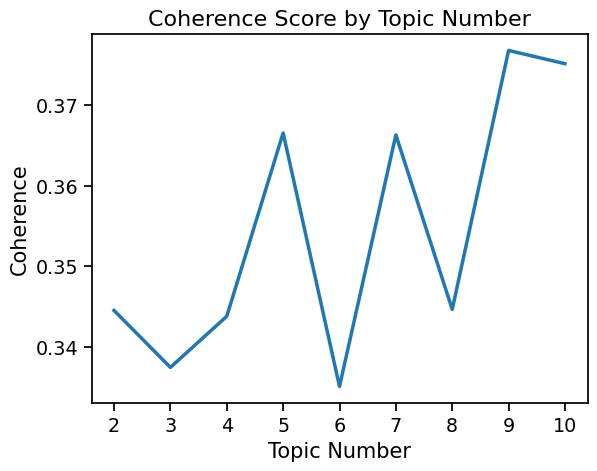

In [52]:
plt.plot(coherence_scores)
plt.xticks(range(0,len(Topics)), Topics)
plt.title('Coherence Score by Topic Number', fontsize=16)
plt.xlabel('Topic Number')
plt.ylabel('Coherence')

In [53]:
lda_model = Trained_Models[np.argmax(coherence_scores)]

# Show Top10 words in the topics
lda_model.show_topics(num_words=10)

[(0,
  '0.019*"wrote" + 0.016*"explain" + 0.015*"different" + 0.015*"done" + 0.014*"gave" + 0.013*"test" + 0.012*"script" + 0.012*"took" + 0.012*"else" + 0.012*"twitter"'),
 (1,
  '0.025*"asked" + 0.022*"write" + 0.013*"good" + 0.012*"using" + 0.012*"would" + 0.011*"know" + 0.011*"think" + 0.010*"people" + 0.009*"code" + 0.008*"time"'),
 (2,
  '0.068*"poem" + 0.050*"last" + 0.048*"time" + 0.045*"long" + 0.035*"short" + 0.032*"guess" + 0.026*"stackoverflow" + 0.021*"conversations" + 0.019*"powered" + 0.018*"received"'),
 (3,
  '0.027*"dalle" + 0.025*"future" + 0.020*"imagine" + 0.019*"seems" + 0.016*"join" + 0.013*"game" + 0.013*"thought" + 0.011*"rlyimpqw" + 0.011*"video" + 0.010*"twitter"'),
 (4,
  '0.024*"even" + 0.022*"question" + 0.019*"still" + 0.014*"answer" + 0.012*"replace" + 0.011*"wrong" + 0.011*"mind" + 0.011*"going" + 0.008*"able" + 0.008*"right"'),
 (5,
  '0.018*"language" + 0.018*"chatbot" + 0.015*"tech" + 0.015*"technology" + 0.014*"model" + 0.013*"intelligence" + 0.011*